##### This notebook consists of Aritifical Neural Network built from scratch for classification.
For Dataset: "MNIST Digit" was used.
Three different layers ANN  is used for classification:
- One hidden layer  
- Two hidden layer  
- Four hidden layer  




#### Importing neccesary libraries

In [3]:
import glob
import cv2
import random
import random
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
random.seed(0)

Here I've downloaded the actual MNIST Images rather than the csv file.
The trainging dataset folder looks something like this.
- dataset
    - train
        - trainingSet
            - 0
            - 1
            - 2
            - 3
            - 4
            - 5
            - 6
            - 7
            - 8
            - 9
              
Altogether dataset consists of 42000 images of MNIST digit.  
For training 85% used for training and remaining 15% for testing.

In [14]:
pathImage = "./dataset/datasets/"
def prepare_data(path):
    """
    Input: Dataset path
    
    Returns a list which consists of list of all image path and it's respective class
    
    """
    #returns a list of folders that matches the path specified in the pathname argument
    file_list = glob.glob(path + "*")
    data = []
    for class_path in file_list:
        class_name = class_path.split("\\")[-1]
        for img_path in glob.glob(class_path + "/*.jpg"):
            data.append([img_path, class_name])
    return data
        
my_data = prepare_data(pathImage)
#for shuffling data
random.shuffle(my_data)
# my_data

#### Splitting Dataset

In [15]:
len(my_data)

42000

In [16]:
split = 0.85
length_of_data = len(my_data) 
my_data_train = my_data[:int(0.85*length_of_data)]
my_data_test = my_data[int(0.85*length_of_data):]

In [17]:
my_data_test 

[['./dataset/datasets\\8\\img_9272.jpg', '8'],
 ['./dataset/datasets\\4\\img_34294.jpg', '4'],
 ['./dataset/datasets\\7\\img_32208.jpg', '7'],
 ['./dataset/datasets\\2\\img_12433.jpg', '2'],
 ['./dataset/datasets\\7\\img_13460.jpg', '7'],
 ['./dataset/datasets\\7\\img_14290.jpg', '7'],
 ['./dataset/datasets\\6\\img_16831.jpg', '6'],
 ['./dataset/datasets\\0\\img_18312.jpg', '0'],
 ['./dataset/datasets\\9\\img_40375.jpg', '9'],
 ['./dataset/datasets\\4\\img_19252.jpg', '4'],
 ['./dataset/datasets\\0\\img_7402.jpg', '0'],
 ['./dataset/datasets\\6\\img_26321.jpg', '6'],
 ['./dataset/datasets\\9\\img_13776.jpg', '9'],
 ['./dataset/datasets\\8\\img_6968.jpg', '8'],
 ['./dataset/datasets\\0\\img_39385.jpg', '0'],
 ['./dataset/datasets\\8\\img_33643.jpg', '8'],
 ['./dataset/datasets\\1\\img_9955.jpg', '1'],
 ['./dataset/datasets\\8\\img_15656.jpg', '8'],
 ['./dataset/datasets\\4\\img_2010.jpg', '4'],
 ['./dataset/datasets\\7\\img_18541.jpg', '7'],
 ['./dataset/datasets\\2\\img_23943.jpg', '2'

#### Necessary Methods required during Training 

In [18]:
def sigmoid(x):
    return 1. / (1. + np.exp(-x))

def softmax(x):
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum()

#LOss function for multi class classification
def generateArray(index):
    temp = np.zeros(10)
    temp[index] = 1
    return temp

def catCrossEntropy(y_true, y_pred):
    y_true_arr = generateArray(y_true) 
    loss = np.sum(y_true_arr.reshape(10,1) * np.log(np.array(y_pred).reshape(10,1)))
    return loss

#Return accuracy 
def accuracy(actual, pred, length):
    allTrue = 0
    pred_arr = generateArray(pred)
    actual_arr = generateArray(actual)
#     if np.all(np.array(pred_arr)==np.array(actual_arr)):
    if np.all(pred_arr==actual_arr):
        allTrue +=1
    return allTrue/length

#### Xavier Weight Initialization Techniques 

In [15]:
#Considering nodes of layer 1 as 30 and output layer as 10(being the number of classes.)
hidden_layer1 = 30
output_layer = 10
num_features = 784
def weight_initialize(mode):
    if mode=="random":
        w1 = np.random.random((hidden_layer1,   num_features))
        w2 = np.random.random((hidden_layer2, hidden_layer1))
        b1 = np.random.random((1, hidden_layer1))
        b2 =  np.random.random((1, hidden_layer2))
    elif mode=="xavierNormal":
        w1 = np.random.normal(loc=0.0, scale = np.sqrt(2/(hidden_layer1+num_features)), size = (hidden_layer1,num_features)).astype(np.float32)
        w2 = np.random.normal(loc=0.0, scale = np.sqrt(2/(hidden_layer1+hidden_layer2)), size = (hidden_layer2, hidden_layer1)).astype(np.float32)
        b1 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+hidden_layer1)), size = (1,30)).astype(np.float32)
        b2 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+hidden_layer2)), size = (1,10)).astype(np.float32)
    elif mode=="xavierUniform":
        w1 = np.random.uniform(low=-np.sqrt(6/(hidden_layer1+num_features)), high = np.sqrt(6/(hidden_layer1+num_features)), size = (30,784)).astype(np.float32)
        w2 = np.random.uniform(low=-np.sqrt(6/(hidden_layer2+hidden_layer1)), high = np.sqrt(6/(hidden_layer2+hidden_layer1)), size = (10,30)).astype(np.float32)
        b1 = np.random.uniform(low=-np.sqrt(6/(hidden_layer1+1)), high = np.sqrt(6/(hidden_layer1+1)), size = (1,30)).astype(np.float32)
        b2 = np.random.uniform(low=-np.sqrt(6/(1+hidden_layer2)), high = np.sqrt(6/(1+hidden_layer2)), size = (1,10)).astype(np.float32)
        
    else: 
        w1 = np.full(shape=(hidden_layer1,   num_features), fill_value=0, dtype=np.float64)
        w2 = np.full(shape=(hidden_layer2, hidden_layer1), fill_value=0, dtype=np.float64)
        b1 = np.full(shape=(1, hidden_layer1), fill_value=0, dtype=np.float64)
        b2 = np.full(shape=(1, hidden_layer2), fill_value=0, dtype=np.float64)
    return w1, w2, b1, b2
 

In [13]:
def preprocess(data_array):
    '''
        Input: List of image path and its' class
        Returns the flatten normalized matrix of image and it's class.
        
    '''
    img_path, class_name = data_array
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
    img_out = img[:,:,0]/255.0
    return np.array(img_out).reshape(1,784), int(class_name)
#     return img_out
# print(preprocess(my_data[0]))

In [14]:
len(my_data_train)

35700

### One Hidden Layer ANN


<div>
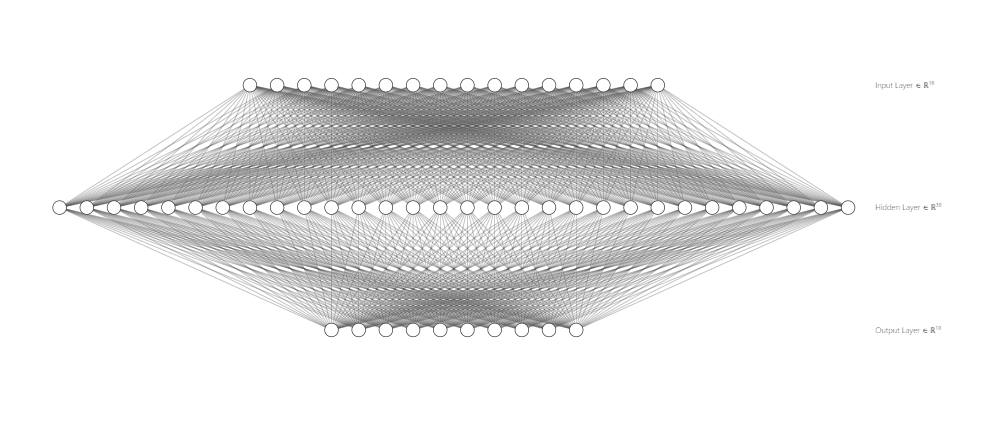
</div>
Here the input image is of size (1, 784) which is got by flattening the 28*28 MNIST Image.

In [11]:
       
lossArray = []
accArray = []
def forward(arr,  weight1, weight2, bias1, bias2, learningRate=0.1, epochs=100):
    for epoch in range(epochs):
        acc = 0
        loss = 0
        for index in range(len(arr)):
            #forward pass
            inputs, output = preprocess(arr[index])
            intermediate1 = np.matmul(inputs, weight1.T)
            intermediate12 = intermediate1 + bias1 
            hiddenOutput1 = sigmoid(intermediate12)
            intermediate2 = np.matmul(hiddenOutput1, weight2.T) 
            intermediate21 = intermediate2 + bias2 
            outputClass = softmax(intermediate21) 
            check = np.argmax(outputClass)
            output_arr = generateArray(output)
            acc = acc + accuracy(output, check, len(arr))
            loss = loss - catCrossEntropy(output, outputClass)
            #backward pass
            #gradient calcualtion
            db2 = (outputClass - output_arr)
            dw2 = np.matmul(db2.T, hiddenOutput1)
            db1_1 = np.matmul(np.matmul(db2, weight2).T, hiddenOutput1)
            db1 = np.matmul(db1_1, (1-hiddenOutput1).T)
            dw1 = np.matmul(db1, inputs)
            #params update
            weight1 = weight1 - learningRate * dw1
            bias1 = bias1 - learningRate * db1.T
            weight2 = weight2 - learningRate * dw2
            bias2 = bias2 - learningRate * db2
        lossArray.append(loss)
        accArray.append(acc)
        print(f"Epoch: {epoch+1}")
        print(f"Accuracy: {acc} and Loss: {loss}")
        print('-------------------------------------------------------------')
    return weight1, weight2, bias1, bias2

In [12]:
weight1, weight2, bias1, bias2 = weight_initialize(mode="xavierNormal")
w1, w2, b1, b2 = forward(my_data_train, weight1, weight2, bias1, bias2, learningRate=1, epochs=10)

<ipython-input-5-354d69a29eaf>:2: RuntimeWarning: overflow encountered in exp
  return 1. / (1. + np.exp(-x))


Epoch: 1
Accuracy: 0.6247750000002124 and Loss: 49839.89117988609
-------------------------------------------------------------
Epoch: 2
Accuracy: 0.7360750000004472 and Loss: 39981.68783319397
-------------------------------------------------------------
Epoch: 3
Accuracy: 0.7556500000004885 and Loss: 39734.60409710155
-------------------------------------------------------------
Epoch: 4
Accuracy: 0.7567000000004908 and Loss: 37137.28029767864
-------------------------------------------------------------
Epoch: 5
Accuracy: 0.7542500000004856 and Loss: 36249.99552230966
-------------------------------------------------------------
Epoch: 6
Accuracy: 0.7694750000005177 and Loss: 35374.92246693607
-------------------------------------------------------------
Epoch: 7
Accuracy: 0.7777250000005351 and Loss: 35512.705898958084
-------------------------------------------------------------
Epoch: 8
Accuracy: 0.771500000000522 and Loss: 38355.69498567101
--------------------------------------

### Testing 

In [14]:
# testImage = "../../mnist-digit/test/testSet/"
# testData = prepare_data(testImage)
def test(data_path, weight1, weight2, bias1, bias2):
    acc = 0
    for idx, item in enumerate(data_path):
        img_path, output = item
        img = cv2.imread(img_path)
        imgs = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
        img_out = imgs[:,:,0]/255.0
        input_x = np.array(img_out).reshape(1,784)
        intermediate1 = np.matmul(input_x, weight1.T)
        intermediate12 = intermediate1 + bias1 
        hiddenOutput1 = sigmoid(intermediate12)
        intermediate2 = np.matmul(hiddenOutput1, weight2.T) 
        intermediate21 = intermediate2 + bias2 
        outputClass = softmax(intermediate21) 
        check = np.argmax(outputClass)
        acc+=accuracy(int(output), check, len(data_path))
        print(f'Test: {idx+1}')
        print(f'Predicted: {check}')
        plt.matshow(img)
        plt.pause(0.01)
        print(f'-------------------------------------------')
    print(f"Test Accuracy: {acc}")
    
    

#### Ploting Loss over each epoch

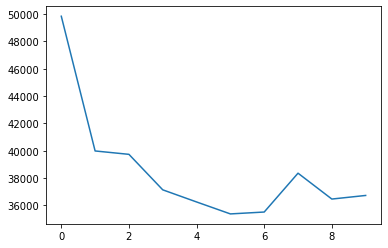

In [15]:
plt.plot(lossArray)

<ipython-input-5-354d69a29eaf>:2: RuntimeWarning: overflow encountered in exp
  return 1. / (1. + np.exp(-x))


Test: 1
Predicted: 5


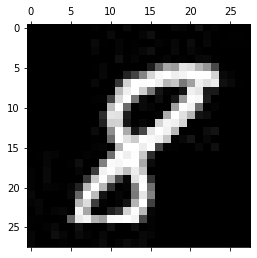

-------------------------------------------
Test: 2
Predicted: 9


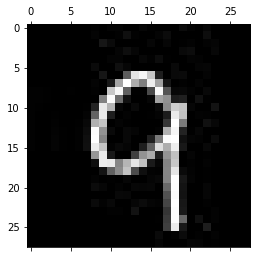

-------------------------------------------
Test: 3
Predicted: 5


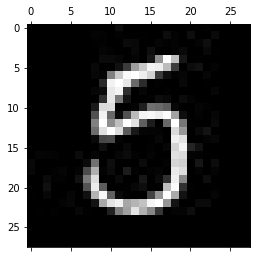

-------------------------------------------
Test: 4
Predicted: 3


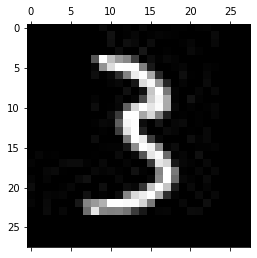

-------------------------------------------
Test: 5
Predicted: 6


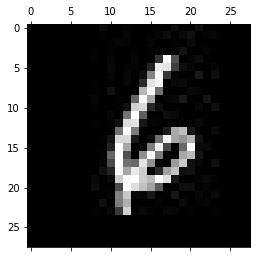

-------------------------------------------
Test: 6
Predicted: 1


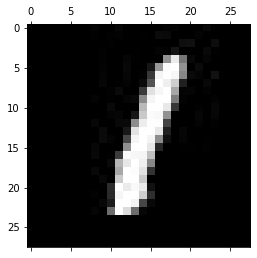

-------------------------------------------
Test: 7
Predicted: 2


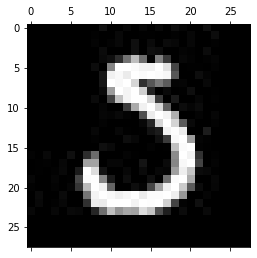

-------------------------------------------
Test: 8
Predicted: 7


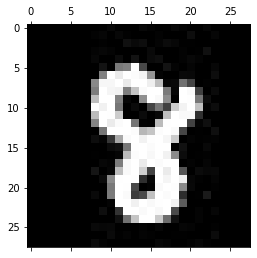

-------------------------------------------
Test: 9
Predicted: 9


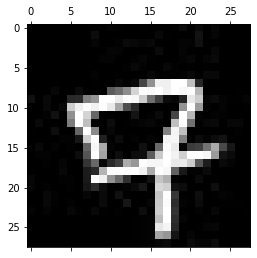

-------------------------------------------
Test: 10
Predicted: 2


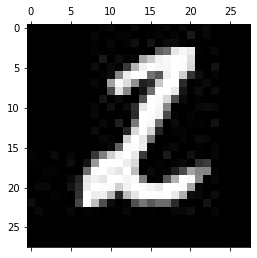

-------------------------------------------
Test: 11
Predicted: 7


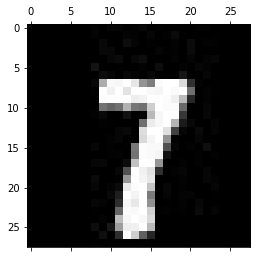

-------------------------------------------
Test: 12
Predicted: 3


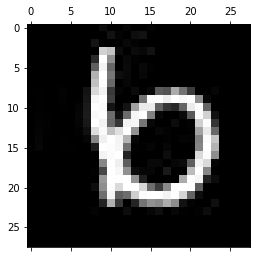

-------------------------------------------
Test: 13
Predicted: 5


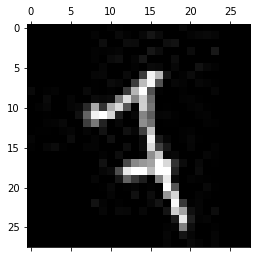

-------------------------------------------
Test: 14
Predicted: 1


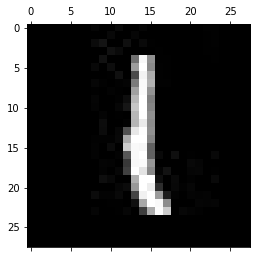

-------------------------------------------
Test: 15
Predicted: 7


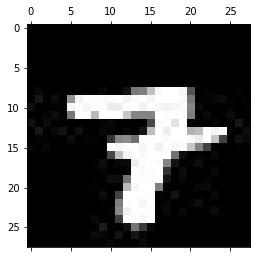

-------------------------------------------
Test: 16
Predicted: 1


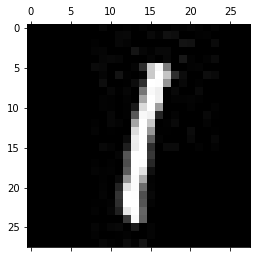

-------------------------------------------
Test: 17
Predicted: 5


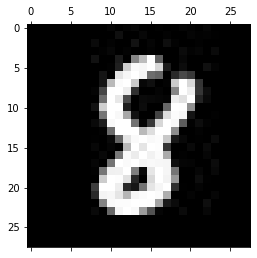

-------------------------------------------
Test: 18
Predicted: 1


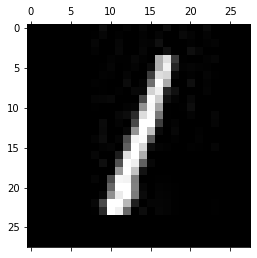

-------------------------------------------
Test: 19
Predicted: 7


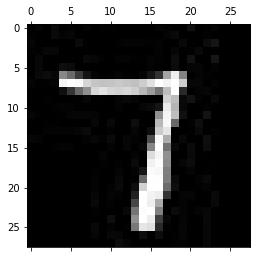

-------------------------------------------
Test: 20
Predicted: 7


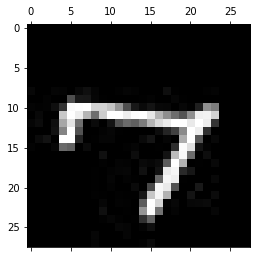

-------------------------------------------
Test: 21
Predicted: 6


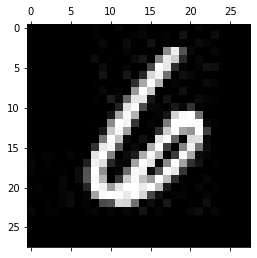

-------------------------------------------
Test: 22
Predicted: 3


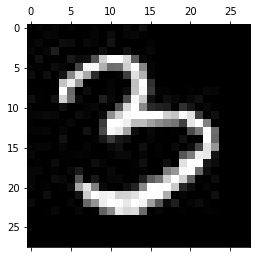

-------------------------------------------
Test: 23
Predicted: 9


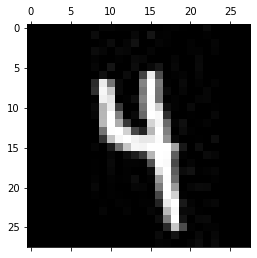

-------------------------------------------
Test: 24
Predicted: 5


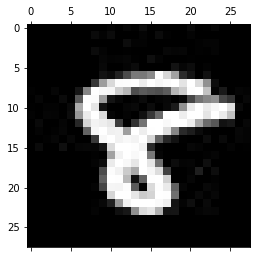

-------------------------------------------
Test: 25
Predicted: 3


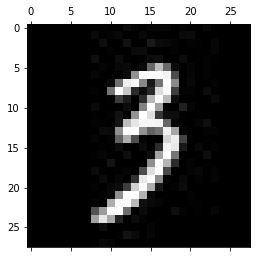

-------------------------------------------
Test: 26
Predicted: 5


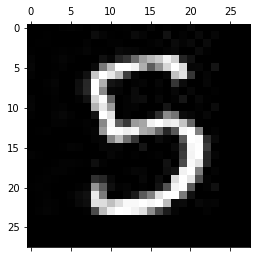

-------------------------------------------
Test: 27
Predicted: 7


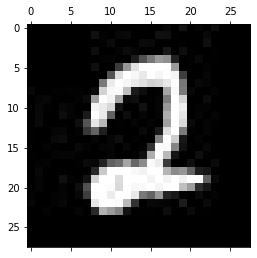

-------------------------------------------
Test: 28
Predicted: 2


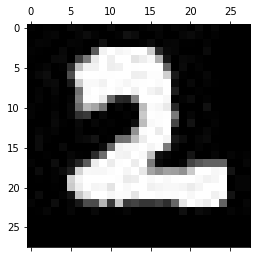

-------------------------------------------
Test: 29
Predicted: 0


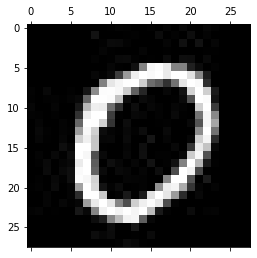

-------------------------------------------
Test: 30
Predicted: 4


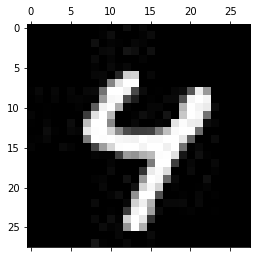

-------------------------------------------
Test: 31
Predicted: 1


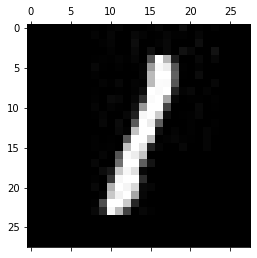

-------------------------------------------
Test: 32
Predicted: 1


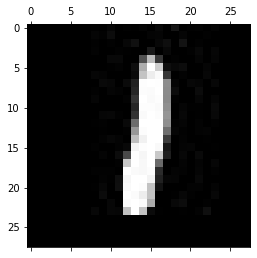

-------------------------------------------
Test: 33
Predicted: 3


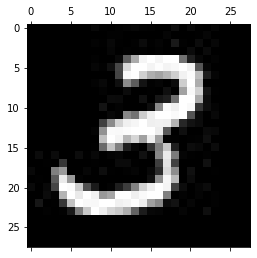

-------------------------------------------
Test: 34
Predicted: 1


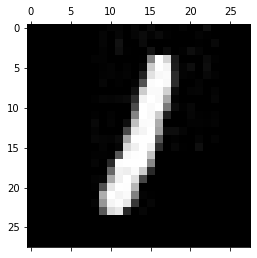

-------------------------------------------
Test: 35
Predicted: 5


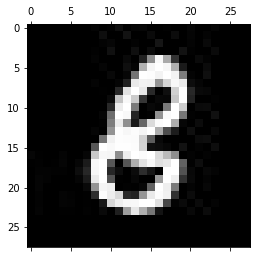

-------------------------------------------
Test: 36
Predicted: 0


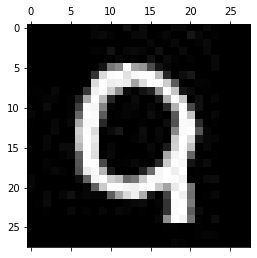

-------------------------------------------
Test: 37
Predicted: 1


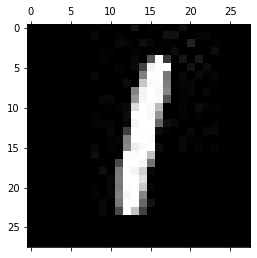

-------------------------------------------
Test: 38
Predicted: 7


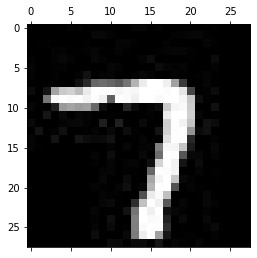

-------------------------------------------
Test: 39
Predicted: 5


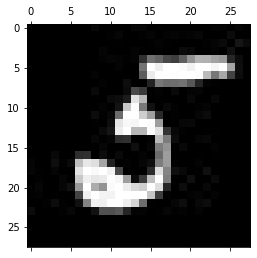

-------------------------------------------
Test: 40
Predicted: 3


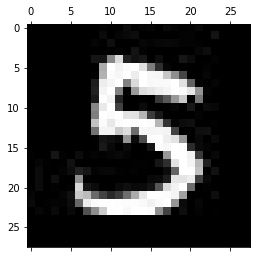

-------------------------------------------
Test: 41
Predicted: 2


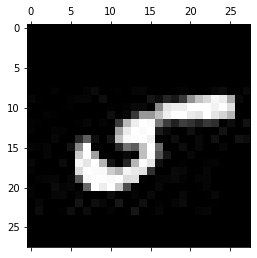

-------------------------------------------
Test: 42
Predicted: 9


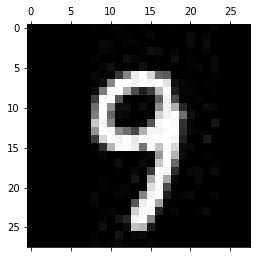

-------------------------------------------
Test: 43
Predicted: 0


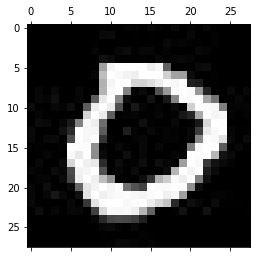

-------------------------------------------
Test: 44
Predicted: 4


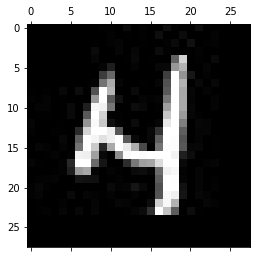

-------------------------------------------
Test: 45
Predicted: 0


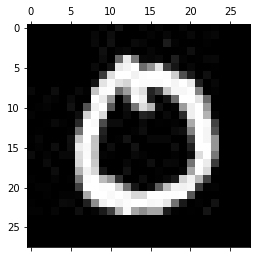

-------------------------------------------
Test: 46
Predicted: 5


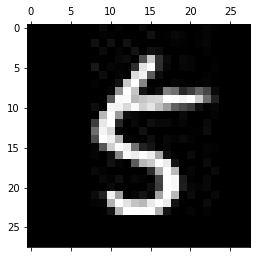

-------------------------------------------
Test: 47
Predicted: 3


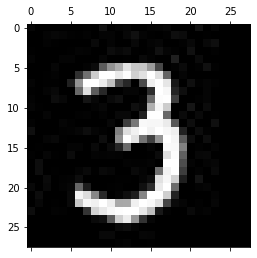

-------------------------------------------
Test: 48
Predicted: 6


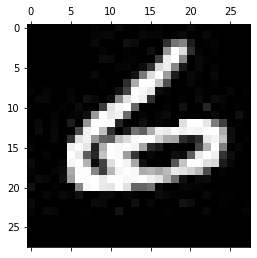

-------------------------------------------
Test: 49
Predicted: 0


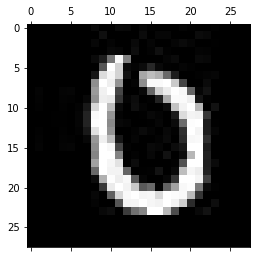

-------------------------------------------
Test: 50
Predicted: 7


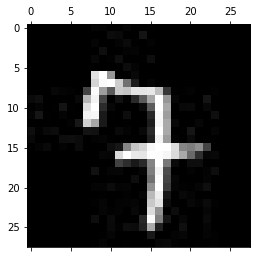

-------------------------------------------
Test: 51
Predicted: 5


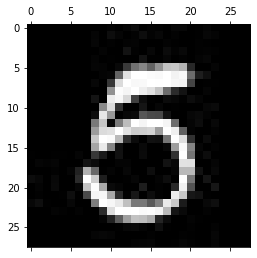

-------------------------------------------
Test: 52
Predicted: 6


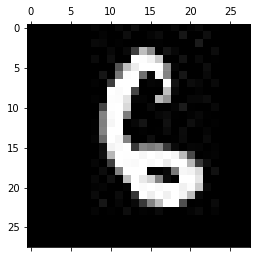

-------------------------------------------
Test: 53
Predicted: 5


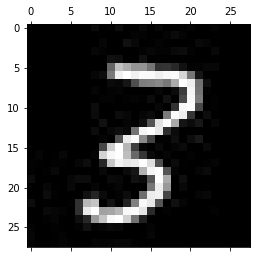

-------------------------------------------
Test: 54
Predicted: 3


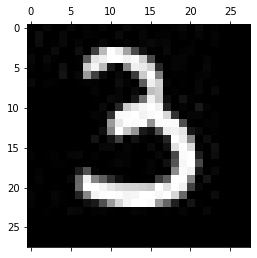

-------------------------------------------
Test: 55
Predicted: 2


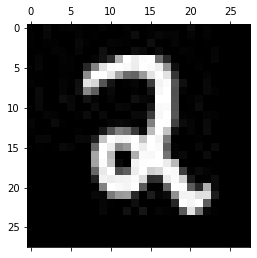

-------------------------------------------
Test: 56
Predicted: 6


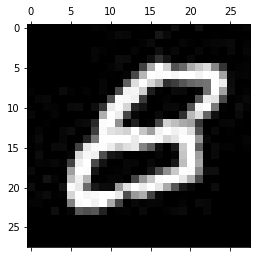

-------------------------------------------
Test: 57
Predicted: 1


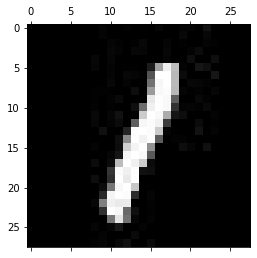

-------------------------------------------
Test: 58
Predicted: 6


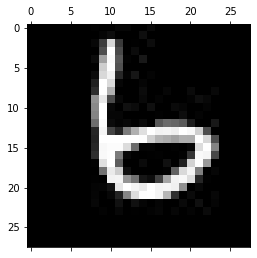

-------------------------------------------
Test: 59
Predicted: 5


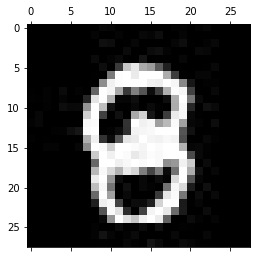

-------------------------------------------
Test: 60
Predicted: 0


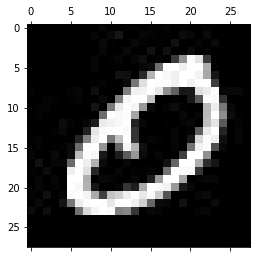

-------------------------------------------
Test: 61
Predicted: 5


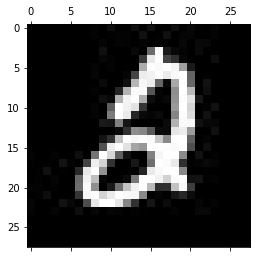

-------------------------------------------
Test: 62
Predicted: 2


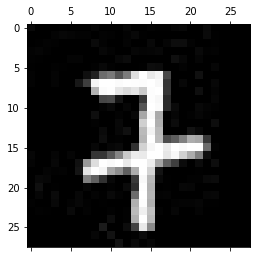

-------------------------------------------
Test: 63
Predicted: 2


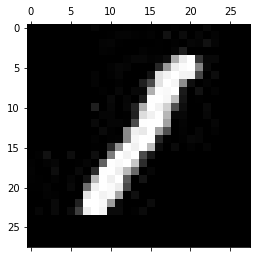

-------------------------------------------
Test: 64
Predicted: 3


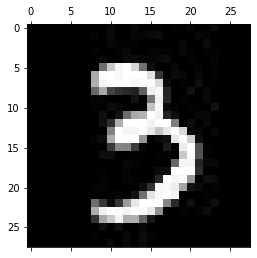

-------------------------------------------
Test: 65
Predicted: 9


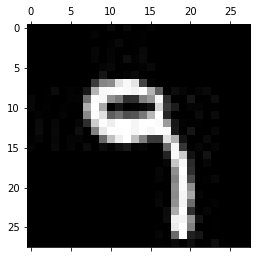

-------------------------------------------
Test: 66
Predicted: 9


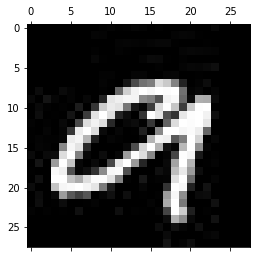

-------------------------------------------
Test: 67
Predicted: 1


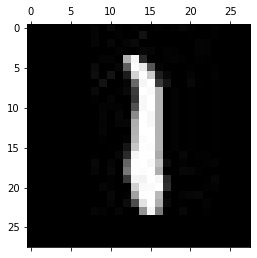

-------------------------------------------
Test: 68
Predicted: 1


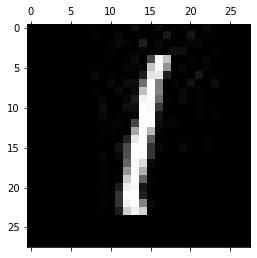

-------------------------------------------
Test: 69
Predicted: 0


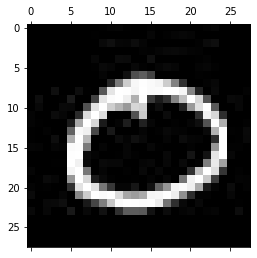

-------------------------------------------
Test: 70
Predicted: 5


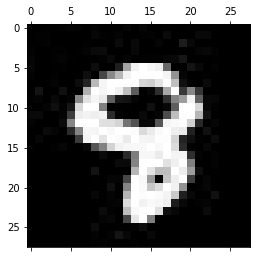

-------------------------------------------
Test: 71
Predicted: 9


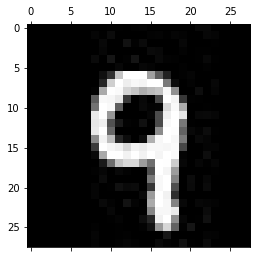

-------------------------------------------
Test: 72
Predicted: 7


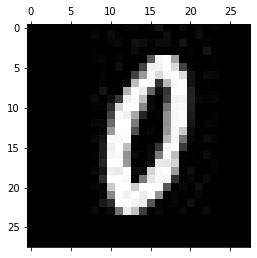

-------------------------------------------
Test: 73
Predicted: 0


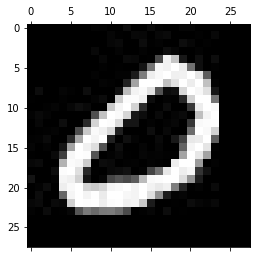

-------------------------------------------
Test: 74
Predicted: 3


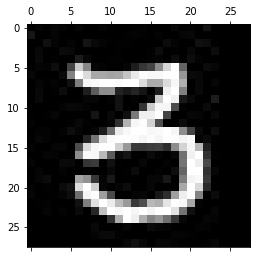

-------------------------------------------
Test: 75
Predicted: 0


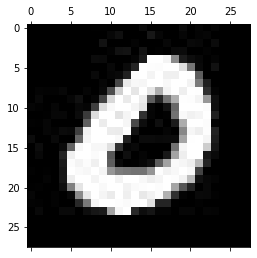

-------------------------------------------
Test: 76
Predicted: 5


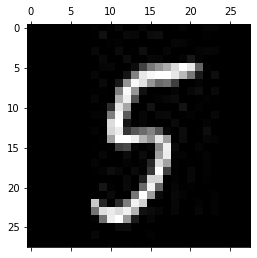

-------------------------------------------
Test: 77
Predicted: 7


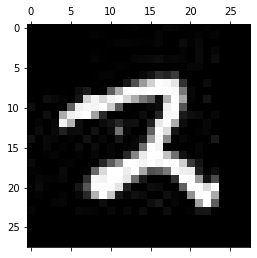

-------------------------------------------
Test: 78
Predicted: 1


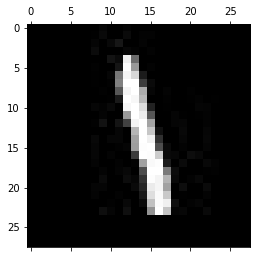

-------------------------------------------
Test: 79
Predicted: 5


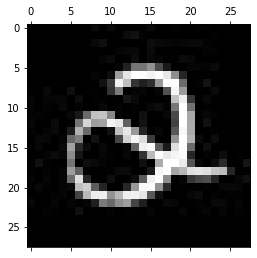

-------------------------------------------
Test: 80
Predicted: 5


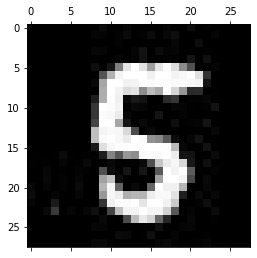

-------------------------------------------
Test: 81
Predicted: 3


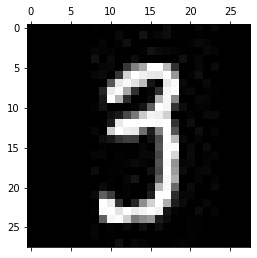

-------------------------------------------
Test: 82
Predicted: 3


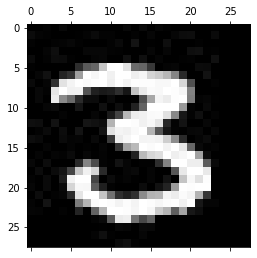

-------------------------------------------
Test: 83
Predicted: 9


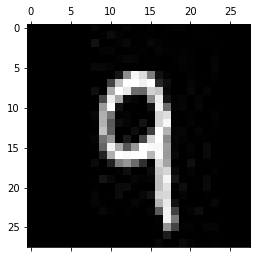

-------------------------------------------
Test: 84
Predicted: 6


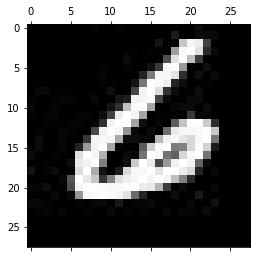

-------------------------------------------
Test: 85
Predicted: 0


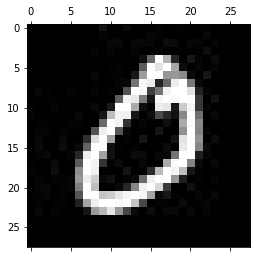

-------------------------------------------
Test: 86
Predicted: 2


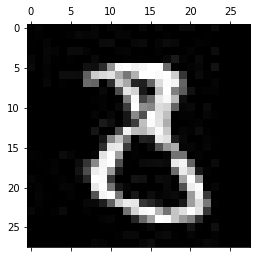

-------------------------------------------
Test: 87
Predicted: 0


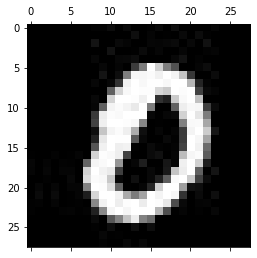

-------------------------------------------
Test: 88
Predicted: 6


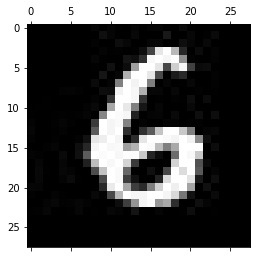

-------------------------------------------
Test: 89
Predicted: 7


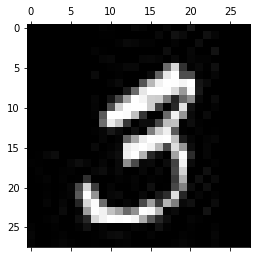

-------------------------------------------
Test: 90
Predicted: 6


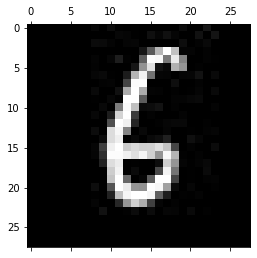

-------------------------------------------
Test: 91
Predicted: 4


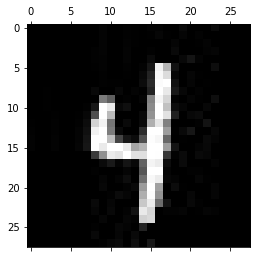

-------------------------------------------
Test: 92
Predicted: 5


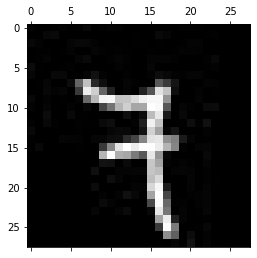

-------------------------------------------
Test: 93
Predicted: 1


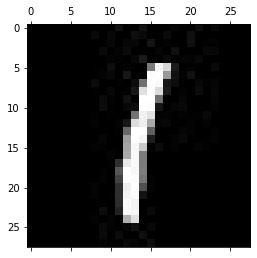

-------------------------------------------
Test: 94
Predicted: 0


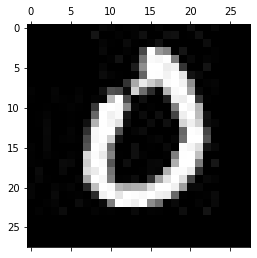

-------------------------------------------
Test: 95
Predicted: 2


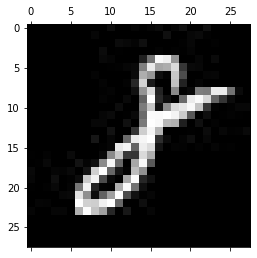

-------------------------------------------
Test: 96
Predicted: 4


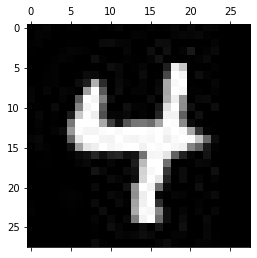

-------------------------------------------
Test: 97
Predicted: 3


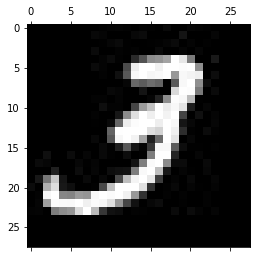

-------------------------------------------
Test: 98
Predicted: 7


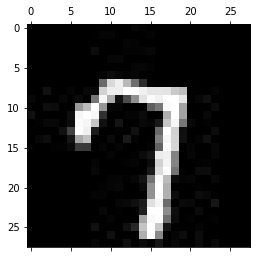

-------------------------------------------
Test: 99
Predicted: 4


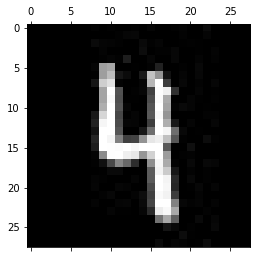

-------------------------------------------
Test: 100
Predicted: 7


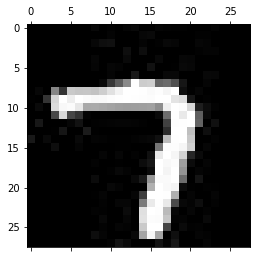

-------------------------------------------
Test: 101
Predicted: 6


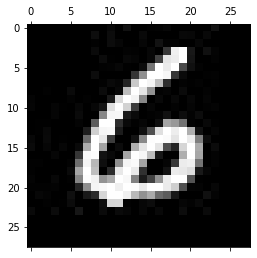

-------------------------------------------
Test: 102
Predicted: 3


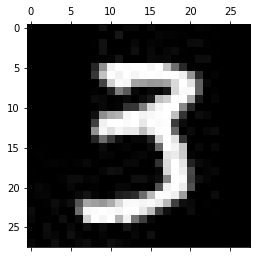

-------------------------------------------
Test: 103
Predicted: 5


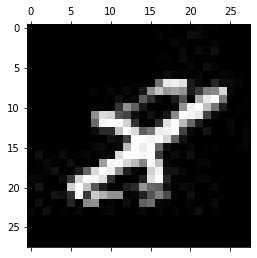

-------------------------------------------
Test: 104
Predicted: 7


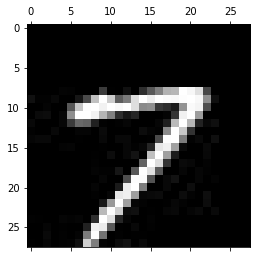

-------------------------------------------
Test: 105
Predicted: 7


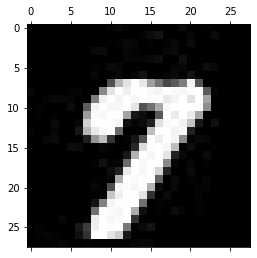

-------------------------------------------
Test: 106
Predicted: 7


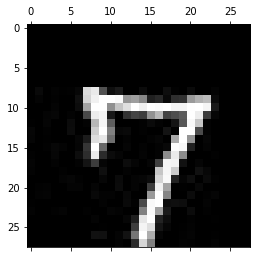

-------------------------------------------
Test: 107
Predicted: 6


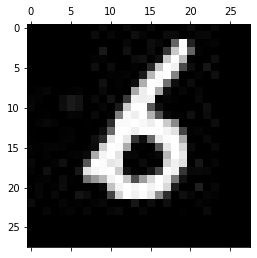

-------------------------------------------
Test: 108
Predicted: 5


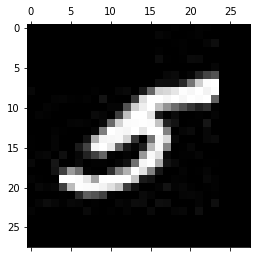

-------------------------------------------
Test: 109
Predicted: 1


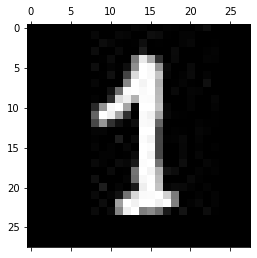

-------------------------------------------
Test: 110
Predicted: 3


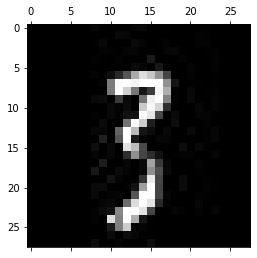

-------------------------------------------
Test: 111
Predicted: 4


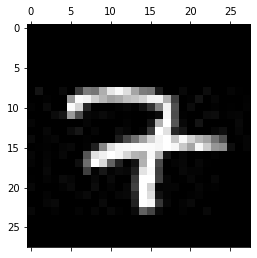

-------------------------------------------
Test: 112
Predicted: 5


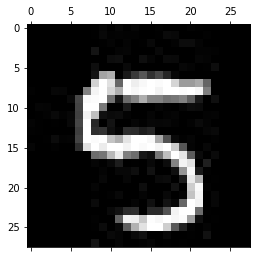

-------------------------------------------
Test: 113
Predicted: 2


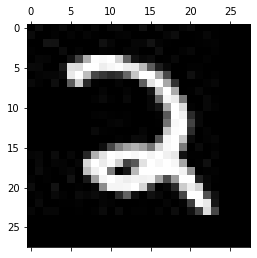

-------------------------------------------
Test: 114
Predicted: 3


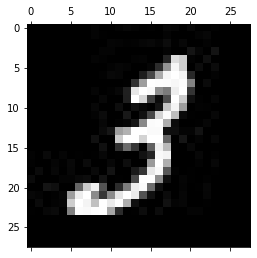

-------------------------------------------
Test: 115
Predicted: 5


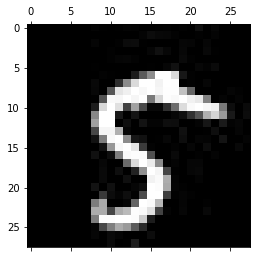

-------------------------------------------
Test: 116
Predicted: 1


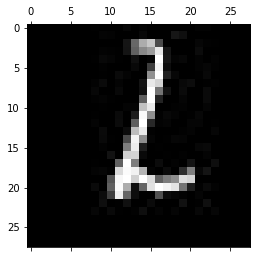

-------------------------------------------
Test: 117
Predicted: 6


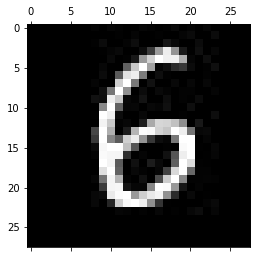

-------------------------------------------
Test: 118
Predicted: 2


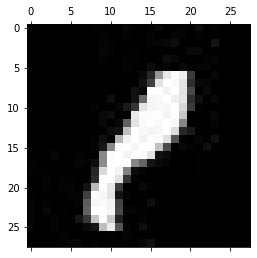

-------------------------------------------
Test: 119
Predicted: 4


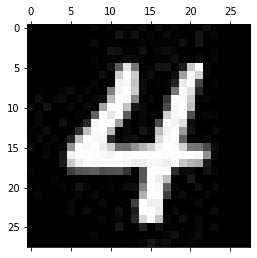

-------------------------------------------
Test: 120
Predicted: 7


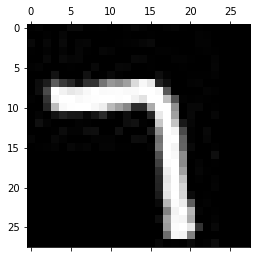

-------------------------------------------
Test: 121
Predicted: 9


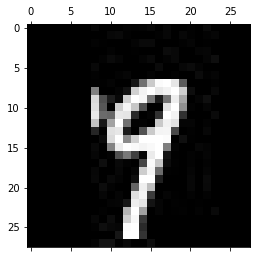

-------------------------------------------
Test: 122
Predicted: 4


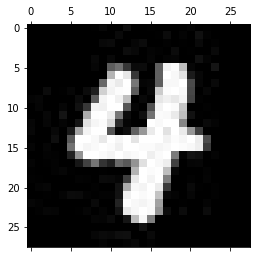

-------------------------------------------
Test: 123
Predicted: 6


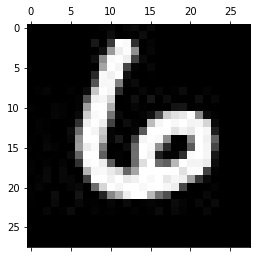

-------------------------------------------
Test: 124
Predicted: 6


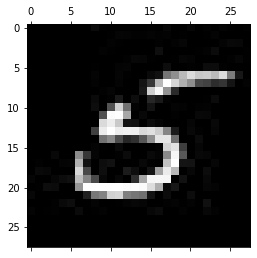

-------------------------------------------
Test: 125
Predicted: 4


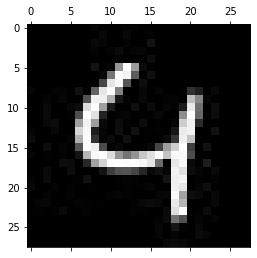

-------------------------------------------
Test: 126
Predicted: 6


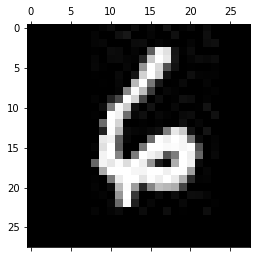

-------------------------------------------
Test: 127
Predicted: 5


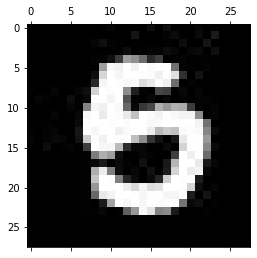

-------------------------------------------
Test: 128
Predicted: 2


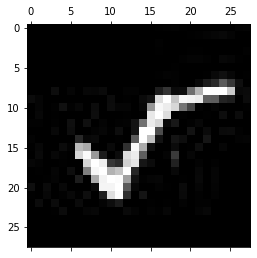

-------------------------------------------
Test: 129
Predicted: 3


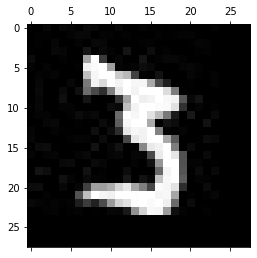

-------------------------------------------
Test: 130
Predicted: 7


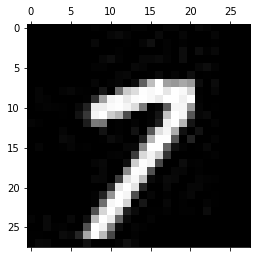

-------------------------------------------
Test: 131
Predicted: 9


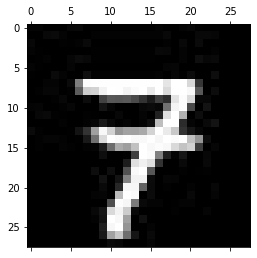

-------------------------------------------
Test: 132
Predicted: 1


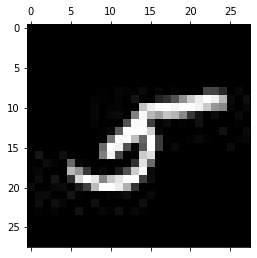

-------------------------------------------
Test: 133
Predicted: 6


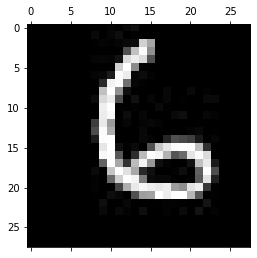

-------------------------------------------
Test: 134
Predicted: 1


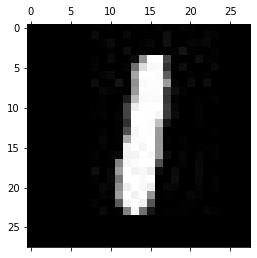

-------------------------------------------
Test: 135
Predicted: 1


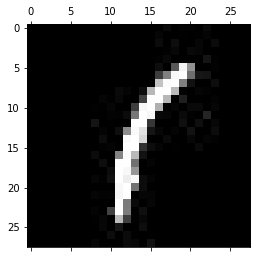

-------------------------------------------
Test: 136
Predicted: 7


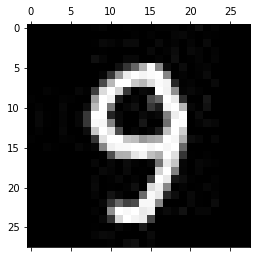

-------------------------------------------
Test: 137
Predicted: 5


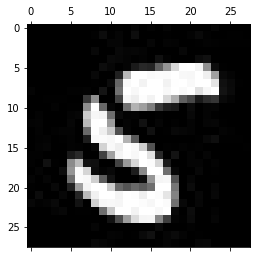

-------------------------------------------
Test: 138
Predicted: 4


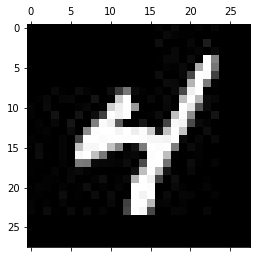

-------------------------------------------
Test: 139
Predicted: 5


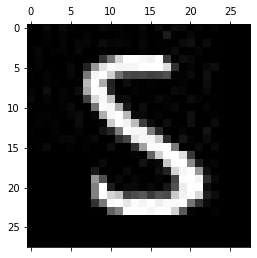

-------------------------------------------
Test: 140
Predicted: 7


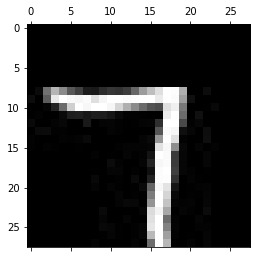

-------------------------------------------
Test: 141
Predicted: 3


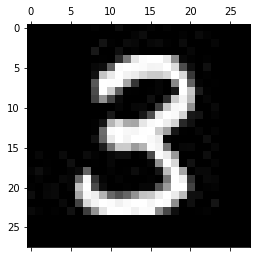

-------------------------------------------
Test: 142
Predicted: 4


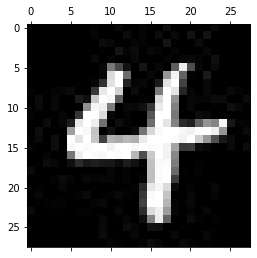

-------------------------------------------
Test: 143
Predicted: 3


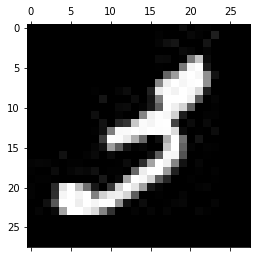

-------------------------------------------
Test: 144
Predicted: 2


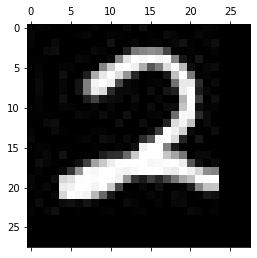

-------------------------------------------
Test: 145
Predicted: 5


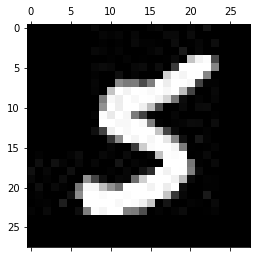

-------------------------------------------
Test: 146
Predicted: 5


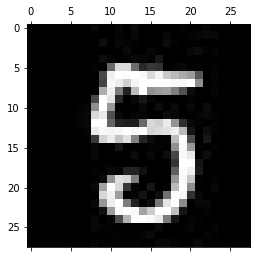

-------------------------------------------
Test: 147
Predicted: 3


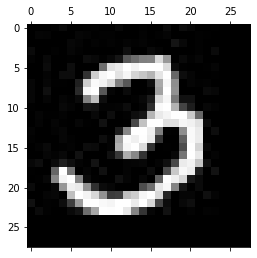

-------------------------------------------
Test: 148
Predicted: 6


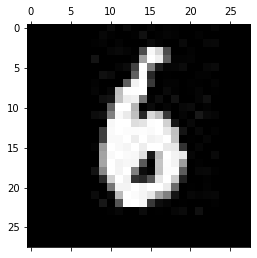

-------------------------------------------
Test: 149
Predicted: 5


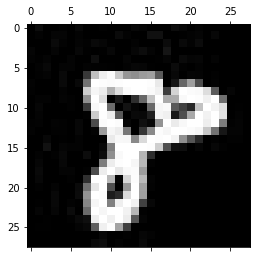

-------------------------------------------
Test: 150
Predicted: 4


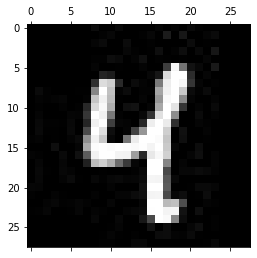

-------------------------------------------
Test: 151
Predicted: 1


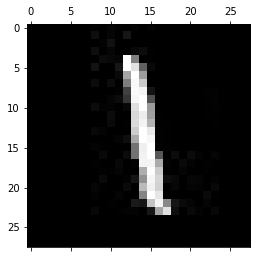

-------------------------------------------
Test: 152
Predicted: 1


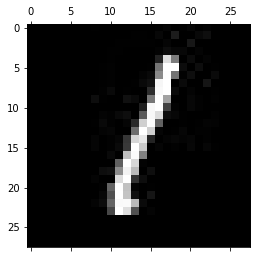

-------------------------------------------
Test: 153
Predicted: 5


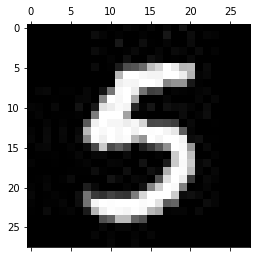

-------------------------------------------
Test: 154
Predicted: 7


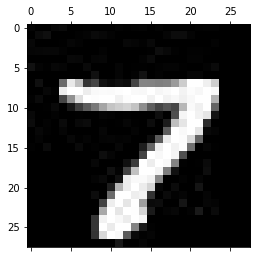

-------------------------------------------
Test: 155
Predicted: 5


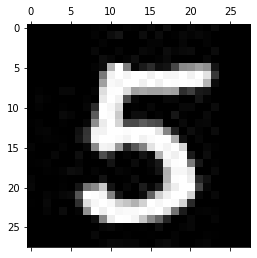

-------------------------------------------
Test: 156
Predicted: 7


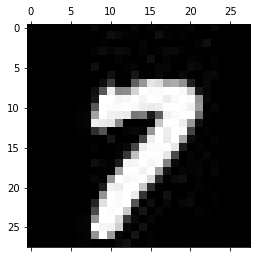

-------------------------------------------
Test: 157
Predicted: 0


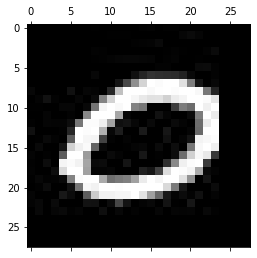

-------------------------------------------
Test: 158
Predicted: 3


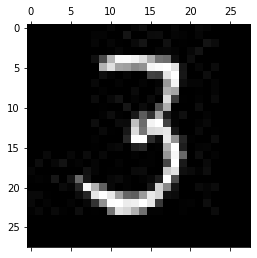

-------------------------------------------
Test: 159
Predicted: 4


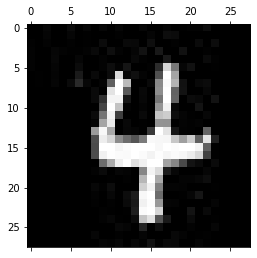

-------------------------------------------
Test: 160
Predicted: 4


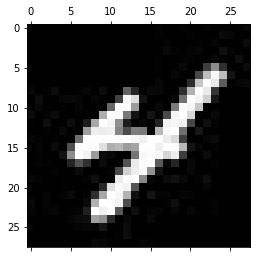

-------------------------------------------
Test: 161
Predicted: 9


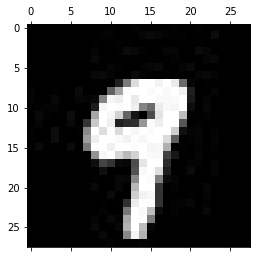

-------------------------------------------
Test: 162
Predicted: 3


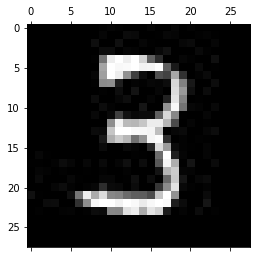

-------------------------------------------
Test: 163
Predicted: 3


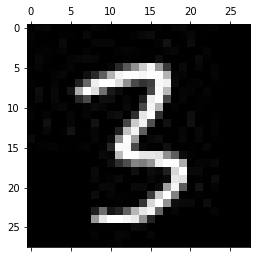

-------------------------------------------
Test: 164
Predicted: 0


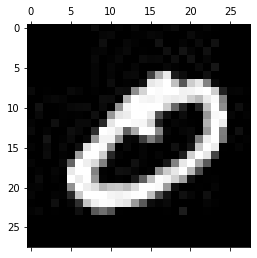

-------------------------------------------
Test: 165
Predicted: 1


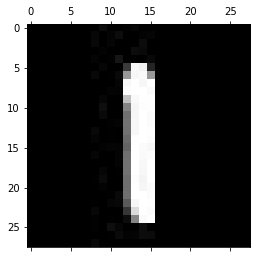

-------------------------------------------
Test: 166
Predicted: 5


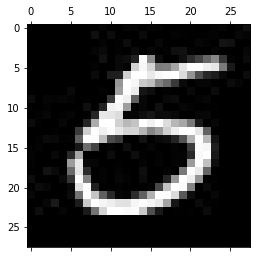

-------------------------------------------
Test: 167
Predicted: 5


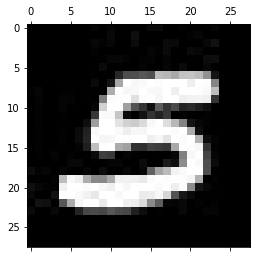

-------------------------------------------
Test: 168
Predicted: 5


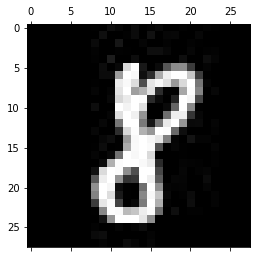

-------------------------------------------
Test: 169
Predicted: 7


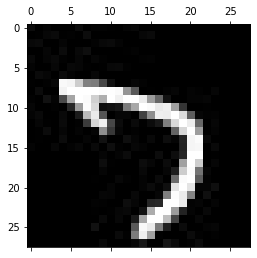

-------------------------------------------
Test: 170
Predicted: 1


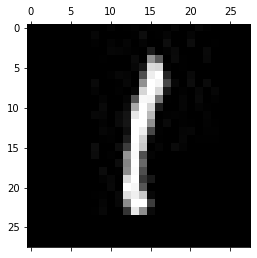

-------------------------------------------
Test: 171
Predicted: 7


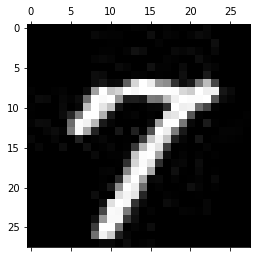

-------------------------------------------
Test: 172
Predicted: 7


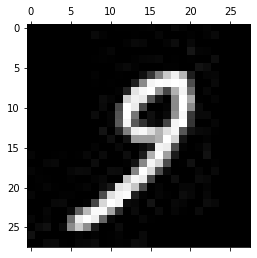

-------------------------------------------
Test: 173
Predicted: 5


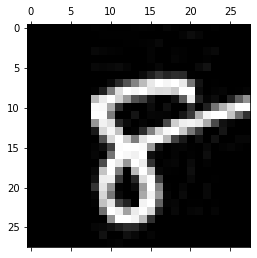

-------------------------------------------
Test: 174
Predicted: 6


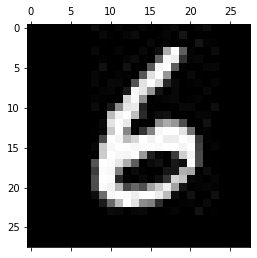

-------------------------------------------
Test: 175
Predicted: 0


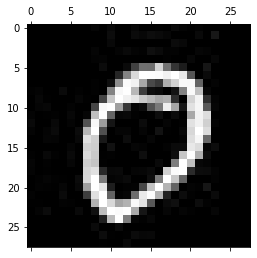

-------------------------------------------
Test: 176
Predicted: 0


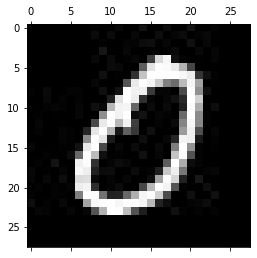

-------------------------------------------
Test: 177
Predicted: 9


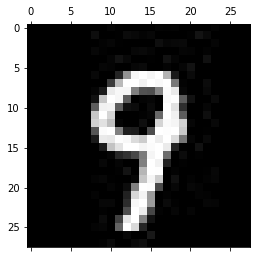

-------------------------------------------
Test: 178
Predicted: 7


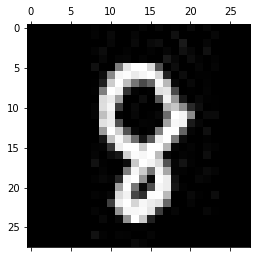

-------------------------------------------
Test: 179
Predicted: 9


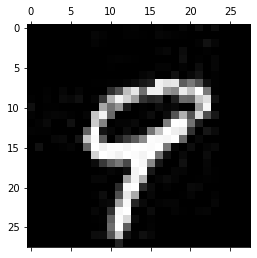

-------------------------------------------
Test: 180
Predicted: 2


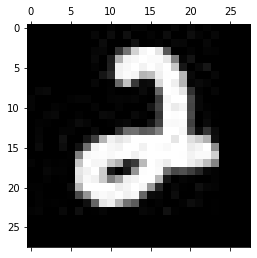

-------------------------------------------
Test: 181
Predicted: 0


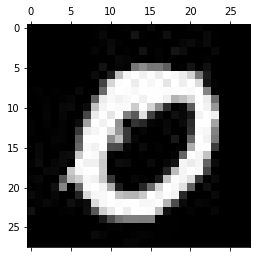

-------------------------------------------
Test: 182
Predicted: 2


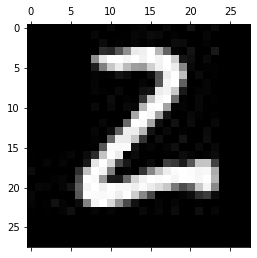

-------------------------------------------
Test: 183
Predicted: 1


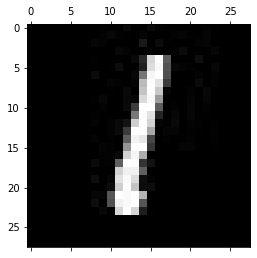

-------------------------------------------
Test: 184
Predicted: 5


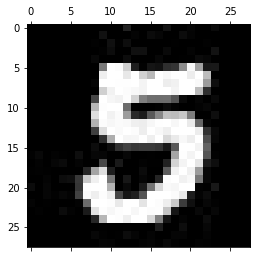

-------------------------------------------
Test: 185
Predicted: 2


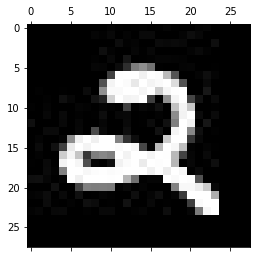

-------------------------------------------
Test: 186
Predicted: 4


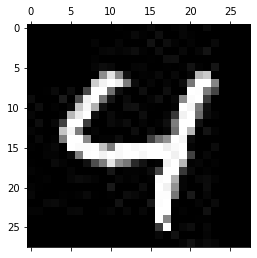

-------------------------------------------
Test: 187
Predicted: 1


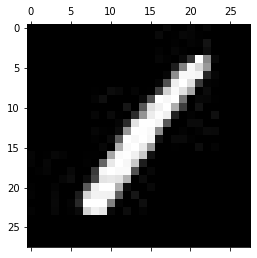

-------------------------------------------
Test: 188
Predicted: 5


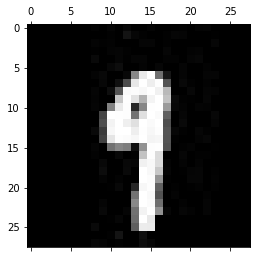

-------------------------------------------
Test: 189
Predicted: 7


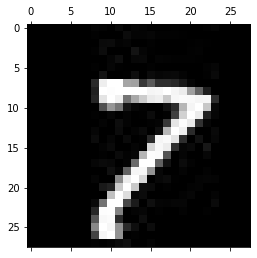

-------------------------------------------
Test: 190
Predicted: 4


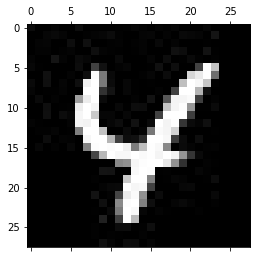

-------------------------------------------
Test: 191
Predicted: 1


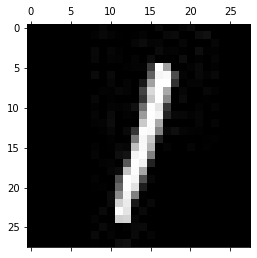

-------------------------------------------
Test: 192
Predicted: 5


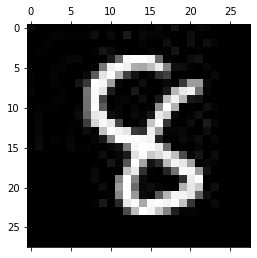

-------------------------------------------
Test: 193
Predicted: 6


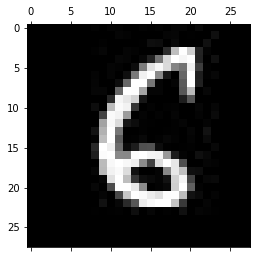

-------------------------------------------
Test: 194
Predicted: 2


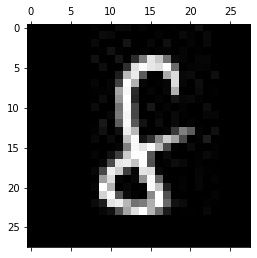

-------------------------------------------
Test: 195
Predicted: 6


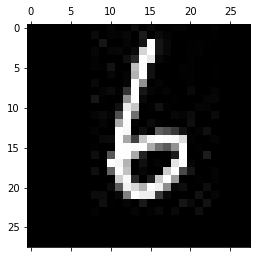

-------------------------------------------
Test: 196
Predicted: 7


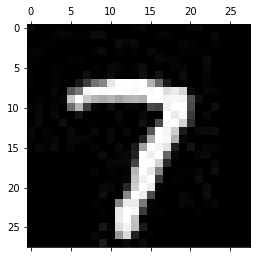

-------------------------------------------
Test: 197
Predicted: 1


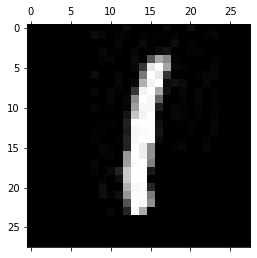

-------------------------------------------
Test: 198
Predicted: 1


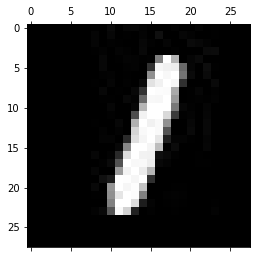

-------------------------------------------
Test: 199
Predicted: 7


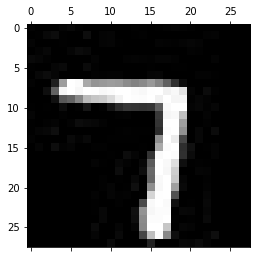

-------------------------------------------
Test: 200
Predicted: 5


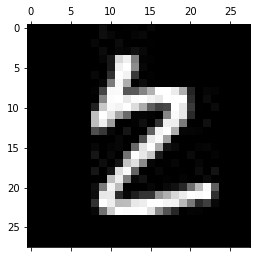

-------------------------------------------
Test: 201
Predicted: 9


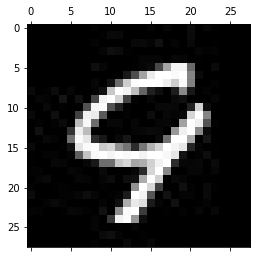

-------------------------------------------
Test: 202
Predicted: 4


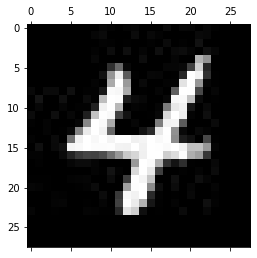

-------------------------------------------
Test: 203
Predicted: 6


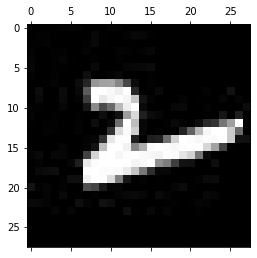

-------------------------------------------
Test: 204
Predicted: 5


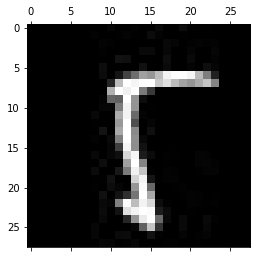

-------------------------------------------
Test: 205
Predicted: 5


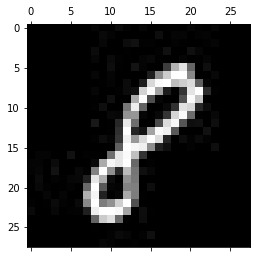

-------------------------------------------
Test: 206
Predicted: 7


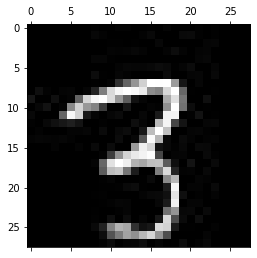

-------------------------------------------
Test: 207
Predicted: 3


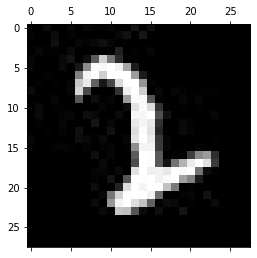

-------------------------------------------
Test: 208
Predicted: 4


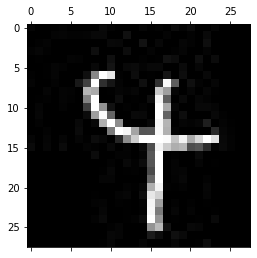

-------------------------------------------
Test: 209
Predicted: 4


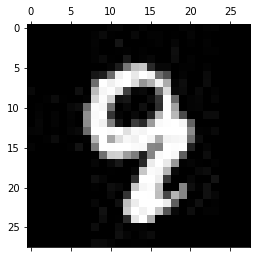

-------------------------------------------
Test: 210
Predicted: 6


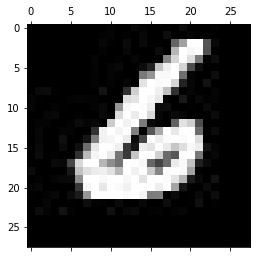

-------------------------------------------
Test: 211
Predicted: 5


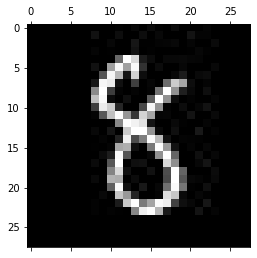

-------------------------------------------
Test: 212
Predicted: 7


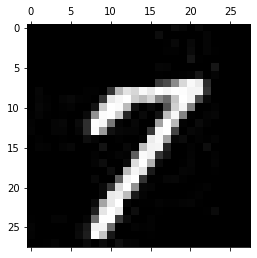

-------------------------------------------
Test: 213
Predicted: 7


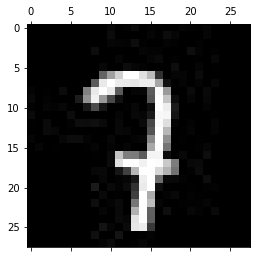

-------------------------------------------
Test: 214
Predicted: 4


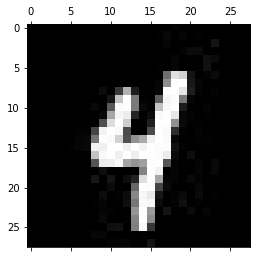

-------------------------------------------
Test: 215
Predicted: 1


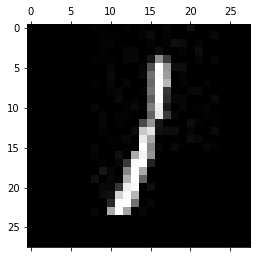

-------------------------------------------
Test: 216
Predicted: 7


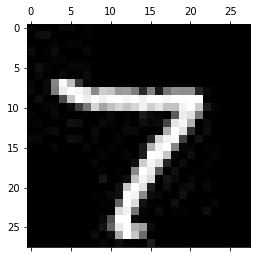

-------------------------------------------
Test: 217
Predicted: 0


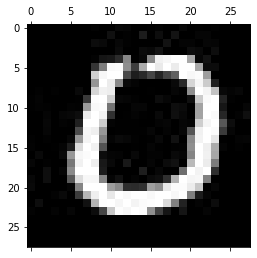

-------------------------------------------
Test: 218
Predicted: 7


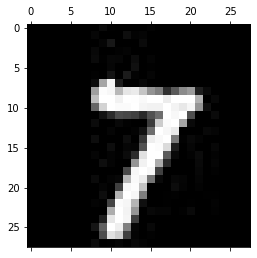

-------------------------------------------
Test: 219
Predicted: 7


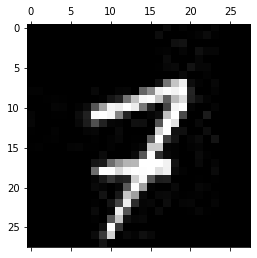

-------------------------------------------
Test: 220
Predicted: 3


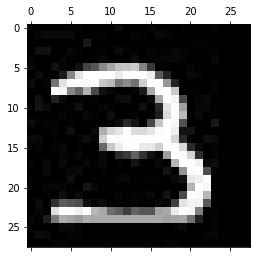

-------------------------------------------
Test: 221
Predicted: 5


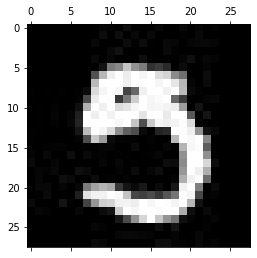

-------------------------------------------
Test: 222
Predicted: 6


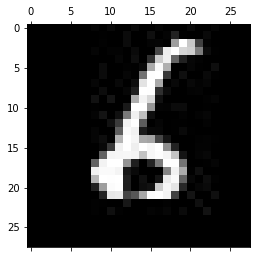

-------------------------------------------
Test: 223
Predicted: 9


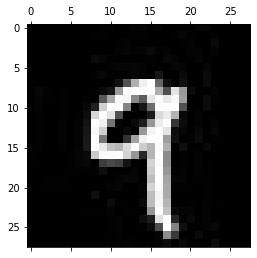

-------------------------------------------
Test: 224
Predicted: 1


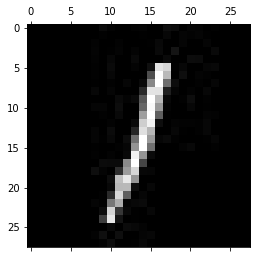

-------------------------------------------
Test: 225
Predicted: 5


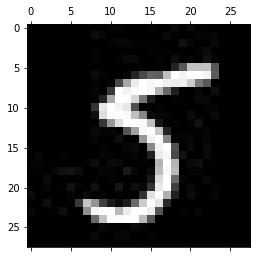

-------------------------------------------
Test: 226
Predicted: 7


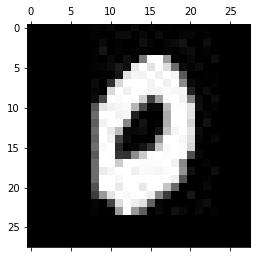

-------------------------------------------
Test: 227
Predicted: 5


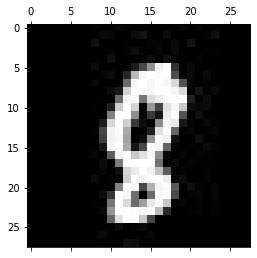

-------------------------------------------
Test: 228
Predicted: 6


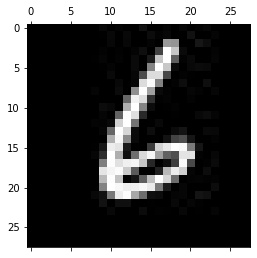

-------------------------------------------
Test: 229
Predicted: 2


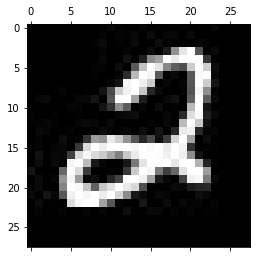

-------------------------------------------
Test: 230
Predicted: 6


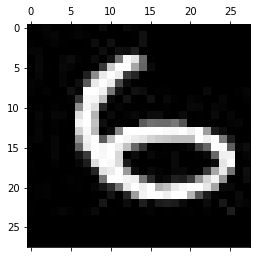

-------------------------------------------
Test: 231
Predicted: 1


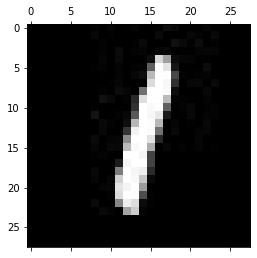

-------------------------------------------
Test: 232
Predicted: 4


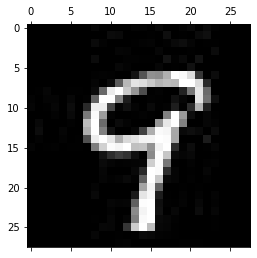

-------------------------------------------
Test: 233
Predicted: 0


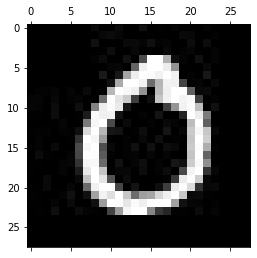

-------------------------------------------
Test: 234
Predicted: 3


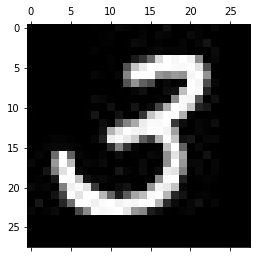

-------------------------------------------
Test: 235
Predicted: 2


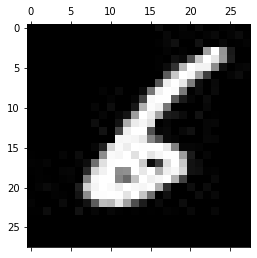

-------------------------------------------
Test: 236
Predicted: 6


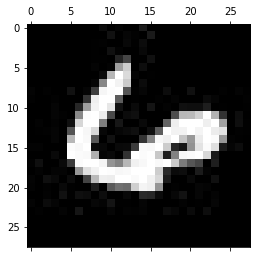

-------------------------------------------
Test: 237
Predicted: 3


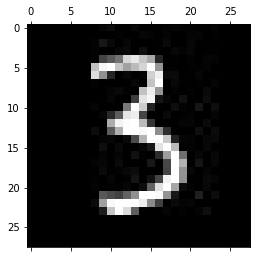

-------------------------------------------
Test: 238
Predicted: 7


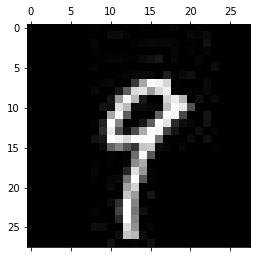

-------------------------------------------
Test: 239
Predicted: 6


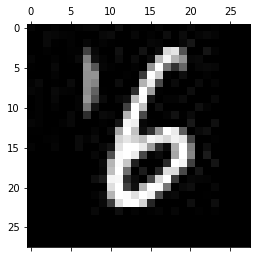

-------------------------------------------
Test: 240
Predicted: 7


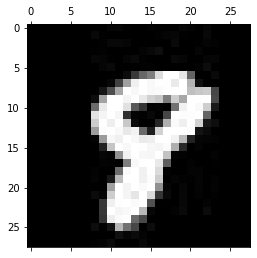

-------------------------------------------
Test: 241
Predicted: 6


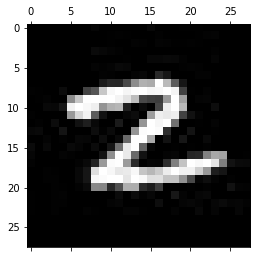

-------------------------------------------
Test: 242
Predicted: 0


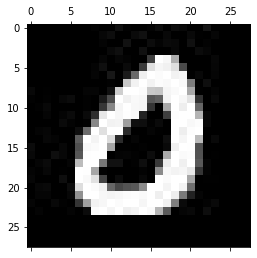

-------------------------------------------
Test: 243
Predicted: 6


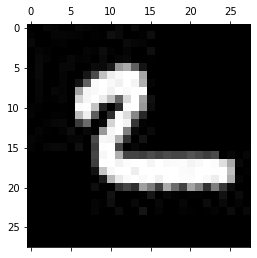

-------------------------------------------
Test: 244
Predicted: 7


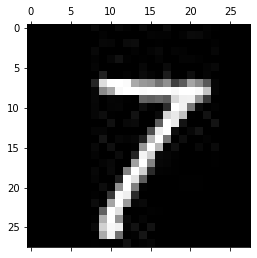

-------------------------------------------
Test: 245
Predicted: 1


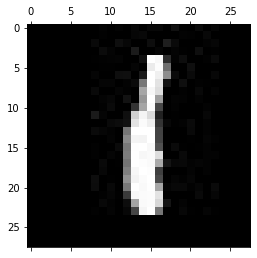

-------------------------------------------
Test: 246
Predicted: 5


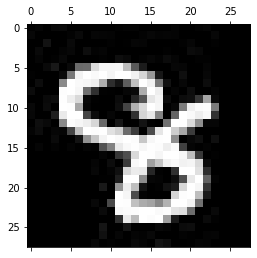

-------------------------------------------
Test: 247
Predicted: 5


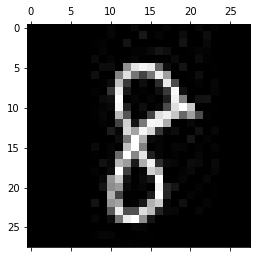

-------------------------------------------
Test: 248
Predicted: 2


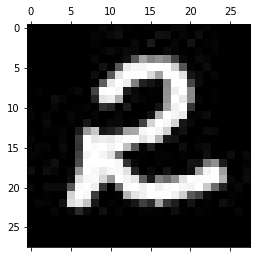

-------------------------------------------
Test: 249
Predicted: 3


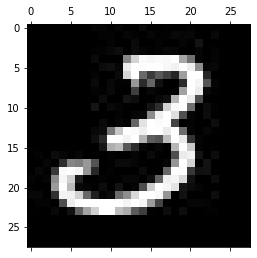

-------------------------------------------
Test: 250
Predicted: 7


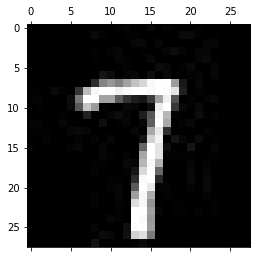

-------------------------------------------
Test: 251
Predicted: 9


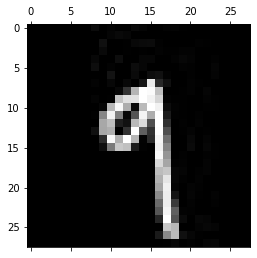

-------------------------------------------
Test: 252
Predicted: 9


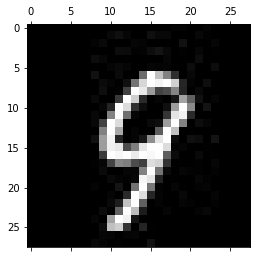

-------------------------------------------
Test: 253
Predicted: 6


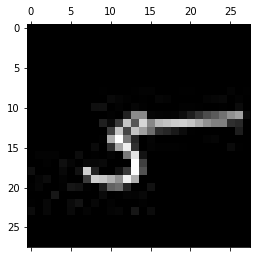

-------------------------------------------
Test: 254
Predicted: 7


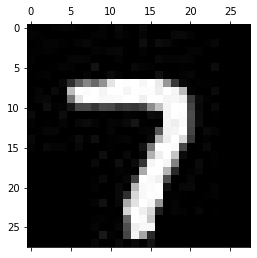

-------------------------------------------
Test: 255
Predicted: 1


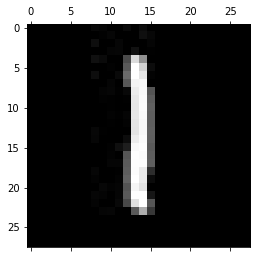

-------------------------------------------
Test: 256
Predicted: 4


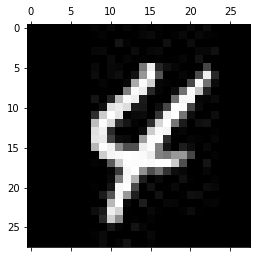

-------------------------------------------
Test: 257
Predicted: 7


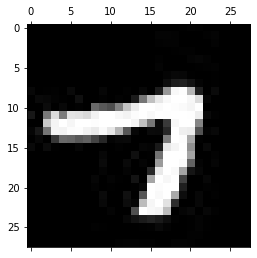

-------------------------------------------
Test: 258
Predicted: 5


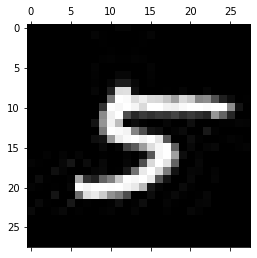

-------------------------------------------
Test: 259
Predicted: 1


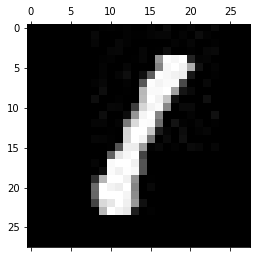

-------------------------------------------
Test: 260
Predicted: 0


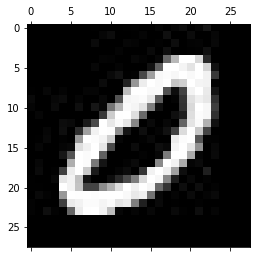

-------------------------------------------
Test: 261
Predicted: 0


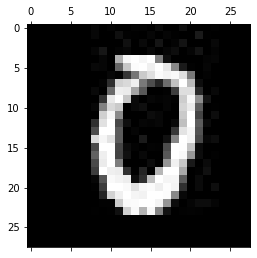

-------------------------------------------
Test: 262
Predicted: 1


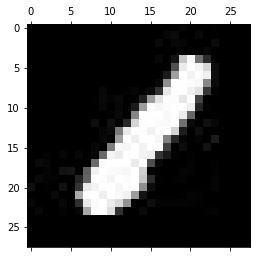

-------------------------------------------
Test: 263
Predicted: 5


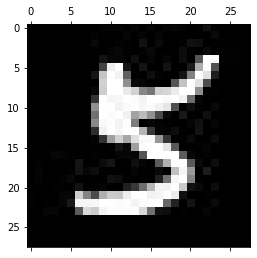

-------------------------------------------
Test: 264
Predicted: 7


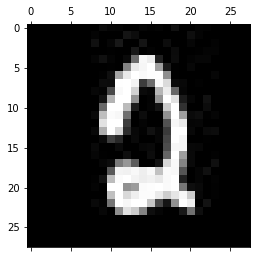

-------------------------------------------
Test: 265
Predicted: 9


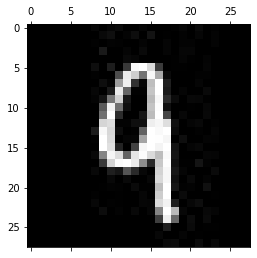

-------------------------------------------
Test: 266
Predicted: 4


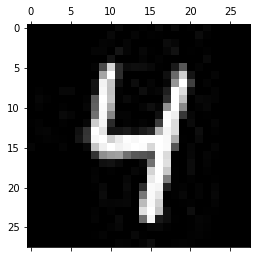

-------------------------------------------
Test: 267
Predicted: 1


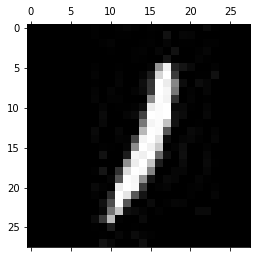

-------------------------------------------
Test: 268
Predicted: 7


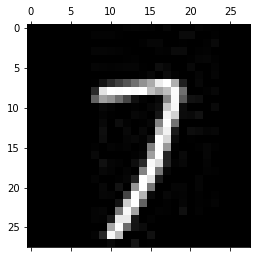

-------------------------------------------
Test: 269
Predicted: 9


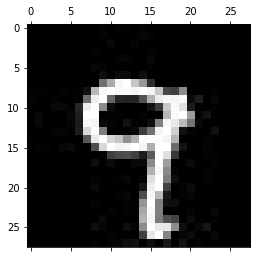

-------------------------------------------
Test: 270
Predicted: 9


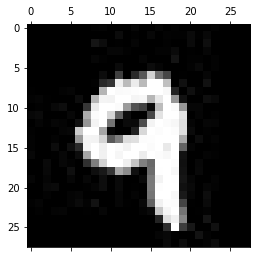

-------------------------------------------
Test: 271
Predicted: 3


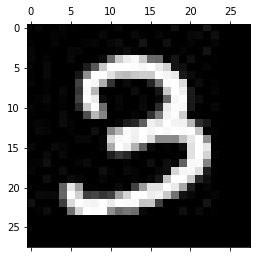

-------------------------------------------
Test: 272
Predicted: 1


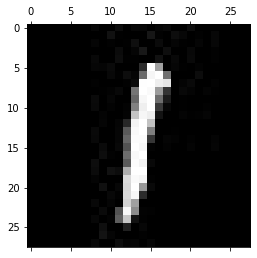

-------------------------------------------
Test: 273
Predicted: 5


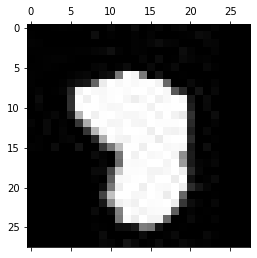

-------------------------------------------
Test: 274
Predicted: 9


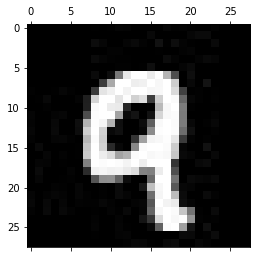

-------------------------------------------
Test: 275
Predicted: 9


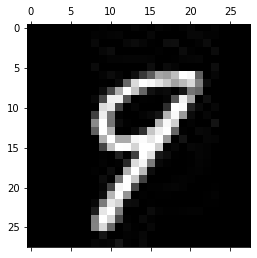

-------------------------------------------
Test: 276
Predicted: 0


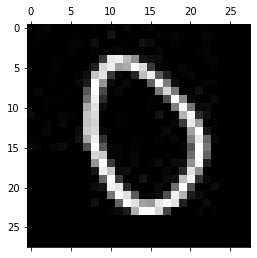

-------------------------------------------
Test: 277
Predicted: 2


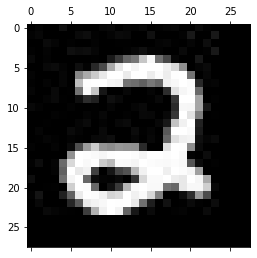

-------------------------------------------
Test: 278
Predicted: 2


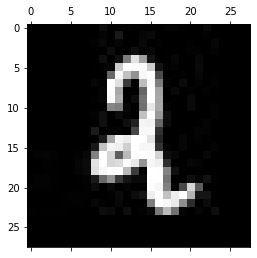

-------------------------------------------
Test: 279
Predicted: 2


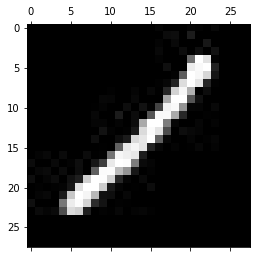

-------------------------------------------
Test: 280
Predicted: 6


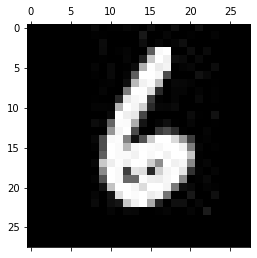

-------------------------------------------
Test: 281
Predicted: 6


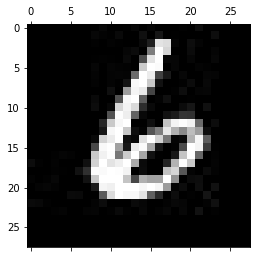

-------------------------------------------
Test: 282
Predicted: 4


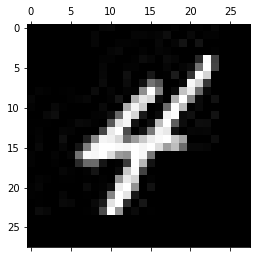

-------------------------------------------
Test: 283
Predicted: 7


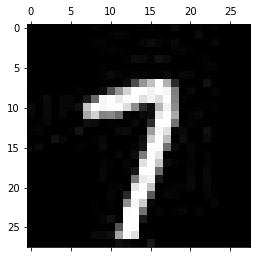

-------------------------------------------
Test: 284
Predicted: 7


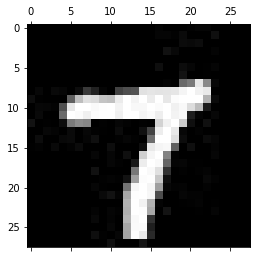

-------------------------------------------
Test: 285
Predicted: 6


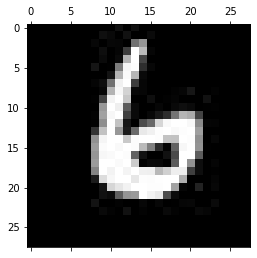

-------------------------------------------
Test: 286
Predicted: 5


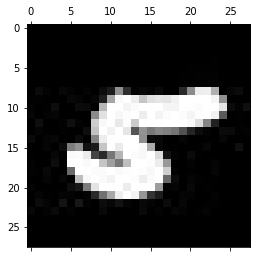

-------------------------------------------
Test: 287
Predicted: 5


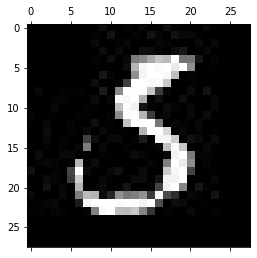

-------------------------------------------
Test: 288
Predicted: 3


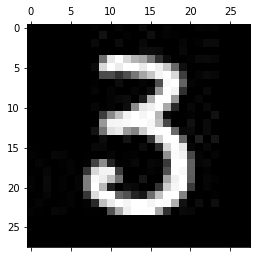

-------------------------------------------
Test: 289
Predicted: 6


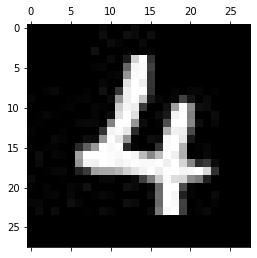

-------------------------------------------
Test: 290
Predicted: 5


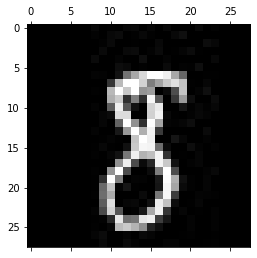

-------------------------------------------
Test: 291
Predicted: 5


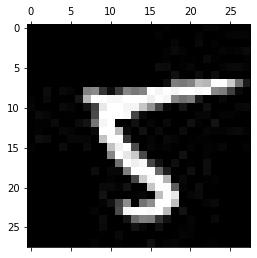

-------------------------------------------
Test: 292
Predicted: 6


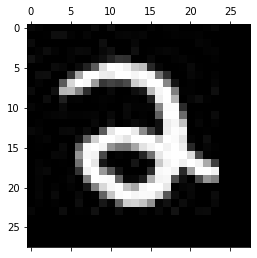

-------------------------------------------
Test: 293
Predicted: 5


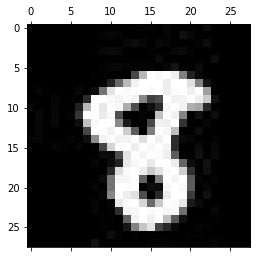

-------------------------------------------
Test: 294
Predicted: 5


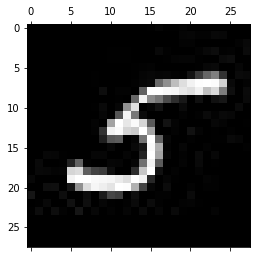

-------------------------------------------
Test: 295
Predicted: 9


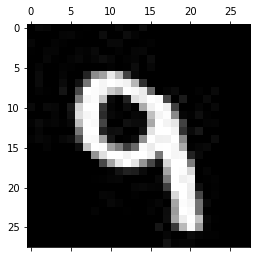

-------------------------------------------
Test: 296
Predicted: 2


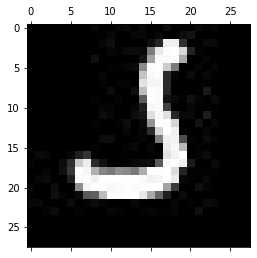

-------------------------------------------
Test: 297
Predicted: 2


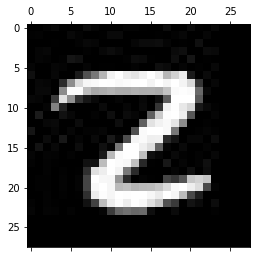

-------------------------------------------
Test: 298
Predicted: 2


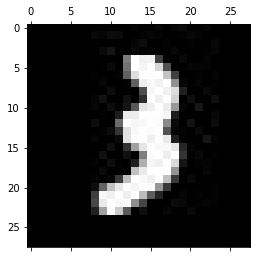

-------------------------------------------
Test: 299
Predicted: 5


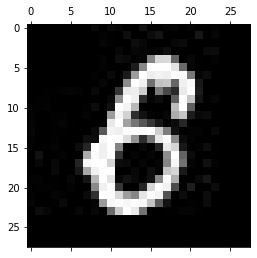

-------------------------------------------
Test: 300
Predicted: 1


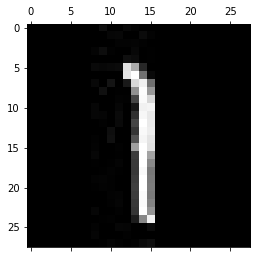

-------------------------------------------
Test: 301
Predicted: 5


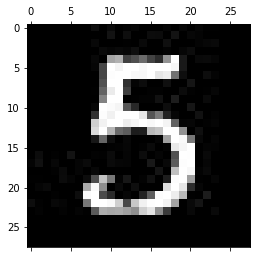

-------------------------------------------
Test: 302
Predicted: 4


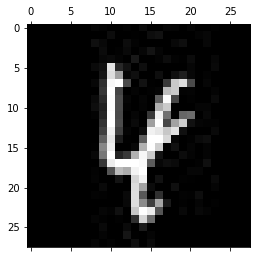

-------------------------------------------
Test: 303
Predicted: 5


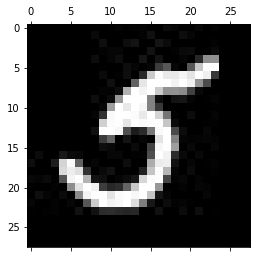

-------------------------------------------
Test: 304
Predicted: 9


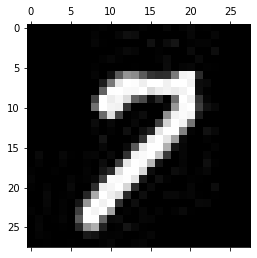

-------------------------------------------
Test: 305
Predicted: 2


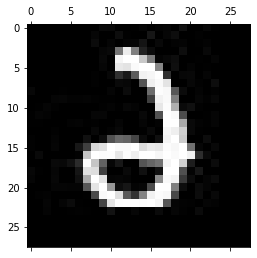

-------------------------------------------
Test: 306
Predicted: 5


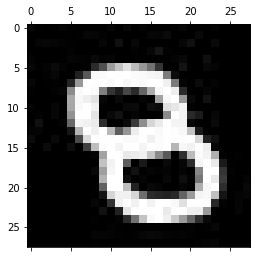

-------------------------------------------
Test: 307
Predicted: 0


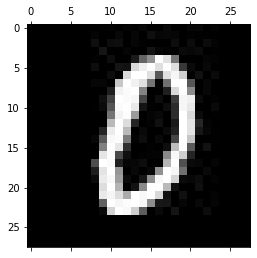

-------------------------------------------
Test: 308
Predicted: 3


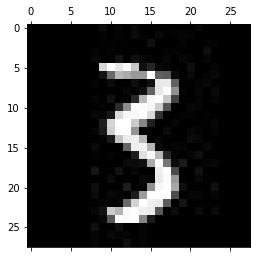

-------------------------------------------
Test: 309
Predicted: 2


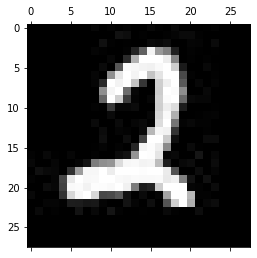

-------------------------------------------
Test: 310
Predicted: 3


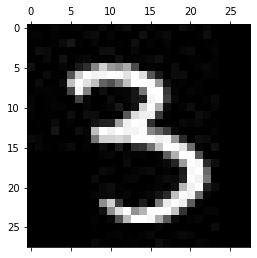

-------------------------------------------
Test: 311
Predicted: 2


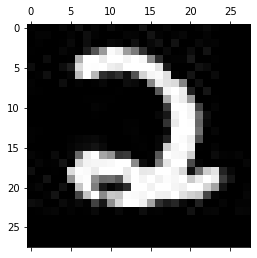

-------------------------------------------
Test: 312
Predicted: 2


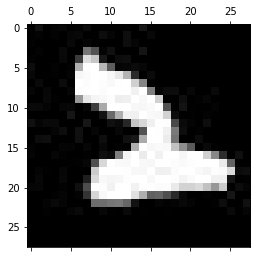

-------------------------------------------
Test: 313
Predicted: 2


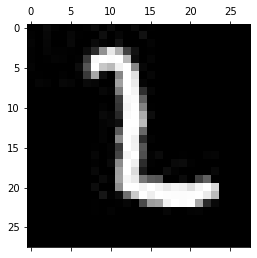

-------------------------------------------
Test: 314
Predicted: 5


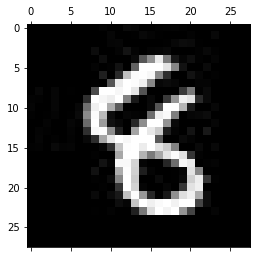

-------------------------------------------
Test: 315
Predicted: 5


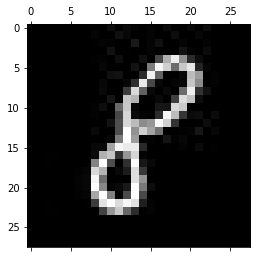

-------------------------------------------
Test: 316
Predicted: 6


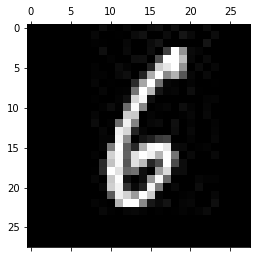

-------------------------------------------
Test: 317
Predicted: 1


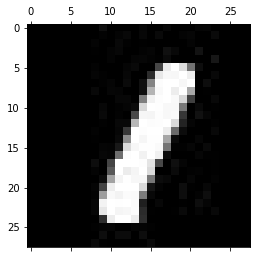

-------------------------------------------
Test: 318
Predicted: 2


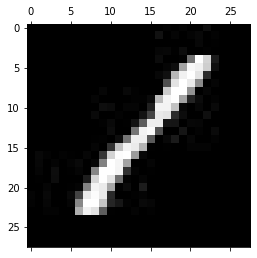

-------------------------------------------
Test: 319
Predicted: 7


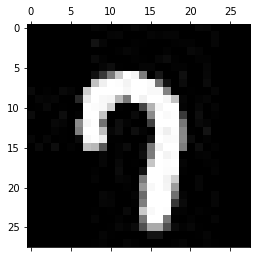

-------------------------------------------
Test: 320
Predicted: 6


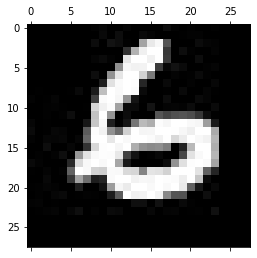

-------------------------------------------
Test: 321
Predicted: 5


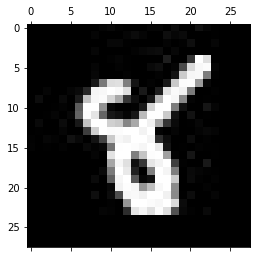

-------------------------------------------
Test: 322
Predicted: 6


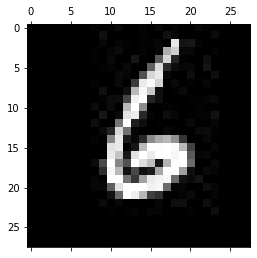

-------------------------------------------
Test: 323
Predicted: 0


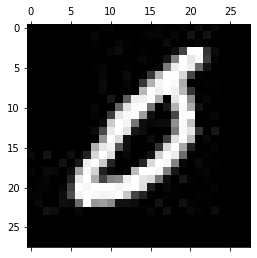

-------------------------------------------
Test: 324
Predicted: 2


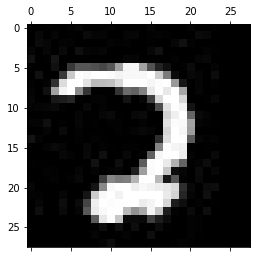

-------------------------------------------
Test: 325
Predicted: 5


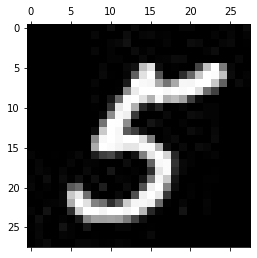

-------------------------------------------
Test: 326
Predicted: 4


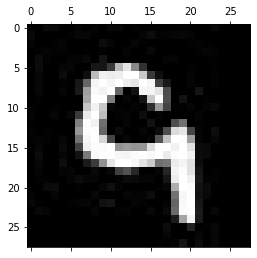

-------------------------------------------
Test: 327
Predicted: 1


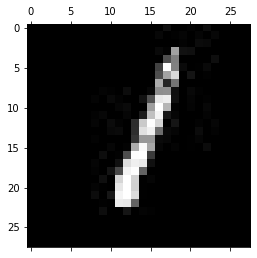

-------------------------------------------
Test: 328
Predicted: 1


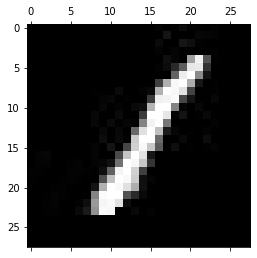

-------------------------------------------
Test: 329
Predicted: 7


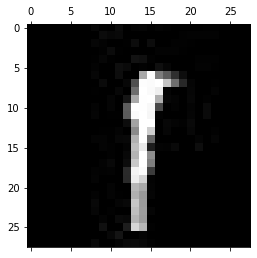

-------------------------------------------
Test: 330
Predicted: 5


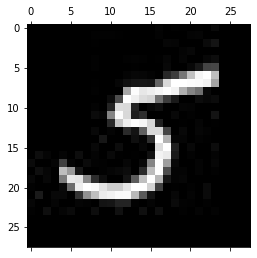

-------------------------------------------
Test: 331
Predicted: 3


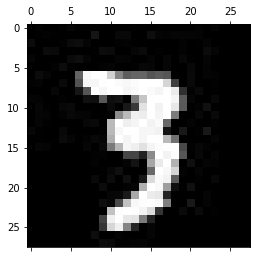

-------------------------------------------
Test: 332
Predicted: 5


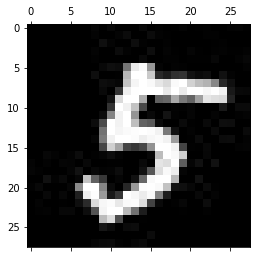

-------------------------------------------
Test: 333
Predicted: 4


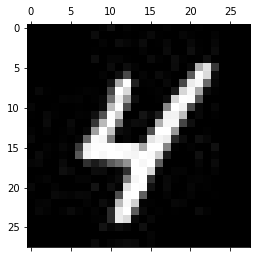

-------------------------------------------
Test: 334
Predicted: 6


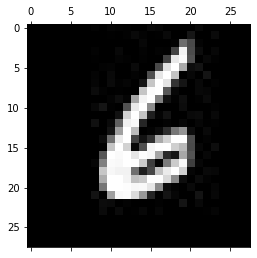

-------------------------------------------
Test: 335
Predicted: 5


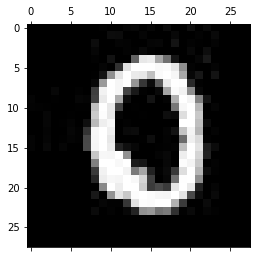

-------------------------------------------
Test: 336
Predicted: 6


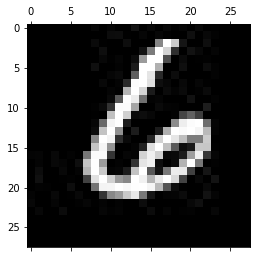

-------------------------------------------
Test: 337
Predicted: 5


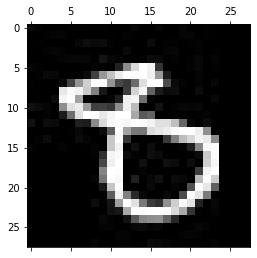

-------------------------------------------
Test: 338
Predicted: 4


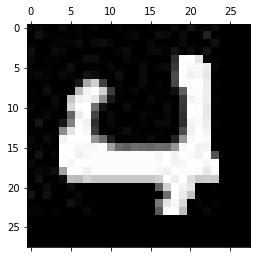

-------------------------------------------
Test: 339
Predicted: 0


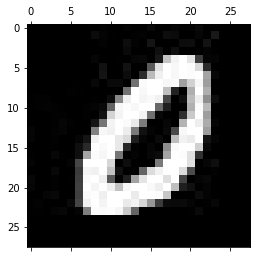

-------------------------------------------
Test: 340
Predicted: 5


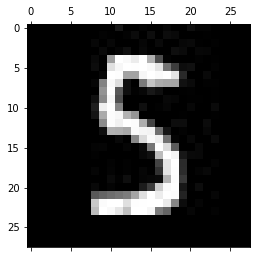

-------------------------------------------
Test: 341
Predicted: 4


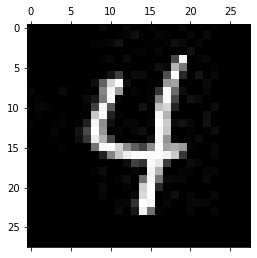

-------------------------------------------
Test: 342
Predicted: 4


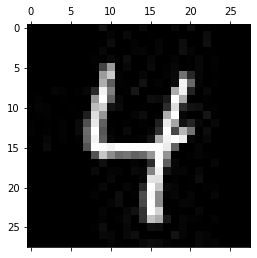

-------------------------------------------
Test: 343
Predicted: 9


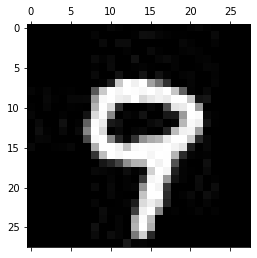

-------------------------------------------
Test: 344
Predicted: 2


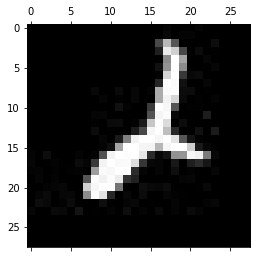

-------------------------------------------
Test: 345
Predicted: 5


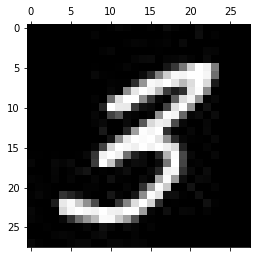

-------------------------------------------
Test: 346
Predicted: 3


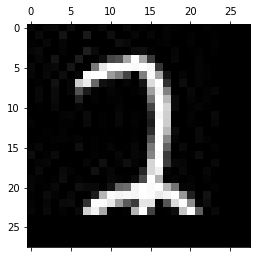

-------------------------------------------
Test: 347
Predicted: 0


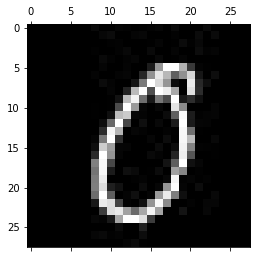

-------------------------------------------
Test: 348
Predicted: 5


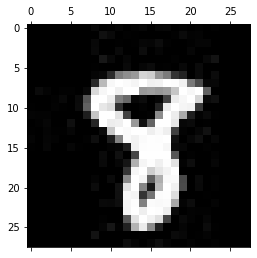

-------------------------------------------
Test: 349
Predicted: 7


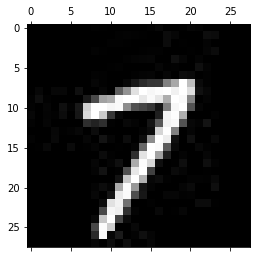

-------------------------------------------
Test: 350
Predicted: 5


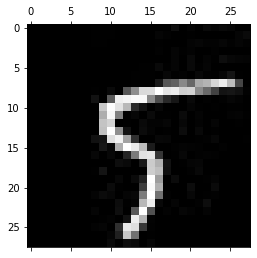

-------------------------------------------
Test: 351
Predicted: 2


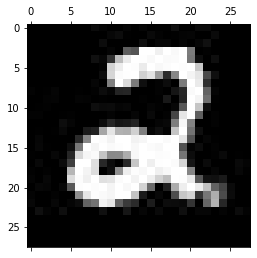

-------------------------------------------
Test: 352
Predicted: 5


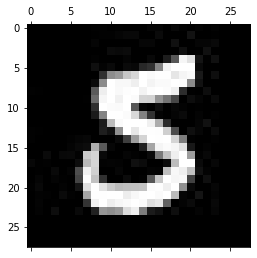

-------------------------------------------
Test: 353
Predicted: 5


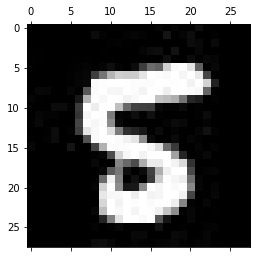

-------------------------------------------
Test: 354
Predicted: 1


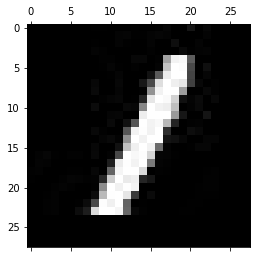

-------------------------------------------
Test: 355
Predicted: 7


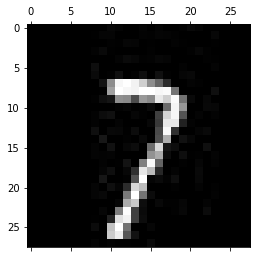

-------------------------------------------
Test: 356
Predicted: 4


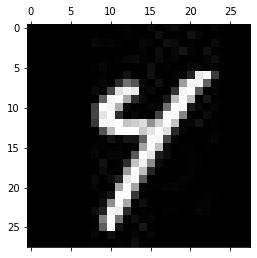

-------------------------------------------
Test: 357
Predicted: 9


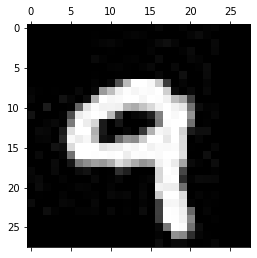

-------------------------------------------
Test: 358
Predicted: 2


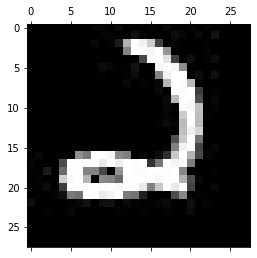

-------------------------------------------
Test: 359
Predicted: 6


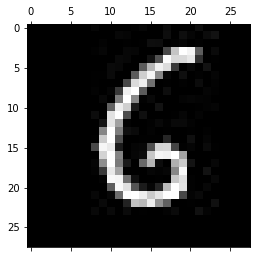

-------------------------------------------
Test: 360
Predicted: 7


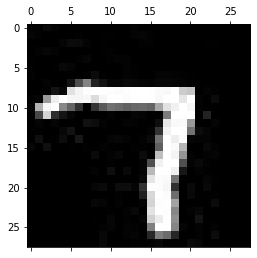

-------------------------------------------
Test: 361
Predicted: 5


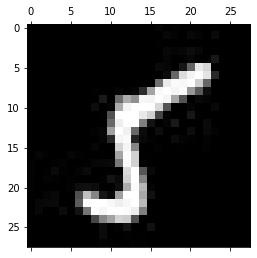

-------------------------------------------
Test: 362
Predicted: 2


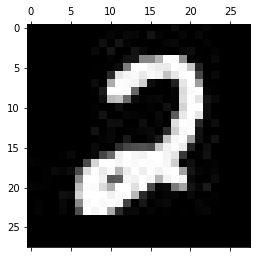

-------------------------------------------
Test: 363
Predicted: 2


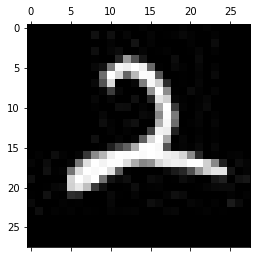

-------------------------------------------
Test: 364
Predicted: 7


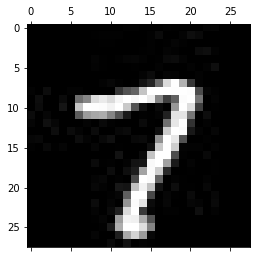

-------------------------------------------
Test: 365
Predicted: 9


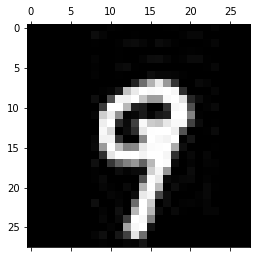

-------------------------------------------
Test: 366
Predicted: 7


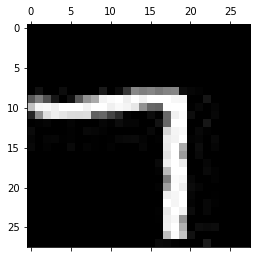

-------------------------------------------
Test: 367
Predicted: 1


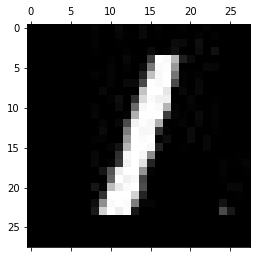

-------------------------------------------
Test: 368
Predicted: 6


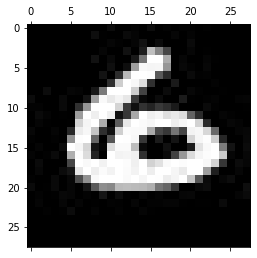

-------------------------------------------
Test: 369
Predicted: 6


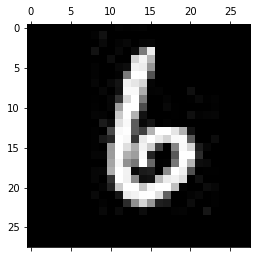

-------------------------------------------
Test: 370
Predicted: 7


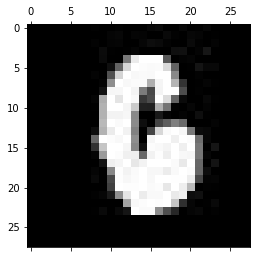

-------------------------------------------
Test: 371
Predicted: 0


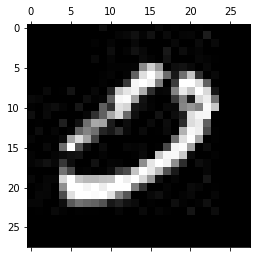

-------------------------------------------
Test: 372
Predicted: 6


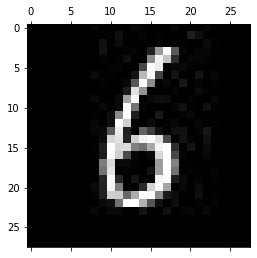

-------------------------------------------
Test: 373
Predicted: 2


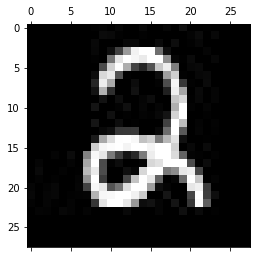

-------------------------------------------
Test: 374
Predicted: 0


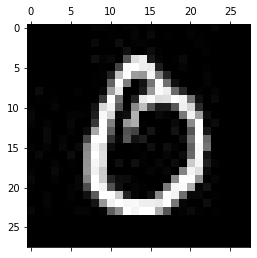

-------------------------------------------
Test: 375
Predicted: 5


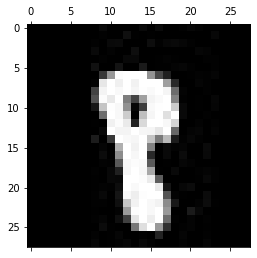

-------------------------------------------
Test: 376
Predicted: 1


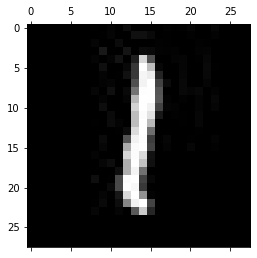

-------------------------------------------
Test: 377
Predicted: 6


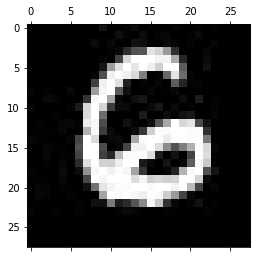

-------------------------------------------
Test: 378
Predicted: 4


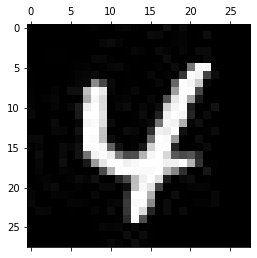

-------------------------------------------
Test: 379
Predicted: 9


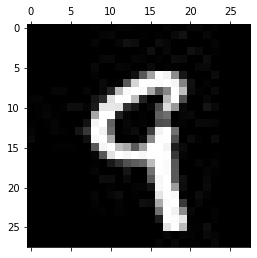

-------------------------------------------
Test: 380
Predicted: 0


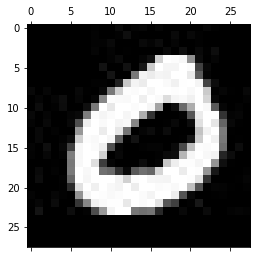

-------------------------------------------
Test: 381
Predicted: 4


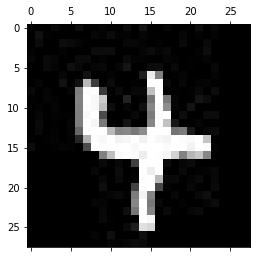

-------------------------------------------
Test: 382
Predicted: 5


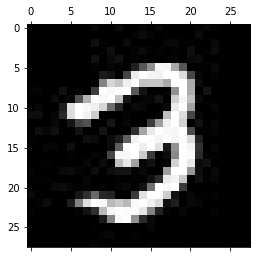

-------------------------------------------
Test: 383
Predicted: 7


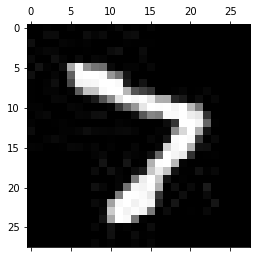

-------------------------------------------
Test: 384
Predicted: 0


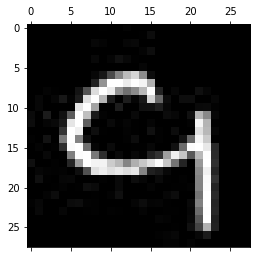

-------------------------------------------
Test: 385
Predicted: 9


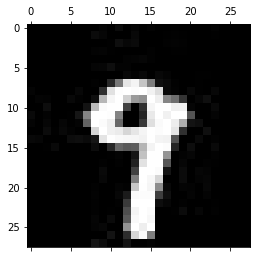

-------------------------------------------
Test: 386
Predicted: 0


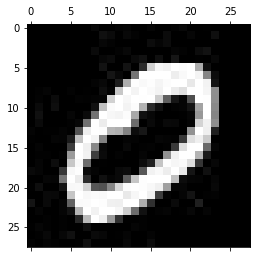

-------------------------------------------
Test: 387
Predicted: 5


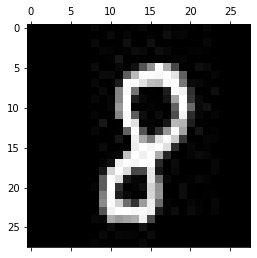

-------------------------------------------
Test: 388
Predicted: 9


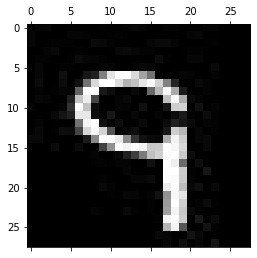

-------------------------------------------
Test: 389
Predicted: 5


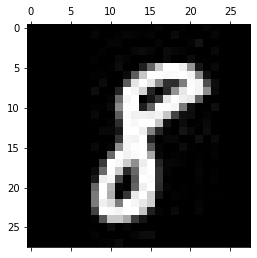

-------------------------------------------
Test: 390
Predicted: 4


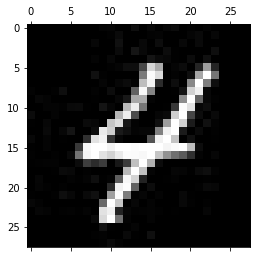

-------------------------------------------
Test: 391
Predicted: 3


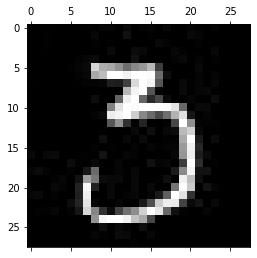

-------------------------------------------
Test: 392
Predicted: 1


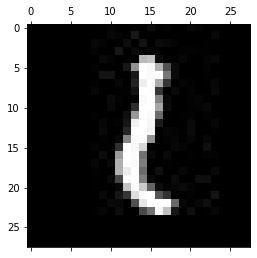

-------------------------------------------
Test: 393
Predicted: 9


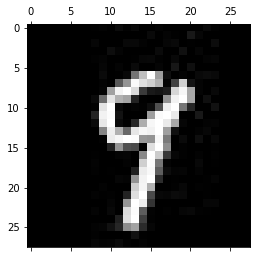

-------------------------------------------
Test: 394
Predicted: 5


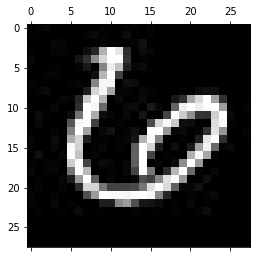

-------------------------------------------
Test: 395
Predicted: 9


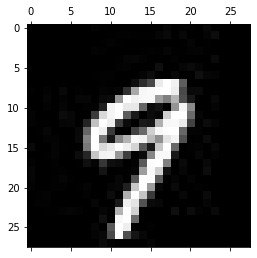

-------------------------------------------
Test: 396
Predicted: 7


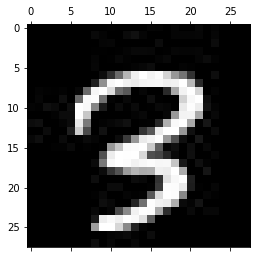

-------------------------------------------
Test: 397
Predicted: 6


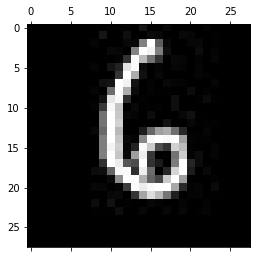

-------------------------------------------
Test: 398
Predicted: 3


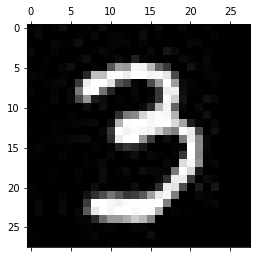

-------------------------------------------
Test: 399
Predicted: 5


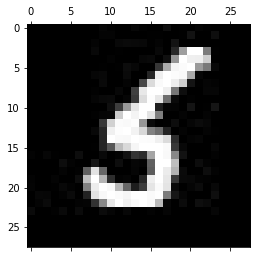

-------------------------------------------
Test: 400
Predicted: 5


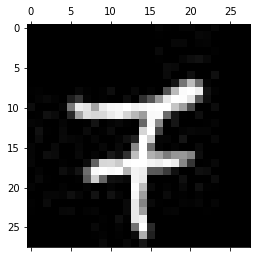

-------------------------------------------
Test: 401
Predicted: 5


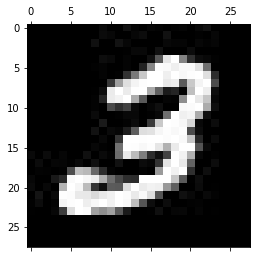

-------------------------------------------
Test: 402
Predicted: 5


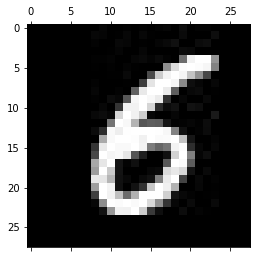

-------------------------------------------
Test: 403
Predicted: 6


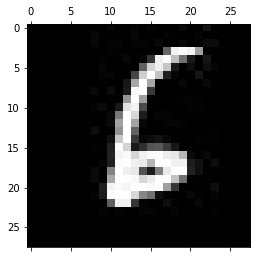

-------------------------------------------
Test: 404
Predicted: 1


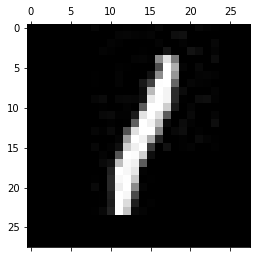

-------------------------------------------
Test: 405
Predicted: 5


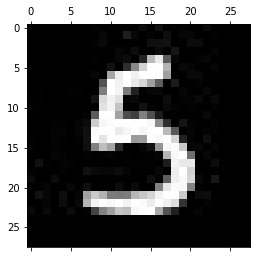

-------------------------------------------
Test: 406
Predicted: 5


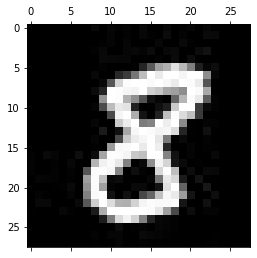

-------------------------------------------
Test: 407
Predicted: 6


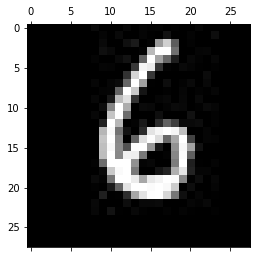

-------------------------------------------
Test: 408
Predicted: 2


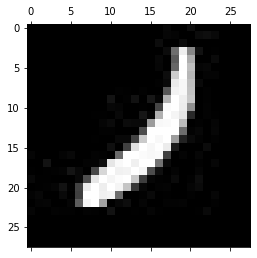

-------------------------------------------
Test: 409
Predicted: 1


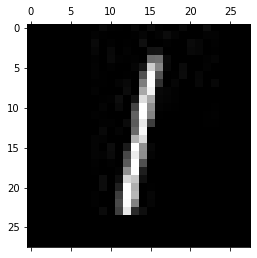

-------------------------------------------
Test: 410
Predicted: 6


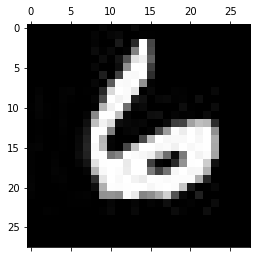

-------------------------------------------
Test: 411
Predicted: 5


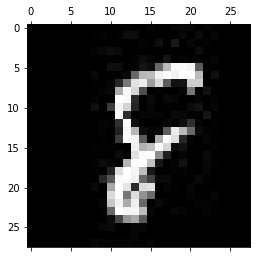

-------------------------------------------
Test: 412
Predicted: 3


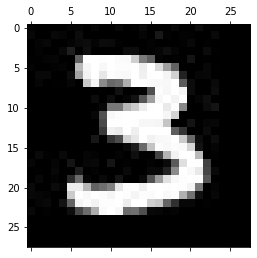

-------------------------------------------
Test: 413
Predicted: 7


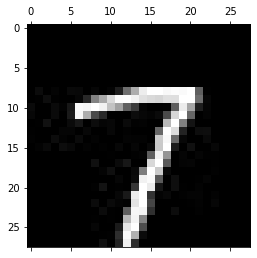

-------------------------------------------
Test: 414
Predicted: 9


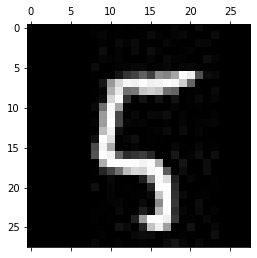

-------------------------------------------
Test: 415
Predicted: 5


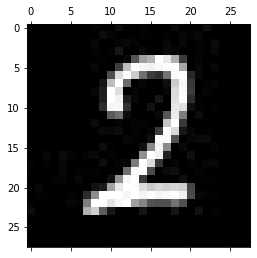

-------------------------------------------
Test: 416
Predicted: 9


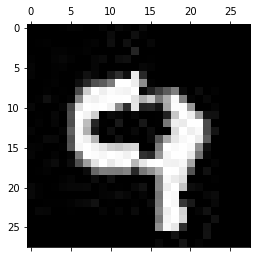

-------------------------------------------
Test: 417
Predicted: 5


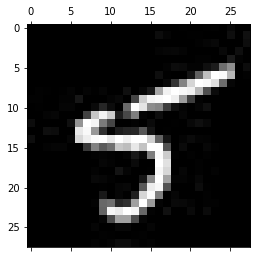

-------------------------------------------
Test: 418
Predicted: 5


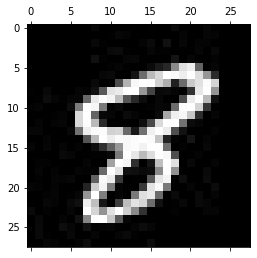

-------------------------------------------
Test: 419
Predicted: 2


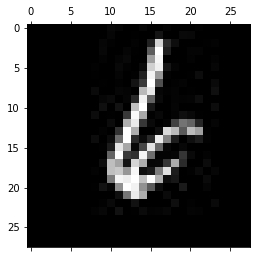

-------------------------------------------
Test: 420
Predicted: 6


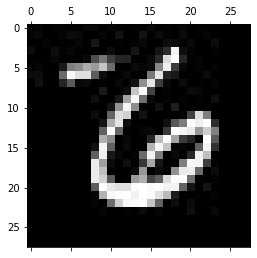

-------------------------------------------
Test: 421
Predicted: 0


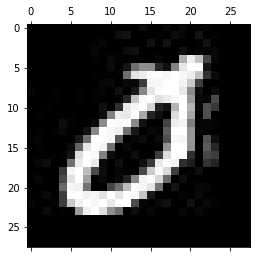

-------------------------------------------
Test: 422
Predicted: 5


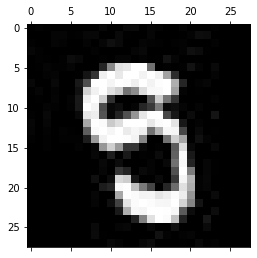

-------------------------------------------
Test: 423
Predicted: 6


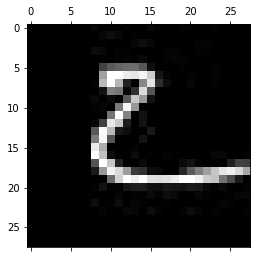

-------------------------------------------
Test: 424
Predicted: 2


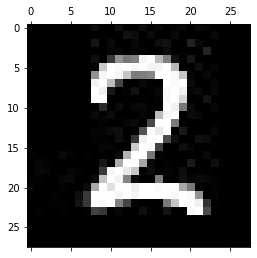

-------------------------------------------
Test: 425
Predicted: 9


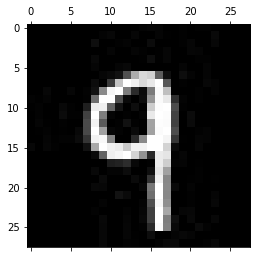

-------------------------------------------
Test: 426
Predicted: 5


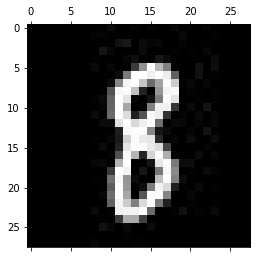

-------------------------------------------
Test: 427
Predicted: 2


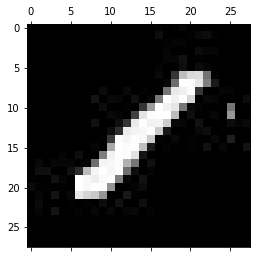

-------------------------------------------
Test: 428
Predicted: 0


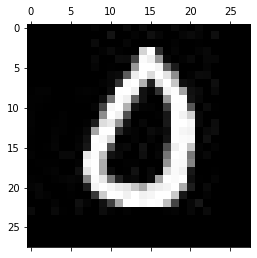

-------------------------------------------
Test: 429
Predicted: 7


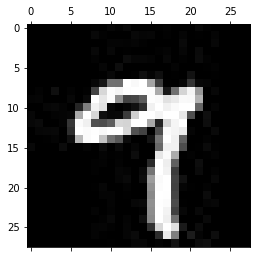

-------------------------------------------
Test: 430
Predicted: 6


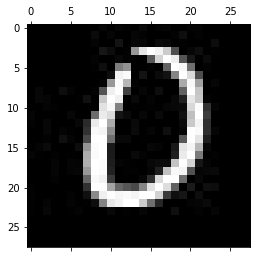

-------------------------------------------
Test: 431
Predicted: 9


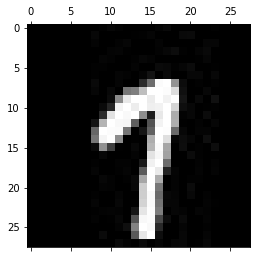

-------------------------------------------
Test: 432
Predicted: 4


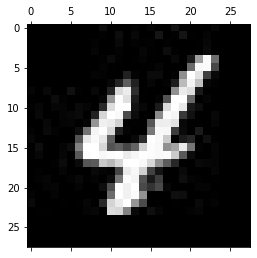

-------------------------------------------
Test: 433
Predicted: 5


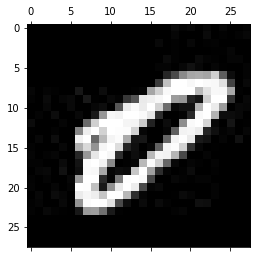

-------------------------------------------
Test: 434
Predicted: 0


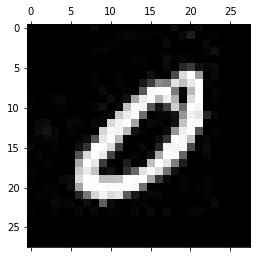

-------------------------------------------
Test: 435
Predicted: 5


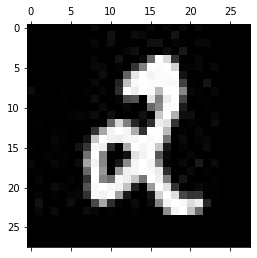

-------------------------------------------
Test: 436
Predicted: 2


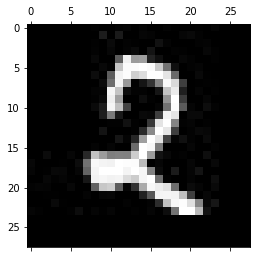

-------------------------------------------
Test: 437
Predicted: 6


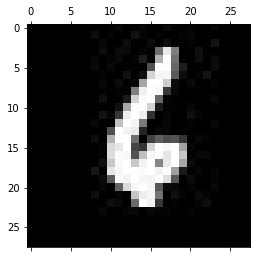

-------------------------------------------
Test: 438
Predicted: 0


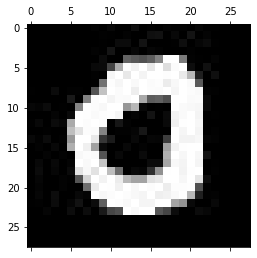

-------------------------------------------
Test: 439
Predicted: 3


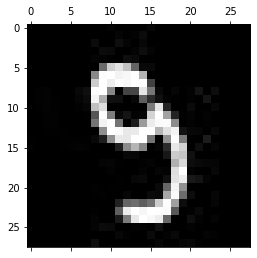

-------------------------------------------
Test: 440
Predicted: 2


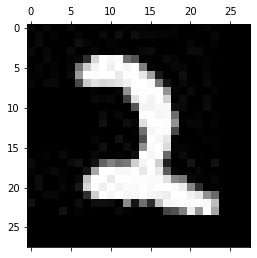

-------------------------------------------
Test: 441
Predicted: 0


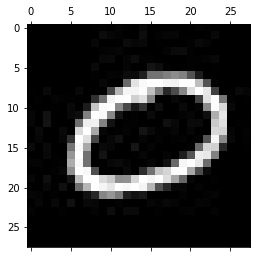

-------------------------------------------
Test: 442
Predicted: 5


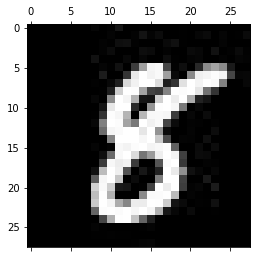

-------------------------------------------
Test: 443
Predicted: 6


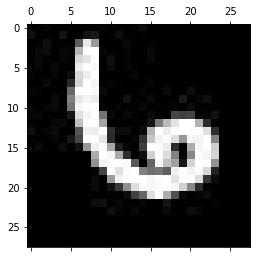

-------------------------------------------
Test: 444
Predicted: 2


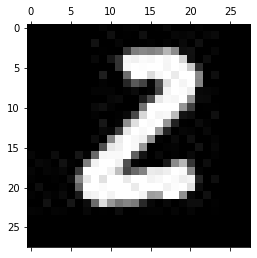

-------------------------------------------
Test: 445
Predicted: 6


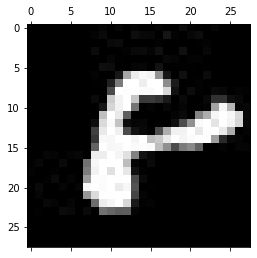

-------------------------------------------
Test: 446
Predicted: 5


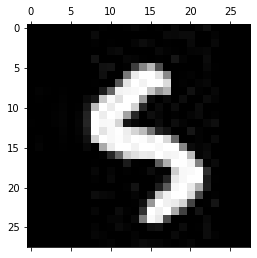

-------------------------------------------
Test: 447
Predicted: 2


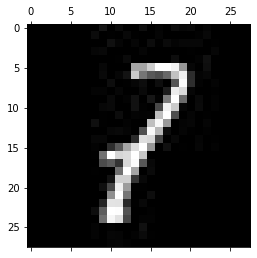

-------------------------------------------
Test: 448
Predicted: 6


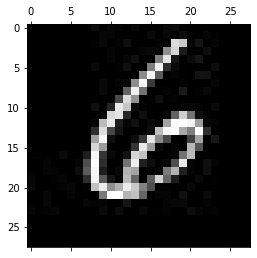

-------------------------------------------
Test: 449
Predicted: 2


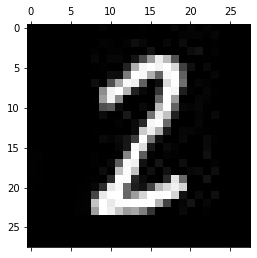

-------------------------------------------
Test: 450
Predicted: 3


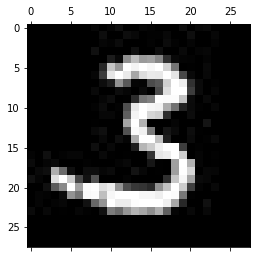

-------------------------------------------
Test: 451
Predicted: 5


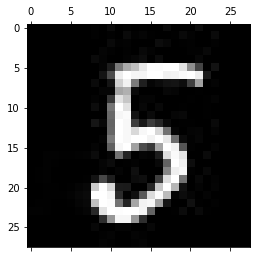

-------------------------------------------
Test: 452
Predicted: 5


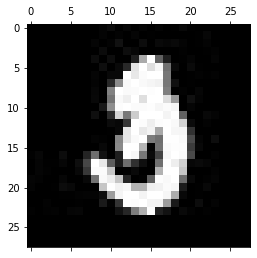

-------------------------------------------
Test: 453
Predicted: 2


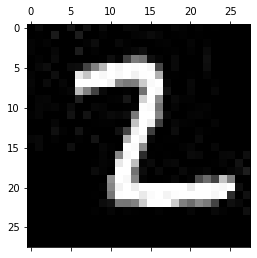

-------------------------------------------
Test: 454
Predicted: 9


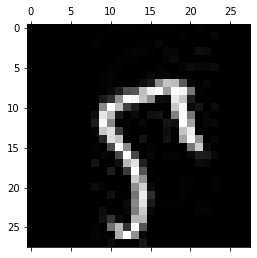

-------------------------------------------
Test: 455
Predicted: 4


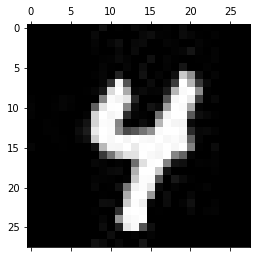

-------------------------------------------
Test: 456
Predicted: 5


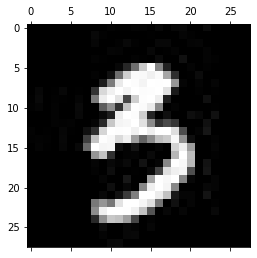

-------------------------------------------
Test: 457
Predicted: 3


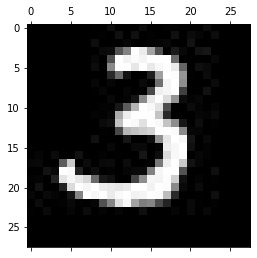

-------------------------------------------
Test: 458
Predicted: 7


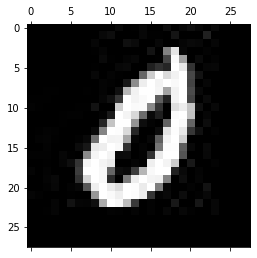

-------------------------------------------
Test: 459
Predicted: 6


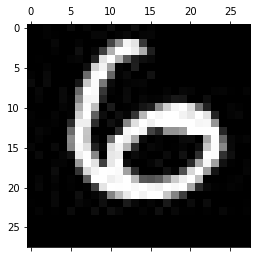

-------------------------------------------
Test: 460
Predicted: 7


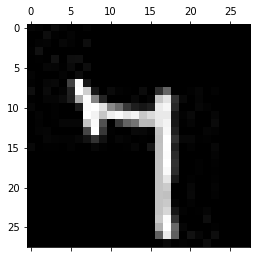

-------------------------------------------
Test: 461
Predicted: 5


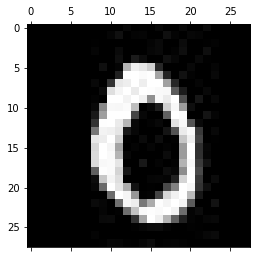

-------------------------------------------
Test: 462
Predicted: 5


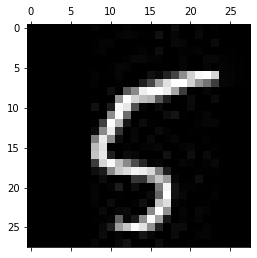

-------------------------------------------
Test: 463
Predicted: 3


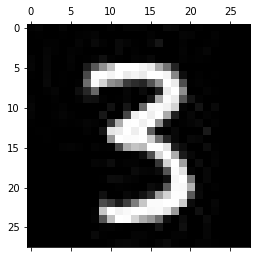

-------------------------------------------
Test: 464
Predicted: 2


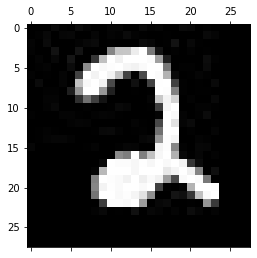

-------------------------------------------
Test: 465
Predicted: 2


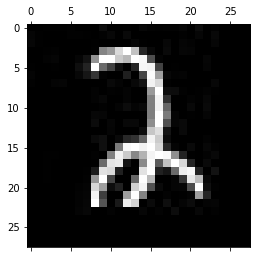

-------------------------------------------
Test: 466
Predicted: 2


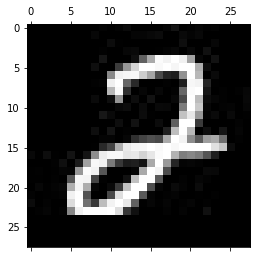

-------------------------------------------
Test: 467
Predicted: 2


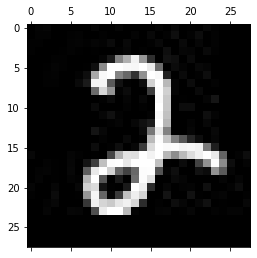

-------------------------------------------
Test: 468
Predicted: 5


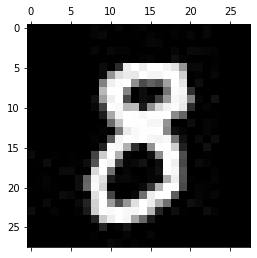

-------------------------------------------
Test: 469
Predicted: 2


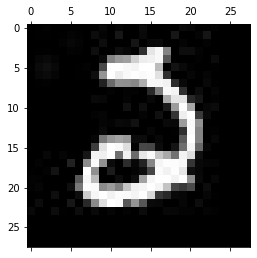

-------------------------------------------
Test: 470
Predicted: 5


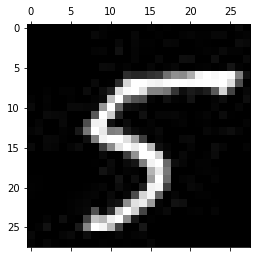

-------------------------------------------
Test: 471
Predicted: 7


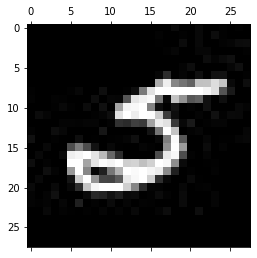

-------------------------------------------
Test: 472
Predicted: 0


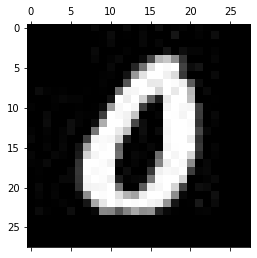

-------------------------------------------
Test: 473
Predicted: 0


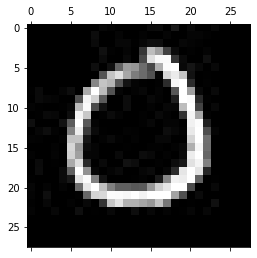

-------------------------------------------
Test: 474
Predicted: 9


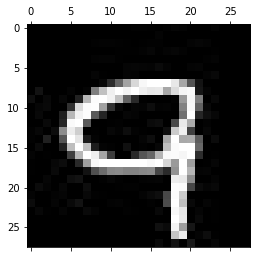

-------------------------------------------
Test: 475
Predicted: 1


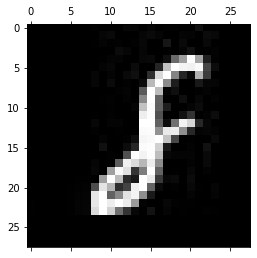

-------------------------------------------
Test: 476
Predicted: 2


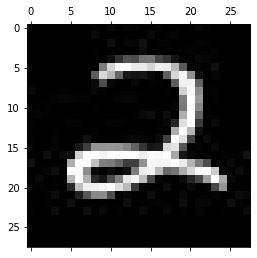

-------------------------------------------
Test: 477
Predicted: 0


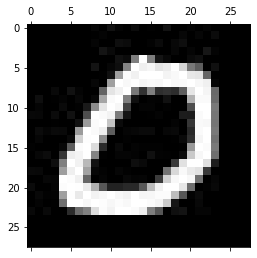

-------------------------------------------
Test: 478
Predicted: 7


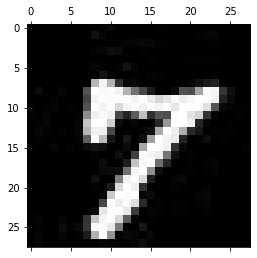

-------------------------------------------
Test: 479
Predicted: 1


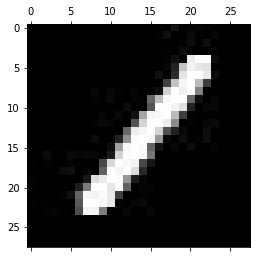

-------------------------------------------
Test: 480
Predicted: 5


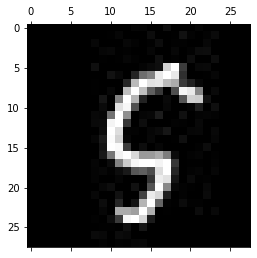

-------------------------------------------
Test: 481
Predicted: 5


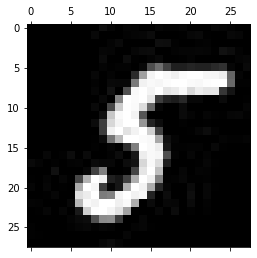

-------------------------------------------
Test: 482
Predicted: 9


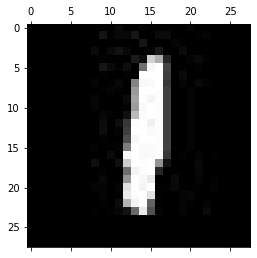

-------------------------------------------
Test: 483
Predicted: 1


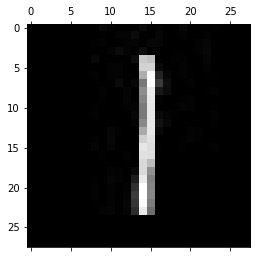

-------------------------------------------
Test: 484
Predicted: 5


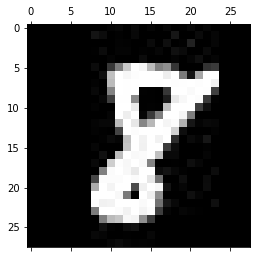

-------------------------------------------
Test: 485
Predicted: 0


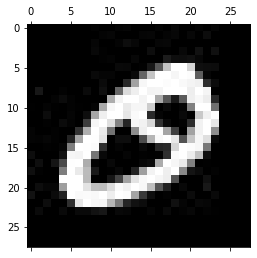

-------------------------------------------
Test: 486
Predicted: 3


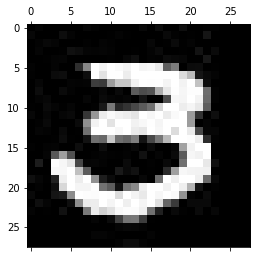

-------------------------------------------
Test: 487
Predicted: 6


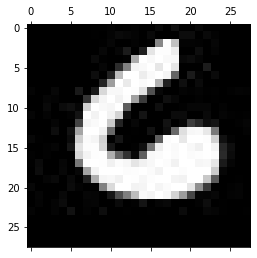

-------------------------------------------
Test: 488
Predicted: 5


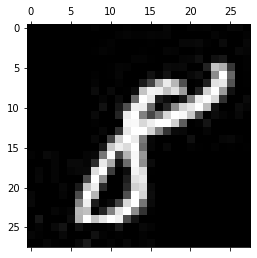

-------------------------------------------
Test: 489
Predicted: 0


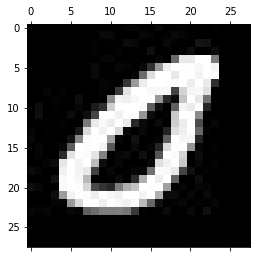

-------------------------------------------
Test: 490
Predicted: 9


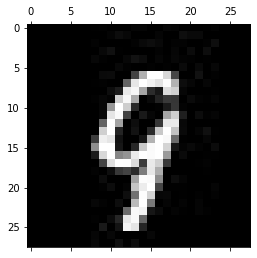

-------------------------------------------
Test: 491
Predicted: 7


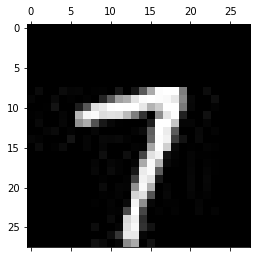

-------------------------------------------
Test: 492
Predicted: 9


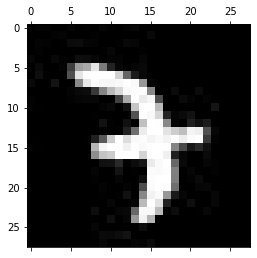

-------------------------------------------
Test: 493
Predicted: 5


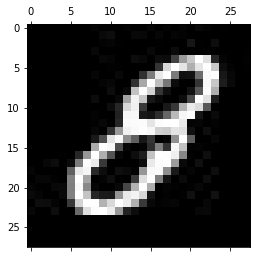

-------------------------------------------
Test: 494
Predicted: 5


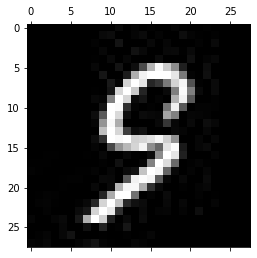

-------------------------------------------
Test: 495
Predicted: 9


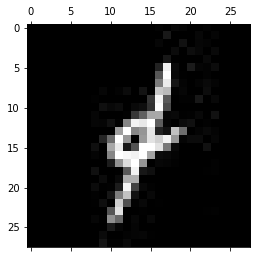

-------------------------------------------
Test: 496
Predicted: 0


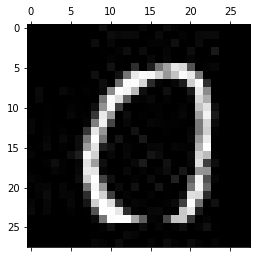

-------------------------------------------
Test: 497
Predicted: 9


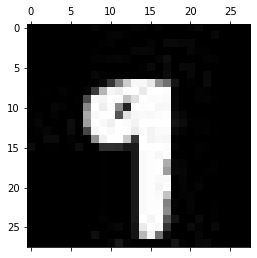

-------------------------------------------
Test: 498
Predicted: 5


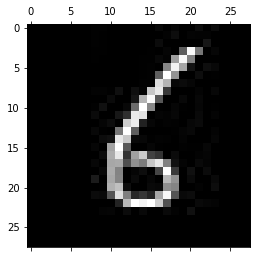

-------------------------------------------
Test: 499
Predicted: 2


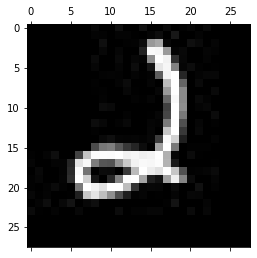

-------------------------------------------
Test: 500
Predicted: 0


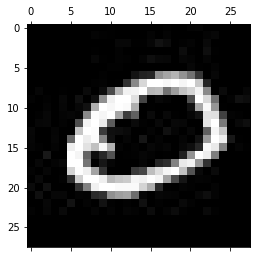

-------------------------------------------
Test: 501
Predicted: 5


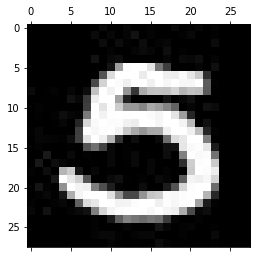

-------------------------------------------
Test: 502
Predicted: 6


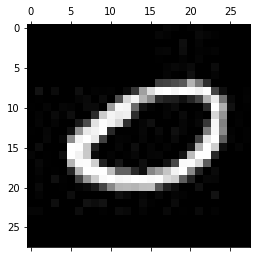

-------------------------------------------
Test: 503
Predicted: 1


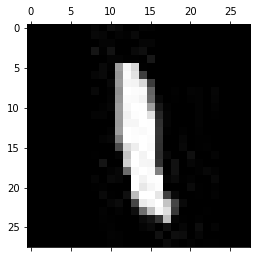

-------------------------------------------
Test: 504
Predicted: 1


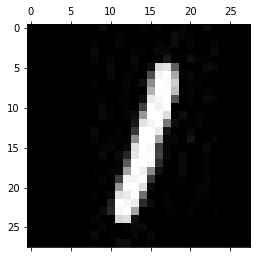

-------------------------------------------
Test: 505
Predicted: 5


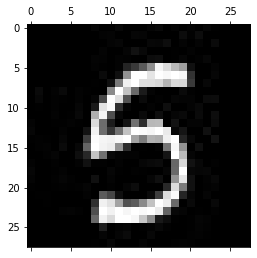

-------------------------------------------
Test: 506
Predicted: 1


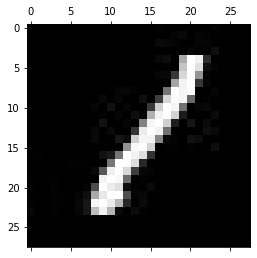

-------------------------------------------
Test: 507
Predicted: 6


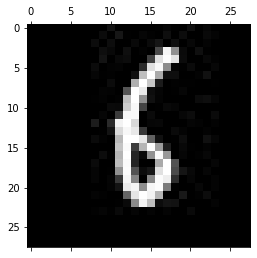

-------------------------------------------
Test: 508
Predicted: 2


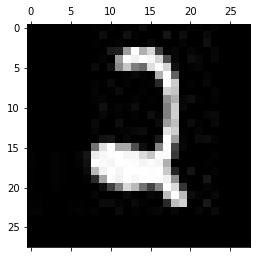

-------------------------------------------
Test: 509
Predicted: 3


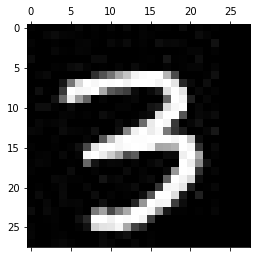

-------------------------------------------
Test: 510
Predicted: 7


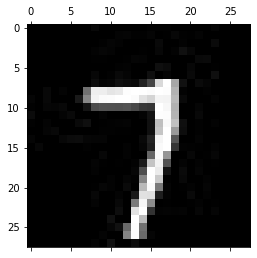

-------------------------------------------
Test: 511
Predicted: 0


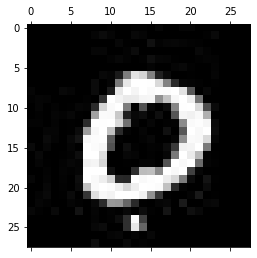

-------------------------------------------
Test: 512
Predicted: 6


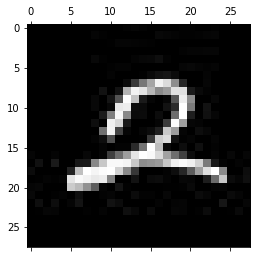

-------------------------------------------
Test: 513
Predicted: 6


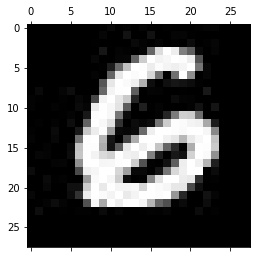

-------------------------------------------
Test: 514
Predicted: 1


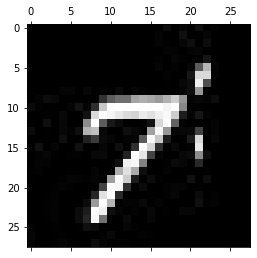

-------------------------------------------
Test: 515
Predicted: 5


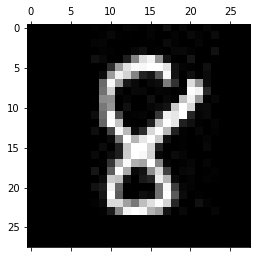

-------------------------------------------
Test: 516
Predicted: 4


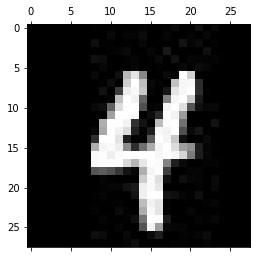

-------------------------------------------
Test: 517
Predicted: 3


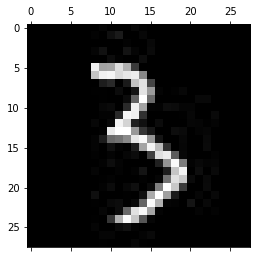

-------------------------------------------
Test: 518
Predicted: 9


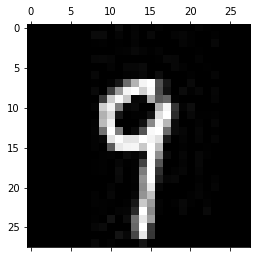

-------------------------------------------
Test: 519
Predicted: 7


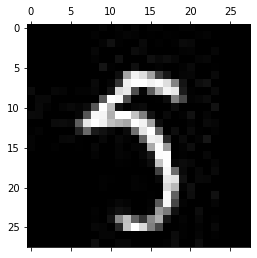

-------------------------------------------
Test: 520
Predicted: 6


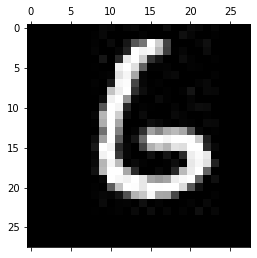

-------------------------------------------
Test: 521
Predicted: 0


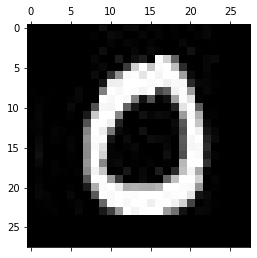

-------------------------------------------
Test: 522
Predicted: 6


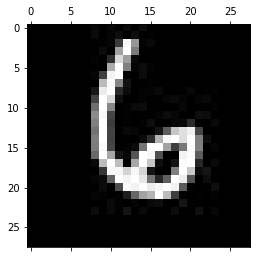

-------------------------------------------
Test: 523
Predicted: 1


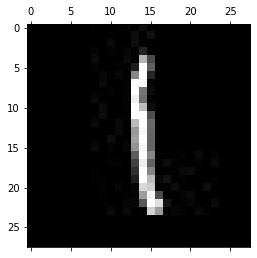

-------------------------------------------
Test: 524
Predicted: 5


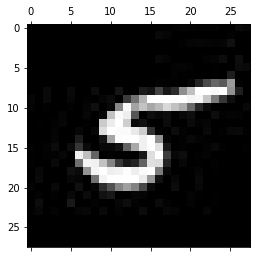

-------------------------------------------
Test: 525
Predicted: 2


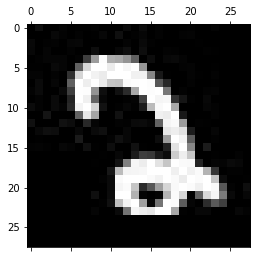

-------------------------------------------
Test: 526
Predicted: 9


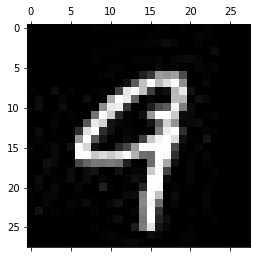

-------------------------------------------
Test: 527
Predicted: 0


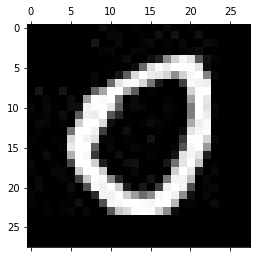

-------------------------------------------
Test: 528
Predicted: 6


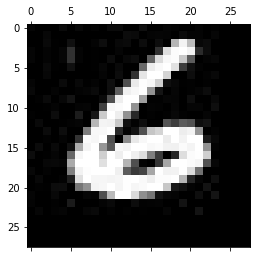

-------------------------------------------
Test: 529
Predicted: 4


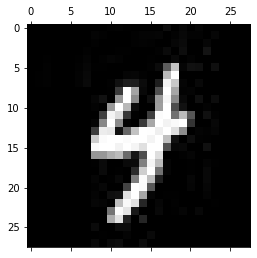

-------------------------------------------
Test: 530
Predicted: 6


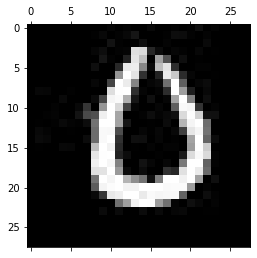

-------------------------------------------
Test: 531
Predicted: 6


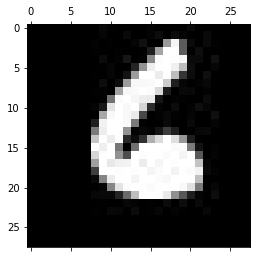

-------------------------------------------
Test: 532
Predicted: 0


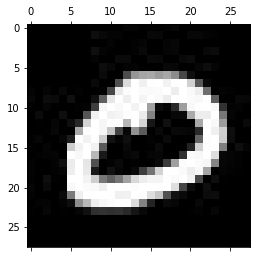

-------------------------------------------
Test: 533
Predicted: 2


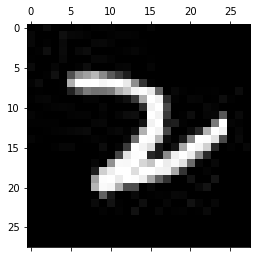

-------------------------------------------
Test: 534
Predicted: 5


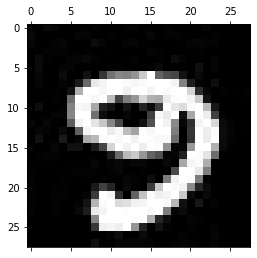

-------------------------------------------
Test: 535
Predicted: 6


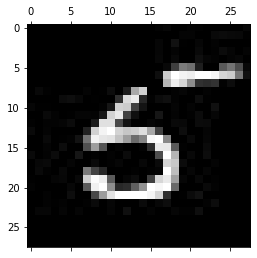

-------------------------------------------
Test: 536
Predicted: 0


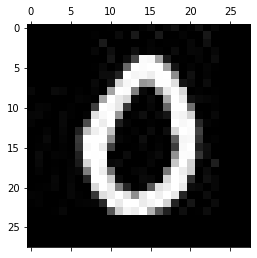

-------------------------------------------
Test: 537
Predicted: 1


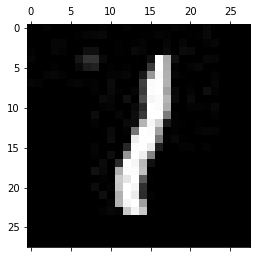

-------------------------------------------
Test: 538
Predicted: 6


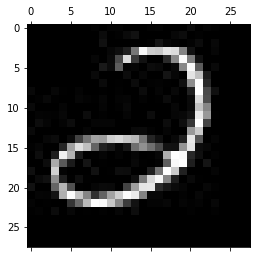

-------------------------------------------
Test: 539
Predicted: 0


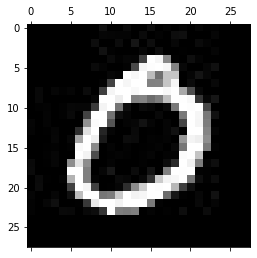

-------------------------------------------
Test: 540
Predicted: 4


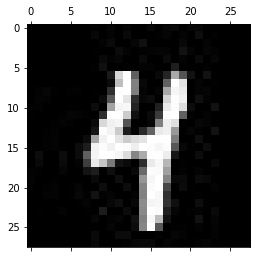

-------------------------------------------
Test: 541
Predicted: 2


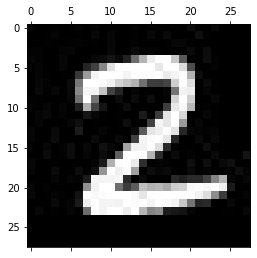

-------------------------------------------
Test: 542
Predicted: 1


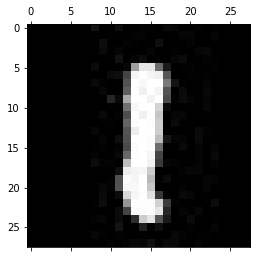

-------------------------------------------
Test: 543
Predicted: 5


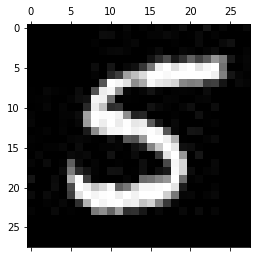

-------------------------------------------
Test: 544
Predicted: 7


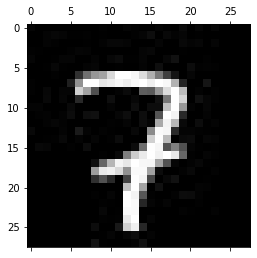

-------------------------------------------
Test: 545
Predicted: 1


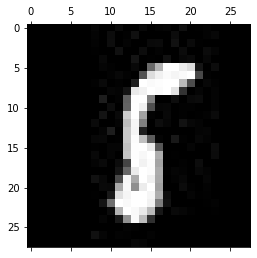

-------------------------------------------
Test: 546
Predicted: 5


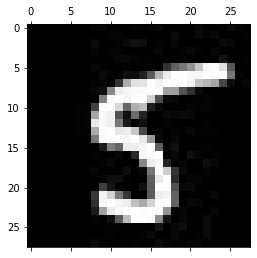

-------------------------------------------
Test: 547
Predicted: 7


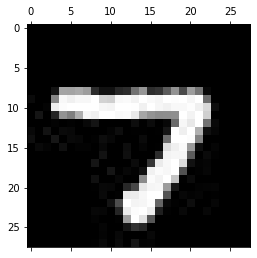

-------------------------------------------
Test: 548
Predicted: 5


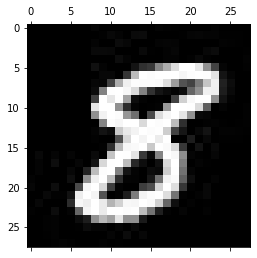

-------------------------------------------
Test: 549
Predicted: 5


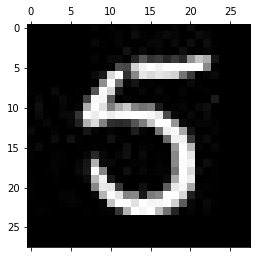

-------------------------------------------
Test: 550
Predicted: 7


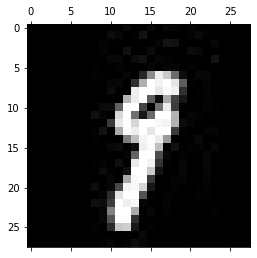

-------------------------------------------
Test: 551
Predicted: 6


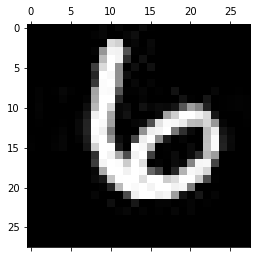

-------------------------------------------
Test: 552
Predicted: 1


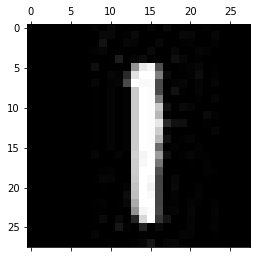

-------------------------------------------
Test: 553
Predicted: 1


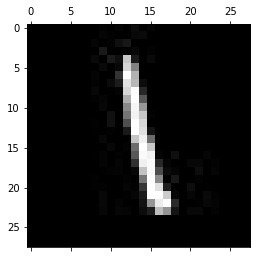

-------------------------------------------
Test: 554
Predicted: 0


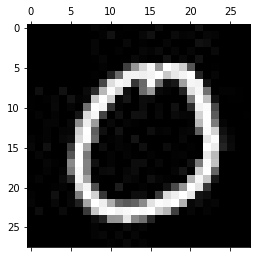

-------------------------------------------
Test: 555
Predicted: 5


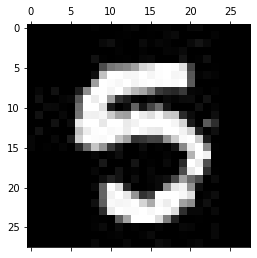

-------------------------------------------
Test: 556
Predicted: 7


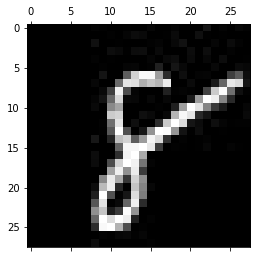

-------------------------------------------
Test: 557
Predicted: 1


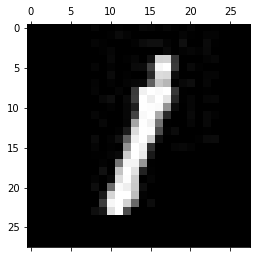

-------------------------------------------
Test: 558
Predicted: 5


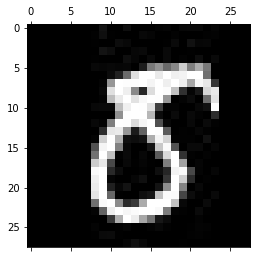

-------------------------------------------
Test: 559
Predicted: 0


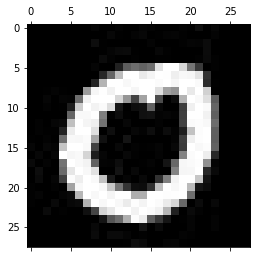

-------------------------------------------
Test: 560
Predicted: 5


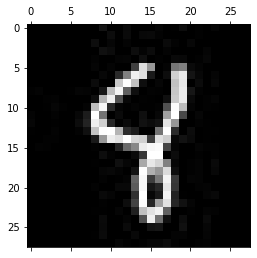

-------------------------------------------
Test: 561
Predicted: 7


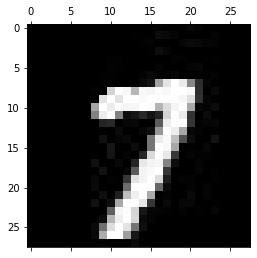

-------------------------------------------
Test: 562
Predicted: 7


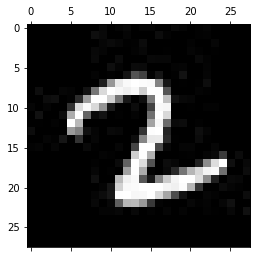

-------------------------------------------
Test: 563
Predicted: 5


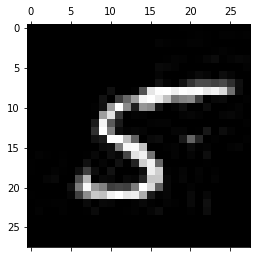

-------------------------------------------
Test: 564
Predicted: 6


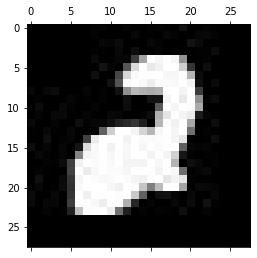

-------------------------------------------
Test: 565
Predicted: 5


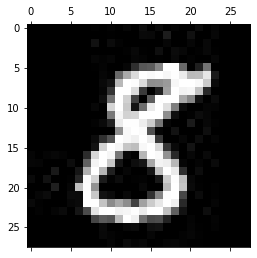

-------------------------------------------
Test: 566
Predicted: 7


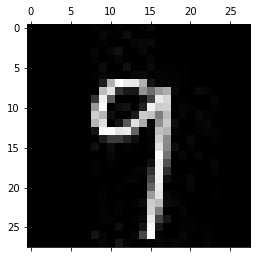

-------------------------------------------
Test: 567
Predicted: 7


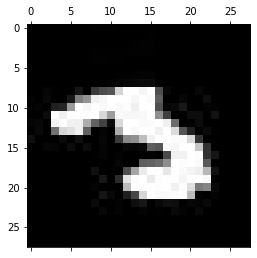

-------------------------------------------
Test: 568
Predicted: 9


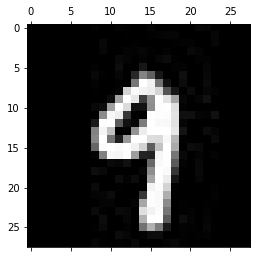

-------------------------------------------
Test: 569
Predicted: 0


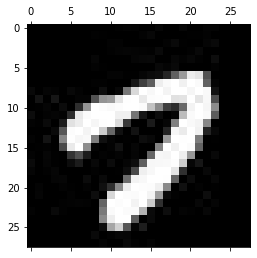

-------------------------------------------
Test: 570
Predicted: 2


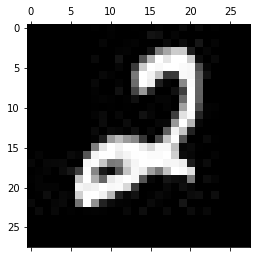

-------------------------------------------
Test: 571
Predicted: 1


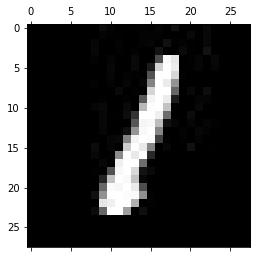

-------------------------------------------
Test: 572
Predicted: 9


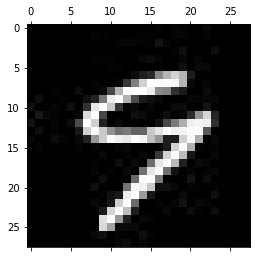

-------------------------------------------
Test: 573
Predicted: 0


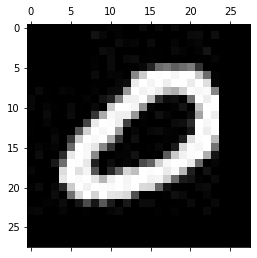

-------------------------------------------
Test: 574
Predicted: 7


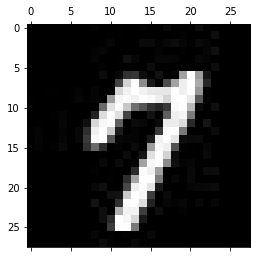

-------------------------------------------
Test: 575
Predicted: 2


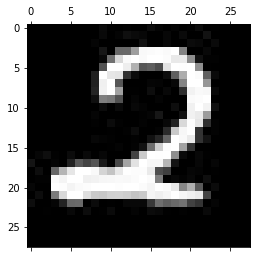

-------------------------------------------
Test: 576
Predicted: 9


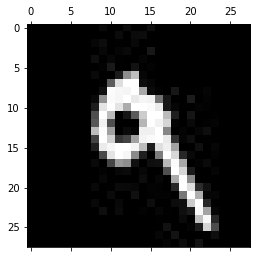

-------------------------------------------
Test: 577
Predicted: 0


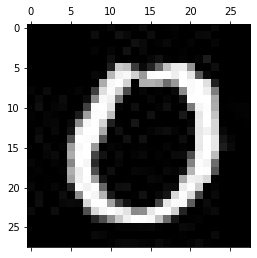

-------------------------------------------
Test: 578
Predicted: 5


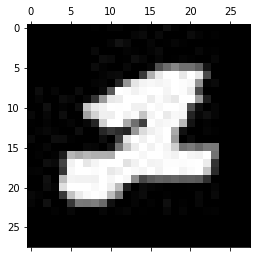

-------------------------------------------
Test: 579
Predicted: 5


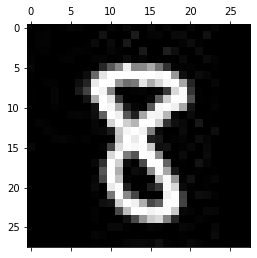

-------------------------------------------
Test: 580
Predicted: 7


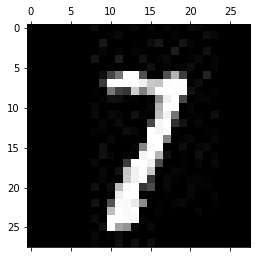

-------------------------------------------
Test: 581
Predicted: 2


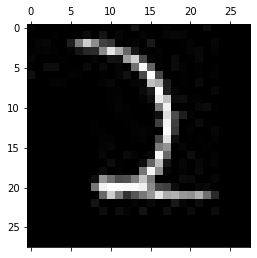

-------------------------------------------
Test: 582
Predicted: 7


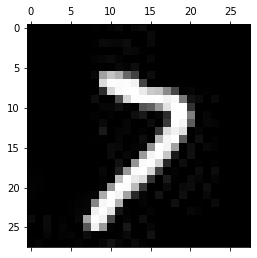

-------------------------------------------
Test: 583
Predicted: 5


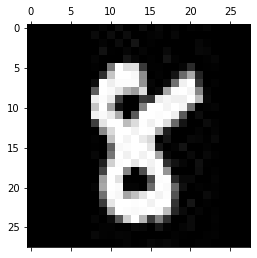

-------------------------------------------
Test: 584
Predicted: 3


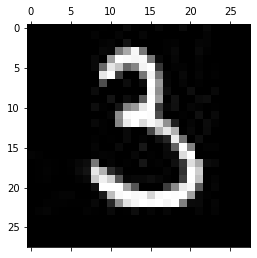

-------------------------------------------
Test: 585
Predicted: 6


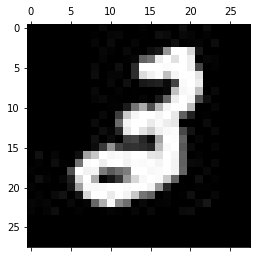

-------------------------------------------
Test: 586
Predicted: 5


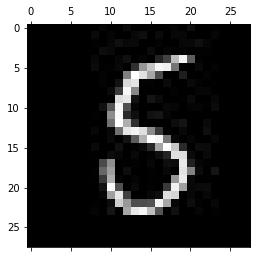

-------------------------------------------
Test: 587
Predicted: 2


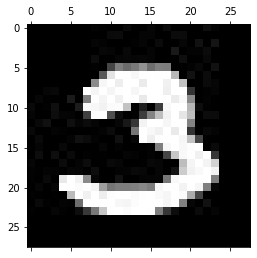

-------------------------------------------
Test: 588
Predicted: 3


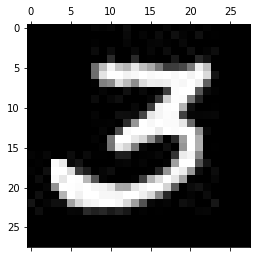

-------------------------------------------
Test: 589
Predicted: 4


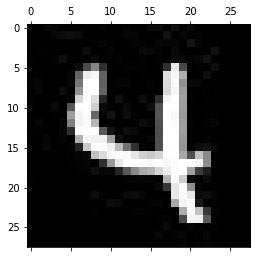

-------------------------------------------
Test: 590
Predicted: 2


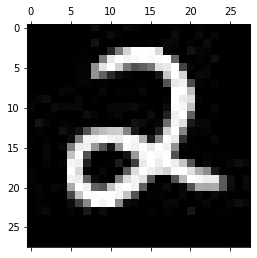

-------------------------------------------
Test: 591
Predicted: 5


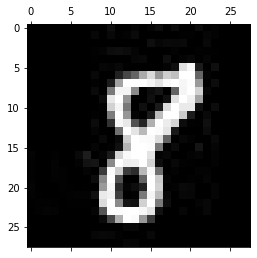

-------------------------------------------
Test: 592
Predicted: 9


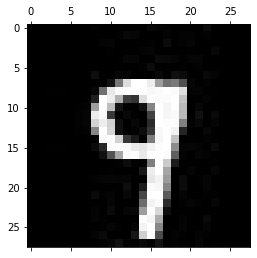

-------------------------------------------
Test: 593
Predicted: 1


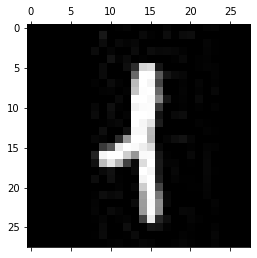

-------------------------------------------
Test: 594
Predicted: 9


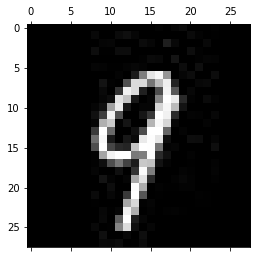

-------------------------------------------
Test: 595
Predicted: 5


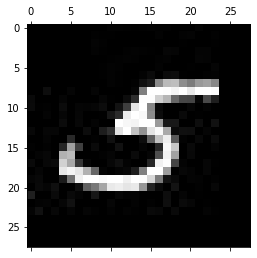

-------------------------------------------
Test: 596
Predicted: 2


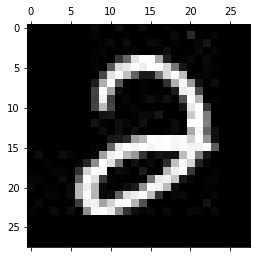

-------------------------------------------
Test: 597
Predicted: 6


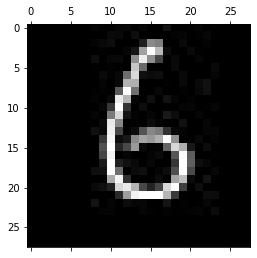

-------------------------------------------
Test: 598
Predicted: 6


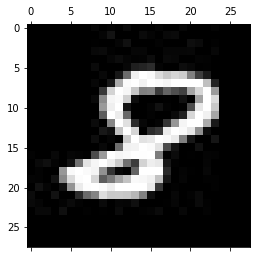

-------------------------------------------
Test: 599
Predicted: 5


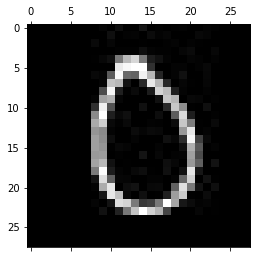

-------------------------------------------
Test: 600
Predicted: 5


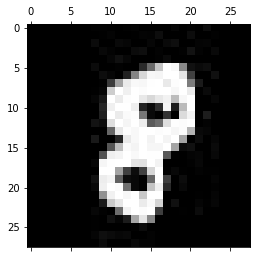

-------------------------------------------
Test: 601
Predicted: 0


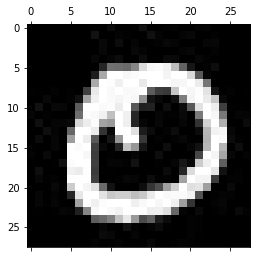

-------------------------------------------
Test: 602
Predicted: 7


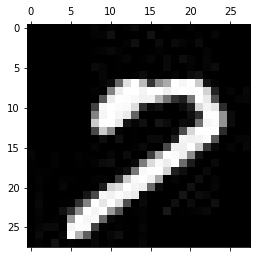

-------------------------------------------
Test: 603
Predicted: 1


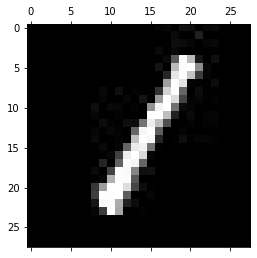

-------------------------------------------
Test: 604
Predicted: 1


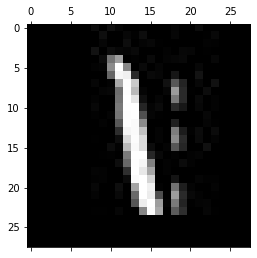

-------------------------------------------
Test: 605
Predicted: 2


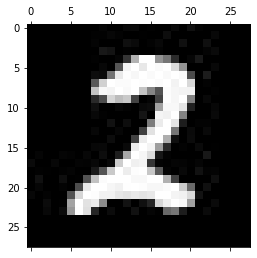

-------------------------------------------
Test: 606
Predicted: 6


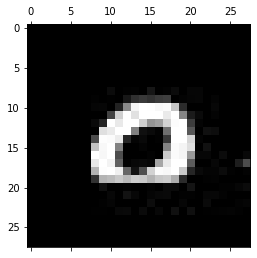

-------------------------------------------
Test: 607
Predicted: 9


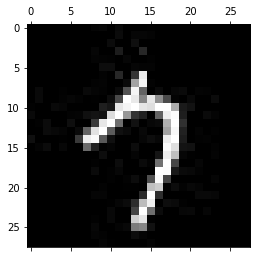

-------------------------------------------
Test: 608
Predicted: 4


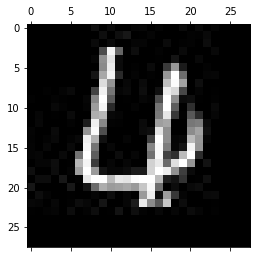

-------------------------------------------
Test: 609
Predicted: 6


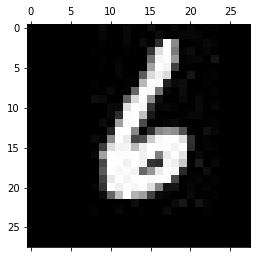

-------------------------------------------
Test: 610
Predicted: 2


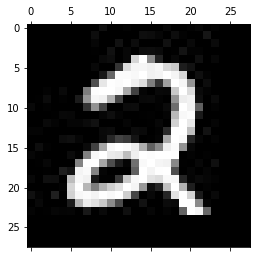

-------------------------------------------
Test: 611
Predicted: 9


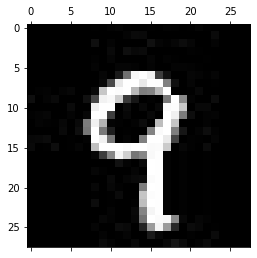

-------------------------------------------
Test: 612
Predicted: 2


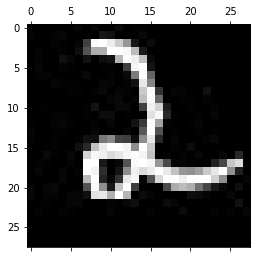

-------------------------------------------
Test: 613
Predicted: 6


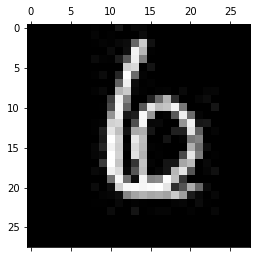

-------------------------------------------
Test: 614
Predicted: 6


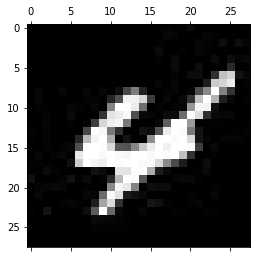

-------------------------------------------
Test: 615
Predicted: 1


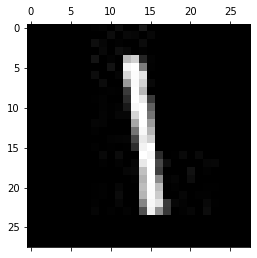

-------------------------------------------
Test: 616
Predicted: 6


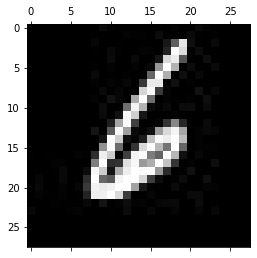

-------------------------------------------
Test: 617
Predicted: 4


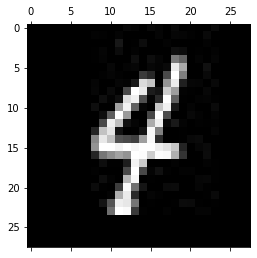

-------------------------------------------
Test: 618
Predicted: 0


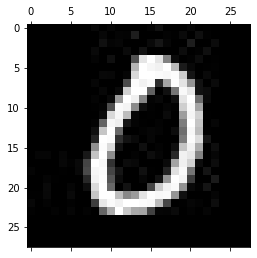

-------------------------------------------
Test: 619
Predicted: 4


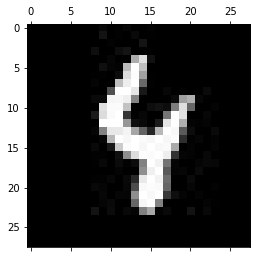

-------------------------------------------
Test: 620
Predicted: 0


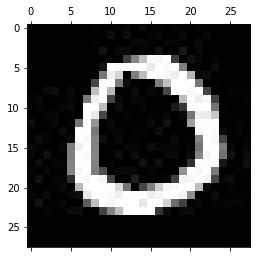

-------------------------------------------
Test: 621
Predicted: 7


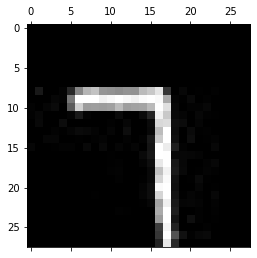

-------------------------------------------
Test: 622
Predicted: 5


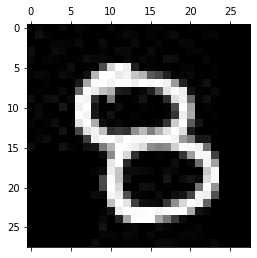

-------------------------------------------
Test: 623
Predicted: 1


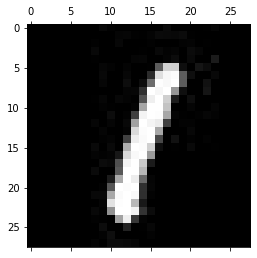

-------------------------------------------
Test: 624
Predicted: 2


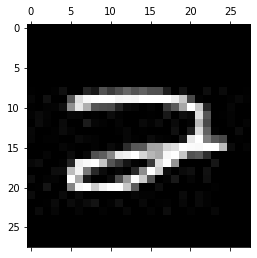

-------------------------------------------
Test: 625
Predicted: 2


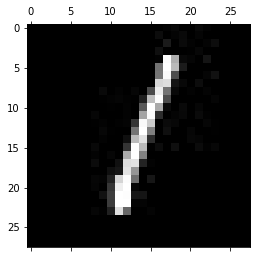

-------------------------------------------
Test: 626
Predicted: 5


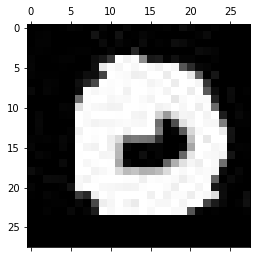

-------------------------------------------
Test: 627
Predicted: 5


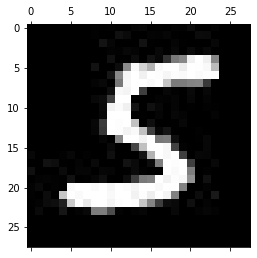

-------------------------------------------
Test: 628
Predicted: 5


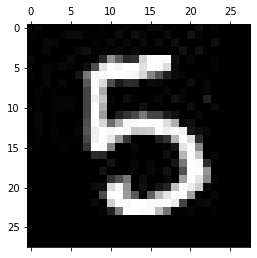

-------------------------------------------
Test: 629
Predicted: 5


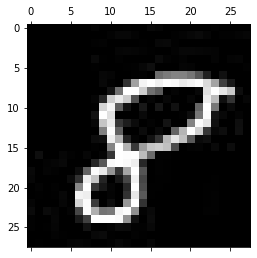

-------------------------------------------
Test: 630
Predicted: 1


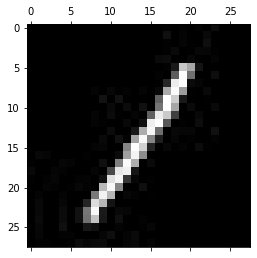

-------------------------------------------
Test: 631
Predicted: 0


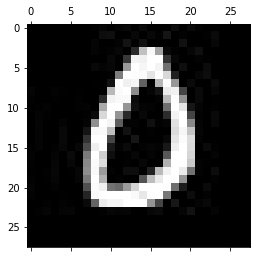

-------------------------------------------
Test: 632
Predicted: 2


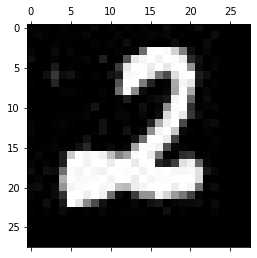

-------------------------------------------
Test: 633
Predicted: 5


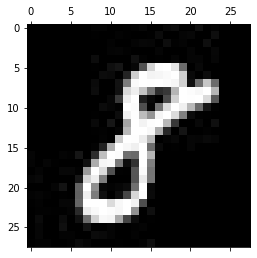

-------------------------------------------
Test: 634
Predicted: 7


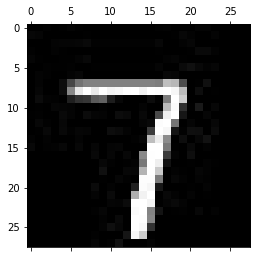

-------------------------------------------
Test: 635
Predicted: 6


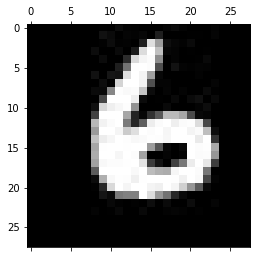

-------------------------------------------
Test: 636
Predicted: 0


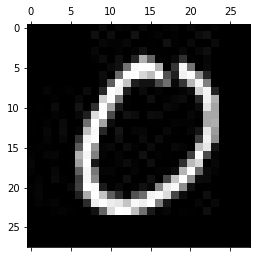

-------------------------------------------
Test: 637
Predicted: 4


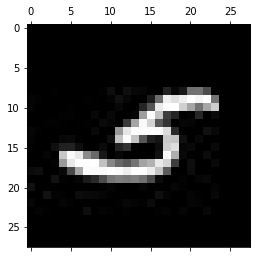

-------------------------------------------
Test: 638
Predicted: 4


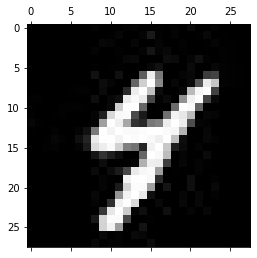

-------------------------------------------
Test: 639
Predicted: 5


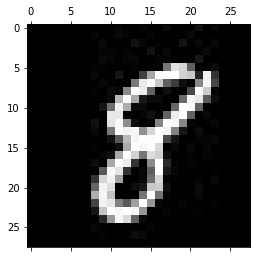

-------------------------------------------
Test: 640
Predicted: 1


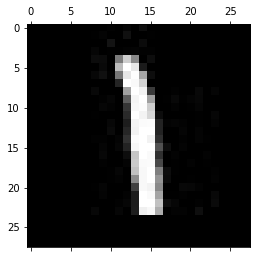

-------------------------------------------
Test: 641
Predicted: 5


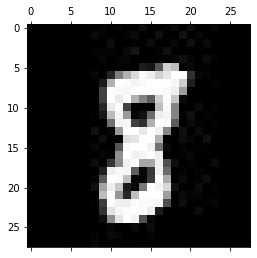

-------------------------------------------
Test: 642
Predicted: 0


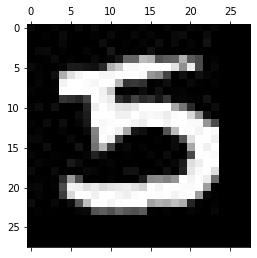

-------------------------------------------
Test: 643
Predicted: 7


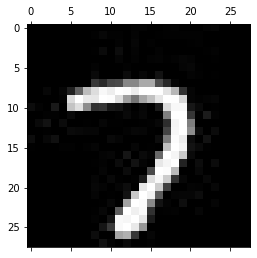

-------------------------------------------
Test: 644
Predicted: 9


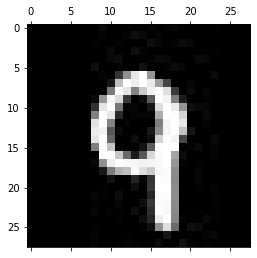

-------------------------------------------
Test: 645
Predicted: 0


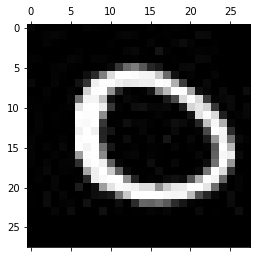

-------------------------------------------
Test: 646
Predicted: 6


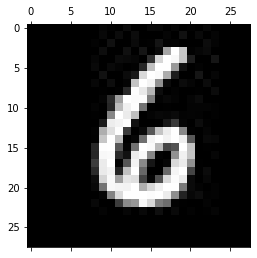

-------------------------------------------
Test: 647
Predicted: 6


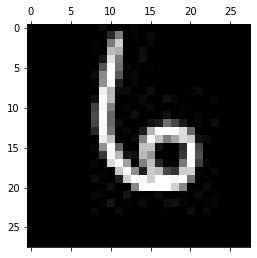

-------------------------------------------
Test: 648
Predicted: 6


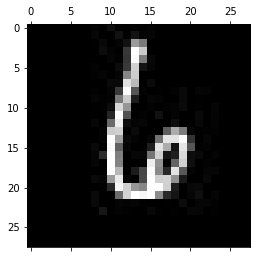

-------------------------------------------
Test: 649
Predicted: 6


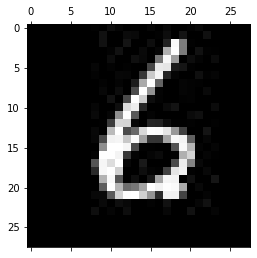

-------------------------------------------
Test: 650
Predicted: 5


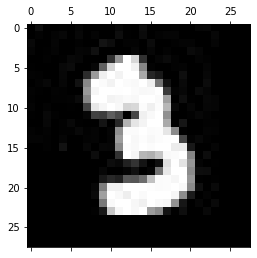

-------------------------------------------
Test: 651
Predicted: 3


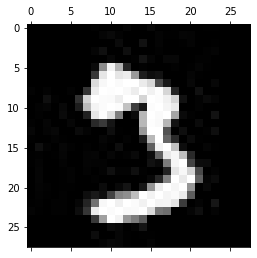

-------------------------------------------
Test: 652
Predicted: 0


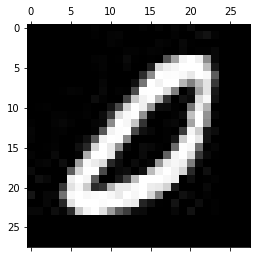

-------------------------------------------
Test: 653
Predicted: 7


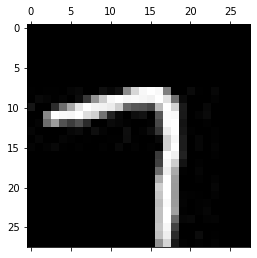

-------------------------------------------
Test: 654
Predicted: 9


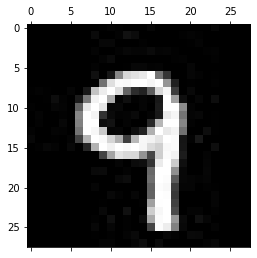

-------------------------------------------
Test: 655
Predicted: 4


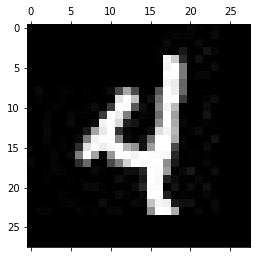

-------------------------------------------
Test: 656
Predicted: 1


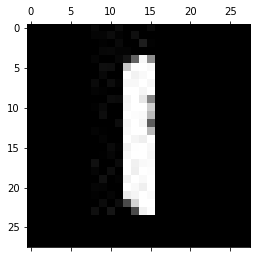

-------------------------------------------
Test: 657
Predicted: 5


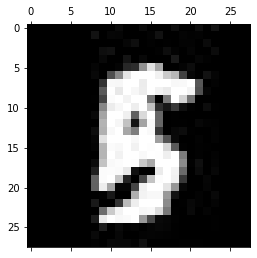

-------------------------------------------
Test: 658
Predicted: 4


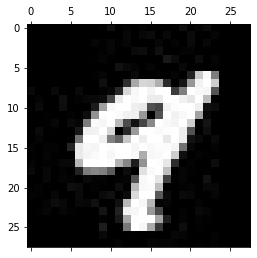

-------------------------------------------
Test: 659
Predicted: 5


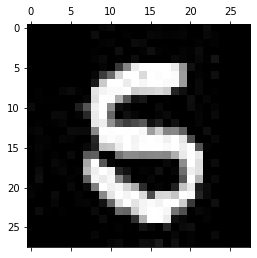

-------------------------------------------
Test: 660
Predicted: 6


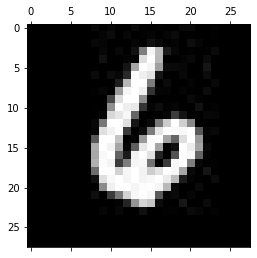

-------------------------------------------
Test: 661
Predicted: 3


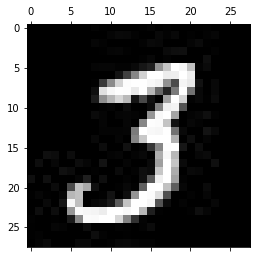

-------------------------------------------
Test: 662
Predicted: 4


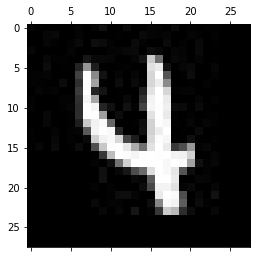

-------------------------------------------
Test: 663
Predicted: 6


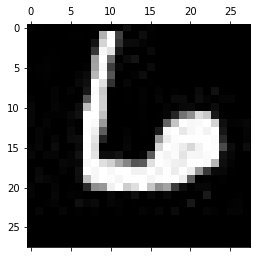

-------------------------------------------
Test: 664
Predicted: 6


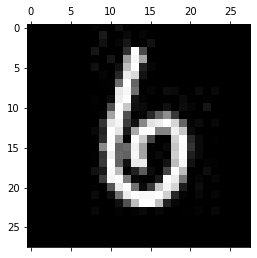

-------------------------------------------
Test: 665
Predicted: 1


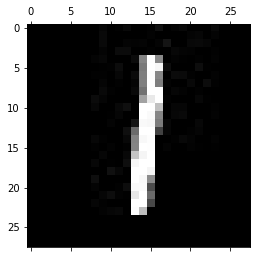

-------------------------------------------
Test: 666
Predicted: 6


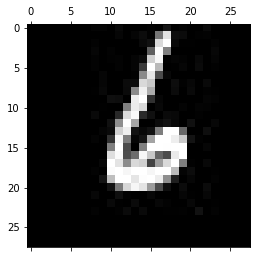

-------------------------------------------
Test: 667
Predicted: 2


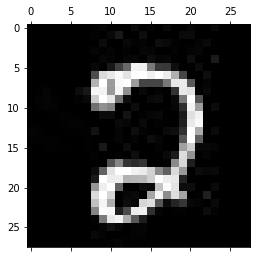

-------------------------------------------
Test: 668
Predicted: 2


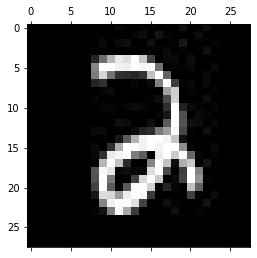

-------------------------------------------
Test: 669
Predicted: 1


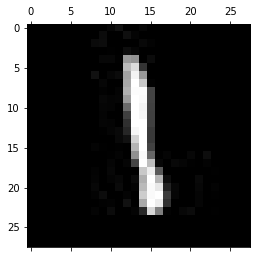

-------------------------------------------
Test: 670
Predicted: 7


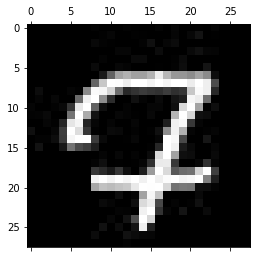

-------------------------------------------
Test: 671
Predicted: 7


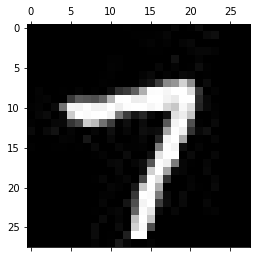

-------------------------------------------
Test: 672
Predicted: 3


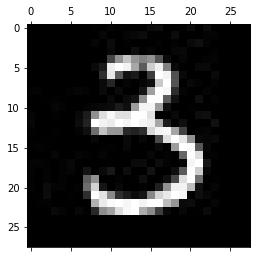

-------------------------------------------
Test: 673
Predicted: 7


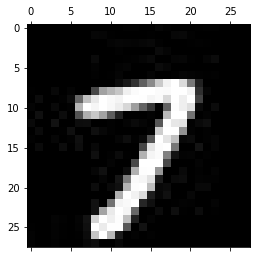

-------------------------------------------
Test: 674
Predicted: 5


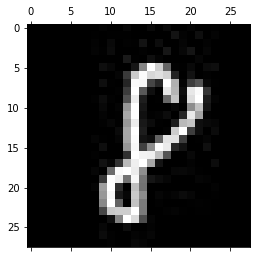

-------------------------------------------
Test: 675
Predicted: 7


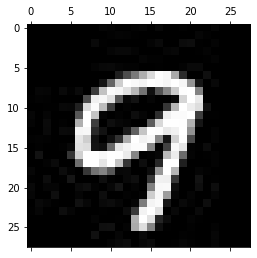

-------------------------------------------
Test: 676
Predicted: 6


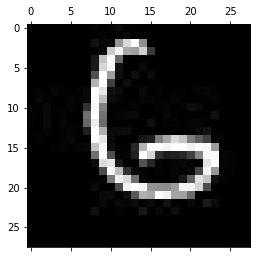

-------------------------------------------
Test: 677
Predicted: 5


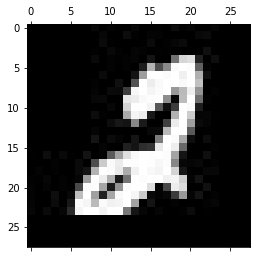

-------------------------------------------
Test: 678
Predicted: 4


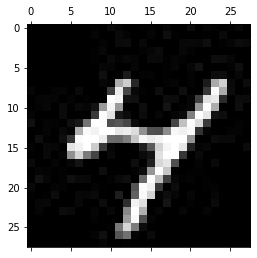

-------------------------------------------
Test: 679
Predicted: 3


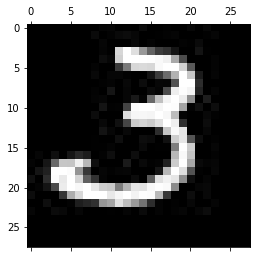

-------------------------------------------
Test: 680
Predicted: 5


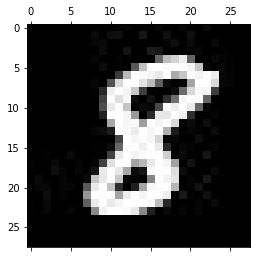

-------------------------------------------
Test: 681
Predicted: 5


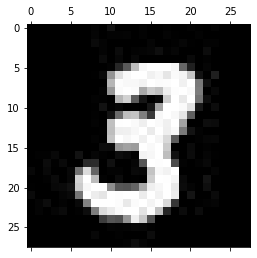

-------------------------------------------
Test: 682
Predicted: 0


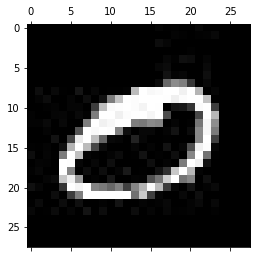

-------------------------------------------
Test: 683
Predicted: 7


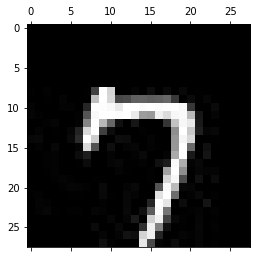

-------------------------------------------
Test: 684
Predicted: 6


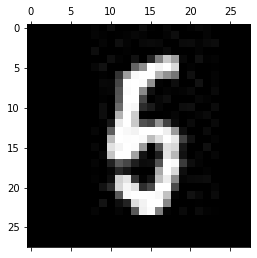

-------------------------------------------
Test: 685
Predicted: 2


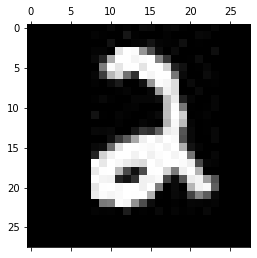

-------------------------------------------
Test: 686
Predicted: 2


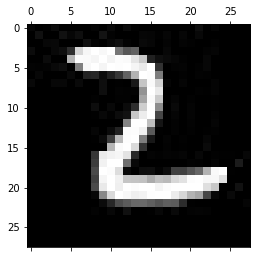

-------------------------------------------
Test: 687
Predicted: 7


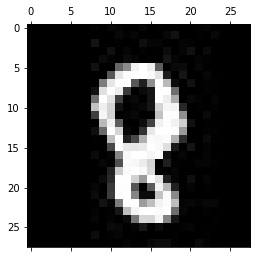

-------------------------------------------
Test: 688
Predicted: 5


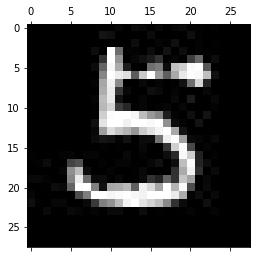

-------------------------------------------
Test: 689
Predicted: 0


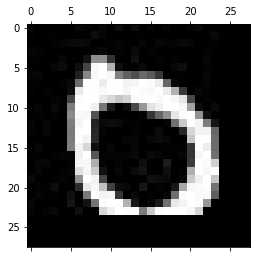

-------------------------------------------
Test: 690
Predicted: 3


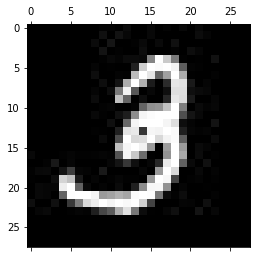

-------------------------------------------
Test: 691
Predicted: 9


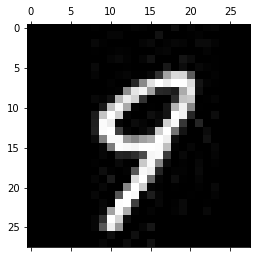

-------------------------------------------
Test: 692
Predicted: 6


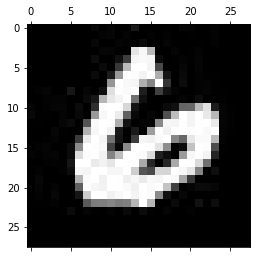

-------------------------------------------
Test: 693
Predicted: 5


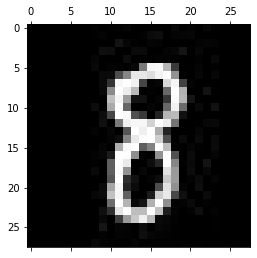

-------------------------------------------
Test: 694
Predicted: 5


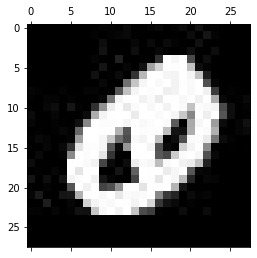

-------------------------------------------
Test: 695
Predicted: 7


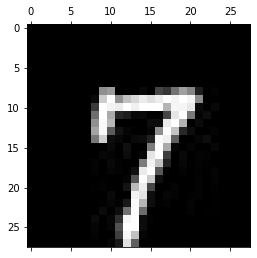

-------------------------------------------
Test: 696
Predicted: 5


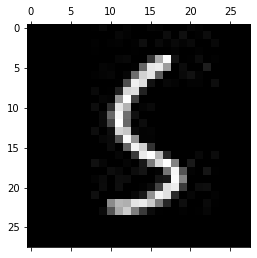

-------------------------------------------
Test: 697
Predicted: 5


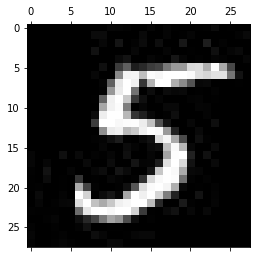

-------------------------------------------
Test: 698
Predicted: 5


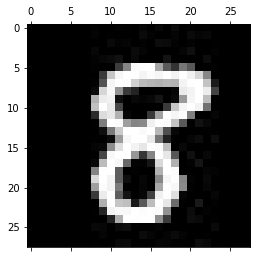

-------------------------------------------
Test: 699
Predicted: 2


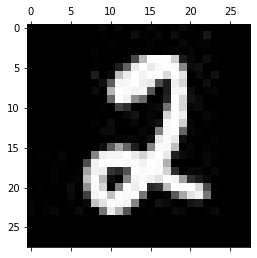

-------------------------------------------
Test: 700
Predicted: 7


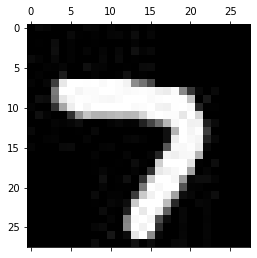

-------------------------------------------
Test: 701
Predicted: 9


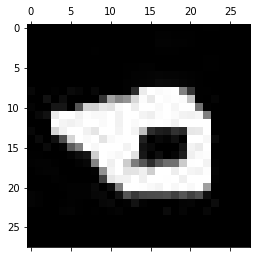

-------------------------------------------
Test: 702
Predicted: 2


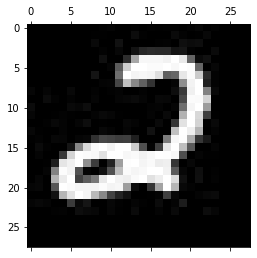

-------------------------------------------
Test: 703
Predicted: 6


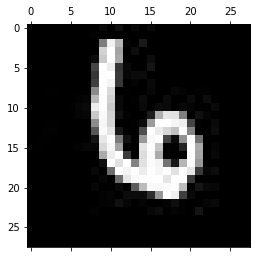

-------------------------------------------
Test: 704
Predicted: 2


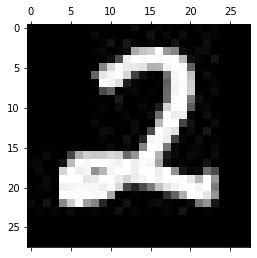

-------------------------------------------
Test: 705
Predicted: 5


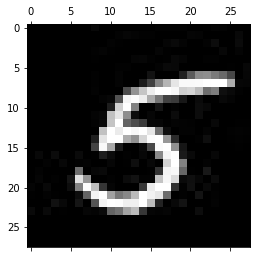

-------------------------------------------
Test: 706
Predicted: 4


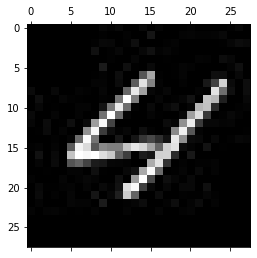

-------------------------------------------
Test: 707
Predicted: 5


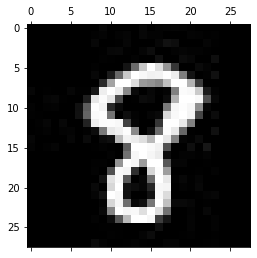

-------------------------------------------
Test: 708
Predicted: 5


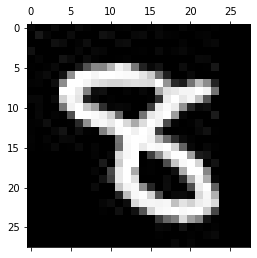

-------------------------------------------
Test: 709
Predicted: 5


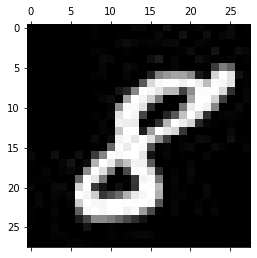

-------------------------------------------
Test: 710
Predicted: 3


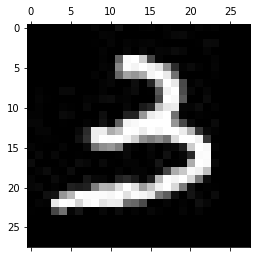

-------------------------------------------
Test: 711
Predicted: 4


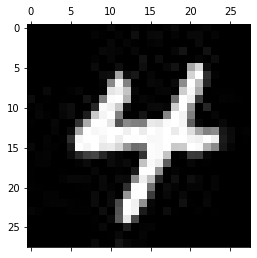

-------------------------------------------
Test: 712
Predicted: 6


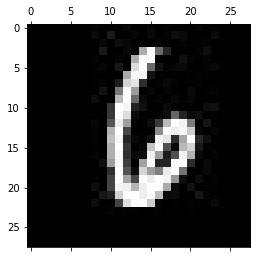

-------------------------------------------
Test: 713
Predicted: 0


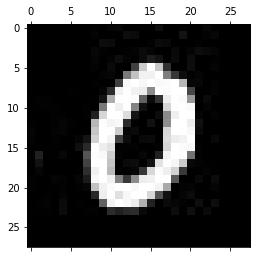

-------------------------------------------
Test: 714
Predicted: 4


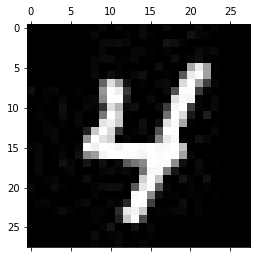

-------------------------------------------
Test: 715
Predicted: 9


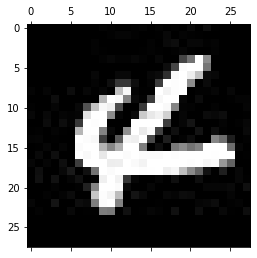

-------------------------------------------
Test: 716
Predicted: 4


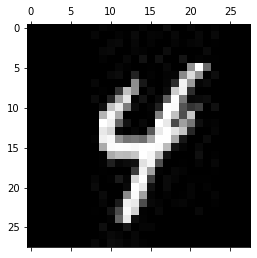

-------------------------------------------
Test: 717
Predicted: 6


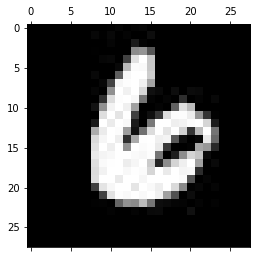

-------------------------------------------
Test: 718
Predicted: 9


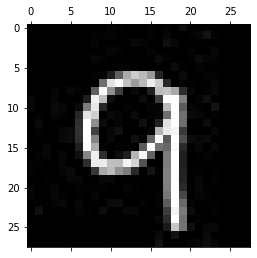

-------------------------------------------
Test: 719
Predicted: 9


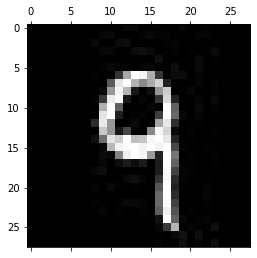

-------------------------------------------
Test: 720
Predicted: 5


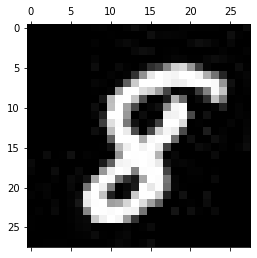

-------------------------------------------
Test: 721
Predicted: 2


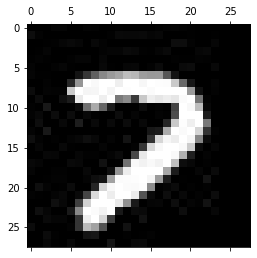

-------------------------------------------
Test: 722
Predicted: 1


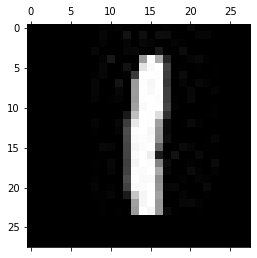

-------------------------------------------
Test: 723
Predicted: 9


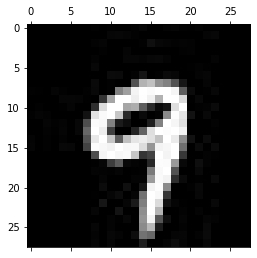

-------------------------------------------
Test: 724
Predicted: 2


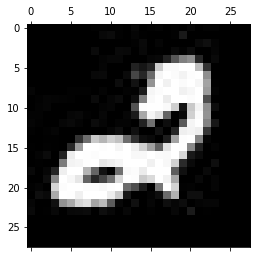

-------------------------------------------
Test: 725
Predicted: 1


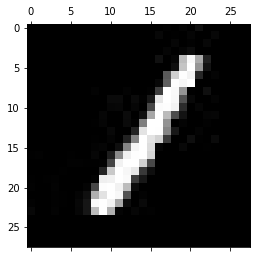

-------------------------------------------
Test: 726
Predicted: 2


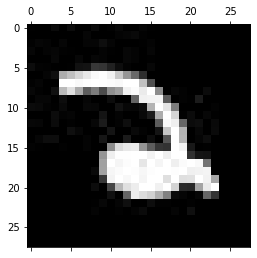

-------------------------------------------
Test: 727
Predicted: 5


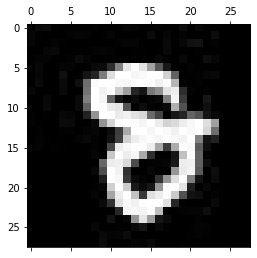

-------------------------------------------
Test: 728
Predicted: 2


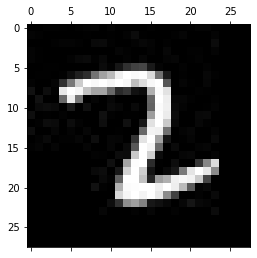

-------------------------------------------
Test: 729
Predicted: 4


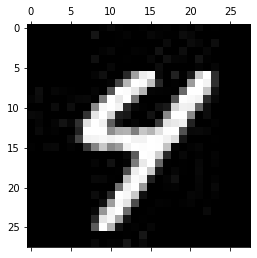

-------------------------------------------
Test: 730
Predicted: 6


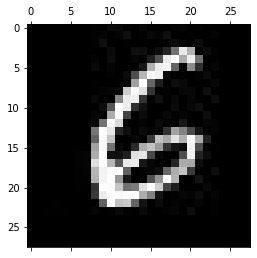

-------------------------------------------
Test: 731
Predicted: 5


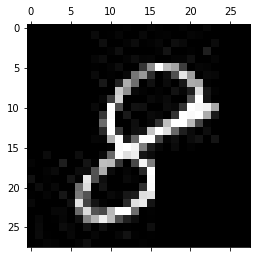

-------------------------------------------
Test: 732
Predicted: 1


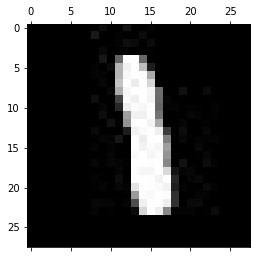

-------------------------------------------
Test: 733
Predicted: 2


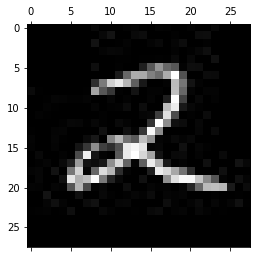

-------------------------------------------
Test: 734
Predicted: 9


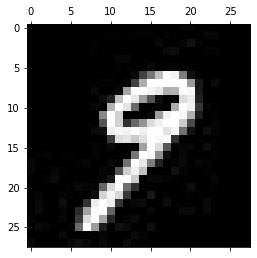

-------------------------------------------
Test: 735
Predicted: 3


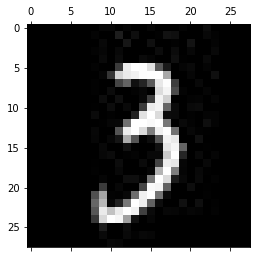

-------------------------------------------
Test: 736
Predicted: 7


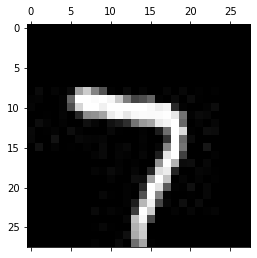

-------------------------------------------
Test: 737
Predicted: 0


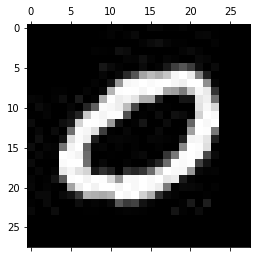

-------------------------------------------
Test: 738
Predicted: 3


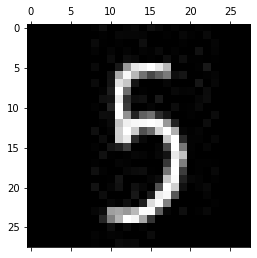

-------------------------------------------
Test: 739
Predicted: 1


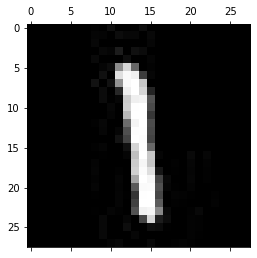

-------------------------------------------
Test: 740
Predicted: 6


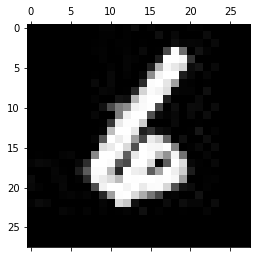

-------------------------------------------
Test: 741
Predicted: 0


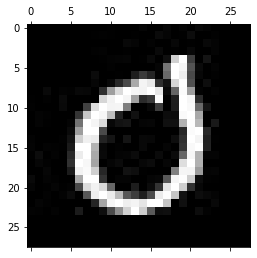

-------------------------------------------
Test: 742
Predicted: 6


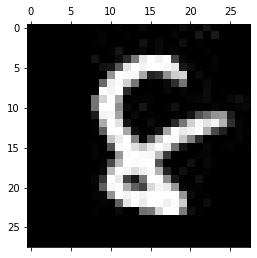

-------------------------------------------
Test: 743
Predicted: 2


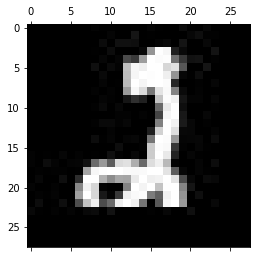

-------------------------------------------
Test: 744
Predicted: 0


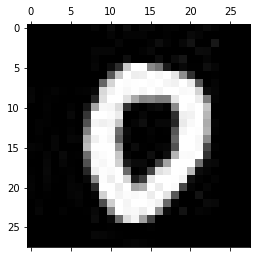

-------------------------------------------
Test: 745
Predicted: 2


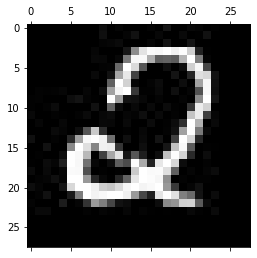

-------------------------------------------
Test: 746
Predicted: 6


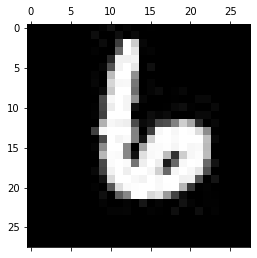

-------------------------------------------
Test: 747
Predicted: 4


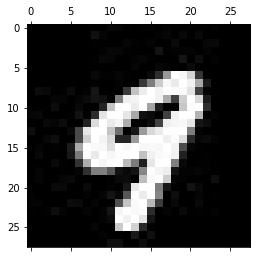

-------------------------------------------
Test: 748
Predicted: 6


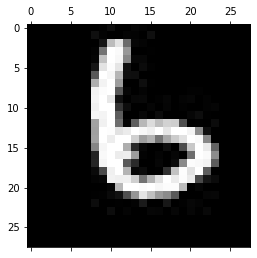

-------------------------------------------
Test: 749
Predicted: 7


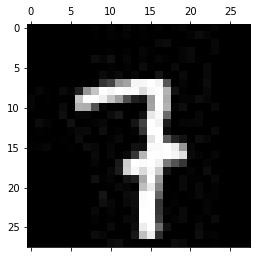

-------------------------------------------
Test: 750
Predicted: 4


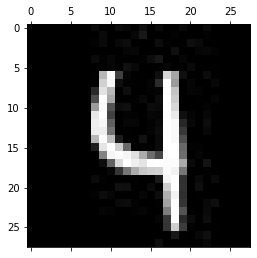

-------------------------------------------
Test: 751
Predicted: 4


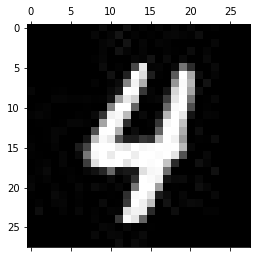

-------------------------------------------
Test: 752
Predicted: 4


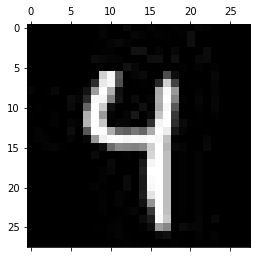

-------------------------------------------
Test: 753
Predicted: 5


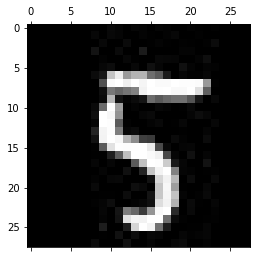

-------------------------------------------
Test: 754
Predicted: 5


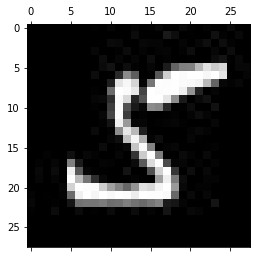

-------------------------------------------
Test: 755
Predicted: 2


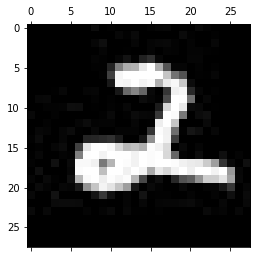

-------------------------------------------
Test: 756
Predicted: 6


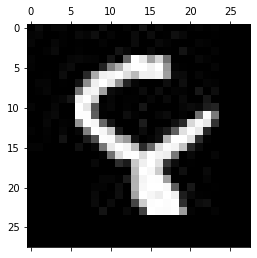

-------------------------------------------
Test: 757
Predicted: 0


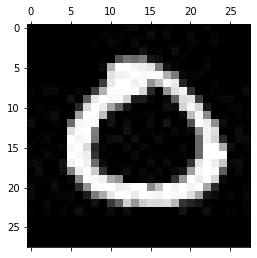

-------------------------------------------
Test: 758
Predicted: 9


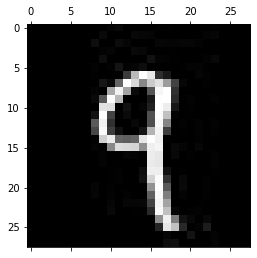

-------------------------------------------
Test: 759
Predicted: 6


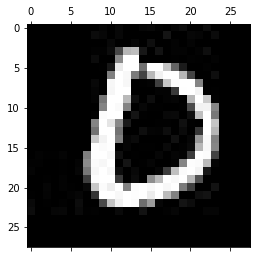

-------------------------------------------
Test: 760
Predicted: 5


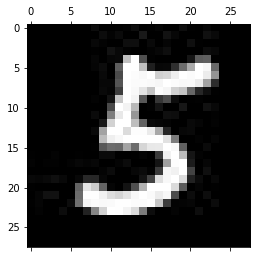

-------------------------------------------
Test: 761
Predicted: 2


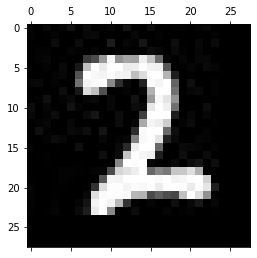

-------------------------------------------
Test: 762
Predicted: 6


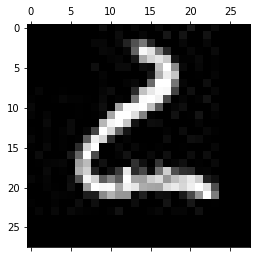

-------------------------------------------
Test: 763
Predicted: 5


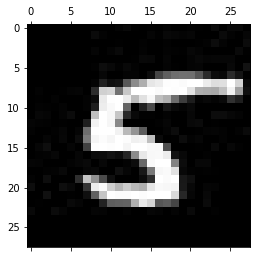

-------------------------------------------
Test: 764
Predicted: 5


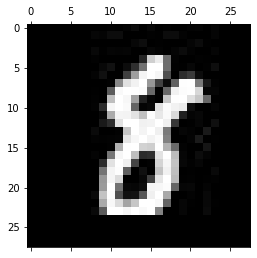

-------------------------------------------
Test: 765
Predicted: 9


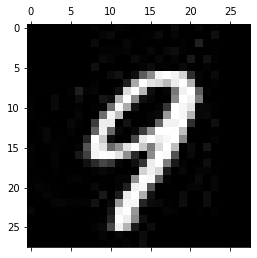

-------------------------------------------
Test: 766
Predicted: 2


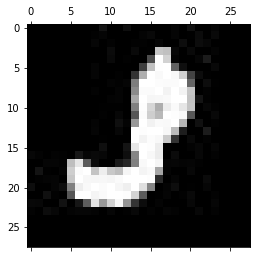

-------------------------------------------
Test: 767
Predicted: 5


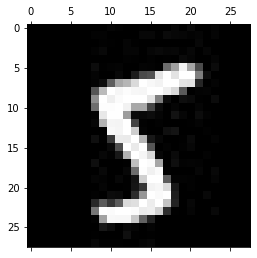

-------------------------------------------
Test: 768
Predicted: 5


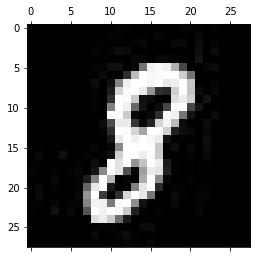

-------------------------------------------
Test: 769
Predicted: 1


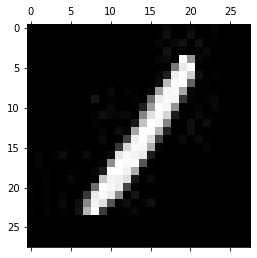

-------------------------------------------
Test: 770
Predicted: 3


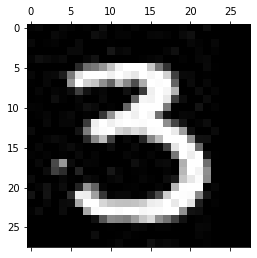

-------------------------------------------
Test: 771
Predicted: 3


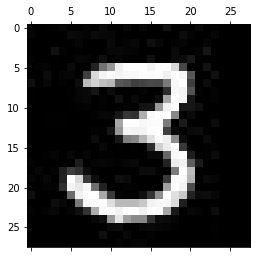

-------------------------------------------
Test: 772
Predicted: 5


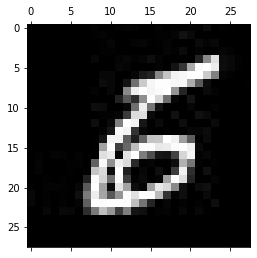

-------------------------------------------
Test: 773
Predicted: 5


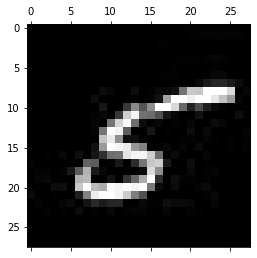

-------------------------------------------
Test: 774
Predicted: 5


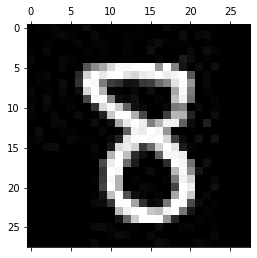

-------------------------------------------
Test: 775
Predicted: 6


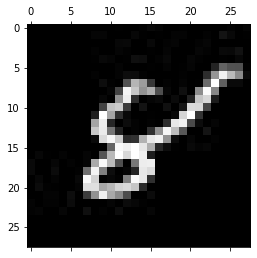

-------------------------------------------
Test: 776
Predicted: 5


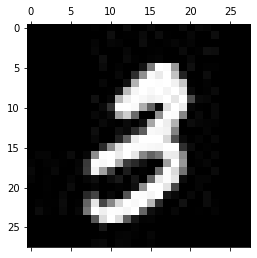

-------------------------------------------
Test: 777
Predicted: 4


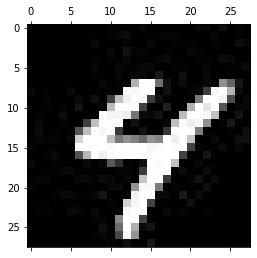

-------------------------------------------
Test: 778
Predicted: 4


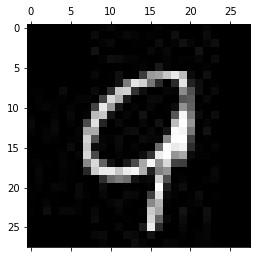

-------------------------------------------
Test: 779
Predicted: 3


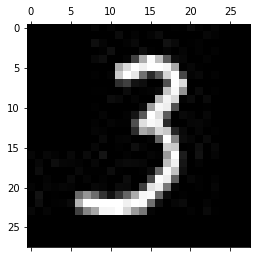

-------------------------------------------
Test: 780
Predicted: 0


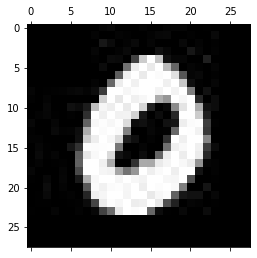

-------------------------------------------
Test: 781
Predicted: 5


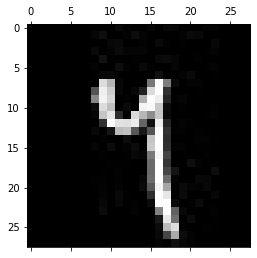

-------------------------------------------
Test: 782
Predicted: 0


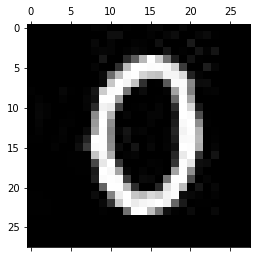

-------------------------------------------
Test: 783
Predicted: 0


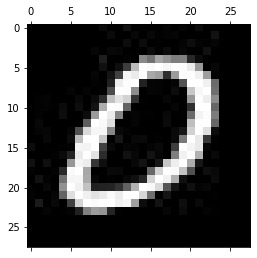

-------------------------------------------
Test: 784
Predicted: 7


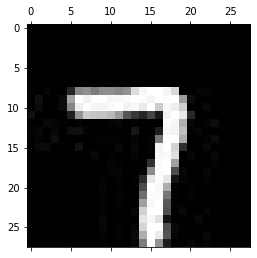

-------------------------------------------
Test: 785
Predicted: 5


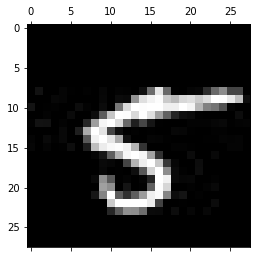

-------------------------------------------
Test: 786
Predicted: 6


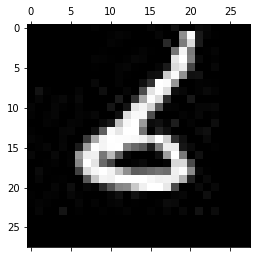

-------------------------------------------
Test: 787
Predicted: 2


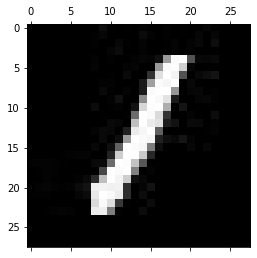

-------------------------------------------
Test: 788
Predicted: 6


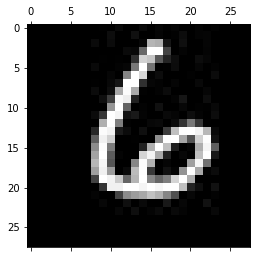

-------------------------------------------
Test: 789
Predicted: 7


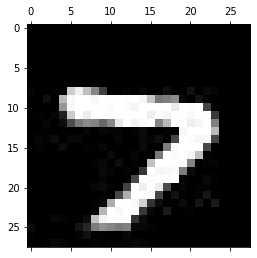

-------------------------------------------
Test: 790
Predicted: 0


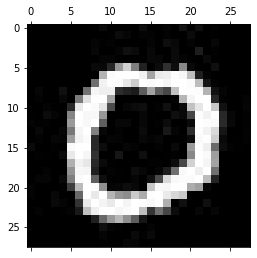

-------------------------------------------
Test: 791
Predicted: 3


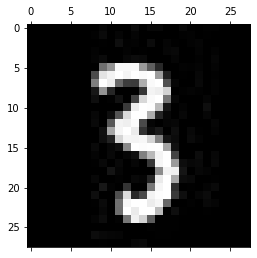

-------------------------------------------
Test: 792
Predicted: 5


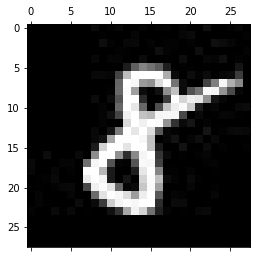

-------------------------------------------
Test: 793
Predicted: 5


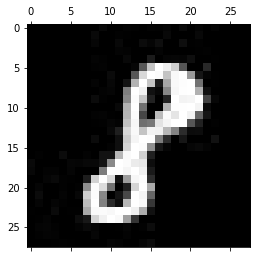

-------------------------------------------
Test: 794
Predicted: 5


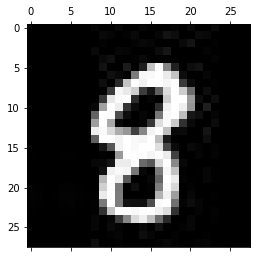

-------------------------------------------
Test: 795
Predicted: 0


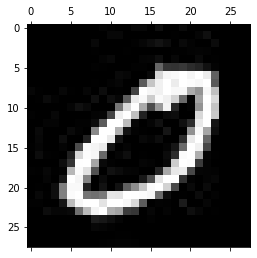

-------------------------------------------
Test: 796
Predicted: 7


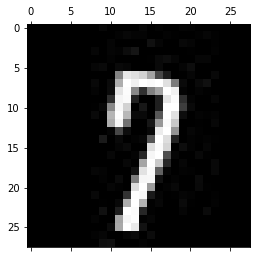

-------------------------------------------
Test: 797
Predicted: 5


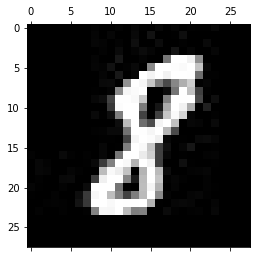

-------------------------------------------
Test: 798
Predicted: 4


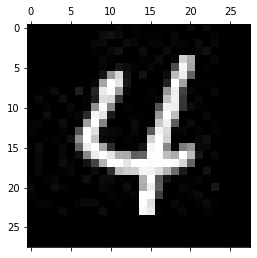

-------------------------------------------
Test: 799
Predicted: 6


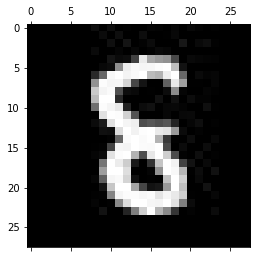

-------------------------------------------
Test: 800
Predicted: 6


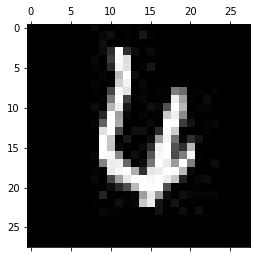

-------------------------------------------
Test: 801
Predicted: 0


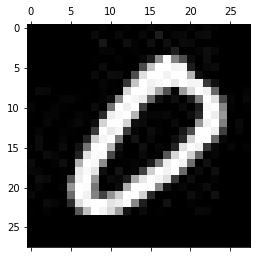

-------------------------------------------
Test: 802
Predicted: 5


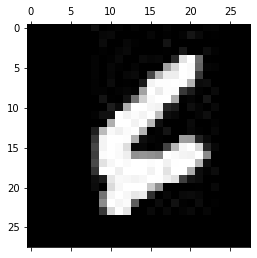

-------------------------------------------
Test: 803
Predicted: 7


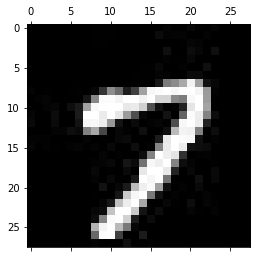

-------------------------------------------
Test: 804
Predicted: 4


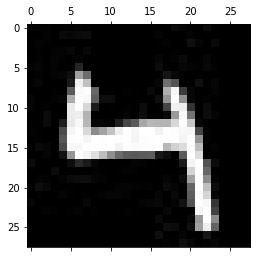

-------------------------------------------
Test: 805
Predicted: 6


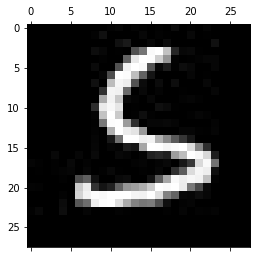

-------------------------------------------
Test: 806
Predicted: 6


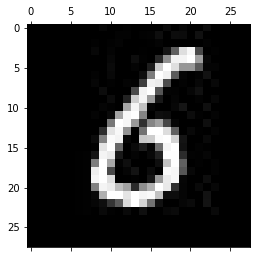

-------------------------------------------
Test: 807
Predicted: 2


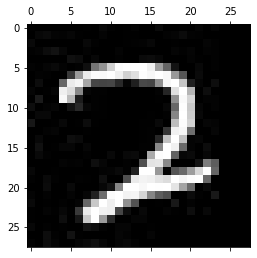

-------------------------------------------
Test: 808
Predicted: 5


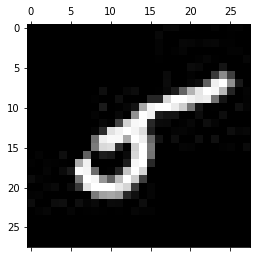

-------------------------------------------
Test: 809
Predicted: 2


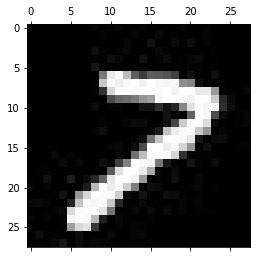

-------------------------------------------
Test: 810
Predicted: 5


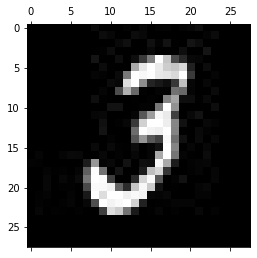

-------------------------------------------
Test: 811
Predicted: 7


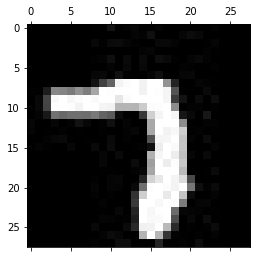

-------------------------------------------
Test: 812
Predicted: 2


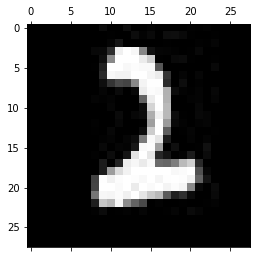

-------------------------------------------
Test: 813
Predicted: 4


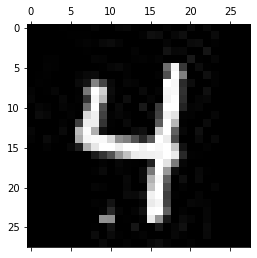

-------------------------------------------
Test: 814
Predicted: 6


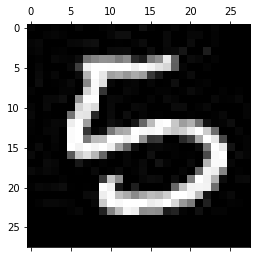

-------------------------------------------
Test: 815
Predicted: 1


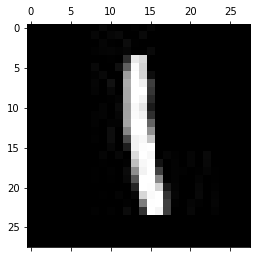

-------------------------------------------
Test: 816
Predicted: 7


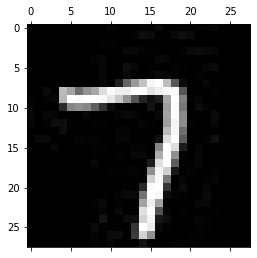

-------------------------------------------
Test: 817
Predicted: 0


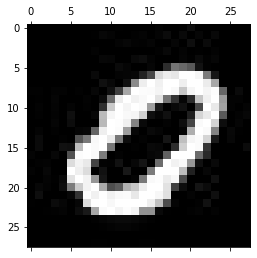

-------------------------------------------
Test: 818
Predicted: 7


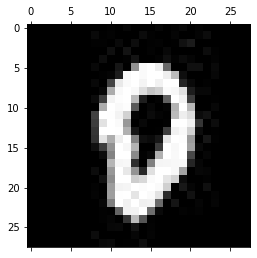

-------------------------------------------
Test: 819
Predicted: 5


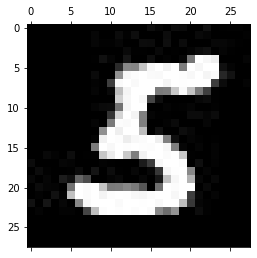

-------------------------------------------
Test: 820
Predicted: 5


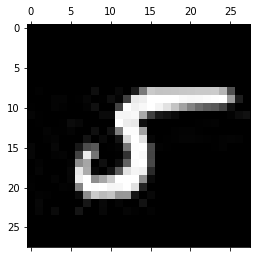

-------------------------------------------
Test: 821
Predicted: 5


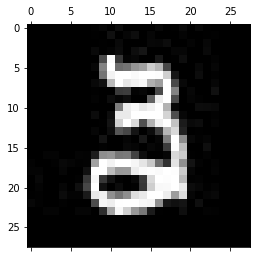

-------------------------------------------
Test: 822
Predicted: 0


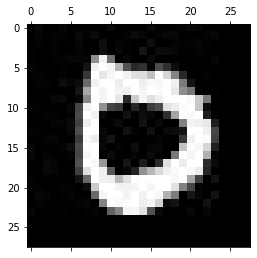

-------------------------------------------
Test: 823
Predicted: 9


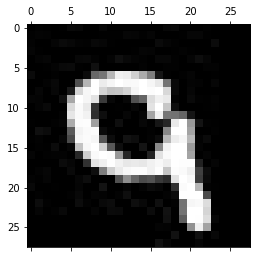

-------------------------------------------
Test: 824
Predicted: 7


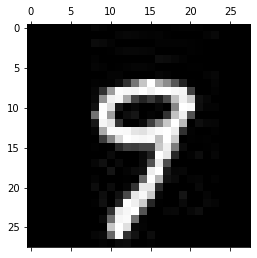

-------------------------------------------
Test: 825
Predicted: 2


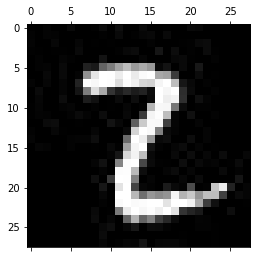

-------------------------------------------
Test: 826
Predicted: 7


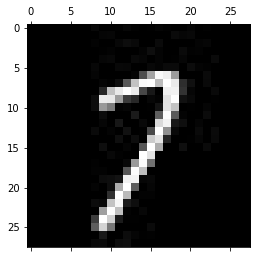

-------------------------------------------
Test: 827
Predicted: 9


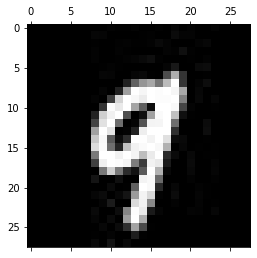

-------------------------------------------
Test: 828
Predicted: 1


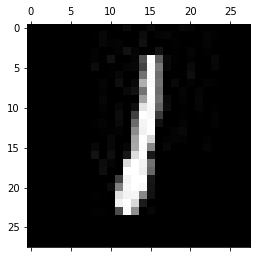

-------------------------------------------
Test: 829
Predicted: 9


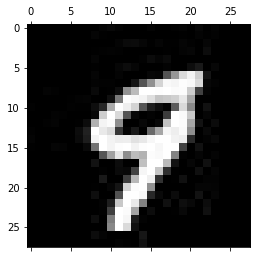

-------------------------------------------
Test: 830
Predicted: 6


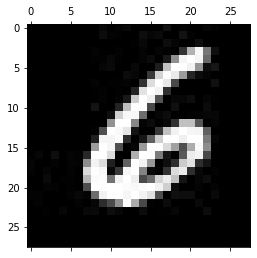

-------------------------------------------
Test: 831
Predicted: 2


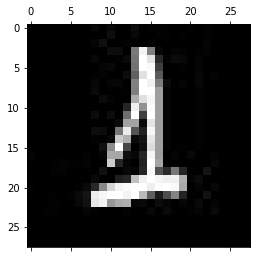

-------------------------------------------
Test: 832
Predicted: 6


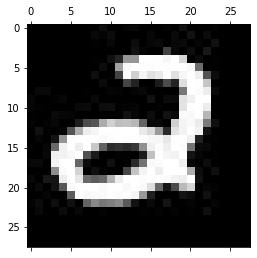

-------------------------------------------
Test: 833
Predicted: 9


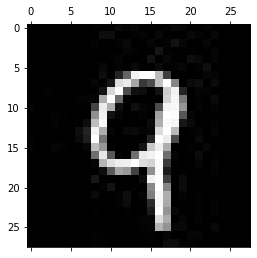

-------------------------------------------
Test: 834
Predicted: 2


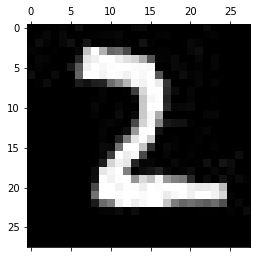

-------------------------------------------
Test: 835
Predicted: 9


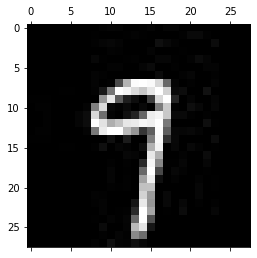

-------------------------------------------
Test: 836
Predicted: 7


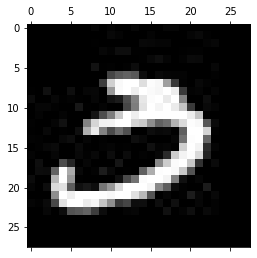

-------------------------------------------
Test: 837
Predicted: 2


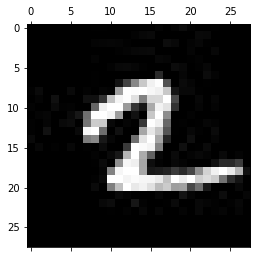

-------------------------------------------
Test: 838
Predicted: 3


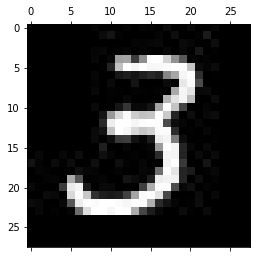

-------------------------------------------
Test: 839
Predicted: 2


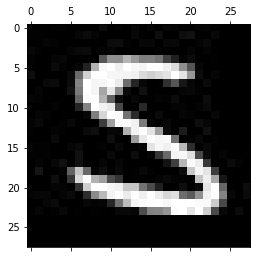

-------------------------------------------
Test: 840
Predicted: 1


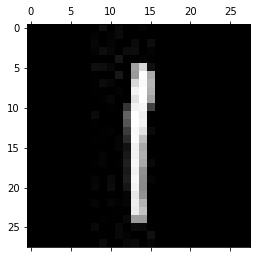

-------------------------------------------
Test: 841
Predicted: 2


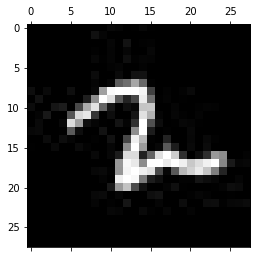

-------------------------------------------
Test: 842
Predicted: 7


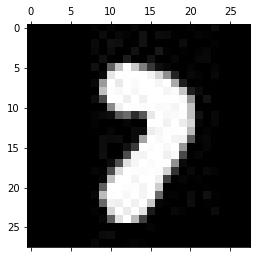

-------------------------------------------
Test: 843
Predicted: 7


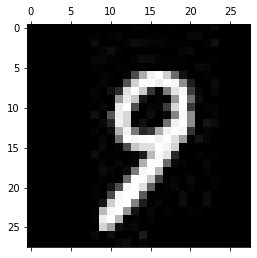

-------------------------------------------
Test: 844
Predicted: 2


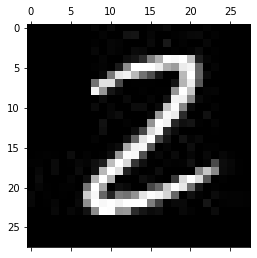

-------------------------------------------
Test: 845
Predicted: 7


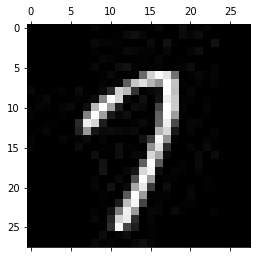

-------------------------------------------
Test: 846
Predicted: 0


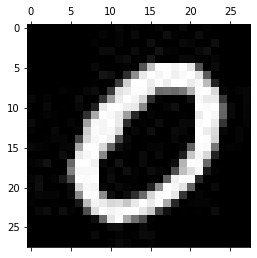

-------------------------------------------
Test: 847
Predicted: 2


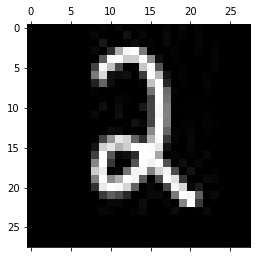

-------------------------------------------
Test: 848
Predicted: 6


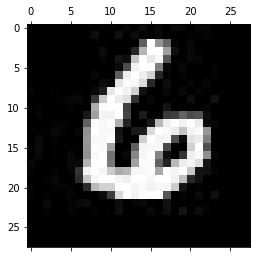

-------------------------------------------
Test: 849
Predicted: 6


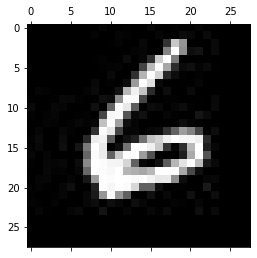

-------------------------------------------
Test: 850
Predicted: 1


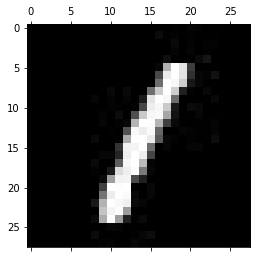

-------------------------------------------
Test: 851
Predicted: 5


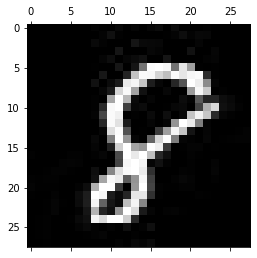

-------------------------------------------
Test: 852
Predicted: 5


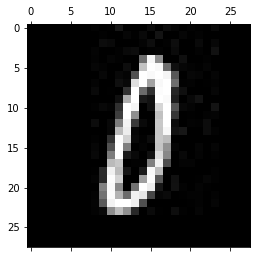

-------------------------------------------
Test: 853
Predicted: 7


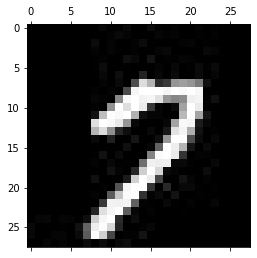

-------------------------------------------
Test: 854
Predicted: 5


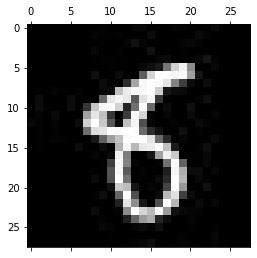

-------------------------------------------
Test: 855
Predicted: 5


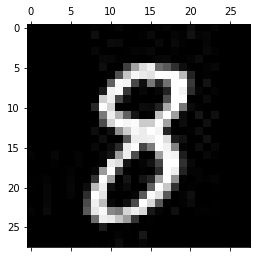

-------------------------------------------
Test: 856
Predicted: 3


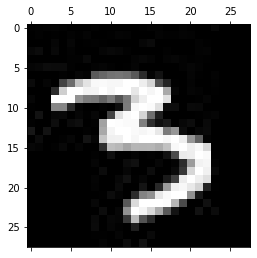

-------------------------------------------
Test: 857
Predicted: 6


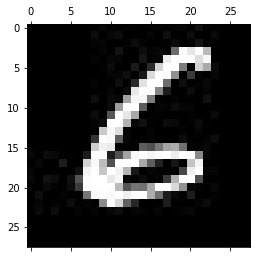

-------------------------------------------
Test: 858
Predicted: 0


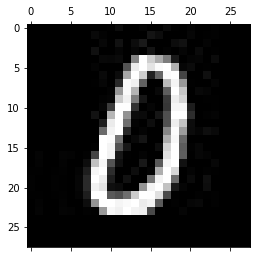

-------------------------------------------
Test: 859
Predicted: 3


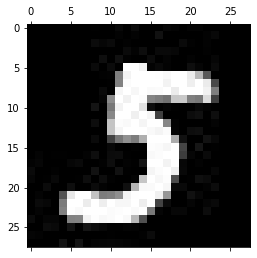

-------------------------------------------
Test: 860
Predicted: 6


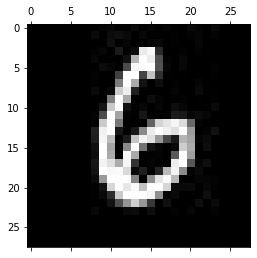

-------------------------------------------
Test: 861
Predicted: 5


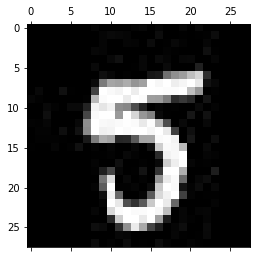

-------------------------------------------
Test: 862
Predicted: 2


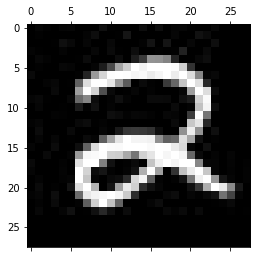

-------------------------------------------
Test: 863
Predicted: 4


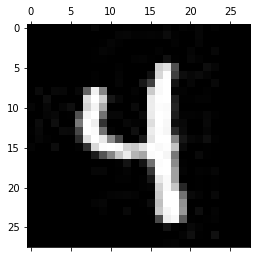

-------------------------------------------
Test: 864
Predicted: 5


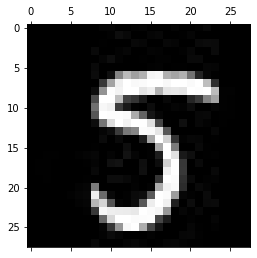

-------------------------------------------
Test: 865
Predicted: 2


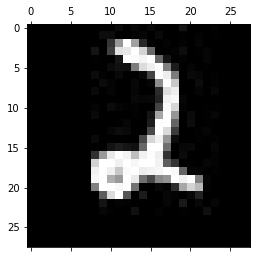

-------------------------------------------
Test: 866
Predicted: 6


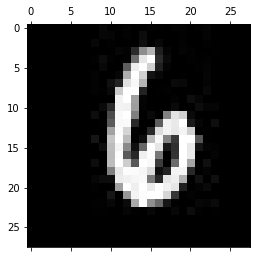

-------------------------------------------
Test: 867
Predicted: 7


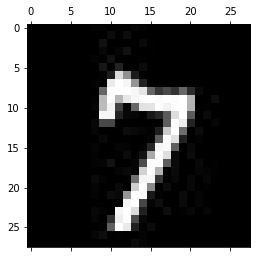

-------------------------------------------
Test: 868
Predicted: 3


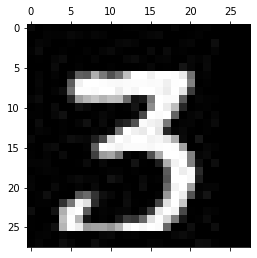

-------------------------------------------
Test: 869
Predicted: 2


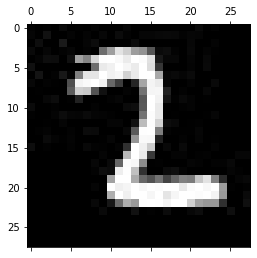

-------------------------------------------
Test: 870
Predicted: 6


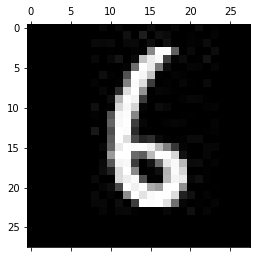

-------------------------------------------
Test: 871
Predicted: 3


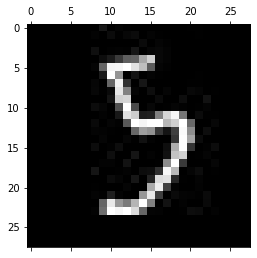

-------------------------------------------
Test: 872
Predicted: 0


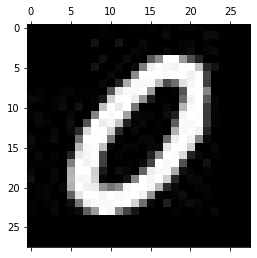

-------------------------------------------
Test: 873
Predicted: 2


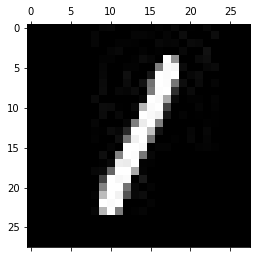

-------------------------------------------
Test: 874
Predicted: 4


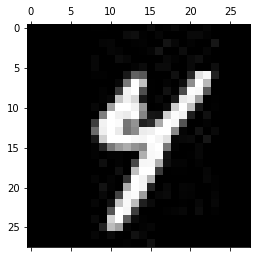

-------------------------------------------
Test: 875
Predicted: 3


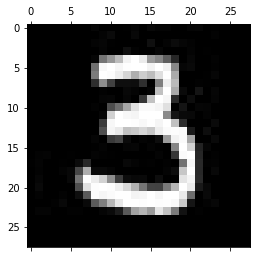

-------------------------------------------
Test: 876
Predicted: 9


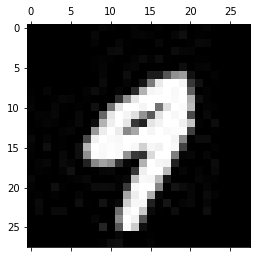

-------------------------------------------
Test: 877
Predicted: 0


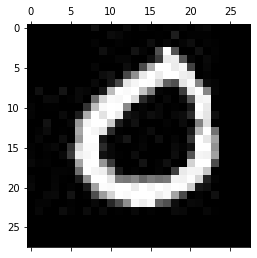

-------------------------------------------
Test: 878
Predicted: 3


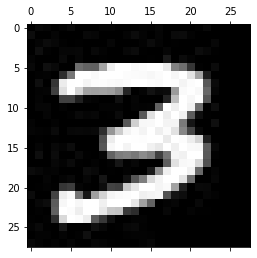

-------------------------------------------
Test: 879
Predicted: 0


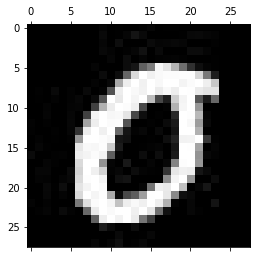

-------------------------------------------
Test: 880
Predicted: 0


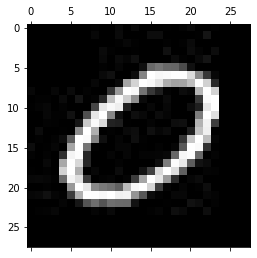

-------------------------------------------
Test: 881
Predicted: 7


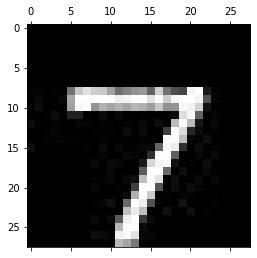

-------------------------------------------
Test: 882
Predicted: 0


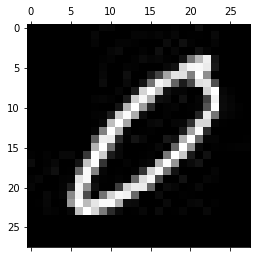

-------------------------------------------
Test: 883
Predicted: 5


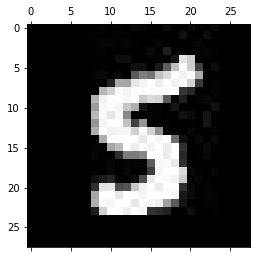

-------------------------------------------
Test: 884
Predicted: 3


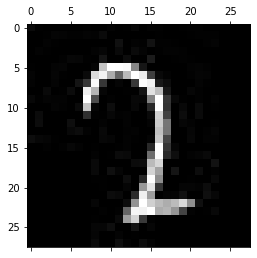

-------------------------------------------
Test: 885
Predicted: 0


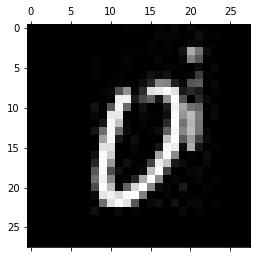

-------------------------------------------
Test: 886
Predicted: 5


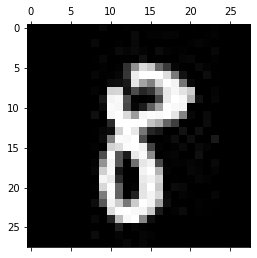

-------------------------------------------
Test: 887
Predicted: 5


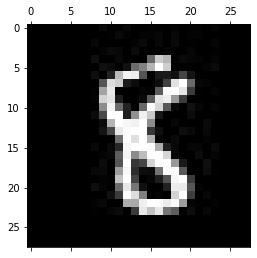

-------------------------------------------
Test: 888
Predicted: 5


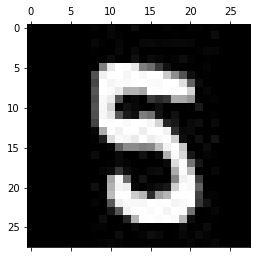

-------------------------------------------
Test: 889
Predicted: 5


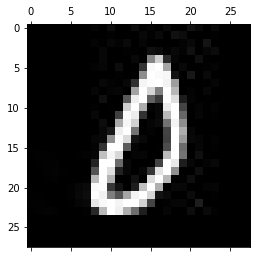

-------------------------------------------
Test: 890
Predicted: 9


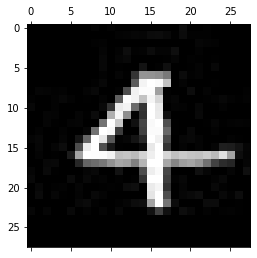

-------------------------------------------
Test: 891
Predicted: 7


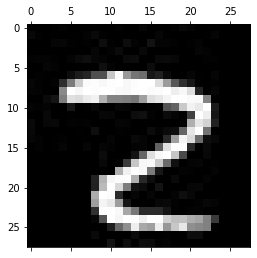

-------------------------------------------
Test: 892
Predicted: 6


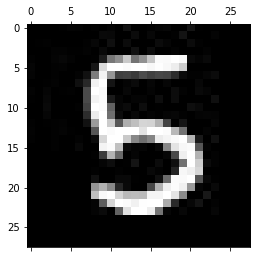

-------------------------------------------
Test: 893
Predicted: 5


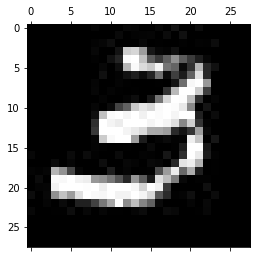

-------------------------------------------
Test: 894
Predicted: 3


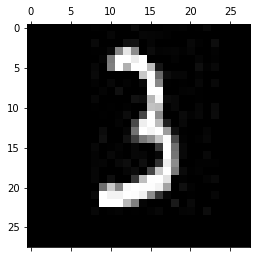

-------------------------------------------
Test: 895
Predicted: 6


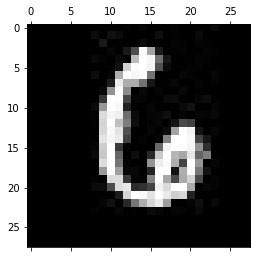

-------------------------------------------
Test: 896
Predicted: 5


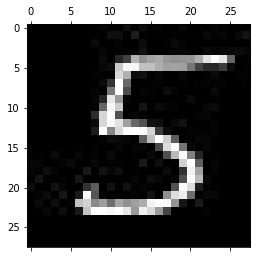

-------------------------------------------
Test: 897
Predicted: 3


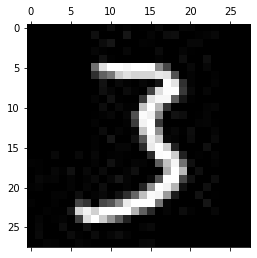

-------------------------------------------
Test: 898
Predicted: 4


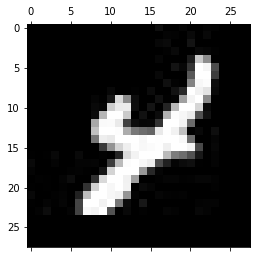

-------------------------------------------
Test: 899
Predicted: 5


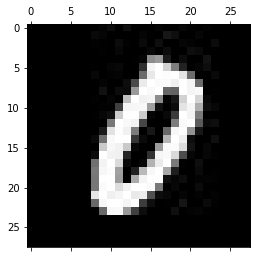

-------------------------------------------
Test: 900
Predicted: 7


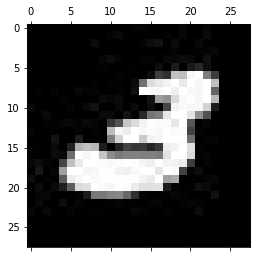

-------------------------------------------
Test: 901
Predicted: 0


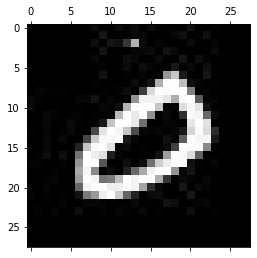

-------------------------------------------
Test: 902
Predicted: 5


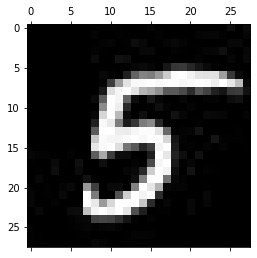

-------------------------------------------
Test: 903
Predicted: 4


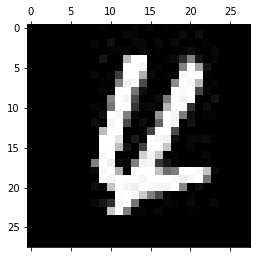

-------------------------------------------
Test: 904
Predicted: 4


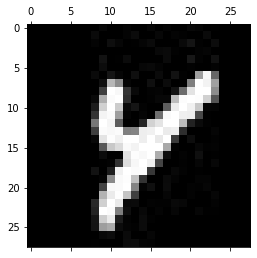

-------------------------------------------
Test: 905
Predicted: 9


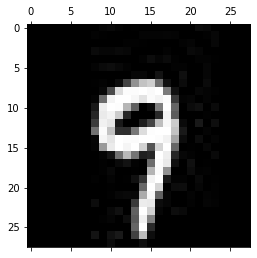

-------------------------------------------
Test: 906
Predicted: 6


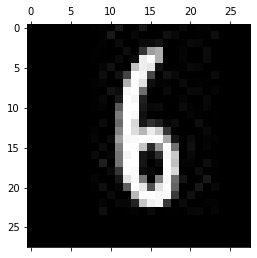

-------------------------------------------
Test: 907
Predicted: 4


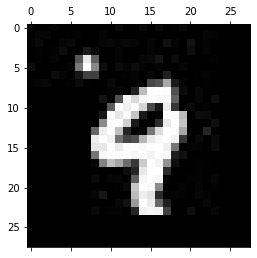

-------------------------------------------
Test: 908
Predicted: 2


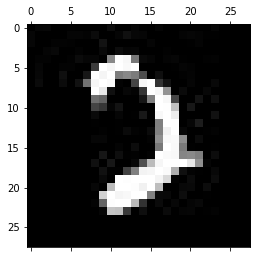

-------------------------------------------
Test: 909
Predicted: 5


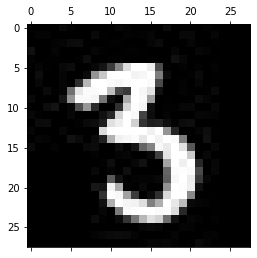

-------------------------------------------
Test: 910
Predicted: 1


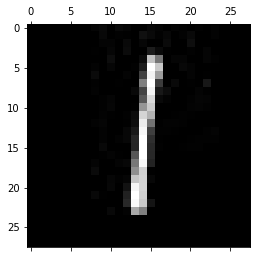

-------------------------------------------
Test: 911
Predicted: 4


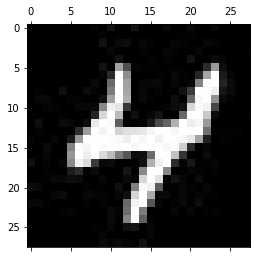

-------------------------------------------
Test: 912
Predicted: 5


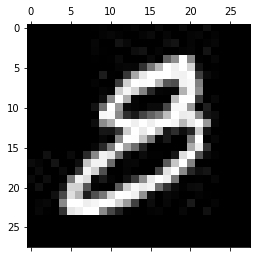

-------------------------------------------
Test: 913
Predicted: 7


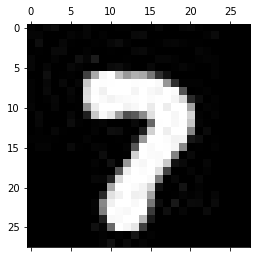

-------------------------------------------
Test: 914
Predicted: 7


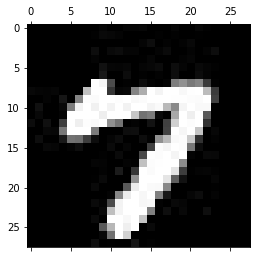

-------------------------------------------
Test: 915
Predicted: 2


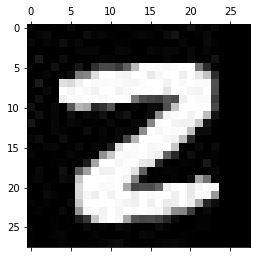

-------------------------------------------
Test: 916
Predicted: 7


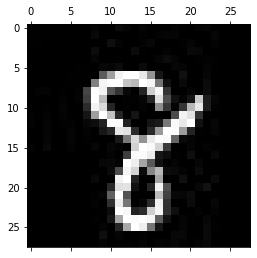

-------------------------------------------
Test: 917
Predicted: 5


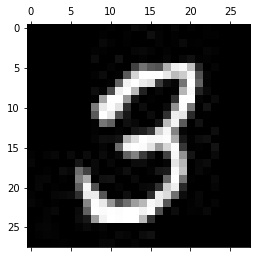

-------------------------------------------
Test: 918
Predicted: 0


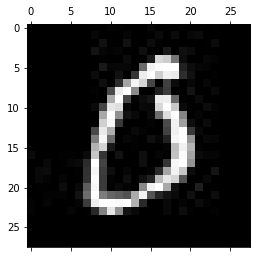

-------------------------------------------
Test: 919
Predicted: 4


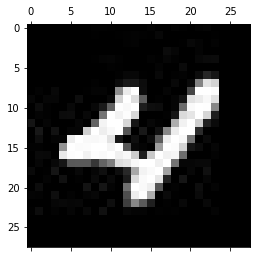

-------------------------------------------
Test: 920
Predicted: 7


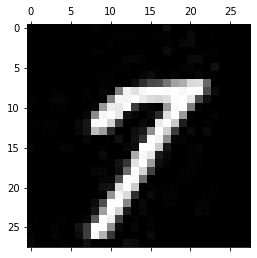

-------------------------------------------
Test: 921
Predicted: 7


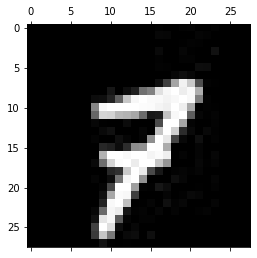

-------------------------------------------
Test: 922
Predicted: 5


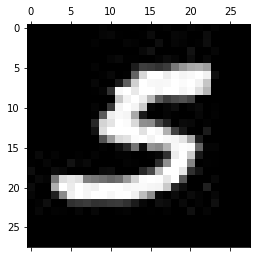

-------------------------------------------
Test: 923
Predicted: 7


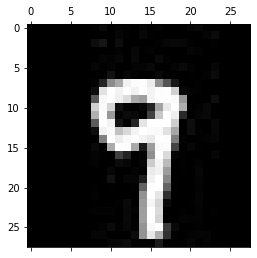

-------------------------------------------
Test: 924
Predicted: 5


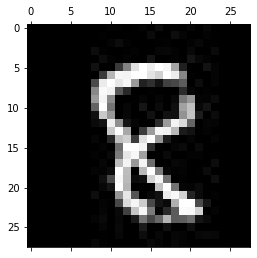

-------------------------------------------
Test: 925
Predicted: 6


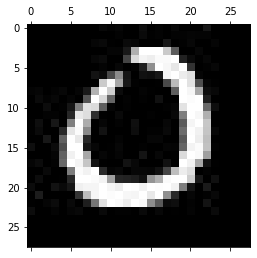

-------------------------------------------
Test: 926
Predicted: 9


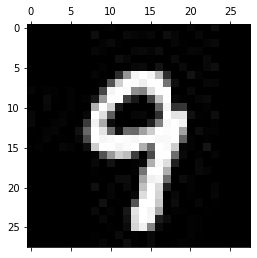

-------------------------------------------
Test: 927
Predicted: 1


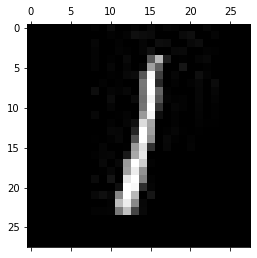

-------------------------------------------
Test: 928
Predicted: 7


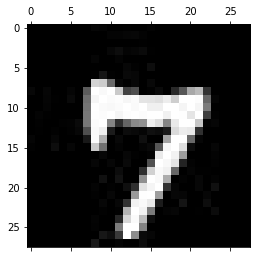

-------------------------------------------
Test: 929
Predicted: 1


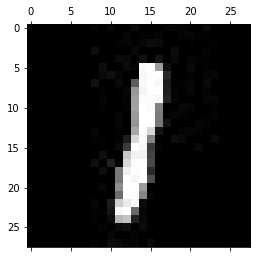

-------------------------------------------
Test: 930
Predicted: 9


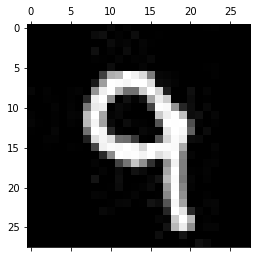

-------------------------------------------
Test: 931
Predicted: 9


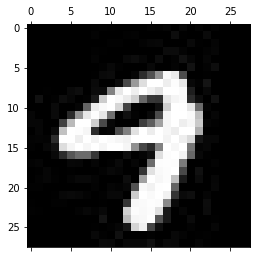

-------------------------------------------
Test: 932
Predicted: 5


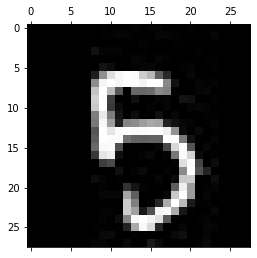

-------------------------------------------
Test: 933
Predicted: 5


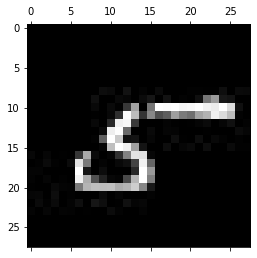

-------------------------------------------
Test: 934
Predicted: 3


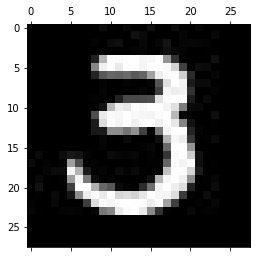

-------------------------------------------
Test: 935
Predicted: 1


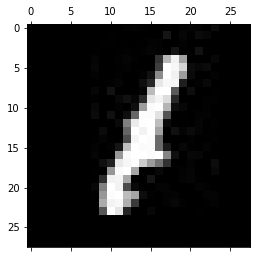

-------------------------------------------
Test: 936
Predicted: 5


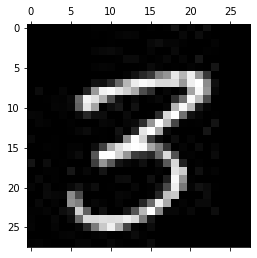

-------------------------------------------
Test: 937
Predicted: 9


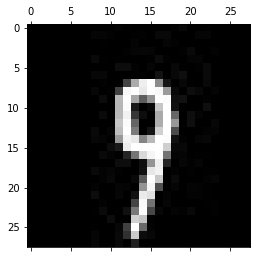

-------------------------------------------
Test: 938
Predicted: 5


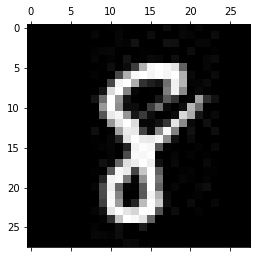

-------------------------------------------
Test: 939
Predicted: 7


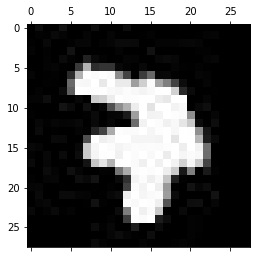

-------------------------------------------
Test: 940
Predicted: 3


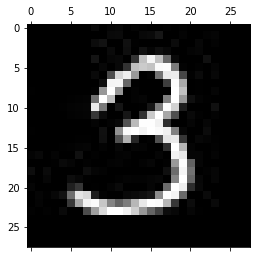

-------------------------------------------
Test: 941
Predicted: 4


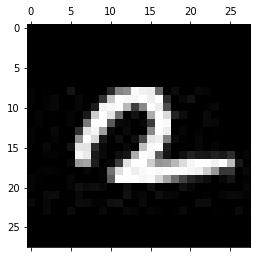

-------------------------------------------
Test: 942
Predicted: 1


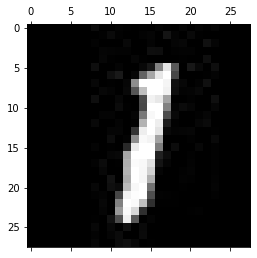

-------------------------------------------
Test: 943
Predicted: 7


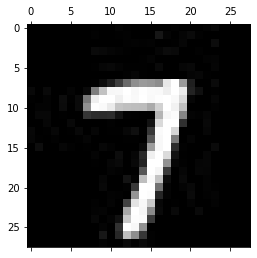

-------------------------------------------
Test: 944
Predicted: 2


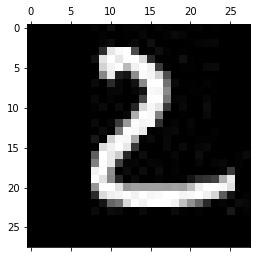

-------------------------------------------
Test: 945
Predicted: 2


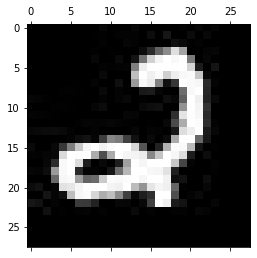

-------------------------------------------
Test: 946
Predicted: 3


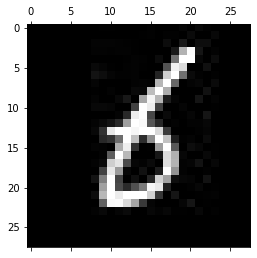

-------------------------------------------
Test: 947
Predicted: 1


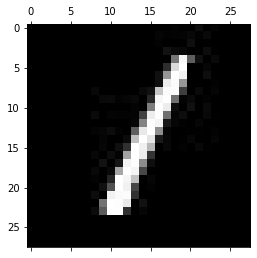

-------------------------------------------
Test: 948
Predicted: 0


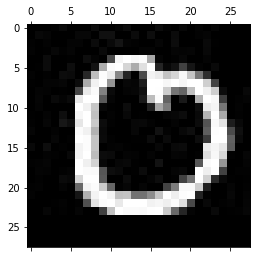

-------------------------------------------
Test: 949
Predicted: 9


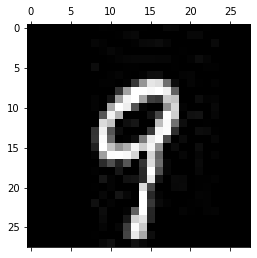

-------------------------------------------
Test: 950
Predicted: 5


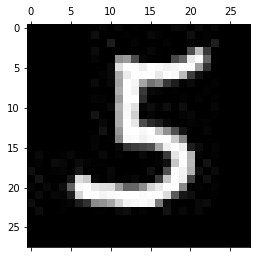

-------------------------------------------
Test: 951
Predicted: 5


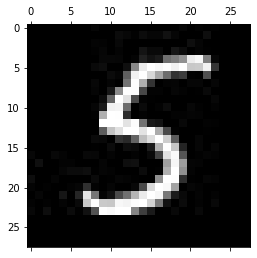

-------------------------------------------
Test: 952
Predicted: 7


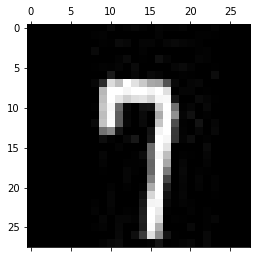

-------------------------------------------
Test: 953
Predicted: 5


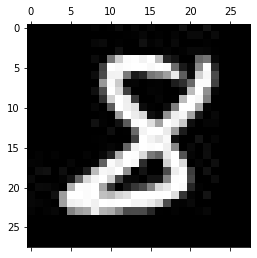

-------------------------------------------
Test: 954
Predicted: 0


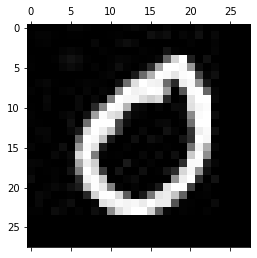

-------------------------------------------
Test: 955
Predicted: 2


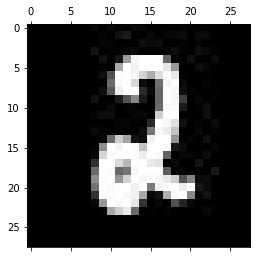

-------------------------------------------
Test: 956
Predicted: 2


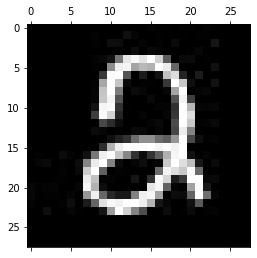

-------------------------------------------
Test: 957
Predicted: 5


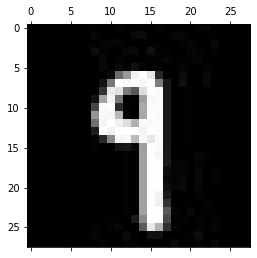

-------------------------------------------
Test: 958
Predicted: 4


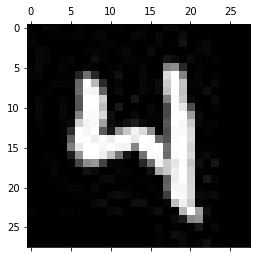

-------------------------------------------
Test: 959
Predicted: 7


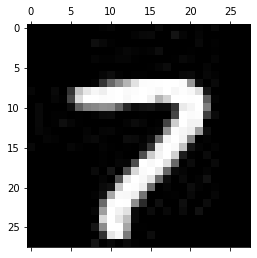

-------------------------------------------
Test: 960
Predicted: 5


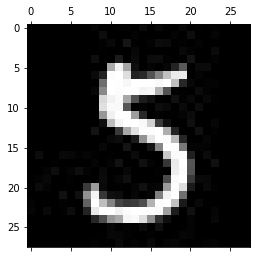

-------------------------------------------
Test: 961
Predicted: 3


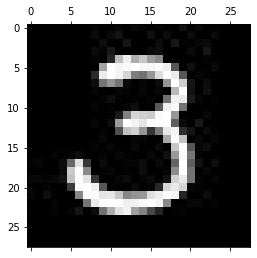

-------------------------------------------
Test: 962
Predicted: 5


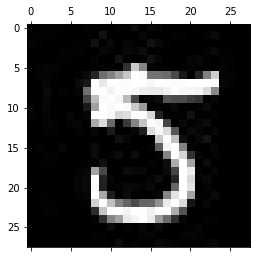

-------------------------------------------
Test: 963
Predicted: 4


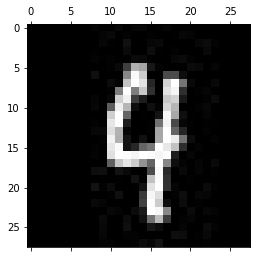

-------------------------------------------
Test: 964
Predicted: 5


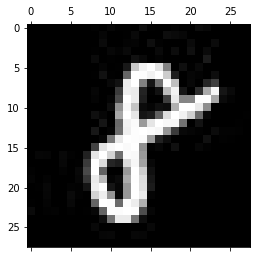

-------------------------------------------
Test: 965
Predicted: 1


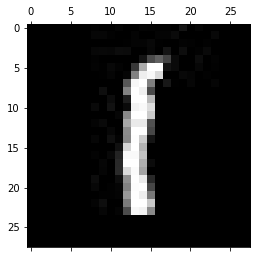

-------------------------------------------
Test: 966
Predicted: 9


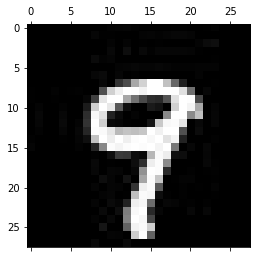

-------------------------------------------
Test: 967
Predicted: 3


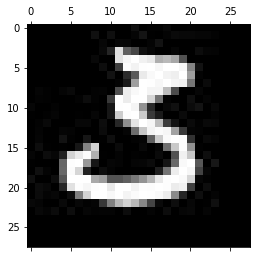

-------------------------------------------
Test: 968
Predicted: 4


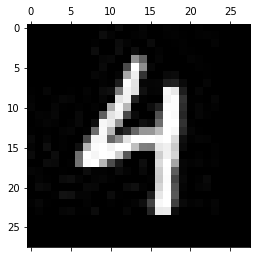

-------------------------------------------
Test: 969
Predicted: 5


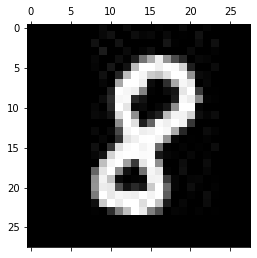

-------------------------------------------
Test: 970
Predicted: 2


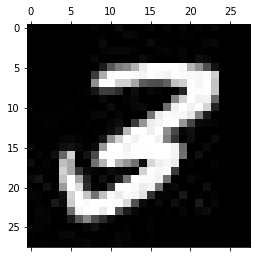

-------------------------------------------
Test: 971
Predicted: 5


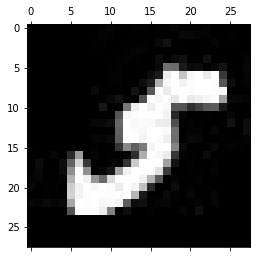

-------------------------------------------
Test: 972
Predicted: 5


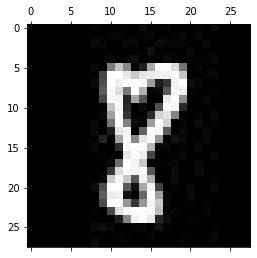

-------------------------------------------
Test: 973
Predicted: 2


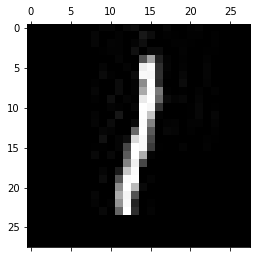

-------------------------------------------
Test: 974
Predicted: 4


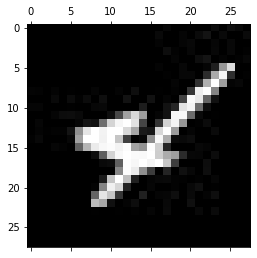

-------------------------------------------
Test: 975
Predicted: 6


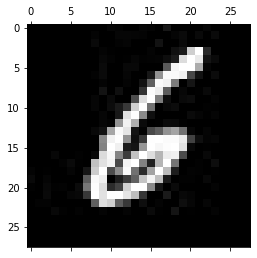

-------------------------------------------
Test: 976
Predicted: 1


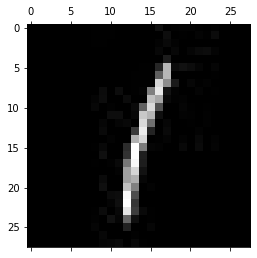

-------------------------------------------
Test: 977
Predicted: 0


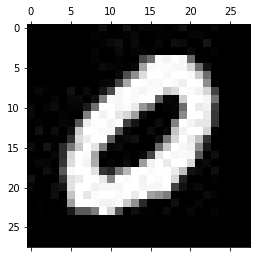

-------------------------------------------
Test: 978
Predicted: 6


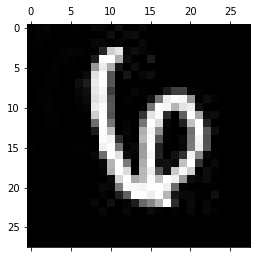

-------------------------------------------
Test: 979
Predicted: 5


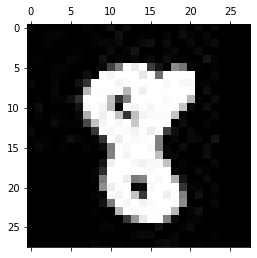

-------------------------------------------
Test: 980
Predicted: 5


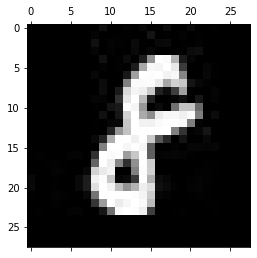

-------------------------------------------
Test: 981
Predicted: 0


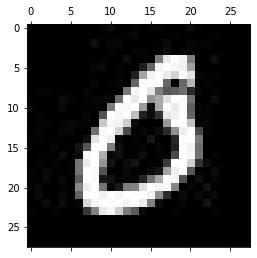

-------------------------------------------
Test: 982
Predicted: 4


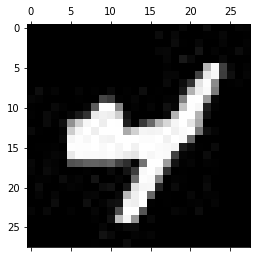

-------------------------------------------
Test: 983
Predicted: 5


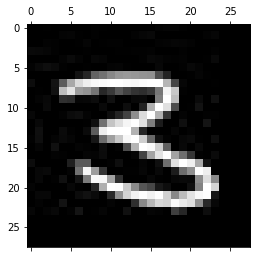

-------------------------------------------
Test: 984
Predicted: 3


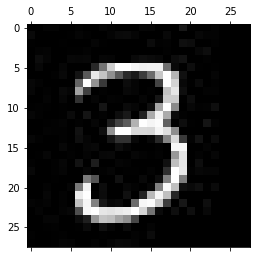

-------------------------------------------
Test: 985
Predicted: 6


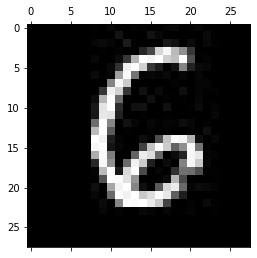

-------------------------------------------
Test: 986
Predicted: 2


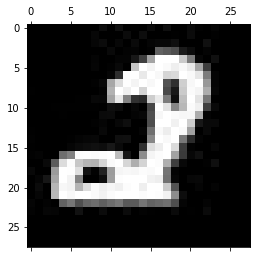

-------------------------------------------
Test: 987
Predicted: 1


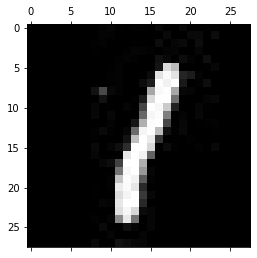

-------------------------------------------
Test: 988
Predicted: 9


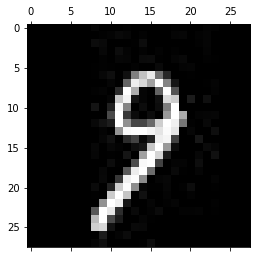

-------------------------------------------
Test: 989
Predicted: 1


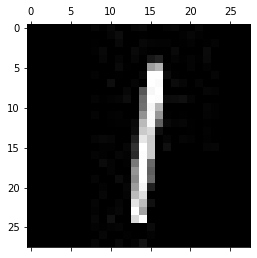

-------------------------------------------
Test: 990
Predicted: 0


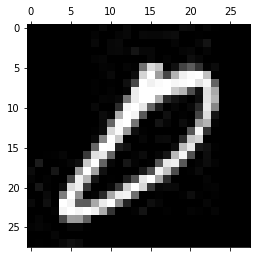

-------------------------------------------
Test: 991
Predicted: 3


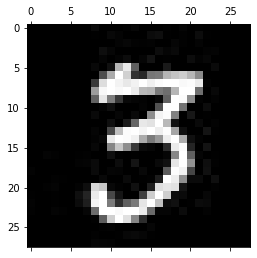

-------------------------------------------
Test: 992
Predicted: 4


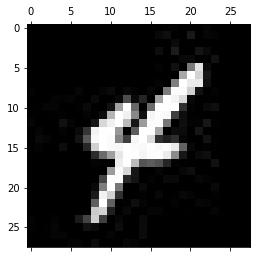

-------------------------------------------
Test: 993
Predicted: 3


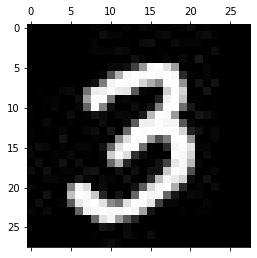

-------------------------------------------
Test: 994
Predicted: 5


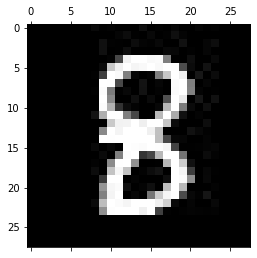

-------------------------------------------
Test: 995
Predicted: 7


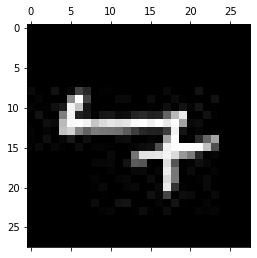

-------------------------------------------
Test: 996
Predicted: 9


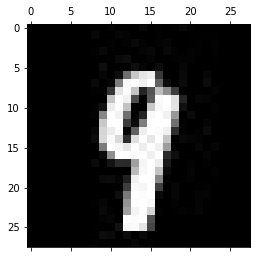

-------------------------------------------
Test: 997
Predicted: 7


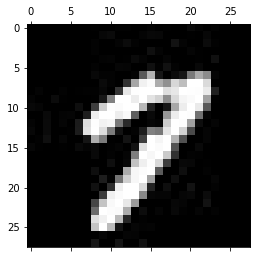

-------------------------------------------
Test: 998
Predicted: 6


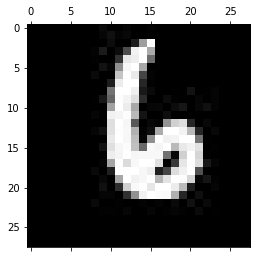

-------------------------------------------
Test: 999
Predicted: 4


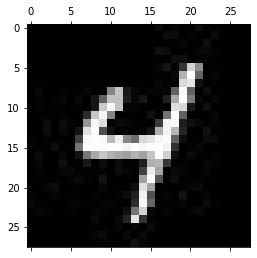

-------------------------------------------
Test: 1000
Predicted: 5


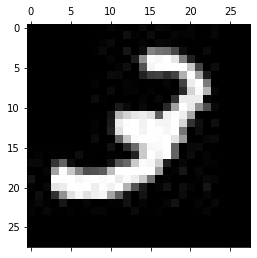

-------------------------------------------
Test: 1001
Predicted: 5


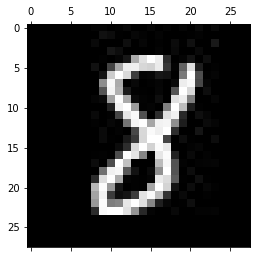

-------------------------------------------
Test: 1002
Predicted: 9


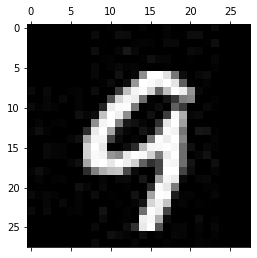

-------------------------------------------
Test: 1003
Predicted: 4


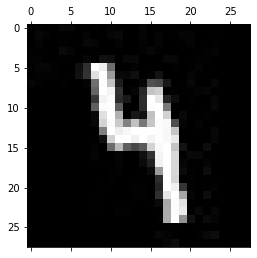

-------------------------------------------
Test: 1004
Predicted: 5


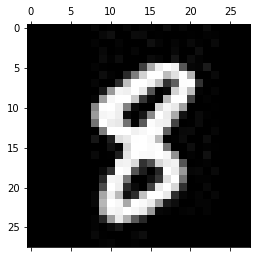

-------------------------------------------
Test: 1005
Predicted: 1


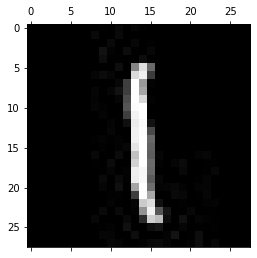

-------------------------------------------
Test: 1006
Predicted: 6


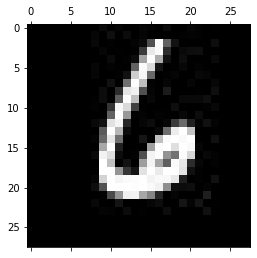

-------------------------------------------
Test: 1007
Predicted: 4


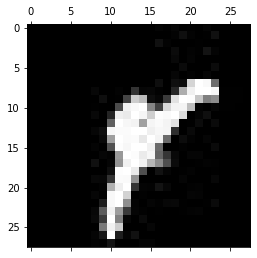

-------------------------------------------
Test: 1008
Predicted: 5


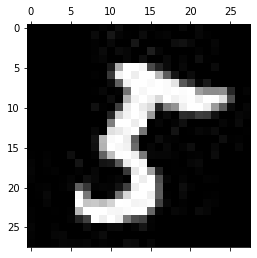

-------------------------------------------
Test: 1009
Predicted: 4


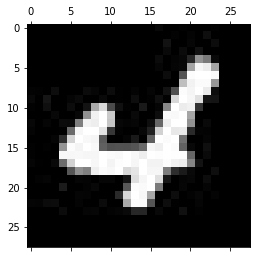

-------------------------------------------
Test: 1010
Predicted: 1


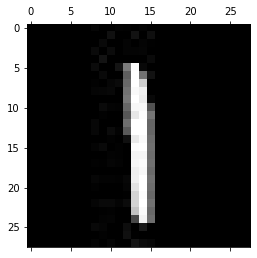

-------------------------------------------
Test: 1011
Predicted: 3


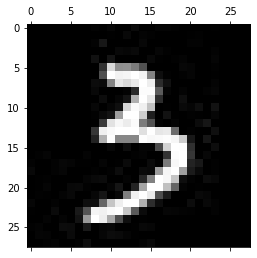

-------------------------------------------
Test: 1012
Predicted: 7


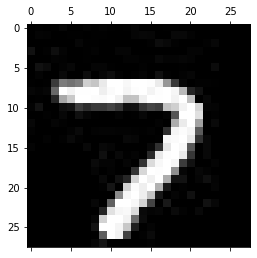

-------------------------------------------
Test: 1013
Predicted: 5


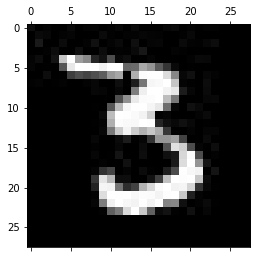

-------------------------------------------
Test: 1014
Predicted: 2


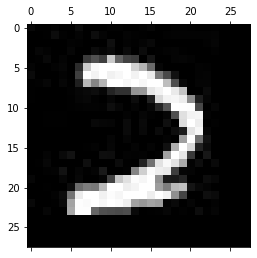

-------------------------------------------
Test: 1015
Predicted: 0


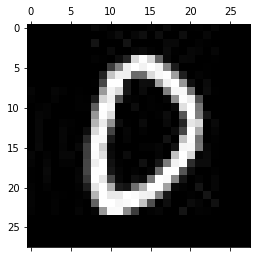

-------------------------------------------
Test: 1016
Predicted: 6


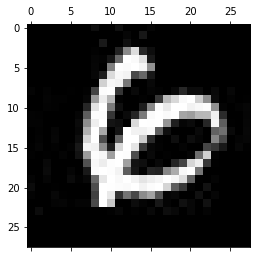

-------------------------------------------
Test: 1017
Predicted: 5


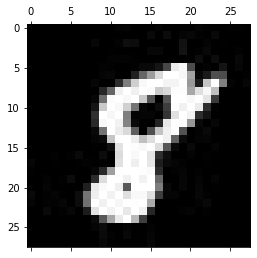

-------------------------------------------
Test: 1018
Predicted: 6


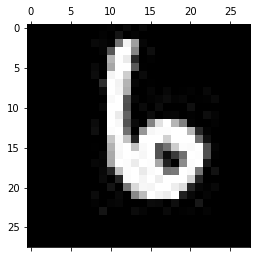

-------------------------------------------
Test: 1019
Predicted: 1


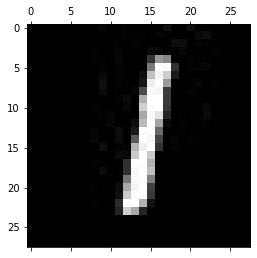

-------------------------------------------
Test: 1020
Predicted: 9


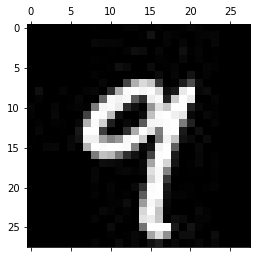

-------------------------------------------
Test: 1021
Predicted: 5


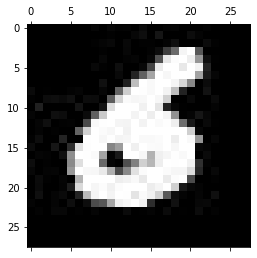

-------------------------------------------
Test: 1022
Predicted: 3


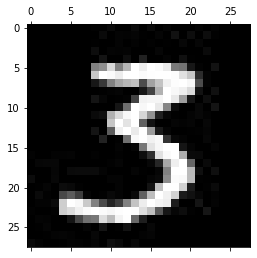

-------------------------------------------
Test: 1023
Predicted: 6


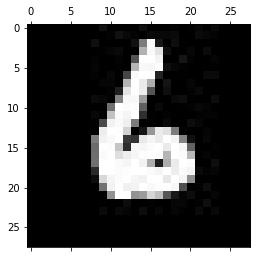

-------------------------------------------
Test: 1024
Predicted: 2


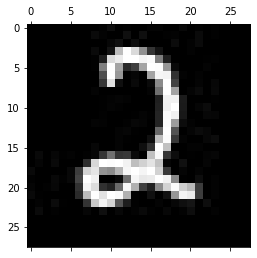

-------------------------------------------
Test: 1025
Predicted: 1


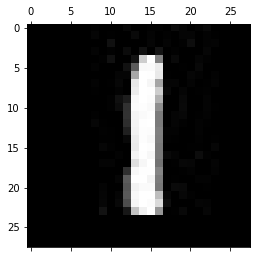

-------------------------------------------
Test: 1026
Predicted: 3


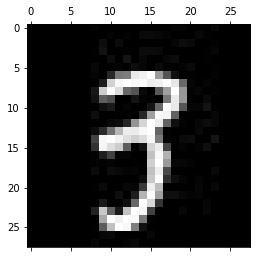

-------------------------------------------
Test: 1027
Predicted: 1


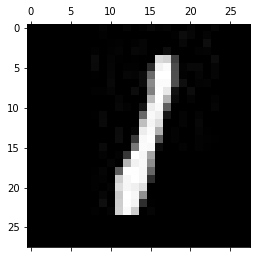

-------------------------------------------
Test: 1028
Predicted: 1


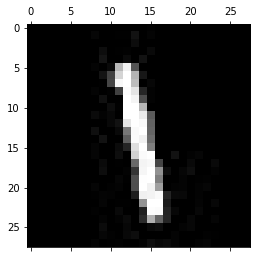

-------------------------------------------
Test: 1029
Predicted: 2


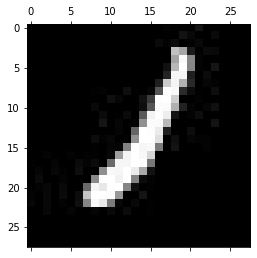

-------------------------------------------
Test: 1030
Predicted: 5


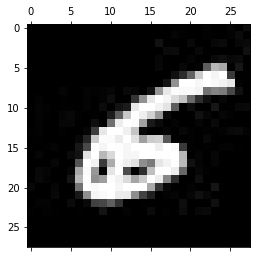

-------------------------------------------
Test: 1031
Predicted: 7


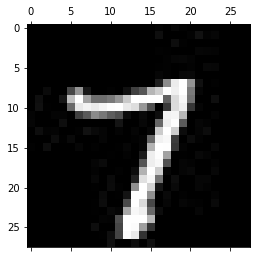

-------------------------------------------
Test: 1032
Predicted: 9


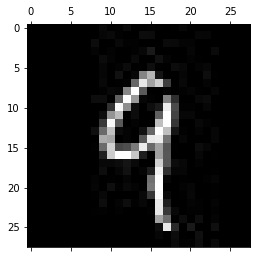

-------------------------------------------
Test: 1033
Predicted: 6


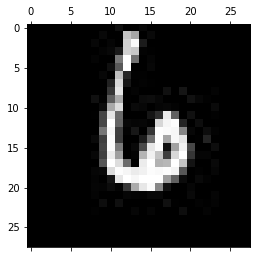

-------------------------------------------
Test: 1034
Predicted: 0


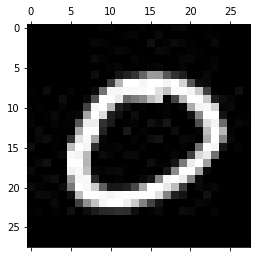

-------------------------------------------
Test: 1035
Predicted: 6


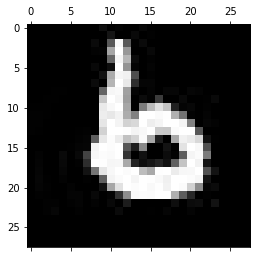

-------------------------------------------
Test: 1036
Predicted: 7


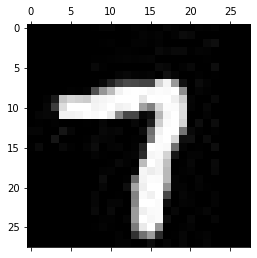

-------------------------------------------
Test: 1037
Predicted: 7


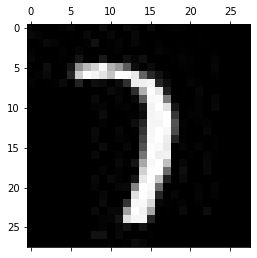

-------------------------------------------
Test: 1038
Predicted: 0


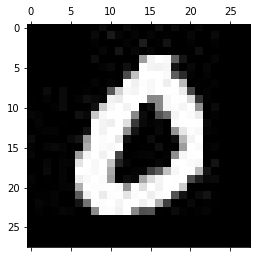

-------------------------------------------
Test: 1039
Predicted: 1


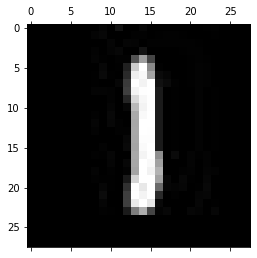

-------------------------------------------
Test: 1040
Predicted: 5


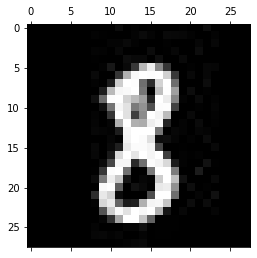

-------------------------------------------
Test: 1041
Predicted: 4


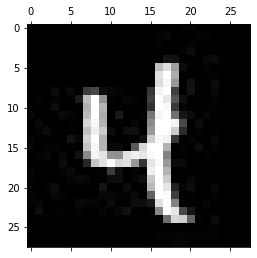

-------------------------------------------
Test: 1042
Predicted: 0


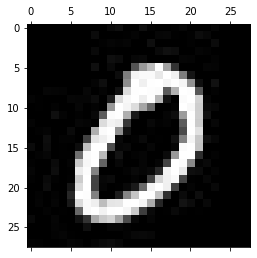

-------------------------------------------
Test: 1043
Predicted: 7


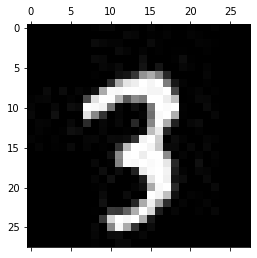

-------------------------------------------
Test: 1044
Predicted: 5


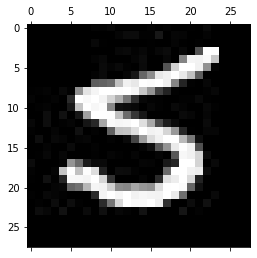

-------------------------------------------
Test: 1045
Predicted: 7


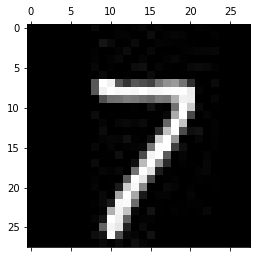

-------------------------------------------
Test: 1046
Predicted: 5


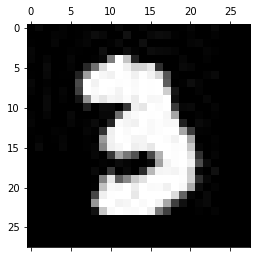

-------------------------------------------
Test: 1047
Predicted: 5


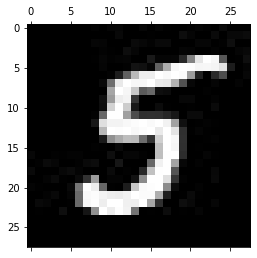

-------------------------------------------
Test: 1048
Predicted: 5


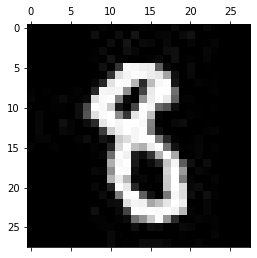

-------------------------------------------
Test: 1049
Predicted: 4


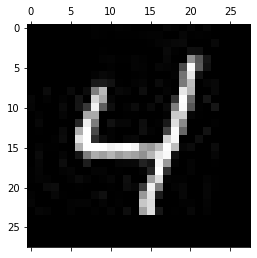

-------------------------------------------
Test: 1050
Predicted: 4


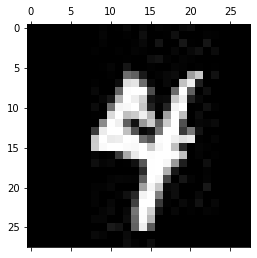

-------------------------------------------
Test: 1051
Predicted: 5


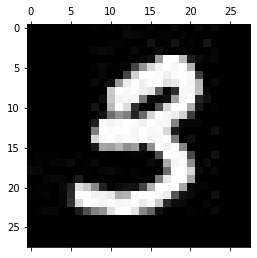

-------------------------------------------
Test: 1052
Predicted: 3


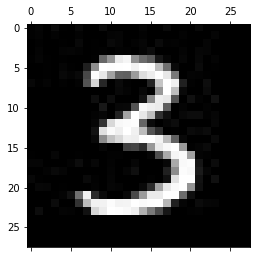

-------------------------------------------
Test: 1053
Predicted: 2


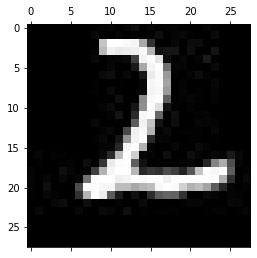

-------------------------------------------
Test: 1054
Predicted: 5


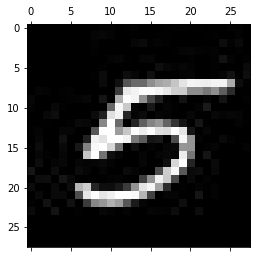

-------------------------------------------
Test: 1055
Predicted: 5


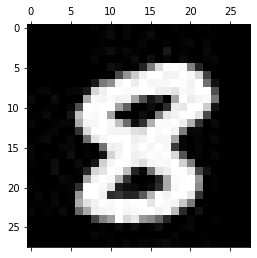

-------------------------------------------
Test: 1056
Predicted: 3


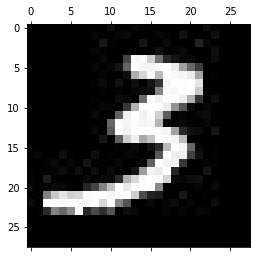

-------------------------------------------
Test: 1057
Predicted: 1


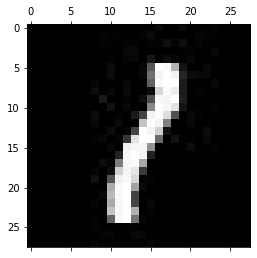

-------------------------------------------
Test: 1058
Predicted: 3


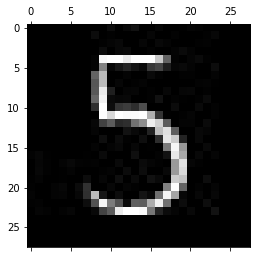

-------------------------------------------
Test: 1059
Predicted: 2


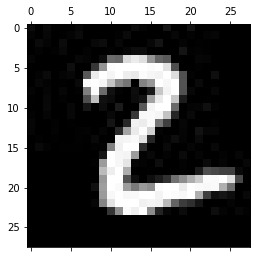

-------------------------------------------
Test: 1060
Predicted: 0


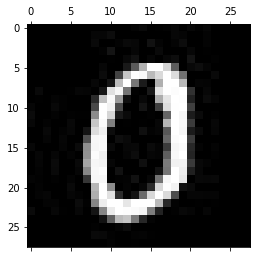

-------------------------------------------
Test: 1061
Predicted: 5


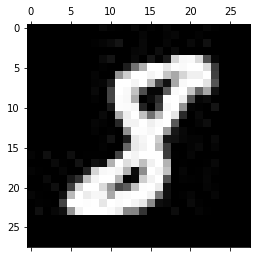

-------------------------------------------
Test: 1062
Predicted: 0


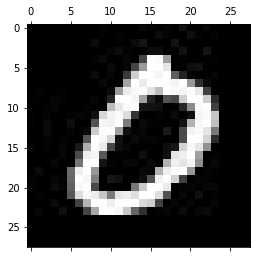

-------------------------------------------
Test: 1063
Predicted: 5


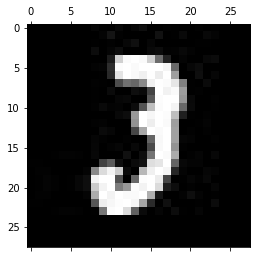

-------------------------------------------
Test: 1064
Predicted: 4


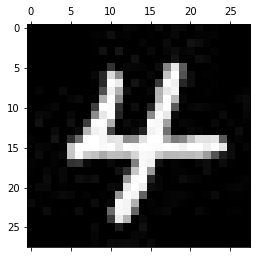

-------------------------------------------
Test: 1065
Predicted: 7


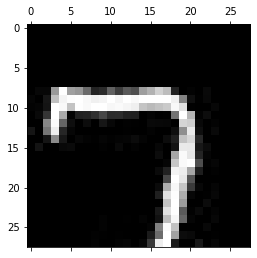

-------------------------------------------
Test: 1066
Predicted: 5


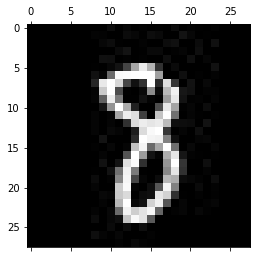

-------------------------------------------
Test: 1067
Predicted: 4


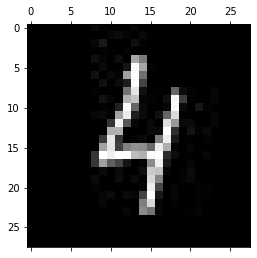

-------------------------------------------
Test: 1068
Predicted: 4


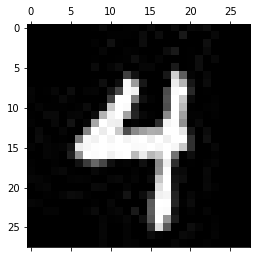

-------------------------------------------
Test: 1069
Predicted: 1


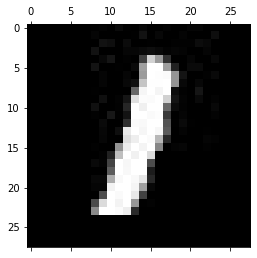

-------------------------------------------
Test: 1070
Predicted: 9


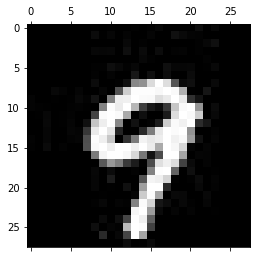

-------------------------------------------
Test: 1071
Predicted: 1


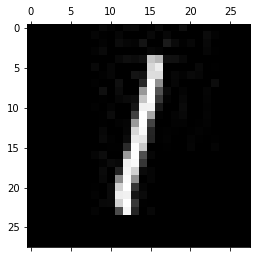

-------------------------------------------
Test: 1072
Predicted: 9


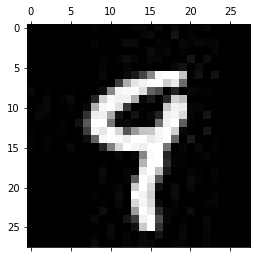

-------------------------------------------
Test: 1073
Predicted: 5


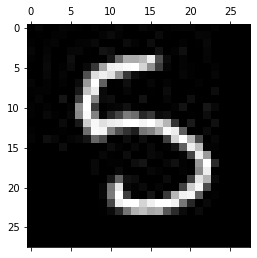

-------------------------------------------
Test: 1074
Predicted: 2


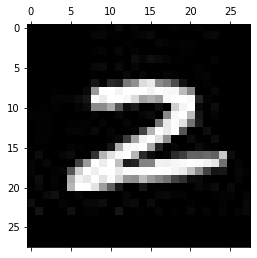

-------------------------------------------
Test: 1075
Predicted: 7


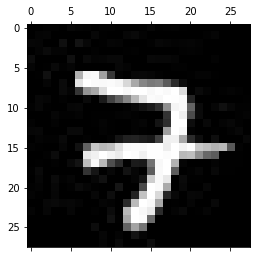

-------------------------------------------
Test: 1076
Predicted: 3


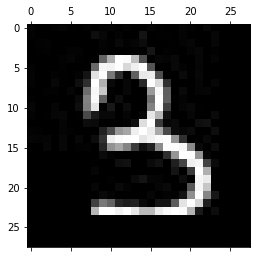

-------------------------------------------
Test: 1077
Predicted: 2


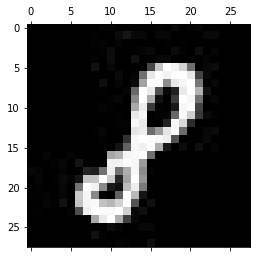

-------------------------------------------
Test: 1078
Predicted: 6


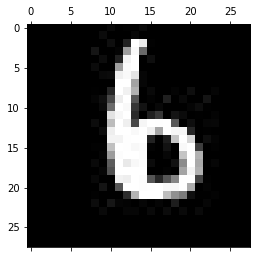

-------------------------------------------
Test: 1079
Predicted: 9


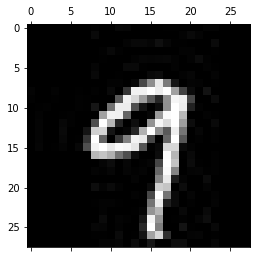

-------------------------------------------
Test: 1080
Predicted: 5


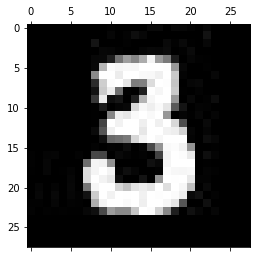

-------------------------------------------
Test: 1081
Predicted: 6


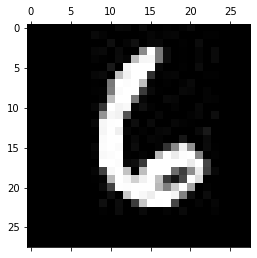

-------------------------------------------
Test: 1082
Predicted: 1


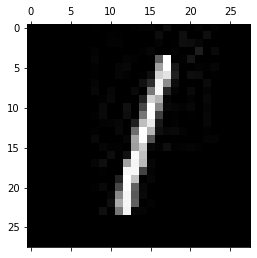

-------------------------------------------
Test: 1083
Predicted: 2


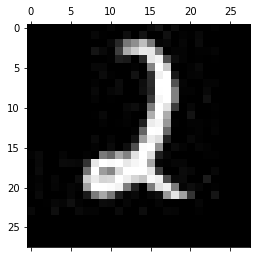

-------------------------------------------
Test: 1084
Predicted: 0


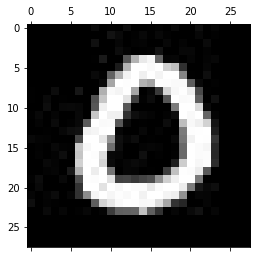

-------------------------------------------
Test: 1085
Predicted: 4


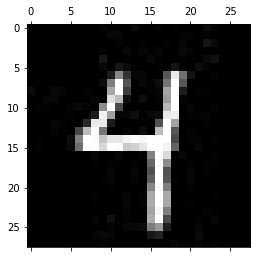

-------------------------------------------
Test: 1086
Predicted: 0


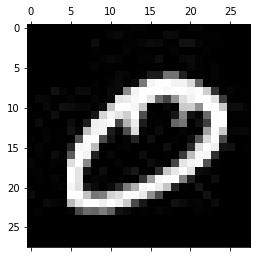

-------------------------------------------
Test: 1087
Predicted: 5


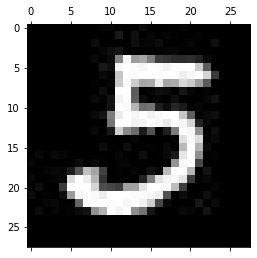

-------------------------------------------
Test: 1088
Predicted: 0


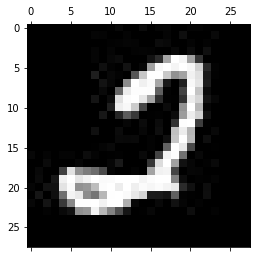

-------------------------------------------
Test: 1089
Predicted: 0


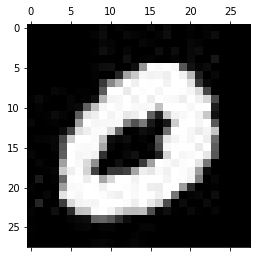

-------------------------------------------
Test: 1090
Predicted: 0


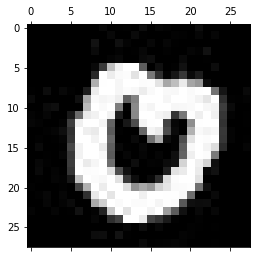

-------------------------------------------
Test: 1091
Predicted: 0


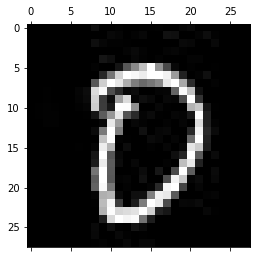

-------------------------------------------
Test: 1092
Predicted: 4


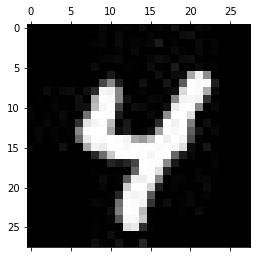

-------------------------------------------
Test: 1093
Predicted: 6


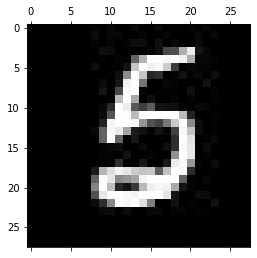

-------------------------------------------
Test: 1094
Predicted: 3


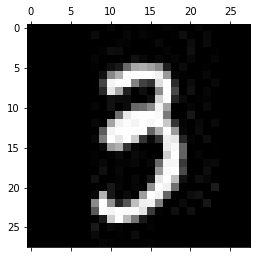

-------------------------------------------
Test: 1095
Predicted: 7


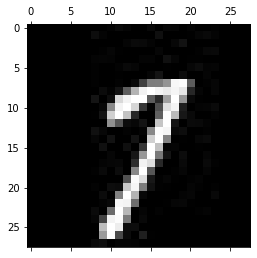

-------------------------------------------
Test: 1096
Predicted: 3


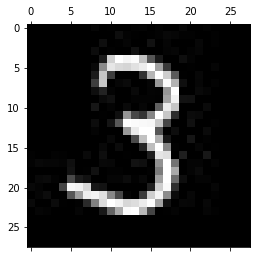

-------------------------------------------
Test: 1097
Predicted: 7


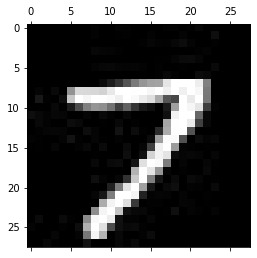

-------------------------------------------
Test: 1098
Predicted: 5


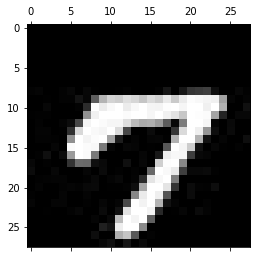

-------------------------------------------
Test: 1099
Predicted: 9


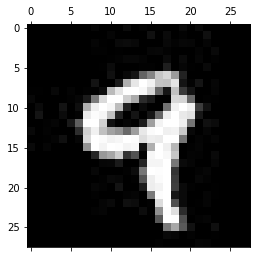

-------------------------------------------
Test: 1100
Predicted: 6


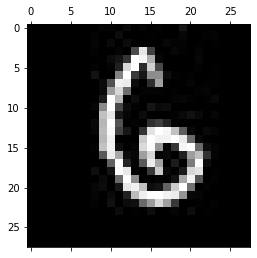

-------------------------------------------
Test: 1101
Predicted: 5


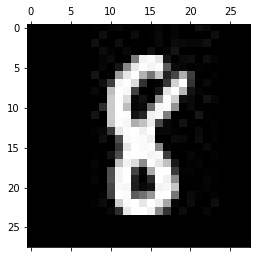

-------------------------------------------
Test: 1102
Predicted: 7


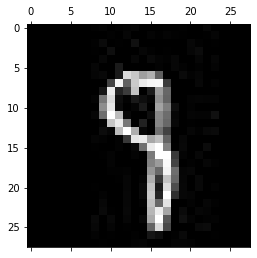

-------------------------------------------
Test: 1103
Predicted: 0


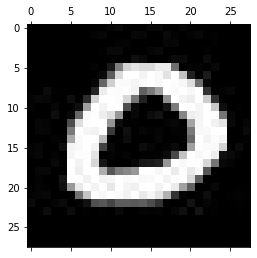

-------------------------------------------
Test: 1104
Predicted: 7


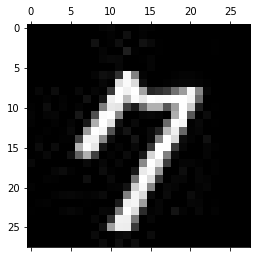

-------------------------------------------
Test: 1105
Predicted: 5


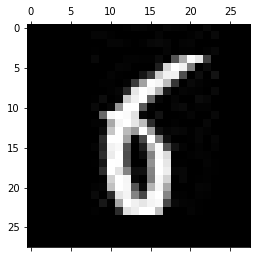

-------------------------------------------
Test: 1106
Predicted: 5


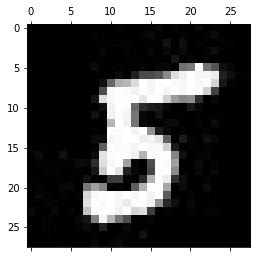

-------------------------------------------
Test: 1107
Predicted: 4


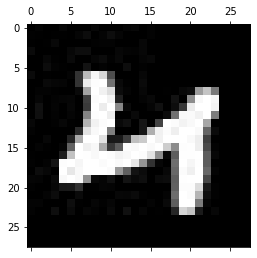

-------------------------------------------
Test: 1108
Predicted: 7


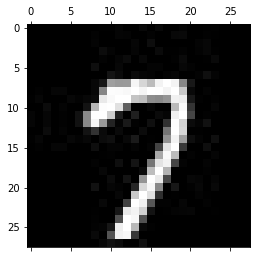

-------------------------------------------
Test: 1109
Predicted: 1


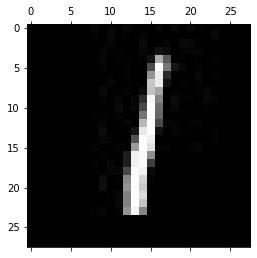

-------------------------------------------
Test: 1110
Predicted: 9


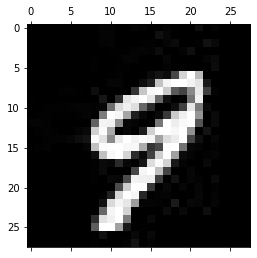

-------------------------------------------
Test: 1111
Predicted: 9


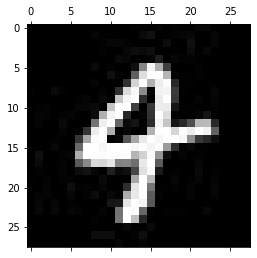

-------------------------------------------
Test: 1112
Predicted: 9


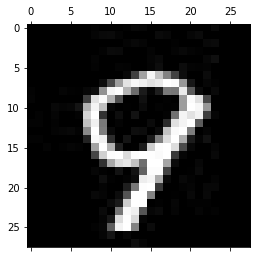

-------------------------------------------
Test: 1113
Predicted: 3


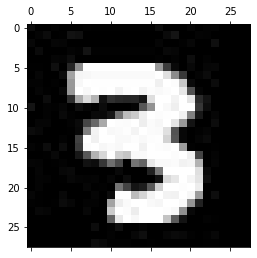

-------------------------------------------
Test: 1114
Predicted: 2


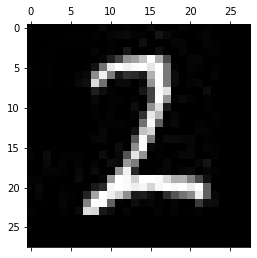

-------------------------------------------
Test: 1115
Predicted: 6


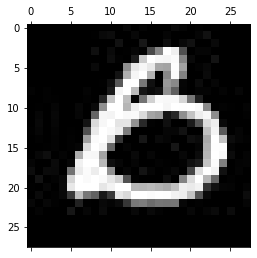

-------------------------------------------
Test: 1116
Predicted: 5


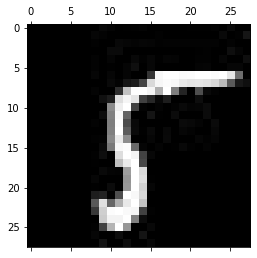

-------------------------------------------
Test: 1117
Predicted: 2


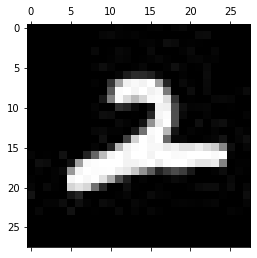

-------------------------------------------
Test: 1118
Predicted: 9


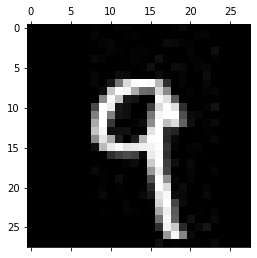

-------------------------------------------
Test: 1119
Predicted: 3


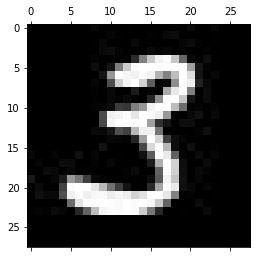

-------------------------------------------
Test: 1120
Predicted: 0


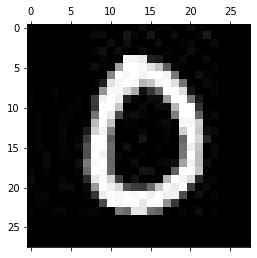

-------------------------------------------
Test: 1121
Predicted: 6


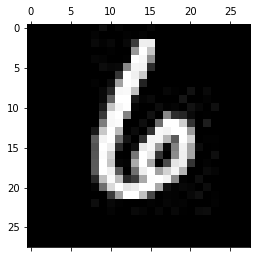

-------------------------------------------
Test: 1122
Predicted: 6


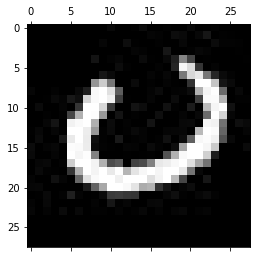

-------------------------------------------
Test: 1123
Predicted: 4


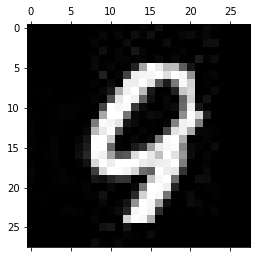

-------------------------------------------
Test: 1124
Predicted: 3


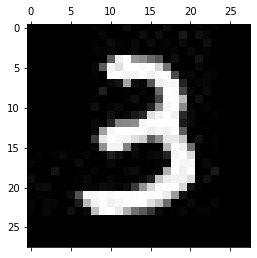

-------------------------------------------
Test: 1125
Predicted: 6


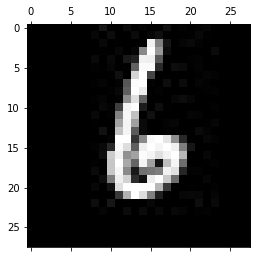

-------------------------------------------
Test: 1126
Predicted: 2


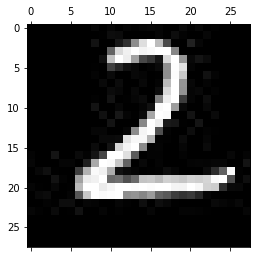

-------------------------------------------
Test: 1127
Predicted: 3


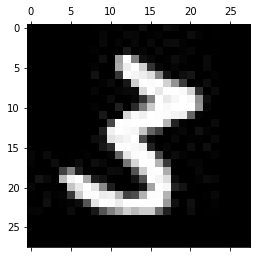

-------------------------------------------
Test: 1128
Predicted: 1


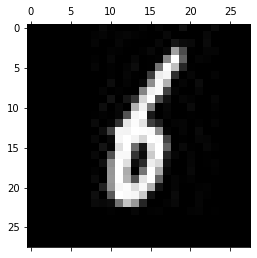

-------------------------------------------
Test: 1129
Predicted: 7


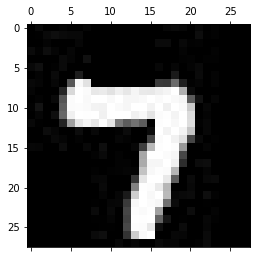

-------------------------------------------
Test: 1130
Predicted: 6


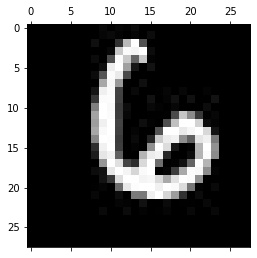

-------------------------------------------
Test: 1131
Predicted: 6


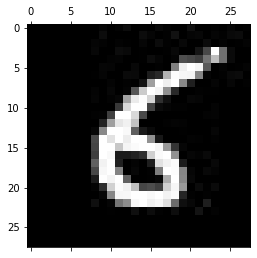

-------------------------------------------
Test: 1132
Predicted: 5


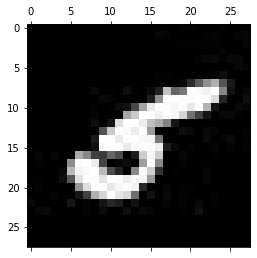

-------------------------------------------
Test: 1133
Predicted: 6


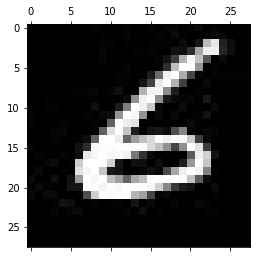

-------------------------------------------
Test: 1134
Predicted: 2


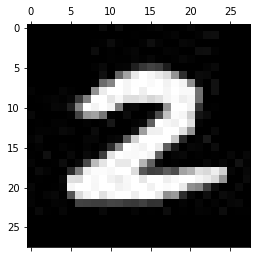

-------------------------------------------
Test: 1135
Predicted: 5


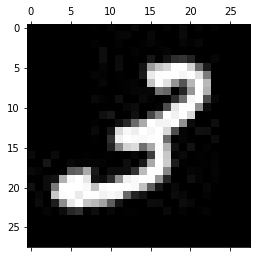

-------------------------------------------
Test: 1136
Predicted: 1


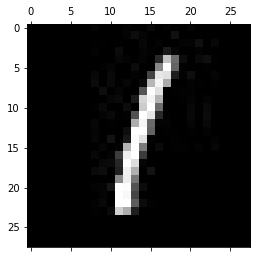

-------------------------------------------
Test: 1137
Predicted: 4


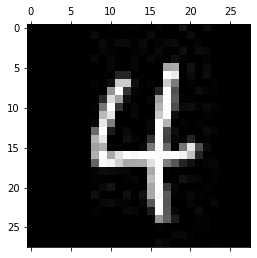

-------------------------------------------
Test: 1138
Predicted: 5


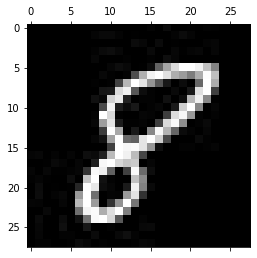

-------------------------------------------
Test: 1139
Predicted: 2


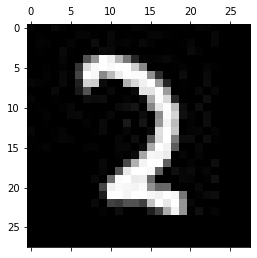

-------------------------------------------
Test: 1140
Predicted: 6


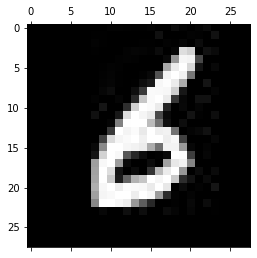

-------------------------------------------
Test: 1141
Predicted: 7


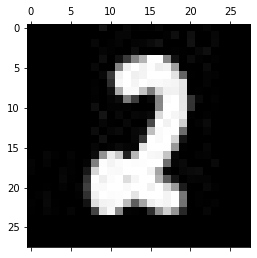

-------------------------------------------
Test: 1142
Predicted: 5


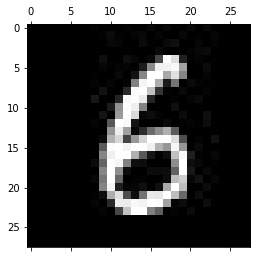

-------------------------------------------
Test: 1143
Predicted: 6


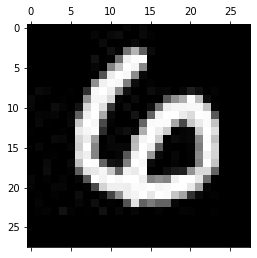

-------------------------------------------
Test: 1144
Predicted: 5


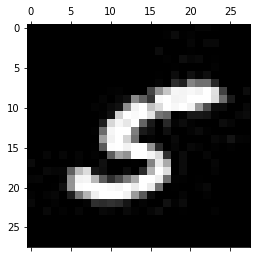

-------------------------------------------
Test: 1145
Predicted: 2


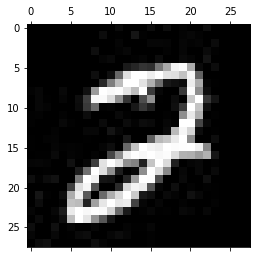

-------------------------------------------
Test: 1146
Predicted: 5


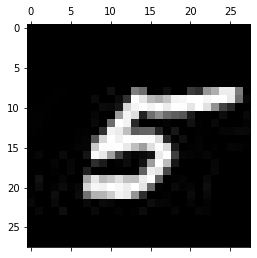

-------------------------------------------
Test: 1147
Predicted: 9


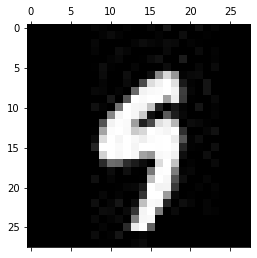

-------------------------------------------
Test: 1148
Predicted: 7


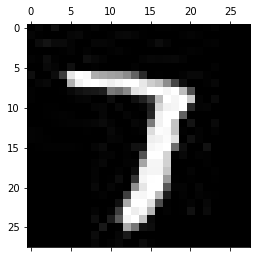

-------------------------------------------
Test: 1149
Predicted: 6


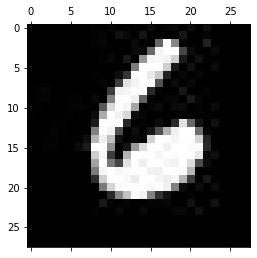

-------------------------------------------
Test: 1150
Predicted: 1


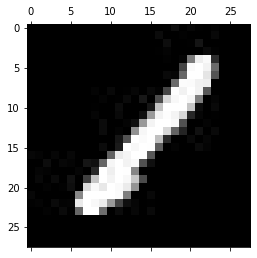

-------------------------------------------
Test: 1151
Predicted: 7


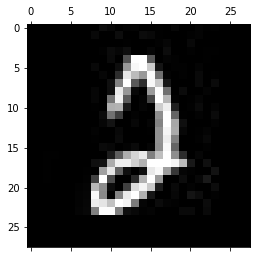

-------------------------------------------
Test: 1152
Predicted: 7


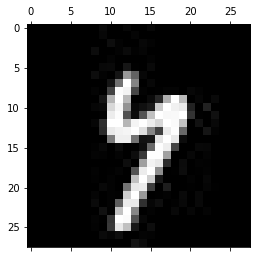

-------------------------------------------
Test: 1153
Predicted: 7


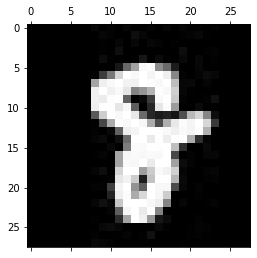

-------------------------------------------
Test: 1154
Predicted: 2


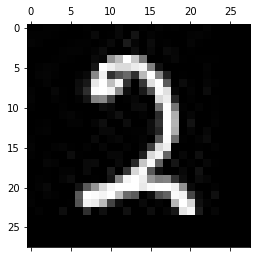

-------------------------------------------
Test: 1155
Predicted: 3


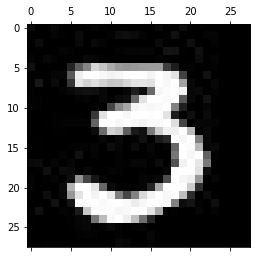

-------------------------------------------
Test: 1156
Predicted: 4


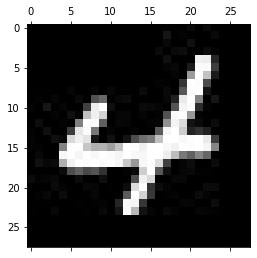

-------------------------------------------
Test: 1157
Predicted: 6


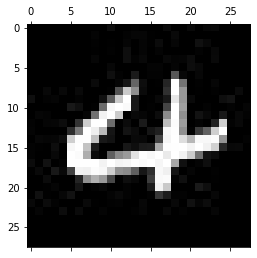

-------------------------------------------
Test: 1158
Predicted: 0


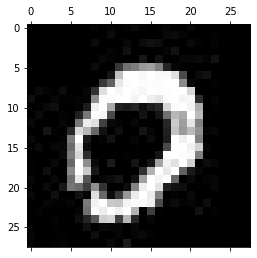

-------------------------------------------
Test: 1159
Predicted: 4


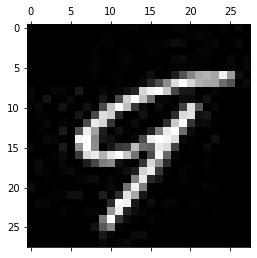

-------------------------------------------
Test: 1160
Predicted: 1


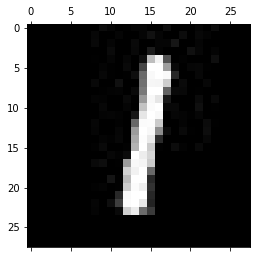

-------------------------------------------
Test: 1161
Predicted: 0


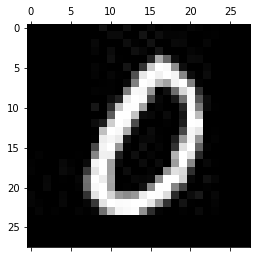

-------------------------------------------
Test: 1162
Predicted: 5


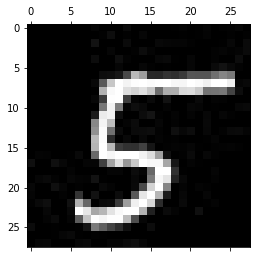

-------------------------------------------
Test: 1163
Predicted: 0


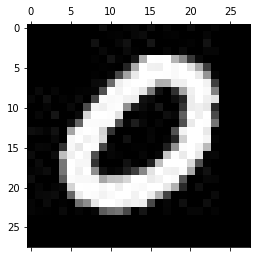

-------------------------------------------
Test: 1164
Predicted: 6


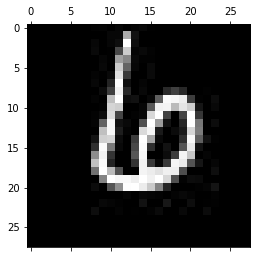

-------------------------------------------
Test: 1165
Predicted: 1


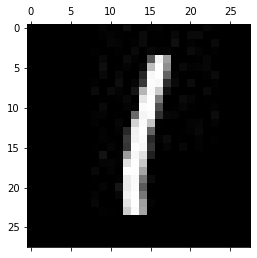

-------------------------------------------
Test: 1166
Predicted: 1


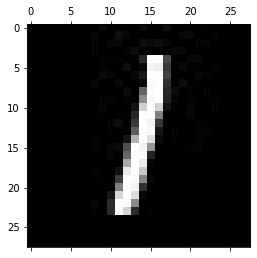

-------------------------------------------
Test: 1167
Predicted: 5


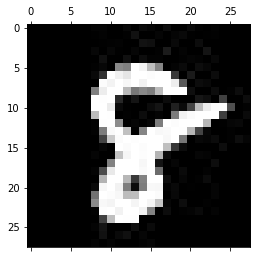

-------------------------------------------
Test: 1168
Predicted: 0


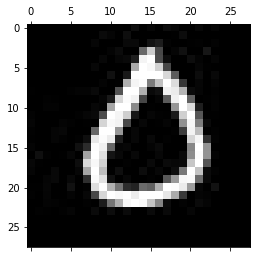

-------------------------------------------
Test: 1169
Predicted: 6


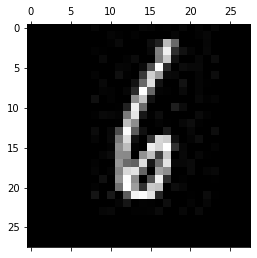

-------------------------------------------
Test: 1170
Predicted: 7


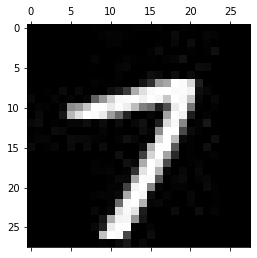

-------------------------------------------
Test: 1171
Predicted: 5


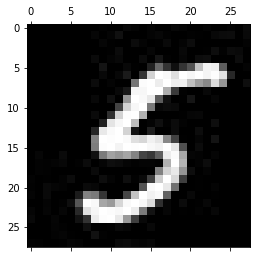

-------------------------------------------
Test: 1172
Predicted: 0


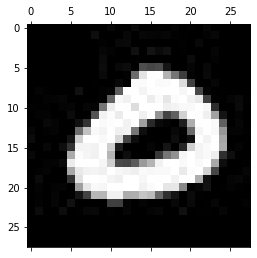

-------------------------------------------
Test: 1173
Predicted: 6


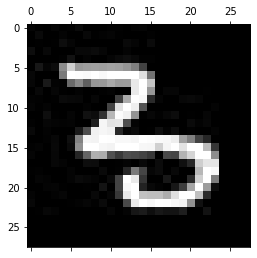

-------------------------------------------
Test: 1174
Predicted: 9


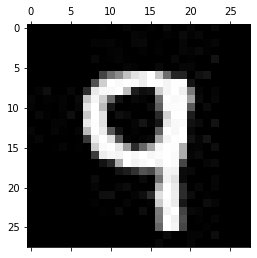

-------------------------------------------
Test: 1175
Predicted: 0


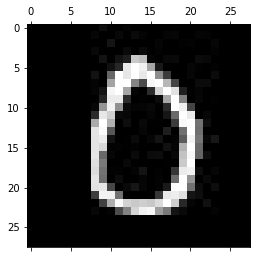

-------------------------------------------
Test: 1176
Predicted: 7


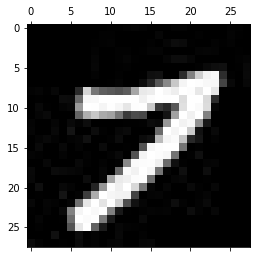

-------------------------------------------
Test: 1177
Predicted: 2


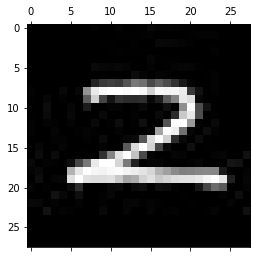

-------------------------------------------
Test: 1178
Predicted: 4


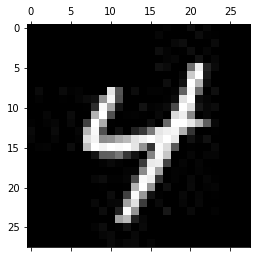

-------------------------------------------
Test: 1179
Predicted: 6


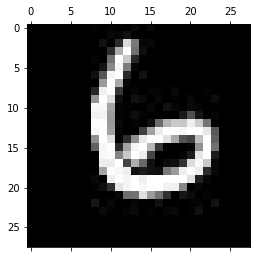

-------------------------------------------
Test: 1180
Predicted: 0


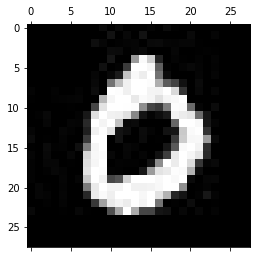

-------------------------------------------
Test: 1181
Predicted: 7


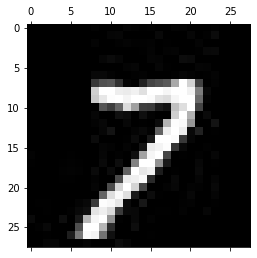

-------------------------------------------
Test: 1182
Predicted: 4


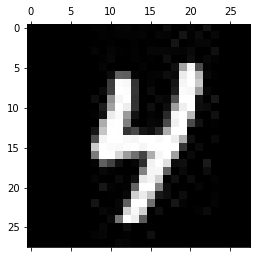

-------------------------------------------
Test: 1183
Predicted: 7


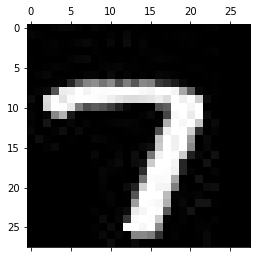

-------------------------------------------
Test: 1184
Predicted: 7


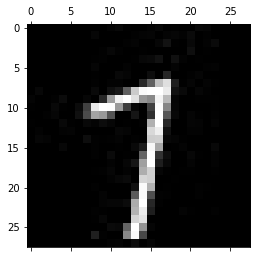

-------------------------------------------
Test: 1185
Predicted: 7


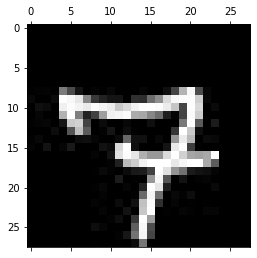

-------------------------------------------
Test: 1186
Predicted: 3


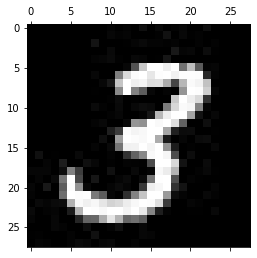

-------------------------------------------
Test: 1187
Predicted: 6


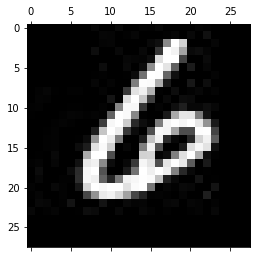

-------------------------------------------
Test: 1188
Predicted: 7


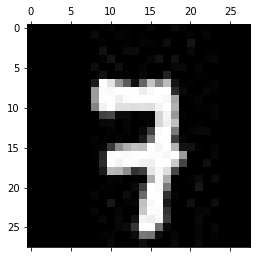

-------------------------------------------
Test: 1189
Predicted: 5


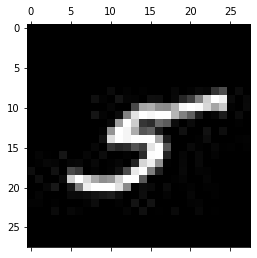

-------------------------------------------
Test: 1190
Predicted: 4


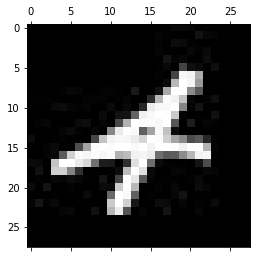

-------------------------------------------
Test: 1191
Predicted: 5


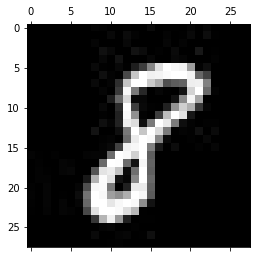

-------------------------------------------
Test: 1192
Predicted: 9


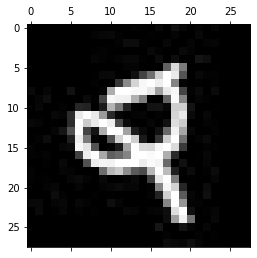

-------------------------------------------
Test: 1193
Predicted: 7


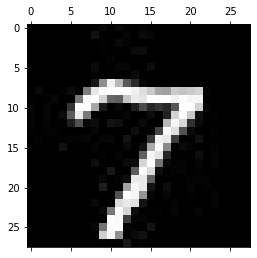

-------------------------------------------
Test: 1194
Predicted: 9


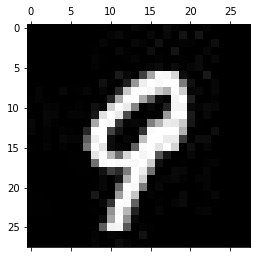

-------------------------------------------
Test: 1195
Predicted: 6


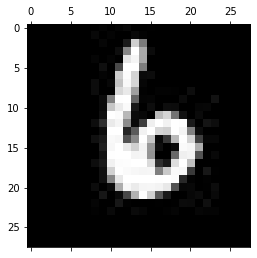

-------------------------------------------
Test: 1196
Predicted: 5


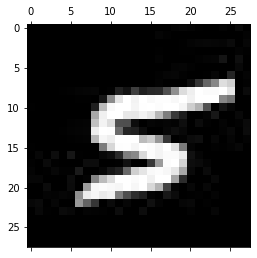

-------------------------------------------
Test: 1197
Predicted: 5


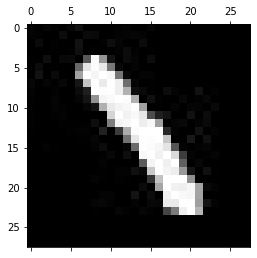

-------------------------------------------
Test: 1198
Predicted: 1


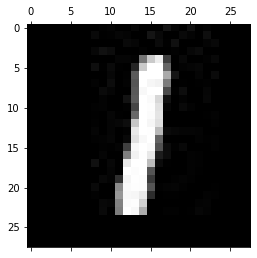

-------------------------------------------
Test: 1199
Predicted: 2


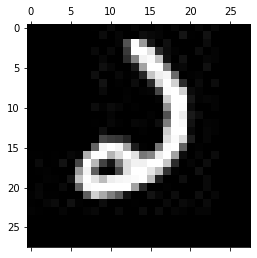

-------------------------------------------
Test: 1200
Predicted: 2


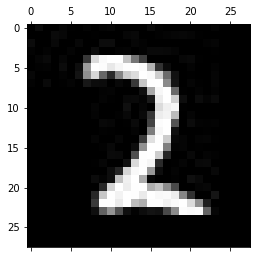

-------------------------------------------
Test: 1201
Predicted: 5


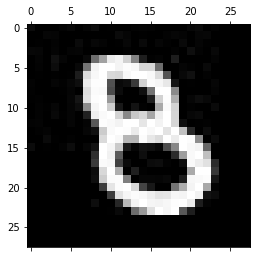

-------------------------------------------
Test: 1202
Predicted: 5


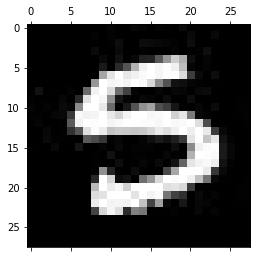

-------------------------------------------
Test: 1203
Predicted: 6


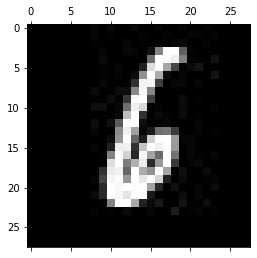

-------------------------------------------
Test: 1204
Predicted: 4


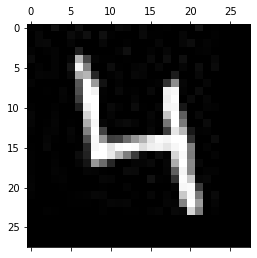

-------------------------------------------
Test: 1205
Predicted: 4


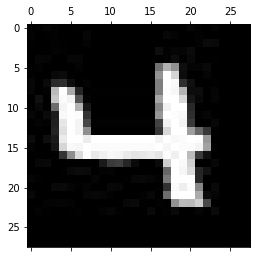

-------------------------------------------
Test: 1206
Predicted: 6


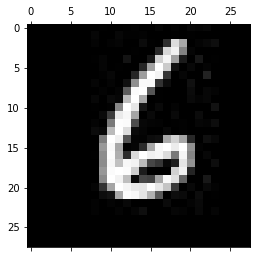

-------------------------------------------
Test: 1207
Predicted: 5


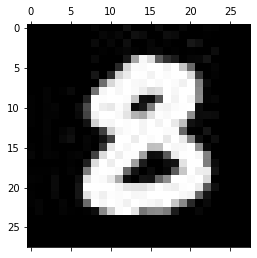

-------------------------------------------
Test: 1208
Predicted: 6


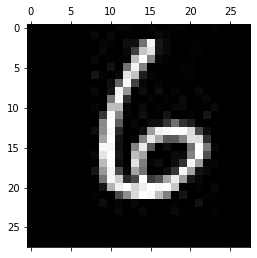

-------------------------------------------
Test: 1209
Predicted: 1


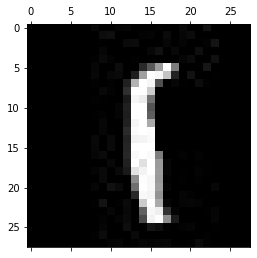

-------------------------------------------
Test: 1210
Predicted: 5


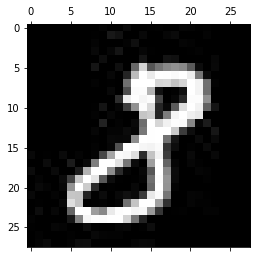

-------------------------------------------
Test: 1211
Predicted: 3


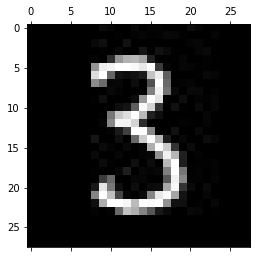

-------------------------------------------
Test: 1212
Predicted: 7


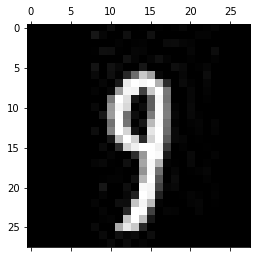

-------------------------------------------
Test: 1213
Predicted: 5


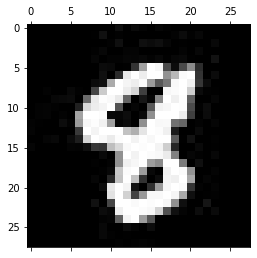

-------------------------------------------
Test: 1214
Predicted: 5


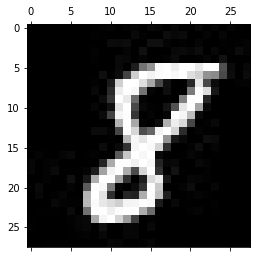

-------------------------------------------
Test: 1215
Predicted: 1


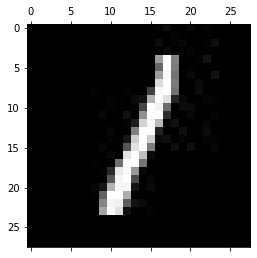

-------------------------------------------
Test: 1216
Predicted: 5


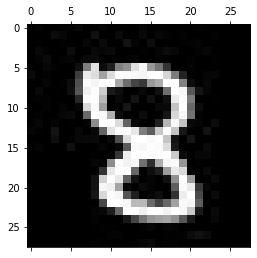

-------------------------------------------
Test: 1217
Predicted: 4


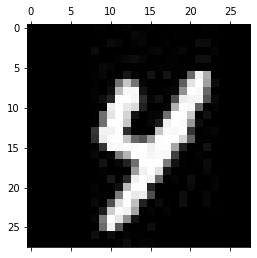

-------------------------------------------
Test: 1218
Predicted: 4


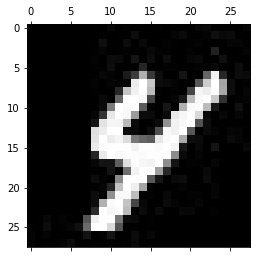

-------------------------------------------
Test: 1219
Predicted: 6


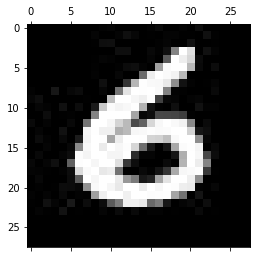

-------------------------------------------
Test: 1220
Predicted: 1


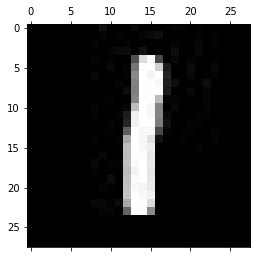

-------------------------------------------
Test: 1221
Predicted: 2


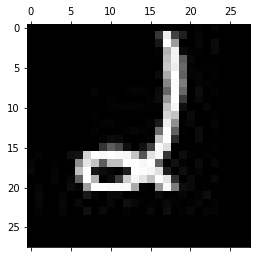

-------------------------------------------
Test: 1222
Predicted: 3


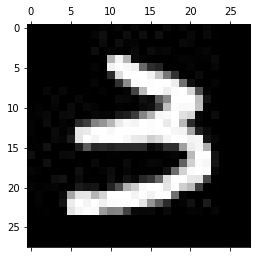

-------------------------------------------
Test: 1223
Predicted: 5


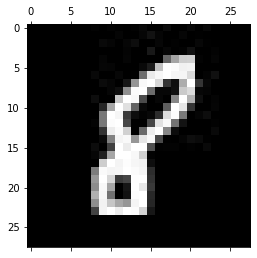

-------------------------------------------
Test: 1224
Predicted: 1


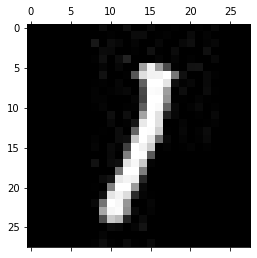

-------------------------------------------
Test: 1225
Predicted: 5


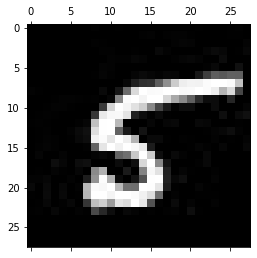

-------------------------------------------
Test: 1226
Predicted: 1


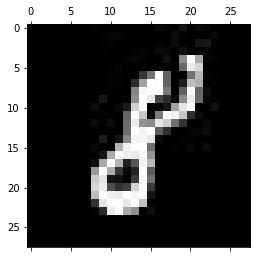

-------------------------------------------
Test: 1227
Predicted: 4


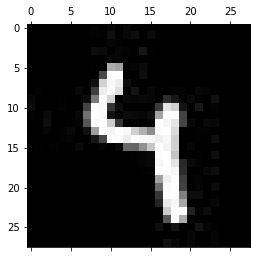

-------------------------------------------
Test: 1228
Predicted: 3


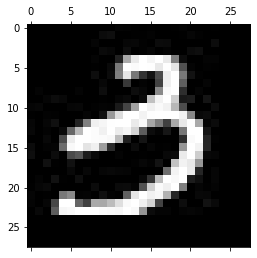

-------------------------------------------
Test: 1229
Predicted: 1


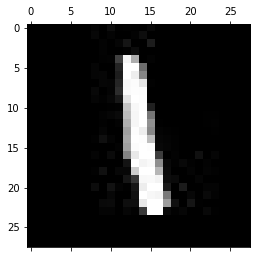

-------------------------------------------
Test: 1230
Predicted: 0


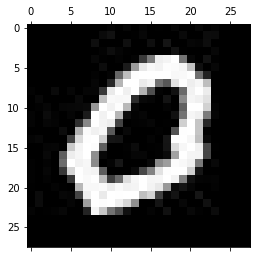

-------------------------------------------
Test: 1231
Predicted: 1


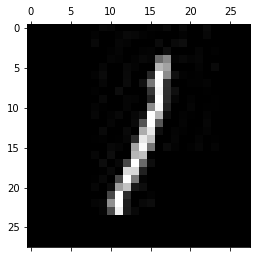

-------------------------------------------
Test: 1232
Predicted: 9


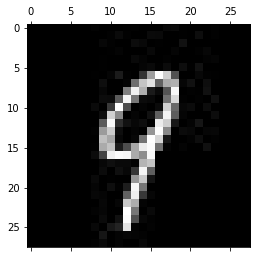

-------------------------------------------
Test: 1233
Predicted: 2


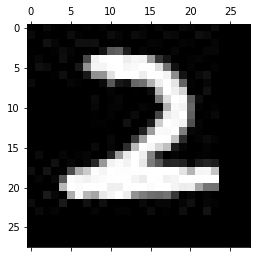

-------------------------------------------
Test: 1234
Predicted: 6


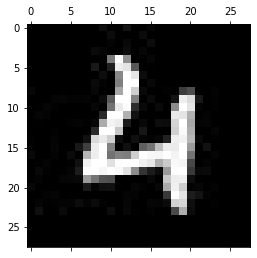

-------------------------------------------
Test: 1235
Predicted: 5


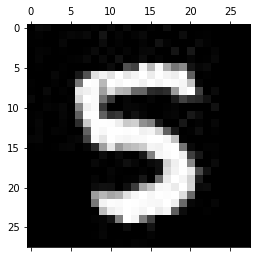

-------------------------------------------
Test: 1236
Predicted: 3


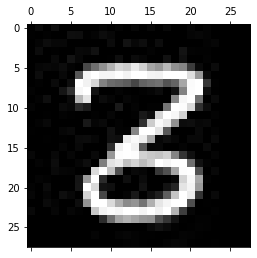

-------------------------------------------
Test: 1237
Predicted: 1


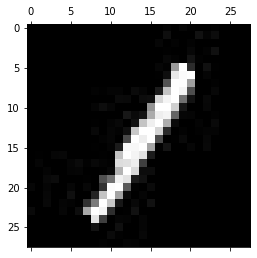

-------------------------------------------
Test: 1238
Predicted: 6


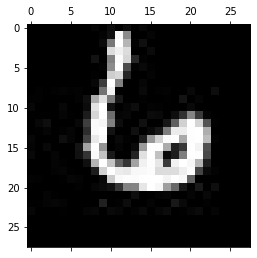

-------------------------------------------
Test: 1239
Predicted: 6


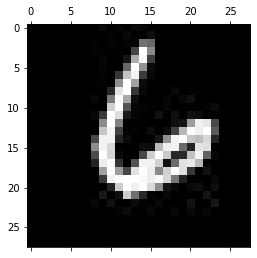

-------------------------------------------
Test: 1240
Predicted: 9


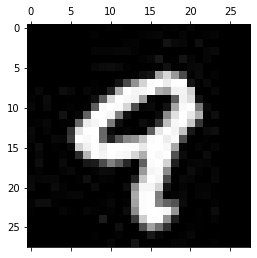

-------------------------------------------
Test: 1241
Predicted: 4


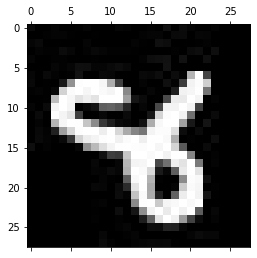

-------------------------------------------
Test: 1242
Predicted: 6


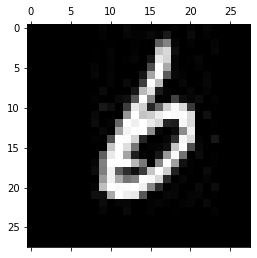

-------------------------------------------
Test: 1243
Predicted: 6


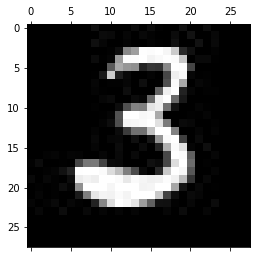

-------------------------------------------
Test: 1244
Predicted: 0


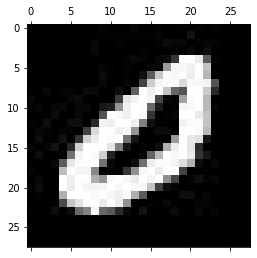

-------------------------------------------
Test: 1245
Predicted: 5


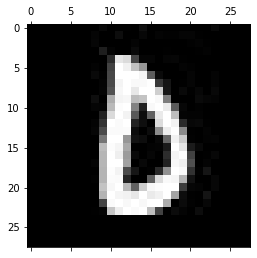

-------------------------------------------
Test: 1246
Predicted: 4


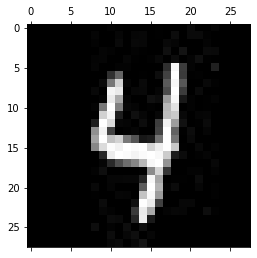

-------------------------------------------
Test: 1247
Predicted: 1


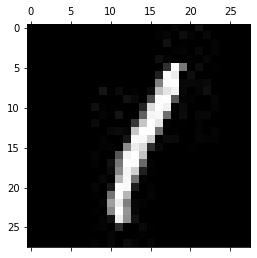

-------------------------------------------
Test: 1248
Predicted: 0


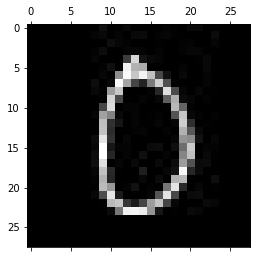

-------------------------------------------
Test: 1249
Predicted: 4


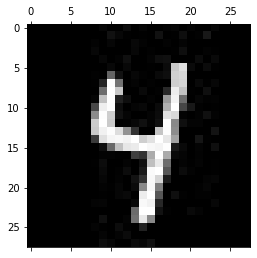

-------------------------------------------
Test: 1250
Predicted: 6


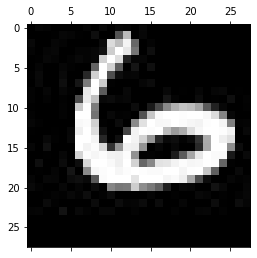

-------------------------------------------
Test: 1251
Predicted: 5


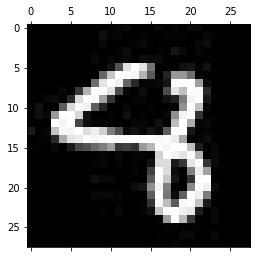

-------------------------------------------
Test: 1252
Predicted: 3


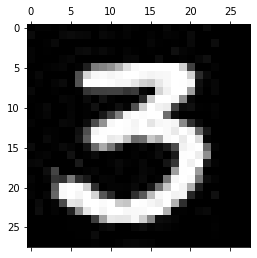

-------------------------------------------
Test: 1253
Predicted: 7


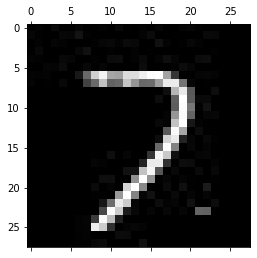

-------------------------------------------
Test: 1254
Predicted: 1


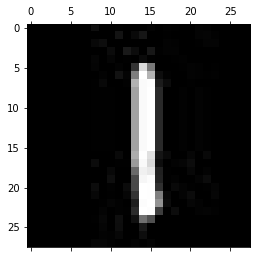

-------------------------------------------
Test: 1255
Predicted: 7


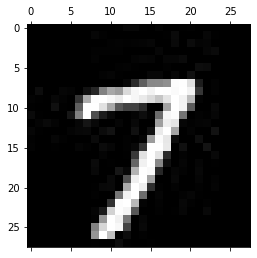

-------------------------------------------
Test: 1256
Predicted: 6


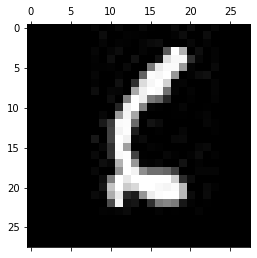

-------------------------------------------
Test: 1257
Predicted: 2


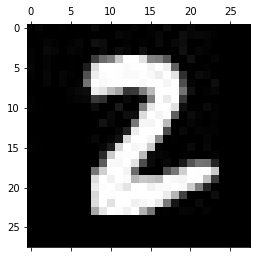

-------------------------------------------
Test: 1258
Predicted: 5


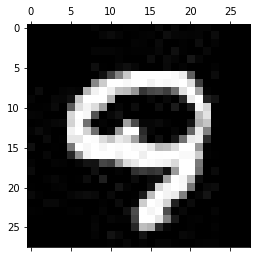

-------------------------------------------
Test: 1259
Predicted: 5


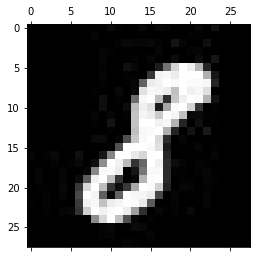

-------------------------------------------
Test: 1260
Predicted: 4


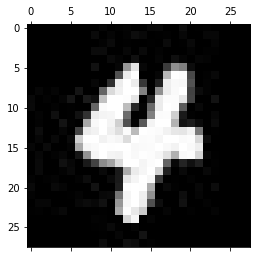

-------------------------------------------
Test: 1261
Predicted: 9


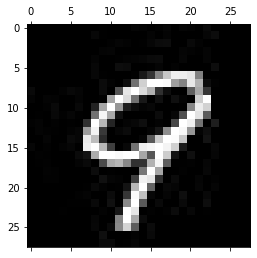

-------------------------------------------
Test: 1262
Predicted: 1


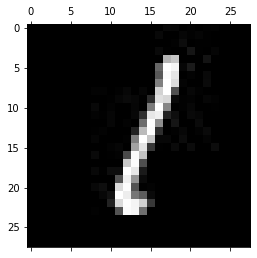

-------------------------------------------
Test: 1263
Predicted: 4


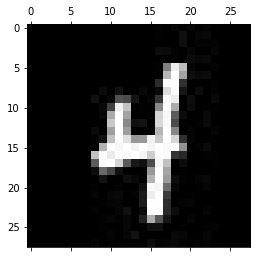

-------------------------------------------
Test: 1264
Predicted: 5


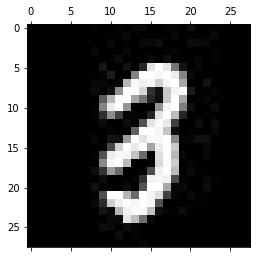

-------------------------------------------
Test: 1265
Predicted: 0


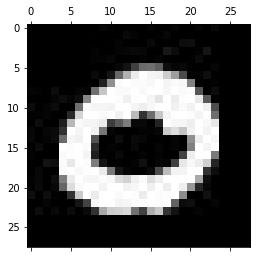

-------------------------------------------
Test: 1266
Predicted: 7


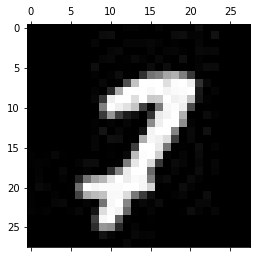

-------------------------------------------
Test: 1267
Predicted: 9


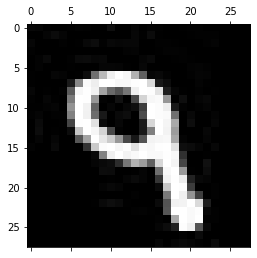

-------------------------------------------
Test: 1268
Predicted: 7


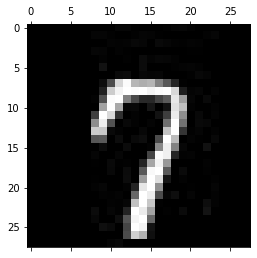

-------------------------------------------
Test: 1269
Predicted: 0


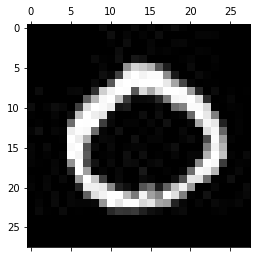

-------------------------------------------
Test: 1270
Predicted: 4


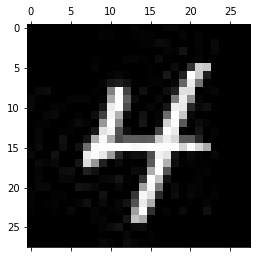

-------------------------------------------
Test: 1271
Predicted: 3


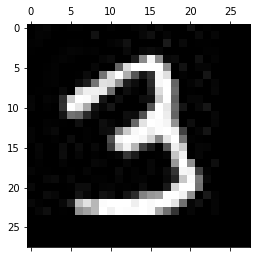

-------------------------------------------
Test: 1272
Predicted: 7


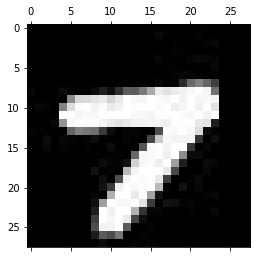

-------------------------------------------
Test: 1273
Predicted: 2


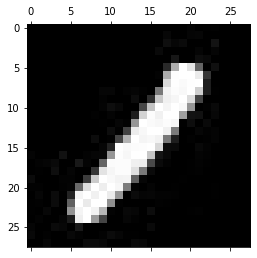

-------------------------------------------
Test: 1274
Predicted: 7


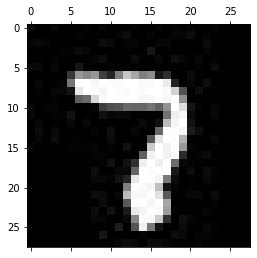

-------------------------------------------
Test: 1275
Predicted: 5


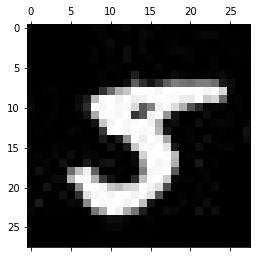

-------------------------------------------
Test: 1276
Predicted: 2


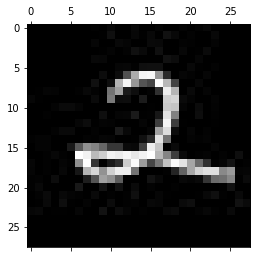

-------------------------------------------
Test: 1277
Predicted: 5


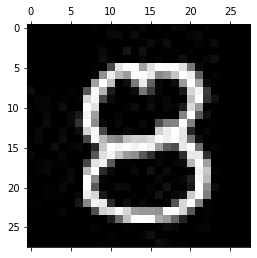

-------------------------------------------
Test: 1278
Predicted: 5


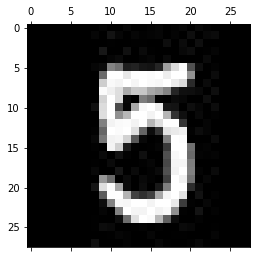

-------------------------------------------
Test: 1279
Predicted: 7


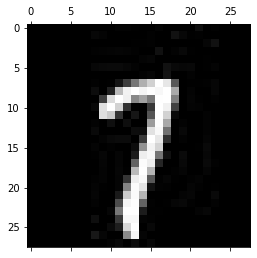

-------------------------------------------
Test: 1280
Predicted: 3


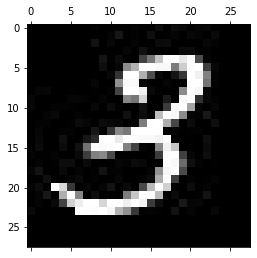

-------------------------------------------
Test: 1281
Predicted: 2


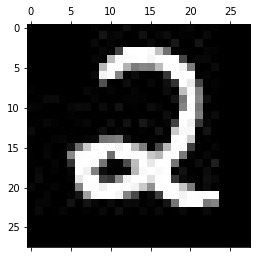

-------------------------------------------
Test: 1282
Predicted: 6


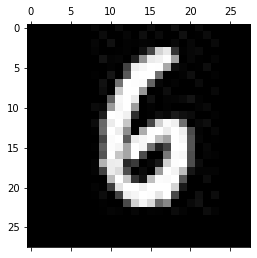

-------------------------------------------
Test: 1283
Predicted: 6


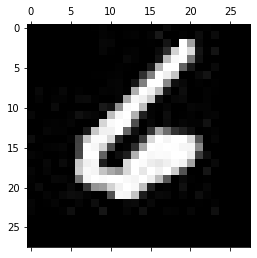

-------------------------------------------
Test: 1284
Predicted: 2


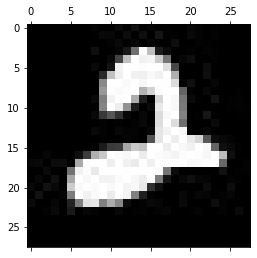

-------------------------------------------
Test: 1285
Predicted: 6


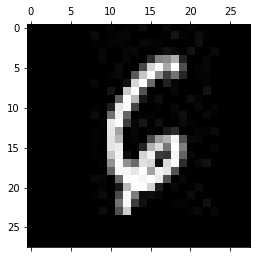

-------------------------------------------
Test: 1286
Predicted: 6


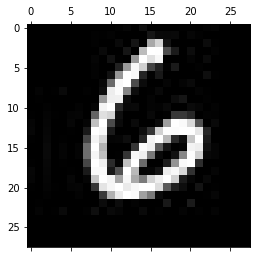

-------------------------------------------
Test: 1287
Predicted: 4


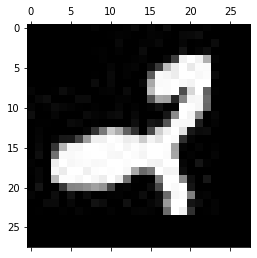

-------------------------------------------
Test: 1288
Predicted: 8


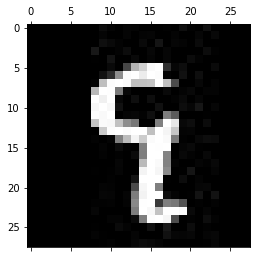

-------------------------------------------
Test: 1289
Predicted: 5


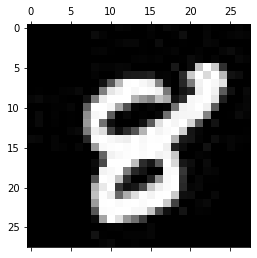

-------------------------------------------
Test: 1290
Predicted: 1


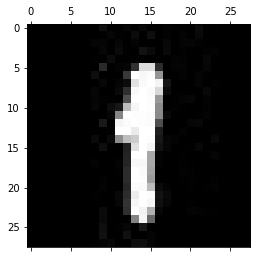

-------------------------------------------
Test: 1291
Predicted: 4


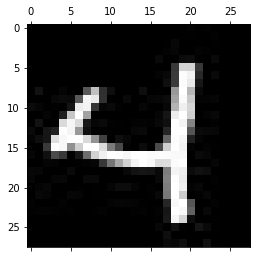

-------------------------------------------
Test: 1292
Predicted: 1


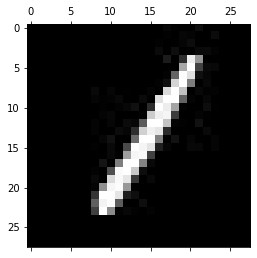

-------------------------------------------
Test: 1293
Predicted: 2


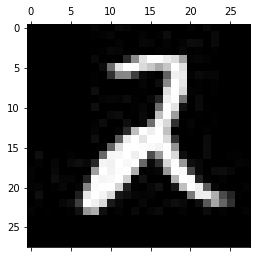

-------------------------------------------
Test: 1294
Predicted: 1


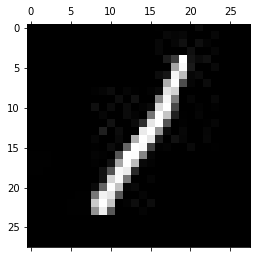

-------------------------------------------
Test: 1295
Predicted: 7


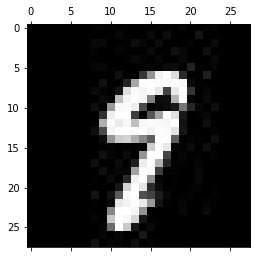

-------------------------------------------
Test: 1296
Predicted: 4


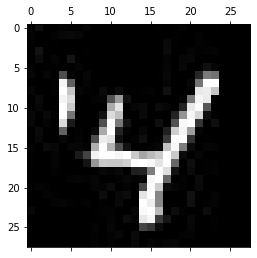

-------------------------------------------
Test: 1297
Predicted: 5


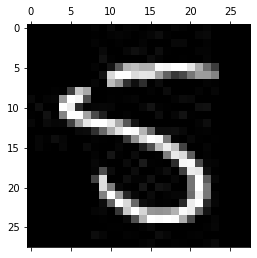

-------------------------------------------
Test: 1298
Predicted: 3


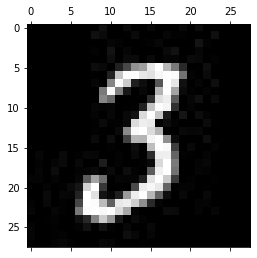

-------------------------------------------
Test: 1299
Predicted: 6


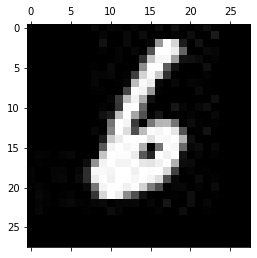

-------------------------------------------
Test: 1300
Predicted: 4


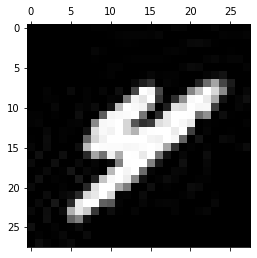

-------------------------------------------
Test: 1301
Predicted: 6


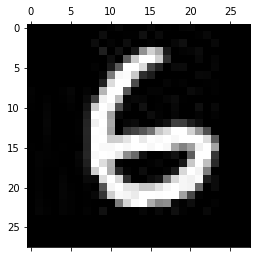

-------------------------------------------
Test: 1302
Predicted: 5


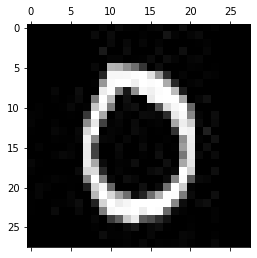

-------------------------------------------
Test: 1303
Predicted: 6


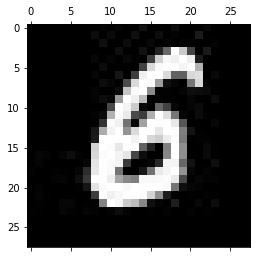

-------------------------------------------
Test: 1304
Predicted: 6


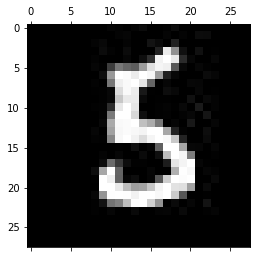

-------------------------------------------
Test: 1305
Predicted: 0


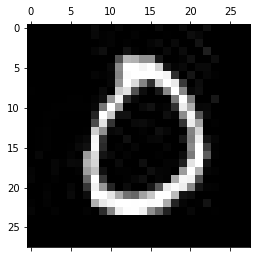

-------------------------------------------
Test: 1306
Predicted: 1


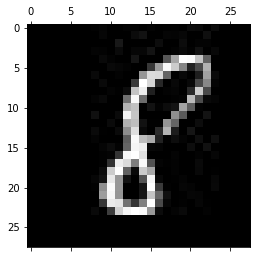

-------------------------------------------
Test: 1307
Predicted: 5


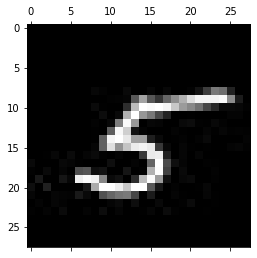

-------------------------------------------
Test: 1308
Predicted: 6


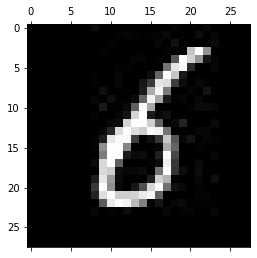

-------------------------------------------
Test: 1309
Predicted: 3


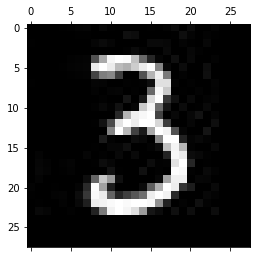

-------------------------------------------
Test: 1310
Predicted: 1


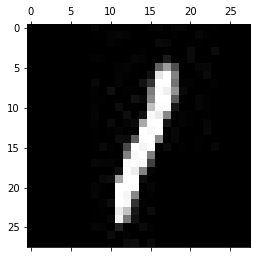

-------------------------------------------
Test: 1311
Predicted: 5


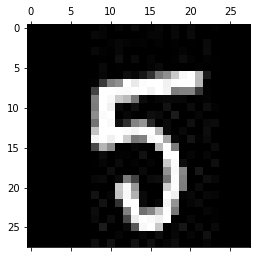

-------------------------------------------
Test: 1312
Predicted: 4


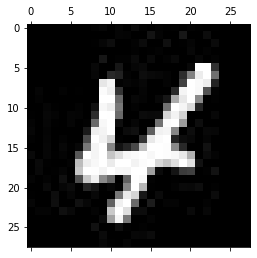

-------------------------------------------
Test: 1313
Predicted: 7


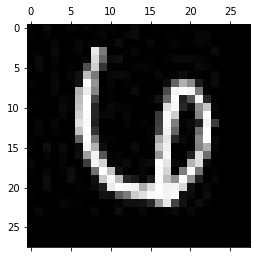

-------------------------------------------
Test: 1314
Predicted: 9


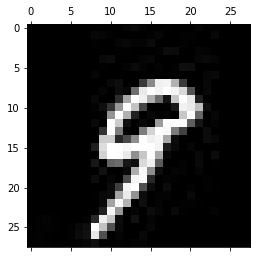

-------------------------------------------
Test: 1315
Predicted: 2


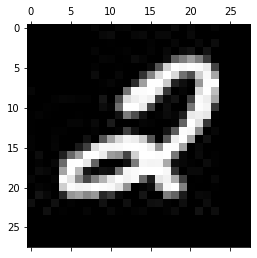

-------------------------------------------
Test: 1316
Predicted: 6


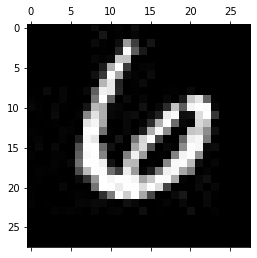

-------------------------------------------
Test: 1317
Predicted: 5


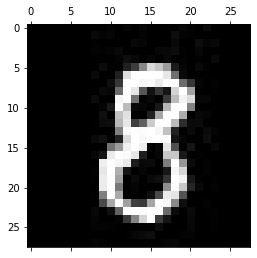

-------------------------------------------
Test: 1318
Predicted: 4


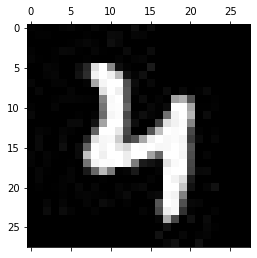

-------------------------------------------
Test: 1319
Predicted: 3


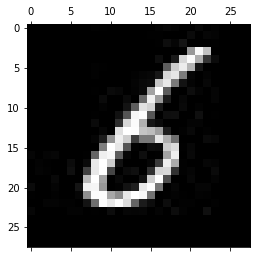

-------------------------------------------
Test: 1320
Predicted: 1


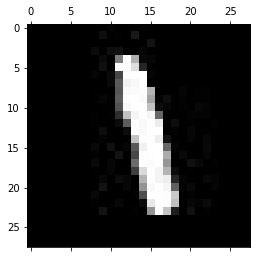

-------------------------------------------
Test: 1321
Predicted: 9


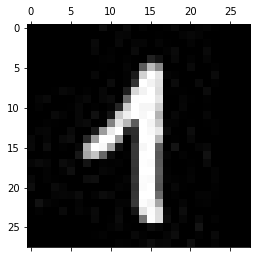

-------------------------------------------
Test: 1322
Predicted: 1


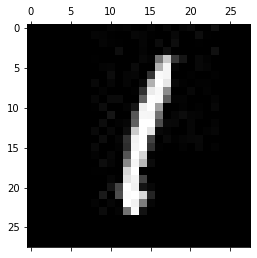

-------------------------------------------
Test: 1323
Predicted: 7


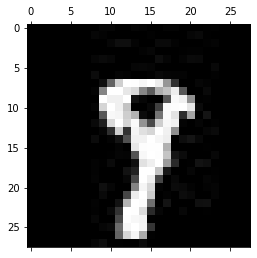

-------------------------------------------
Test: 1324
Predicted: 0


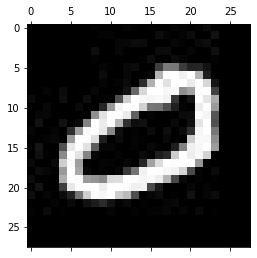

-------------------------------------------
Test: 1325
Predicted: 9


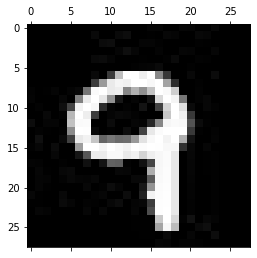

-------------------------------------------
Test: 1326
Predicted: 1


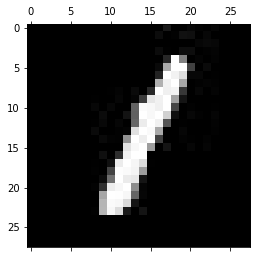

-------------------------------------------
Test: 1327
Predicted: 0


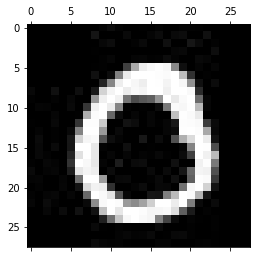

-------------------------------------------
Test: 1328
Predicted: 6


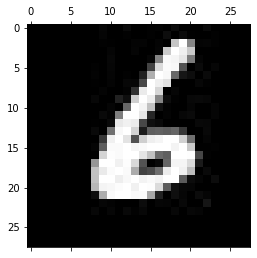

-------------------------------------------
Test: 1329
Predicted: 5


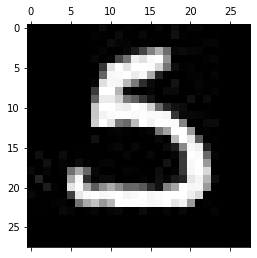

-------------------------------------------
Test: 1330
Predicted: 4


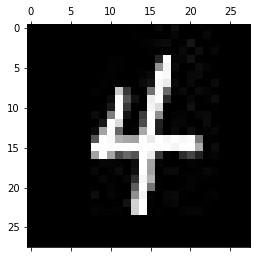

-------------------------------------------
Test: 1331
Predicted: 2


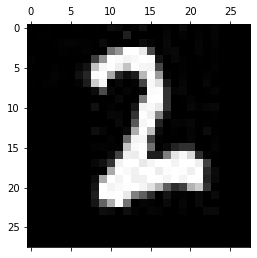

-------------------------------------------
Test: 1332
Predicted: 3


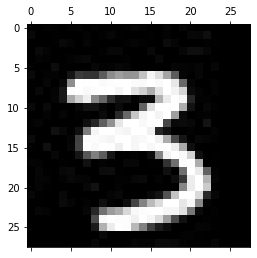

-------------------------------------------
Test: 1333
Predicted: 3


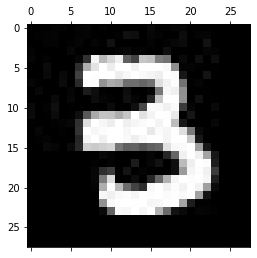

-------------------------------------------
Test: 1334
Predicted: 7


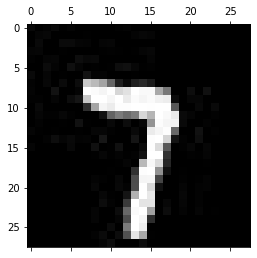

-------------------------------------------
Test: 1335
Predicted: 4


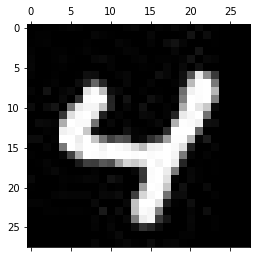

-------------------------------------------
Test: 1336
Predicted: 3


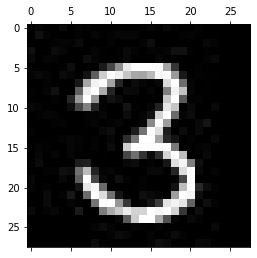

-------------------------------------------
Test: 1337
Predicted: 1


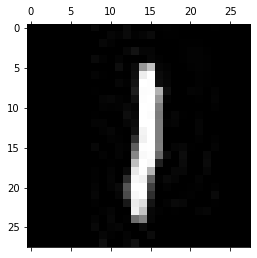

-------------------------------------------
Test: 1338
Predicted: 6


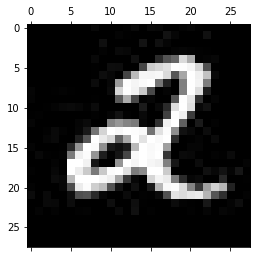

-------------------------------------------
Test: 1339
Predicted: 5


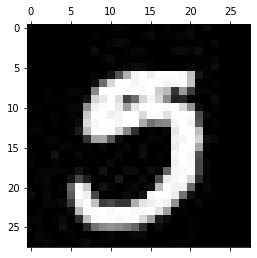

-------------------------------------------
Test: 1340
Predicted: 2


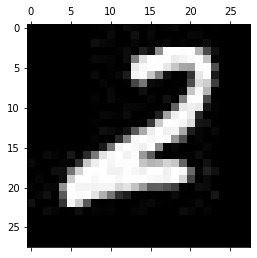

-------------------------------------------
Test: 1341
Predicted: 4


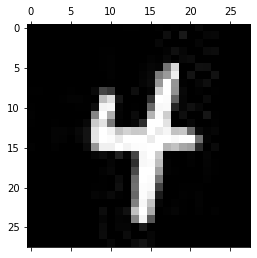

-------------------------------------------
Test: 1342
Predicted: 9


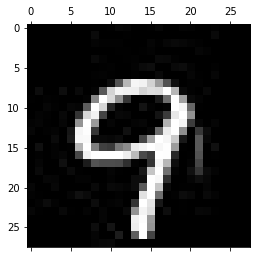

-------------------------------------------
Test: 1343
Predicted: 5


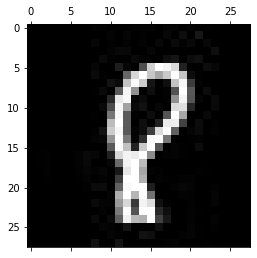

-------------------------------------------
Test: 1344
Predicted: 1


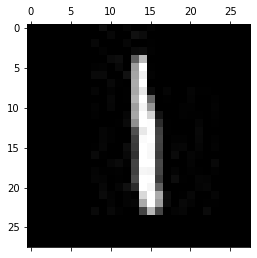

-------------------------------------------
Test: 1345
Predicted: 1


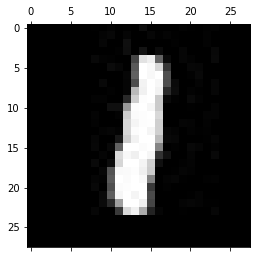

-------------------------------------------
Test: 1346
Predicted: 9


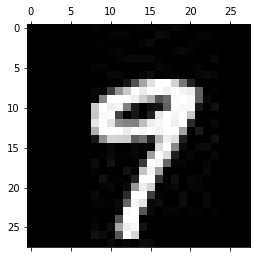

-------------------------------------------
Test: 1347
Predicted: 2


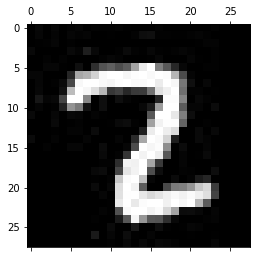

-------------------------------------------
Test: 1348
Predicted: 5


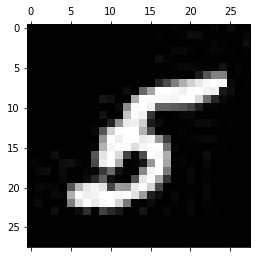

-------------------------------------------
Test: 1349
Predicted: 5


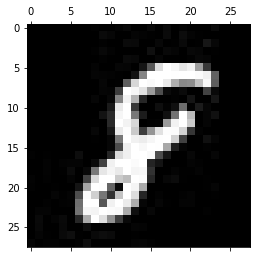

-------------------------------------------
Test: 1350
Predicted: 4


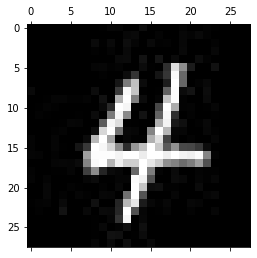

-------------------------------------------
Test: 1351
Predicted: 4


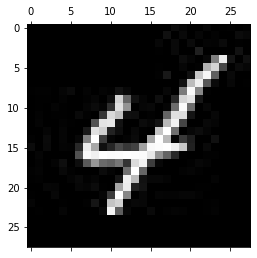

-------------------------------------------
Test: 1352
Predicted: 7


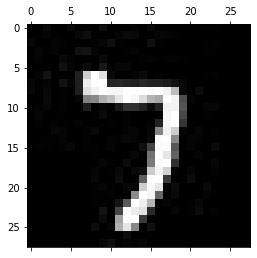

-------------------------------------------
Test: 1353
Predicted: 5


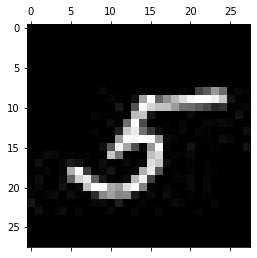

-------------------------------------------
Test: 1354
Predicted: 5


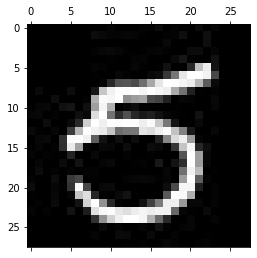

-------------------------------------------
Test: 1355
Predicted: 5


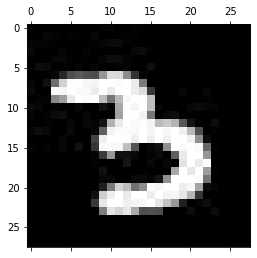

-------------------------------------------
Test: 1356
Predicted: 0


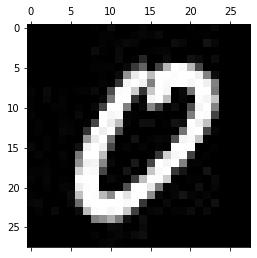

-------------------------------------------
Test: 1357
Predicted: 1


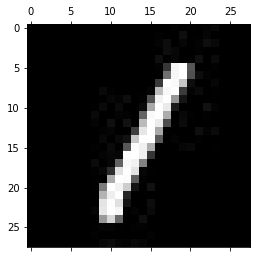

-------------------------------------------
Test: 1358
Predicted: 3


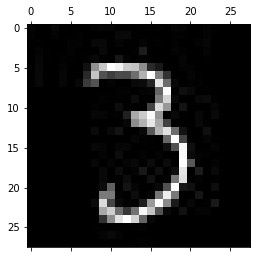

-------------------------------------------
Test: 1359
Predicted: 5


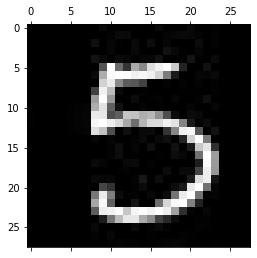

-------------------------------------------
Test: 1360
Predicted: 1


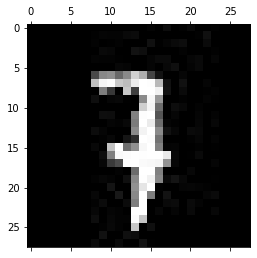

-------------------------------------------
Test: 1361
Predicted: 1


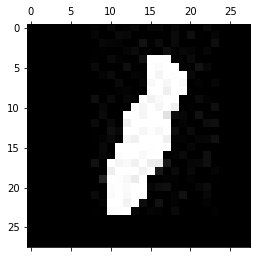

-------------------------------------------
Test: 1362
Predicted: 7


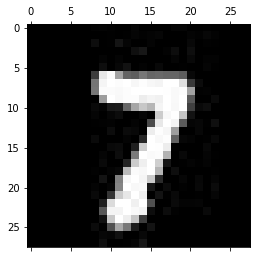

-------------------------------------------
Test: 1363
Predicted: 2


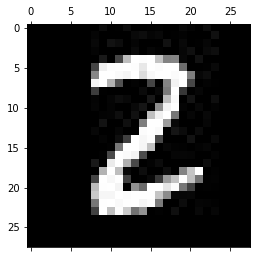

-------------------------------------------
Test: 1364
Predicted: 2


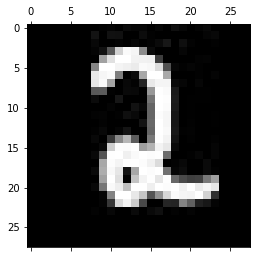

-------------------------------------------
Test: 1365
Predicted: 5


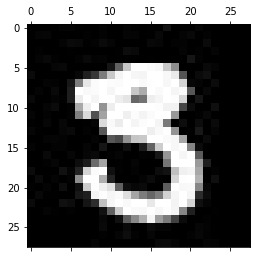

-------------------------------------------
Test: 1366
Predicted: 7


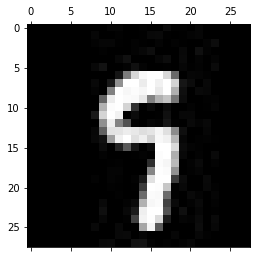

-------------------------------------------
Test: 1367
Predicted: 0


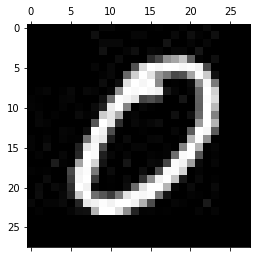

-------------------------------------------
Test: 1368
Predicted: 1


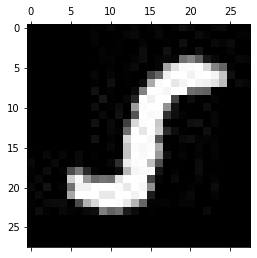

-------------------------------------------
Test: 1369
Predicted: 4


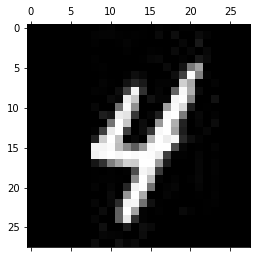

-------------------------------------------
Test: 1370
Predicted: 0


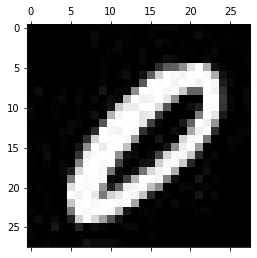

-------------------------------------------
Test: 1371
Predicted: 1


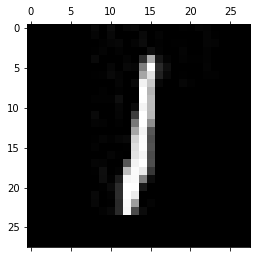

-------------------------------------------
Test: 1372
Predicted: 3


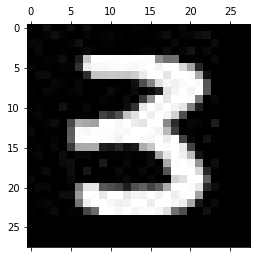

-------------------------------------------
Test: 1373
Predicted: 0


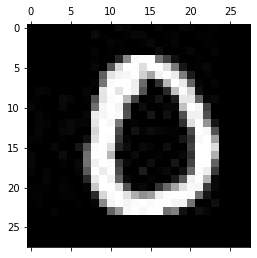

-------------------------------------------
Test: 1374
Predicted: 3


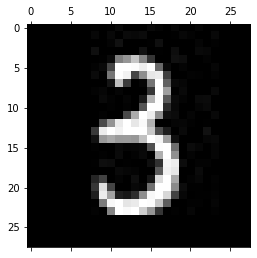

-------------------------------------------
Test: 1375
Predicted: 2


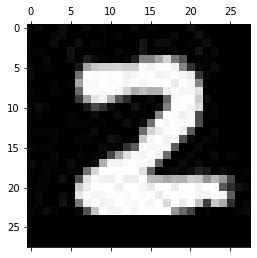

-------------------------------------------
Test: 1376
Predicted: 9


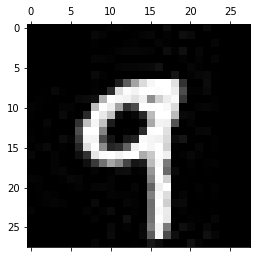

-------------------------------------------
Test: 1377
Predicted: 1


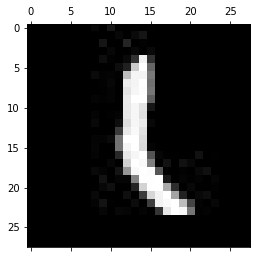

-------------------------------------------
Test: 1378
Predicted: 5


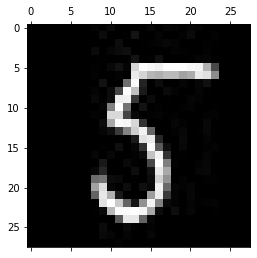

-------------------------------------------
Test: 1379
Predicted: 3


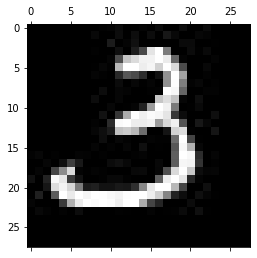

-------------------------------------------
Test: 1380
Predicted: 6


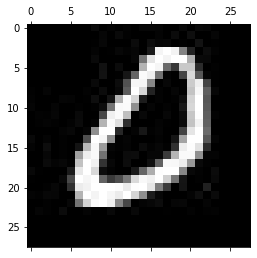

-------------------------------------------
Test: 1381
Predicted: 2


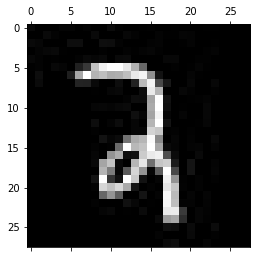

-------------------------------------------
Test: 1382
Predicted: 5


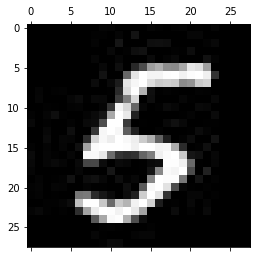

-------------------------------------------
Test: 1383
Predicted: 5


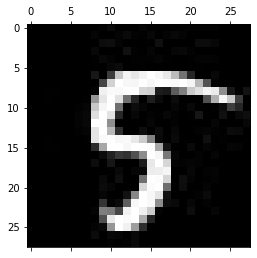

-------------------------------------------
Test: 1384
Predicted: 6


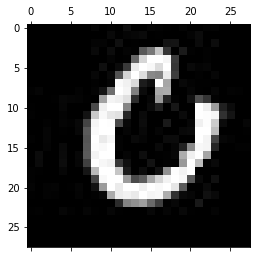

-------------------------------------------
Test: 1385
Predicted: 5


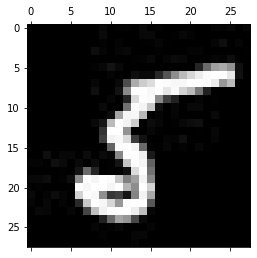

-------------------------------------------
Test: 1386
Predicted: 1


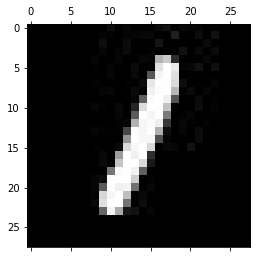

-------------------------------------------
Test: 1387
Predicted: 1


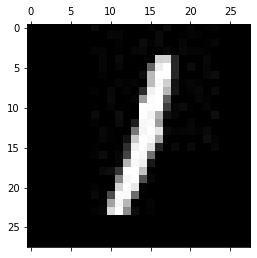

-------------------------------------------
Test: 1388
Predicted: 3


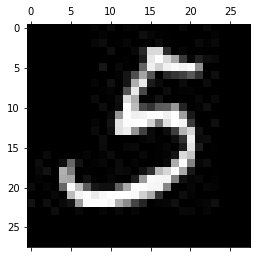

-------------------------------------------
Test: 1389
Predicted: 1


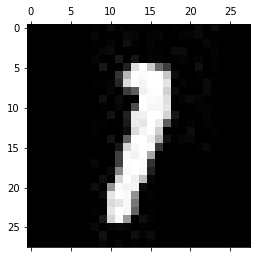

-------------------------------------------
Test: 1390
Predicted: 3


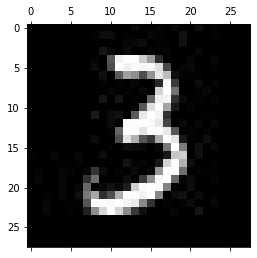

-------------------------------------------
Test: 1391
Predicted: 4


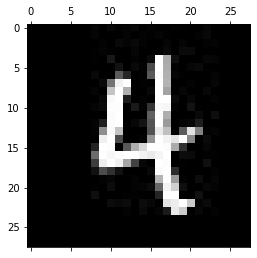

-------------------------------------------
Test: 1392
Predicted: 7


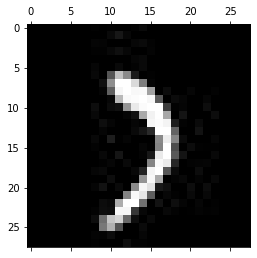

-------------------------------------------
Test: 1393
Predicted: 0


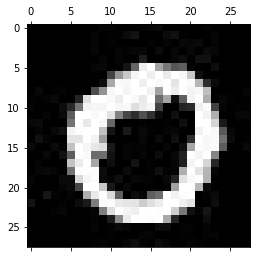

-------------------------------------------
Test: 1394
Predicted: 6


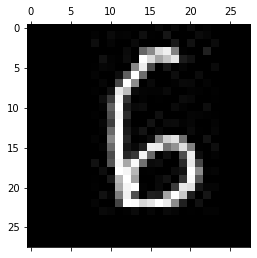

-------------------------------------------
Test: 1395
Predicted: 6


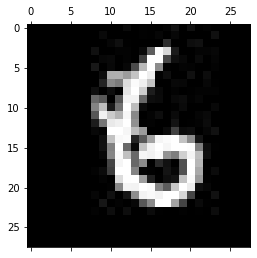

-------------------------------------------
Test: 1396
Predicted: 6


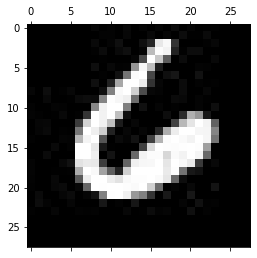

-------------------------------------------
Test: 1397
Predicted: 0


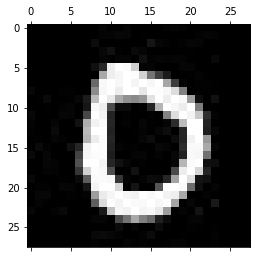

-------------------------------------------
Test: 1398
Predicted: 6


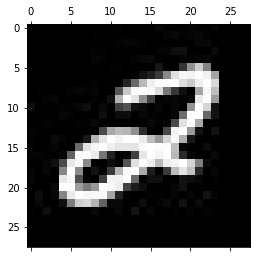

-------------------------------------------
Test: 1399
Predicted: 6


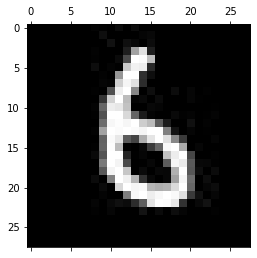

-------------------------------------------
Test: 1400
Predicted: 1


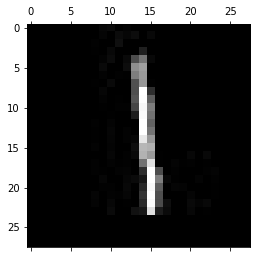

-------------------------------------------
Test: 1401
Predicted: 0


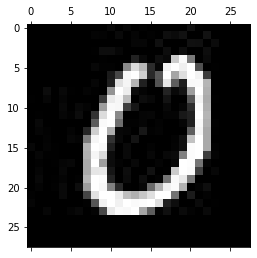

-------------------------------------------
Test: 1402
Predicted: 6


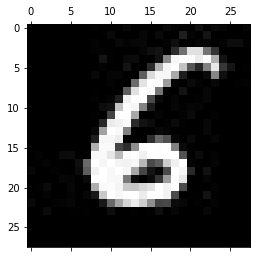

-------------------------------------------
Test: 1403
Predicted: 1


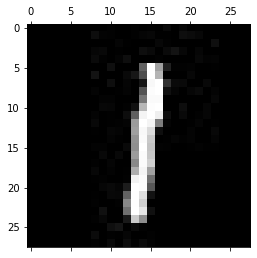

-------------------------------------------
Test: 1404
Predicted: 1


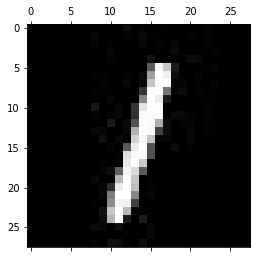

-------------------------------------------
Test: 1405
Predicted: 6


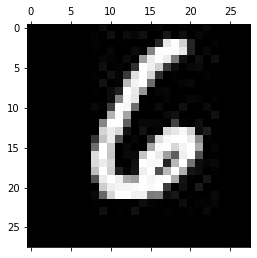

-------------------------------------------
Test: 1406
Predicted: 5


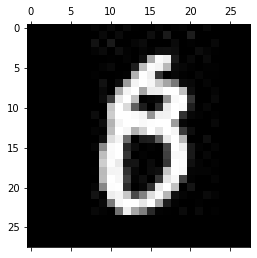

-------------------------------------------
Test: 1407
Predicted: 6


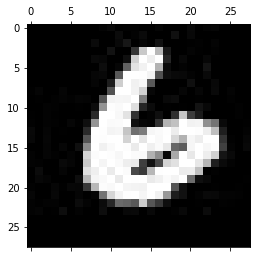

-------------------------------------------
Test: 1408
Predicted: 2


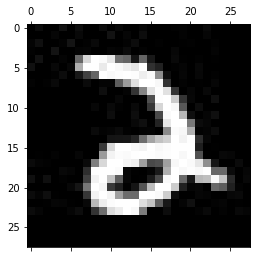

-------------------------------------------
Test: 1409
Predicted: 1


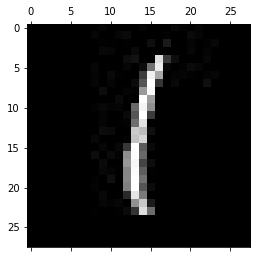

-------------------------------------------
Test: 1410
Predicted: 4


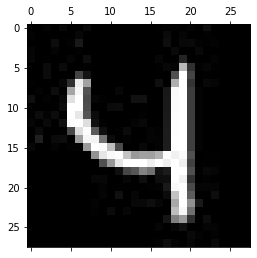

-------------------------------------------
Test: 1411
Predicted: 7


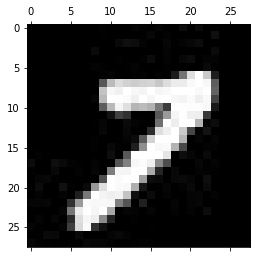

-------------------------------------------
Test: 1412
Predicted: 6


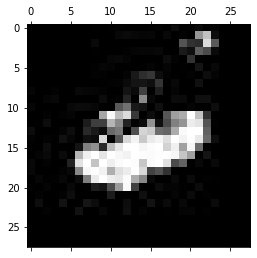

-------------------------------------------
Test: 1413
Predicted: 5


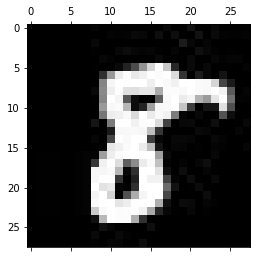

-------------------------------------------
Test: 1414
Predicted: 7


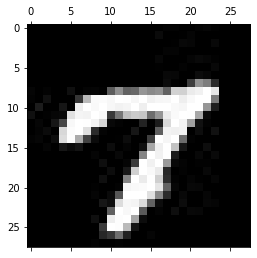

-------------------------------------------
Test: 1415
Predicted: 3


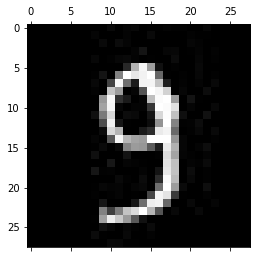

-------------------------------------------
Test: 1416
Predicted: 1


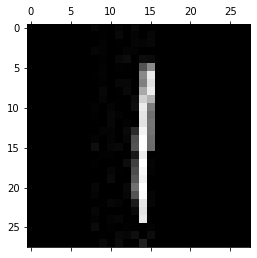

-------------------------------------------
Test: 1417
Predicted: 2


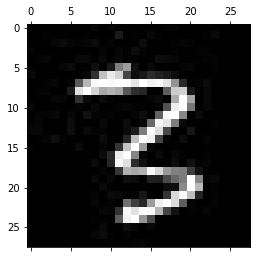

-------------------------------------------
Test: 1418
Predicted: 5


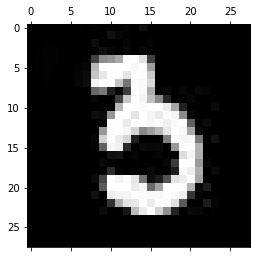

-------------------------------------------
Test: 1419
Predicted: 2


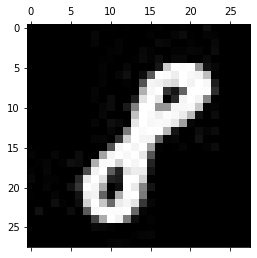

-------------------------------------------
Test: 1420
Predicted: 5


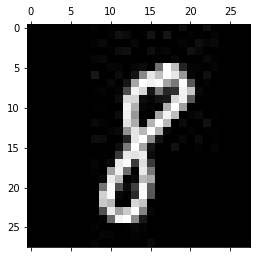

-------------------------------------------
Test: 1421
Predicted: 5


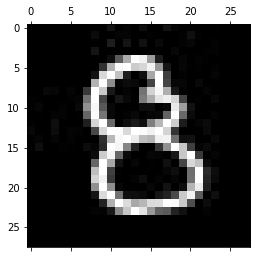

-------------------------------------------
Test: 1422
Predicted: 5


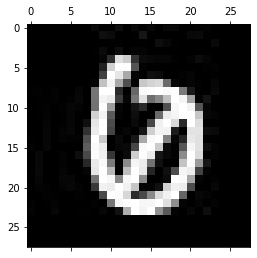

-------------------------------------------
Test: 1423
Predicted: 3


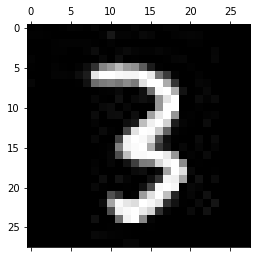

-------------------------------------------
Test: 1424
Predicted: 5


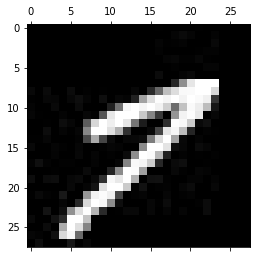

-------------------------------------------
Test: 1425
Predicted: 0


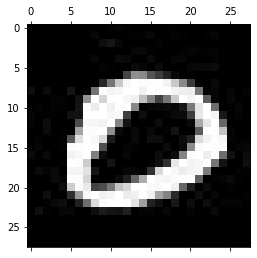

-------------------------------------------
Test: 1426
Predicted: 0


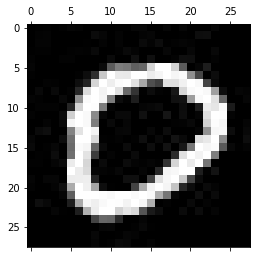

-------------------------------------------
Test: 1427
Predicted: 1


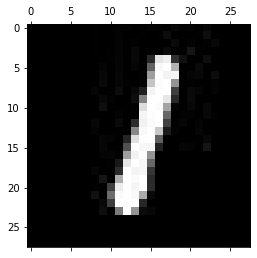

-------------------------------------------
Test: 1428
Predicted: 7


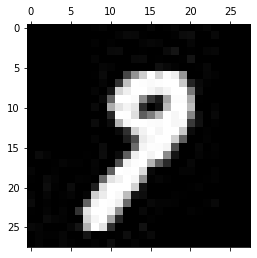

-------------------------------------------
Test: 1429
Predicted: 6


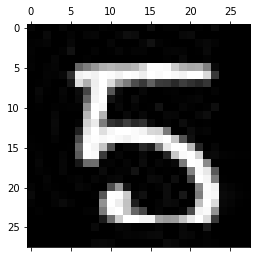

-------------------------------------------
Test: 1430
Predicted: 7


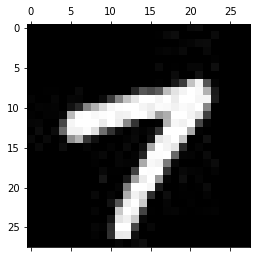

-------------------------------------------
Test: 1431
Predicted: 2


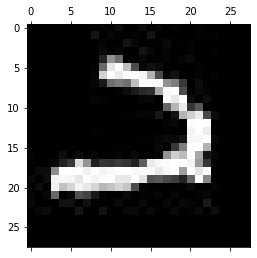

-------------------------------------------
Test: 1432
Predicted: 5


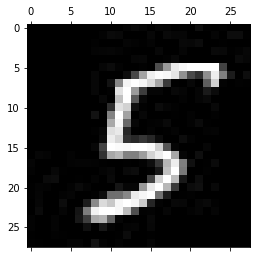

-------------------------------------------
Test: 1433
Predicted: 6


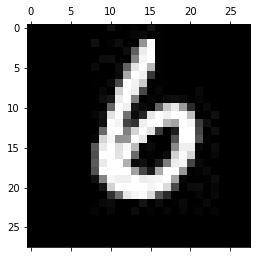

-------------------------------------------
Test: 1434
Predicted: 6


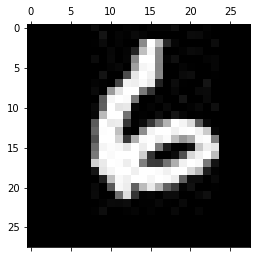

-------------------------------------------
Test: 1435
Predicted: 5


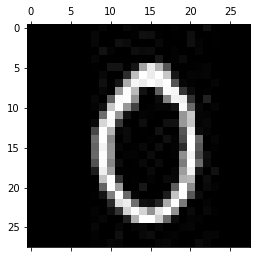

-------------------------------------------
Test: 1436
Predicted: 2


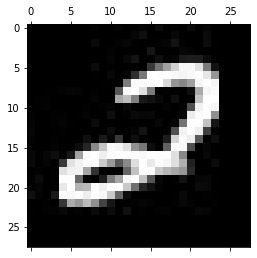

-------------------------------------------
Test: 1437
Predicted: 9


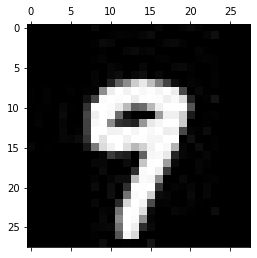

-------------------------------------------
Test: 1438
Predicted: 1


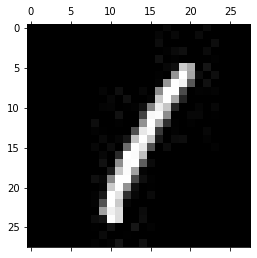

-------------------------------------------
Test: 1439
Predicted: 4


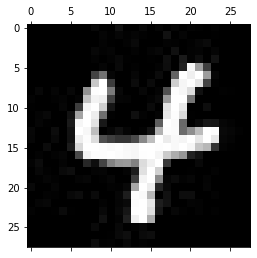

-------------------------------------------
Test: 1440
Predicted: 6


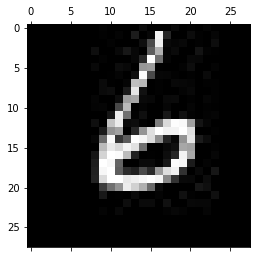

-------------------------------------------
Test: 1441
Predicted: 1


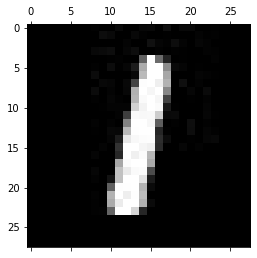

-------------------------------------------
Test: 1442
Predicted: 4


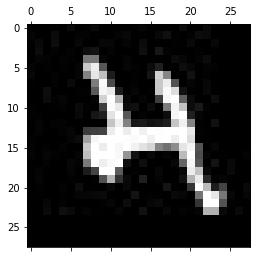

-------------------------------------------
Test: 1443
Predicted: 9


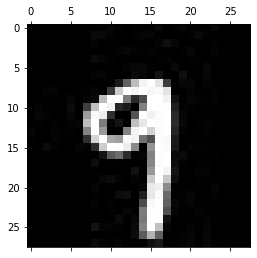

-------------------------------------------
Test: 1444
Predicted: 9


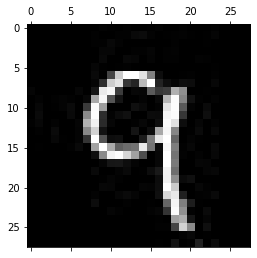

-------------------------------------------
Test: 1445
Predicted: 5


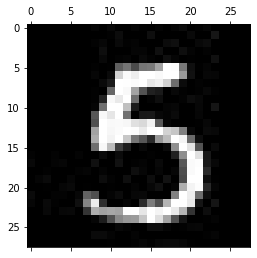

-------------------------------------------
Test: 1446
Predicted: 9


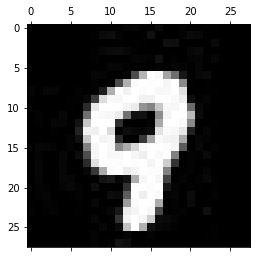

-------------------------------------------
Test: 1447
Predicted: 5


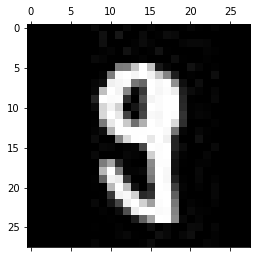

-------------------------------------------
Test: 1448
Predicted: 7


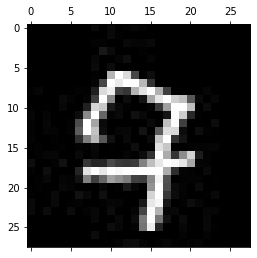

-------------------------------------------
Test: 1449
Predicted: 9


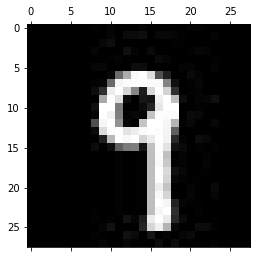

-------------------------------------------
Test: 1450
Predicted: 0


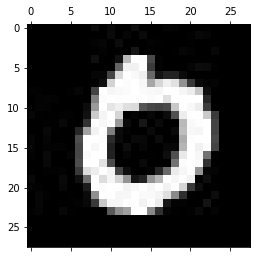

-------------------------------------------
Test: 1451
Predicted: 1


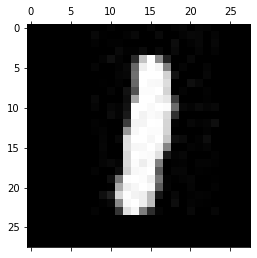

-------------------------------------------
Test: 1452
Predicted: 7


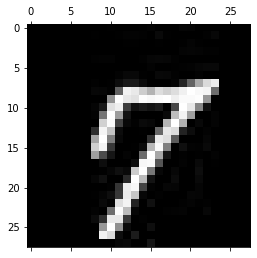

-------------------------------------------
Test: 1453
Predicted: 5


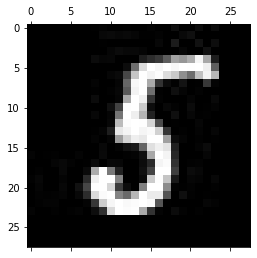

-------------------------------------------
Test: 1454
Predicted: 2


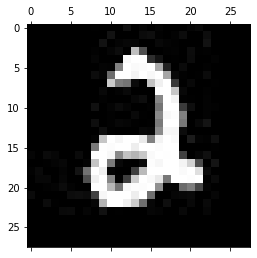

-------------------------------------------
Test: 1455
Predicted: 3


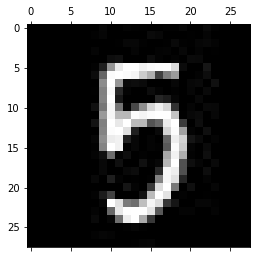

-------------------------------------------
Test: 1456
Predicted: 5


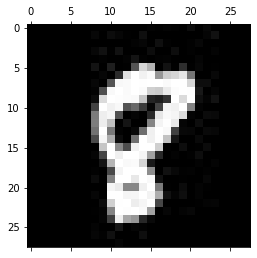

-------------------------------------------
Test: 1457
Predicted: 2


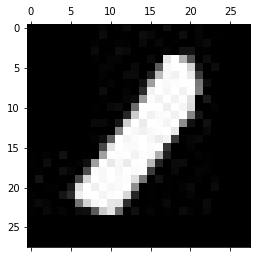

-------------------------------------------
Test: 1458
Predicted: 4


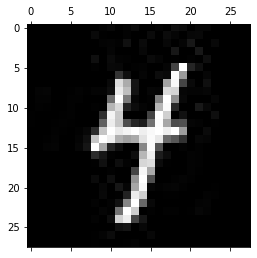

-------------------------------------------
Test: 1459
Predicted: 7


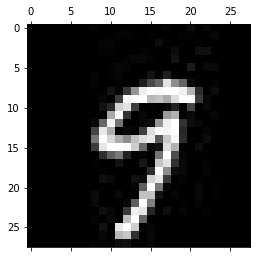

-------------------------------------------
Test: 1460
Predicted: 2


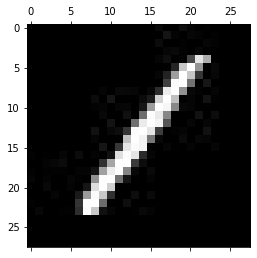

-------------------------------------------
Test: 1461
Predicted: 7


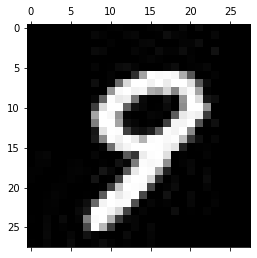

-------------------------------------------
Test: 1462
Predicted: 9


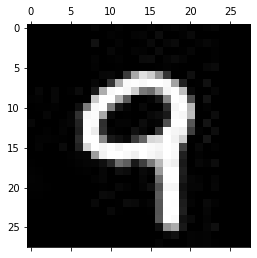

-------------------------------------------
Test: 1463
Predicted: 5


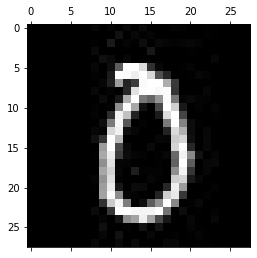

-------------------------------------------
Test: 1464
Predicted: 0


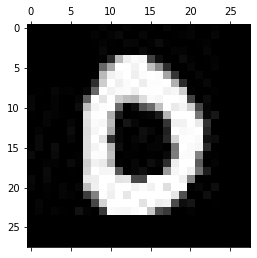

-------------------------------------------
Test: 1465
Predicted: 9


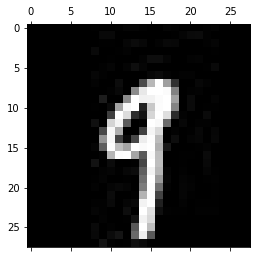

-------------------------------------------
Test: 1466
Predicted: 7


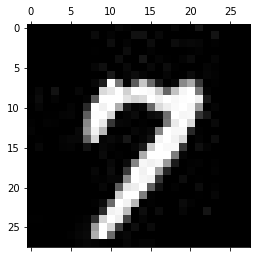

-------------------------------------------
Test: 1467
Predicted: 1


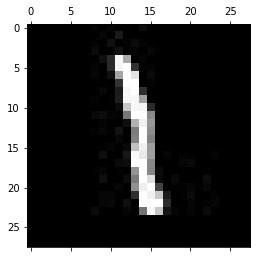

-------------------------------------------
Test: 1468
Predicted: 0


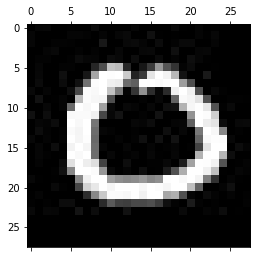

-------------------------------------------
Test: 1469
Predicted: 7


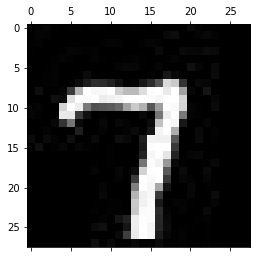

-------------------------------------------
Test: 1470
Predicted: 6


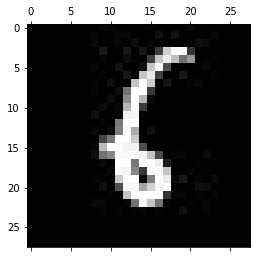

-------------------------------------------
Test: 1471
Predicted: 7


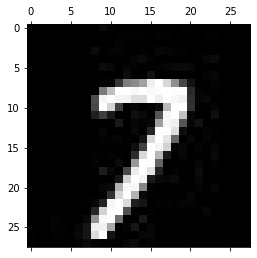

-------------------------------------------
Test: 1472
Predicted: 9


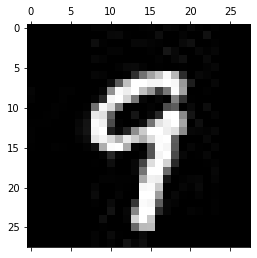

-------------------------------------------
Test: 1473
Predicted: 0


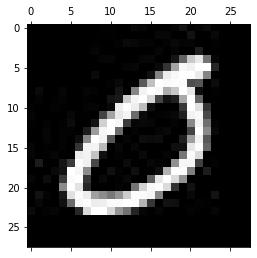

-------------------------------------------
Test: 1474
Predicted: 6


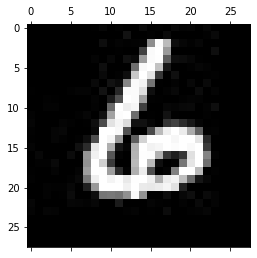

-------------------------------------------
Test: 1475
Predicted: 5


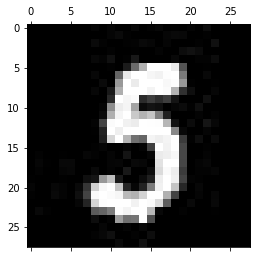

-------------------------------------------
Test: 1476
Predicted: 2


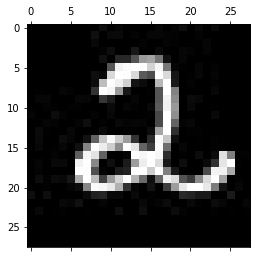

-------------------------------------------
Test: 1477
Predicted: 2


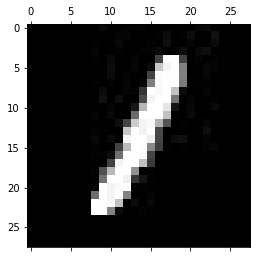

-------------------------------------------
Test: 1478
Predicted: 7


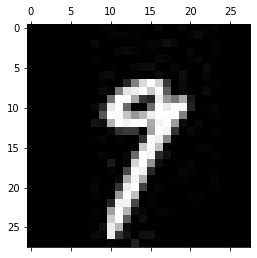

-------------------------------------------
Test: 1479
Predicted: 7


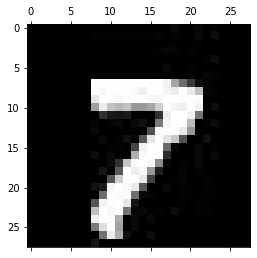

-------------------------------------------
Test: 1480
Predicted: 2


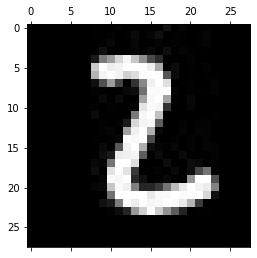

-------------------------------------------
Test: 1481
Predicted: 6


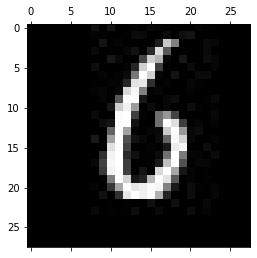

-------------------------------------------
Test: 1482
Predicted: 7


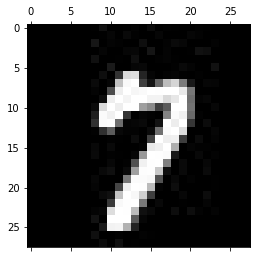

-------------------------------------------
Test: 1483
Predicted: 0


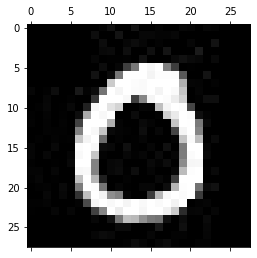

-------------------------------------------
Test: 1484
Predicted: 0


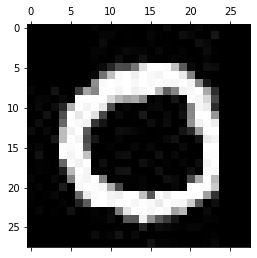

-------------------------------------------
Test: 1485
Predicted: 5


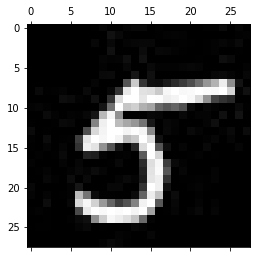

-------------------------------------------
Test: 1486
Predicted: 4


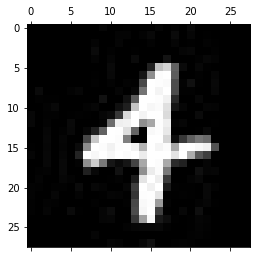

-------------------------------------------
Test: 1487
Predicted: 2


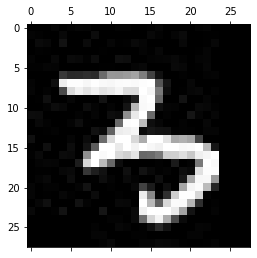

-------------------------------------------
Test: 1488
Predicted: 1


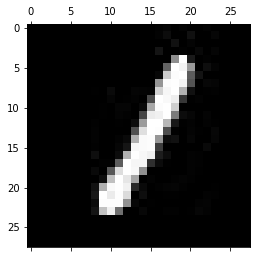

-------------------------------------------
Test: 1489
Predicted: 2


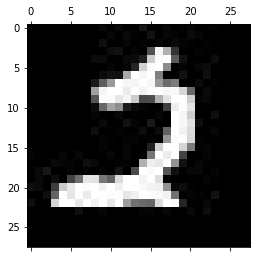

-------------------------------------------
Test: 1490
Predicted: 0


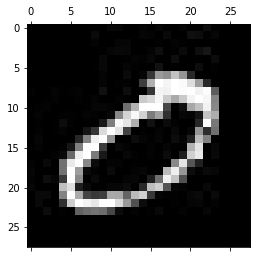

-------------------------------------------
Test: 1491
Predicted: 5


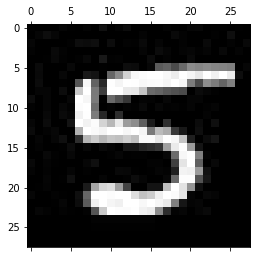

-------------------------------------------
Test: 1492
Predicted: 5


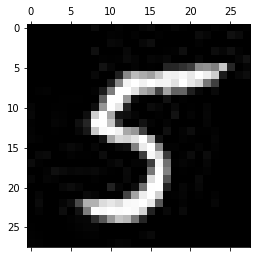

-------------------------------------------
Test: 1493
Predicted: 6


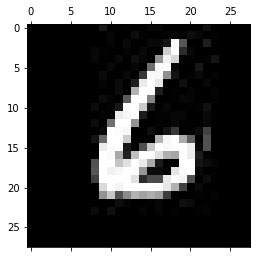

-------------------------------------------
Test: 1494
Predicted: 4


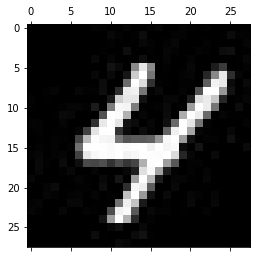

-------------------------------------------
Test: 1495
Predicted: 3


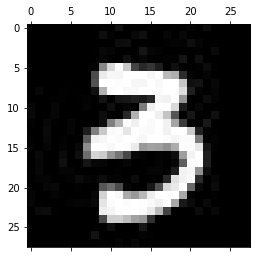

-------------------------------------------
Test: 1496
Predicted: 7


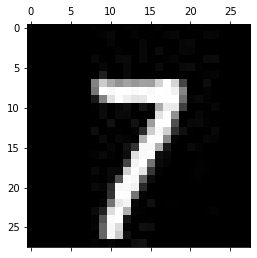

-------------------------------------------
Test: 1497
Predicted: 1


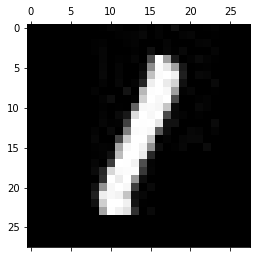

-------------------------------------------
Test: 1498
Predicted: 3


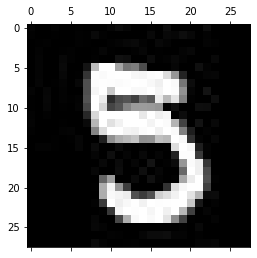

-------------------------------------------
Test: 1499
Predicted: 3


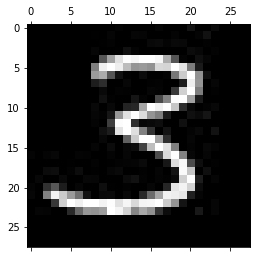

-------------------------------------------
Test: 1500
Predicted: 5


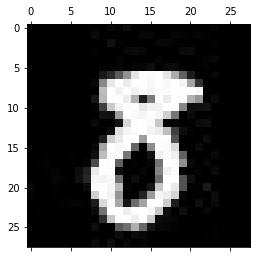

-------------------------------------------
Test: 1501
Predicted: 7


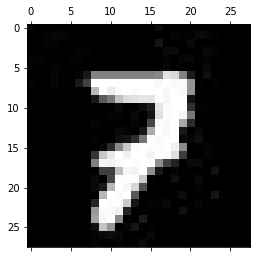

-------------------------------------------
Test: 1502
Predicted: 4


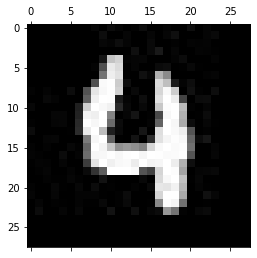

-------------------------------------------
Test: 1503
Predicted: 6


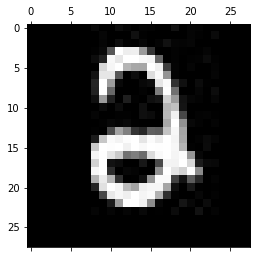

-------------------------------------------
Test: 1504
Predicted: 0


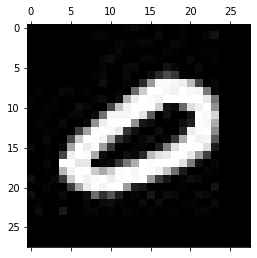

-------------------------------------------
Test: 1505
Predicted: 0


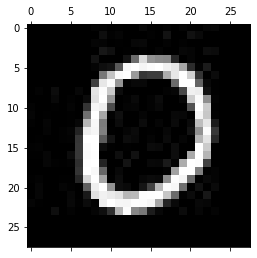

-------------------------------------------
Test: 1506
Predicted: 3


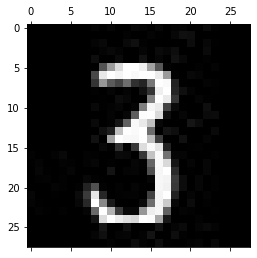

-------------------------------------------
Test: 1507
Predicted: 9


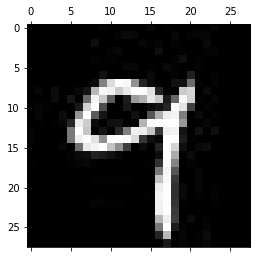

-------------------------------------------
Test: 1508
Predicted: 9


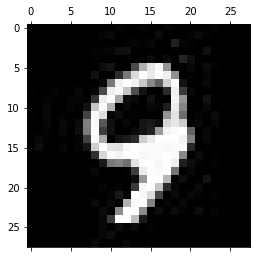

-------------------------------------------
Test: 1509
Predicted: 6


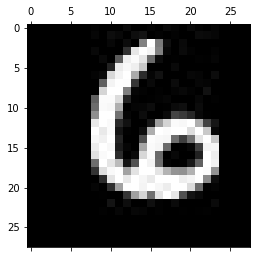

-------------------------------------------
Test: 1510
Predicted: 7


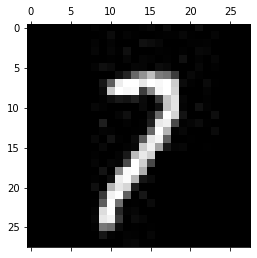

-------------------------------------------
Test: 1511
Predicted: 6


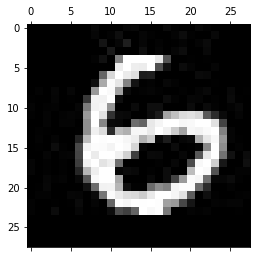

-------------------------------------------
Test: 1512
Predicted: 9


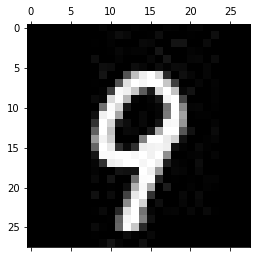

-------------------------------------------
Test: 1513
Predicted: 9


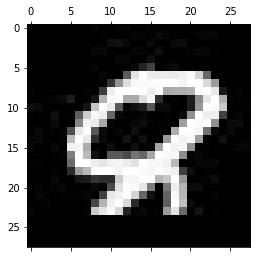

-------------------------------------------
Test: 1514
Predicted: 4


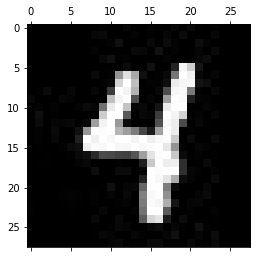

-------------------------------------------
Test: 1515
Predicted: 3


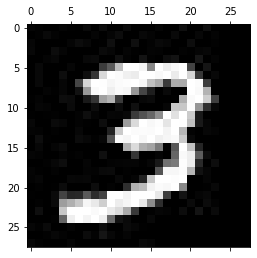

-------------------------------------------
Test: 1516
Predicted: 6


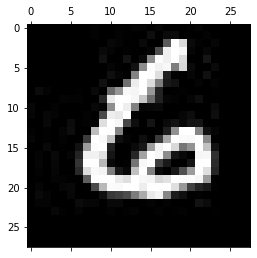

-------------------------------------------
Test: 1517
Predicted: 1


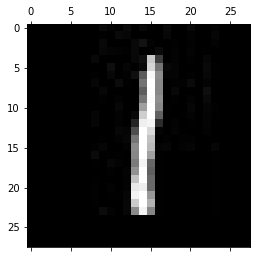

-------------------------------------------
Test: 1518
Predicted: 9


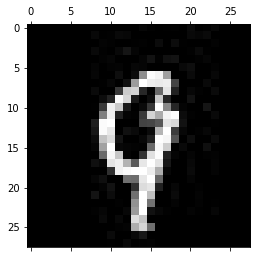

-------------------------------------------
Test: 1519
Predicted: 5


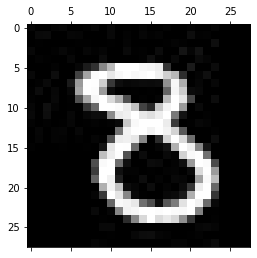

-------------------------------------------
Test: 1520
Predicted: 1


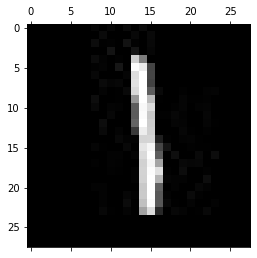

-------------------------------------------
Test: 1521
Predicted: 5


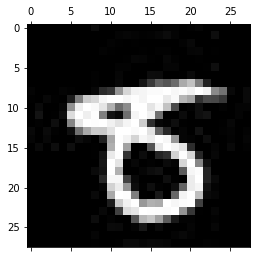

-------------------------------------------
Test: 1522
Predicted: 0


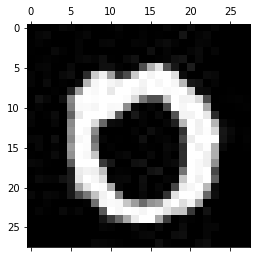

-------------------------------------------
Test: 1523
Predicted: 7


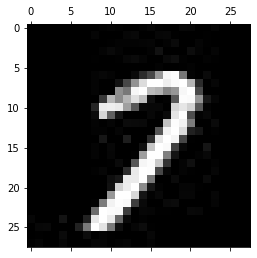

-------------------------------------------
Test: 1524
Predicted: 5


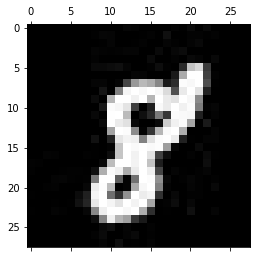

-------------------------------------------
Test: 1525
Predicted: 5


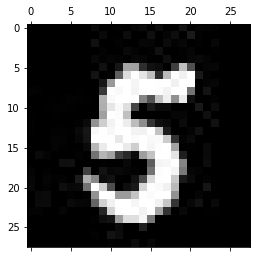

-------------------------------------------
Test: 1526
Predicted: 7


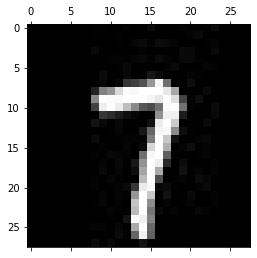

-------------------------------------------
Test: 1527
Predicted: 5


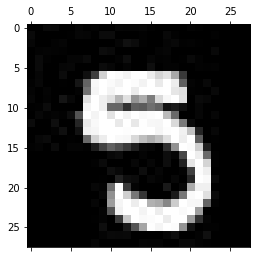

-------------------------------------------
Test: 1528
Predicted: 7


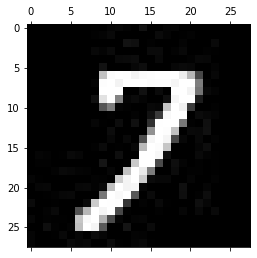

-------------------------------------------
Test: 1529
Predicted: 4


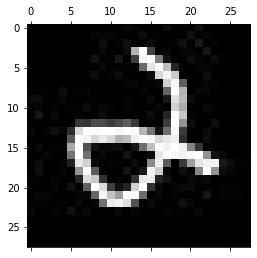

-------------------------------------------
Test: 1530
Predicted: 2


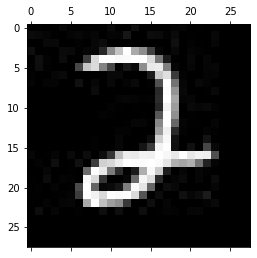

-------------------------------------------
Test: 1531
Predicted: 5


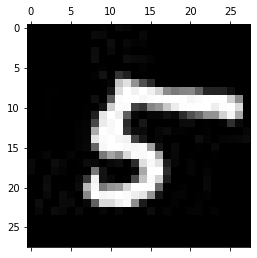

-------------------------------------------
Test: 1532
Predicted: 7


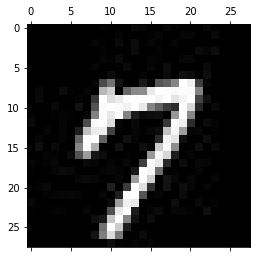

-------------------------------------------
Test: 1533
Predicted: 0


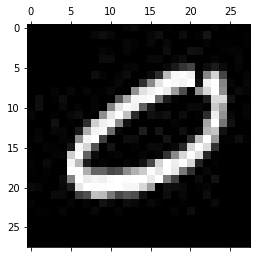

-------------------------------------------
Test: 1534
Predicted: 4


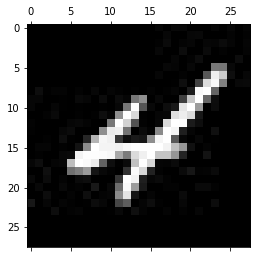

-------------------------------------------
Test: 1535
Predicted: 0


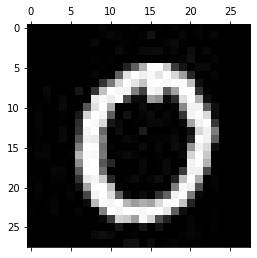

-------------------------------------------
Test: 1536
Predicted: 1


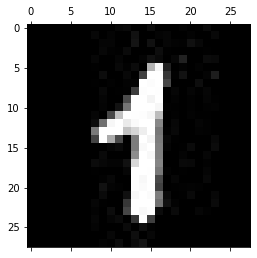

-------------------------------------------
Test: 1537
Predicted: 3


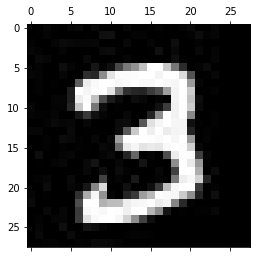

-------------------------------------------
Test: 1538
Predicted: 9


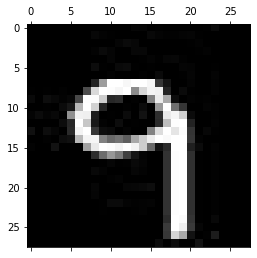

-------------------------------------------
Test: 1539
Predicted: 0


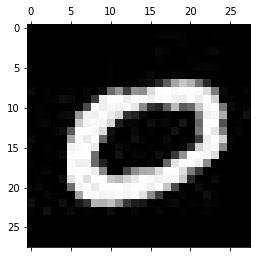

-------------------------------------------
Test: 1540
Predicted: 5


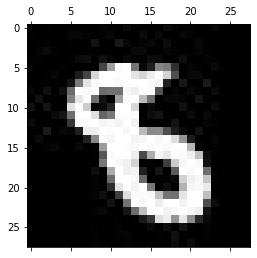

-------------------------------------------
Test: 1541
Predicted: 1


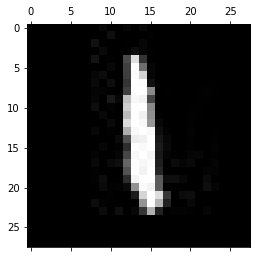

-------------------------------------------
Test: 1542
Predicted: 1


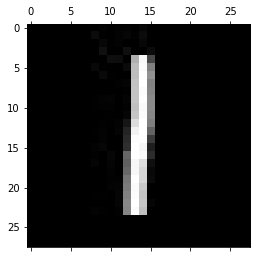

-------------------------------------------
Test: 1543
Predicted: 7


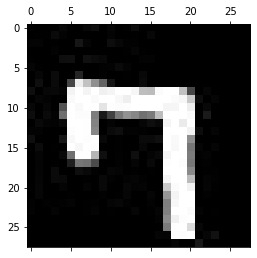

-------------------------------------------
Test: 1544
Predicted: 4


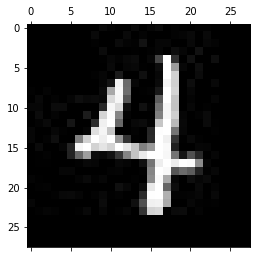

-------------------------------------------
Test: 1545
Predicted: 9


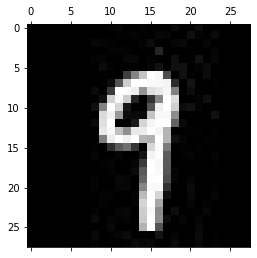

-------------------------------------------
Test: 1546
Predicted: 5


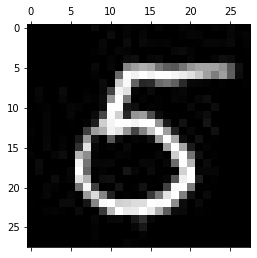

-------------------------------------------
Test: 1547
Predicted: 2


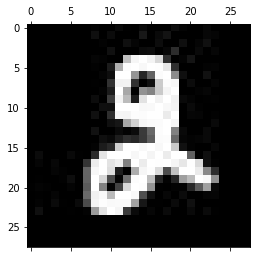

-------------------------------------------
Test: 1548
Predicted: 4


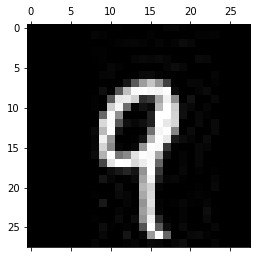

-------------------------------------------
Test: 1549
Predicted: 5


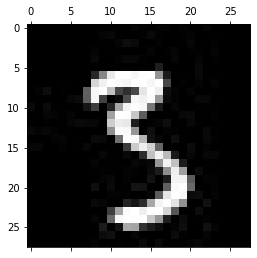

-------------------------------------------
Test: 1550
Predicted: 2


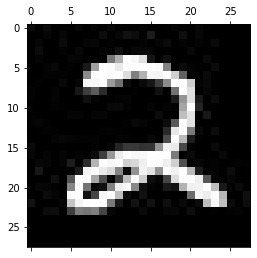

-------------------------------------------
Test: 1551
Predicted: 5


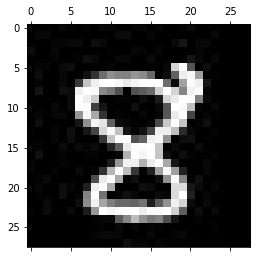

-------------------------------------------
Test: 1552
Predicted: 0


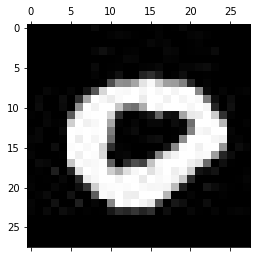

-------------------------------------------
Test: 1553
Predicted: 4


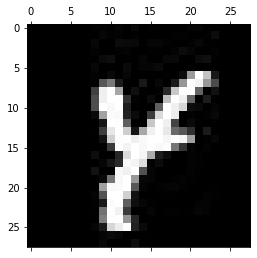

-------------------------------------------
Test: 1554
Predicted: 4


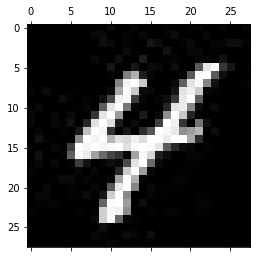

-------------------------------------------
Test: 1555
Predicted: 5


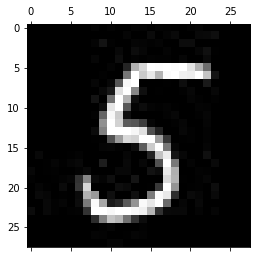

-------------------------------------------
Test: 1556
Predicted: 0


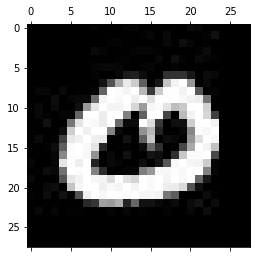

-------------------------------------------
Test: 1557
Predicted: 9


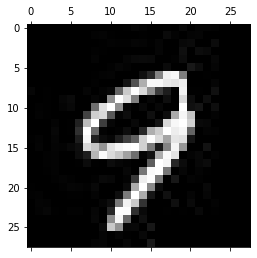

-------------------------------------------
Test: 1558
Predicted: 9


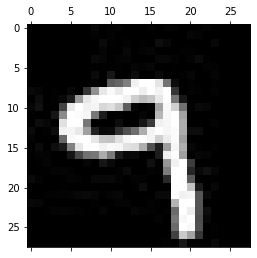

-------------------------------------------
Test: 1559
Predicted: 5


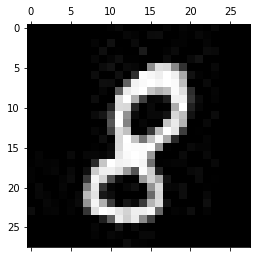

-------------------------------------------
Test: 1560
Predicted: 5


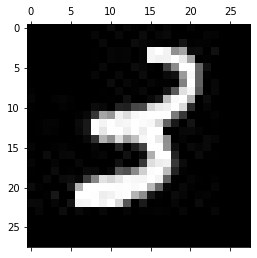

-------------------------------------------
Test: 1561
Predicted: 7


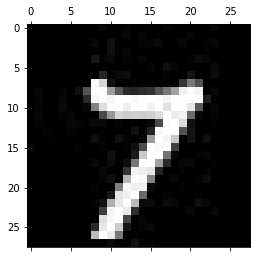

-------------------------------------------
Test: 1562
Predicted: 7


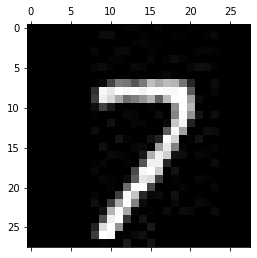

-------------------------------------------
Test: 1563
Predicted: 4


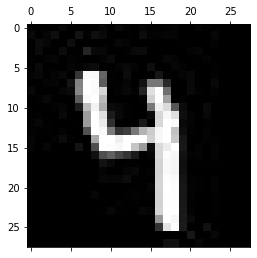

-------------------------------------------
Test: 1564
Predicted: 7


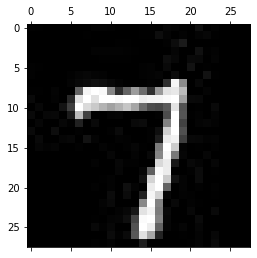

-------------------------------------------
Test: 1565
Predicted: 5


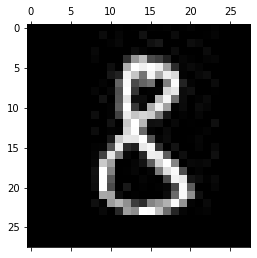

-------------------------------------------
Test: 1566
Predicted: 6


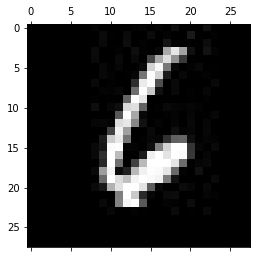

-------------------------------------------
Test: 1567
Predicted: 6


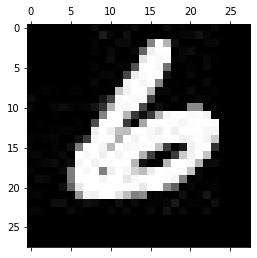

-------------------------------------------
Test: 1568
Predicted: 5


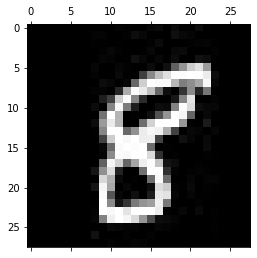

-------------------------------------------
Test: 1569
Predicted: 2


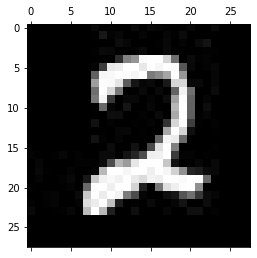

-------------------------------------------
Test: 1570
Predicted: 7


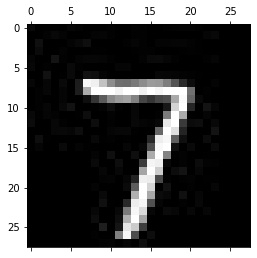

-------------------------------------------
Test: 1571
Predicted: 9


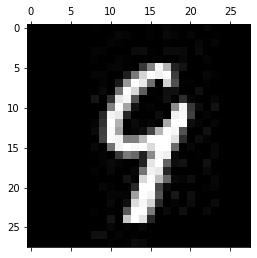

-------------------------------------------
Test: 1572
Predicted: 1


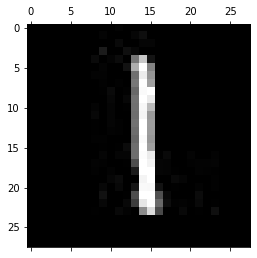

-------------------------------------------
Test: 1573
Predicted: 2


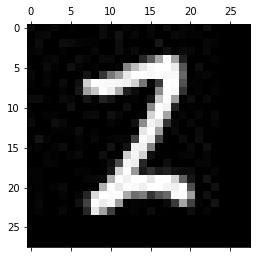

-------------------------------------------
Test: 1574
Predicted: 5


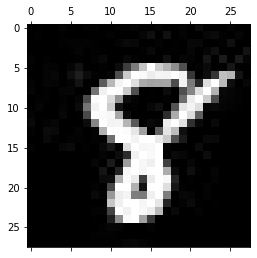

-------------------------------------------
Test: 1575
Predicted: 5


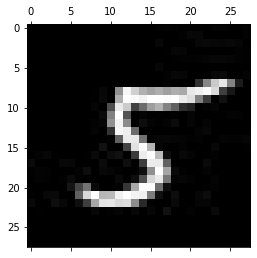

-------------------------------------------
Test: 1576
Predicted: 5


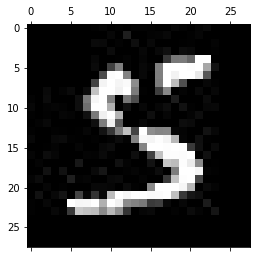

-------------------------------------------
Test: 1577
Predicted: 7


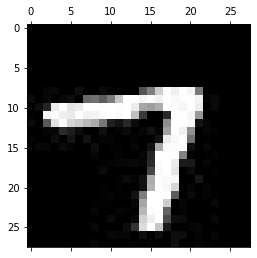

-------------------------------------------
Test: 1578
Predicted: 2


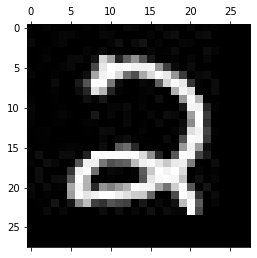

-------------------------------------------
Test: 1579
Predicted: 1


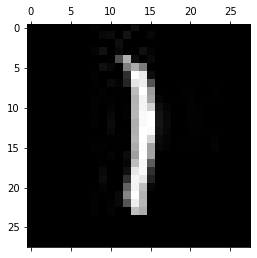

-------------------------------------------
Test: 1580
Predicted: 7


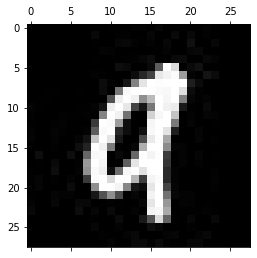

-------------------------------------------
Test: 1581
Predicted: 4


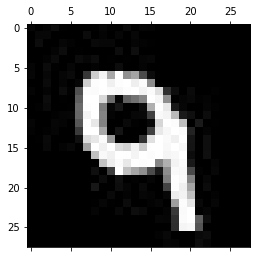

-------------------------------------------
Test: 1582
Predicted: 6


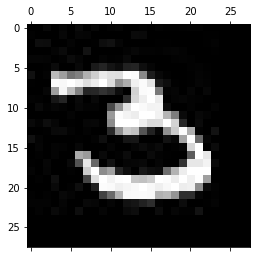

-------------------------------------------
Test: 1583
Predicted: 0


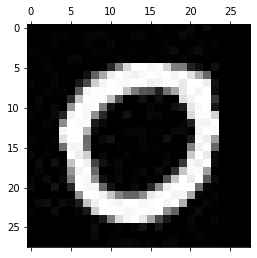

-------------------------------------------
Test: 1584
Predicted: 3


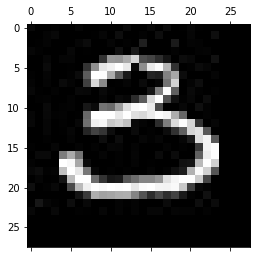

-------------------------------------------
Test: 1585
Predicted: 5


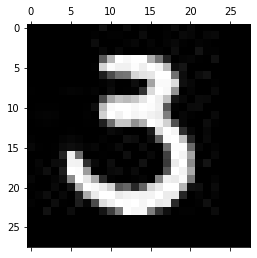

-------------------------------------------
Test: 1586
Predicted: 6


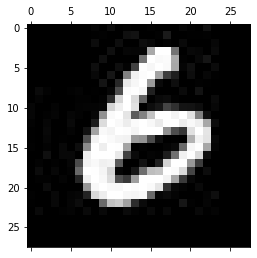

-------------------------------------------
Test: 1587
Predicted: 7


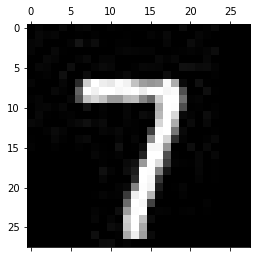

-------------------------------------------
Test: 1588
Predicted: 9


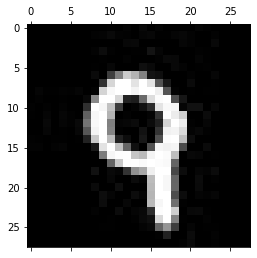

-------------------------------------------
Test: 1589
Predicted: 5


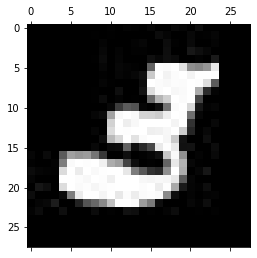

-------------------------------------------
Test: 1590
Predicted: 7


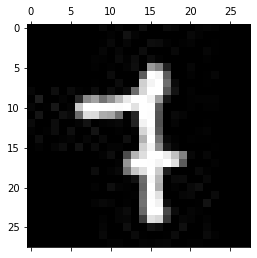

-------------------------------------------
Test: 1591
Predicted: 5


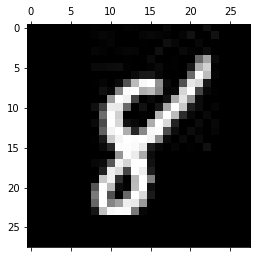

-------------------------------------------
Test: 1592
Predicted: 0


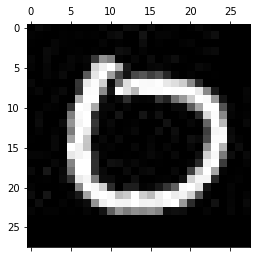

-------------------------------------------
Test: 1593
Predicted: 1


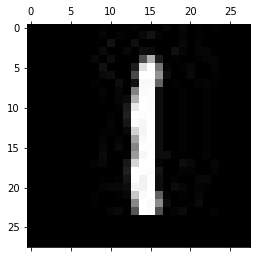

-------------------------------------------
Test: 1594
Predicted: 1


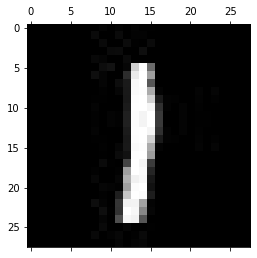

-------------------------------------------
Test: 1595
Predicted: 5


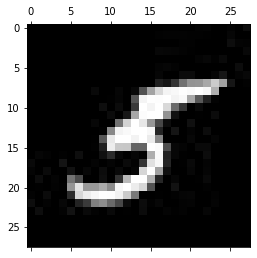

-------------------------------------------
Test: 1596
Predicted: 2


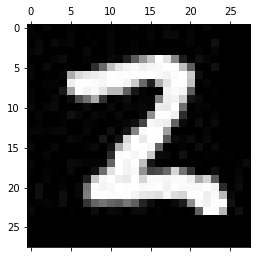

-------------------------------------------
Test: 1597
Predicted: 6


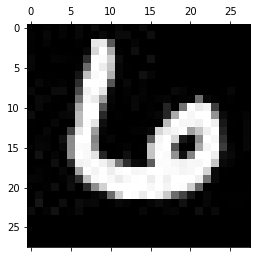

-------------------------------------------
Test: 1598
Predicted: 2


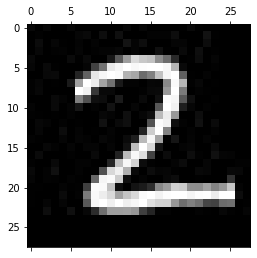

-------------------------------------------
Test: 1599
Predicted: 9


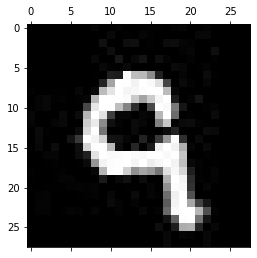

-------------------------------------------
Test: 1600
Predicted: 3


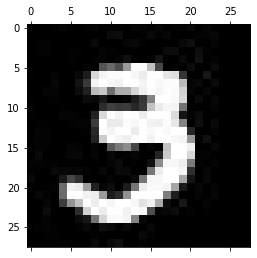

-------------------------------------------
Test: 1601
Predicted: 3


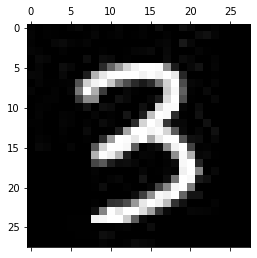

-------------------------------------------
Test: 1602
Predicted: 1


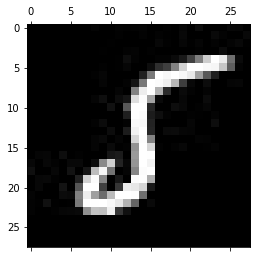

-------------------------------------------
Test: 1603
Predicted: 1


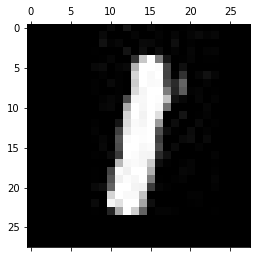

-------------------------------------------
Test: 1604
Predicted: 6


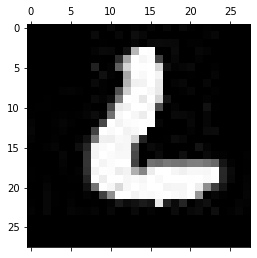

-------------------------------------------
Test: 1605
Predicted: 3


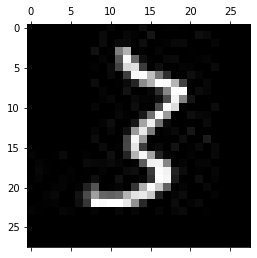

-------------------------------------------
Test: 1606
Predicted: 9


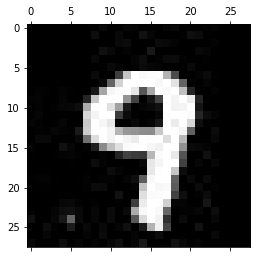

-------------------------------------------
Test: 1607
Predicted: 7


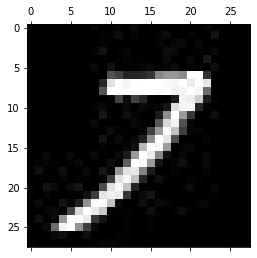

-------------------------------------------
Test: 1608
Predicted: 7


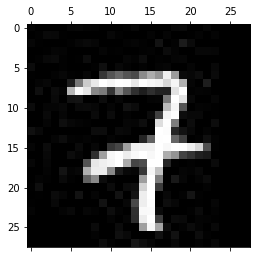

-------------------------------------------
Test: 1609
Predicted: 4


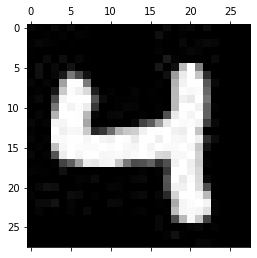

-------------------------------------------
Test: 1610
Predicted: 5


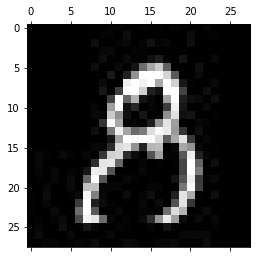

-------------------------------------------
Test: 1611
Predicted: 2


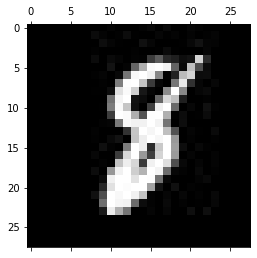

-------------------------------------------
Test: 1612
Predicted: 6


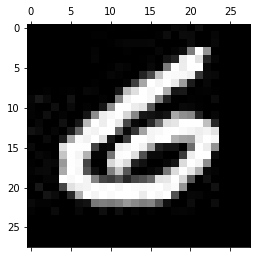

-------------------------------------------
Test: 1613
Predicted: 2


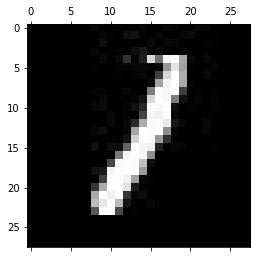

-------------------------------------------
Test: 1614
Predicted: 0


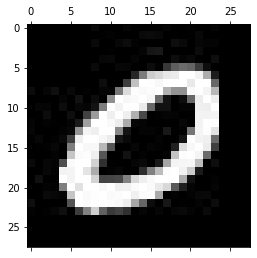

-------------------------------------------
Test: 1615
Predicted: 6


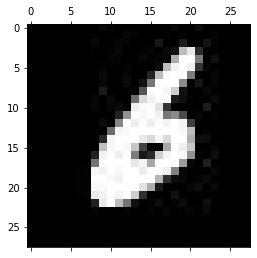

-------------------------------------------
Test: 1616
Predicted: 0


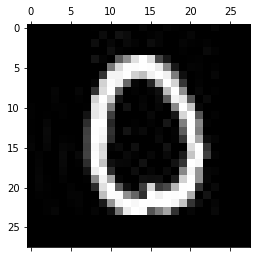

-------------------------------------------
Test: 1617
Predicted: 3


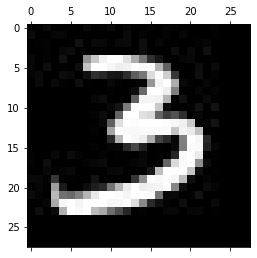

-------------------------------------------
Test: 1618
Predicted: 2


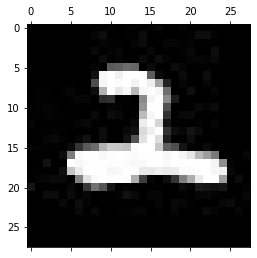

-------------------------------------------
Test: 1619
Predicted: 1


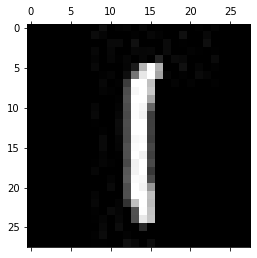

-------------------------------------------
Test: 1620
Predicted: 1


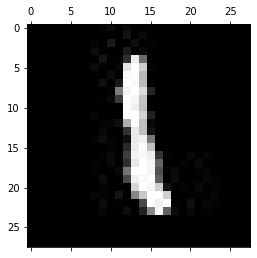

-------------------------------------------
Test: 1621
Predicted: 1


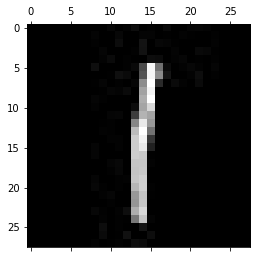

-------------------------------------------
Test: 1622
Predicted: 4


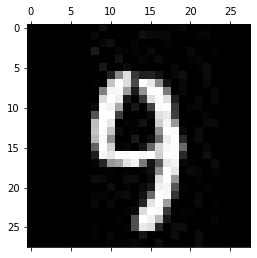

-------------------------------------------
Test: 1623
Predicted: 5


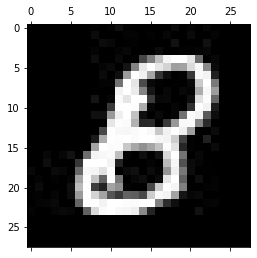

-------------------------------------------
Test: 1624
Predicted: 9


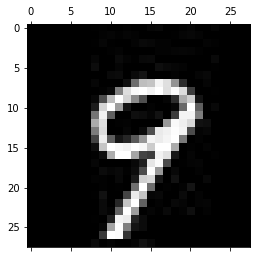

-------------------------------------------
Test: 1625
Predicted: 2


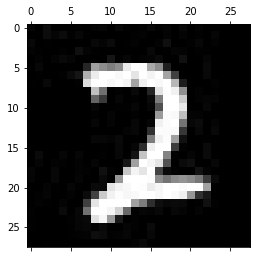

-------------------------------------------
Test: 1626
Predicted: 2


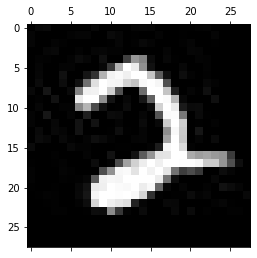

-------------------------------------------
Test: 1627
Predicted: 5


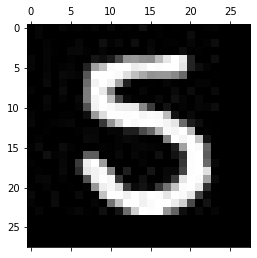

-------------------------------------------
Test: 1628
Predicted: 4


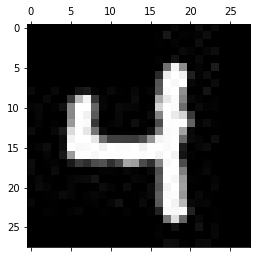

-------------------------------------------
Test: 1629
Predicted: 0


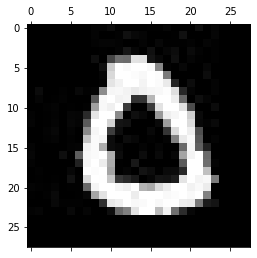

-------------------------------------------
Test: 1630
Predicted: 6


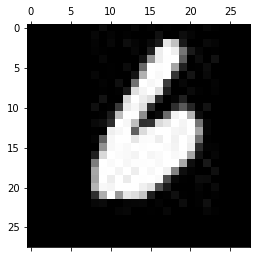

-------------------------------------------
Test: 1631
Predicted: 7


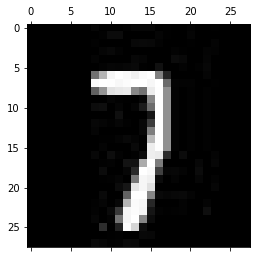

-------------------------------------------
Test: 1632
Predicted: 1


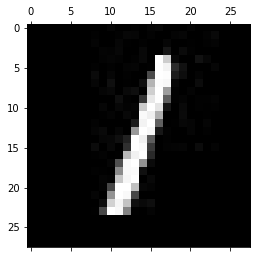

-------------------------------------------
Test: 1633
Predicted: 7


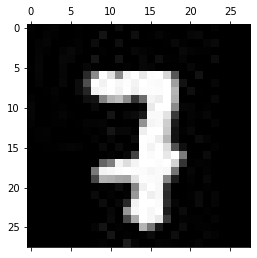

-------------------------------------------
Test: 1634
Predicted: 1


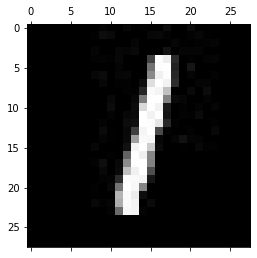

-------------------------------------------
Test: 1635
Predicted: 5


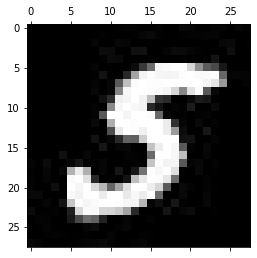

-------------------------------------------
Test: 1636
Predicted: 5


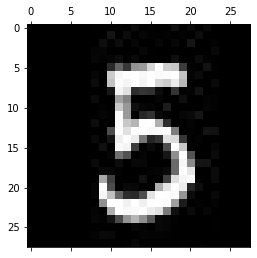

-------------------------------------------
Test: 1637
Predicted: 7


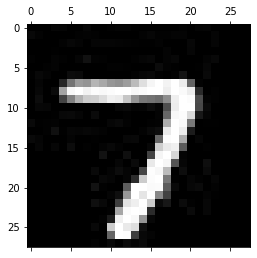

-------------------------------------------
Test: 1638
Predicted: 7


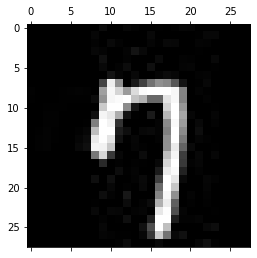

-------------------------------------------
Test: 1639
Predicted: 5


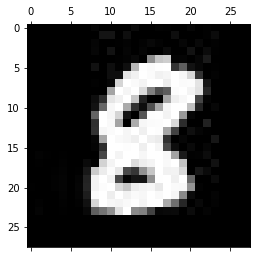

-------------------------------------------
Test: 1640
Predicted: 1


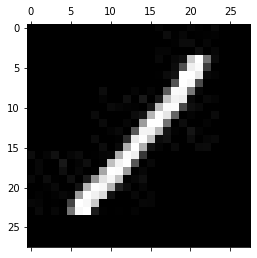

-------------------------------------------
Test: 1641
Predicted: 1


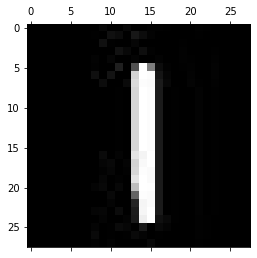

-------------------------------------------
Test: 1642
Predicted: 6


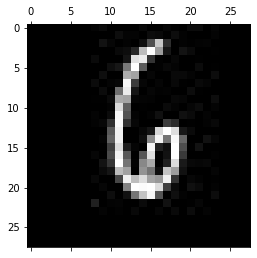

-------------------------------------------
Test: 1643
Predicted: 4


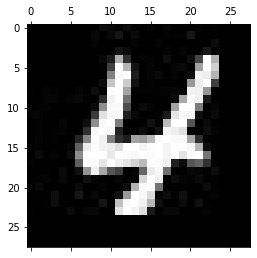

-------------------------------------------
Test: 1644
Predicted: 7


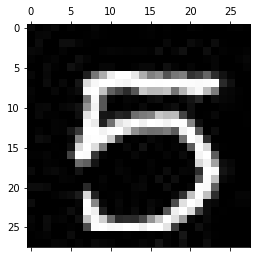

-------------------------------------------
Test: 1645
Predicted: 6


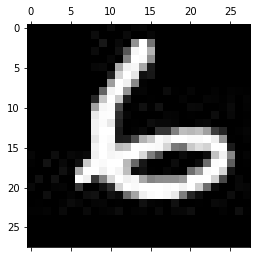

-------------------------------------------
Test: 1646
Predicted: 4


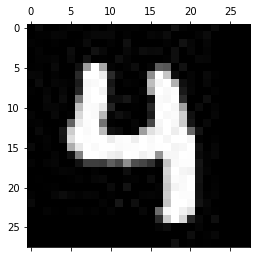

-------------------------------------------
Test: 1647
Predicted: 1


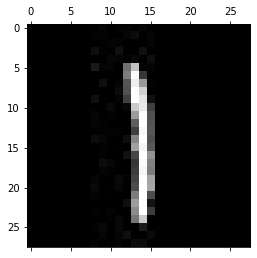

-------------------------------------------
Test: 1648
Predicted: 1


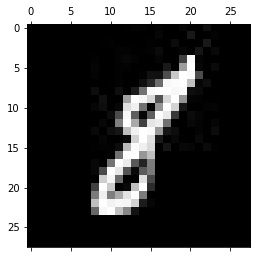

-------------------------------------------
Test: 1649
Predicted: 6


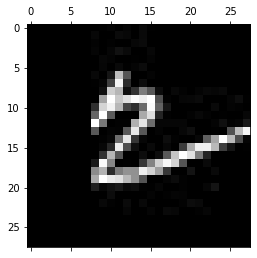

-------------------------------------------
Test: 1650
Predicted: 4


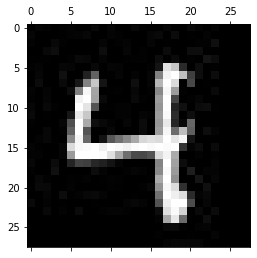

-------------------------------------------
Test: 1651
Predicted: 0


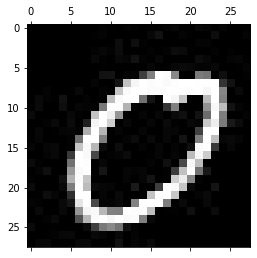

-------------------------------------------
Test: 1652
Predicted: 7


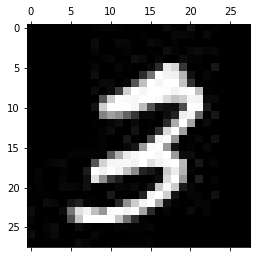

-------------------------------------------
Test: 1653
Predicted: 7


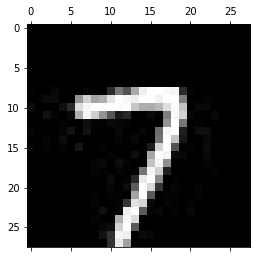

-------------------------------------------
Test: 1654
Predicted: 1


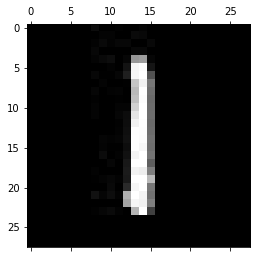

-------------------------------------------
Test: 1655
Predicted: 4


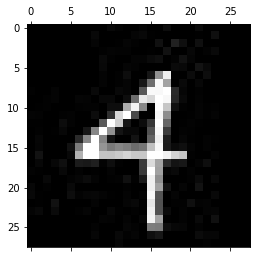

-------------------------------------------
Test: 1656
Predicted: 1


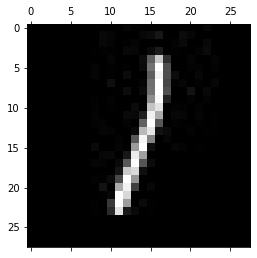

-------------------------------------------
Test: 1657
Predicted: 5


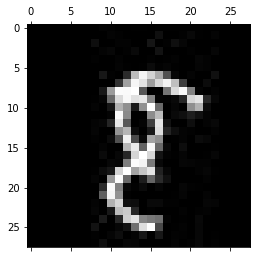

-------------------------------------------
Test: 1658
Predicted: 2


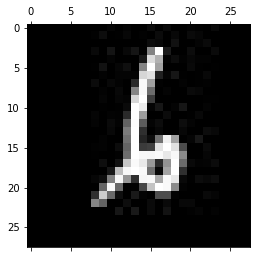

-------------------------------------------
Test: 1659
Predicted: 5


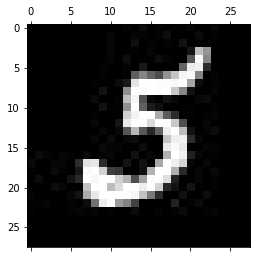

-------------------------------------------
Test: 1660
Predicted: 4


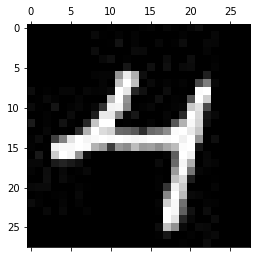

-------------------------------------------
Test: 1661
Predicted: 7


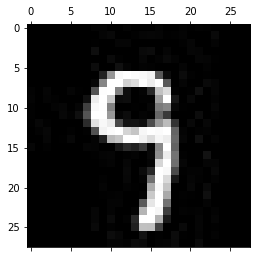

-------------------------------------------
Test: 1662
Predicted: 2


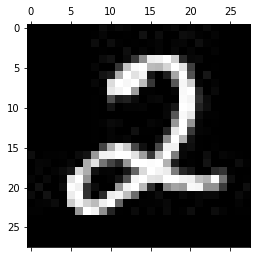

-------------------------------------------
Test: 1663
Predicted: 4


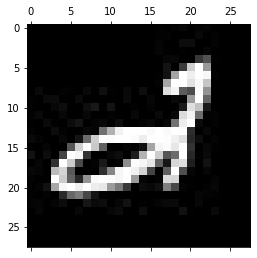

-------------------------------------------
Test: 1664
Predicted: 4


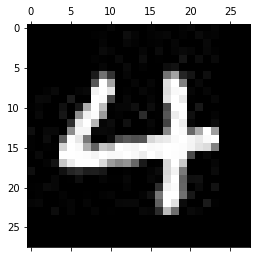

-------------------------------------------
Test: 1665
Predicted: 0


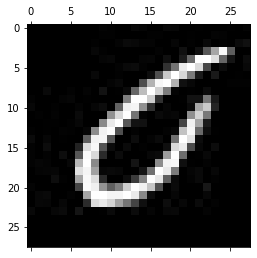

-------------------------------------------
Test: 1666
Predicted: 0


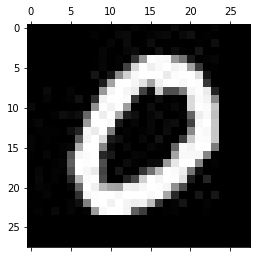

-------------------------------------------
Test: 1667
Predicted: 7


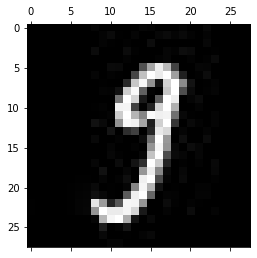

-------------------------------------------
Test: 1668
Predicted: 5


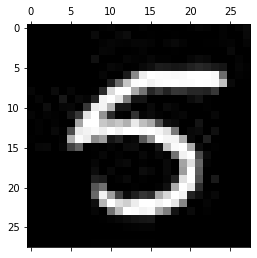

-------------------------------------------
Test: 1669
Predicted: 1


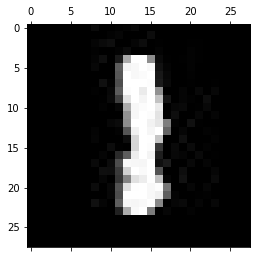

-------------------------------------------
Test: 1670
Predicted: 5


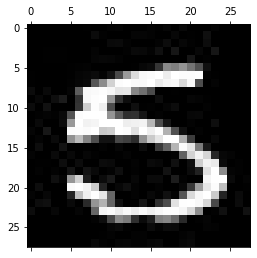

-------------------------------------------
Test: 1671
Predicted: 5


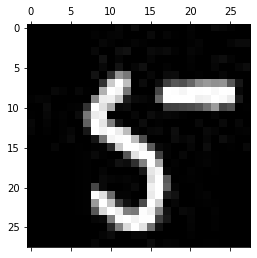

-------------------------------------------
Test: 1672
Predicted: 5


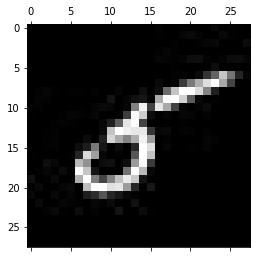

-------------------------------------------
Test: 1673
Predicted: 4


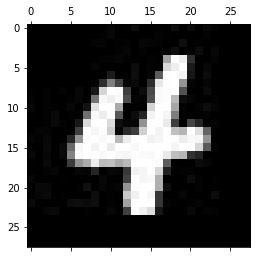

-------------------------------------------
Test: 1674
Predicted: 7


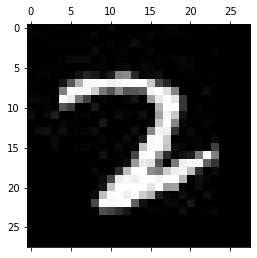

-------------------------------------------
Test: 1675
Predicted: 2


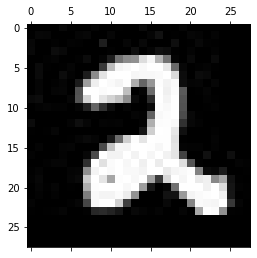

-------------------------------------------
Test: 1676
Predicted: 0


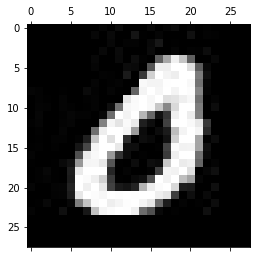

-------------------------------------------
Test: 1677
Predicted: 4


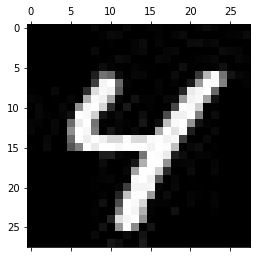

-------------------------------------------
Test: 1678
Predicted: 9


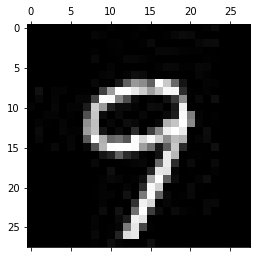

-------------------------------------------
Test: 1679
Predicted: 3


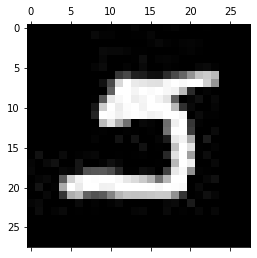

-------------------------------------------
Test: 1680
Predicted: 3


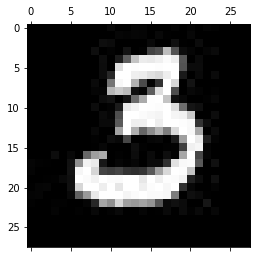

-------------------------------------------
Test: 1681
Predicted: 2


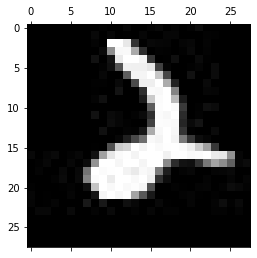

-------------------------------------------
Test: 1682
Predicted: 5


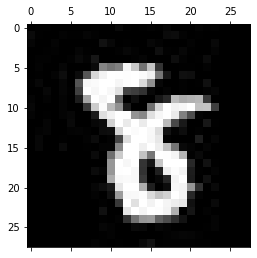

-------------------------------------------
Test: 1683
Predicted: 5


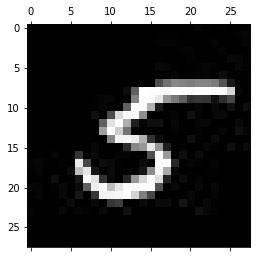

-------------------------------------------
Test: 1684
Predicted: 6


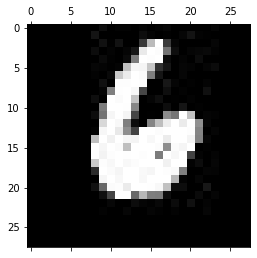

-------------------------------------------
Test: 1685
Predicted: 7


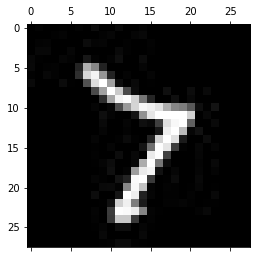

-------------------------------------------
Test: 1686
Predicted: 7


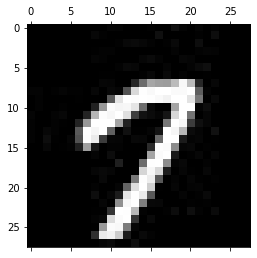

-------------------------------------------
Test: 1687
Predicted: 9


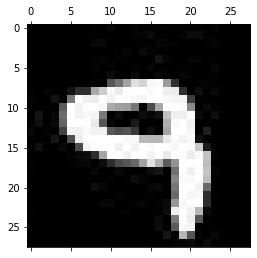

-------------------------------------------
Test: 1688
Predicted: 3


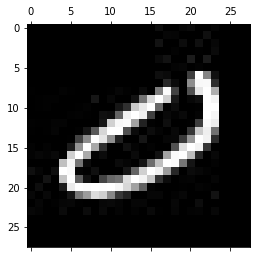

-------------------------------------------
Test: 1689
Predicted: 9


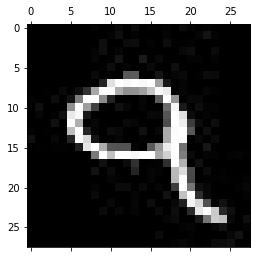

-------------------------------------------
Test: 1690
Predicted: 5


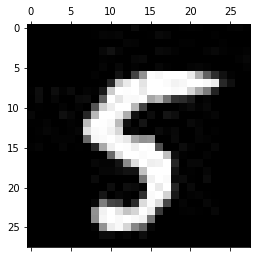

-------------------------------------------
Test: 1691
Predicted: 4


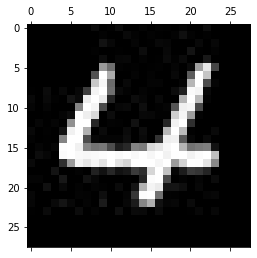

-------------------------------------------
Test: 1692
Predicted: 5


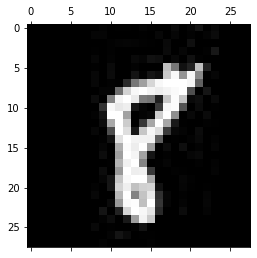

-------------------------------------------
Test: 1693
Predicted: 3


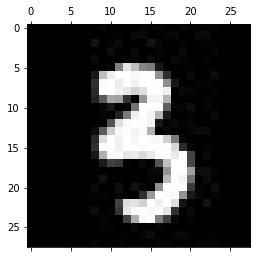

-------------------------------------------
Test: 1694
Predicted: 5


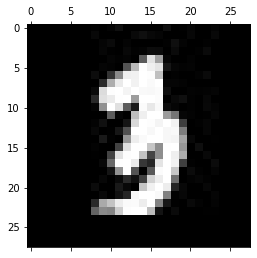

-------------------------------------------
Test: 1695
Predicted: 3


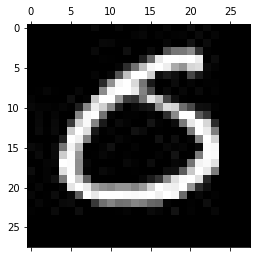

-------------------------------------------
Test: 1696
Predicted: 0


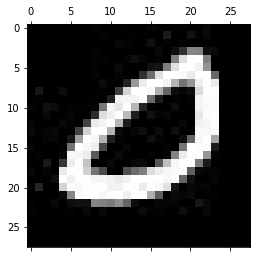

-------------------------------------------
Test: 1697
Predicted: 0


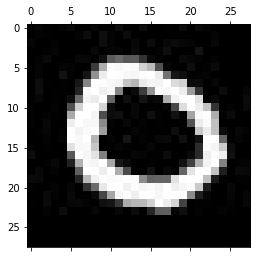

-------------------------------------------
Test: 1698
Predicted: 5


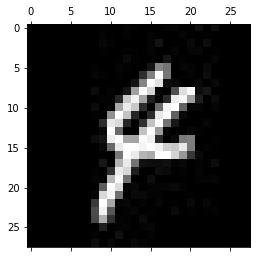

-------------------------------------------
Test: 1699
Predicted: 2


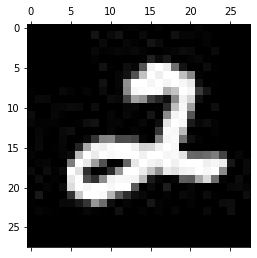

-------------------------------------------
Test: 1700
Predicted: 1


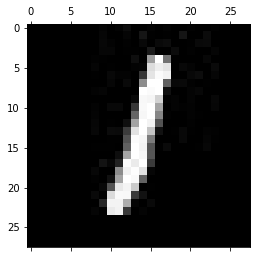

-------------------------------------------
Test: 1701
Predicted: 5


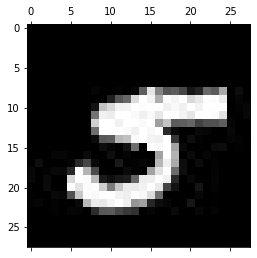

-------------------------------------------
Test: 1702
Predicted: 5


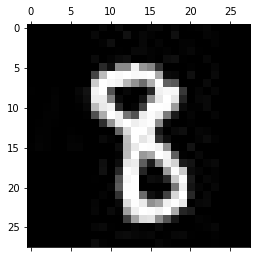

-------------------------------------------
Test: 1703
Predicted: 1


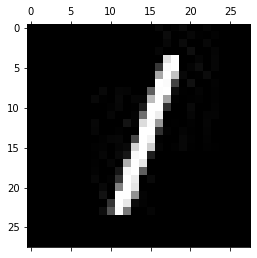

-------------------------------------------
Test: 1704
Predicted: 3


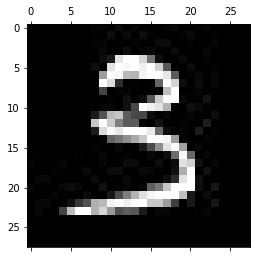

-------------------------------------------
Test: 1705
Predicted: 1


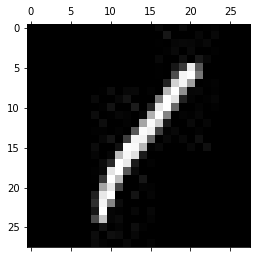

-------------------------------------------
Test: 1706
Predicted: 7


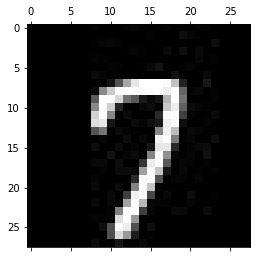

-------------------------------------------
Test: 1707
Predicted: 6


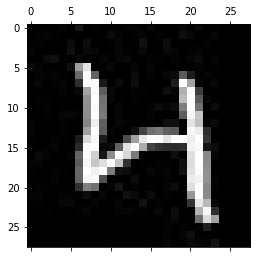

-------------------------------------------
Test: 1708
Predicted: 0


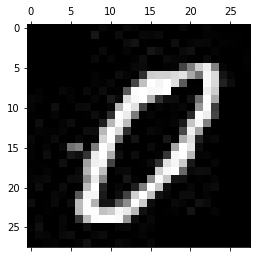

-------------------------------------------
Test: 1709
Predicted: 5


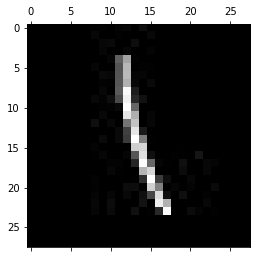

-------------------------------------------
Test: 1710
Predicted: 4


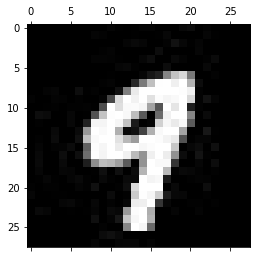

-------------------------------------------
Test: 1711
Predicted: 6


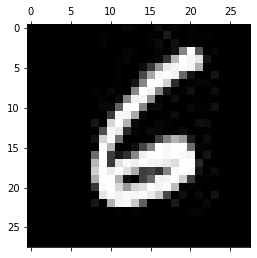

-------------------------------------------
Test: 1712
Predicted: 2


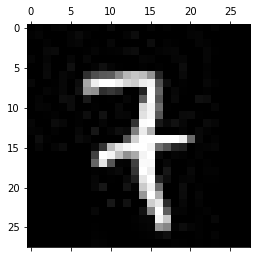

-------------------------------------------
Test: 1713
Predicted: 1


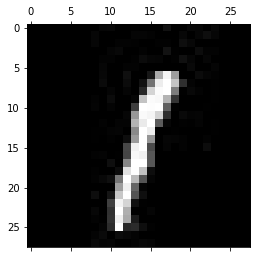

-------------------------------------------
Test: 1714
Predicted: 2


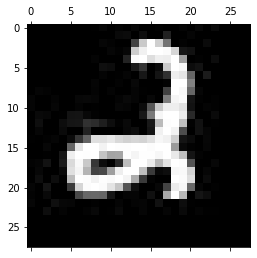

-------------------------------------------
Test: 1715
Predicted: 4


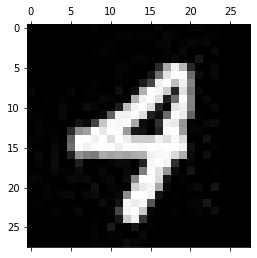

-------------------------------------------
Test: 1716
Predicted: 4


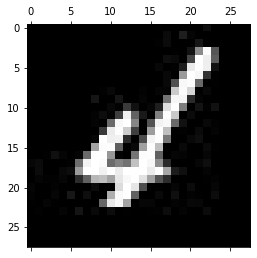

-------------------------------------------
Test: 1717
Predicted: 3


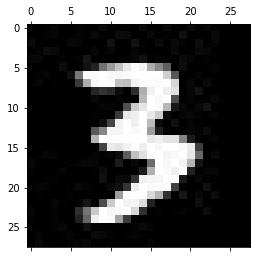

-------------------------------------------
Test: 1718
Predicted: 7


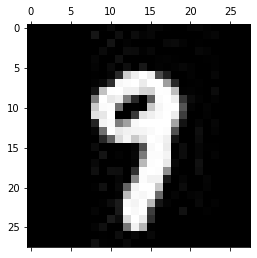

-------------------------------------------
Test: 1719
Predicted: 1


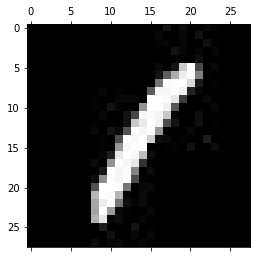

-------------------------------------------
Test: 1720
Predicted: 2


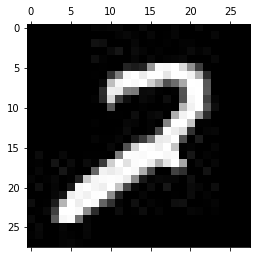

-------------------------------------------
Test: 1721
Predicted: 1


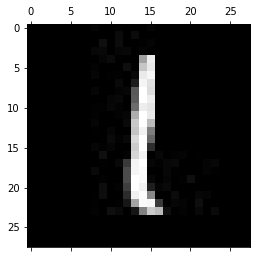

-------------------------------------------
Test: 1722
Predicted: 9


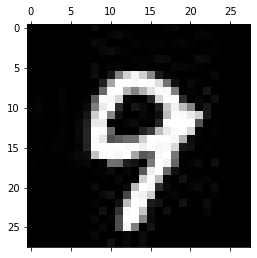

-------------------------------------------
Test: 1723
Predicted: 5


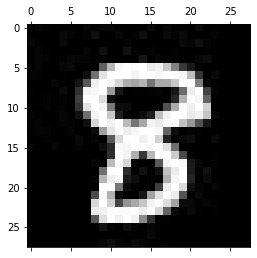

-------------------------------------------
Test: 1724
Predicted: 0


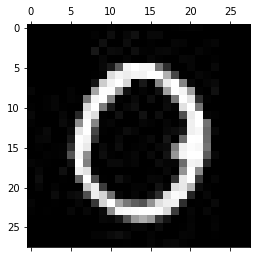

-------------------------------------------
Test: 1725
Predicted: 0


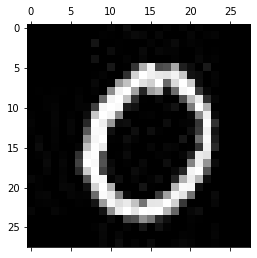

-------------------------------------------
Test: 1726
Predicted: 5


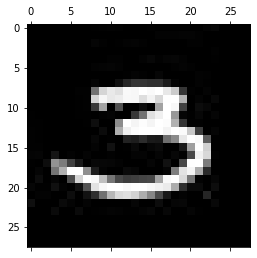

-------------------------------------------
Test: 1727
Predicted: 0


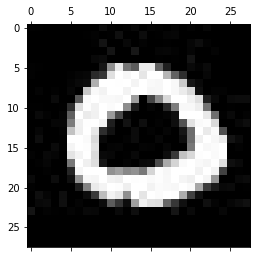

-------------------------------------------
Test: 1728
Predicted: 4


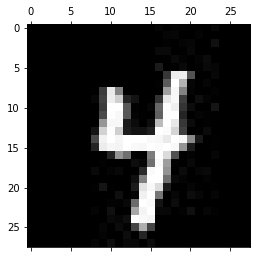

-------------------------------------------
Test: 1729
Predicted: 6


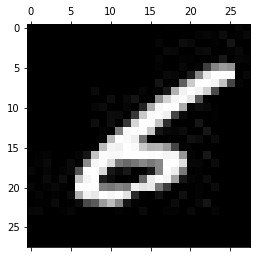

-------------------------------------------
Test: 1730
Predicted: 6


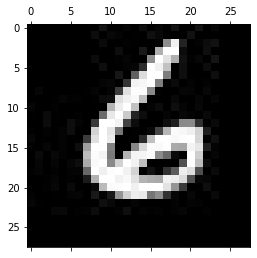

-------------------------------------------
Test: 1731
Predicted: 0


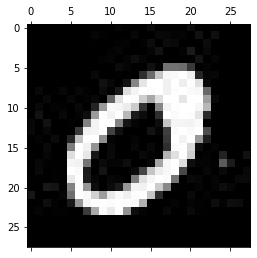

-------------------------------------------
Test: 1732
Predicted: 1


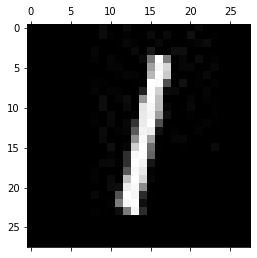

-------------------------------------------
Test: 1733
Predicted: 1


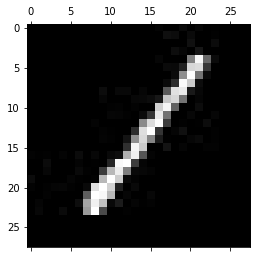

-------------------------------------------
Test: 1734
Predicted: 5


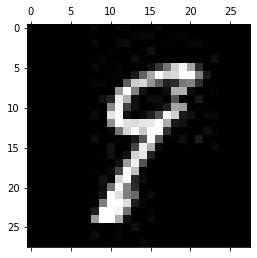

-------------------------------------------
Test: 1735
Predicted: 5


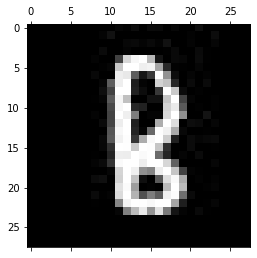

-------------------------------------------
Test: 1736
Predicted: 2


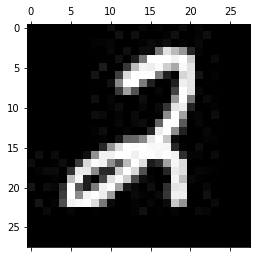

-------------------------------------------
Test: 1737
Predicted: 5


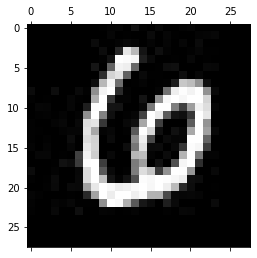

-------------------------------------------
Test: 1738
Predicted: 0


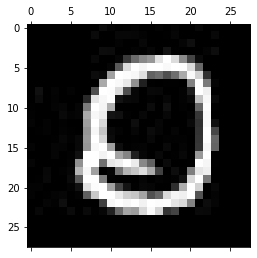

-------------------------------------------
Test: 1739
Predicted: 7


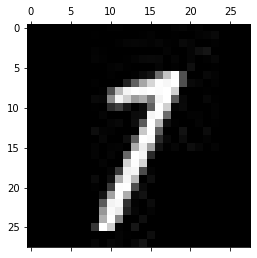

-------------------------------------------
Test: 1740
Predicted: 4


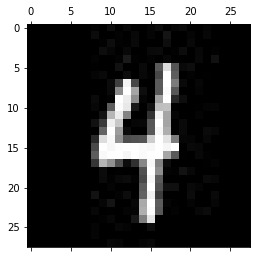

-------------------------------------------
Test: 1741
Predicted: 4


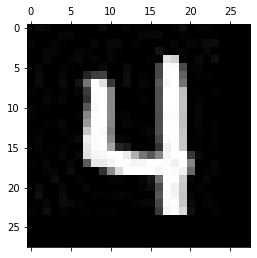

-------------------------------------------
Test: 1742
Predicted: 7


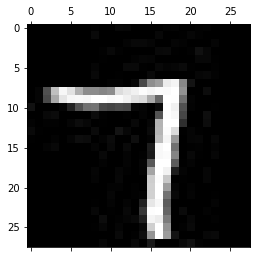

-------------------------------------------
Test: 1743
Predicted: 0


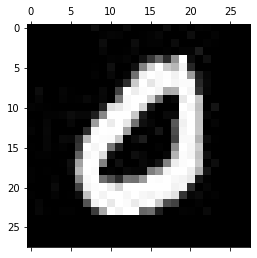

-------------------------------------------
Test: 1744
Predicted: 5


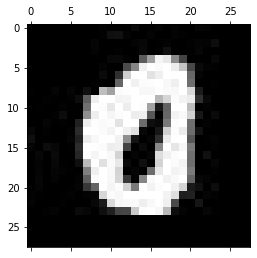

-------------------------------------------
Test: 1745
Predicted: 9


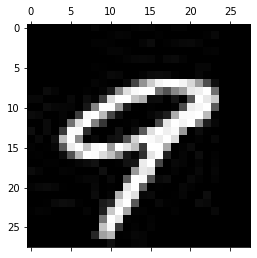

-------------------------------------------
Test: 1746
Predicted: 5


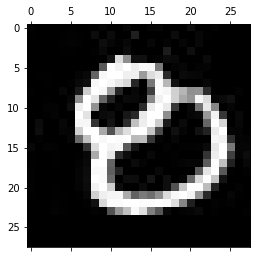

-------------------------------------------
Test: 1747
Predicted: 7


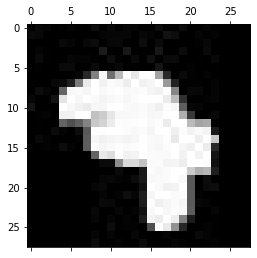

-------------------------------------------
Test: 1748
Predicted: 5


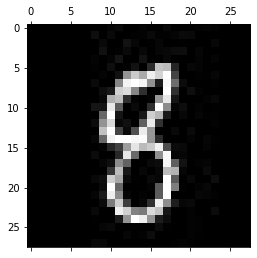

-------------------------------------------
Test: 1749
Predicted: 6


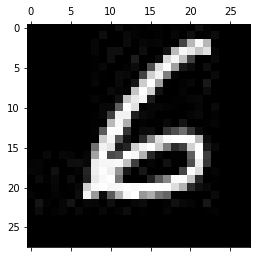

-------------------------------------------
Test: 1750
Predicted: 2


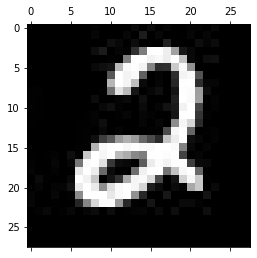

-------------------------------------------
Test: 1751
Predicted: 3


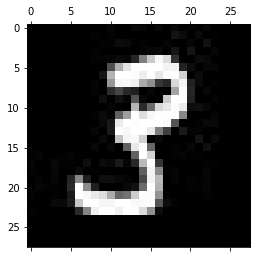

-------------------------------------------
Test: 1752
Predicted: 1


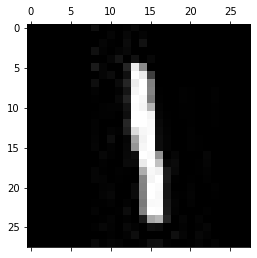

-------------------------------------------
Test: 1753
Predicted: 6


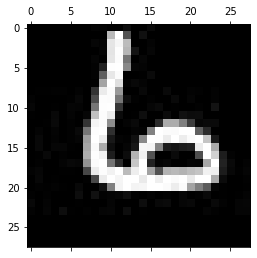

-------------------------------------------
Test: 1754
Predicted: 2


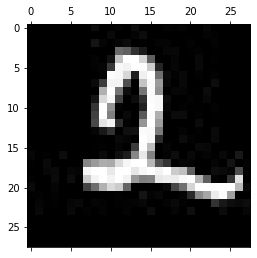

-------------------------------------------
Test: 1755
Predicted: 0


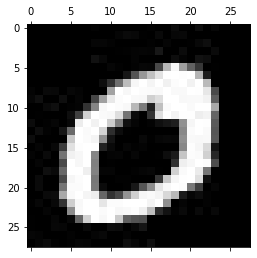

-------------------------------------------
Test: 1756
Predicted: 5


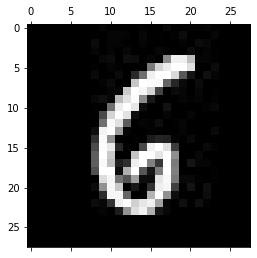

-------------------------------------------
Test: 1757
Predicted: 5


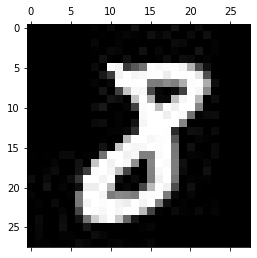

-------------------------------------------
Test: 1758
Predicted: 6


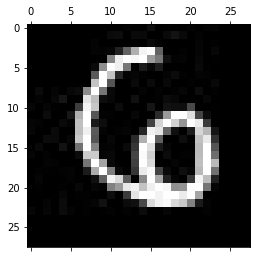

-------------------------------------------
Test: 1759
Predicted: 0


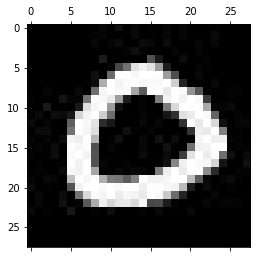

-------------------------------------------
Test: 1760
Predicted: 6


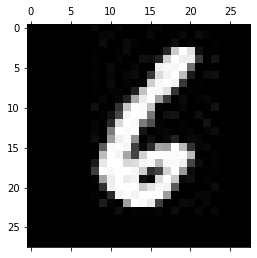

-------------------------------------------
Test: 1761
Predicted: 5


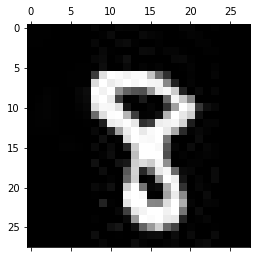

-------------------------------------------
Test: 1762
Predicted: 6


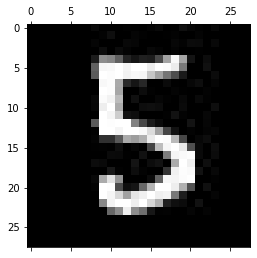

-------------------------------------------
Test: 1763
Predicted: 7


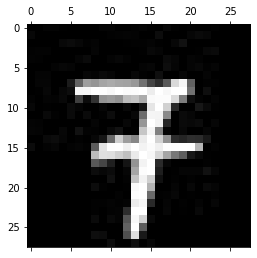

-------------------------------------------
Test: 1764
Predicted: 5


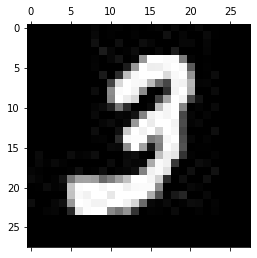

-------------------------------------------
Test: 1765
Predicted: 3


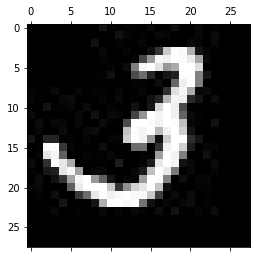

-------------------------------------------
Test: 1766
Predicted: 2


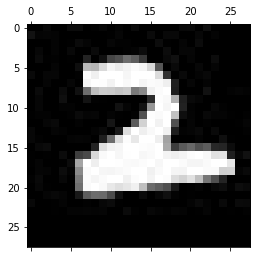

-------------------------------------------
Test: 1767
Predicted: 5


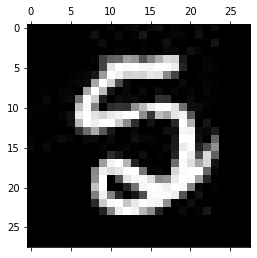

-------------------------------------------
Test: 1768
Predicted: 2


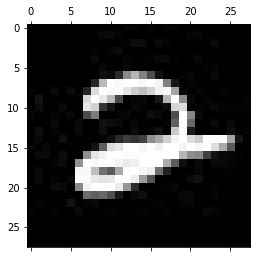

-------------------------------------------
Test: 1769
Predicted: 5


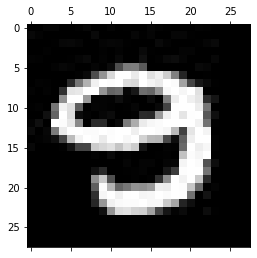

-------------------------------------------
Test: 1770
Predicted: 0


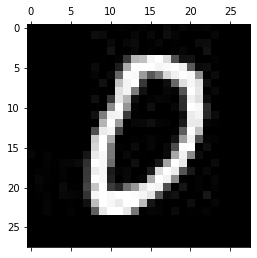

-------------------------------------------
Test: 1771
Predicted: 2


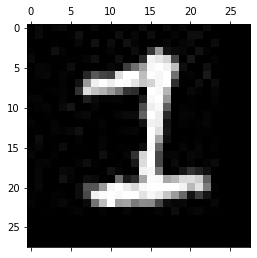

-------------------------------------------
Test: 1772
Predicted: 6


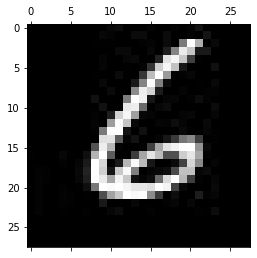

-------------------------------------------
Test: 1773
Predicted: 6


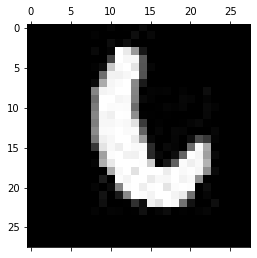

-------------------------------------------
Test: 1774
Predicted: 4


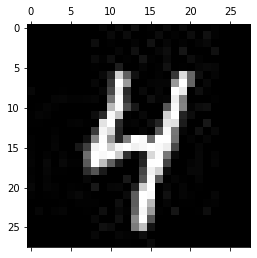

-------------------------------------------
Test: 1775
Predicted: 1


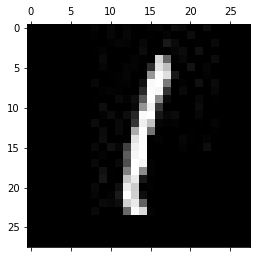

-------------------------------------------
Test: 1776
Predicted: 9


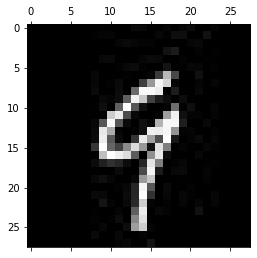

-------------------------------------------
Test: 1777
Predicted: 9


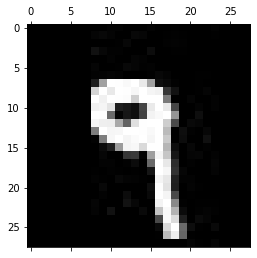

-------------------------------------------
Test: 1778
Predicted: 5


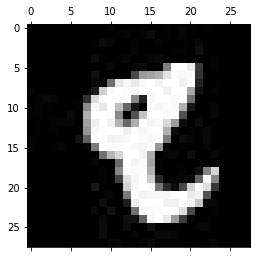

-------------------------------------------
Test: 1779
Predicted: 5


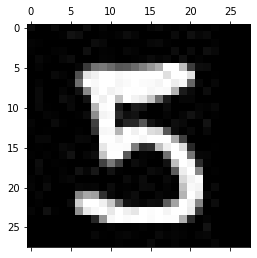

-------------------------------------------
Test: 1780
Predicted: 4


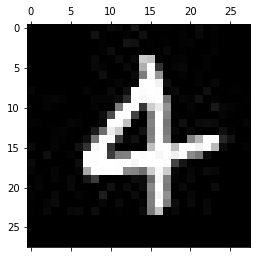

-------------------------------------------
Test: 1781
Predicted: 9


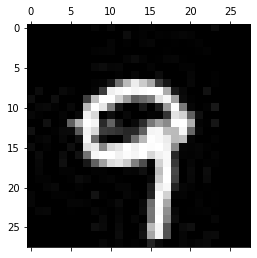

-------------------------------------------
Test: 1782
Predicted: 5


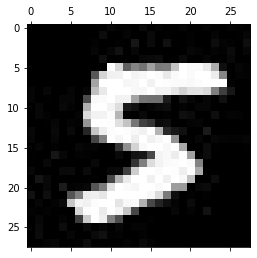

-------------------------------------------
Test: 1783
Predicted: 7


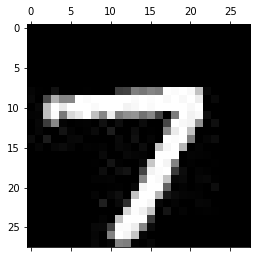

-------------------------------------------
Test: 1784
Predicted: 3


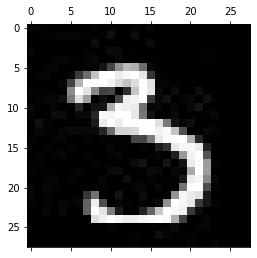

-------------------------------------------
Test: 1785
Predicted: 2


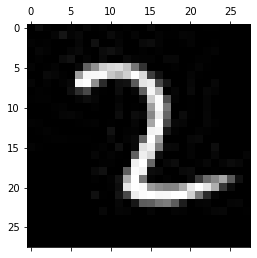

-------------------------------------------
Test: 1786
Predicted: 4


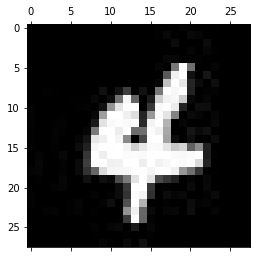

-------------------------------------------
Test: 1787
Predicted: 7


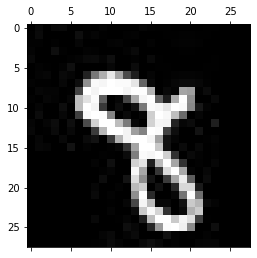

-------------------------------------------
Test: 1788
Predicted: 0


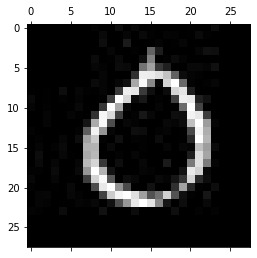

-------------------------------------------
Test: 1789
Predicted: 5


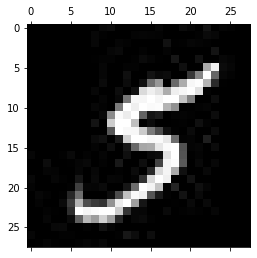

-------------------------------------------
Test: 1790
Predicted: 2


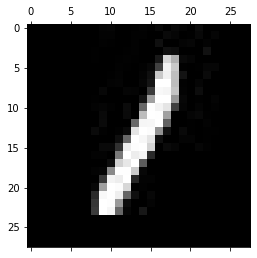

-------------------------------------------
Test: 1791
Predicted: 7


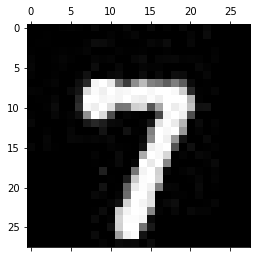

-------------------------------------------
Test: 1792
Predicted: 0


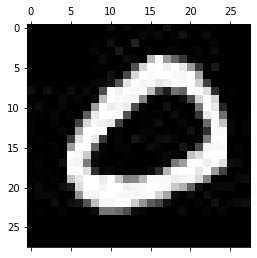

-------------------------------------------
Test: 1793
Predicted: 5


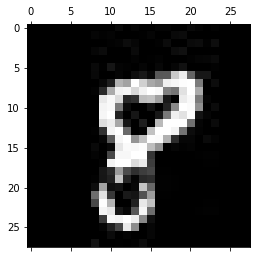

-------------------------------------------
Test: 1794
Predicted: 2


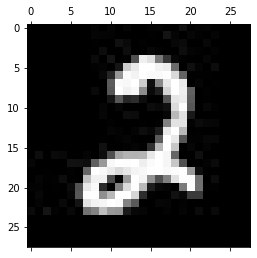

-------------------------------------------
Test: 1795
Predicted: 2


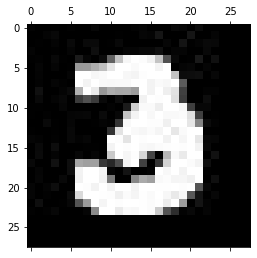

-------------------------------------------
Test: 1796
Predicted: 6


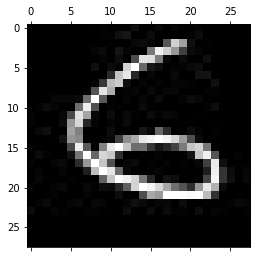

-------------------------------------------
Test: 1797
Predicted: 5


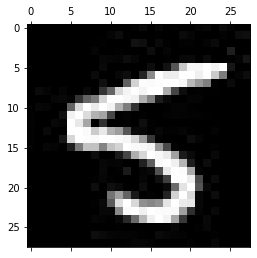

-------------------------------------------
Test: 1798
Predicted: 4


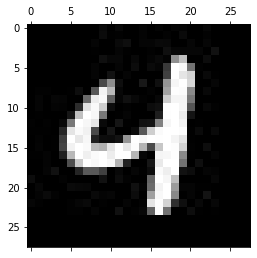

-------------------------------------------
Test: 1799
Predicted: 7


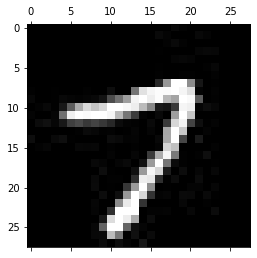

-------------------------------------------
Test: 1800
Predicted: 5


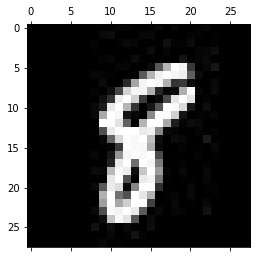

-------------------------------------------
Test: 1801
Predicted: 6


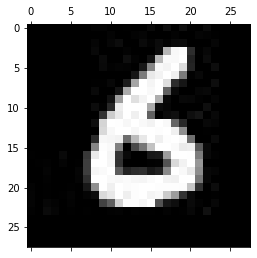

-------------------------------------------
Test: 1802
Predicted: 7


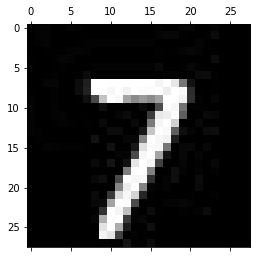

-------------------------------------------
Test: 1803
Predicted: 3


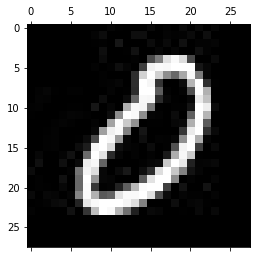

-------------------------------------------
Test: 1804
Predicted: 2


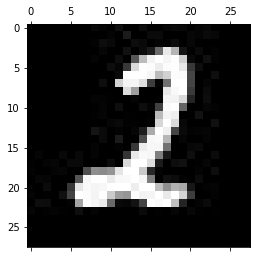

-------------------------------------------
Test: 1805
Predicted: 6


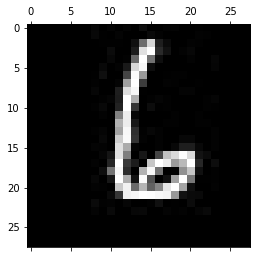

-------------------------------------------
Test: 1806
Predicted: 9


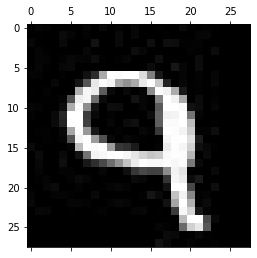

-------------------------------------------
Test: 1807
Predicted: 1


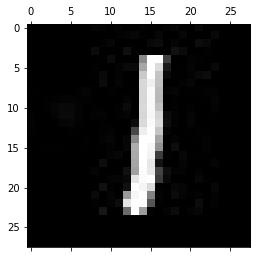

-------------------------------------------
Test: 1808
Predicted: 3


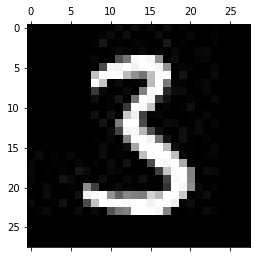

-------------------------------------------
Test: 1809
Predicted: 5


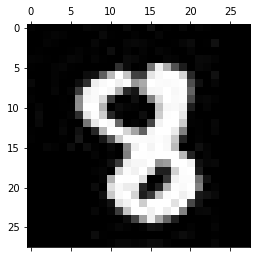

-------------------------------------------
Test: 1810
Predicted: 5


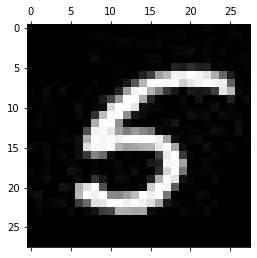

-------------------------------------------
Test: 1811
Predicted: 2


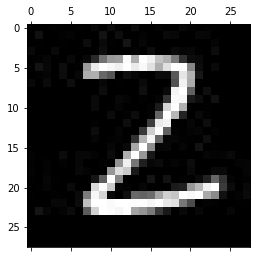

-------------------------------------------
Test: 1812
Predicted: 5


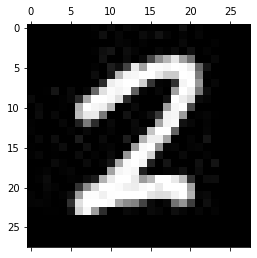

-------------------------------------------
Test: 1813
Predicted: 0


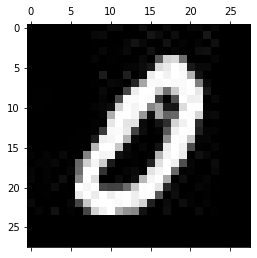

-------------------------------------------
Test: 1814
Predicted: 3


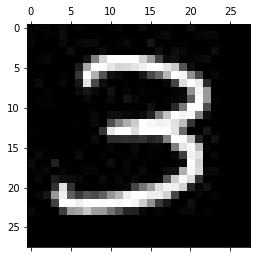

-------------------------------------------
Test: 1815
Predicted: 2


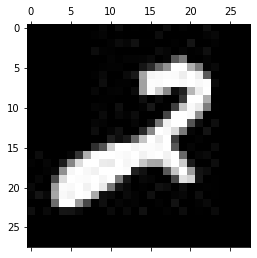

-------------------------------------------
Test: 1816
Predicted: 5


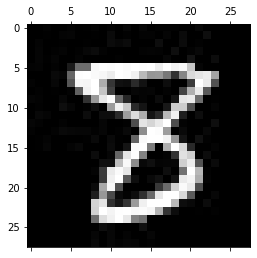

-------------------------------------------
Test: 1817
Predicted: 7


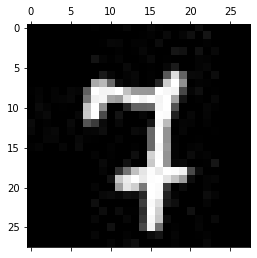

-------------------------------------------
Test: 1818
Predicted: 5


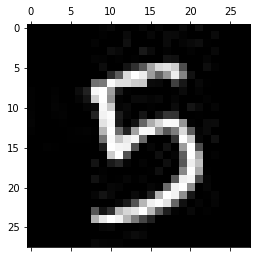

-------------------------------------------
Test: 1819
Predicted: 3


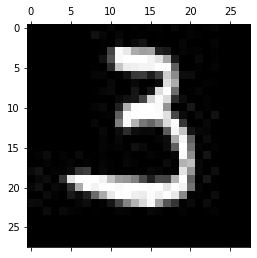

-------------------------------------------
Test: 1820
Predicted: 3


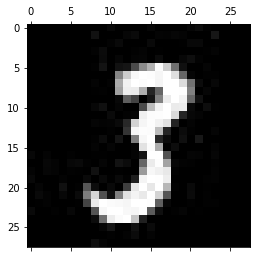

-------------------------------------------
Test: 1821
Predicted: 6


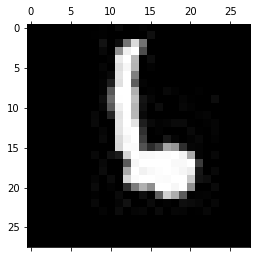

-------------------------------------------
Test: 1822
Predicted: 1


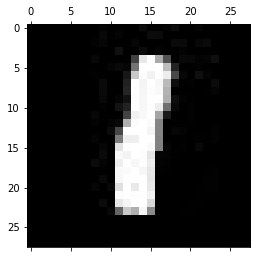

-------------------------------------------
Test: 1823
Predicted: 9


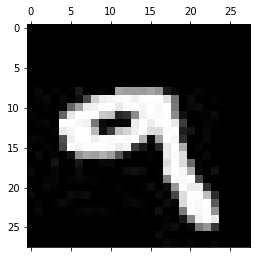

-------------------------------------------
Test: 1824
Predicted: 0


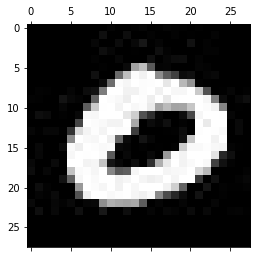

-------------------------------------------
Test: 1825
Predicted: 7


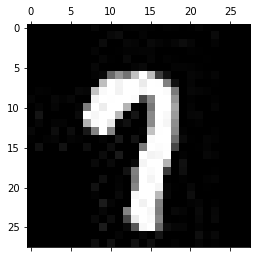

-------------------------------------------
Test: 1826
Predicted: 7


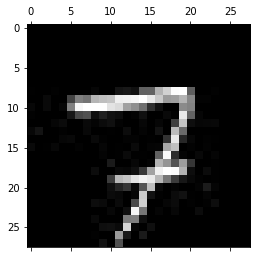

-------------------------------------------
Test: 1827
Predicted: 0


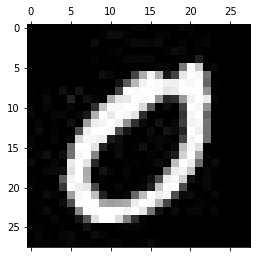

-------------------------------------------
Test: 1828
Predicted: 2


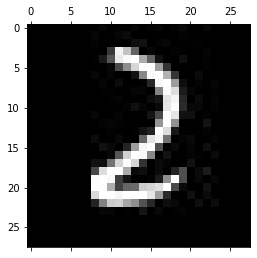

-------------------------------------------
Test: 1829
Predicted: 6


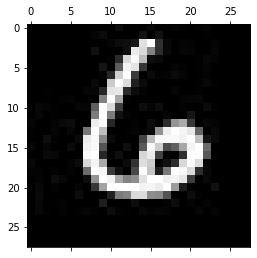

-------------------------------------------
Test: 1830
Predicted: 5


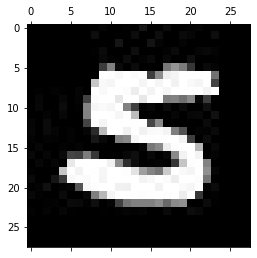

-------------------------------------------
Test: 1831
Predicted: 4


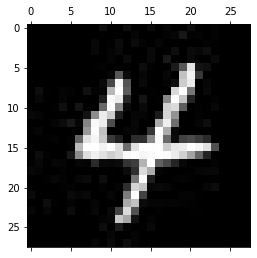

-------------------------------------------
Test: 1832
Predicted: 1


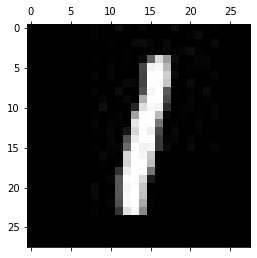

-------------------------------------------
Test: 1833
Predicted: 3


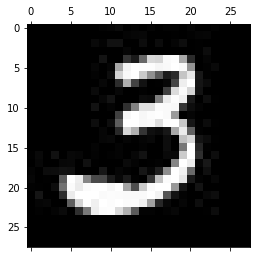

-------------------------------------------
Test: 1834
Predicted: 1


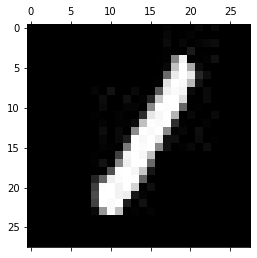

-------------------------------------------
Test: 1835
Predicted: 3


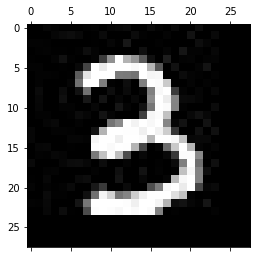

-------------------------------------------
Test: 1836
Predicted: 1


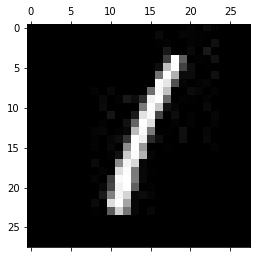

-------------------------------------------
Test: 1837
Predicted: 9


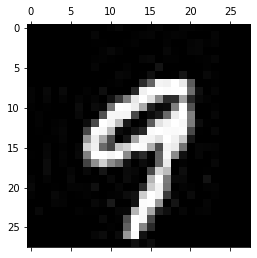

-------------------------------------------
Test: 1838
Predicted: 6


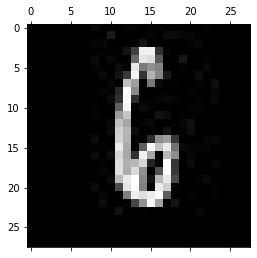

-------------------------------------------
Test: 1839
Predicted: 5


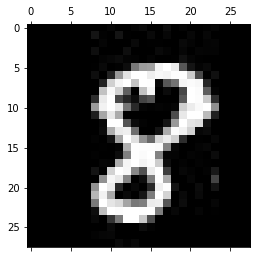

-------------------------------------------
Test: 1840
Predicted: 0


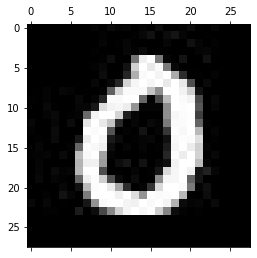

-------------------------------------------
Test: 1841
Predicted: 6


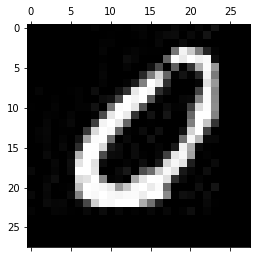

-------------------------------------------
Test: 1842
Predicted: 3


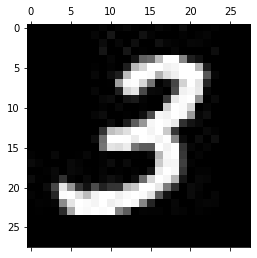

-------------------------------------------
Test: 1843
Predicted: 7


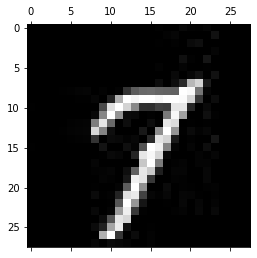

-------------------------------------------
Test: 1844
Predicted: 1


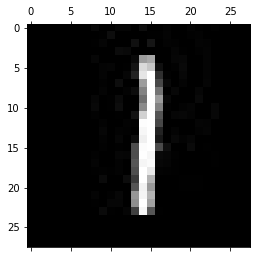

-------------------------------------------
Test: 1845
Predicted: 2


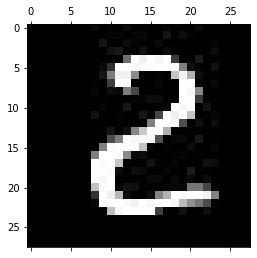

-------------------------------------------
Test: 1846
Predicted: 7


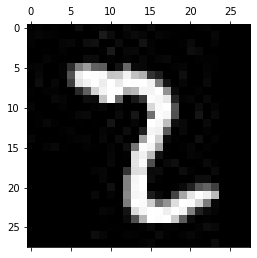

-------------------------------------------
Test: 1847
Predicted: 0


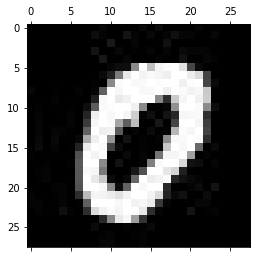

-------------------------------------------
Test: 1848
Predicted: 9


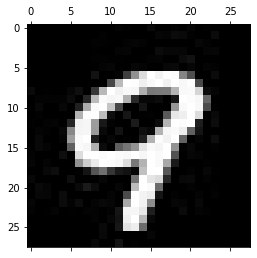

-------------------------------------------
Test: 1849
Predicted: 0


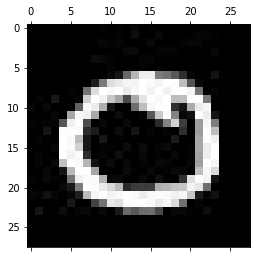

-------------------------------------------
Test: 1850
Predicted: 2


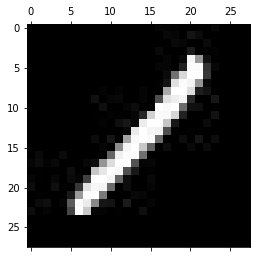

-------------------------------------------
Test: 1851
Predicted: 3


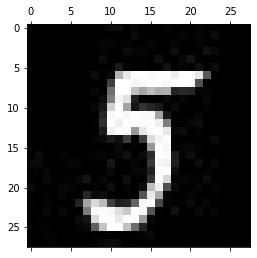

-------------------------------------------
Test: 1852
Predicted: 1


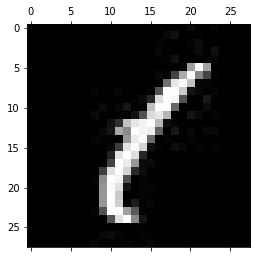

-------------------------------------------
Test: 1853
Predicted: 6


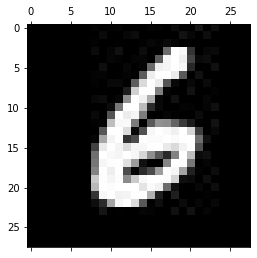

-------------------------------------------
Test: 1854
Predicted: 2


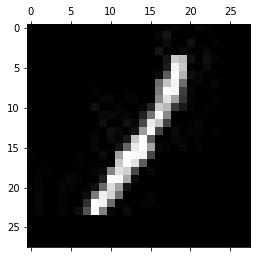

-------------------------------------------
Test: 1855
Predicted: 2


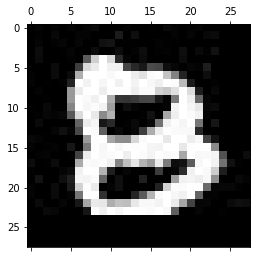

-------------------------------------------
Test: 1856
Predicted: 9


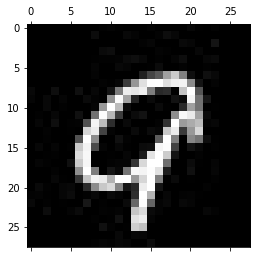

-------------------------------------------
Test: 1857
Predicted: 2


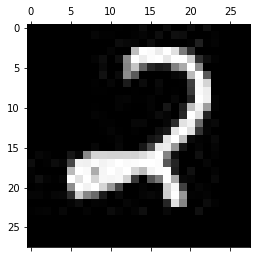

-------------------------------------------
Test: 1858
Predicted: 9


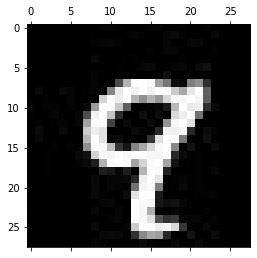

-------------------------------------------
Test: 1859
Predicted: 1


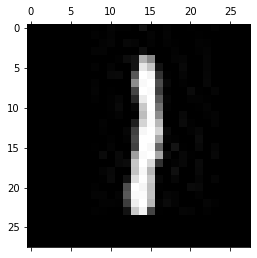

-------------------------------------------
Test: 1860
Predicted: 5


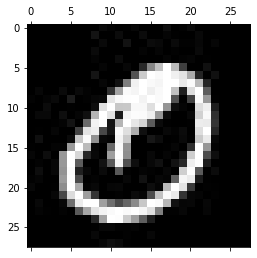

-------------------------------------------
Test: 1861
Predicted: 1


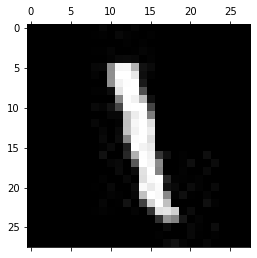

-------------------------------------------
Test: 1862
Predicted: 9


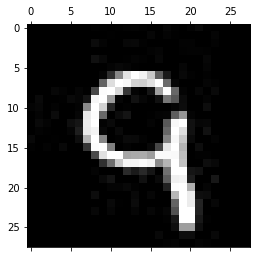

-------------------------------------------
Test: 1863
Predicted: 6


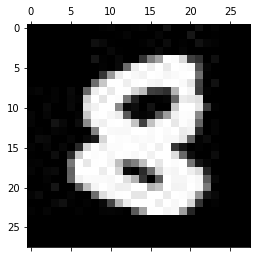

-------------------------------------------
Test: 1864
Predicted: 9


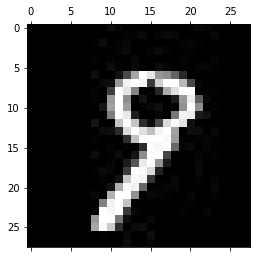

-------------------------------------------
Test: 1865
Predicted: 5


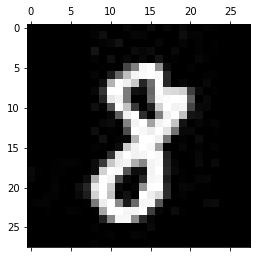

-------------------------------------------
Test: 1866
Predicted: 0


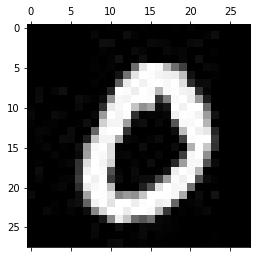

-------------------------------------------
Test: 1867
Predicted: 5


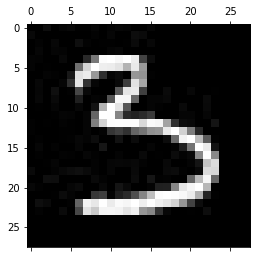

-------------------------------------------
Test: 1868
Predicted: 2


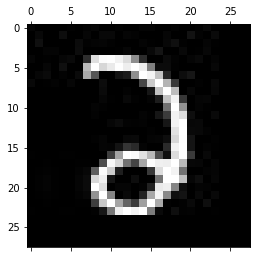

-------------------------------------------
Test: 1869
Predicted: 1


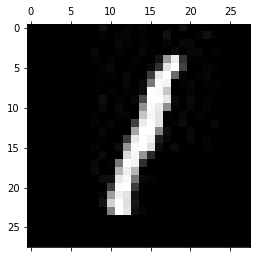

-------------------------------------------
Test: 1870
Predicted: 0


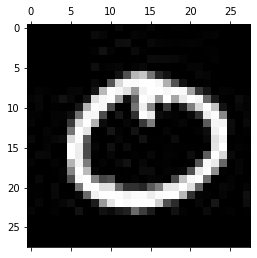

-------------------------------------------
Test: 1871
Predicted: 6


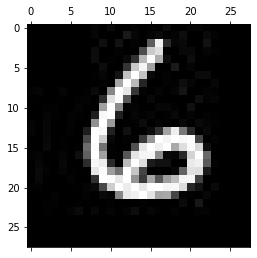

-------------------------------------------
Test: 1872
Predicted: 5


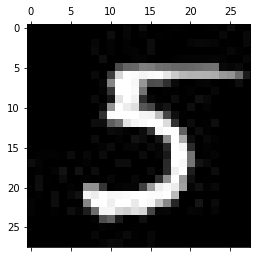

-------------------------------------------
Test: 1873
Predicted: 2


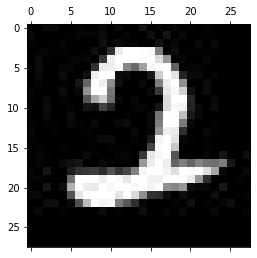

-------------------------------------------
Test: 1874
Predicted: 5


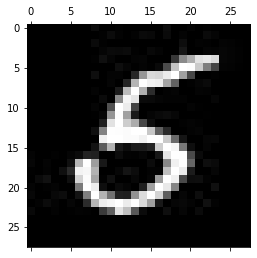

-------------------------------------------
Test: 1875
Predicted: 3


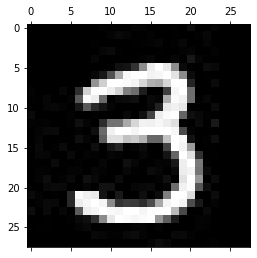

-------------------------------------------
Test: 1876
Predicted: 1


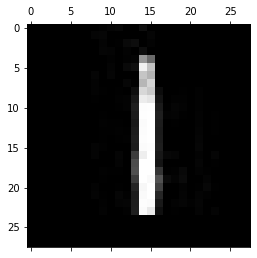

-------------------------------------------
Test: 1877
Predicted: 4


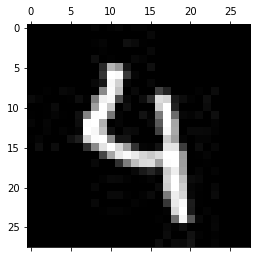

-------------------------------------------
Test: 1878
Predicted: 0


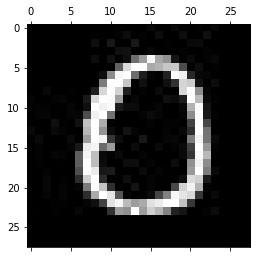

-------------------------------------------
Test: 1879
Predicted: 3


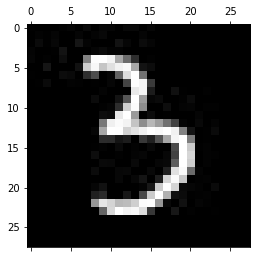

-------------------------------------------
Test: 1880
Predicted: 2


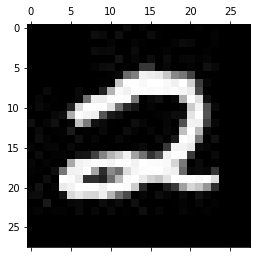

-------------------------------------------
Test: 1881
Predicted: 5


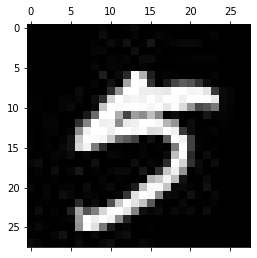

-------------------------------------------
Test: 1882
Predicted: 9


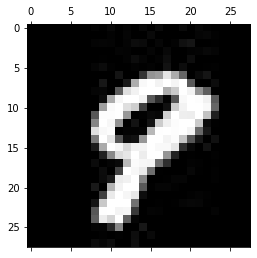

-------------------------------------------
Test: 1883
Predicted: 4


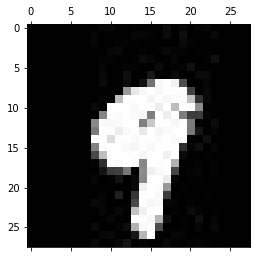

-------------------------------------------
Test: 1884
Predicted: 7


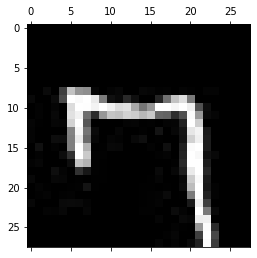

-------------------------------------------
Test: 1885
Predicted: 1


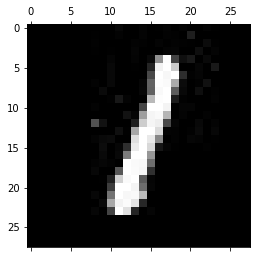

-------------------------------------------
Test: 1886
Predicted: 9


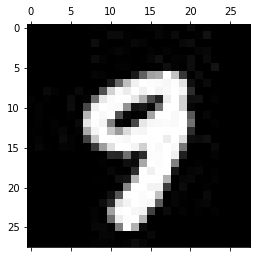

-------------------------------------------
Test: 1887
Predicted: 4


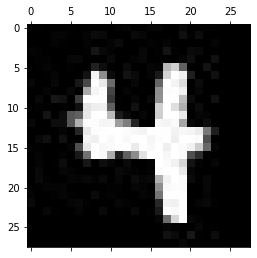

-------------------------------------------
Test: 1888
Predicted: 1


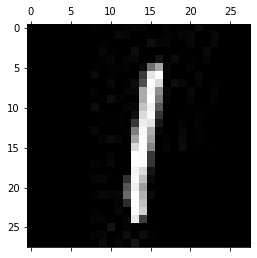

-------------------------------------------
Test: 1889
Predicted: 5


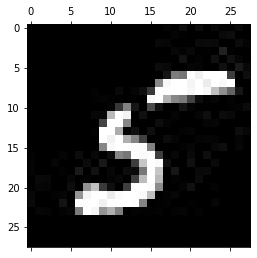

-------------------------------------------
Test: 1890
Predicted: 7


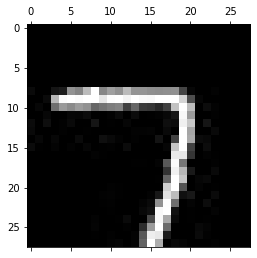

-------------------------------------------
Test: 1891
Predicted: 7


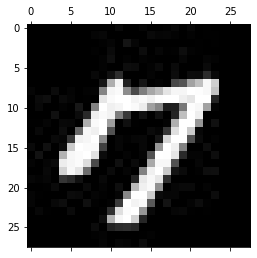

-------------------------------------------
Test: 1892
Predicted: 4


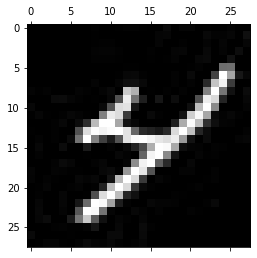

-------------------------------------------
Test: 1893
Predicted: 9


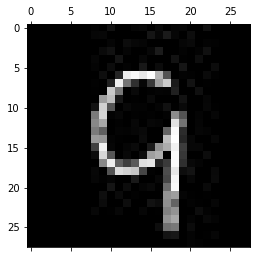

-------------------------------------------
Test: 1894
Predicted: 6


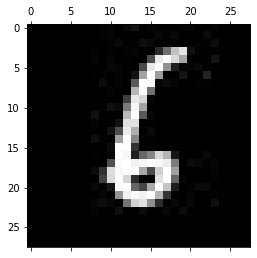

-------------------------------------------
Test: 1895
Predicted: 9


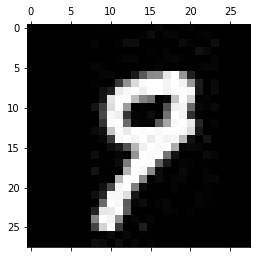

-------------------------------------------
Test: 1896
Predicted: 5


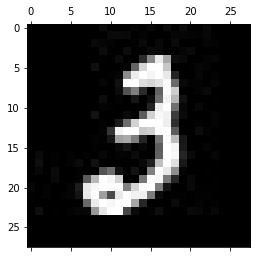

-------------------------------------------
Test: 1897
Predicted: 3


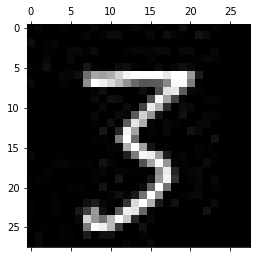

-------------------------------------------
Test: 1898
Predicted: 5


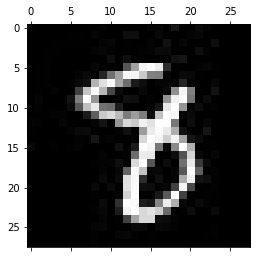

-------------------------------------------
Test: 1899
Predicted: 4


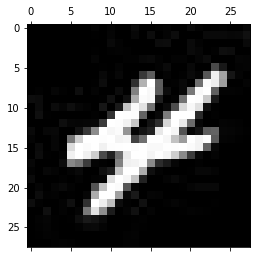

-------------------------------------------
Test: 1900
Predicted: 2


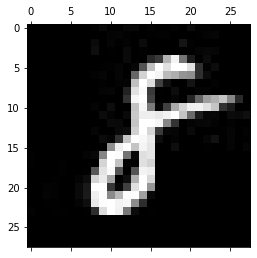

-------------------------------------------
Test: 1901
Predicted: 6


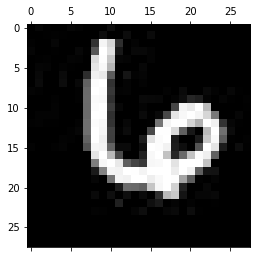

-------------------------------------------
Test: 1902
Predicted: 5


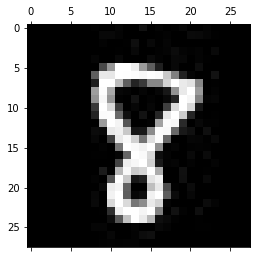

-------------------------------------------
Test: 1903
Predicted: 1


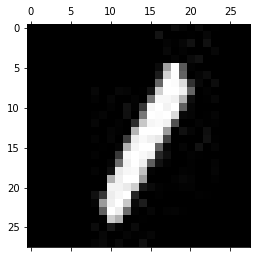

-------------------------------------------
Test: 1904
Predicted: 0


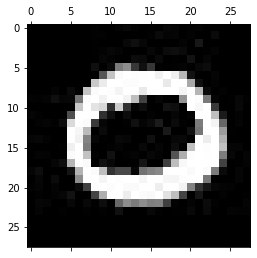

-------------------------------------------
Test: 1905
Predicted: 5


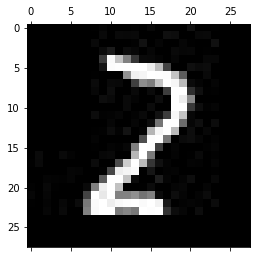

-------------------------------------------
Test: 1906
Predicted: 1


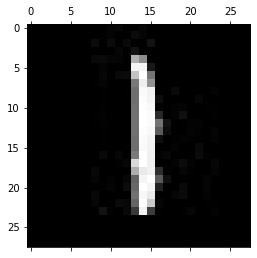

-------------------------------------------
Test: 1907
Predicted: 1


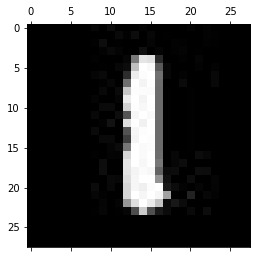

-------------------------------------------
Test: 1908
Predicted: 1


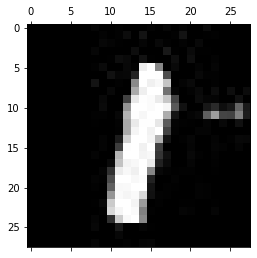

-------------------------------------------
Test: 1909
Predicted: 7


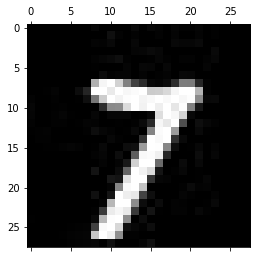

-------------------------------------------
Test: 1910
Predicted: 5


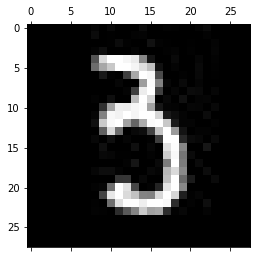

-------------------------------------------
Test: 1911
Predicted: 9


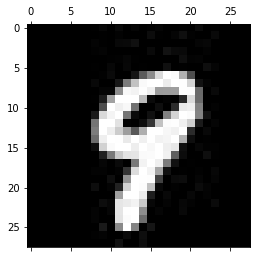

-------------------------------------------
Test: 1912
Predicted: 0


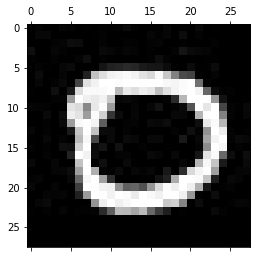

-------------------------------------------
Test: 1913
Predicted: 2


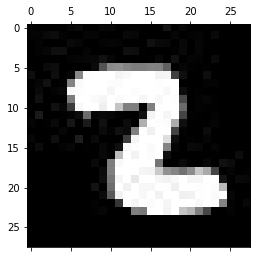

-------------------------------------------
Test: 1914
Predicted: 2


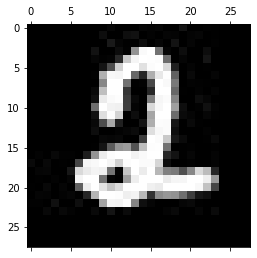

-------------------------------------------
Test: 1915
Predicted: 5


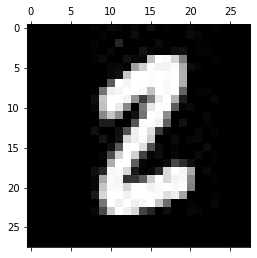

-------------------------------------------
Test: 1916
Predicted: 4


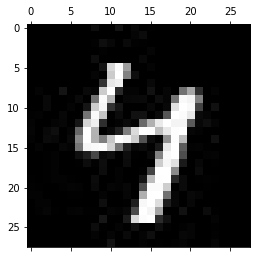

-------------------------------------------
Test: 1917
Predicted: 2


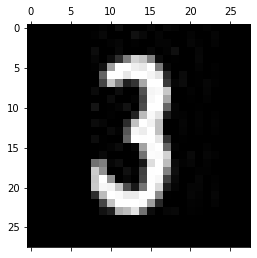

-------------------------------------------
Test: 1918
Predicted: 5


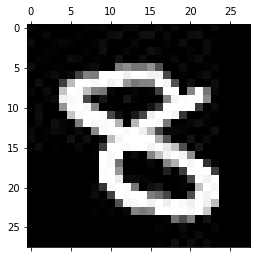

-------------------------------------------
Test: 1919
Predicted: 9


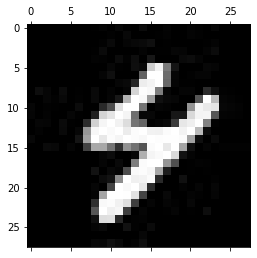

-------------------------------------------
Test: 1920
Predicted: 6


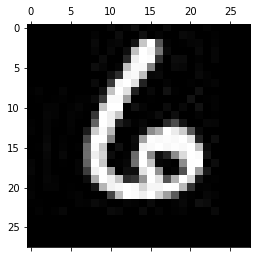

-------------------------------------------
Test: 1921
Predicted: 9


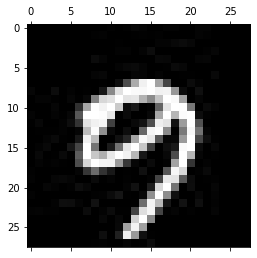

-------------------------------------------
Test: 1922
Predicted: 1


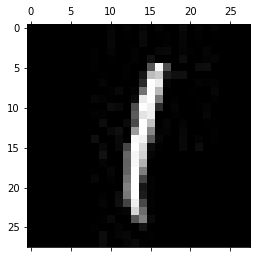

-------------------------------------------
Test: 1923
Predicted: 6


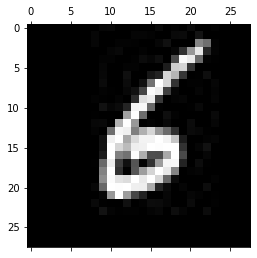

-------------------------------------------
Test: 1924
Predicted: 4


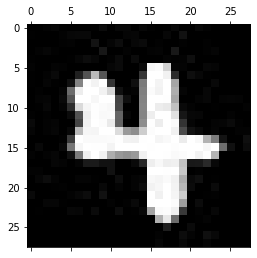

-------------------------------------------
Test: 1925
Predicted: 9


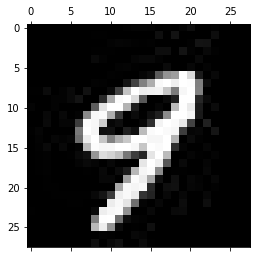

-------------------------------------------
Test: 1926
Predicted: 5


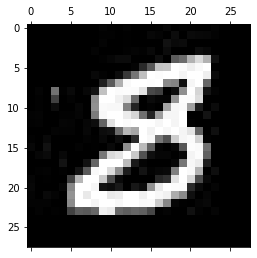

-------------------------------------------
Test: 1927
Predicted: 9


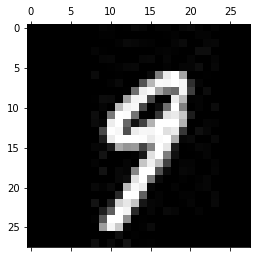

-------------------------------------------
Test: 1928
Predicted: 3


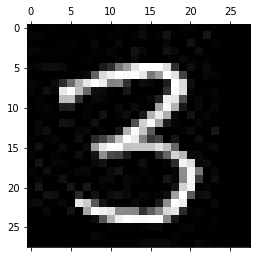

-------------------------------------------
Test: 1929
Predicted: 5


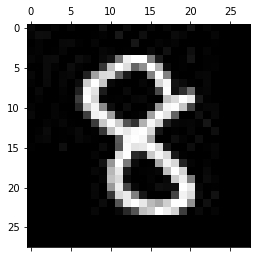

-------------------------------------------
Test: 1930
Predicted: 7


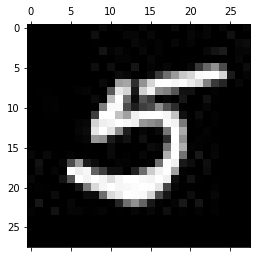

-------------------------------------------
Test: 1931
Predicted: 5


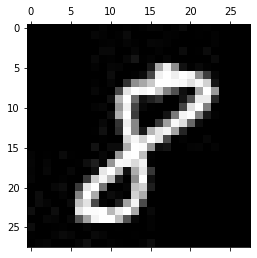

-------------------------------------------
Test: 1932
Predicted: 1


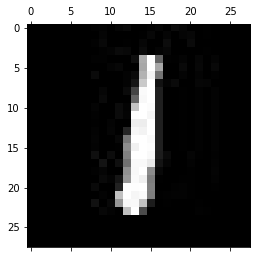

-------------------------------------------
Test: 1933
Predicted: 7


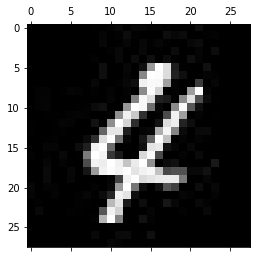

-------------------------------------------
Test: 1934
Predicted: 5


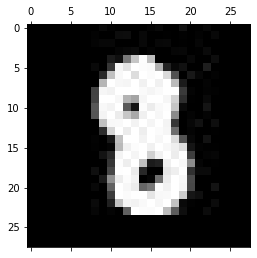

-------------------------------------------
Test: 1935
Predicted: 4


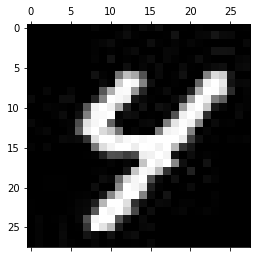

-------------------------------------------
Test: 1936
Predicted: 1


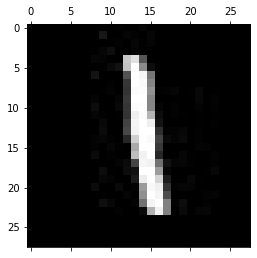

-------------------------------------------
Test: 1937
Predicted: 7


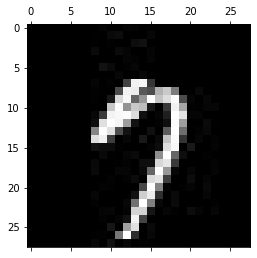

-------------------------------------------
Test: 1938
Predicted: 7


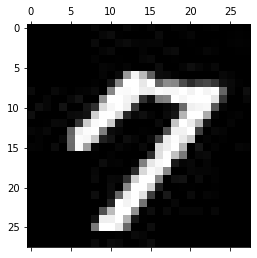

-------------------------------------------
Test: 1939
Predicted: 4


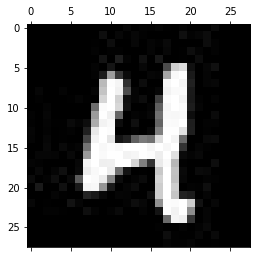

-------------------------------------------
Test: 1940
Predicted: 1


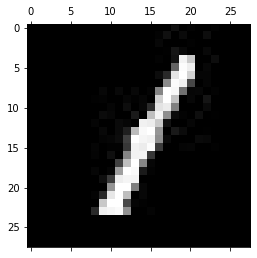

-------------------------------------------
Test: 1941
Predicted: 1


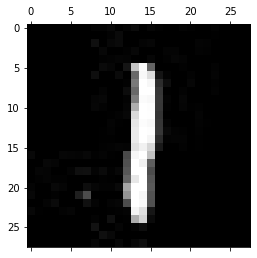

-------------------------------------------
Test: 1942
Predicted: 7


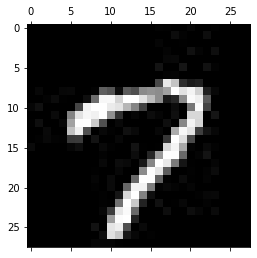

-------------------------------------------
Test: 1943
Predicted: 5


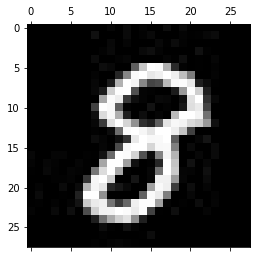

-------------------------------------------
Test: 1944
Predicted: 2


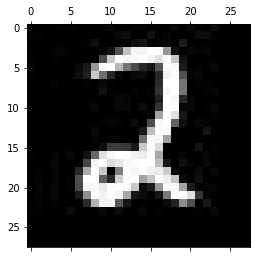

-------------------------------------------
Test: 1945
Predicted: 7


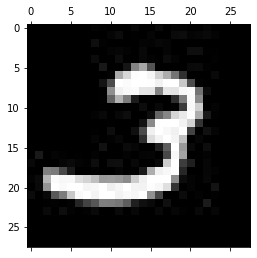

-------------------------------------------
Test: 1946
Predicted: 5


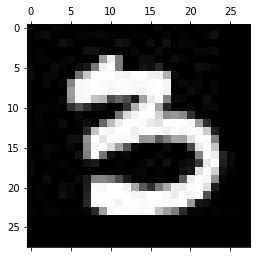

-------------------------------------------
Test: 1947
Predicted: 9


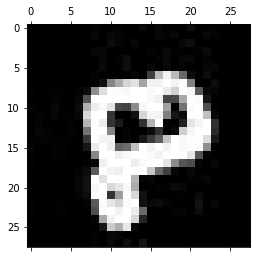

-------------------------------------------
Test: 1948
Predicted: 2


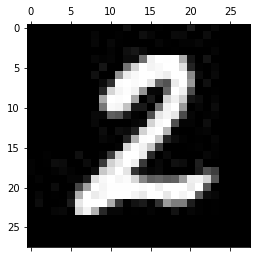

-------------------------------------------
Test: 1949
Predicted: 0


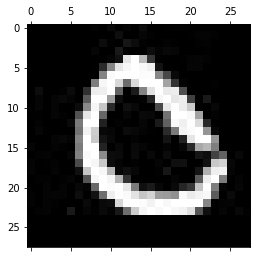

-------------------------------------------
Test: 1950
Predicted: 9


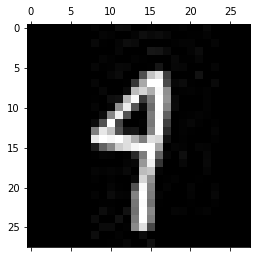

-------------------------------------------
Test: 1951
Predicted: 3


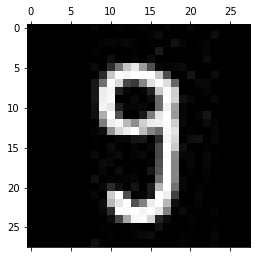

-------------------------------------------
Test: 1952
Predicted: 3


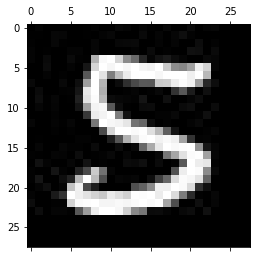

-------------------------------------------
Test: 1953
Predicted: 7


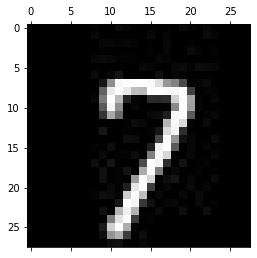

-------------------------------------------
Test: 1954
Predicted: 9


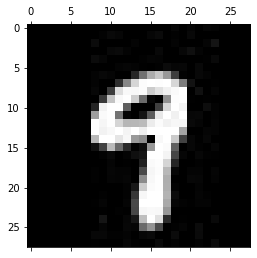

-------------------------------------------
Test: 1955
Predicted: 0


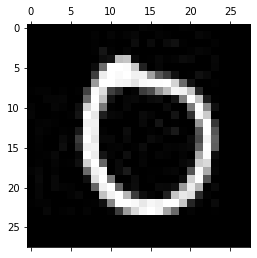

-------------------------------------------
Test: 1956
Predicted: 9


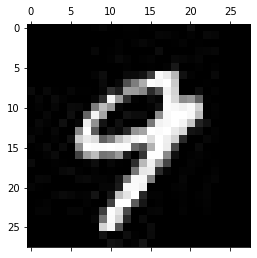

-------------------------------------------
Test: 1957
Predicted: 6


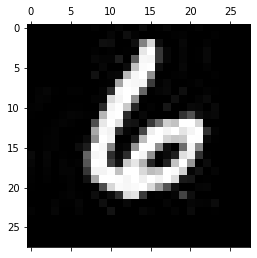

-------------------------------------------
Test: 1958
Predicted: 1


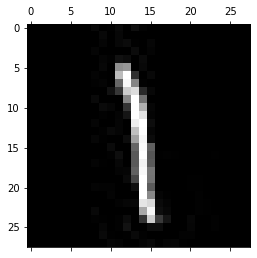

-------------------------------------------
Test: 1959
Predicted: 0


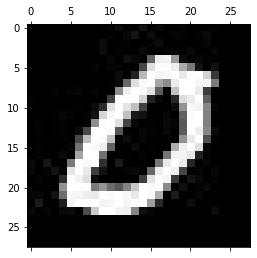

-------------------------------------------
Test: 1960
Predicted: 5


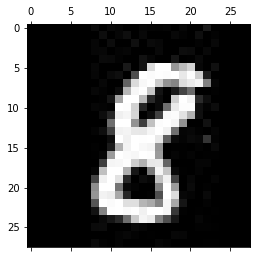

-------------------------------------------
Test: 1961
Predicted: 0


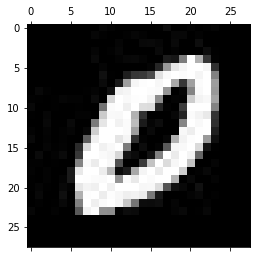

-------------------------------------------
Test: 1962
Predicted: 5


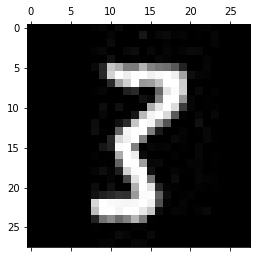

-------------------------------------------
Test: 1963
Predicted: 5


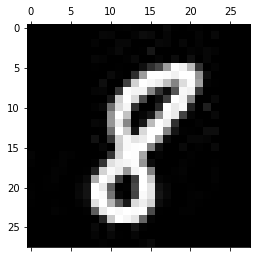

-------------------------------------------
Test: 1964
Predicted: 6


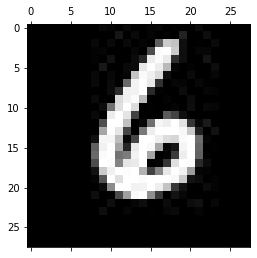

-------------------------------------------
Test: 1965
Predicted: 7


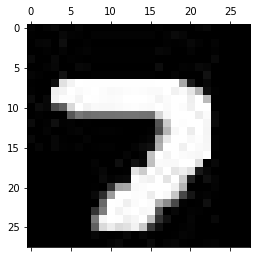

-------------------------------------------
Test: 1966
Predicted: 5


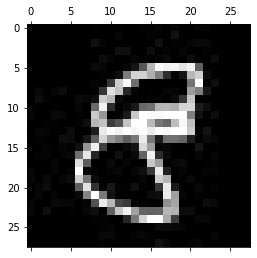

-------------------------------------------
Test: 1967
Predicted: 5


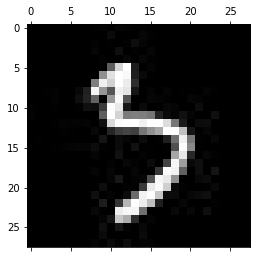

-------------------------------------------
Test: 1968
Predicted: 6


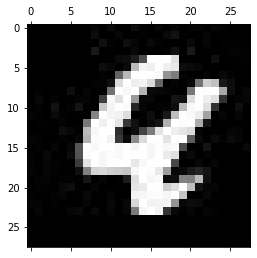

-------------------------------------------
Test: 1969
Predicted: 4


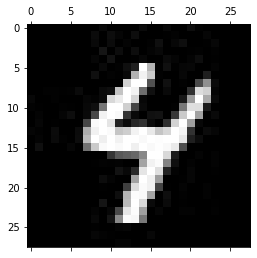

-------------------------------------------
Test: 1970
Predicted: 6


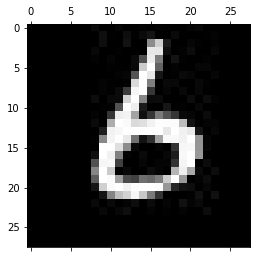

-------------------------------------------
Test: 1971
Predicted: 5


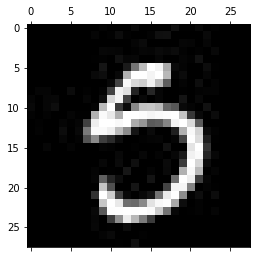

-------------------------------------------
Test: 1972
Predicted: 1


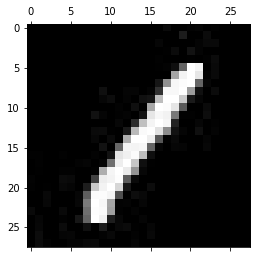

-------------------------------------------
Test: 1973
Predicted: 5


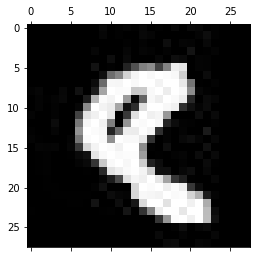

-------------------------------------------
Test: 1974
Predicted: 7


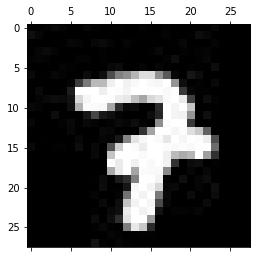

-------------------------------------------
Test: 1975
Predicted: 5


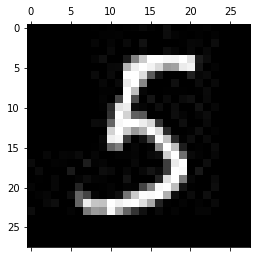

-------------------------------------------
Test: 1976
Predicted: 1


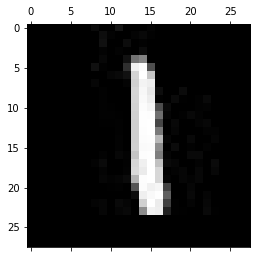

-------------------------------------------
Test: 1977
Predicted: 1


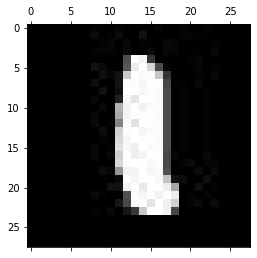

-------------------------------------------
Test: 1978
Predicted: 4


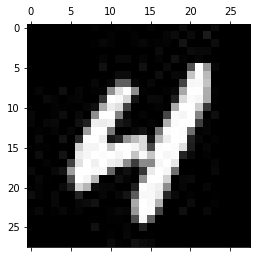

-------------------------------------------
Test: 1979
Predicted: 5


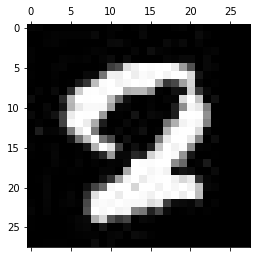

-------------------------------------------
Test: 1980
Predicted: 9


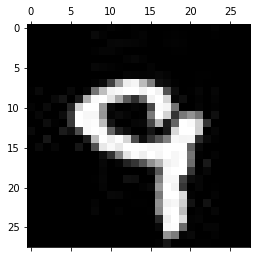

-------------------------------------------
Test: 1981
Predicted: 5


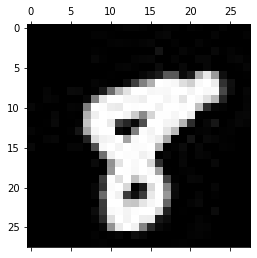

-------------------------------------------
Test: 1982
Predicted: 3


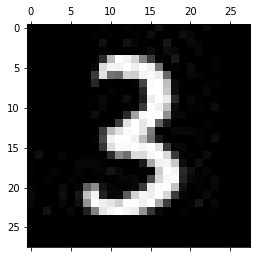

-------------------------------------------
Test: 1983
Predicted: 9


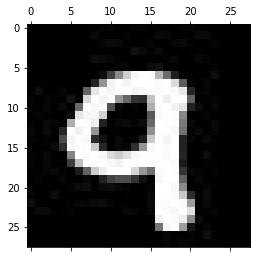

-------------------------------------------
Test: 1984
Predicted: 1


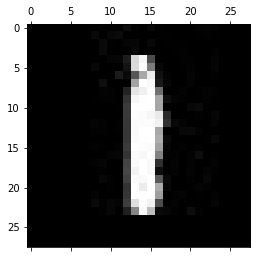

-------------------------------------------
Test: 1985
Predicted: 2


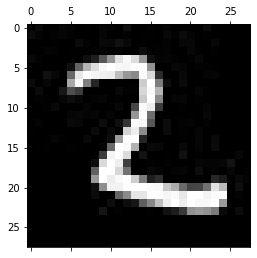

-------------------------------------------
Test: 1986
Predicted: 4


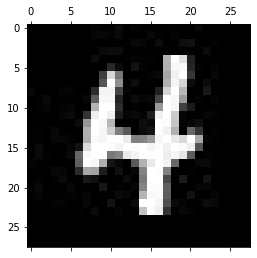

-------------------------------------------
Test: 1987
Predicted: 2


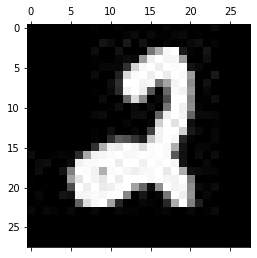

-------------------------------------------
Test: 1988
Predicted: 7


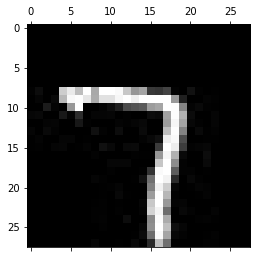

-------------------------------------------
Test: 1989
Predicted: 3


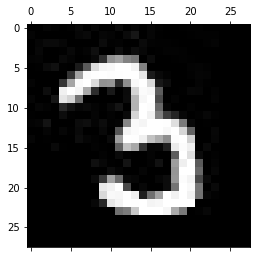

-------------------------------------------
Test: 1990
Predicted: 9


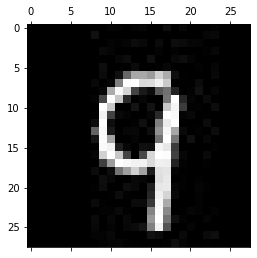

-------------------------------------------
Test: 1991
Predicted: 5


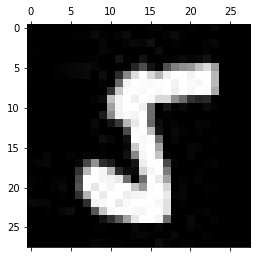

-------------------------------------------
Test: 1992
Predicted: 9


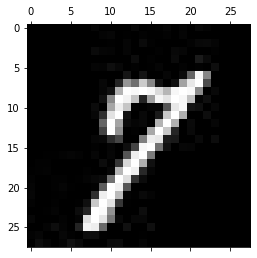

-------------------------------------------
Test: 1993
Predicted: 4


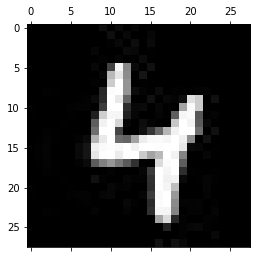

-------------------------------------------
Test: 1994
Predicted: 6


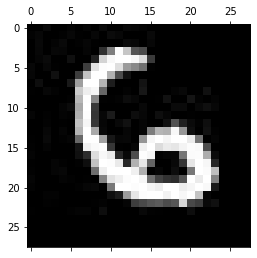

-------------------------------------------
Test: 1995
Predicted: 7


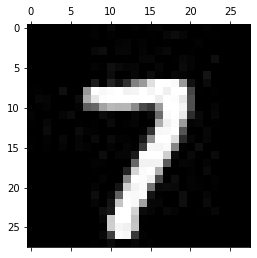

-------------------------------------------
Test: 1996
Predicted: 7


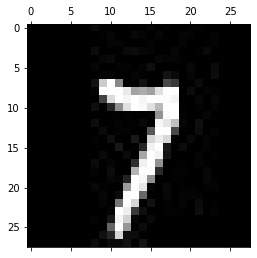

-------------------------------------------
Test: 1997
Predicted: 3


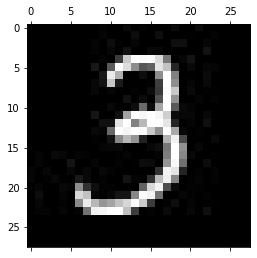

-------------------------------------------
Test: 1998
Predicted: 0


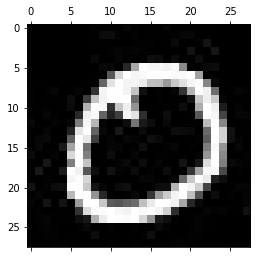

-------------------------------------------
Test: 1999
Predicted: 6


-------------------------------------------
Test: 2000
Predicted: 6


-------------------------------------------
Test Accuracy: 0.747999999999973


In [16]:
test(np.array(my_data_test), w1, w2, b1, b2)

#### Result  of using One hidden Layer ANN
Training Accuracy: 75%  
Test Accuracy: 74.7%

## Two Hidden Layer ANN

Here, Two Hidden Layer ANN is used to check if we can boost our accuracy.


<div> 
<img src=attachment:image.png width=450>
</div>

### Weight Initialization

In [21]:
'''
Input: 784
HiddenLayer_1: 40
HiddenLayer_2: 20
Output: 10
'''
num_features = 784
HiddenLayer_1 =  40
HiddenLayer_2 = 20
HiddenLayer_3 = 10
# Output: 10
def weight_initialize2(mode):
    if mode=="random":
        w1 = np.random.random((HiddenLayer_1,   num_features))
        w2 = np.random.random((HiddenLayer_2, HiddenLayer_1))
        w3 = np.random.random((HiddenLayer_3, HiddenLayer_2))
        b1 = np.random.random((1, HiddenLayer_1))
        b2 =  np.random.random((1, HiddenLayer_2))
        b3 =  np.random.random((1, HiddenLayer_3))
    elif mode=="xavierNormal":
        w1 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_1+num_features)), size = (HiddenLayer_1,num_features)).astype(np.float32)
        w2 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_1+HiddenLayer_2)), size = (HiddenLayer_2, HiddenLayer_1)).astype(np.float32)
        w3 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_2+HiddenLayer_3)), size = (HiddenLayer_3, HiddenLayer_2)).astype(np.float32)
        b1 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_1)), size = (1,40)).astype(np.float32)
        b2 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_2)), size = (1,20)).astype(np.float32)
        b3 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_3)), size = (1,10)).astype(np.float32)
    elif mode=="xavierUniform":
        w1 = np.random.uniform(low=-np.sqrt(6/(HiddenLayer_1+num_features)), high = np.sqrt(6/(HiddenLayer_1+num_features)), size = (40,784)).astype(np.float32)
        w2 = np.random.uniform(low=-np.sqrt(6/(HiddenLayer_2+HiddenLayer_1)), high = np.sqrt(6/(HiddenLayer_2+HiddenLayer_1)), size = (20,32)).astype(np.float32)
        w2 = np.random.uniform(low=-np.sqrt(6/(HiddenLayer_2+HiddenLayer_3)), high = np.sqrt(6/(HiddenLayer_3+HiddenLayer_2)), size = (10,20)).astype(np.float32)
        b1 = np.random.uniform(low=-np.sqrt(6/(HiddenLayer_1+1)), high = np.sqrt(6/(HiddenLayer_1+1)), size = (1,40)).astype(np.float32)
        b2 = np.random.uniform(low=-np.sqrt(6/(1+HiddenLayer_2)), high = np.sqrt(6/(1+HiddenLayer_2)), size = (1,20)).astype(np.float32)
        b3 = np.random.uniform(low=-np.sqrt(6/(1+HiddenLayer_3)), high = np.sqrt(6/(1+HiddenLayer_3)), size = (1,10)).astype(np.float32)
        
    else: 
        w1 = np.full(shape=(HiddenLayer_1,   num_features), fill_value=0, dtype=np.float64)
        w2 = np.full(shape=(HiddenLayer_2, HiddenLayer_1), fill_value=0, dtype=np.float64)
        w3 = np.full(shape=(HiddenLayer_3, HiddenLayer_2), fill_value=0, dtype=np.float64)
        b1 = np.full(shape=(1, HiddenLayer_1), fill_value=0, dtype=np.float64)
        b2 = np.full(shape=(1, HiddenLayer_2), fill_value=0, dtype=np.float64)
        b3 = np.full(shape=(1, HiddenLayer_3), fill_value=0, dtype=np.float64)
    return w1, w2,w3, b1, b2, b3

### Forward and Backward Propagation

In [22]:
       
lossArray = []
accArray = []
def forward2(arr,  weight1, weight2, weight3, bias1, bias2, bias3, learningRate=0.01, epochs=100):
    for epoch in range(epochs):
        acc = 0
        loss = 0
        for index in range(len(arr)):
            inputs, output = preprocess(arr[index])
            intermediate1 = np.matmul(inputs, weight1.T) + bias1
            hiddenOutput1 = sigmoid(intermediate1)
            intermediate2 = np.matmul(hiddenOutput1, weight2.T) + bias2
            hiddenOutput2 = sigmoid(intermediate2) 
#             print(inputs, weight3)
            intermediate3 = np.matmul(hiddenOutput2, weight3.T) + bias3
            output_pred = softmax(intermediate3)
            check = np.argmax(output_pred)
            output_arr = generateArray(output)
            acc = acc + accuracy(output, check, len(arr))
            loss = loss - catCrossEntropy(output, output_pred)
#             print(outputClass)
#             print(f"Observation: {index+1} => Actual: {output} || Predicted: {check}")
            db3 = (output_pred - output_arr)
#             print(outputClass.shape) #1, 10
#             print(db2.shape)  # 1 * 10
#             print(hiddenOutput1.shape) # 1 * 15
            dw3 = np.matmul(db3.T, hiddenOutput2)
#             print(dw2.shape)  # 10* 15
#             print(weight2.shape) # 10 * 15
            db2_2 = np.matmul(np.matmul(db3, weight3).T, hiddenOutput2)
#             print(db1_1.shape) # 1,1
            db2 = np.matmul(db2_2, (1-hiddenOutput2).T)
#             print(db1.shape) # 1, 15
            dw2 = np.matmul(db2, hiddenOutput1)
#             print(hiddenOutput1.shape, (np.matmul(db2, weight2).T).shape)
#             print(db2.T.shape, weight2.shape)
            db1_1 = np.matmul(np.matmul(db2.T, weight2).T, hiddenOutput1)
#             print(db1_1.shape, hiddenOutput1.shape )
            db1 = np.matmul(db1_1, (1-hiddenOutput1).T)
#             print(db1.shape) # 1, 15
#             db1 = np.matmul(np.matmul(db1, hiddenOutput1), (1 - hiddenOutput1))

            dw1 = np.matmul(db1, inputs)
            weight1 = weight1 - learningRate * dw1
            bias1 = bias1 - learningRate * db1.T
            weight2 = weight2 - learningRate * dw2
            bias2 = bias2 - learningRate * db2.T
            weight3 = weight3 - learningRate * dw3
            bias3 = bias3 - learningRate * db3
        lossArray.append(loss)
        accArray.append(acc)
        print(f"Epoch: {epoch+1}")
        print(f"Accuracy: {acc} and Loss: {loss}")
        print('-------------------------------------------------------------')
    return weight1, weight2, weight3, bias1, bias2, bias3

### Training 

In [20]:
weight1, weight2, weight3, bias1, bias2, bias3 = weight_initialize2(mode="xavierNormal")
w1, w2, w3, b1, b2, b3= forward2(my_data_train, weight1, weight2, weight3, bias1, bias2, bias3, learningRate=0.01, epochs=10)

Epoch: 1
Accuracy: 0.8219500000006285 and Loss: 23982.515240789402
-------------------------------------------------------------
Epoch: 2
Accuracy: 0.8783750000007475 and Loss: 16527.533047387373
-------------------------------------------------------------
Epoch: 3
Accuracy: 0.8849250000007614 and Loss: 15713.425064044592
-------------------------------------------------------------
Epoch: 4
Accuracy: 0.8861500000007639 and Loss: 15515.532400037833
-------------------------------------------------------------


<ipython-input-5-354d69a29eaf>:2: RuntimeWarning: overflow encountered in exp
  return 1. / (1. + np.exp(-x))


Epoch: 5
Accuracy: 0.8895750000007712 and Loss: 15225.947285721692
-------------------------------------------------------------
Epoch: 6
Accuracy: 0.8917500000007758 and Loss: 14699.823166672411
-------------------------------------------------------------
Epoch: 7
Accuracy: 0.8904000000007729 and Loss: 14718.34395665587
-------------------------------------------------------------
Epoch: 8
Accuracy: 0.8933750000007792 and Loss: 14559.715882196737
-------------------------------------------------------------
Epoch: 9
Accuracy: 0.8943500000007812 and Loss: 14416.194345897156
-------------------------------------------------------------
Epoch: 10
Accuracy: 0.8962500000007853 and Loss: 14259.199938612097
-------------------------------------------------------------


### Testing

In [162]:
def test2(data_path, weight1, weight2, weight3, bias1, bias2, bias3):
    acc = 0
    for idx, item in enumerate(data_path):
        img_path, output = item
        img = cv2.imread(img_path)
        imgs = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
        img_out = imgs[:,:,0]/255.0
        input_x = np.array(img_out).reshape(1,784)
        intermediate1 = np.matmul(input_x, weight1.T) + bias1 
#         intermediate12 = intermediate1 + 
        hiddenOutput1 = sigmoid(intermediate1)
        intermediate2 = np.matmul(hiddenOutput1, weight2.T) + bias2
#         intermediate21 = intermediate2 + bias2 
        hiddenOutput2 = sigmoid(intermediate2) 
        intermediate3 = np.matmul(hiddenOutput2, weight3.T) + bias3
        output_pred = softmax(intermediate3)
        check = np.argmax(output_pred)
        acc+=accuracy(int(output), check, len(data_path))
        print(f'Test: {idx+1}')
        print(f'Predicted: {check}')
        plt.matshow(img)
        plt.pause(0.01)
        print(f'-------------------------------------------')
    print(f"Test Accuracy: {acc}")
    
    

### Plot for loss over each epoch

In [16]:
plt.plot(lossArray)

NameError: name 'plt' is not defined

Test: 1
Predicted: 8


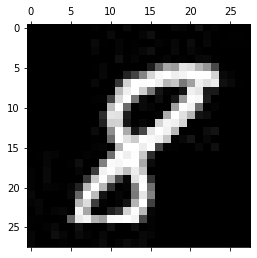

-------------------------------------------
Test: 2
Predicted: 9


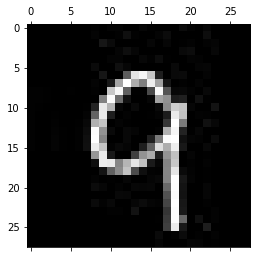

-------------------------------------------
Test: 3
Predicted: 5


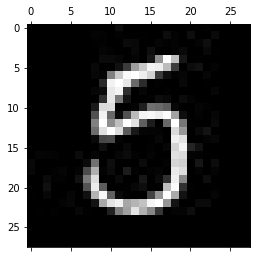

-------------------------------------------
Test: 4
Predicted: 3


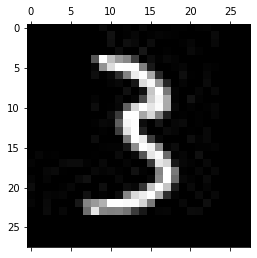

-------------------------------------------
Test: 5
Predicted: 6


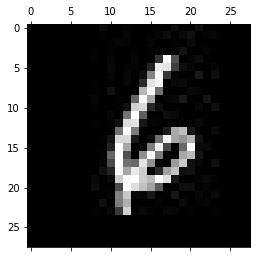

-------------------------------------------
Test: 6
Predicted: 1


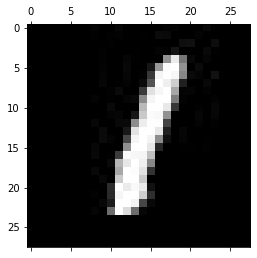

-------------------------------------------
Test: 7
Predicted: 2


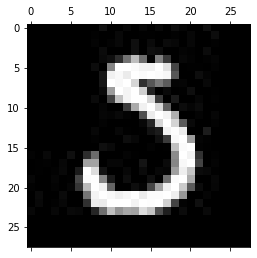

-------------------------------------------
Test: 8
Predicted: 8


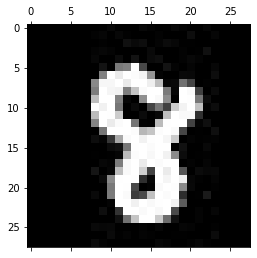

-------------------------------------------
Test: 9
Predicted: 7


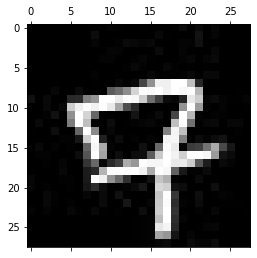

-------------------------------------------
Test: 10
Predicted: 2


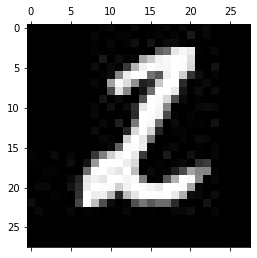

-------------------------------------------
Test: 11
Predicted: 7


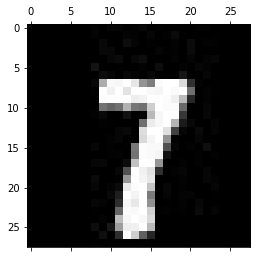

-------------------------------------------
Test: 12
Predicted: 6


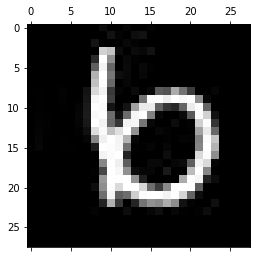

-------------------------------------------
Test: 13
Predicted: 9


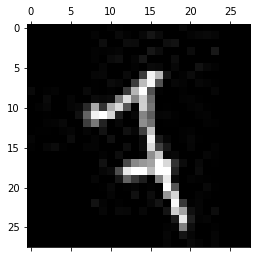

-------------------------------------------
Test: 14
Predicted: 1


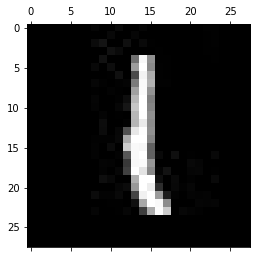

-------------------------------------------
Test: 15
Predicted: 7


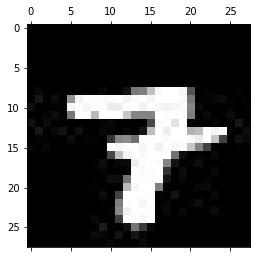

-------------------------------------------
Test: 16
Predicted: 1


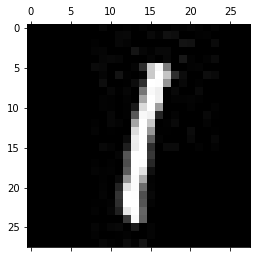

-------------------------------------------
Test: 17
Predicted: 8


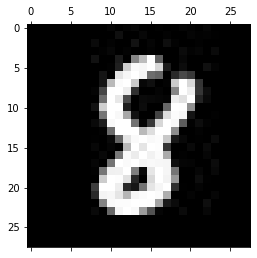

-------------------------------------------
Test: 18
Predicted: 1


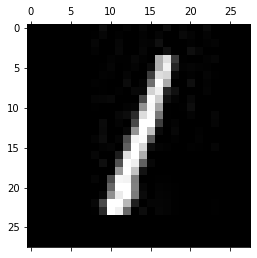

-------------------------------------------
Test: 19
Predicted: 7


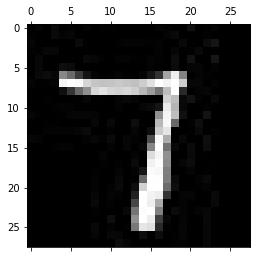

-------------------------------------------
Test: 20
Predicted: 4


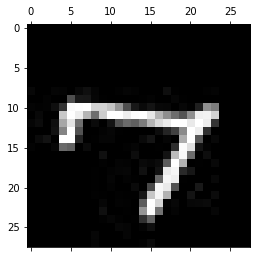

-------------------------------------------
Test: 21
Predicted: 6


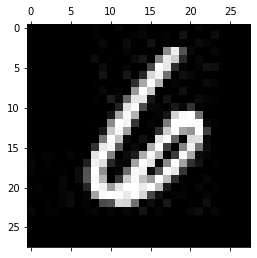

-------------------------------------------
Test: 22
Predicted: 3


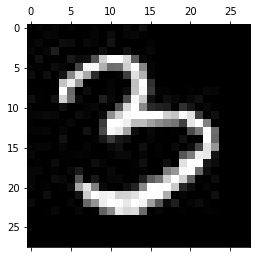

-------------------------------------------
Test: 23
Predicted: 4


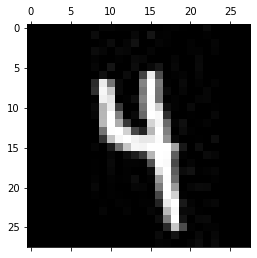

-------------------------------------------
Test: 24
Predicted: 8


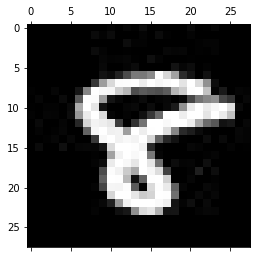

-------------------------------------------
Test: 25
Predicted: 3


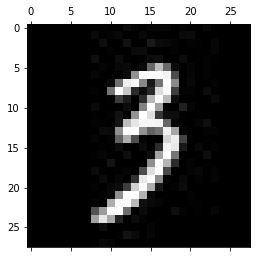

-------------------------------------------
Test: 26
Predicted: 8


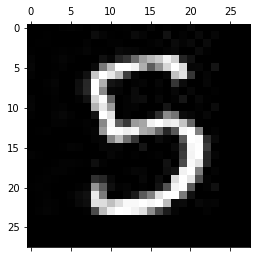

-------------------------------------------
Test: 27
Predicted: 2


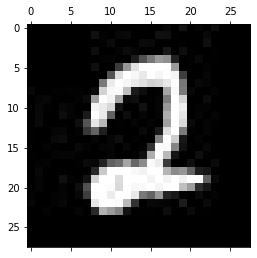

-------------------------------------------
Test: 28
Predicted: 2


<ipython-input-43-354d69a29eaf>:2: RuntimeWarning: overflow encountered in exp
  return 1. / (1. + np.exp(-x))


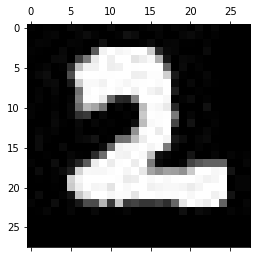

-------------------------------------------
Test: 29
Predicted: 0


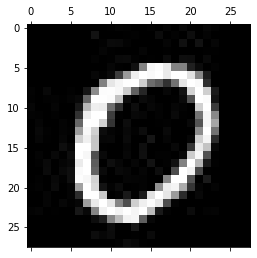

-------------------------------------------
Test: 30
Predicted: 4


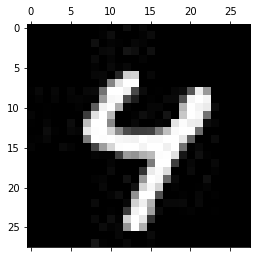

-------------------------------------------
Test: 31
Predicted: 1


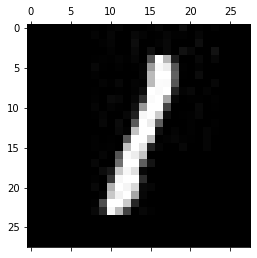

-------------------------------------------
Test: 32
Predicted: 1


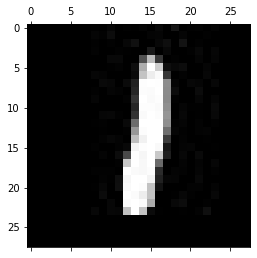

-------------------------------------------
Test: 33
Predicted: 3


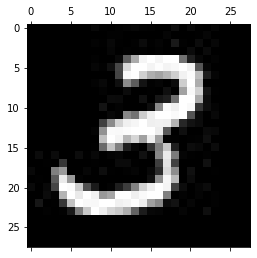

-------------------------------------------
Test: 34
Predicted: 1


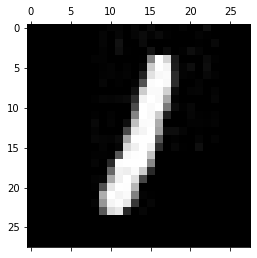

-------------------------------------------
Test: 35
Predicted: 8


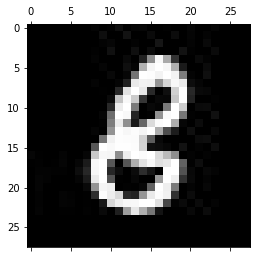

-------------------------------------------
Test: 36
Predicted: 0


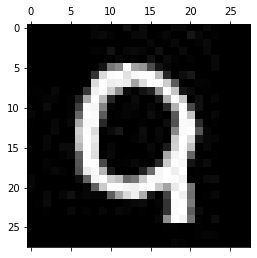

-------------------------------------------
Test: 37
Predicted: 1


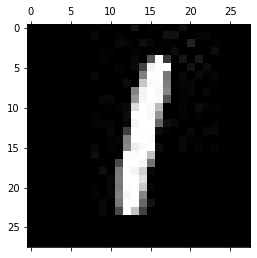

-------------------------------------------
Test: 38
Predicted: 7


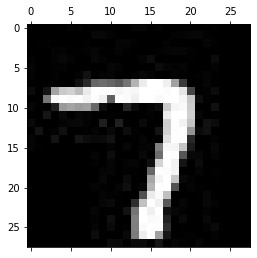

-------------------------------------------
Test: 39
Predicted: 6


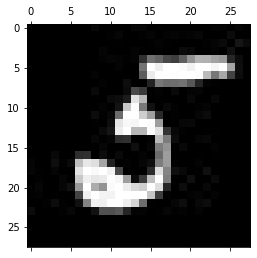

-------------------------------------------
Test: 40
Predicted: 3


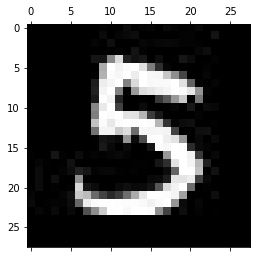

-------------------------------------------
Test: 41
Predicted: 8


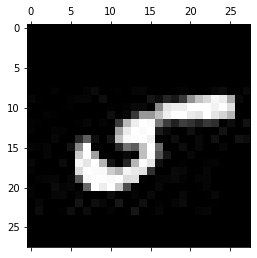

-------------------------------------------
Test: 42
Predicted: 9


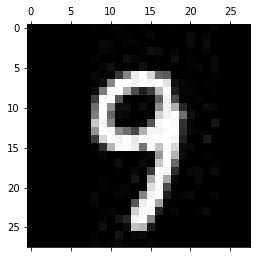

-------------------------------------------
Test: 43
Predicted: 0


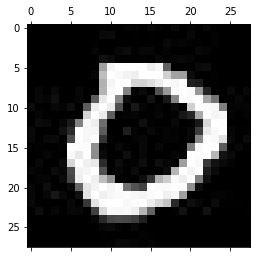

-------------------------------------------
Test: 44
Predicted: 4


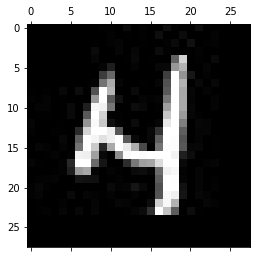

-------------------------------------------
Test: 45
Predicted: 0


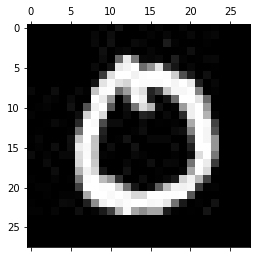

-------------------------------------------
Test: 46
Predicted: 5


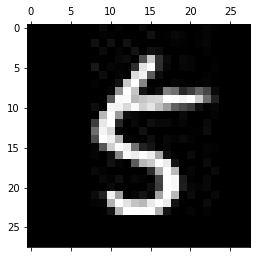

-------------------------------------------
Test: 47
Predicted: 3


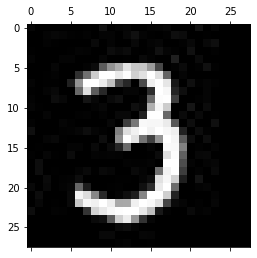

-------------------------------------------
Test: 48
Predicted: 6


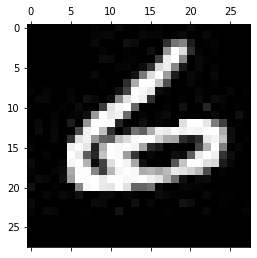

-------------------------------------------
Test: 49
Predicted: 0


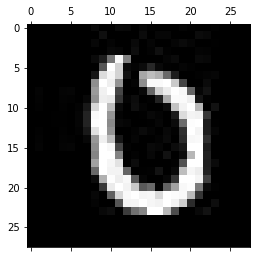

-------------------------------------------
Test: 50
Predicted: 7


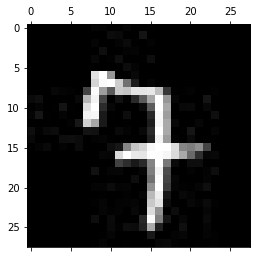

-------------------------------------------
Test: 51
Predicted: 5


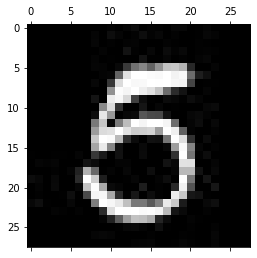

-------------------------------------------
Test: 52
Predicted: 2


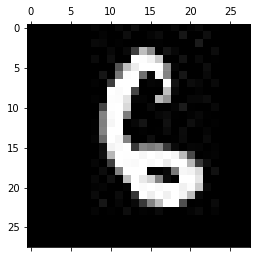

-------------------------------------------
Test: 53
Predicted: 8


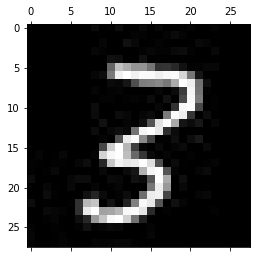

-------------------------------------------
Test: 54
Predicted: 3


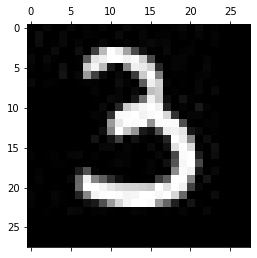

-------------------------------------------
Test: 55
Predicted: 2


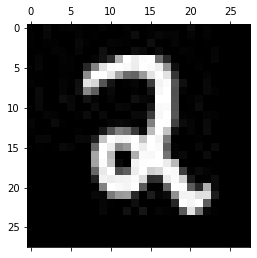

-------------------------------------------
Test: 56
Predicted: 5


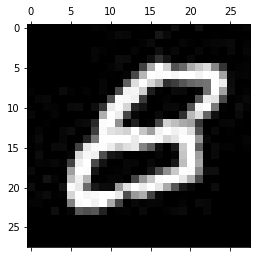

-------------------------------------------
Test: 57
Predicted: 1


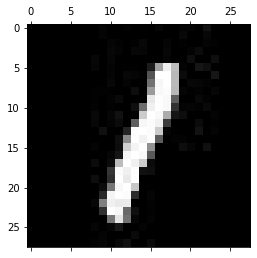

-------------------------------------------
Test: 58
Predicted: 6


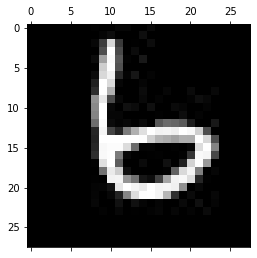

-------------------------------------------
Test: 59
Predicted: 8


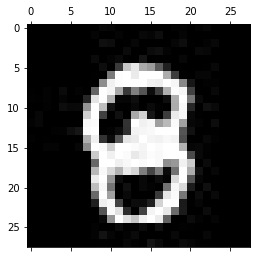

-------------------------------------------
Test: 60
Predicted: 0


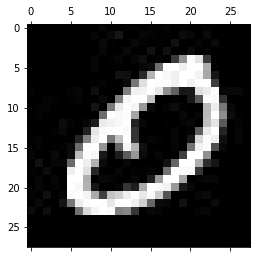

-------------------------------------------
Test: 61
Predicted: 8


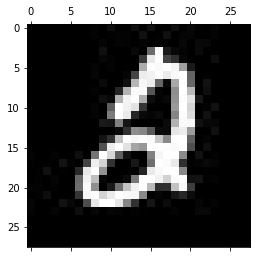

-------------------------------------------
Test: 62
Predicted: 7


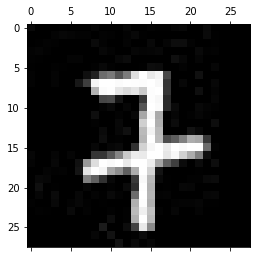

-------------------------------------------
Test: 63
Predicted: 1


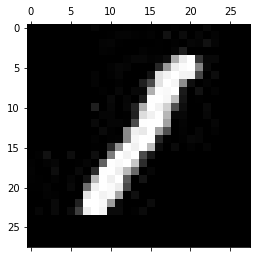

-------------------------------------------
Test: 64
Predicted: 3


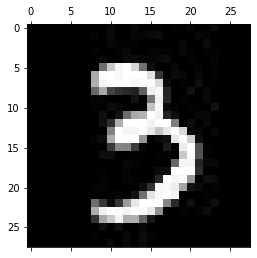

-------------------------------------------
Test: 65
Predicted: 9


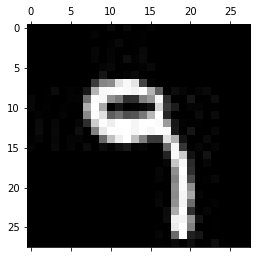

-------------------------------------------
Test: 66
Predicted: 9


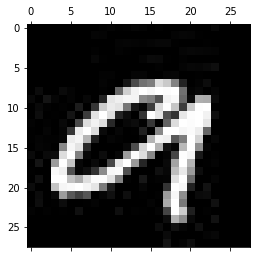

-------------------------------------------
Test: 67
Predicted: 1


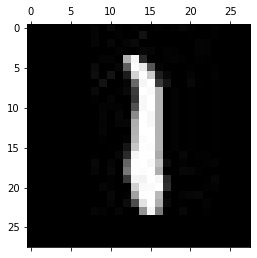

-------------------------------------------
Test: 68
Predicted: 1


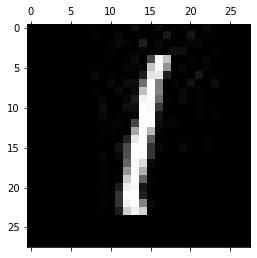

-------------------------------------------
Test: 69
Predicted: 0


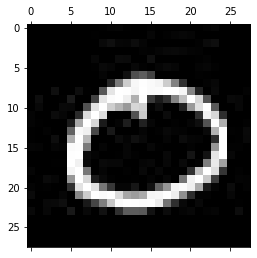

-------------------------------------------
Test: 70
Predicted: 4


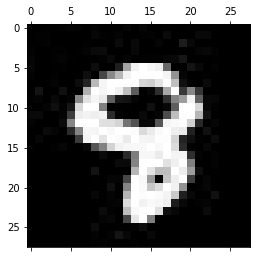

-------------------------------------------
Test: 71
Predicted: 9


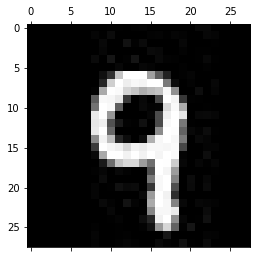

-------------------------------------------
Test: 72
Predicted: 0


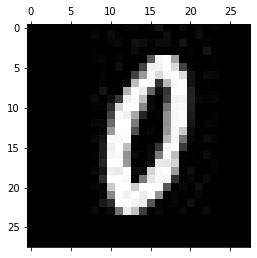

-------------------------------------------
Test: 73
Predicted: 0


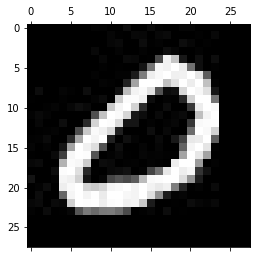

-------------------------------------------
Test: 74
Predicted: 3


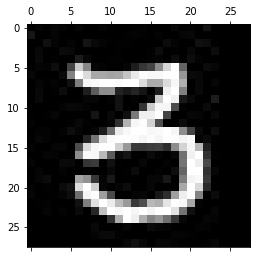

-------------------------------------------
Test: 75
Predicted: 0


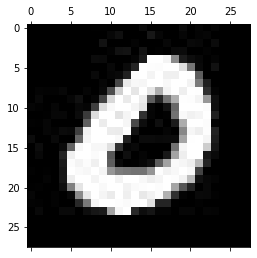

-------------------------------------------
Test: 76
Predicted: 5


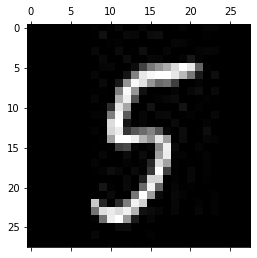

-------------------------------------------
Test: 77
Predicted: 2


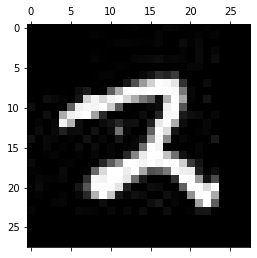

-------------------------------------------
Test: 78
Predicted: 1


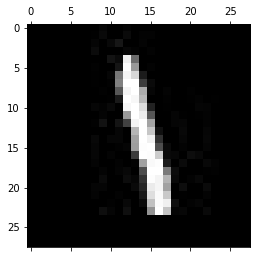

-------------------------------------------
Test: 79
Predicted: 3


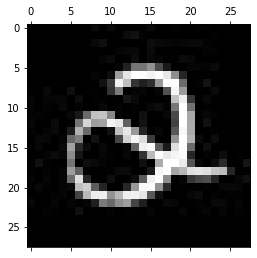

-------------------------------------------
Test: 80
Predicted: 5


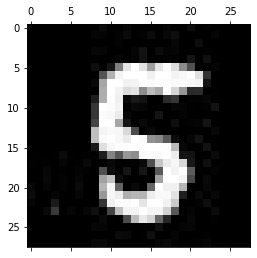

-------------------------------------------
Test: 81
Predicted: 3


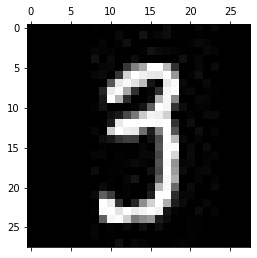

-------------------------------------------
Test: 82
Predicted: 3


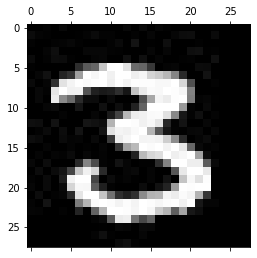

-------------------------------------------
Test: 83
Predicted: 9


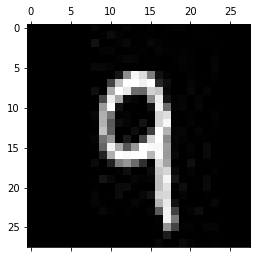

-------------------------------------------
Test: 84
Predicted: 6


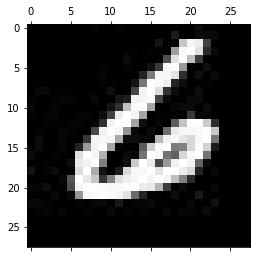

-------------------------------------------
Test: 85
Predicted: 0


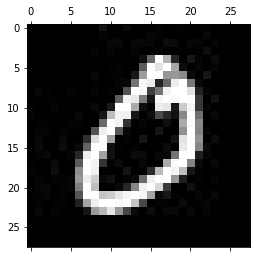

-------------------------------------------
Test: 86
Predicted: 8


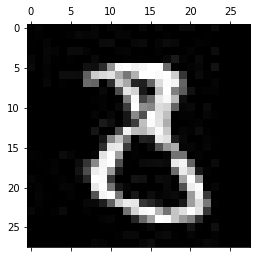

-------------------------------------------
Test: 87
Predicted: 0


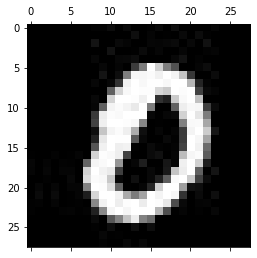

-------------------------------------------
Test: 88
Predicted: 6


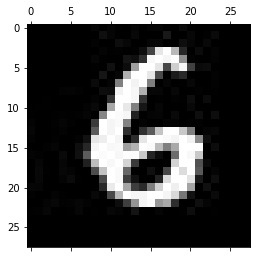

-------------------------------------------
Test: 89
Predicted: 5


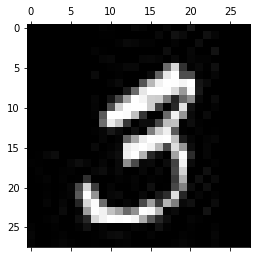

-------------------------------------------
Test: 90
Predicted: 6


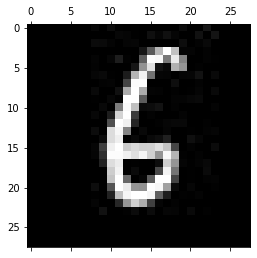

-------------------------------------------
Test: 91
Predicted: 4


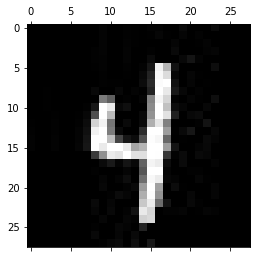

-------------------------------------------
Test: 92
Predicted: 4


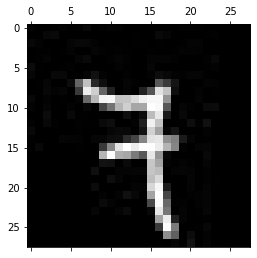

-------------------------------------------
Test: 93
Predicted: 1


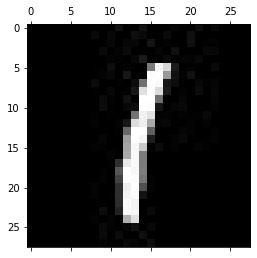

-------------------------------------------
Test: 94
Predicted: 0


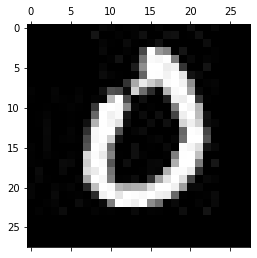

-------------------------------------------
Test: 95
Predicted: 1


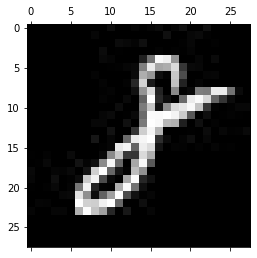

-------------------------------------------
Test: 96
Predicted: 4


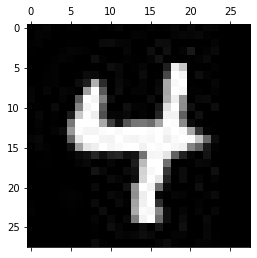

-------------------------------------------
Test: 97
Predicted: 3


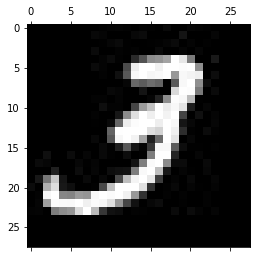

-------------------------------------------
Test: 98
Predicted: 7


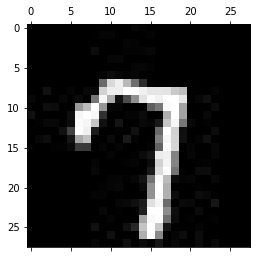

-------------------------------------------
Test: 99
Predicted: 4


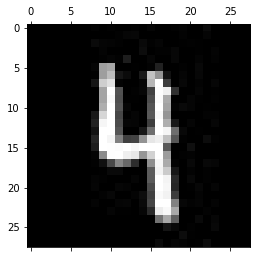

-------------------------------------------
Test: 100
Predicted: 7


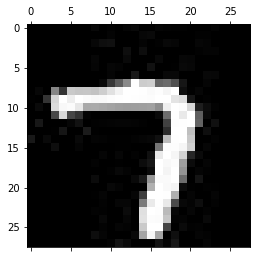

-------------------------------------------
Test: 101
Predicted: 6


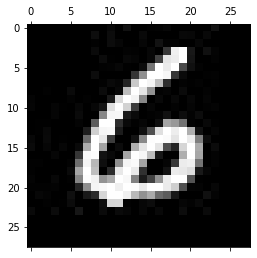

-------------------------------------------
Test: 102
Predicted: 3


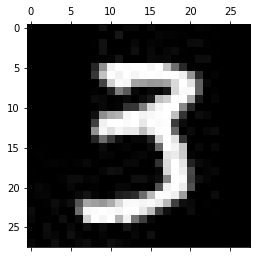

-------------------------------------------
Test: 103
Predicted: 8


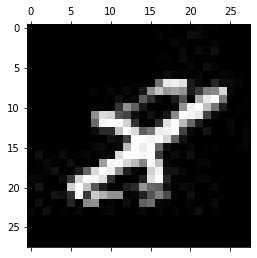

-------------------------------------------
Test: 104
Predicted: 7


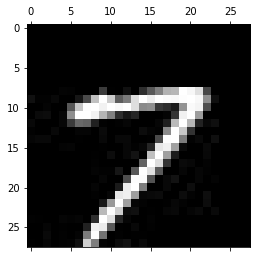

-------------------------------------------
Test: 105
Predicted: 7


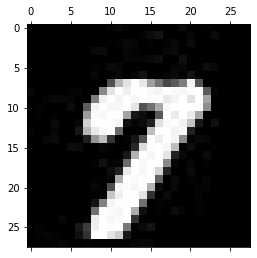

-------------------------------------------
Test: 106
Predicted: 7


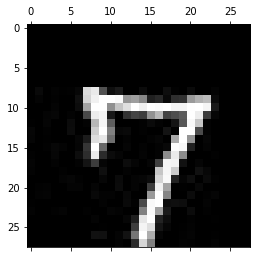

-------------------------------------------
Test: 107
Predicted: 6


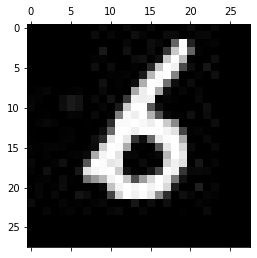

-------------------------------------------
Test: 108
Predicted: 5


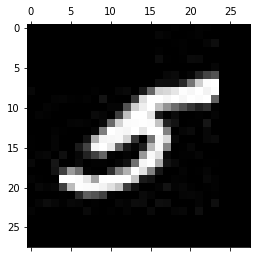

-------------------------------------------
Test: 109
Predicted: 1


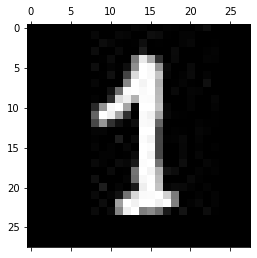

-------------------------------------------
Test: 110
Predicted: 5


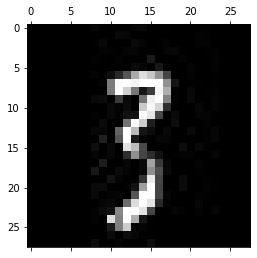

-------------------------------------------
Test: 111
Predicted: 2


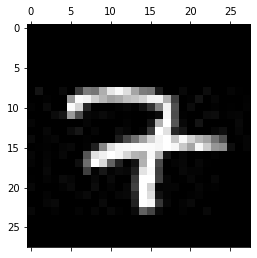

-------------------------------------------
Test: 112
Predicted: 5


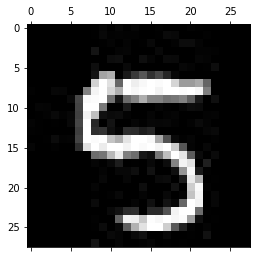

-------------------------------------------
Test: 113
Predicted: 2


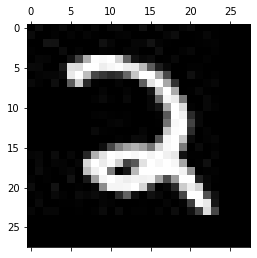

-------------------------------------------
Test: 114
Predicted: 3


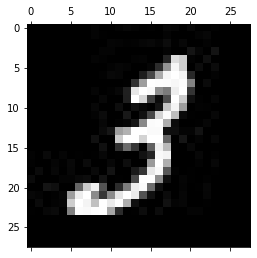

-------------------------------------------
Test: 115
Predicted: 5


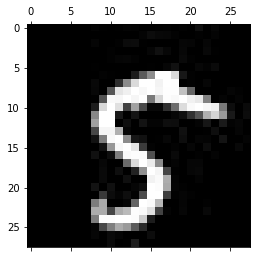

-------------------------------------------
Test: 116
Predicted: 1


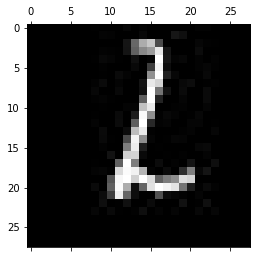

-------------------------------------------
Test: 117
Predicted: 6


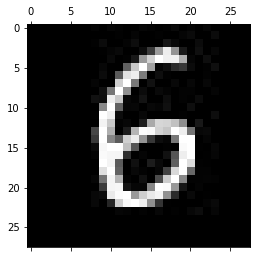

-------------------------------------------
Test: 118
Predicted: 1


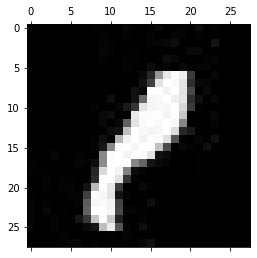

-------------------------------------------
Test: 119
Predicted: 4


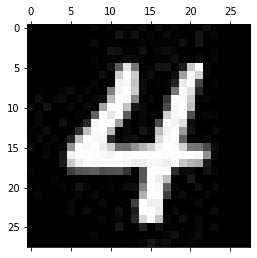

-------------------------------------------
Test: 120
Predicted: 7


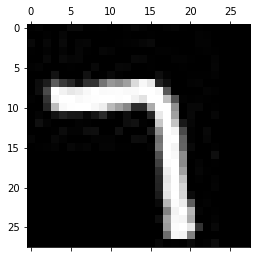

-------------------------------------------
Test: 121
Predicted: 9


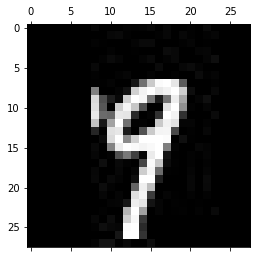

-------------------------------------------
Test: 122
Predicted: 4


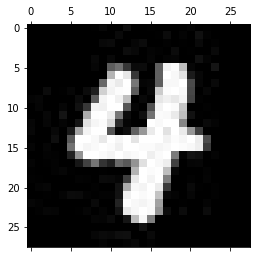

-------------------------------------------
Test: 123
Predicted: 6


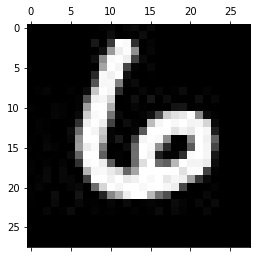

-------------------------------------------
Test: 124
Predicted: 5


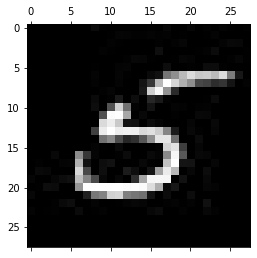

-------------------------------------------
Test: 125
Predicted: 4


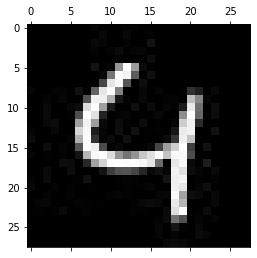

-------------------------------------------
Test: 126
Predicted: 6


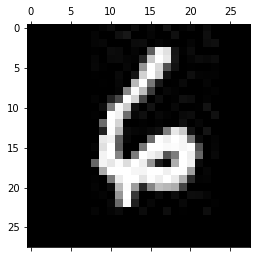

-------------------------------------------
Test: 127
Predicted: 5


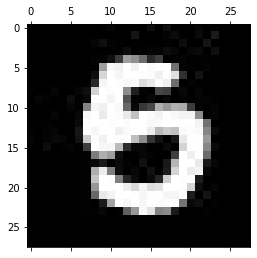

-------------------------------------------
Test: 128
Predicted: 8


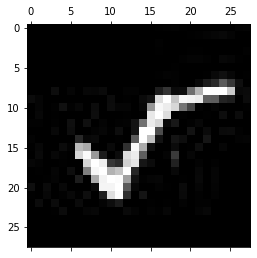

-------------------------------------------
Test: 129
Predicted: 3


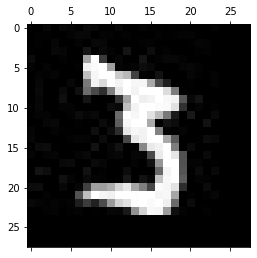

-------------------------------------------
Test: 130
Predicted: 7


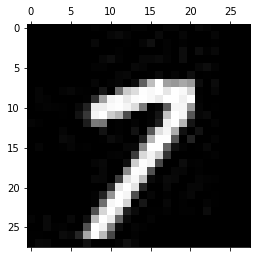

-------------------------------------------
Test: 131
Predicted: 7


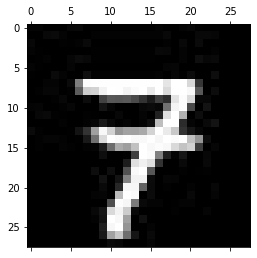

-------------------------------------------
Test: 132
Predicted: 5


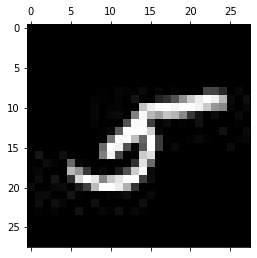

-------------------------------------------
Test: 133
Predicted: 6


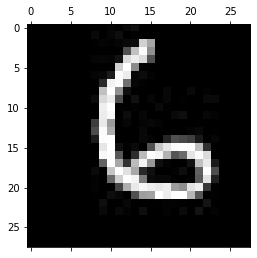

-------------------------------------------
Test: 134
Predicted: 1


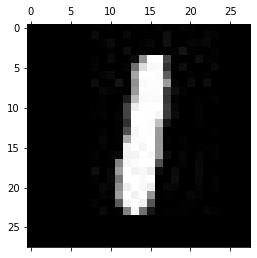

-------------------------------------------
Test: 135
Predicted: 1


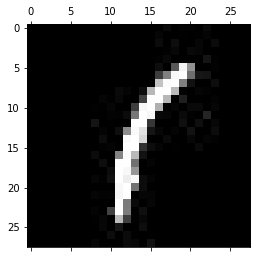

-------------------------------------------
Test: 136
Predicted: 9


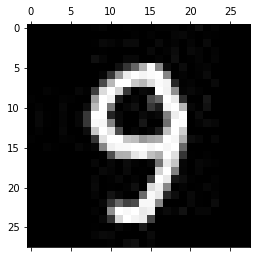

-------------------------------------------
Test: 137
Predicted: 5


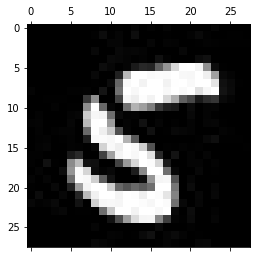

-------------------------------------------
Test: 138
Predicted: 4


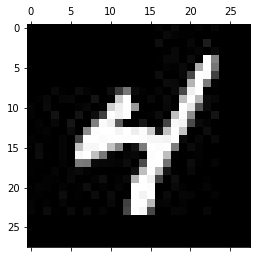

-------------------------------------------
Test: 139
Predicted: 3


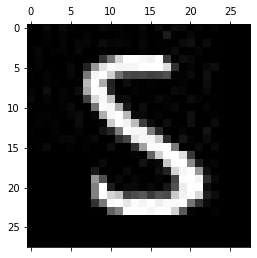

-------------------------------------------
Test: 140
Predicted: 7


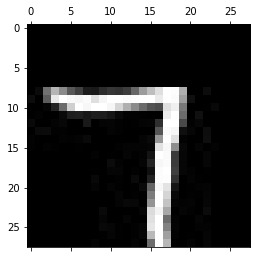

-------------------------------------------
Test: 141
Predicted: 3


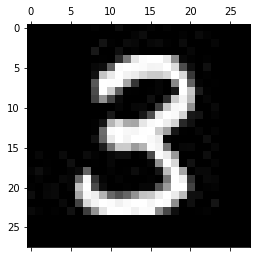

-------------------------------------------
Test: 142
Predicted: 4


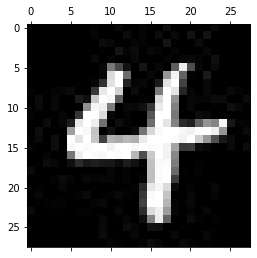

-------------------------------------------
Test: 143
Predicted: 3


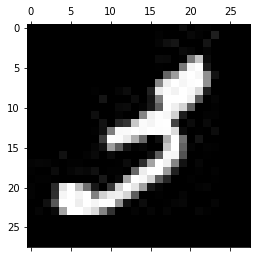

-------------------------------------------
Test: 144
Predicted: 2


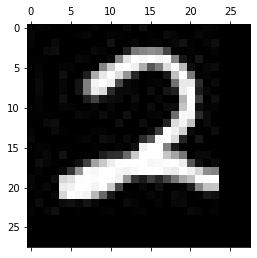

-------------------------------------------
Test: 145
Predicted: 5


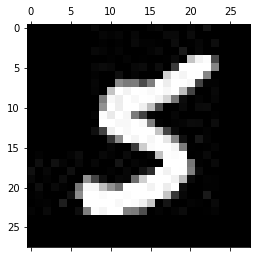

-------------------------------------------
Test: 146
Predicted: 5


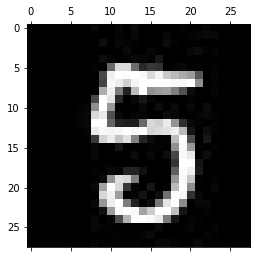

-------------------------------------------
Test: 147
Predicted: 3


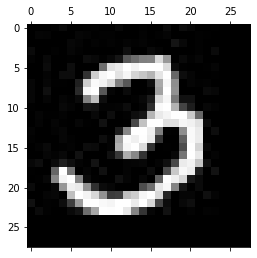

-------------------------------------------
Test: 148
Predicted: 6


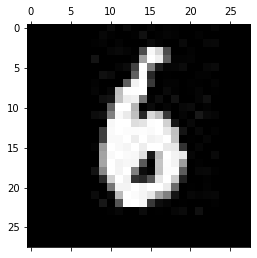

-------------------------------------------
Test: 149
Predicted: 8


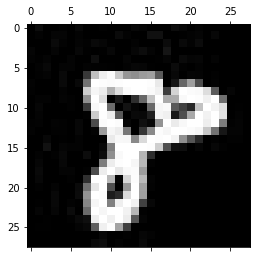

-------------------------------------------
Test: 150
Predicted: 4


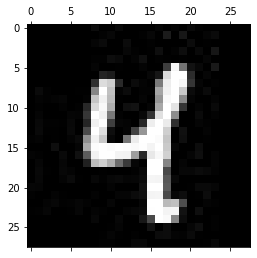

-------------------------------------------
Test: 151
Predicted: 1


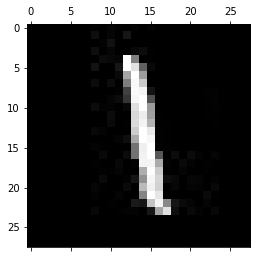

-------------------------------------------
Test: 152
Predicted: 1


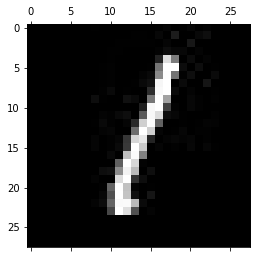

-------------------------------------------
Test: 153
Predicted: 5


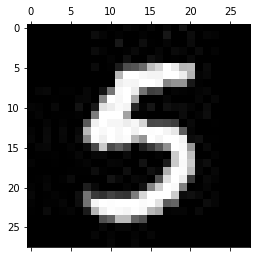

-------------------------------------------
Test: 154
Predicted: 7


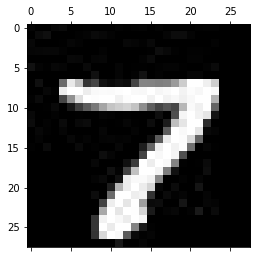

-------------------------------------------
Test: 155
Predicted: 5


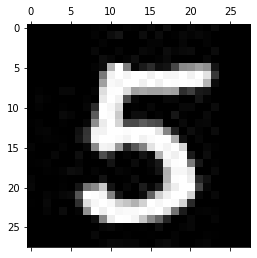

-------------------------------------------
Test: 156
Predicted: 7


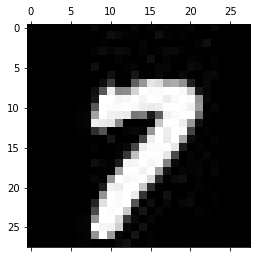

-------------------------------------------
Test: 157
Predicted: 0


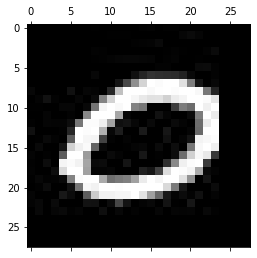

-------------------------------------------
Test: 158
Predicted: 3


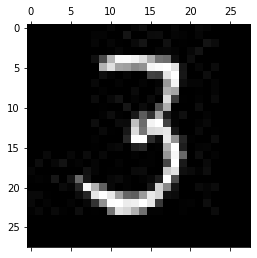

-------------------------------------------
Test: 159
Predicted: 4


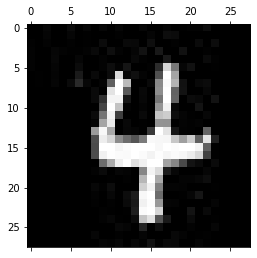

-------------------------------------------
Test: 160
Predicted: 4


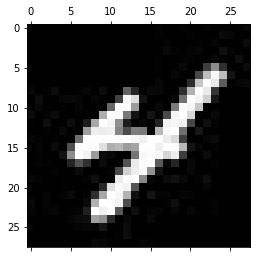

-------------------------------------------
Test: 161
Predicted: 9


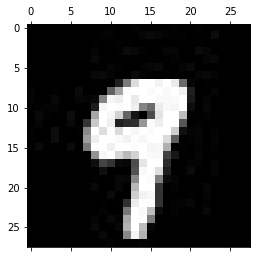

-------------------------------------------
Test: 162
Predicted: 3


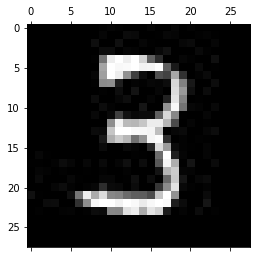

-------------------------------------------
Test: 163
Predicted: 3


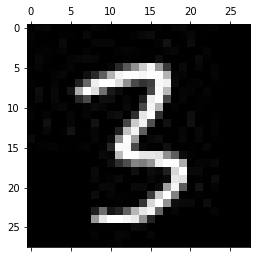

-------------------------------------------
Test: 164
Predicted: 0


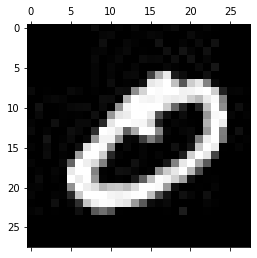

-------------------------------------------
Test: 165
Predicted: 1


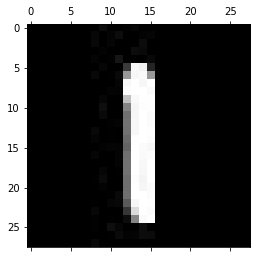

-------------------------------------------
Test: 166
Predicted: 5


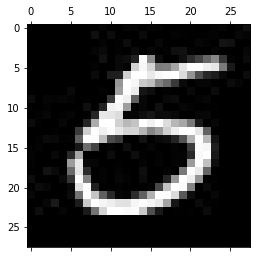

-------------------------------------------
Test: 167
Predicted: 5


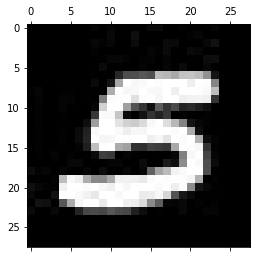

-------------------------------------------
Test: 168
Predicted: 8


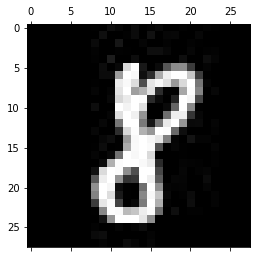

-------------------------------------------
Test: 169
Predicted: 7


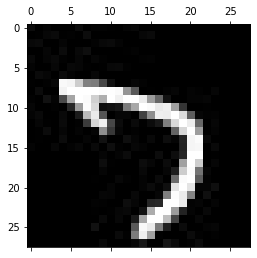

-------------------------------------------
Test: 170
Predicted: 1


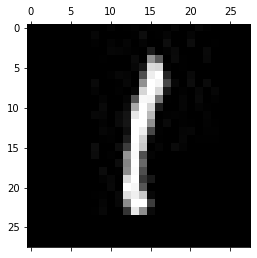

-------------------------------------------
Test: 171
Predicted: 7


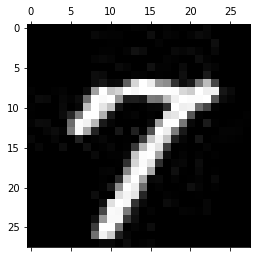

-------------------------------------------
Test: 172
Predicted: 9


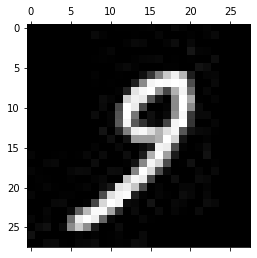

-------------------------------------------
Test: 173
Predicted: 8


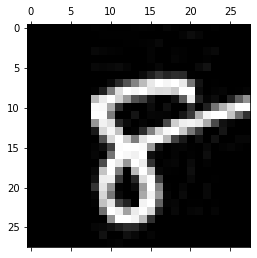

-------------------------------------------
Test: 174
Predicted: 6


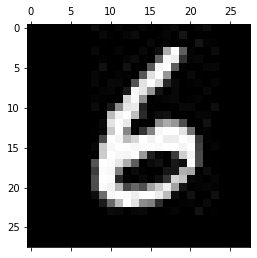

-------------------------------------------
Test: 175
Predicted: 0


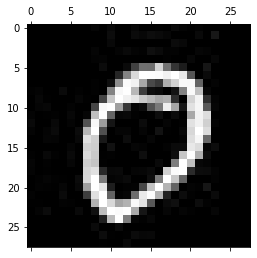

-------------------------------------------
Test: 176
Predicted: 0


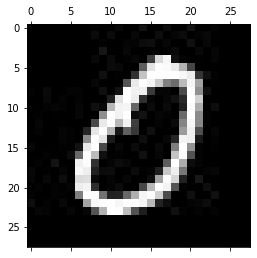

-------------------------------------------
Test: 177
Predicted: 9


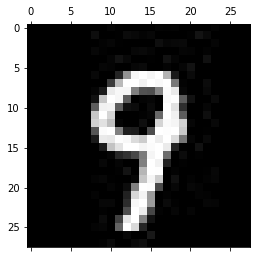

-------------------------------------------
Test: 178
Predicted: 8


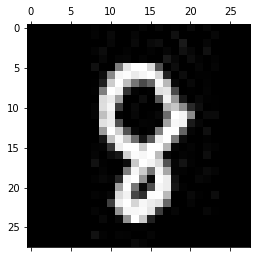

-------------------------------------------
Test: 179
Predicted: 9


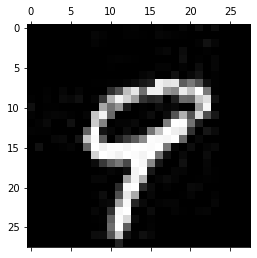

-------------------------------------------
Test: 180
Predicted: 2


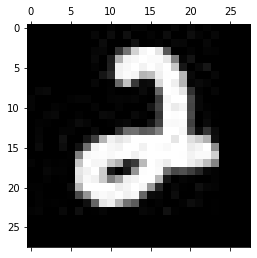

-------------------------------------------
Test: 181
Predicted: 0


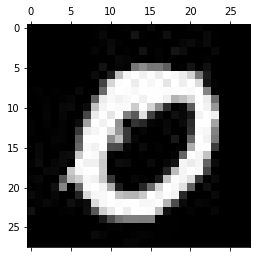

-------------------------------------------
Test: 182
Predicted: 2


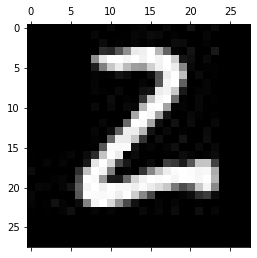

-------------------------------------------
Test: 183
Predicted: 1


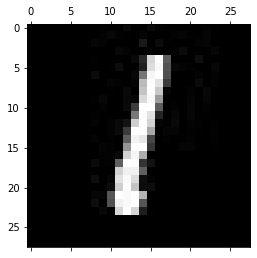

-------------------------------------------
Test: 184
Predicted: 5


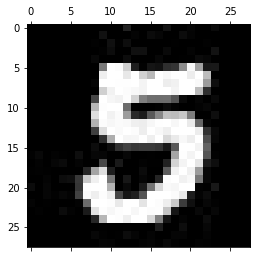

-------------------------------------------
Test: 185
Predicted: 2


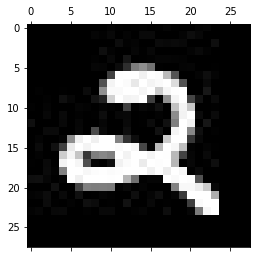

-------------------------------------------
Test: 186
Predicted: 4


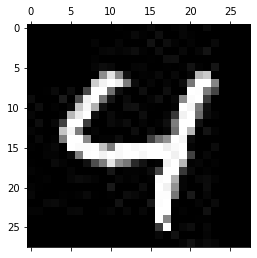

-------------------------------------------
Test: 187
Predicted: 1


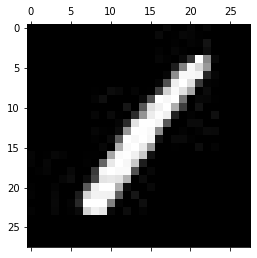

-------------------------------------------
Test: 188
Predicted: 9


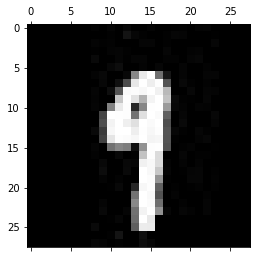

-------------------------------------------
Test: 189
Predicted: 7


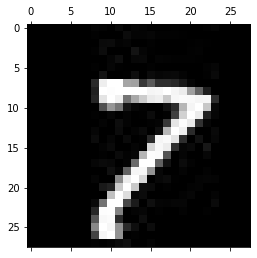

-------------------------------------------
Test: 190
Predicted: 4


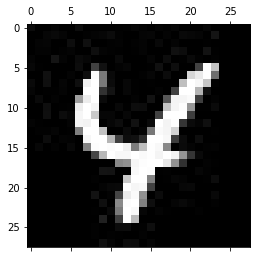

-------------------------------------------
Test: 191
Predicted: 1


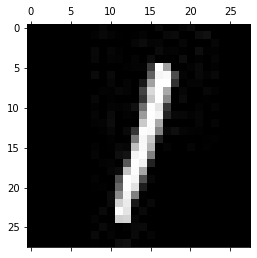

-------------------------------------------
Test: 192
Predicted: 8


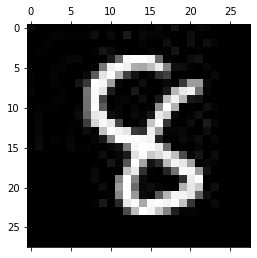

-------------------------------------------
Test: 193
Predicted: 6


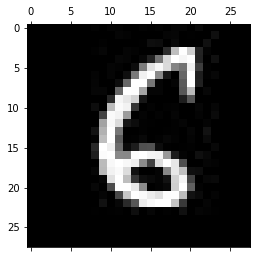

-------------------------------------------
Test: 194
Predicted: 8


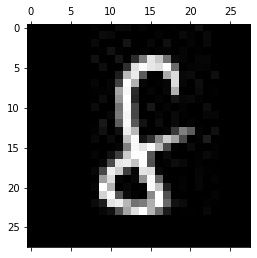

-------------------------------------------
Test: 195
Predicted: 6


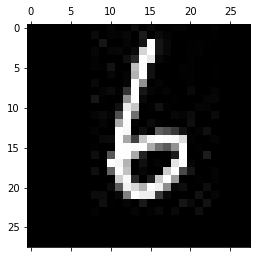

-------------------------------------------
Test: 196
Predicted: 7


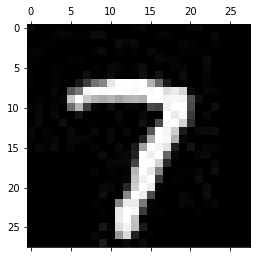

-------------------------------------------
Test: 197
Predicted: 1


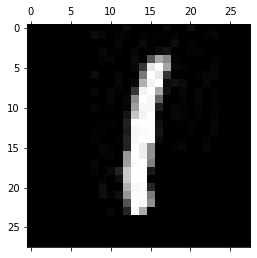

-------------------------------------------
Test: 198
Predicted: 1


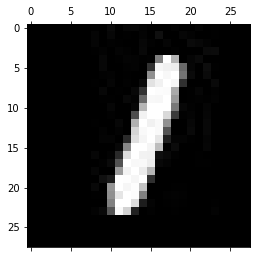

-------------------------------------------
Test: 199
Predicted: 7


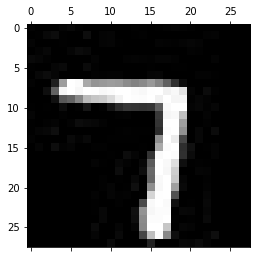

-------------------------------------------
Test: 200
Predicted: 8


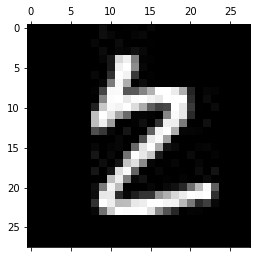

-------------------------------------------
Test: 201
Predicted: 9


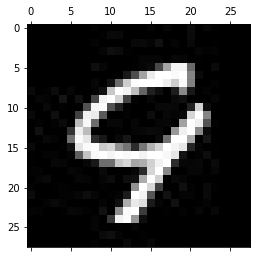

-------------------------------------------
Test: 202
Predicted: 4


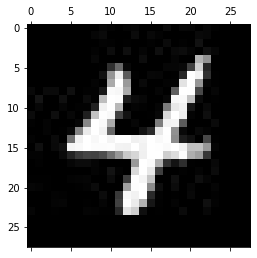

-------------------------------------------
Test: 203
Predicted: 6


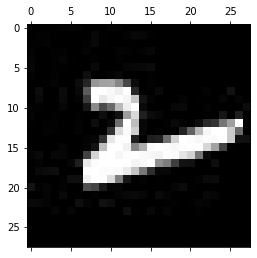

-------------------------------------------
Test: 204
Predicted: 5


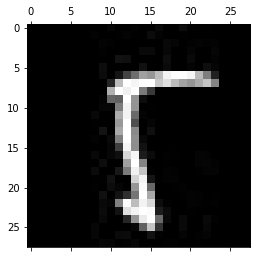

-------------------------------------------
Test: 205
Predicted: 8


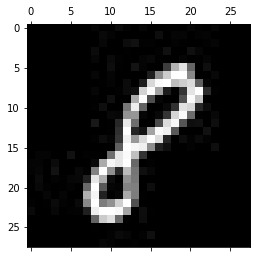

-------------------------------------------
Test: 206
Predicted: 7


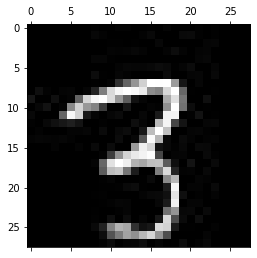

-------------------------------------------
Test: 207
Predicted: 3


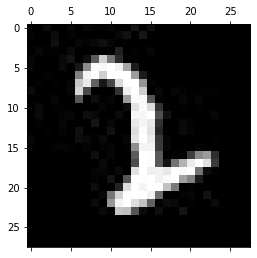

-------------------------------------------
Test: 208
Predicted: 9


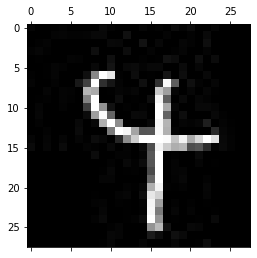

-------------------------------------------
Test: 209
Predicted: 4


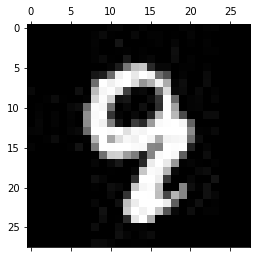

-------------------------------------------
Test: 210
Predicted: 6


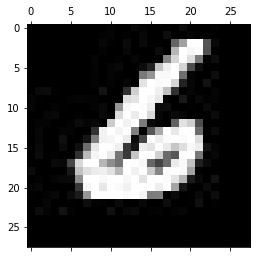

-------------------------------------------
Test: 211
Predicted: 8


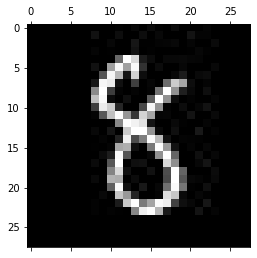

-------------------------------------------
Test: 212
Predicted: 7


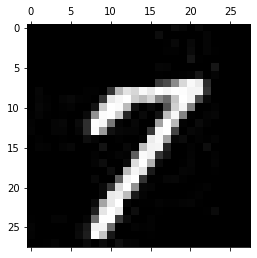

-------------------------------------------
Test: 213
Predicted: 7


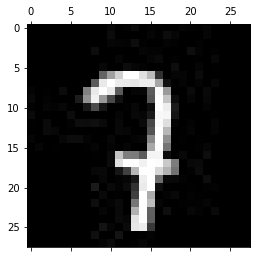

-------------------------------------------
Test: 214
Predicted: 4


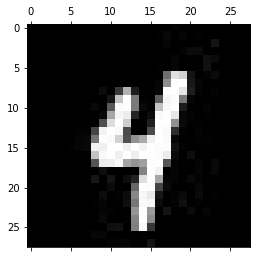

-------------------------------------------
Test: 215
Predicted: 1


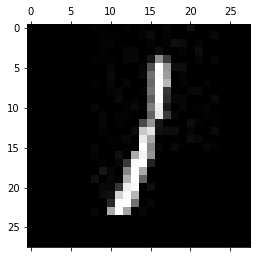

-------------------------------------------
Test: 216
Predicted: 7


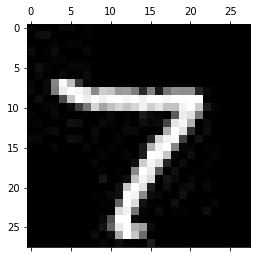

-------------------------------------------
Test: 217
Predicted: 0


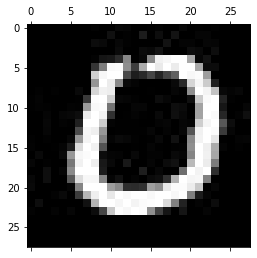

-------------------------------------------
Test: 218
Predicted: 7


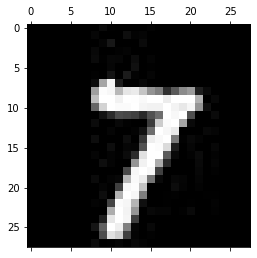

-------------------------------------------
Test: 219
Predicted: 7


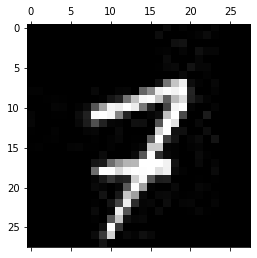

-------------------------------------------
Test: 220
Predicted: 3


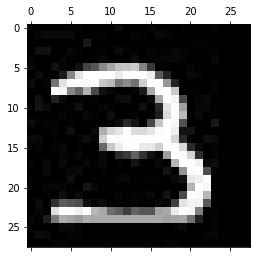

-------------------------------------------
Test: 221
Predicted: 3


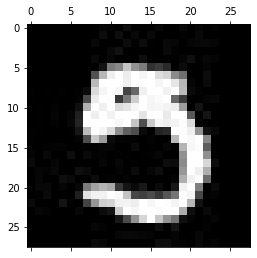

-------------------------------------------
Test: 222
Predicted: 6


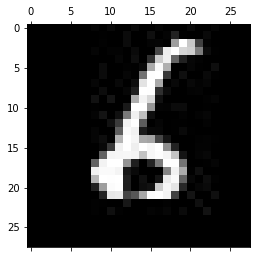

-------------------------------------------
Test: 223
Predicted: 9


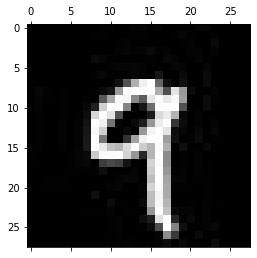

-------------------------------------------
Test: 224
Predicted: 1


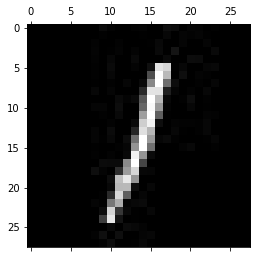

-------------------------------------------
Test: 225
Predicted: 5


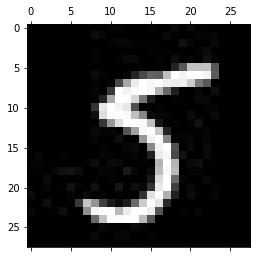

-------------------------------------------
Test: 226
Predicted: 0


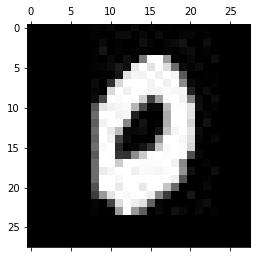

-------------------------------------------
Test: 227
Predicted: 8


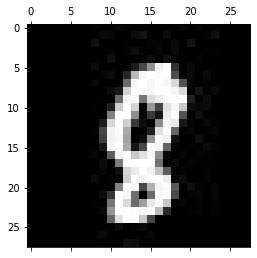

-------------------------------------------
Test: 228
Predicted: 6


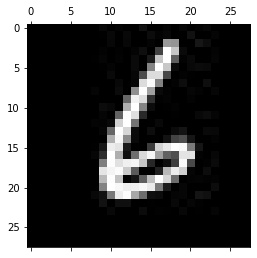

-------------------------------------------
Test: 229
Predicted: 2


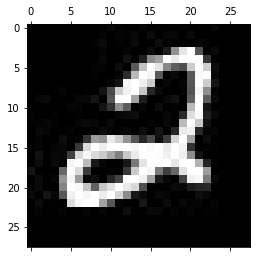

-------------------------------------------
Test: 230
Predicted: 6


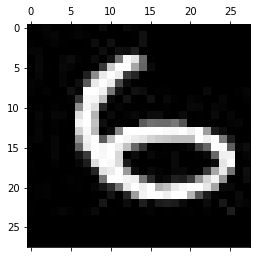

-------------------------------------------
Test: 231
Predicted: 1


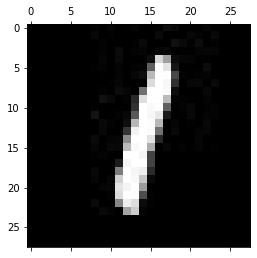

-------------------------------------------
Test: 232
Predicted: 9


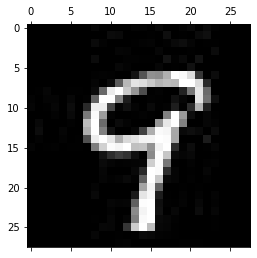

-------------------------------------------
Test: 233
Predicted: 0


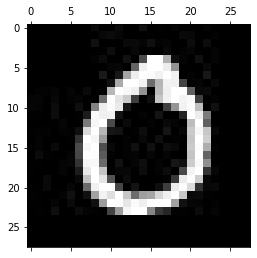

-------------------------------------------
Test: 234
Predicted: 3


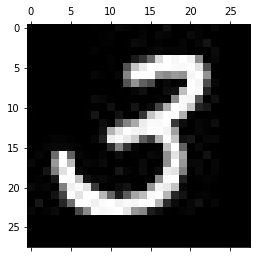

-------------------------------------------
Test: 235
Predicted: 6


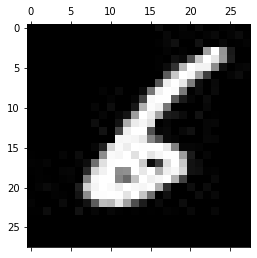

-------------------------------------------
Test: 236
Predicted: 4


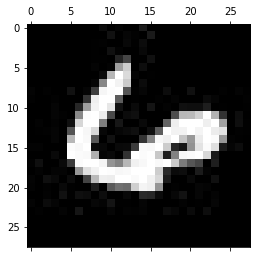

-------------------------------------------
Test: 237
Predicted: 3


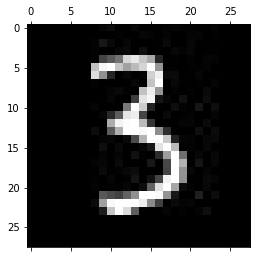

-------------------------------------------
Test: 238
Predicted: 9


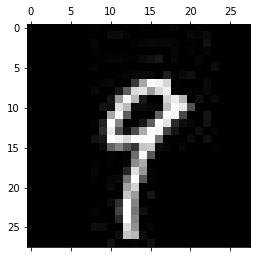

-------------------------------------------
Test: 239
Predicted: 6


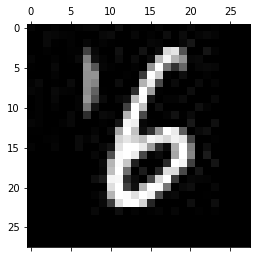

-------------------------------------------
Test: 240
Predicted: 8


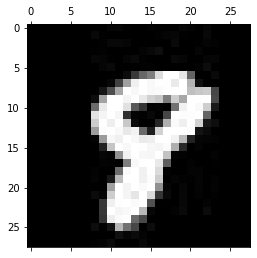

-------------------------------------------
Test: 241
Predicted: 2


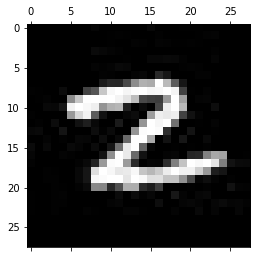

-------------------------------------------
Test: 242
Predicted: 0


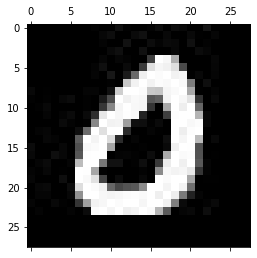

-------------------------------------------
Test: 243
Predicted: 2


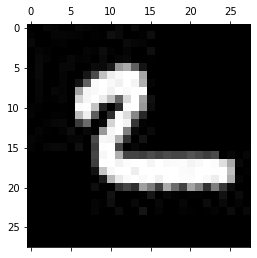

-------------------------------------------
Test: 244
Predicted: 7


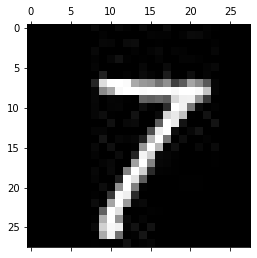

-------------------------------------------
Test: 245
Predicted: 1


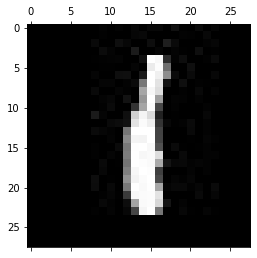

-------------------------------------------
Test: 246
Predicted: 3


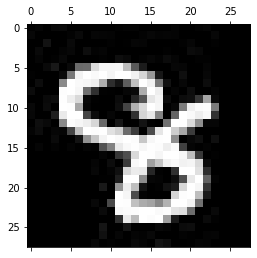

-------------------------------------------
Test: 247
Predicted: 8


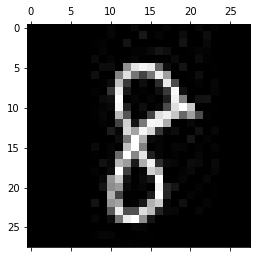

-------------------------------------------
Test: 248
Predicted: 2


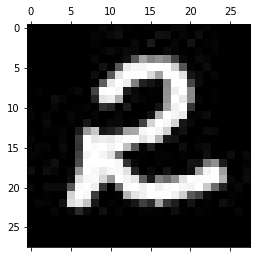

-------------------------------------------
Test: 249
Predicted: 3


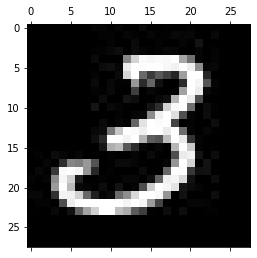

-------------------------------------------
Test: 250
Predicted: 7


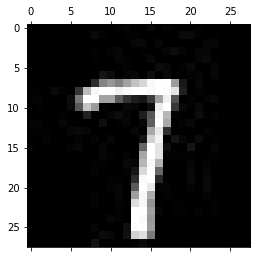

-------------------------------------------
Test: 251
Predicted: 9


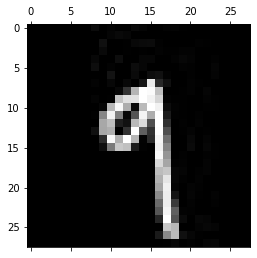

-------------------------------------------
Test: 252
Predicted: 9


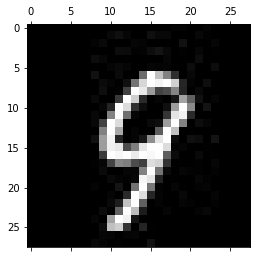

-------------------------------------------
Test: 253
Predicted: 6


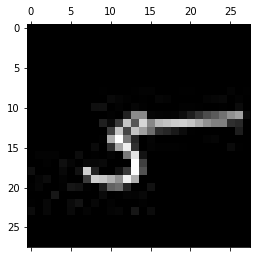

-------------------------------------------
Test: 254
Predicted: 7


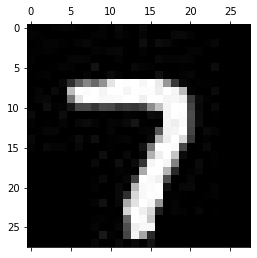

-------------------------------------------
Test: 255
Predicted: 1


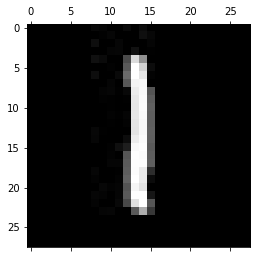

-------------------------------------------
Test: 256
Predicted: 4


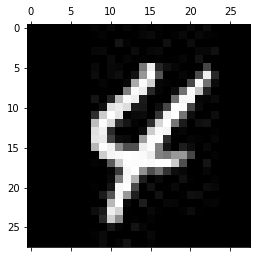

-------------------------------------------
Test: 257
Predicted: 7


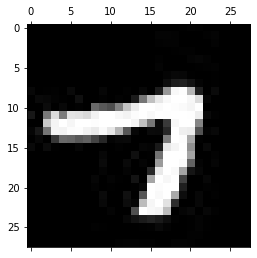

-------------------------------------------
Test: 258
Predicted: 5


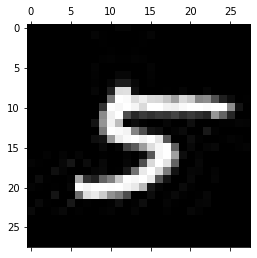

-------------------------------------------
Test: 259
Predicted: 1


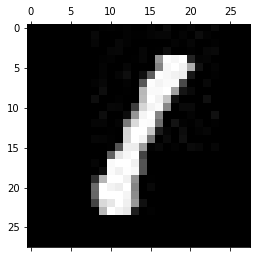

-------------------------------------------
Test: 260
Predicted: 0


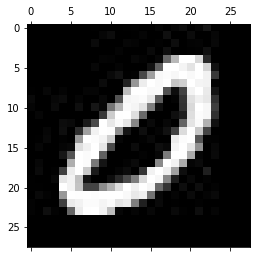

-------------------------------------------
Test: 261
Predicted: 0


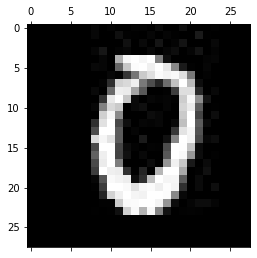

-------------------------------------------
Test: 262
Predicted: 1


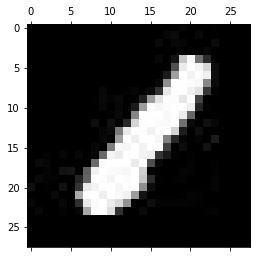

-------------------------------------------
Test: 263
Predicted: 5


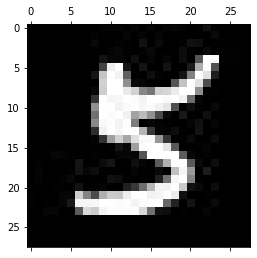

-------------------------------------------
Test: 264
Predicted: 0


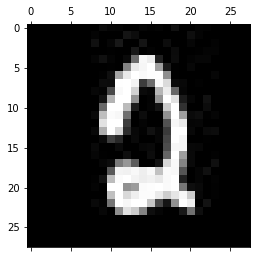

-------------------------------------------
Test: 265
Predicted: 4


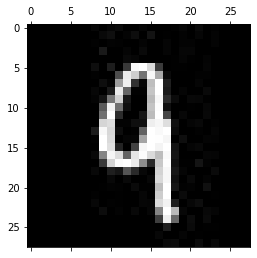

-------------------------------------------
Test: 266
Predicted: 4


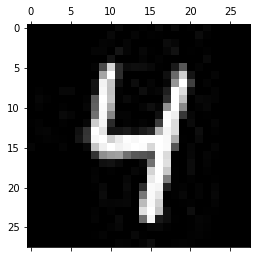

-------------------------------------------
Test: 267
Predicted: 1


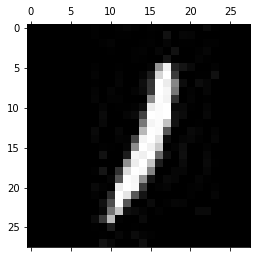

-------------------------------------------
Test: 268
Predicted: 7


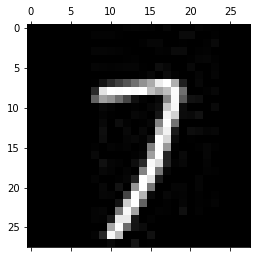

-------------------------------------------
Test: 269
Predicted: 9


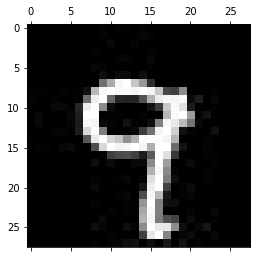

-------------------------------------------
Test: 270
Predicted: 9


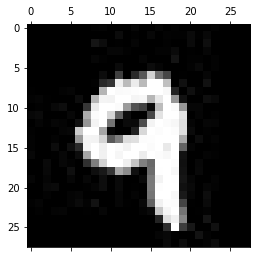

-------------------------------------------
Test: 271
Predicted: 3


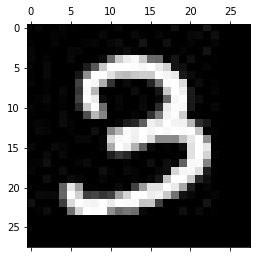

-------------------------------------------
Test: 272
Predicted: 1


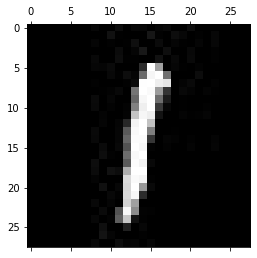

-------------------------------------------
Test: 273
Predicted: 8


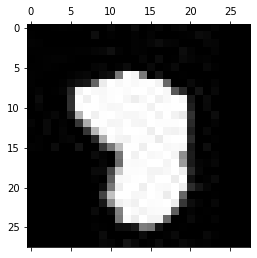

-------------------------------------------
Test: 274
Predicted: 9


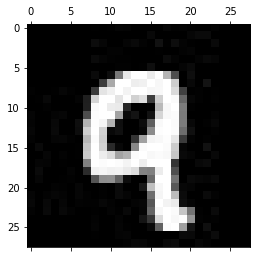

-------------------------------------------
Test: 275
Predicted: 9


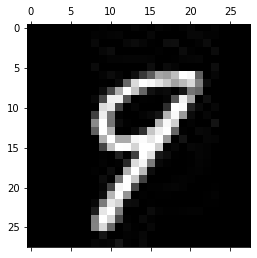

-------------------------------------------
Test: 276
Predicted: 0


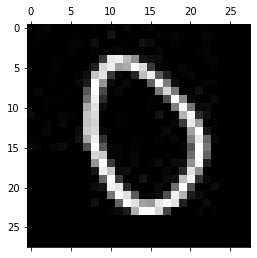

-------------------------------------------
Test: 277
Predicted: 2


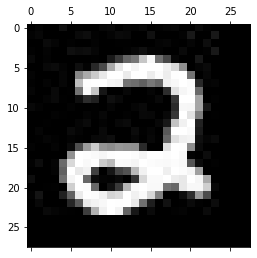

-------------------------------------------
Test: 278
Predicted: 2


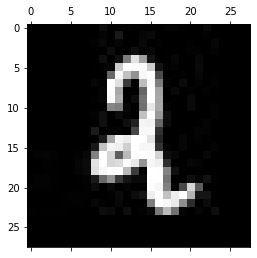

-------------------------------------------
Test: 279
Predicted: 1


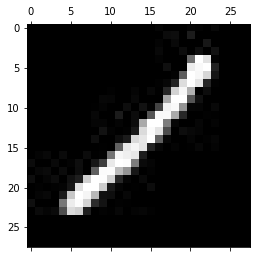

-------------------------------------------
Test: 280
Predicted: 6


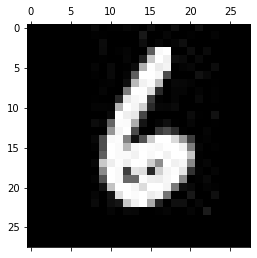

-------------------------------------------
Test: 281
Predicted: 6


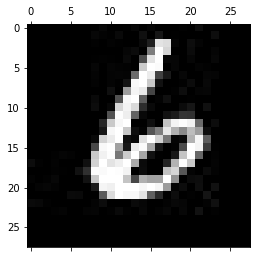

-------------------------------------------
Test: 282
Predicted: 4


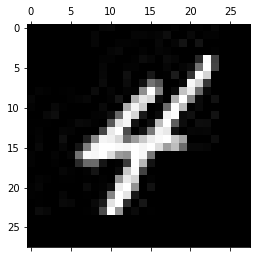

-------------------------------------------
Test: 283
Predicted: 7


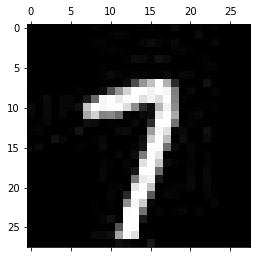

-------------------------------------------
Test: 284
Predicted: 7


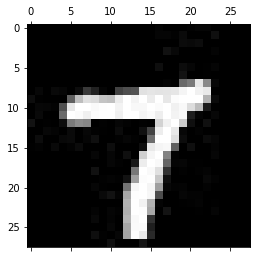

-------------------------------------------
Test: 285
Predicted: 6


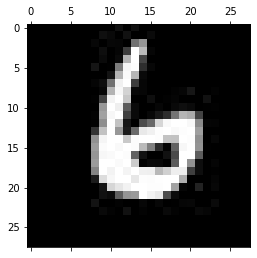

-------------------------------------------
Test: 286
Predicted: 8


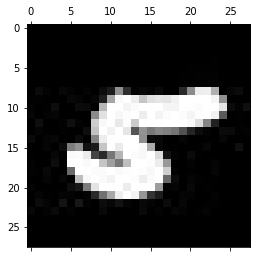

-------------------------------------------
Test: 287
Predicted: 5


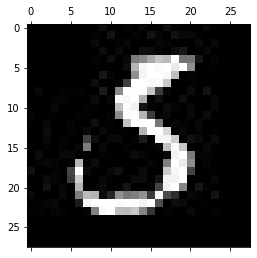

-------------------------------------------
Test: 288
Predicted: 3


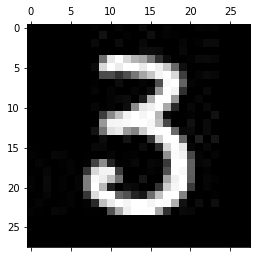

-------------------------------------------
Test: 289
Predicted: 4


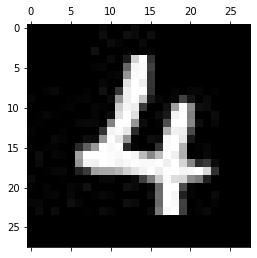

-------------------------------------------
Test: 290
Predicted: 3


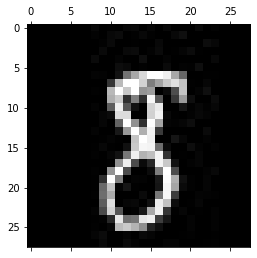

-------------------------------------------
Test: 291
Predicted: 5


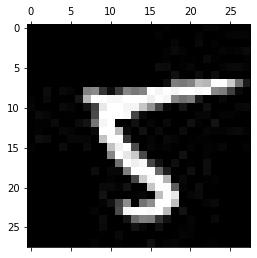

-------------------------------------------
Test: 292
Predicted: 2


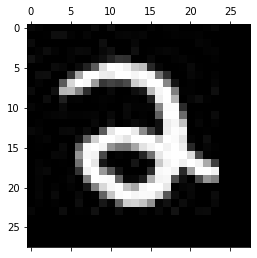

-------------------------------------------
Test: 293
Predicted: 8


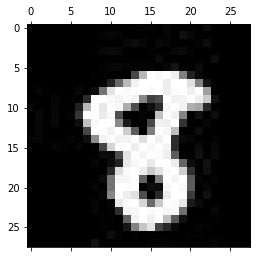

-------------------------------------------
Test: 294
Predicted: 5


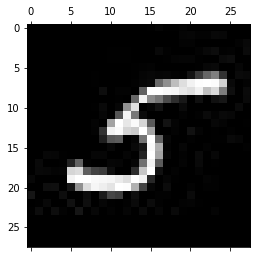

-------------------------------------------
Test: 295
Predicted: 4


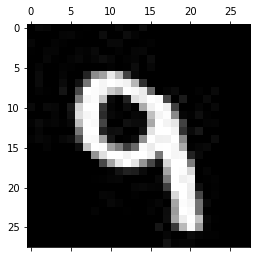

-------------------------------------------
Test: 296
Predicted: 2


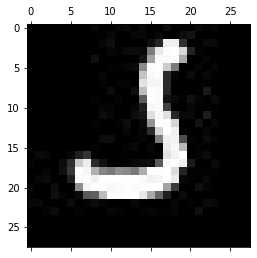

-------------------------------------------
Test: 297
Predicted: 2


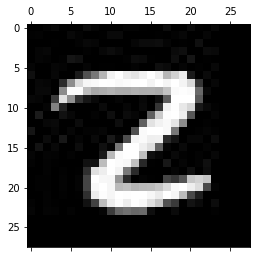

-------------------------------------------
Test: 298
Predicted: 3


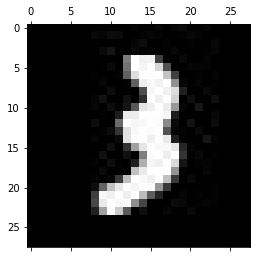

-------------------------------------------
Test: 299
Predicted: 0


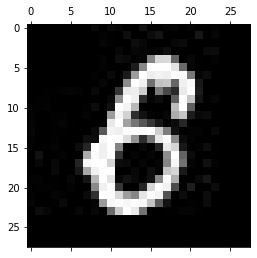

-------------------------------------------
Test: 300
Predicted: 1


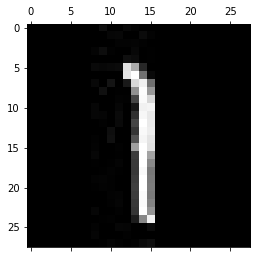

-------------------------------------------
Test: 301
Predicted: 5


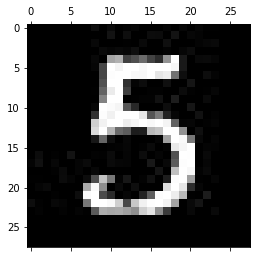

-------------------------------------------
Test: 302
Predicted: 4


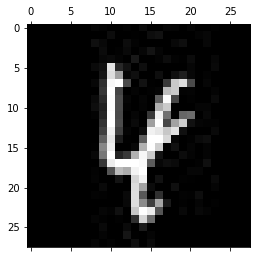

-------------------------------------------
Test: 303
Predicted: 5


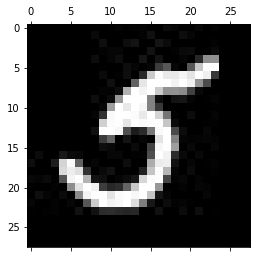

-------------------------------------------
Test: 304
Predicted: 7


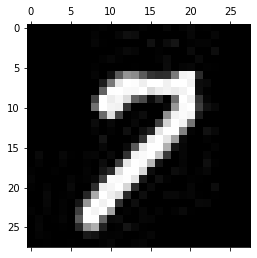

-------------------------------------------
Test: 305
Predicted: 2


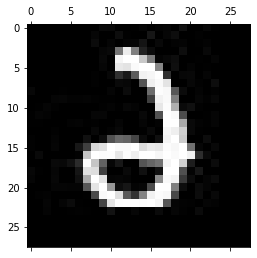

-------------------------------------------
Test: 306
Predicted: 8


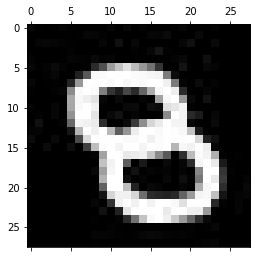

-------------------------------------------
Test: 307
Predicted: 0


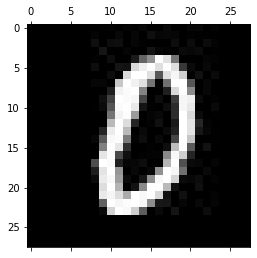

-------------------------------------------
Test: 308
Predicted: 3


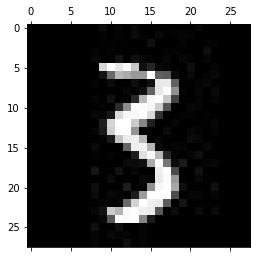

-------------------------------------------
Test: 309
Predicted: 2


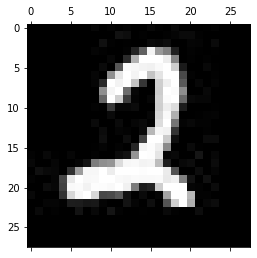

-------------------------------------------
Test: 310
Predicted: 3


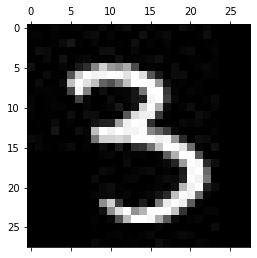

-------------------------------------------
Test: 311
Predicted: 2


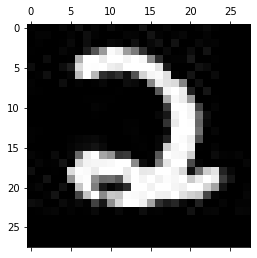

-------------------------------------------
Test: 312
Predicted: 2


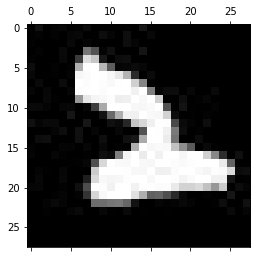

-------------------------------------------
Test: 313
Predicted: 5


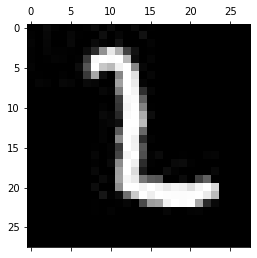

-------------------------------------------
Test: 314
Predicted: 8


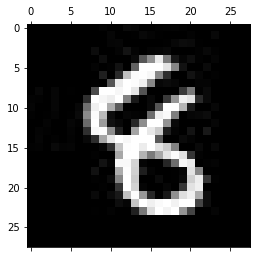

-------------------------------------------
Test: 315
Predicted: 8


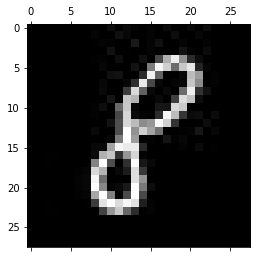

-------------------------------------------
Test: 316
Predicted: 6


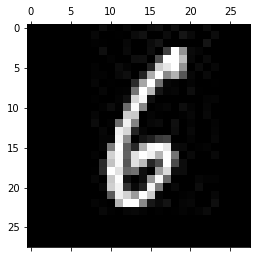

-------------------------------------------
Test: 317
Predicted: 1


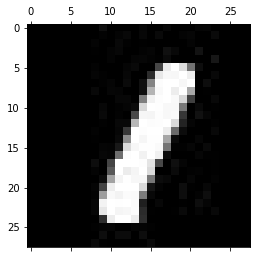

-------------------------------------------
Test: 318
Predicted: 1


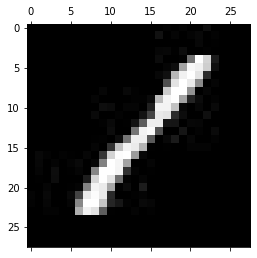

-------------------------------------------
Test: 319
Predicted: 7


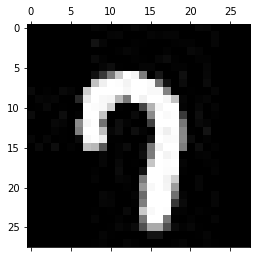

-------------------------------------------
Test: 320
Predicted: 6


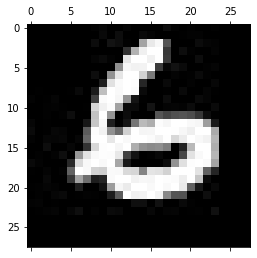

-------------------------------------------
Test: 321
Predicted: 8


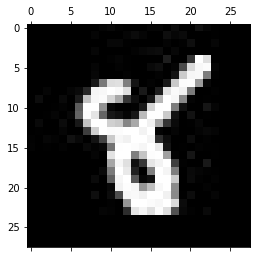

-------------------------------------------
Test: 322
Predicted: 6


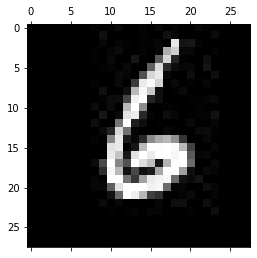

-------------------------------------------
Test: 323
Predicted: 0


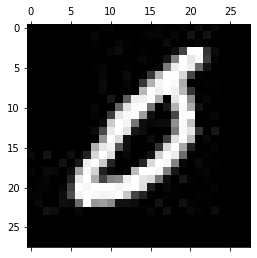

-------------------------------------------
Test: 324
Predicted: 7


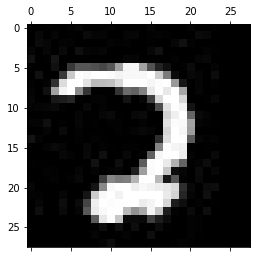

-------------------------------------------
Test: 325
Predicted: 5


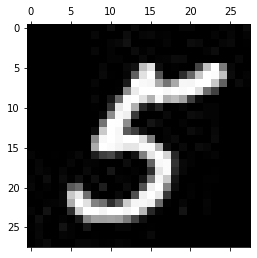

-------------------------------------------
Test: 326
Predicted: 4


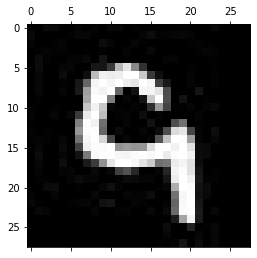

-------------------------------------------
Test: 327
Predicted: 1


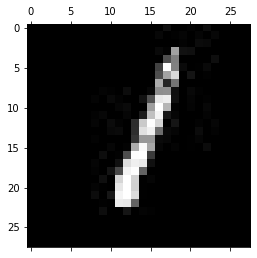

-------------------------------------------
Test: 328
Predicted: 1


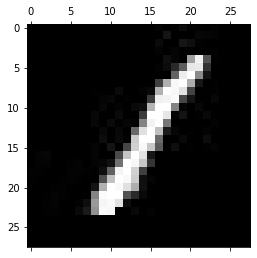

-------------------------------------------
Test: 329
Predicted: 1


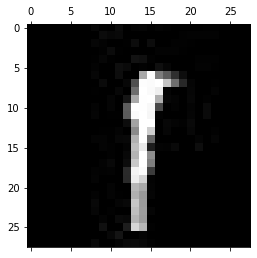

-------------------------------------------
Test: 330
Predicted: 5


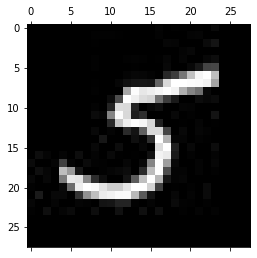

-------------------------------------------
Test: 331
Predicted: 3


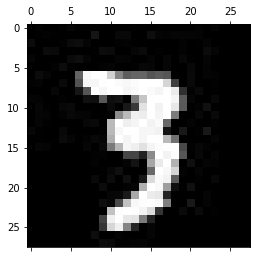

-------------------------------------------
Test: 332
Predicted: 5


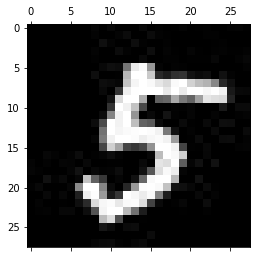

-------------------------------------------
Test: 333
Predicted: 4


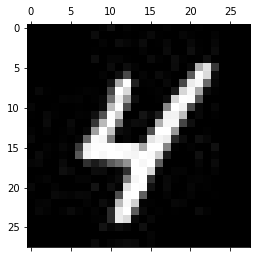

-------------------------------------------
Test: 334
Predicted: 6


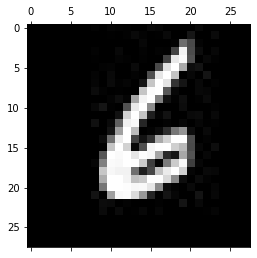

-------------------------------------------
Test: 335
Predicted: 0


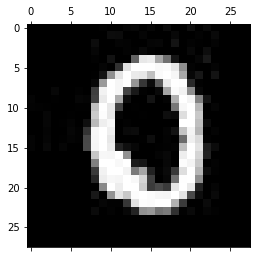

-------------------------------------------
Test: 336
Predicted: 6


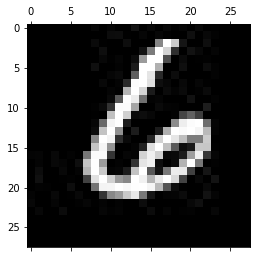

-------------------------------------------
Test: 337
Predicted: 8


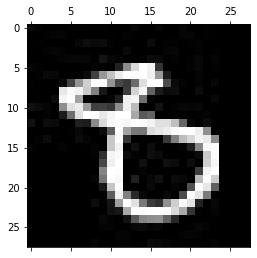

-------------------------------------------
Test: 338
Predicted: 6


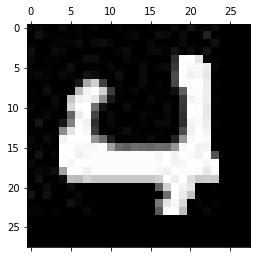

-------------------------------------------
Test: 339
Predicted: 0


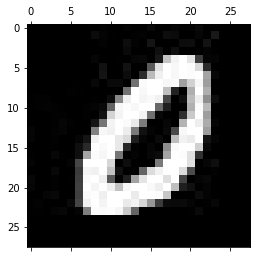

-------------------------------------------
Test: 340
Predicted: 5


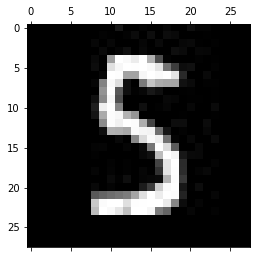

-------------------------------------------
Test: 341
Predicted: 4


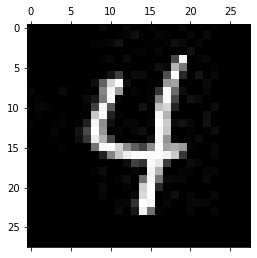

-------------------------------------------
Test: 342
Predicted: 4


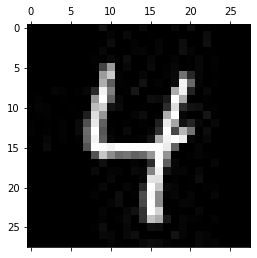

-------------------------------------------
Test: 343
Predicted: 9


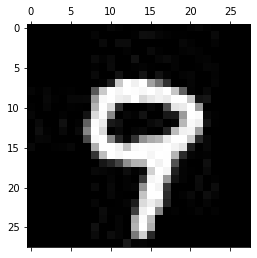

-------------------------------------------
Test: 344
Predicted: 2


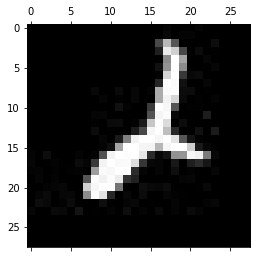

-------------------------------------------
Test: 345
Predicted: 3


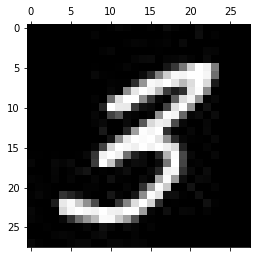

-------------------------------------------
Test: 346
Predicted: 3


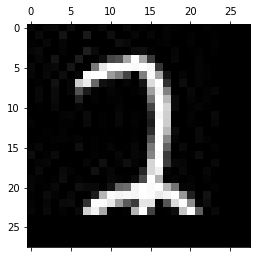

-------------------------------------------
Test: 347
Predicted: 0


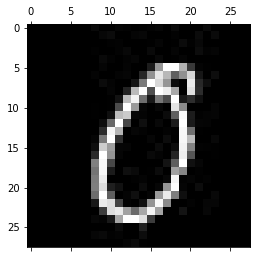

-------------------------------------------
Test: 348
Predicted: 8


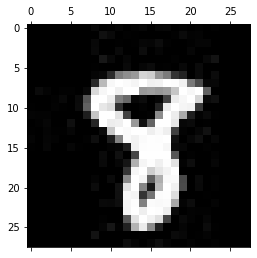

-------------------------------------------
Test: 349
Predicted: 7


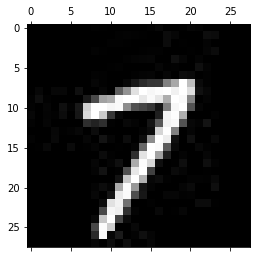

-------------------------------------------
Test: 350
Predicted: 5


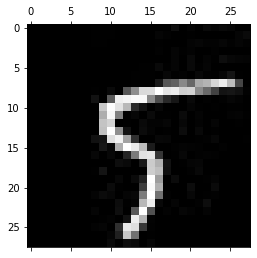

-------------------------------------------
Test: 351
Predicted: 2


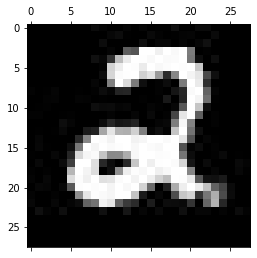

-------------------------------------------
Test: 352
Predicted: 5


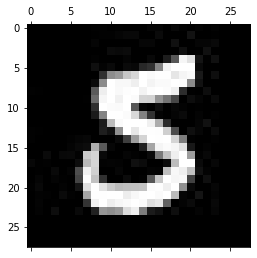

-------------------------------------------
Test: 353
Predicted: 5


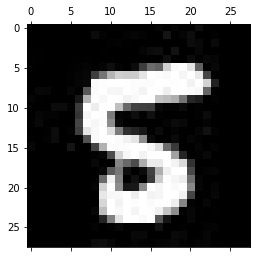

-------------------------------------------
Test: 354
Predicted: 1


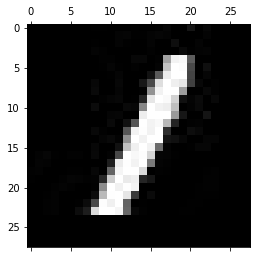

-------------------------------------------
Test: 355
Predicted: 7


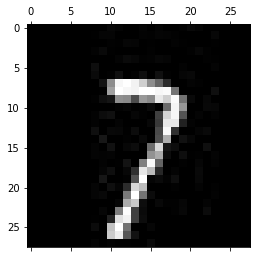

-------------------------------------------
Test: 356
Predicted: 9


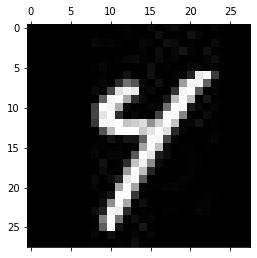

-------------------------------------------
Test: 357
Predicted: 9


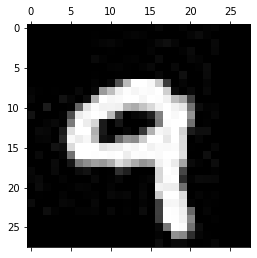

-------------------------------------------
Test: 358
Predicted: 2


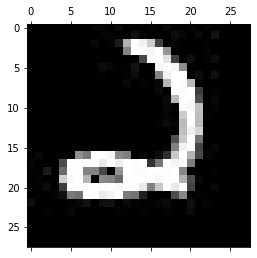

-------------------------------------------
Test: 359
Predicted: 6


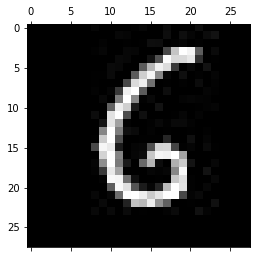

-------------------------------------------
Test: 360
Predicted: 7


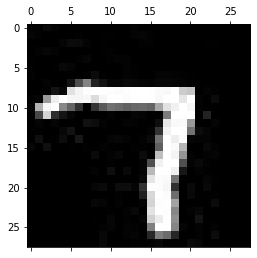

-------------------------------------------
Test: 361
Predicted: 5


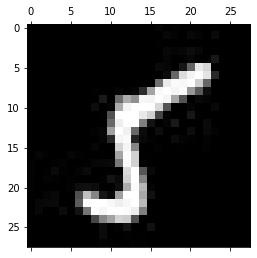

-------------------------------------------
Test: 362
Predicted: 2


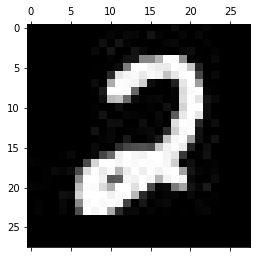

-------------------------------------------
Test: 363
Predicted: 2


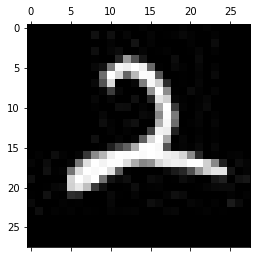

-------------------------------------------
Test: 364
Predicted: 7


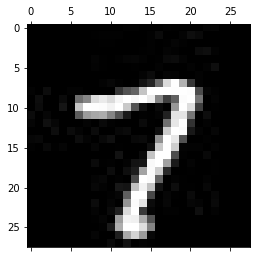

-------------------------------------------
Test: 365
Predicted: 9


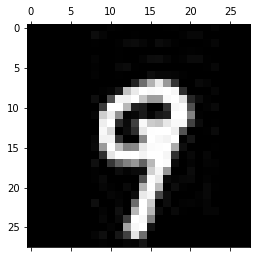

-------------------------------------------
Test: 366
Predicted: 7


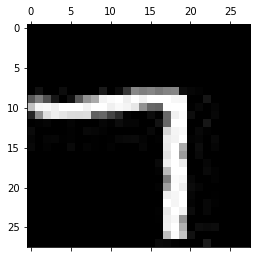

-------------------------------------------
Test: 367
Predicted: 1


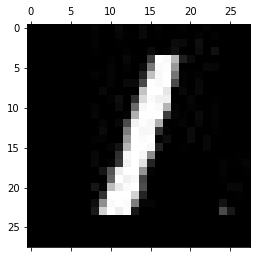

-------------------------------------------
Test: 368
Predicted: 6


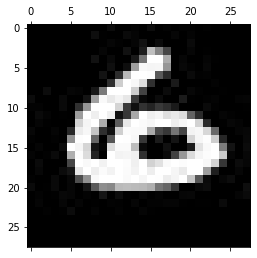

-------------------------------------------
Test: 369
Predicted: 6


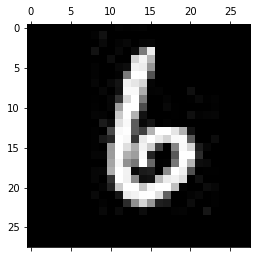

-------------------------------------------
Test: 370
Predicted: 6


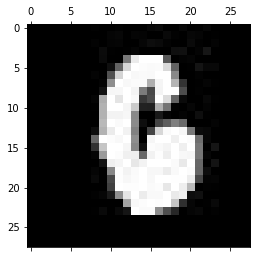

-------------------------------------------
Test: 371
Predicted: 9


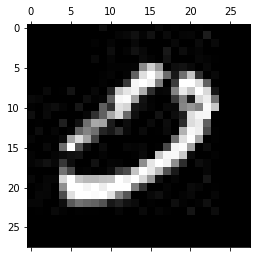

-------------------------------------------
Test: 372
Predicted: 6


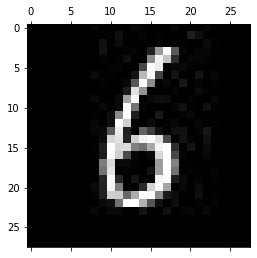

-------------------------------------------
Test: 373
Predicted: 2


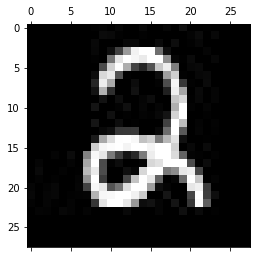

-------------------------------------------
Test: 374
Predicted: 0


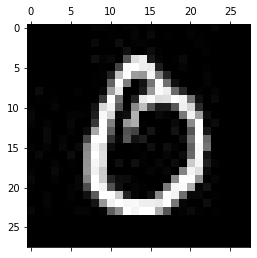

-------------------------------------------
Test: 375
Predicted: 8


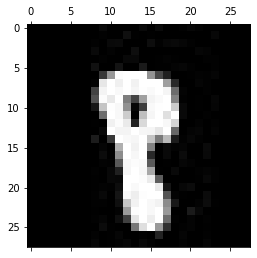

-------------------------------------------
Test: 376
Predicted: 1


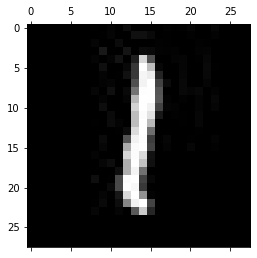

-------------------------------------------
Test: 377
Predicted: 6


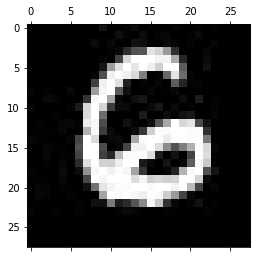

-------------------------------------------
Test: 378
Predicted: 4


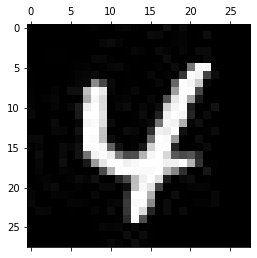

-------------------------------------------
Test: 379
Predicted: 9


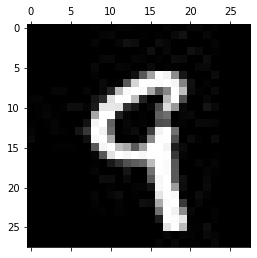

-------------------------------------------
Test: 380
Predicted: 0


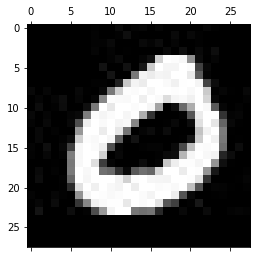

-------------------------------------------
Test: 381
Predicted: 4


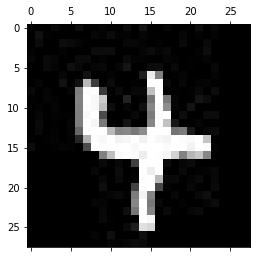

-------------------------------------------
Test: 382
Predicted: 3


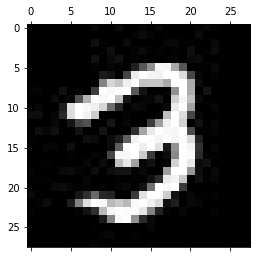

-------------------------------------------
Test: 383
Predicted: 7


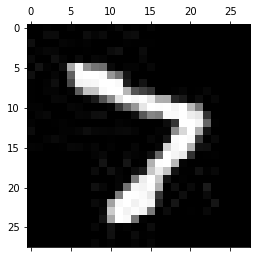

-------------------------------------------
Test: 384
Predicted: 7


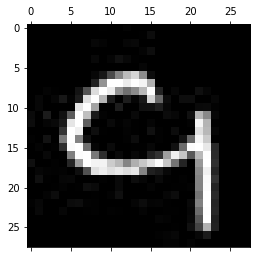

-------------------------------------------
Test: 385
Predicted: 9


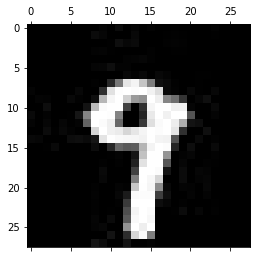

-------------------------------------------
Test: 386
Predicted: 0


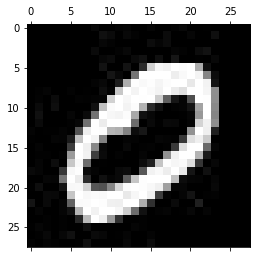

-------------------------------------------
Test: 387
Predicted: 8


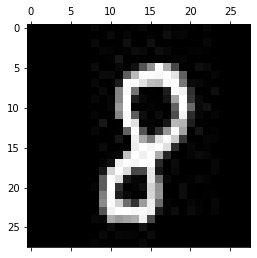

-------------------------------------------
Test: 388
Predicted: 4


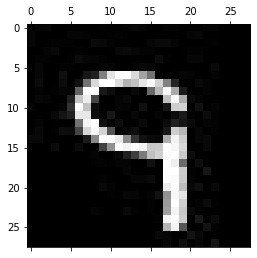

-------------------------------------------
Test: 389
Predicted: 8


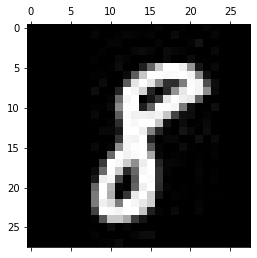

-------------------------------------------
Test: 390
Predicted: 4


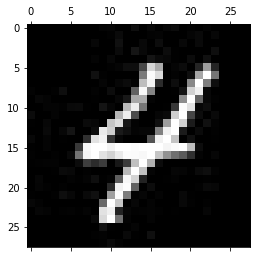

-------------------------------------------
Test: 391
Predicted: 3


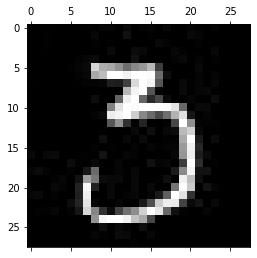

-------------------------------------------
Test: 392
Predicted: 1


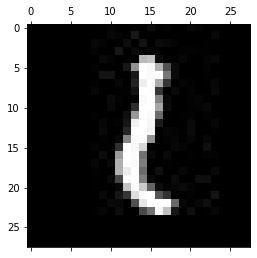

-------------------------------------------
Test: 393
Predicted: 9


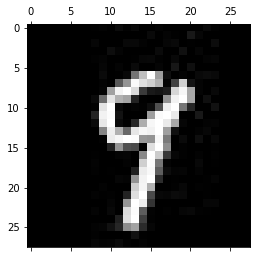

-------------------------------------------
Test: 394
Predicted: 6


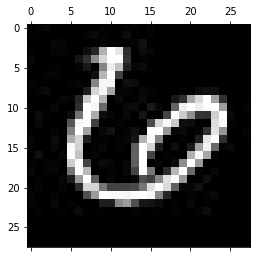

-------------------------------------------
Test: 395
Predicted: 9


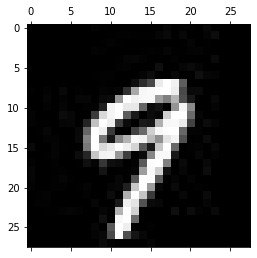

-------------------------------------------
Test: 396
Predicted: 3


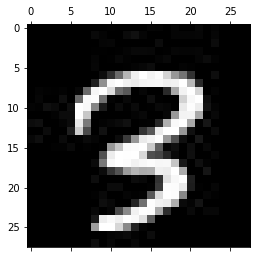

-------------------------------------------
Test: 397
Predicted: 6


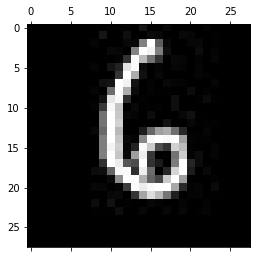

-------------------------------------------
Test: 398
Predicted: 3


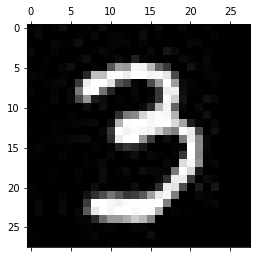

-------------------------------------------
Test: 399
Predicted: 5


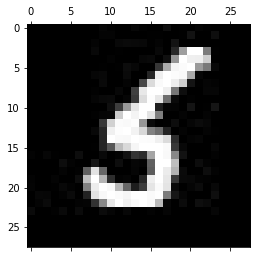

-------------------------------------------
Test: 400
Predicted: 7


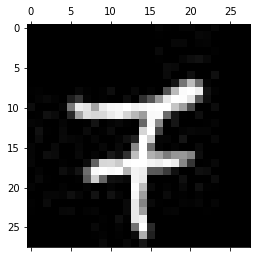

-------------------------------------------
Test: 401
Predicted: 3


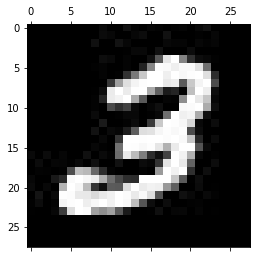

-------------------------------------------
Test: 402
Predicted: 5


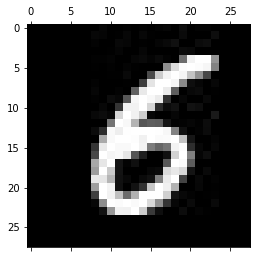

-------------------------------------------
Test: 403
Predicted: 6


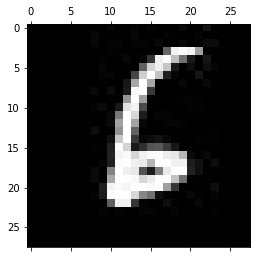

-------------------------------------------
Test: 404
Predicted: 1


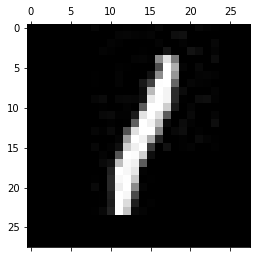

-------------------------------------------
Test: 405
Predicted: 5


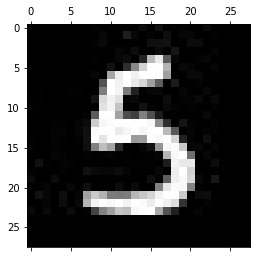

-------------------------------------------
Test: 406
Predicted: 8


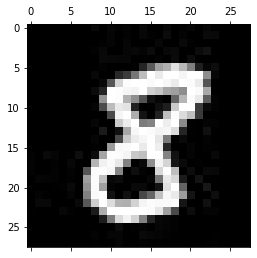

-------------------------------------------
Test: 407
Predicted: 6


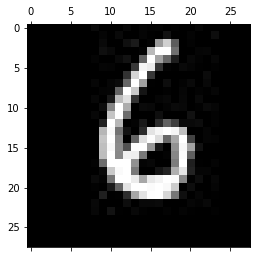

-------------------------------------------
Test: 408
Predicted: 7


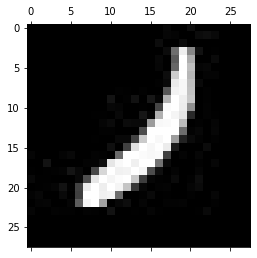

-------------------------------------------
Test: 409
Predicted: 1


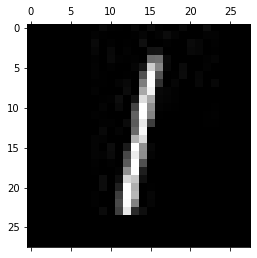

-------------------------------------------
Test: 410
Predicted: 6


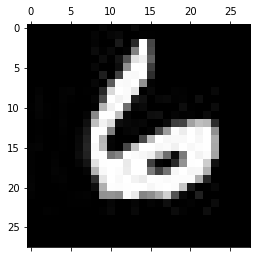

-------------------------------------------
Test: 411
Predicted: 8


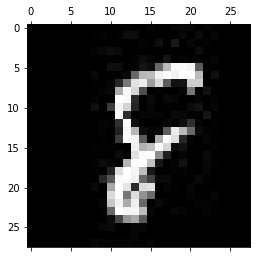

-------------------------------------------
Test: 412
Predicted: 3


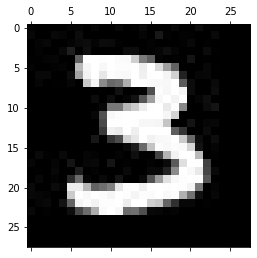

-------------------------------------------
Test: 413
Predicted: 7


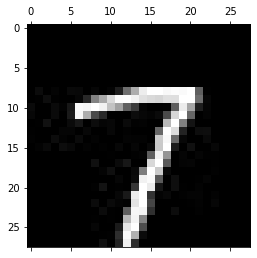

-------------------------------------------
Test: 414
Predicted: 9


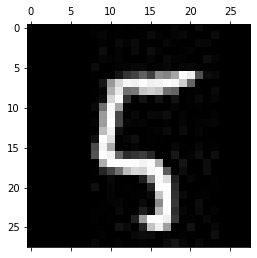

-------------------------------------------
Test: 415
Predicted: 2


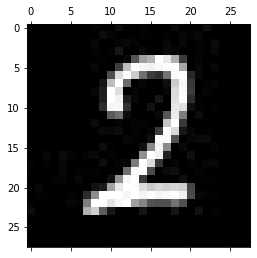

-------------------------------------------
Test: 416
Predicted: 4


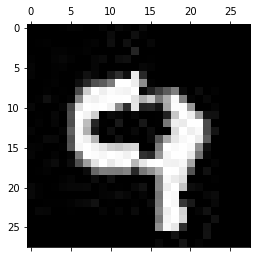

-------------------------------------------
Test: 417
Predicted: 5


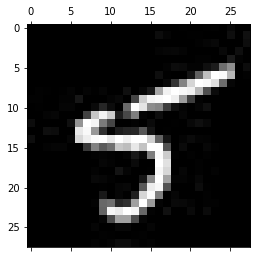

-------------------------------------------
Test: 418
Predicted: 8


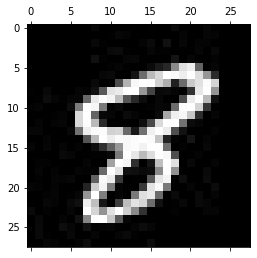

-------------------------------------------
Test: 419
Predicted: 6


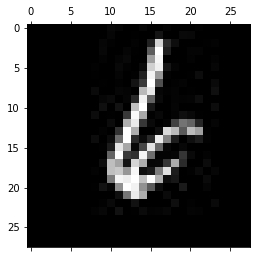

-------------------------------------------
Test: 420
Predicted: 6


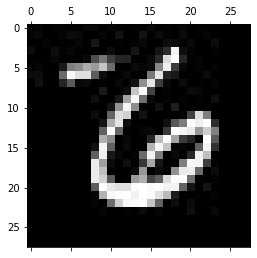

-------------------------------------------
Test: 421
Predicted: 0


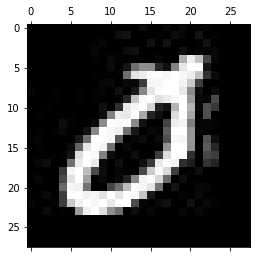

-------------------------------------------
Test: 422
Predicted: 5


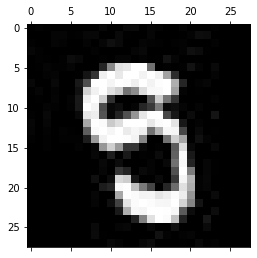

-------------------------------------------
Test: 423
Predicted: 0


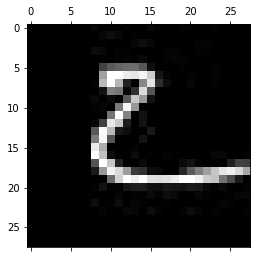

-------------------------------------------
Test: 424
Predicted: 2


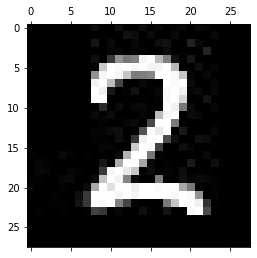

-------------------------------------------
Test: 425
Predicted: 9


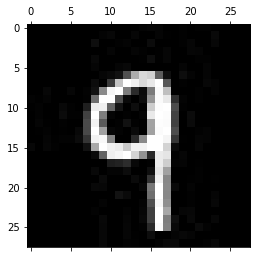

-------------------------------------------
Test: 426
Predicted: 8


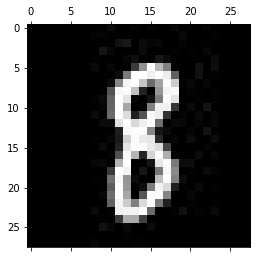

-------------------------------------------
Test: 427
Predicted: 8


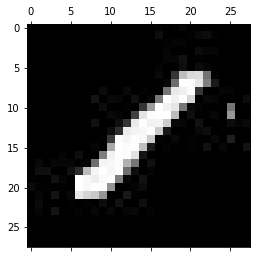

-------------------------------------------
Test: 428
Predicted: 0


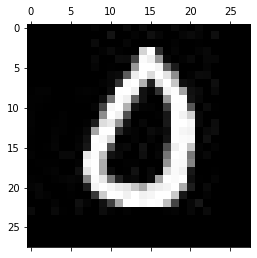

-------------------------------------------
Test: 429
Predicted: 9


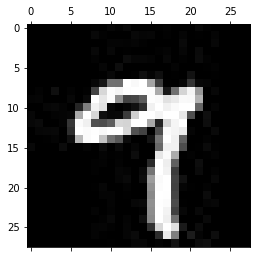

-------------------------------------------
Test: 430
Predicted: 0


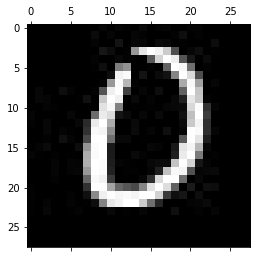

-------------------------------------------
Test: 431
Predicted: 7


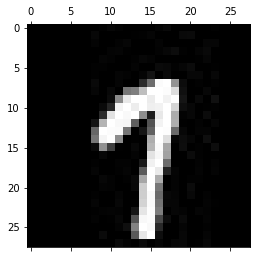

-------------------------------------------
Test: 432
Predicted: 4


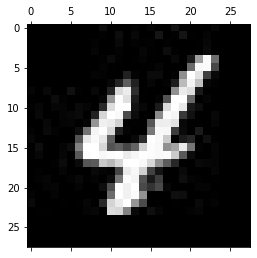

-------------------------------------------
Test: 433
Predicted: 5


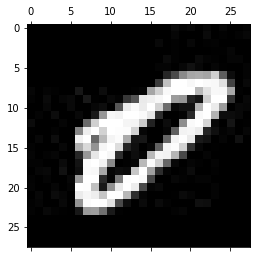

-------------------------------------------
Test: 434
Predicted: 0


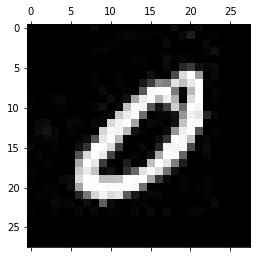

-------------------------------------------
Test: 435
Predicted: 2


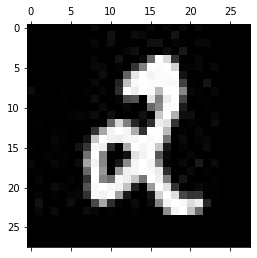

-------------------------------------------
Test: 436
Predicted: 2


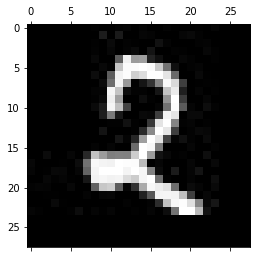

-------------------------------------------
Test: 437
Predicted: 6


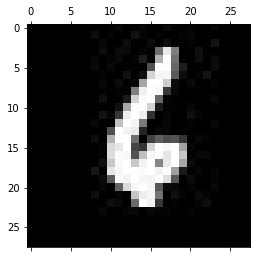

-------------------------------------------
Test: 438
Predicted: 0


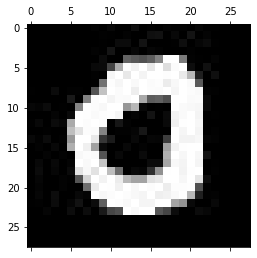

-------------------------------------------
Test: 439
Predicted: 3


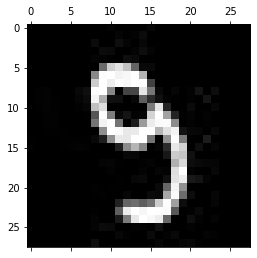

-------------------------------------------
Test: 440
Predicted: 2


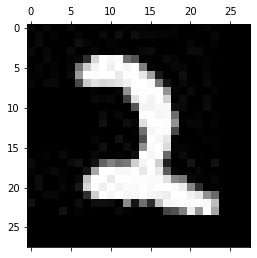

-------------------------------------------
Test: 441
Predicted: 0


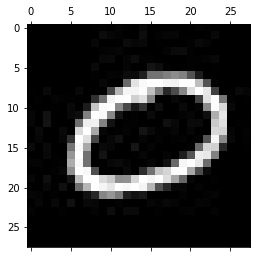

-------------------------------------------
Test: 442
Predicted: 8


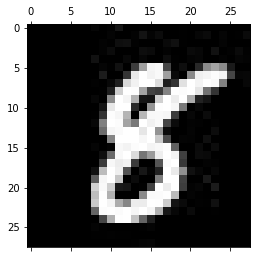

-------------------------------------------
Test: 443
Predicted: 6


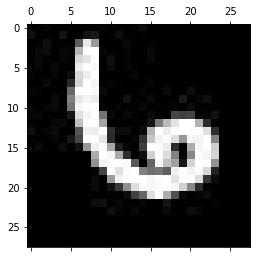

-------------------------------------------
Test: 444
Predicted: 2


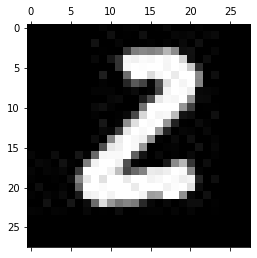

-------------------------------------------
Test: 445
Predicted: 0


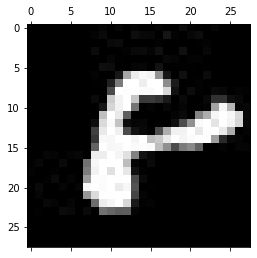

-------------------------------------------
Test: 446
Predicted: 5


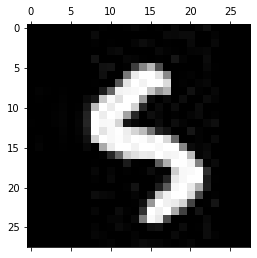

-------------------------------------------
Test: 447
Predicted: 1


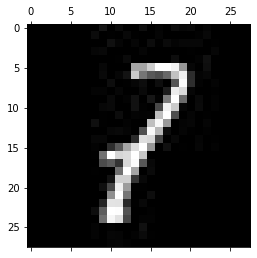

-------------------------------------------
Test: 448
Predicted: 6


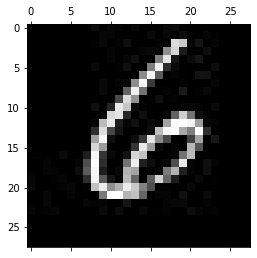

-------------------------------------------
Test: 449
Predicted: 1


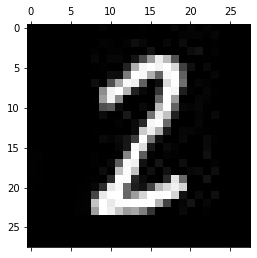

-------------------------------------------
Test: 450
Predicted: 3


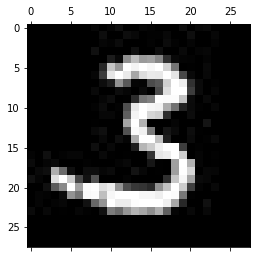

-------------------------------------------
Test: 451
Predicted: 5


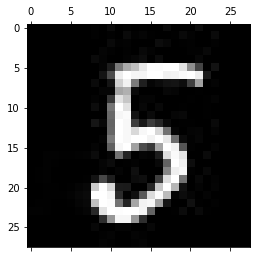

-------------------------------------------
Test: 452
Predicted: 8


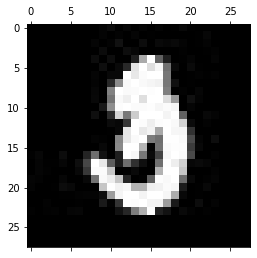

-------------------------------------------
Test: 453
Predicted: 2


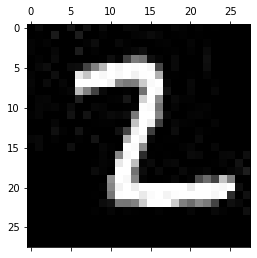

-------------------------------------------
Test: 454
Predicted: 7


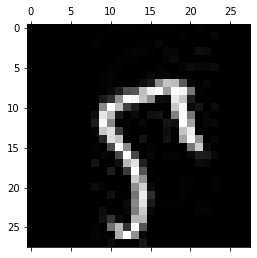

-------------------------------------------
Test: 455
Predicted: 4


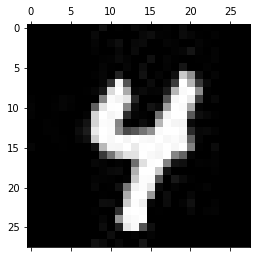

-------------------------------------------
Test: 456
Predicted: 5


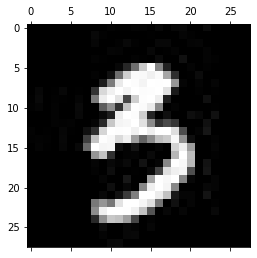

-------------------------------------------
Test: 457
Predicted: 3


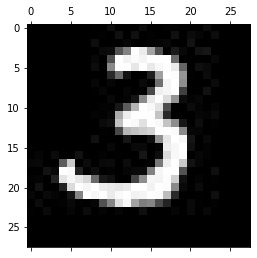

-------------------------------------------
Test: 458
Predicted: 0


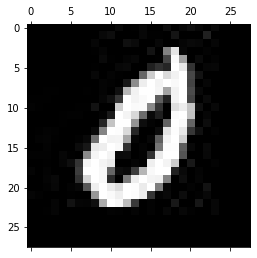

-------------------------------------------
Test: 459
Predicted: 6


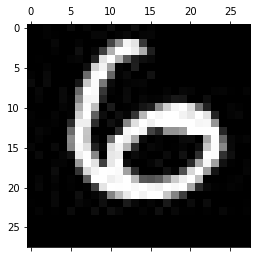

-------------------------------------------
Test: 460
Predicted: 7


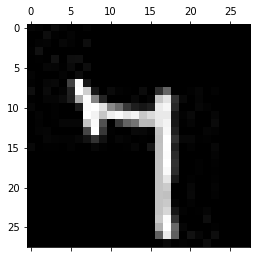

-------------------------------------------
Test: 461
Predicted: 0


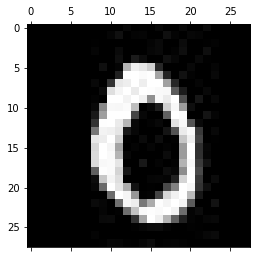

-------------------------------------------
Test: 462
Predicted: 5


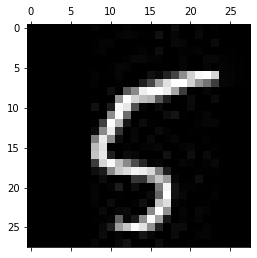

-------------------------------------------
Test: 463
Predicted: 3


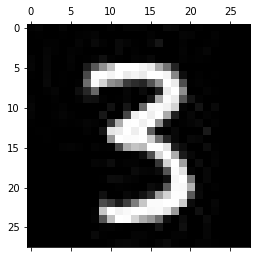

-------------------------------------------
Test: 464
Predicted: 2


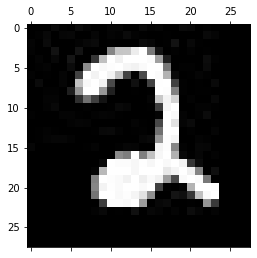

-------------------------------------------
Test: 465
Predicted: 2


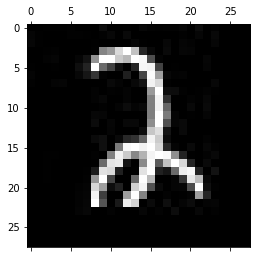

-------------------------------------------
Test: 466
Predicted: 2


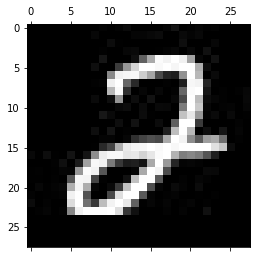

-------------------------------------------
Test: 467
Predicted: 2


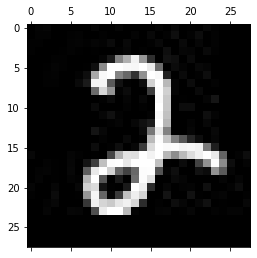

-------------------------------------------
Test: 468
Predicted: 8


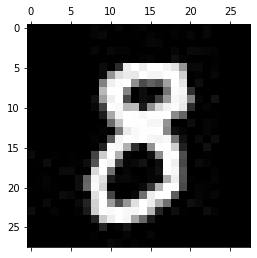

-------------------------------------------
Test: 469
Predicted: 2


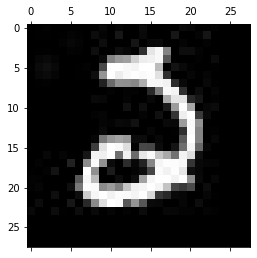

-------------------------------------------
Test: 470
Predicted: 5


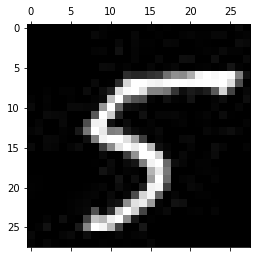

-------------------------------------------
Test: 471
Predicted: 5


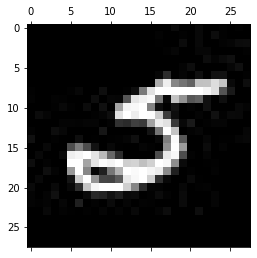

-------------------------------------------
Test: 472
Predicted: 0


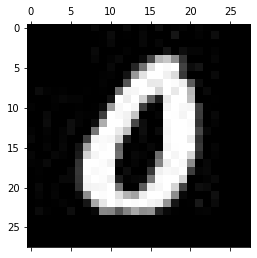

-------------------------------------------
Test: 473
Predicted: 0


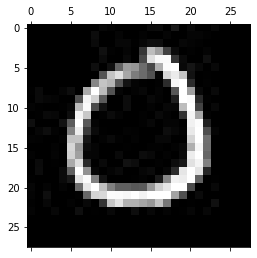

-------------------------------------------
Test: 474
Predicted: 9


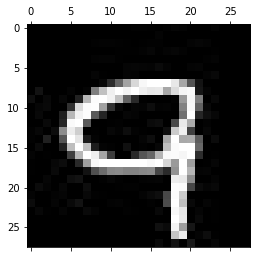

-------------------------------------------
Test: 475
Predicted: 1


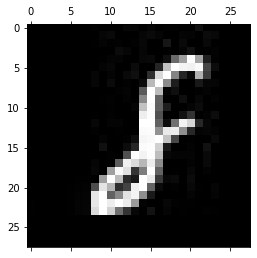

-------------------------------------------
Test: 476
Predicted: 2


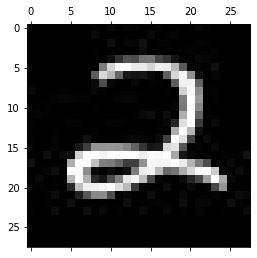

-------------------------------------------
Test: 477
Predicted: 0


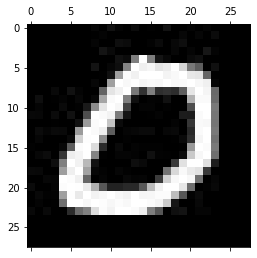

-------------------------------------------
Test: 478
Predicted: 7


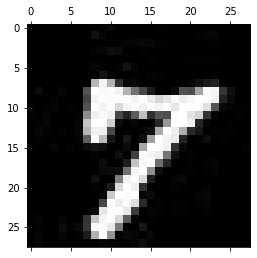

-------------------------------------------
Test: 479
Predicted: 1


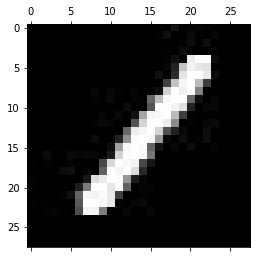

-------------------------------------------
Test: 480
Predicted: 5


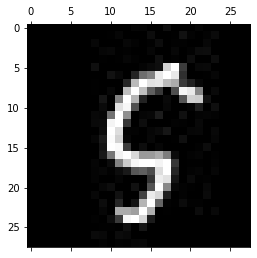

-------------------------------------------
Test: 481
Predicted: 5


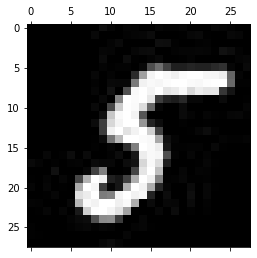

-------------------------------------------
Test: 482
Predicted: 1


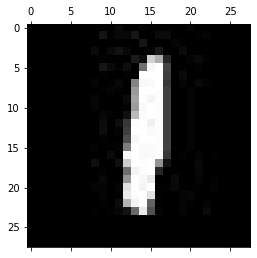

-------------------------------------------
Test: 483
Predicted: 1


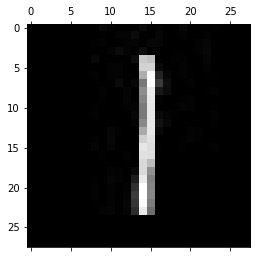

-------------------------------------------
Test: 484
Predicted: 8


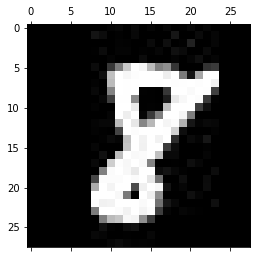

-------------------------------------------
Test: 485
Predicted: 5


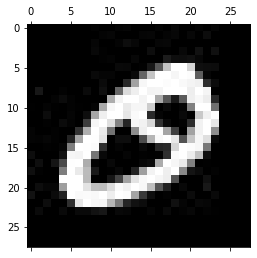

-------------------------------------------
Test: 486
Predicted: 3


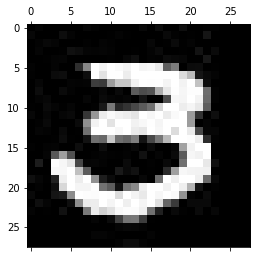

-------------------------------------------
Test: 487
Predicted: 6


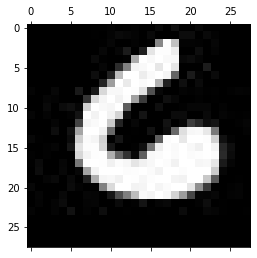

-------------------------------------------
Test: 488
Predicted: 8


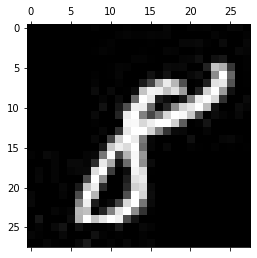

-------------------------------------------
Test: 489
Predicted: 0


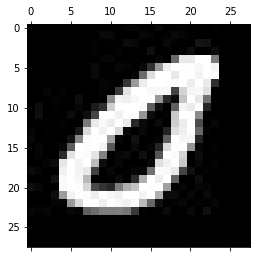

-------------------------------------------
Test: 490
Predicted: 9


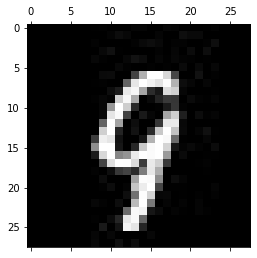

-------------------------------------------
Test: 491
Predicted: 7


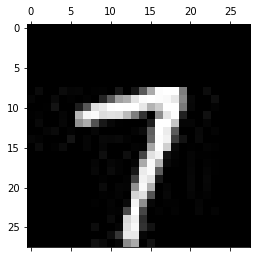

-------------------------------------------
Test: 492
Predicted: 3


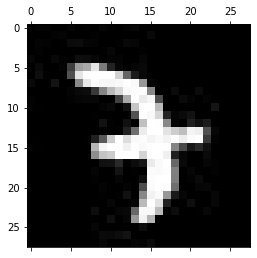

-------------------------------------------
Test: 493
Predicted: 5


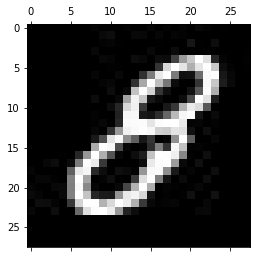

-------------------------------------------
Test: 494
Predicted: 5


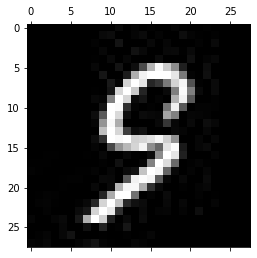

-------------------------------------------
Test: 495
Predicted: 1


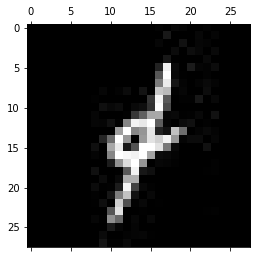

-------------------------------------------
Test: 496
Predicted: 0


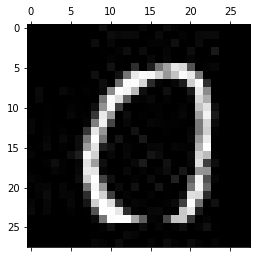

-------------------------------------------
Test: 497
Predicted: 9


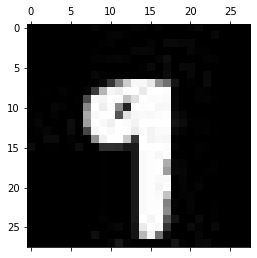

-------------------------------------------
Test: 498
Predicted: 6


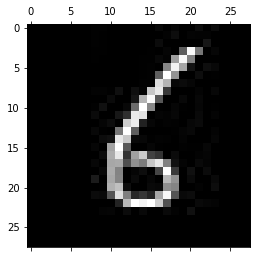

-------------------------------------------
Test: 499
Predicted: 2


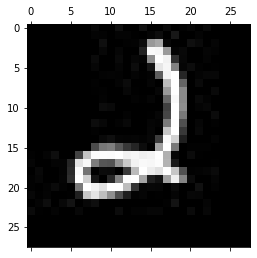

-------------------------------------------
Test: 500
Predicted: 0


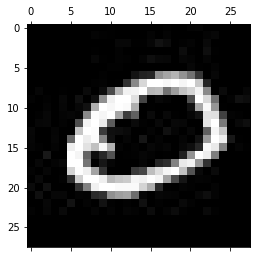

-------------------------------------------
Test: 501
Predicted: 5


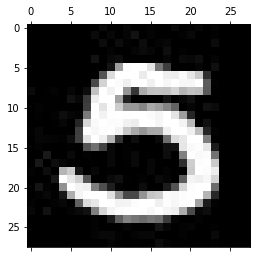

-------------------------------------------
Test: 502
Predicted: 0


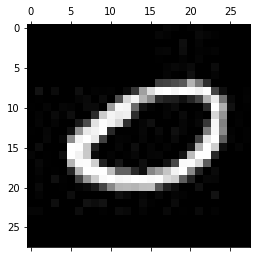

-------------------------------------------
Test: 503
Predicted: 1


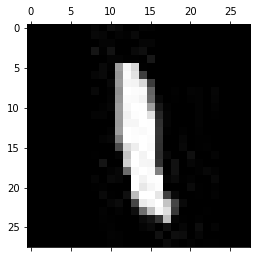

-------------------------------------------
Test: 504
Predicted: 1


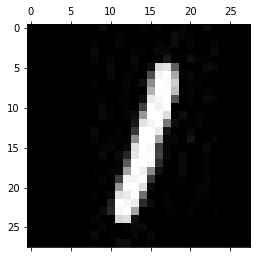

-------------------------------------------
Test: 505
Predicted: 5


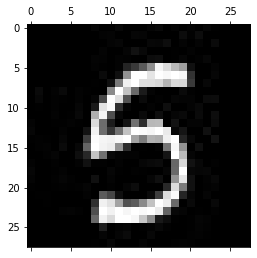

-------------------------------------------
Test: 506
Predicted: 1


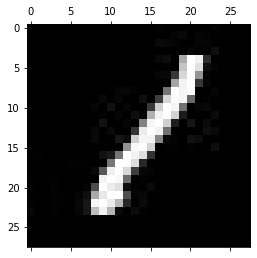

-------------------------------------------
Test: 507
Predicted: 6


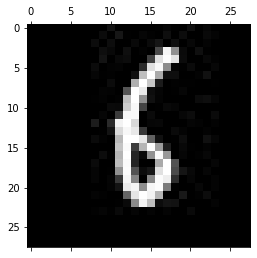

-------------------------------------------
Test: 508
Predicted: 2


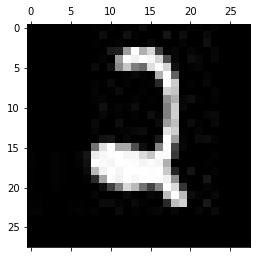

-------------------------------------------
Test: 509
Predicted: 3


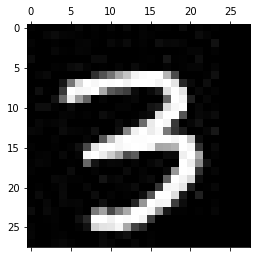

-------------------------------------------
Test: 510
Predicted: 7


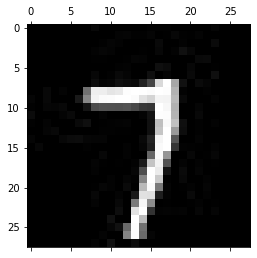

-------------------------------------------
Test: 511
Predicted: 0


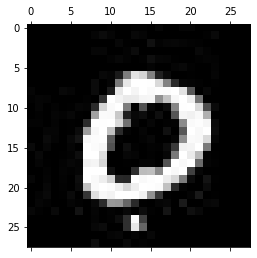

-------------------------------------------
Test: 512
Predicted: 2


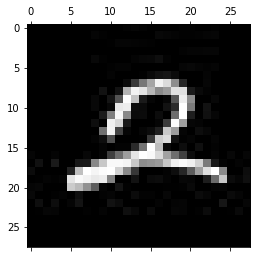

-------------------------------------------
Test: 513
Predicted: 6


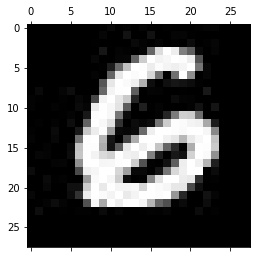

-------------------------------------------
Test: 514
Predicted: 7


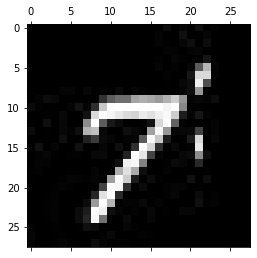

-------------------------------------------
Test: 515
Predicted: 8


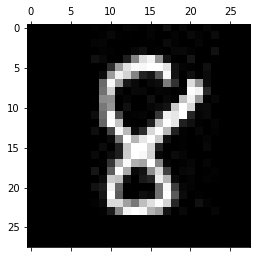

-------------------------------------------
Test: 516
Predicted: 4


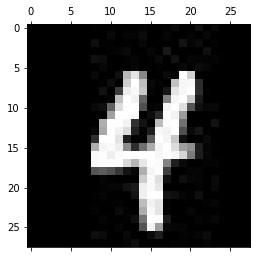

-------------------------------------------
Test: 517
Predicted: 3


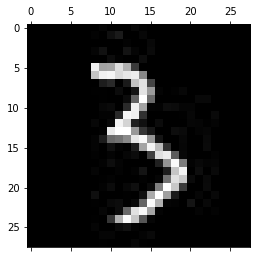

-------------------------------------------
Test: 518
Predicted: 9


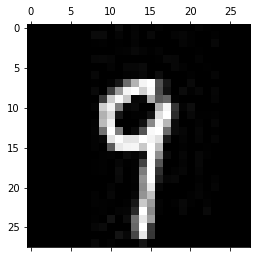

-------------------------------------------
Test: 519
Predicted: 9


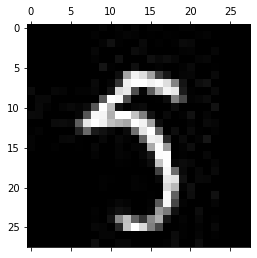

-------------------------------------------
Test: 520
Predicted: 6


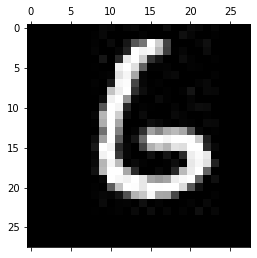

-------------------------------------------
Test: 521
Predicted: 0


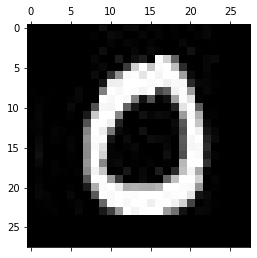

-------------------------------------------
Test: 522
Predicted: 6


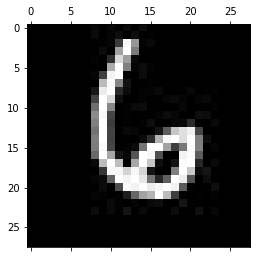

-------------------------------------------
Test: 523
Predicted: 1


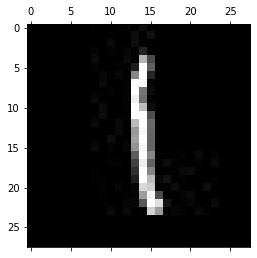

-------------------------------------------
Test: 524
Predicted: 4


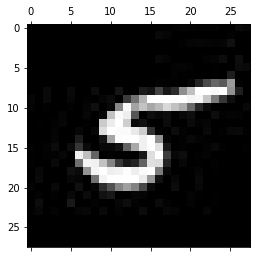

-------------------------------------------
Test: 525
Predicted: 2


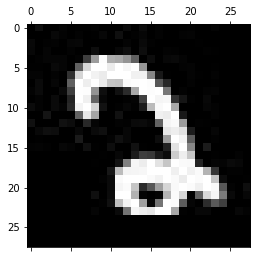

-------------------------------------------
Test: 526
Predicted: 9


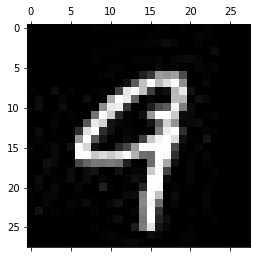

-------------------------------------------
Test: 527
Predicted: 0


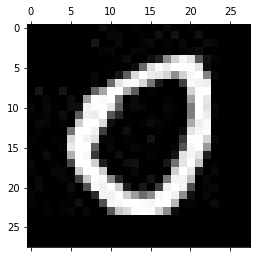

-------------------------------------------
Test: 528
Predicted: 6


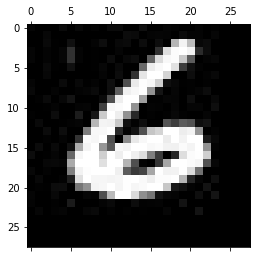

-------------------------------------------
Test: 529
Predicted: 4


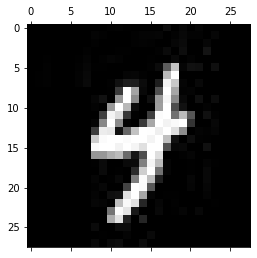

-------------------------------------------
Test: 530
Predicted: 0


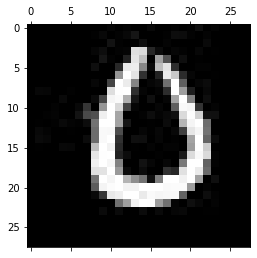

-------------------------------------------
Test: 531
Predicted: 6


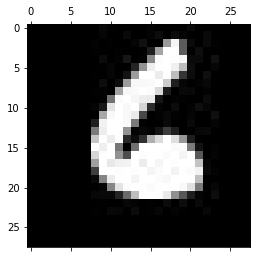

-------------------------------------------
Test: 532
Predicted: 0


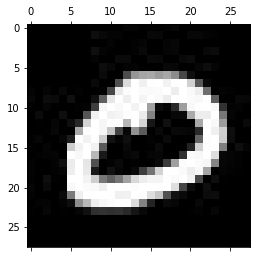

-------------------------------------------
Test: 533
Predicted: 2


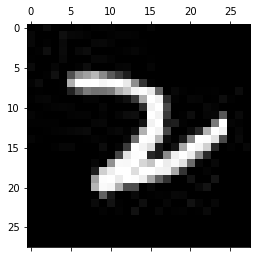

-------------------------------------------
Test: 534
Predicted: 3


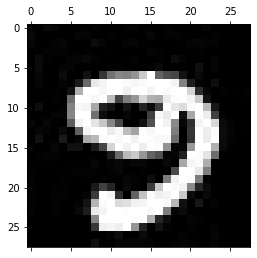

-------------------------------------------
Test: 535
Predicted: 5


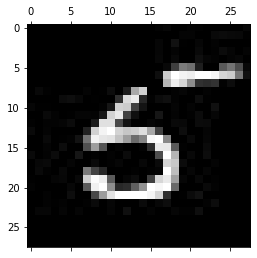

-------------------------------------------
Test: 536
Predicted: 0


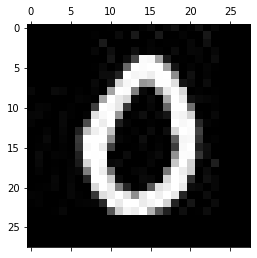

-------------------------------------------
Test: 537
Predicted: 1


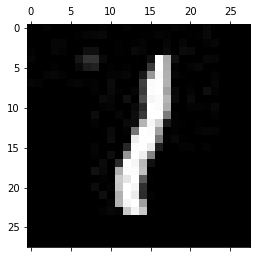

-------------------------------------------
Test: 538
Predicted: 2


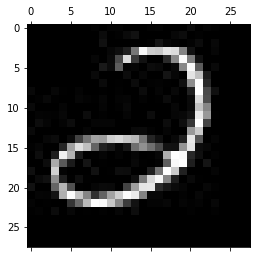

-------------------------------------------
Test: 539
Predicted: 0


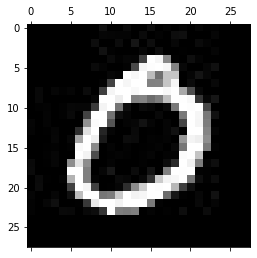

-------------------------------------------
Test: 540
Predicted: 4


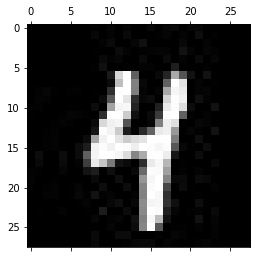

-------------------------------------------
Test: 541
Predicted: 2


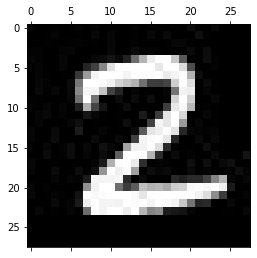

-------------------------------------------
Test: 542
Predicted: 1


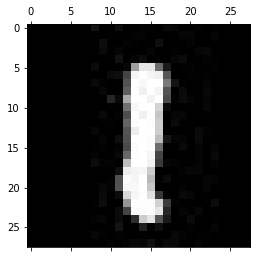

-------------------------------------------
Test: 543
Predicted: 5


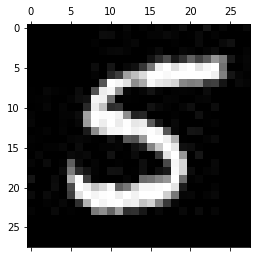

-------------------------------------------
Test: 544
Predicted: 7


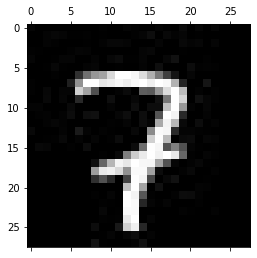

-------------------------------------------
Test: 545
Predicted: 1


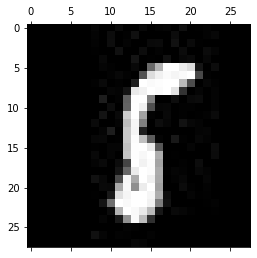

-------------------------------------------
Test: 546
Predicted: 5


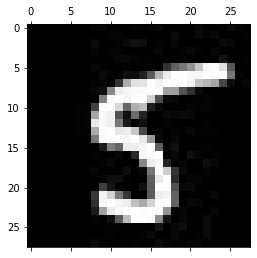

-------------------------------------------
Test: 547
Predicted: 7


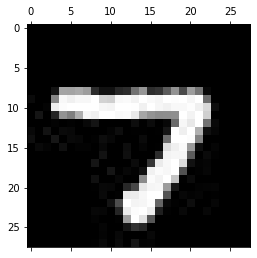

-------------------------------------------
Test: 548
Predicted: 8


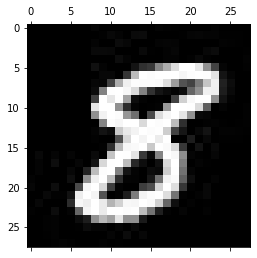

-------------------------------------------
Test: 549
Predicted: 5


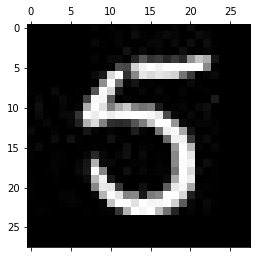

-------------------------------------------
Test: 550
Predicted: 9


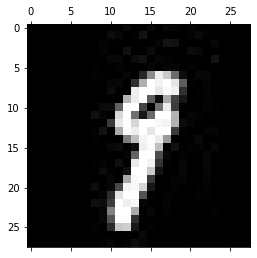

-------------------------------------------
Test: 551
Predicted: 6


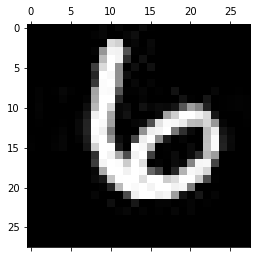

-------------------------------------------
Test: 552
Predicted: 1


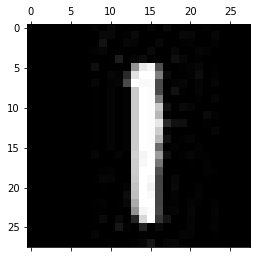

-------------------------------------------
Test: 553
Predicted: 1


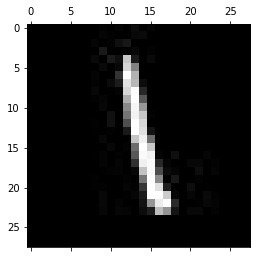

-------------------------------------------
Test: 554
Predicted: 0


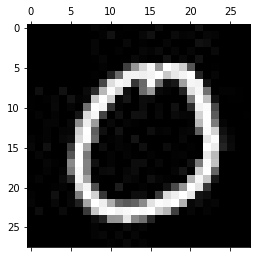

-------------------------------------------
Test: 555
Predicted: 5


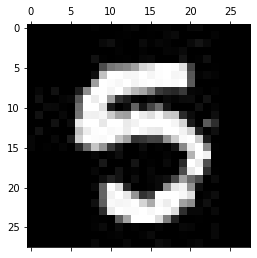

-------------------------------------------
Test: 556
Predicted: 8


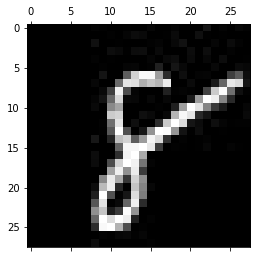

-------------------------------------------
Test: 557
Predicted: 1


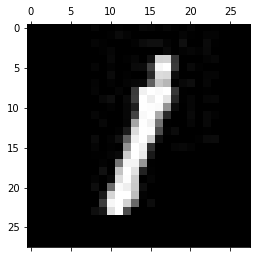

-------------------------------------------
Test: 558
Predicted: 5


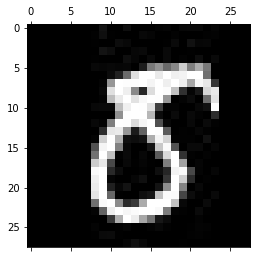

-------------------------------------------
Test: 559
Predicted: 0


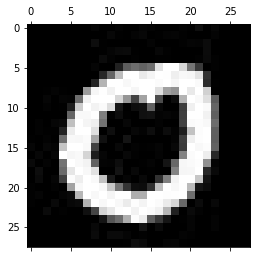

-------------------------------------------
Test: 560
Predicted: 4


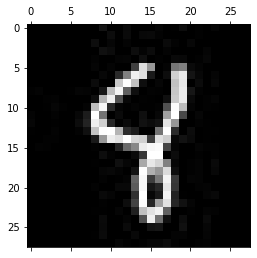

-------------------------------------------
Test: 561
Predicted: 7


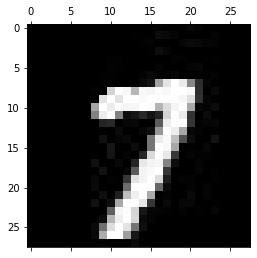

-------------------------------------------
Test: 562
Predicted: 2


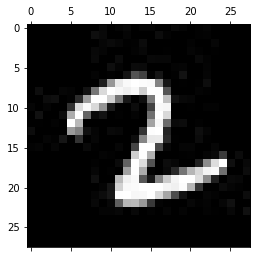

-------------------------------------------
Test: 563
Predicted: 5


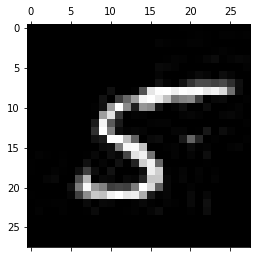

-------------------------------------------
Test: 564
Predicted: 2


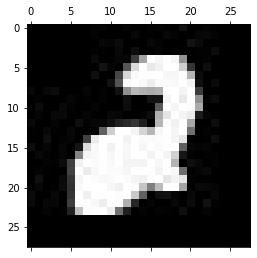

-------------------------------------------
Test: 565
Predicted: 5


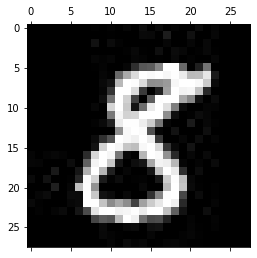

-------------------------------------------
Test: 566
Predicted: 9


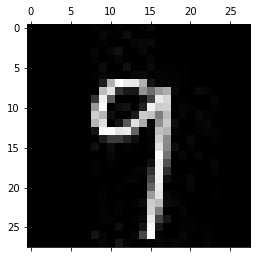

-------------------------------------------
Test: 567
Predicted: 7


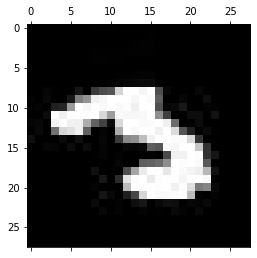

-------------------------------------------
Test: 568
Predicted: 4


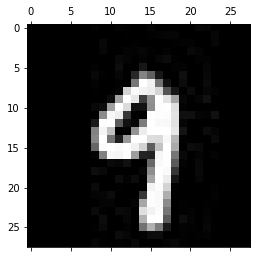

-------------------------------------------
Test: 569
Predicted: 7


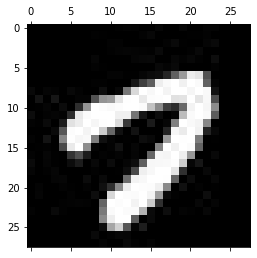

-------------------------------------------
Test: 570
Predicted: 2


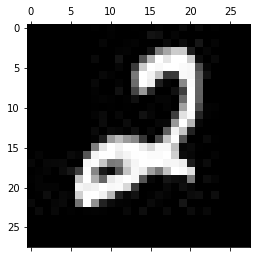

-------------------------------------------
Test: 571
Predicted: 1


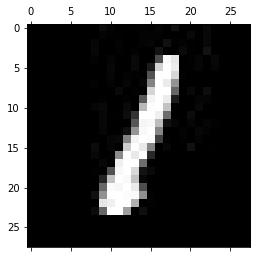

-------------------------------------------
Test: 572
Predicted: 7


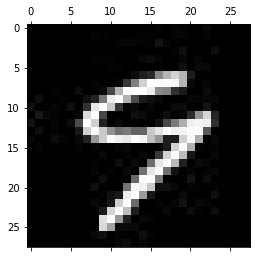

-------------------------------------------
Test: 573
Predicted: 0


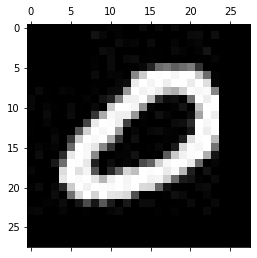

-------------------------------------------
Test: 574
Predicted: 7


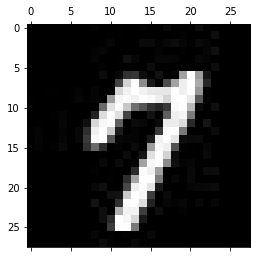

-------------------------------------------
Test: 575
Predicted: 2


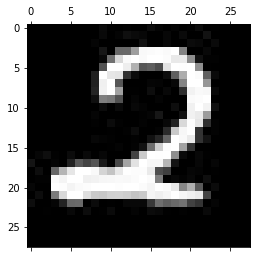

-------------------------------------------
Test: 576
Predicted: 9


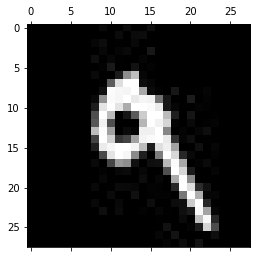

-------------------------------------------
Test: 577
Predicted: 0


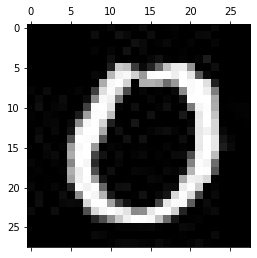

-------------------------------------------
Test: 578
Predicted: 8


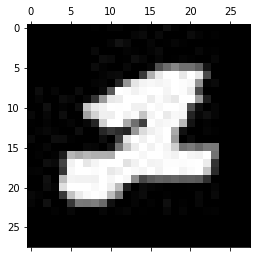

-------------------------------------------
Test: 579
Predicted: 8


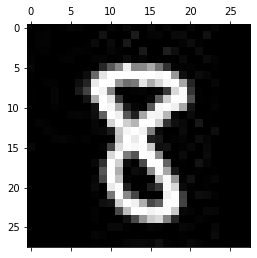

-------------------------------------------
Test: 580
Predicted: 7


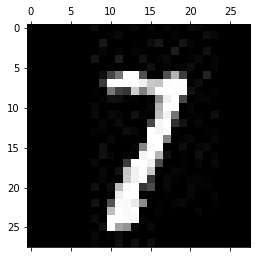

-------------------------------------------
Test: 581
Predicted: 2


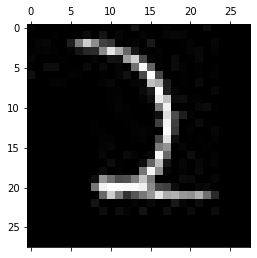

-------------------------------------------
Test: 582
Predicted: 7


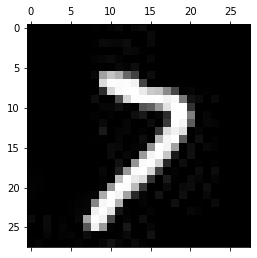

-------------------------------------------
Test: 583
Predicted: 8


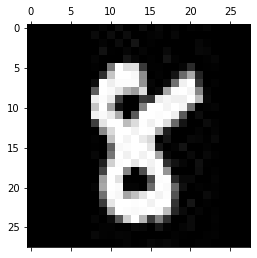

-------------------------------------------
Test: 584
Predicted: 3


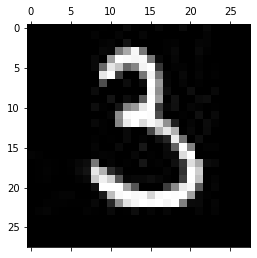

-------------------------------------------
Test: 585
Predicted: 2


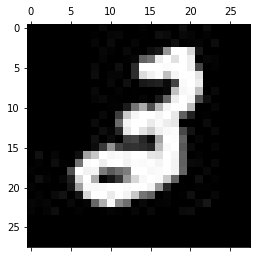

-------------------------------------------
Test: 586
Predicted: 5


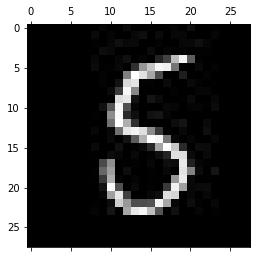

-------------------------------------------
Test: 587
Predicted: 3


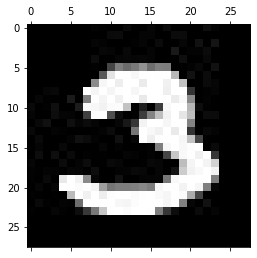

-------------------------------------------
Test: 588
Predicted: 3


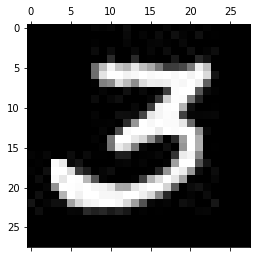

-------------------------------------------
Test: 589
Predicted: 4


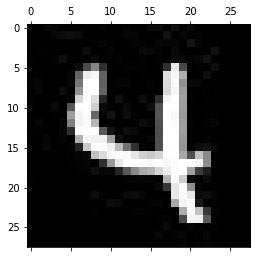

-------------------------------------------
Test: 590
Predicted: 2


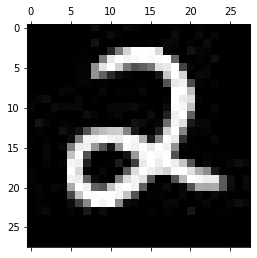

-------------------------------------------
Test: 591
Predicted: 8


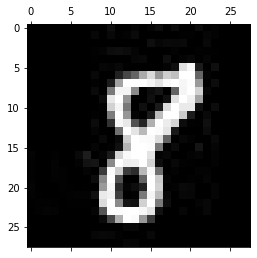

-------------------------------------------
Test: 592
Predicted: 7


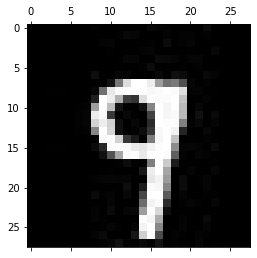

-------------------------------------------
Test: 593
Predicted: 1


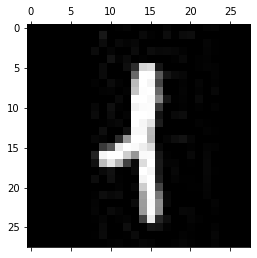

-------------------------------------------
Test: 594
Predicted: 9


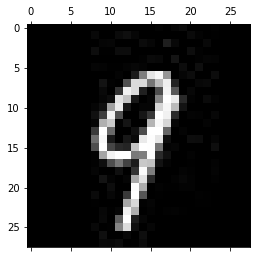

-------------------------------------------
Test: 595
Predicted: 5


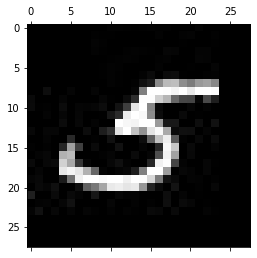

-------------------------------------------
Test: 596
Predicted: 2


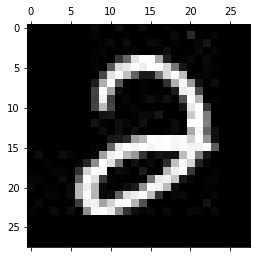

-------------------------------------------
Test: 597
Predicted: 6


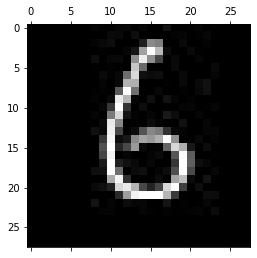

-------------------------------------------
Test: 598
Predicted: 8


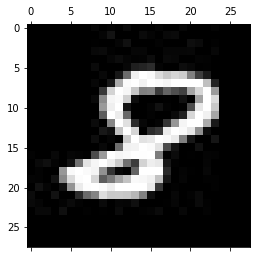

-------------------------------------------
Test: 599
Predicted: 0


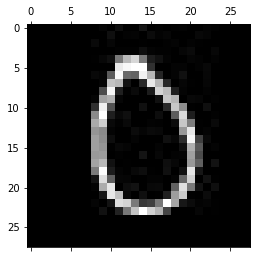

-------------------------------------------
Test: 600
Predicted: 8


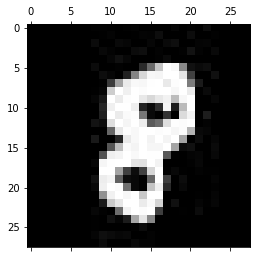

-------------------------------------------
Test: 601
Predicted: 0


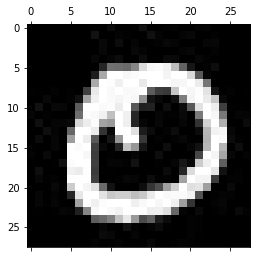

-------------------------------------------
Test: 602
Predicted: 7


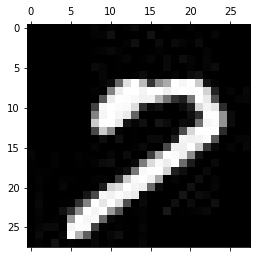

-------------------------------------------
Test: 603
Predicted: 1


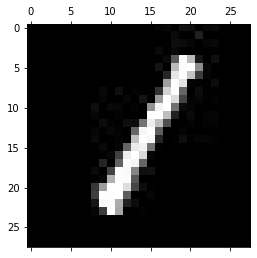

-------------------------------------------
Test: 604
Predicted: 1


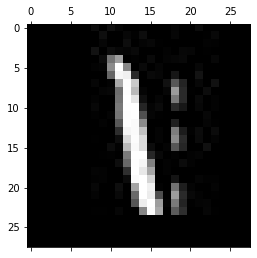

-------------------------------------------
Test: 605
Predicted: 2


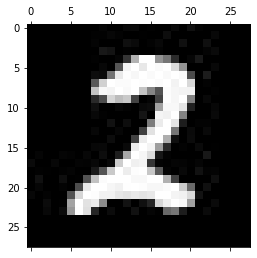

-------------------------------------------
Test: 606
Predicted: 4


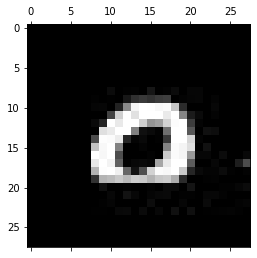

-------------------------------------------
Test: 607
Predicted: 7


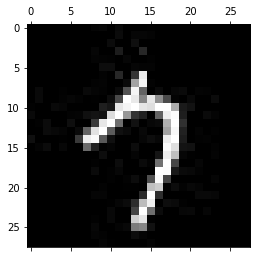

-------------------------------------------
Test: 608
Predicted: 6


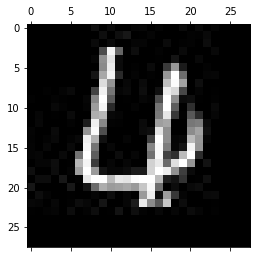

-------------------------------------------
Test: 609
Predicted: 6


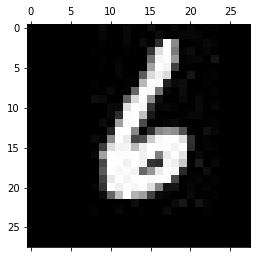

-------------------------------------------
Test: 610
Predicted: 2


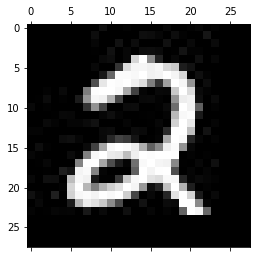

-------------------------------------------
Test: 611
Predicted: 9


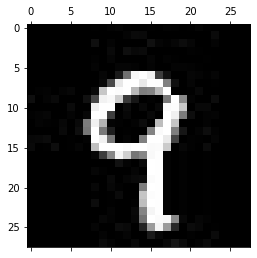

-------------------------------------------
Test: 612
Predicted: 2


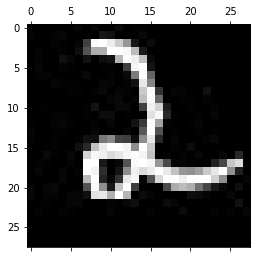

-------------------------------------------
Test: 613
Predicted: 6


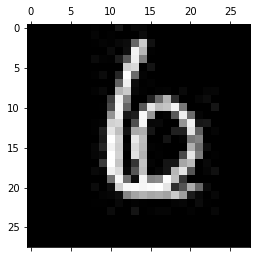

-------------------------------------------
Test: 614
Predicted: 4


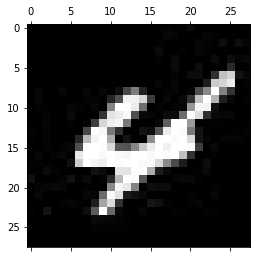

-------------------------------------------
Test: 615
Predicted: 1


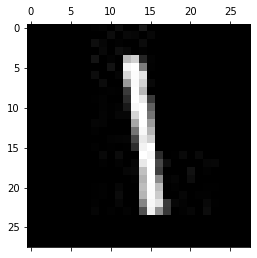

-------------------------------------------
Test: 616
Predicted: 6


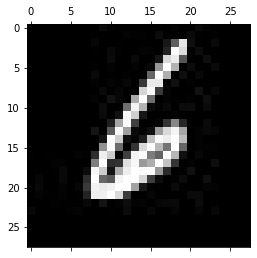

-------------------------------------------
Test: 617
Predicted: 4


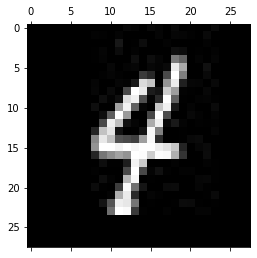

-------------------------------------------
Test: 618
Predicted: 0


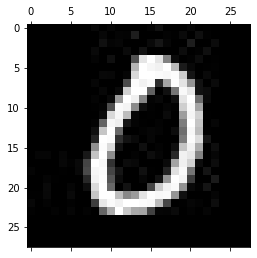

-------------------------------------------
Test: 619
Predicted: 4


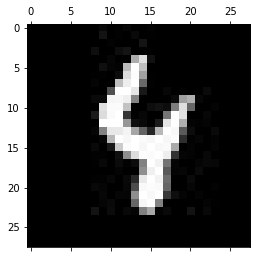

-------------------------------------------
Test: 620
Predicted: 0


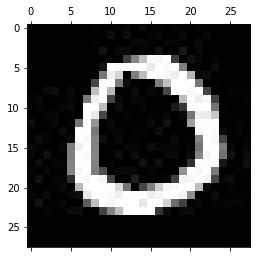

-------------------------------------------
Test: 621
Predicted: 7


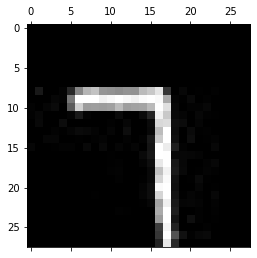

-------------------------------------------
Test: 622
Predicted: 8


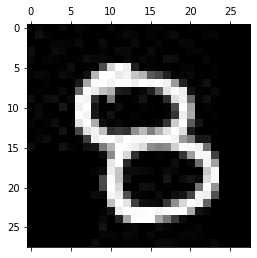

-------------------------------------------
Test: 623
Predicted: 1


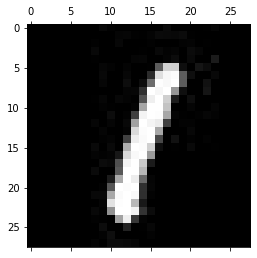

-------------------------------------------
Test: 624
Predicted: 2


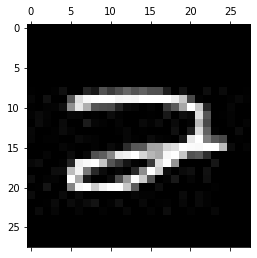

-------------------------------------------
Test: 625
Predicted: 1


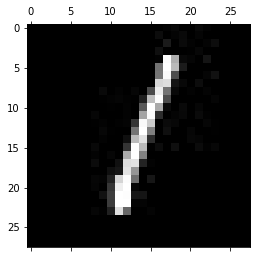

-------------------------------------------
Test: 626
Predicted: 0


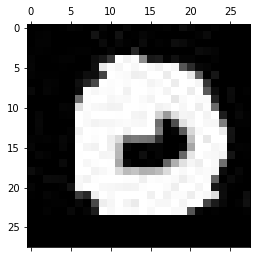

-------------------------------------------
Test: 627
Predicted: 5


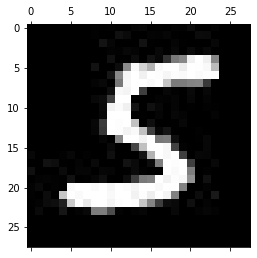

-------------------------------------------
Test: 628
Predicted: 5


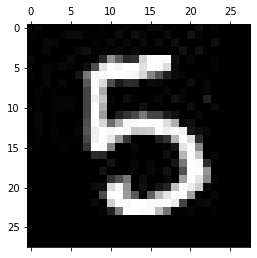

-------------------------------------------
Test: 629
Predicted: 8


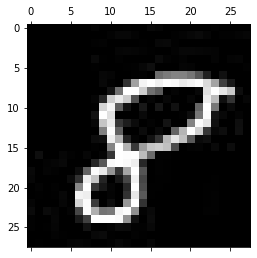

-------------------------------------------
Test: 630
Predicted: 1


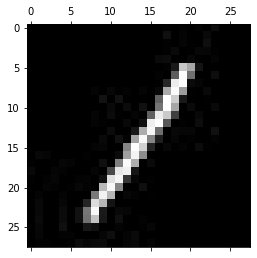

-------------------------------------------
Test: 631
Predicted: 0


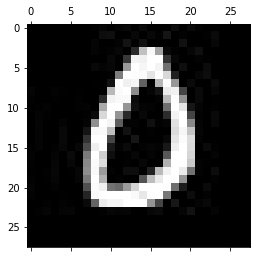

-------------------------------------------
Test: 632
Predicted: 2


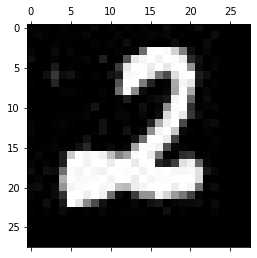

-------------------------------------------
Test: 633
Predicted: 8


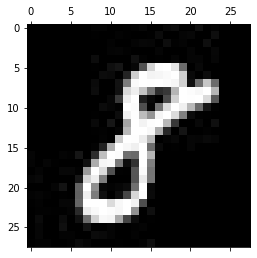

-------------------------------------------
Test: 634
Predicted: 7


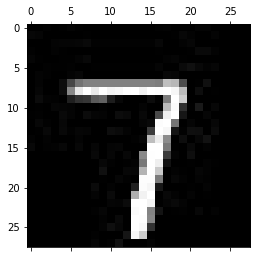

-------------------------------------------
Test: 635
Predicted: 6


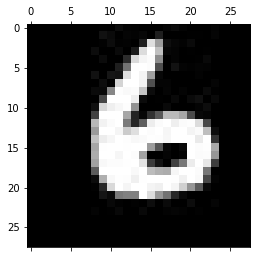

-------------------------------------------
Test: 636
Predicted: 0


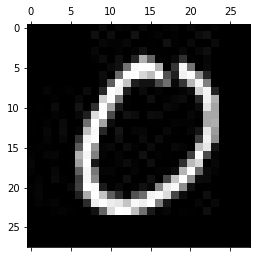

-------------------------------------------
Test: 637
Predicted: 4


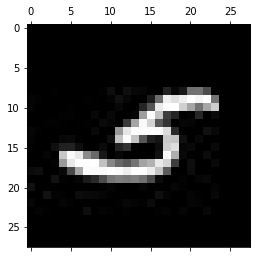

-------------------------------------------
Test: 638
Predicted: 4


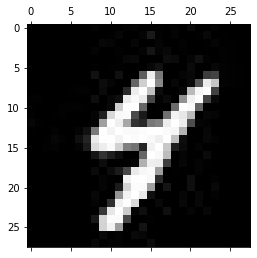

-------------------------------------------
Test: 639
Predicted: 8


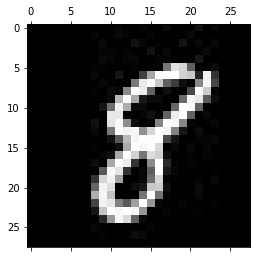

-------------------------------------------
Test: 640
Predicted: 1


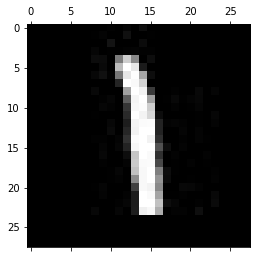

-------------------------------------------
Test: 641
Predicted: 8


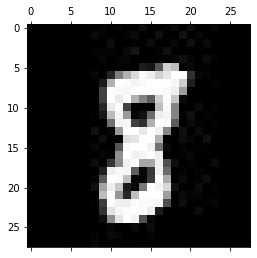

-------------------------------------------
Test: 642
Predicted: 0


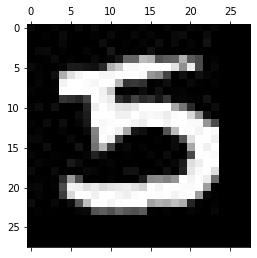

-------------------------------------------
Test: 643
Predicted: 7


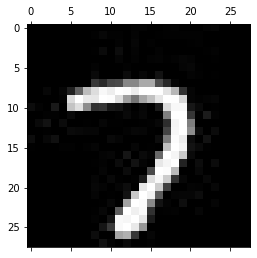

-------------------------------------------
Test: 644
Predicted: 9


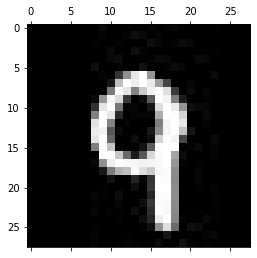

-------------------------------------------
Test: 645
Predicted: 0


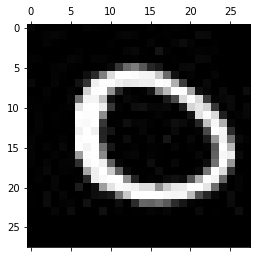

-------------------------------------------
Test: 646
Predicted: 6


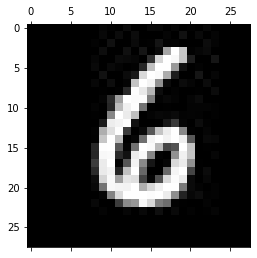

-------------------------------------------
Test: 647
Predicted: 6


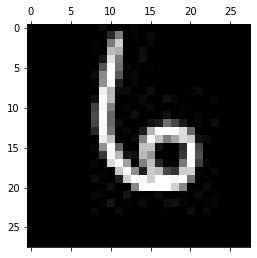

-------------------------------------------
Test: 648
Predicted: 6


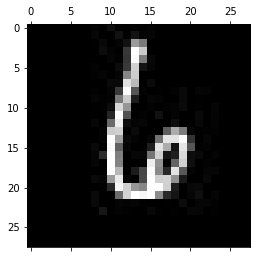

-------------------------------------------
Test: 649
Predicted: 6


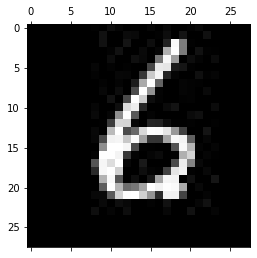

-------------------------------------------
Test: 650
Predicted: 3


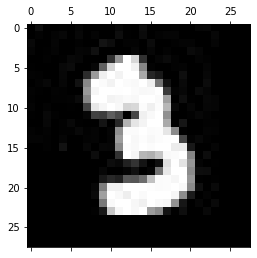

-------------------------------------------
Test: 651
Predicted: 3


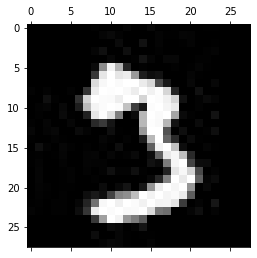

-------------------------------------------
Test: 652
Predicted: 0


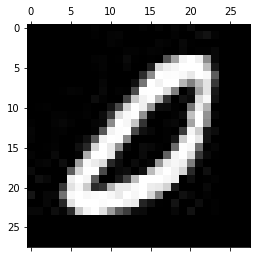

-------------------------------------------
Test: 653
Predicted: 7


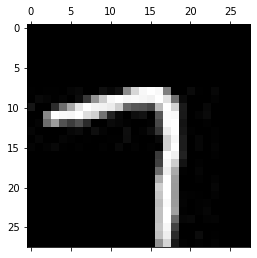

-------------------------------------------
Test: 654
Predicted: 9


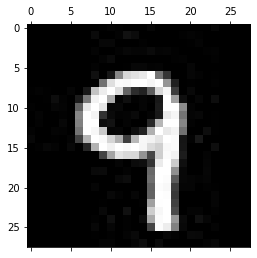

-------------------------------------------
Test: 655
Predicted: 4


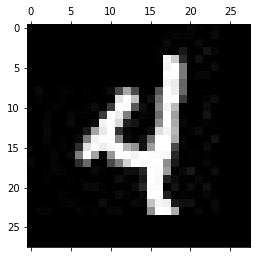

-------------------------------------------
Test: 656
Predicted: 1


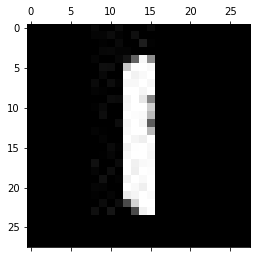

-------------------------------------------
Test: 657
Predicted: 8


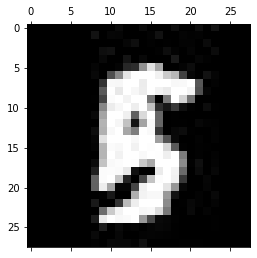

-------------------------------------------
Test: 658
Predicted: 9


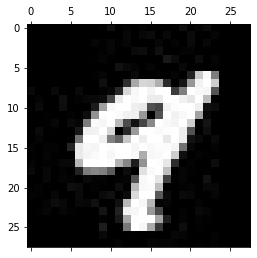

-------------------------------------------
Test: 659
Predicted: 8


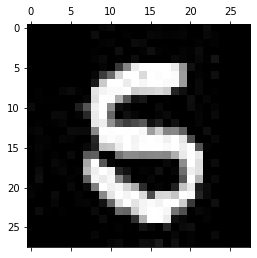

-------------------------------------------
Test: 660
Predicted: 6


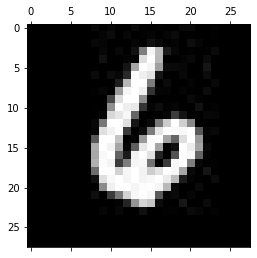

-------------------------------------------
Test: 661
Predicted: 3


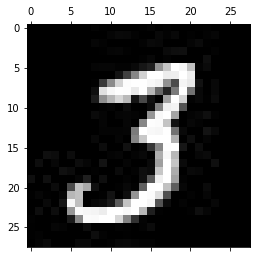

-------------------------------------------
Test: 662
Predicted: 4


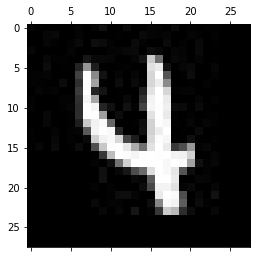

-------------------------------------------
Test: 663
Predicted: 6


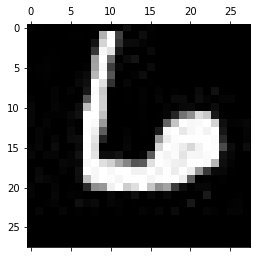

-------------------------------------------
Test: 664
Predicted: 6


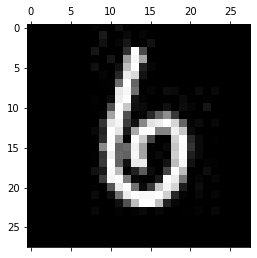

-------------------------------------------
Test: 665
Predicted: 1


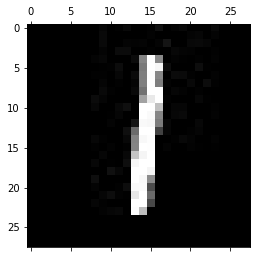

-------------------------------------------
Test: 666
Predicted: 6


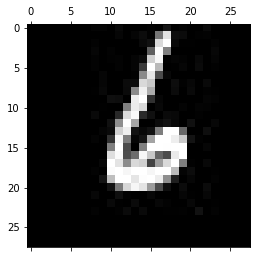

-------------------------------------------
Test: 667
Predicted: 2


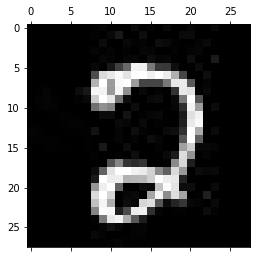

-------------------------------------------
Test: 668
Predicted: 2


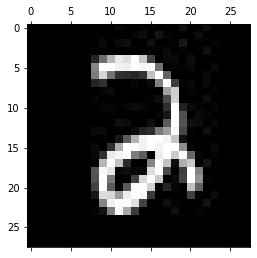

-------------------------------------------
Test: 669
Predicted: 1


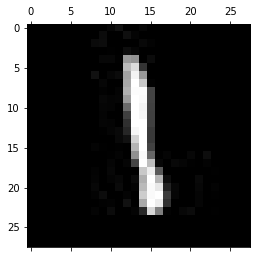

-------------------------------------------
Test: 670
Predicted: 0


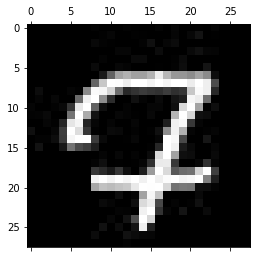

-------------------------------------------
Test: 671
Predicted: 7


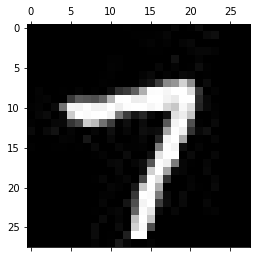

-------------------------------------------
Test: 672
Predicted: 3


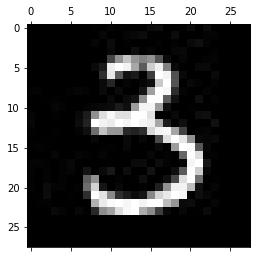

-------------------------------------------
Test: 673
Predicted: 7


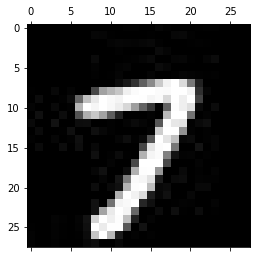

-------------------------------------------
Test: 674
Predicted: 8


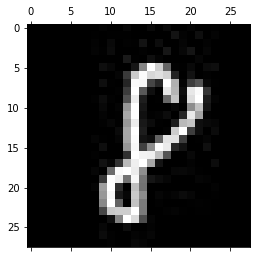

-------------------------------------------
Test: 675
Predicted: 9


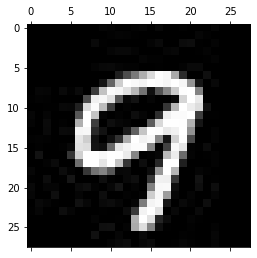

-------------------------------------------
Test: 676
Predicted: 6


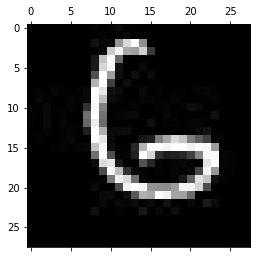

-------------------------------------------
Test: 677
Predicted: 2


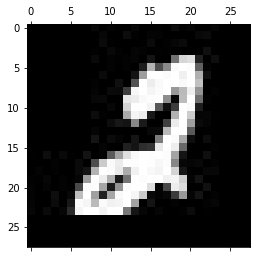

-------------------------------------------
Test: 678
Predicted: 4


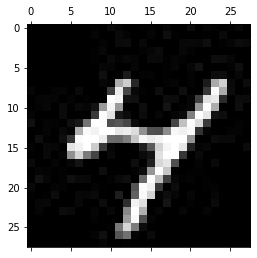

-------------------------------------------
Test: 679
Predicted: 3


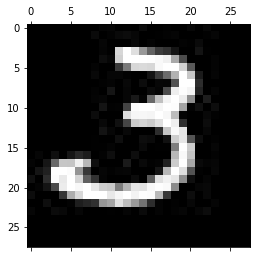

-------------------------------------------
Test: 680
Predicted: 8


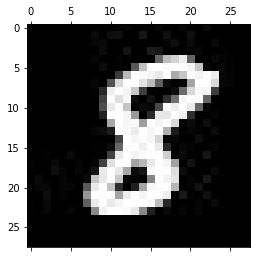

-------------------------------------------
Test: 681
Predicted: 3


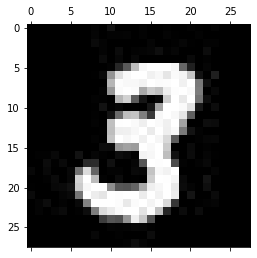

-------------------------------------------
Test: 682
Predicted: 0


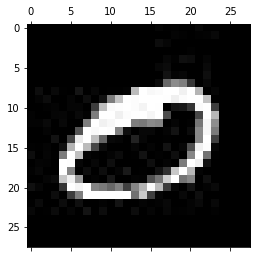

-------------------------------------------
Test: 683
Predicted: 7


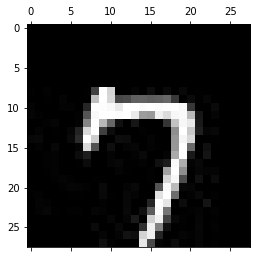

-------------------------------------------
Test: 684
Predicted: 5


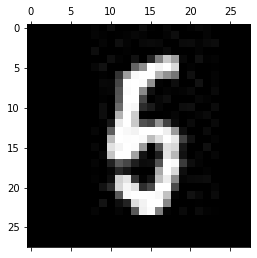

-------------------------------------------
Test: 685
Predicted: 2


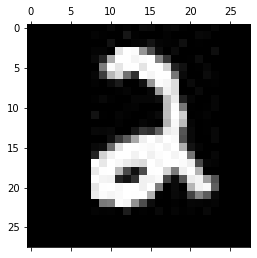

-------------------------------------------
Test: 686
Predicted: 2


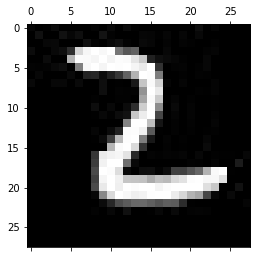

-------------------------------------------
Test: 687
Predicted: 8


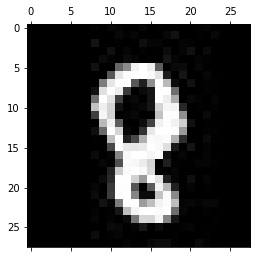

-------------------------------------------
Test: 688
Predicted: 5


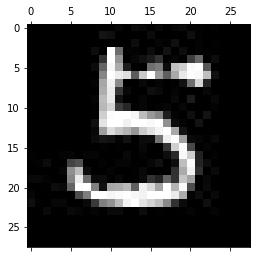

-------------------------------------------
Test: 689
Predicted: 2


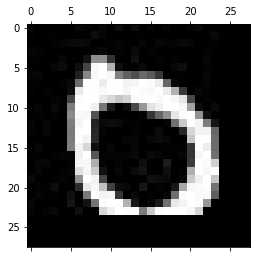

-------------------------------------------
Test: 690
Predicted: 3


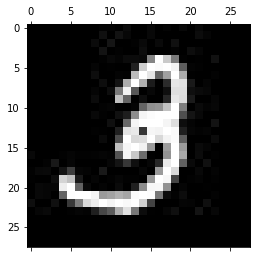

-------------------------------------------
Test: 691
Predicted: 9


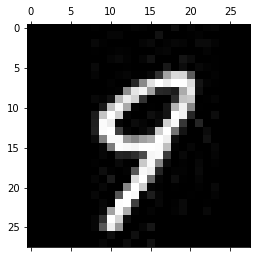

-------------------------------------------
Test: 692
Predicted: 6


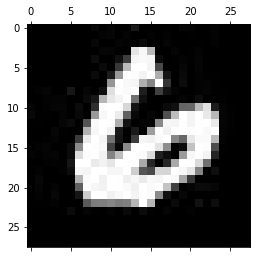

-------------------------------------------
Test: 693
Predicted: 8


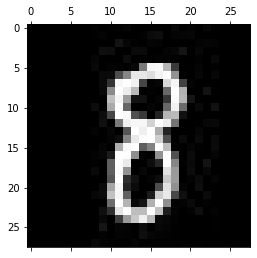

-------------------------------------------
Test: 694
Predicted: 5


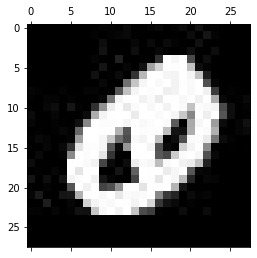

-------------------------------------------
Test: 695
Predicted: 7


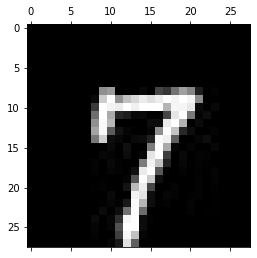

-------------------------------------------
Test: 696
Predicted: 5


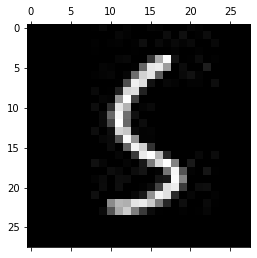

-------------------------------------------
Test: 697
Predicted: 5


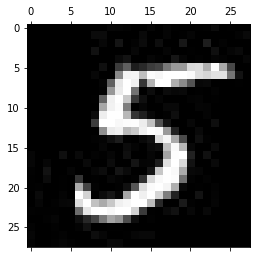

-------------------------------------------
Test: 698
Predicted: 8


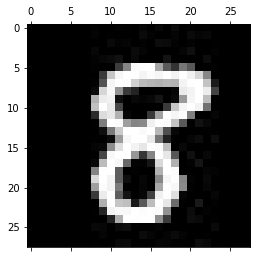

-------------------------------------------
Test: 699
Predicted: 2


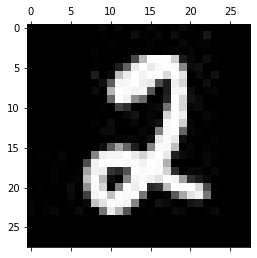

-------------------------------------------
Test: 700
Predicted: 7


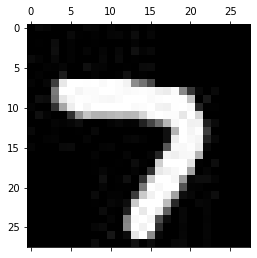

-------------------------------------------
Test: 701
Predicted: 6


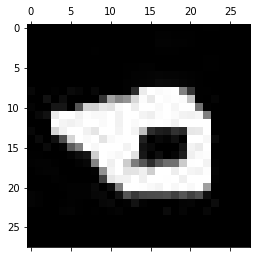

-------------------------------------------
Test: 702
Predicted: 2


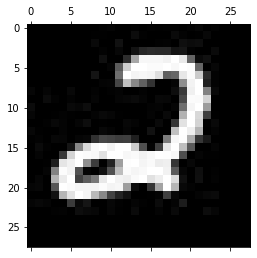

-------------------------------------------
Test: 703
Predicted: 6


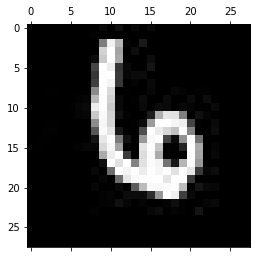

-------------------------------------------
Test: 704
Predicted: 2


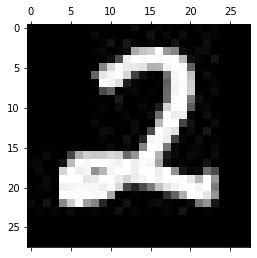

-------------------------------------------
Test: 705
Predicted: 5


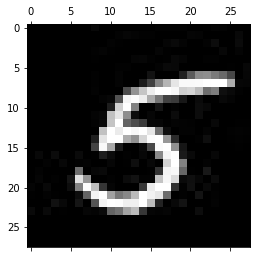

-------------------------------------------
Test: 706
Predicted: 4


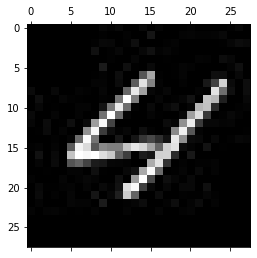

-------------------------------------------
Test: 707
Predicted: 8


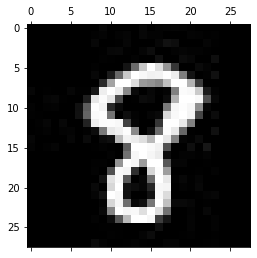

-------------------------------------------
Test: 708
Predicted: 8


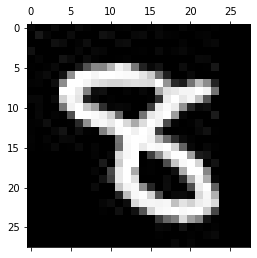

-------------------------------------------
Test: 709
Predicted: 8


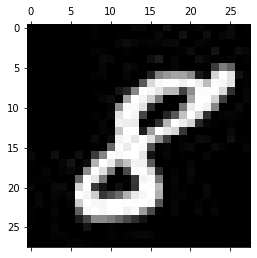

-------------------------------------------
Test: 710
Predicted: 3


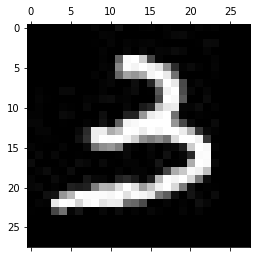

-------------------------------------------
Test: 711
Predicted: 4


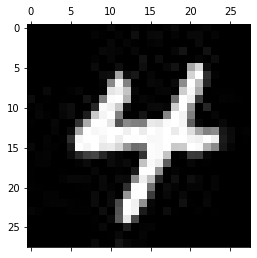

-------------------------------------------
Test: 712
Predicted: 6


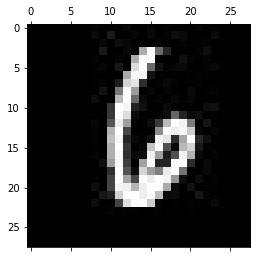

-------------------------------------------
Test: 713
Predicted: 0


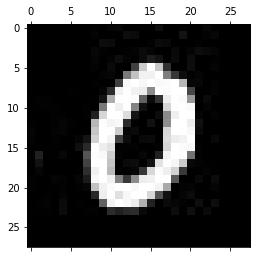

-------------------------------------------
Test: 714
Predicted: 4


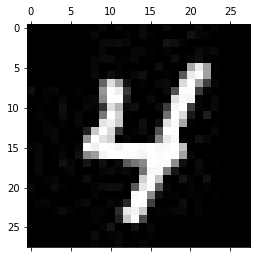

-------------------------------------------
Test: 715
Predicted: 6


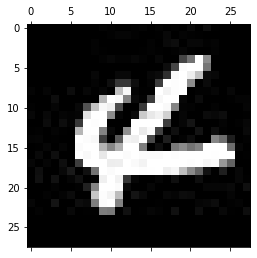

-------------------------------------------
Test: 716
Predicted: 4


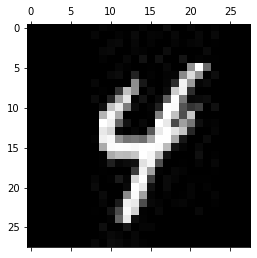

-------------------------------------------
Test: 717
Predicted: 6


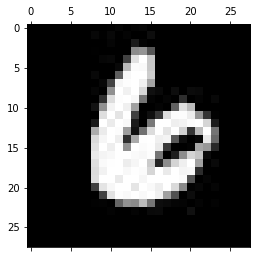

-------------------------------------------
Test: 718
Predicted: 9


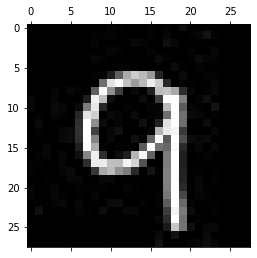

-------------------------------------------
Test: 719
Predicted: 4


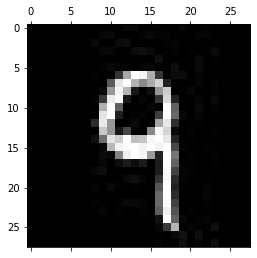

-------------------------------------------
Test: 720
Predicted: 8


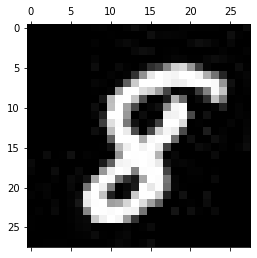

-------------------------------------------
Test: 721
Predicted: 7


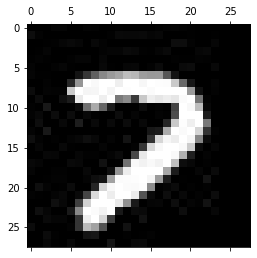

-------------------------------------------
Test: 722
Predicted: 1


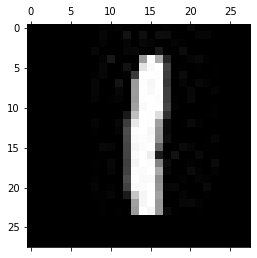

-------------------------------------------
Test: 723
Predicted: 9


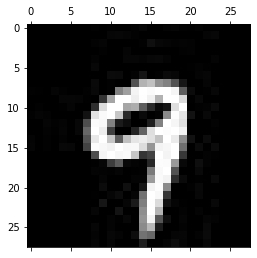

-------------------------------------------
Test: 724
Predicted: 2


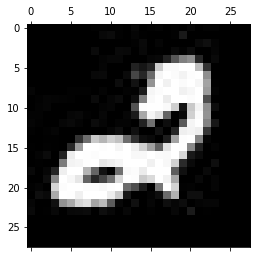

-------------------------------------------
Test: 725
Predicted: 1


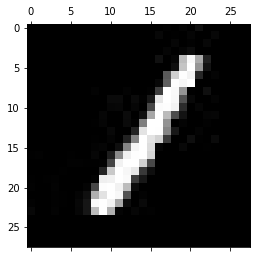

-------------------------------------------
Test: 726
Predicted: 2


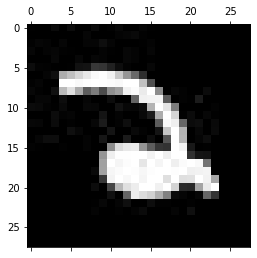

-------------------------------------------
Test: 727
Predicted: 8


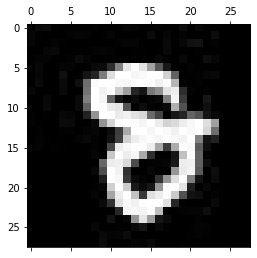

-------------------------------------------
Test: 728
Predicted: 2


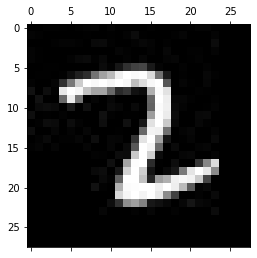

-------------------------------------------
Test: 729
Predicted: 9


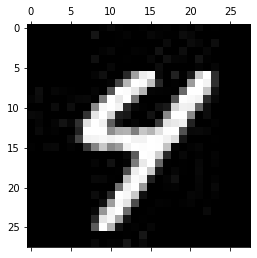

-------------------------------------------
Test: 730
Predicted: 6


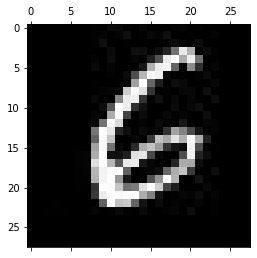

-------------------------------------------
Test: 731
Predicted: 8


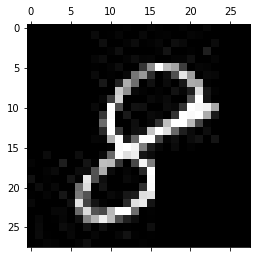

-------------------------------------------
Test: 732
Predicted: 1


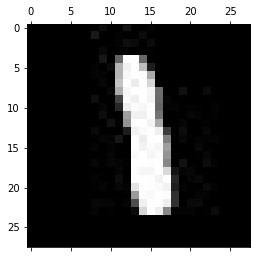

-------------------------------------------
Test: 733
Predicted: 2


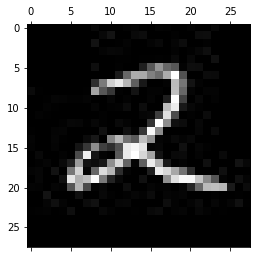

-------------------------------------------
Test: 734
Predicted: 9


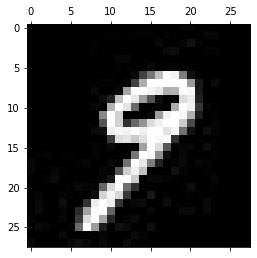

-------------------------------------------
Test: 735
Predicted: 3


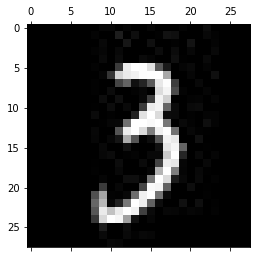

-------------------------------------------
Test: 736
Predicted: 7


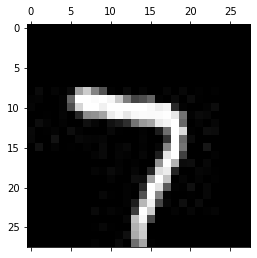

-------------------------------------------
Test: 737
Predicted: 0


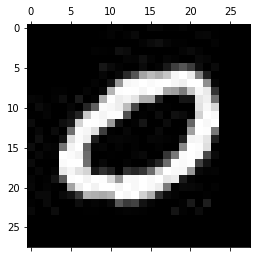

-------------------------------------------
Test: 738
Predicted: 5


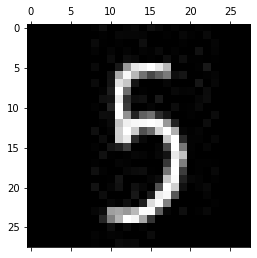

-------------------------------------------
Test: 739
Predicted: 1


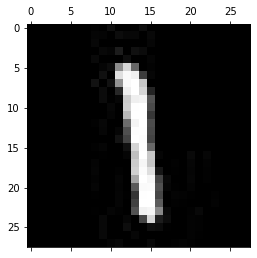

-------------------------------------------
Test: 740
Predicted: 6


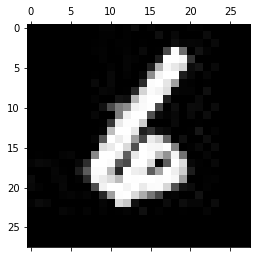

-------------------------------------------
Test: 741
Predicted: 0


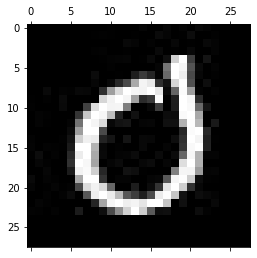

-------------------------------------------
Test: 742
Predicted: 8


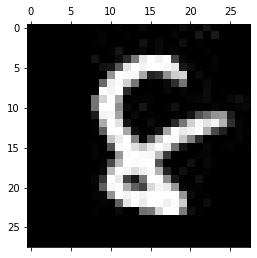

-------------------------------------------
Test: 743
Predicted: 2


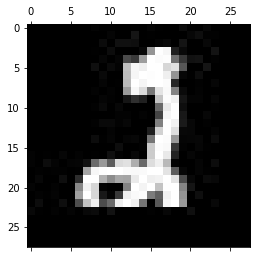

-------------------------------------------
Test: 744
Predicted: 0


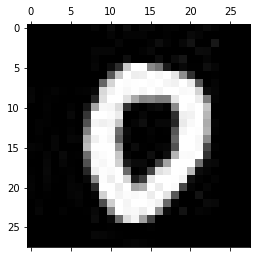

-------------------------------------------
Test: 745
Predicted: 2


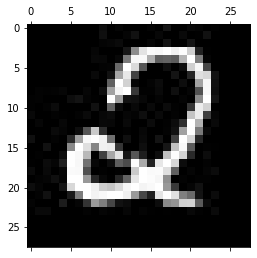

-------------------------------------------
Test: 746
Predicted: 6


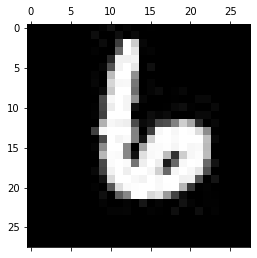

-------------------------------------------
Test: 747
Predicted: 4


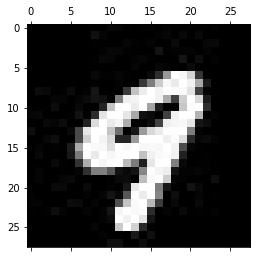

-------------------------------------------
Test: 748
Predicted: 6


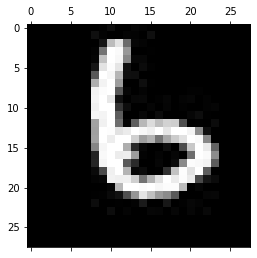

-------------------------------------------
Test: 749
Predicted: 7


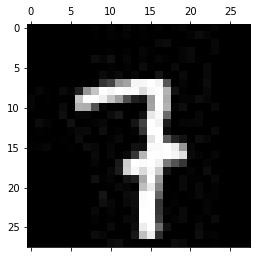

-------------------------------------------
Test: 750
Predicted: 4


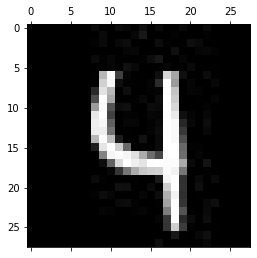

-------------------------------------------
Test: 751
Predicted: 4


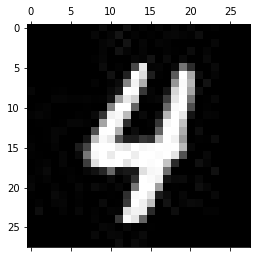

-------------------------------------------
Test: 752
Predicted: 4


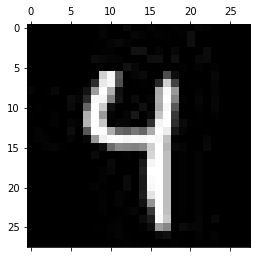

-------------------------------------------
Test: 753
Predicted: 5


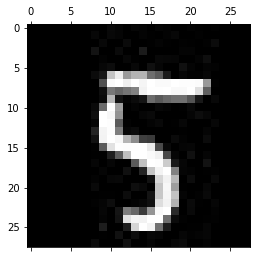

-------------------------------------------
Test: 754
Predicted: 5


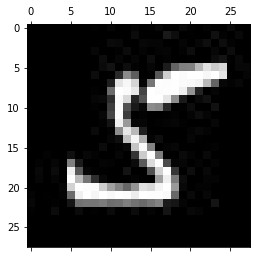

-------------------------------------------
Test: 755
Predicted: 2


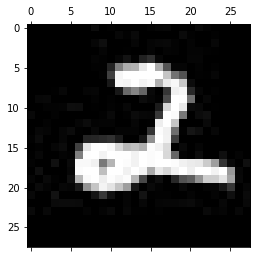

-------------------------------------------
Test: 756
Predicted: 6


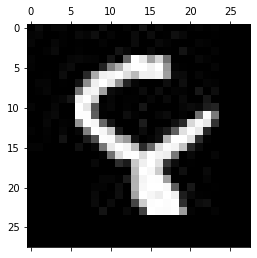

-------------------------------------------
Test: 757
Predicted: 0


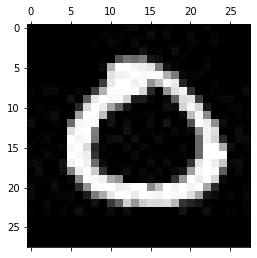

-------------------------------------------
Test: 758
Predicted: 9


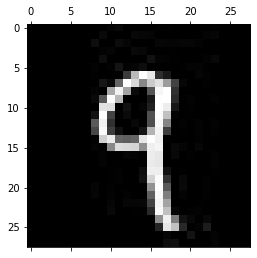

-------------------------------------------
Test: 759
Predicted: 0


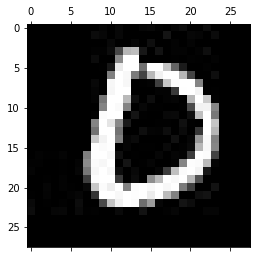

-------------------------------------------
Test: 760
Predicted: 5


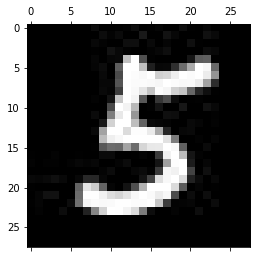

-------------------------------------------
Test: 761
Predicted: 2


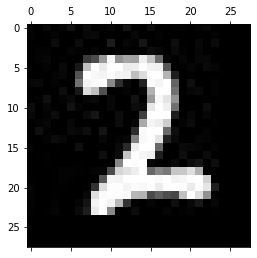

-------------------------------------------
Test: 762
Predicted: 0


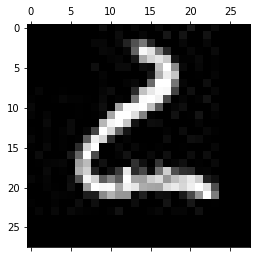

-------------------------------------------
Test: 763
Predicted: 5


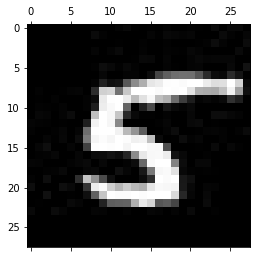

-------------------------------------------
Test: 764
Predicted: 8


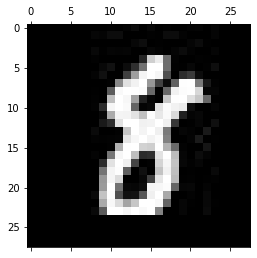

-------------------------------------------
Test: 765
Predicted: 9


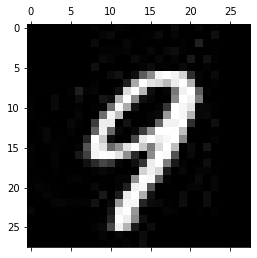

-------------------------------------------
Test: 766
Predicted: 2


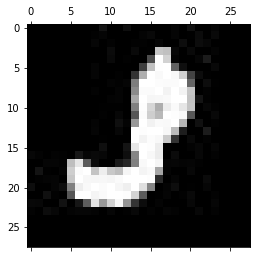

-------------------------------------------
Test: 767
Predicted: 5


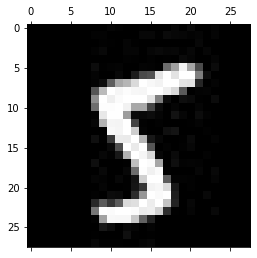

-------------------------------------------
Test: 768
Predicted: 8


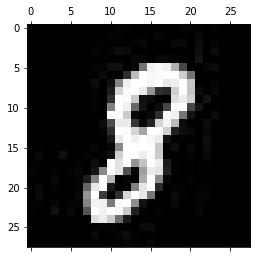

-------------------------------------------
Test: 769
Predicted: 1


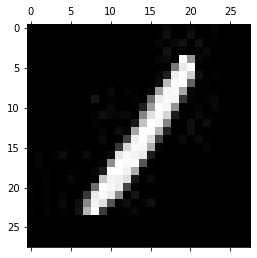

-------------------------------------------
Test: 770
Predicted: 3


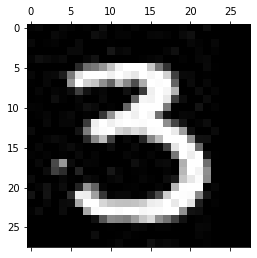

-------------------------------------------
Test: 771
Predicted: 3


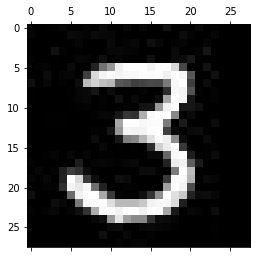

-------------------------------------------
Test: 772
Predicted: 5


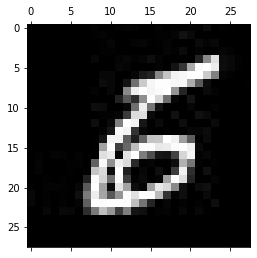

-------------------------------------------
Test: 773
Predicted: 5


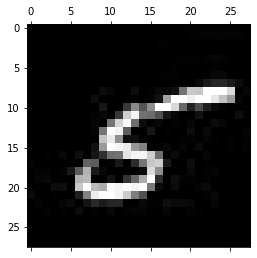

-------------------------------------------
Test: 774
Predicted: 8


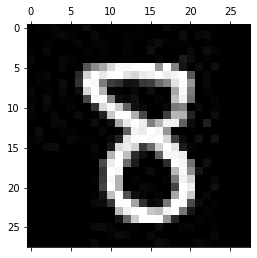

-------------------------------------------
Test: 775
Predicted: 8


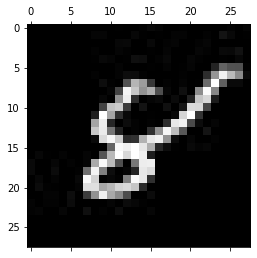

-------------------------------------------
Test: 776
Predicted: 3


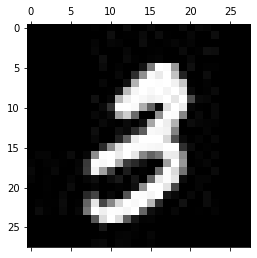

-------------------------------------------
Test: 777
Predicted: 4


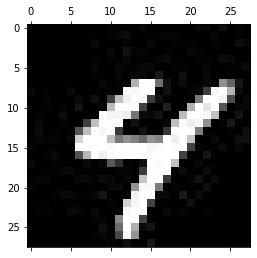

-------------------------------------------
Test: 778
Predicted: 9


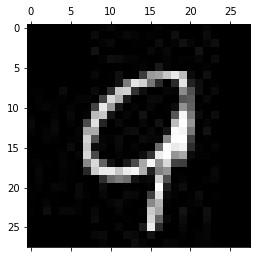

-------------------------------------------
Test: 779
Predicted: 3


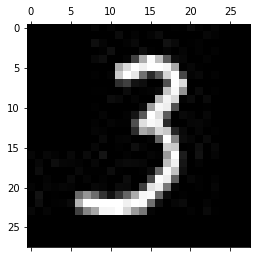

-------------------------------------------
Test: 780
Predicted: 0


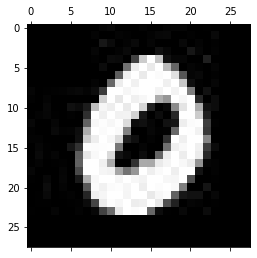

-------------------------------------------
Test: 781
Predicted: 7


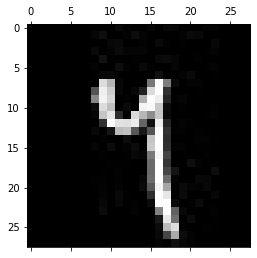

-------------------------------------------
Test: 782
Predicted: 0


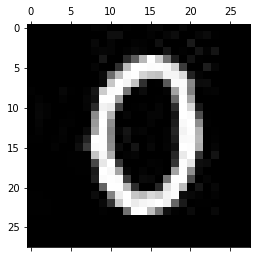

-------------------------------------------
Test: 783
Predicted: 0


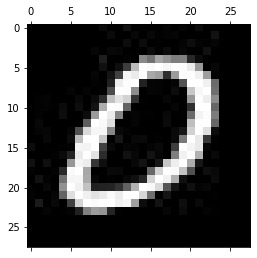

-------------------------------------------
Test: 784
Predicted: 7


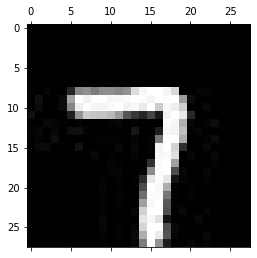

-------------------------------------------
Test: 785
Predicted: 5


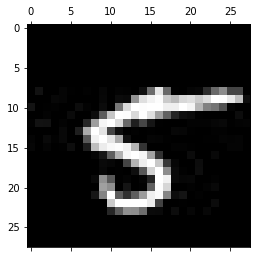

-------------------------------------------
Test: 786
Predicted: 6


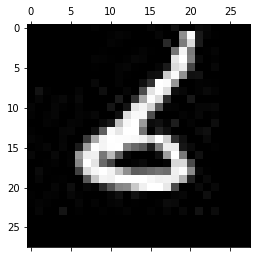

-------------------------------------------
Test: 787
Predicted: 1


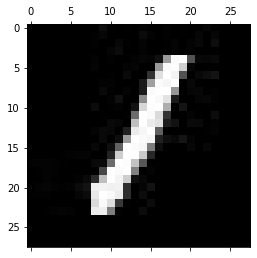

-------------------------------------------
Test: 788
Predicted: 6


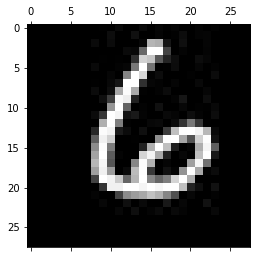

-------------------------------------------
Test: 789
Predicted: 7


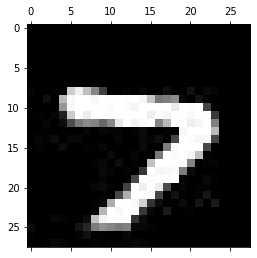

-------------------------------------------
Test: 790
Predicted: 0


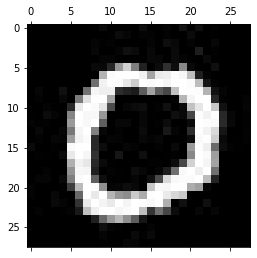

-------------------------------------------
Test: 791
Predicted: 3


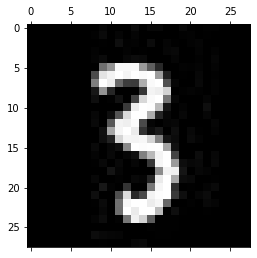

-------------------------------------------
Test: 792
Predicted: 8


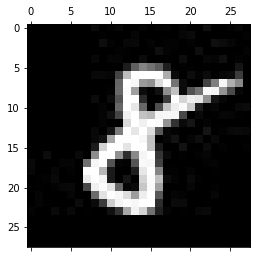

-------------------------------------------
Test: 793
Predicted: 8


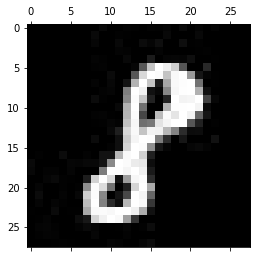

-------------------------------------------
Test: 794
Predicted: 8


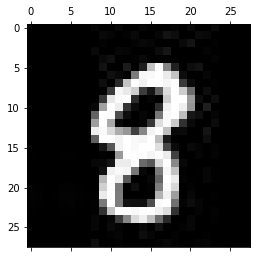

-------------------------------------------
Test: 795
Predicted: 0


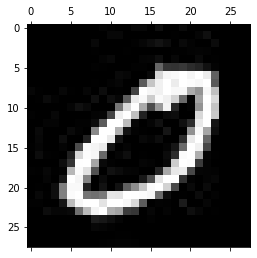

-------------------------------------------
Test: 796
Predicted: 7


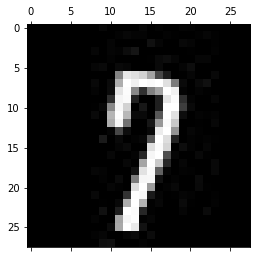

-------------------------------------------
Test: 797
Predicted: 8


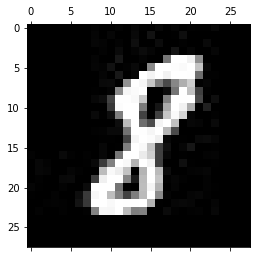

-------------------------------------------
Test: 798
Predicted: 4


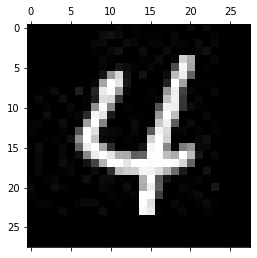

-------------------------------------------
Test: 799
Predicted: 8


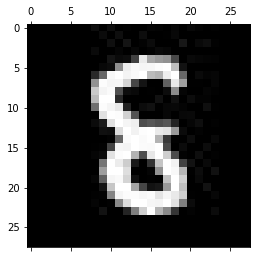

-------------------------------------------
Test: 800
Predicted: 4


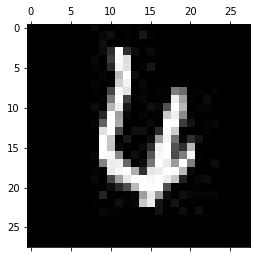

-------------------------------------------
Test: 801
Predicted: 0


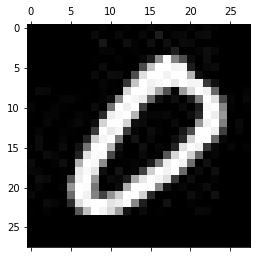

-------------------------------------------
Test: 802
Predicted: 6


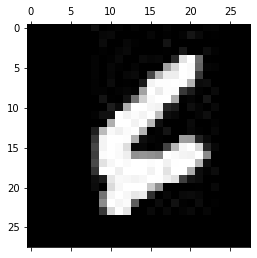

-------------------------------------------
Test: 803
Predicted: 7


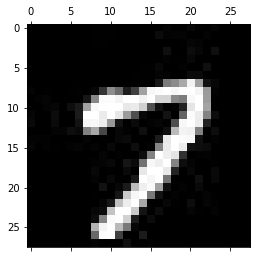

-------------------------------------------
Test: 804
Predicted: 4


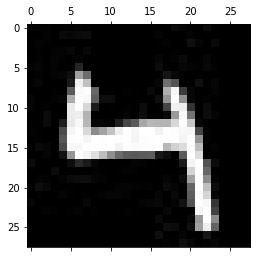

-------------------------------------------
Test: 805
Predicted: 3


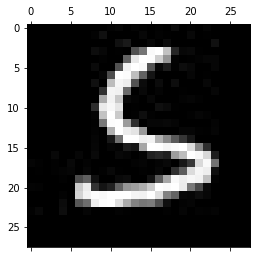

-------------------------------------------
Test: 806
Predicted: 6


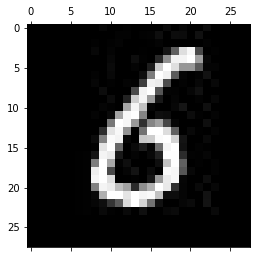

-------------------------------------------
Test: 807
Predicted: 2


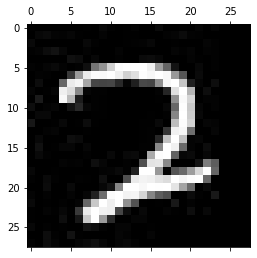

-------------------------------------------
Test: 808
Predicted: 5


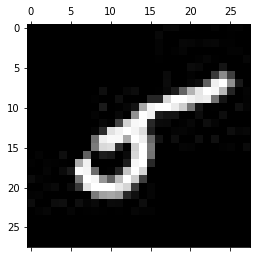

-------------------------------------------
Test: 809
Predicted: 7


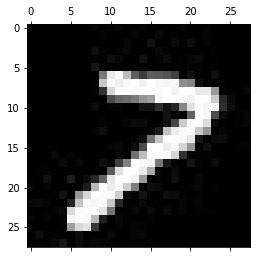

-------------------------------------------
Test: 810
Predicted: 8


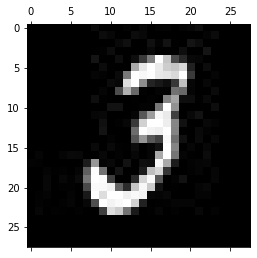

-------------------------------------------
Test: 811
Predicted: 7


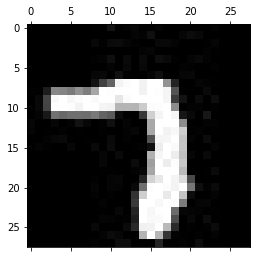

-------------------------------------------
Test: 812
Predicted: 2


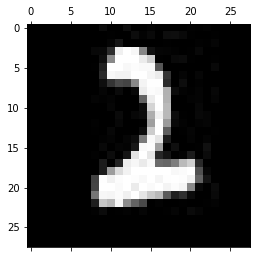

-------------------------------------------
Test: 813
Predicted: 4


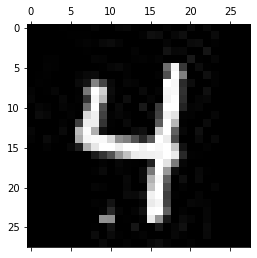

-------------------------------------------
Test: 814
Predicted: 6


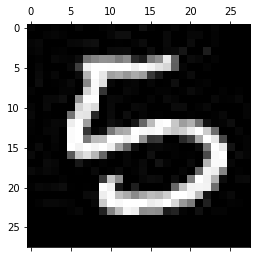

-------------------------------------------
Test: 815
Predicted: 1


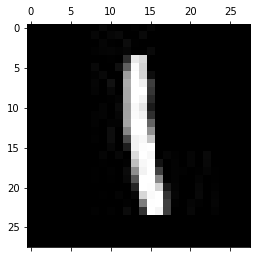

-------------------------------------------
Test: 816
Predicted: 7


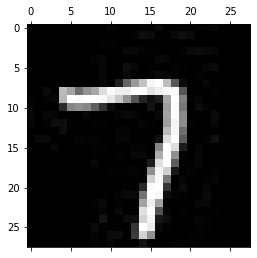

-------------------------------------------
Test: 817
Predicted: 0


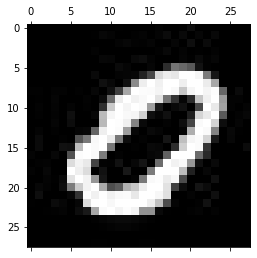

-------------------------------------------
Test: 818
Predicted: 0


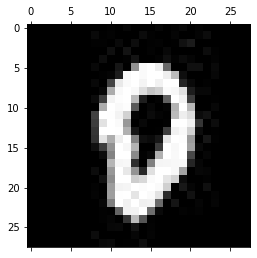

-------------------------------------------
Test: 819
Predicted: 5


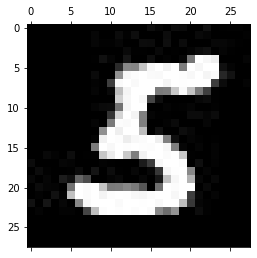

-------------------------------------------
Test: 820
Predicted: 5


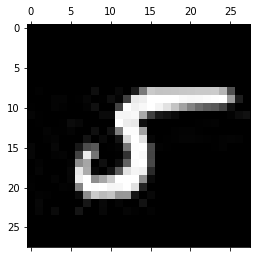

-------------------------------------------
Test: 821
Predicted: 3


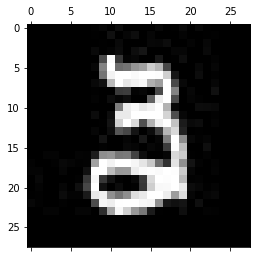

-------------------------------------------
Test: 822
Predicted: 0


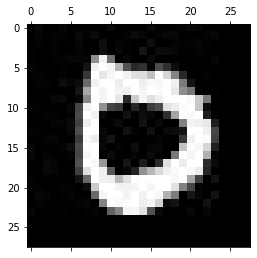

-------------------------------------------
Test: 823
Predicted: 9


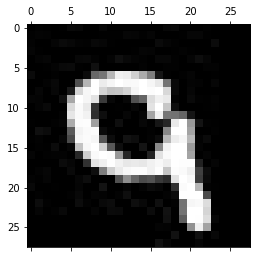

-------------------------------------------
Test: 824
Predicted: 9


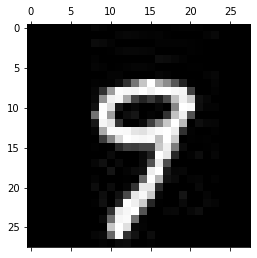

-------------------------------------------
Test: 825
Predicted: 2


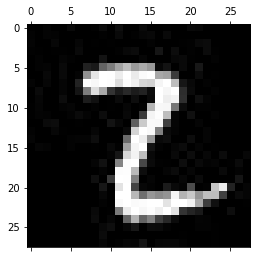

-------------------------------------------
Test: 826
Predicted: 7


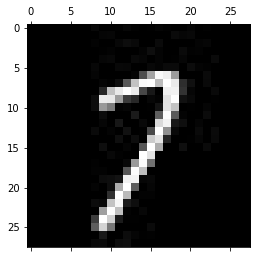

-------------------------------------------
Test: 827
Predicted: 9


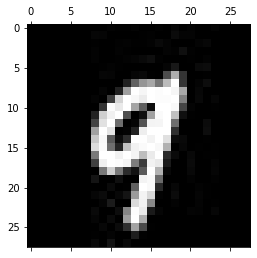

-------------------------------------------
Test: 828
Predicted: 1


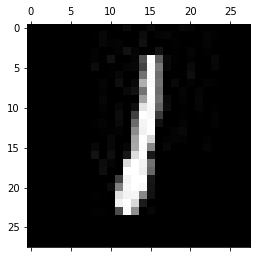

-------------------------------------------
Test: 829
Predicted: 9


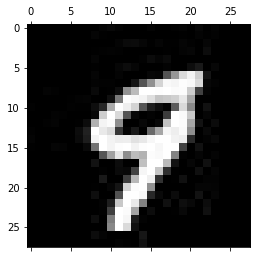

-------------------------------------------
Test: 830
Predicted: 6


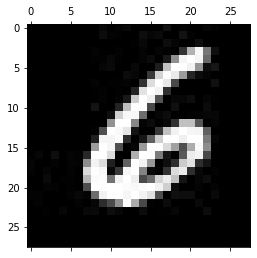

-------------------------------------------
Test: 831
Predicted: 1


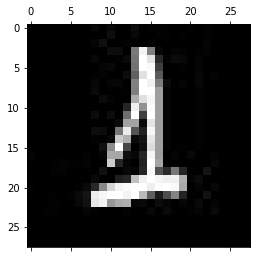

-------------------------------------------
Test: 832
Predicted: 2


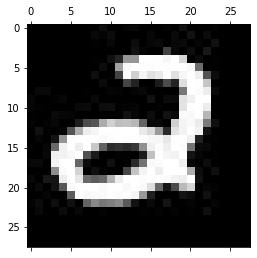

-------------------------------------------
Test: 833
Predicted: 9


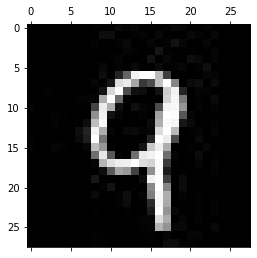

-------------------------------------------
Test: 834
Predicted: 2


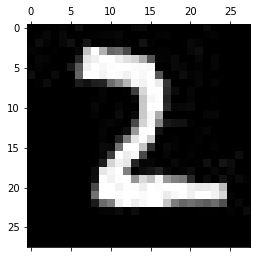

-------------------------------------------
Test: 835
Predicted: 9


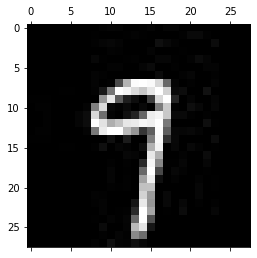

-------------------------------------------
Test: 836
Predicted: 7


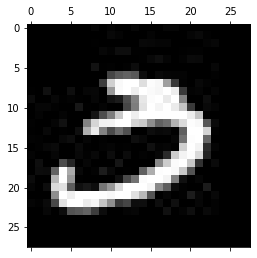

-------------------------------------------
Test: 837
Predicted: 1


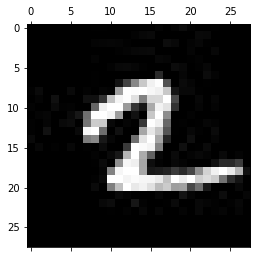

-------------------------------------------
Test: 838
Predicted: 3


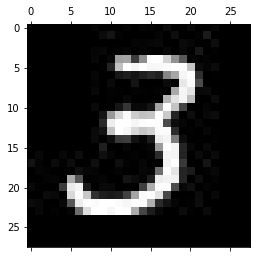

-------------------------------------------
Test: 839
Predicted: 2


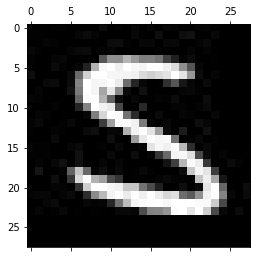

-------------------------------------------
Test: 840
Predicted: 1


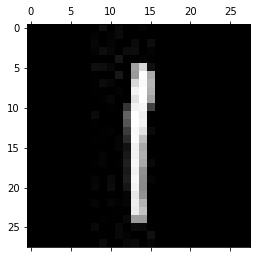

-------------------------------------------
Test: 841
Predicted: 1


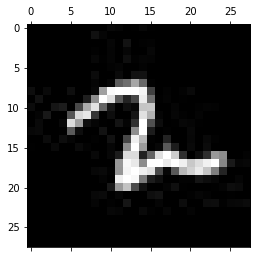

-------------------------------------------
Test: 842
Predicted: 7


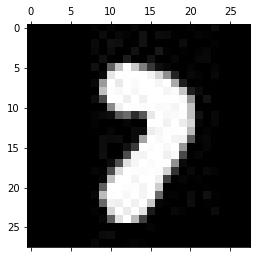

-------------------------------------------
Test: 843
Predicted: 9


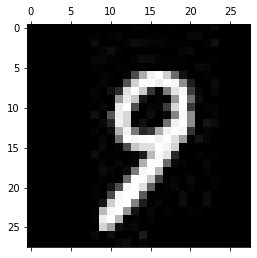

-------------------------------------------
Test: 844
Predicted: 2


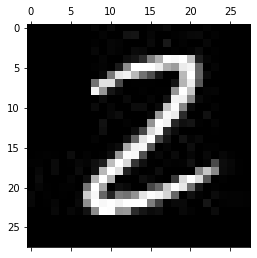

-------------------------------------------
Test: 845
Predicted: 7


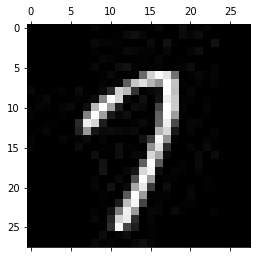

-------------------------------------------
Test: 846
Predicted: 0


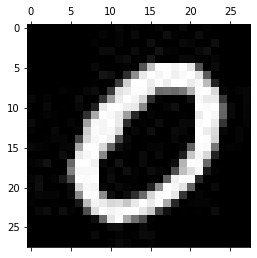

-------------------------------------------
Test: 847
Predicted: 2


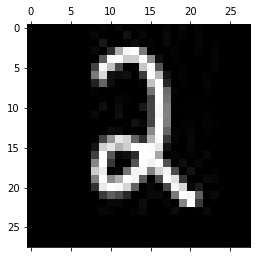

-------------------------------------------
Test: 848
Predicted: 6


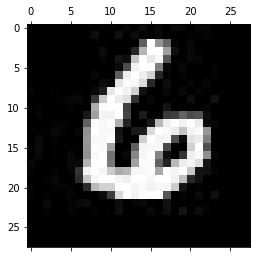

-------------------------------------------
Test: 849
Predicted: 6


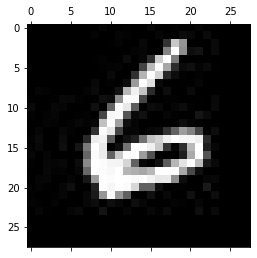

-------------------------------------------
Test: 850
Predicted: 1


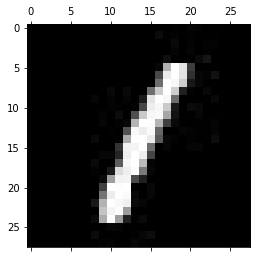

-------------------------------------------
Test: 851
Predicted: 8


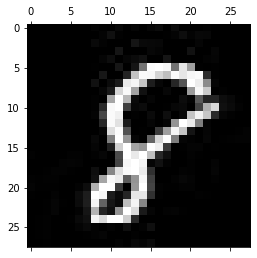

-------------------------------------------
Test: 852
Predicted: 0


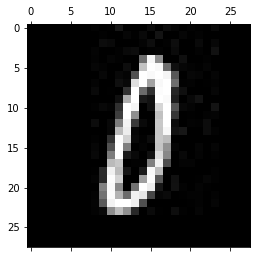

-------------------------------------------
Test: 853
Predicted: 7


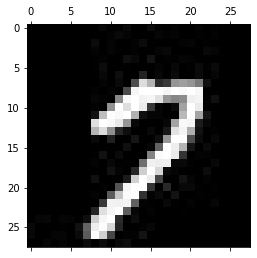

-------------------------------------------
Test: 854
Predicted: 5


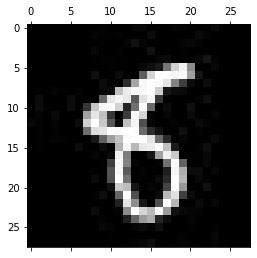

-------------------------------------------
Test: 855
Predicted: 8


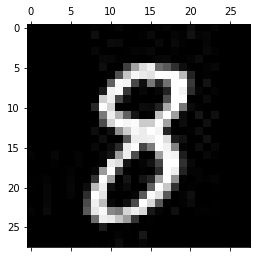

-------------------------------------------
Test: 856
Predicted: 3


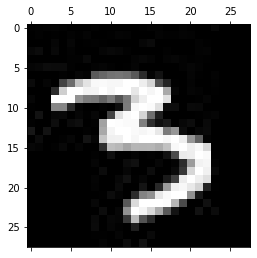

-------------------------------------------
Test: 857
Predicted: 6


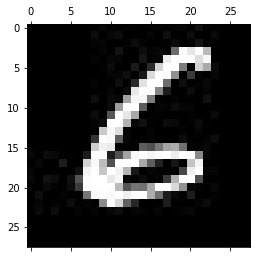

-------------------------------------------
Test: 858
Predicted: 0


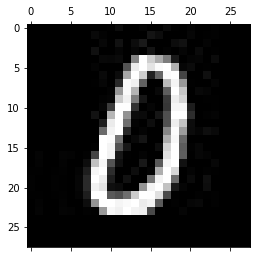

-------------------------------------------
Test: 859
Predicted: 5


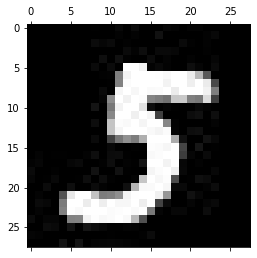

-------------------------------------------
Test: 860
Predicted: 6


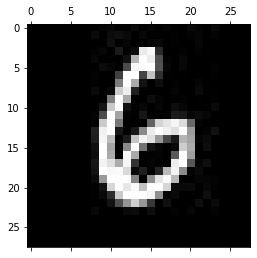

-------------------------------------------
Test: 861
Predicted: 5


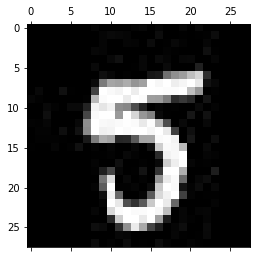

-------------------------------------------
Test: 862
Predicted: 2


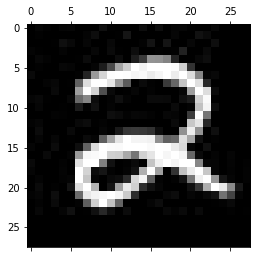

-------------------------------------------
Test: 863
Predicted: 4


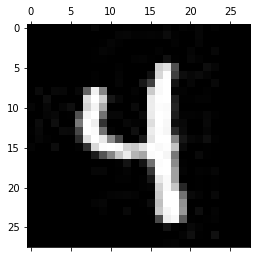

-------------------------------------------
Test: 864
Predicted: 5


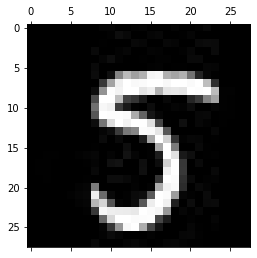

-------------------------------------------
Test: 865
Predicted: 2


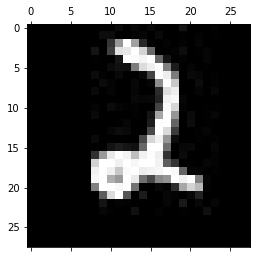

-------------------------------------------
Test: 866
Predicted: 6


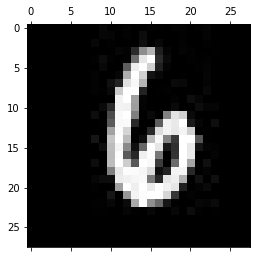

-------------------------------------------
Test: 867
Predicted: 7


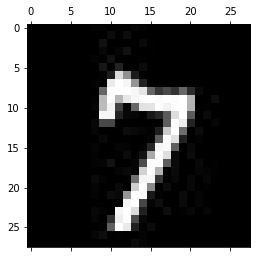

-------------------------------------------
Test: 868
Predicted: 3


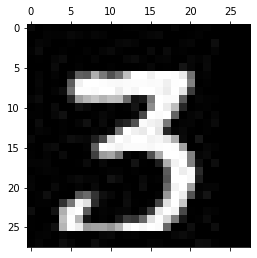

-------------------------------------------
Test: 869
Predicted: 2


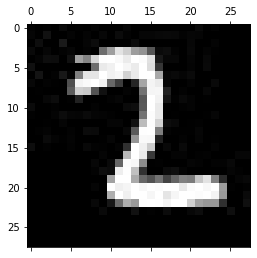

-------------------------------------------
Test: 870
Predicted: 6


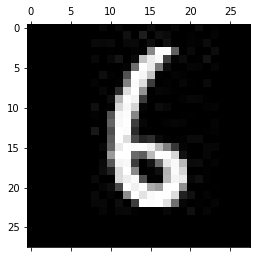

-------------------------------------------
Test: 871
Predicted: 3


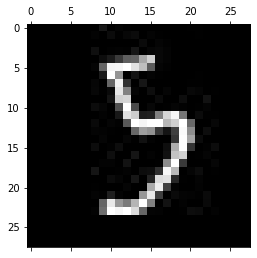

-------------------------------------------
Test: 872
Predicted: 0


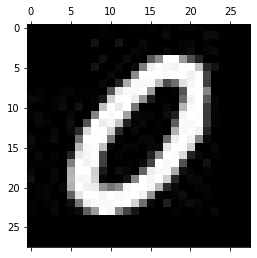

-------------------------------------------
Test: 873
Predicted: 1


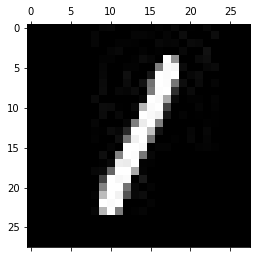

-------------------------------------------
Test: 874
Predicted: 4


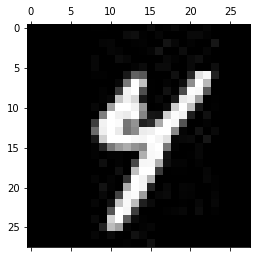

-------------------------------------------
Test: 875
Predicted: 3


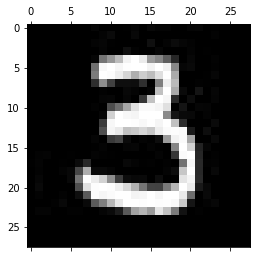

-------------------------------------------
Test: 876
Predicted: 9


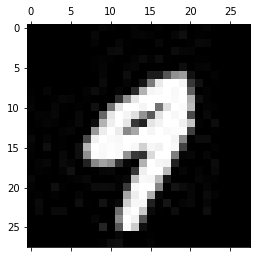

-------------------------------------------
Test: 877
Predicted: 0


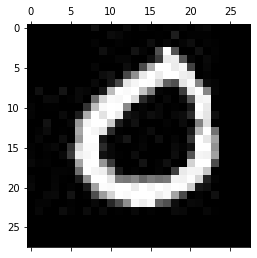

-------------------------------------------
Test: 878
Predicted: 3


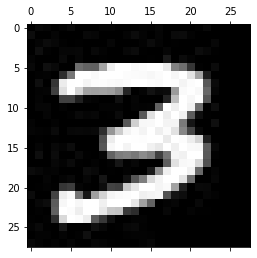

-------------------------------------------
Test: 879
Predicted: 0


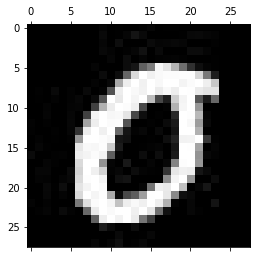

-------------------------------------------
Test: 880
Predicted: 0


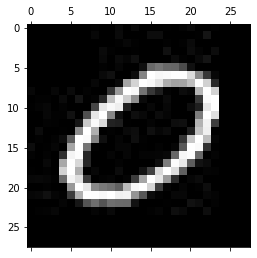

-------------------------------------------
Test: 881
Predicted: 7


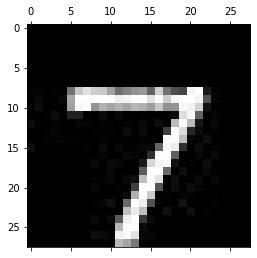

-------------------------------------------
Test: 882
Predicted: 0


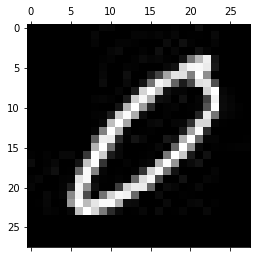

-------------------------------------------
Test: 883
Predicted: 5


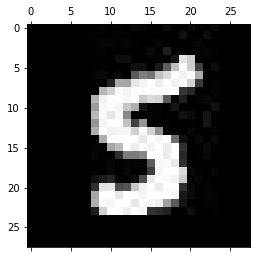

-------------------------------------------
Test: 884
Predicted: 3


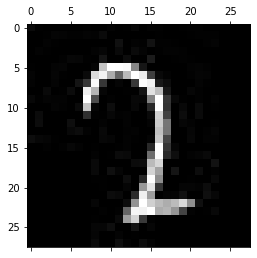

-------------------------------------------
Test: 885
Predicted: 4


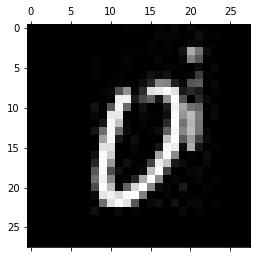

-------------------------------------------
Test: 886
Predicted: 8


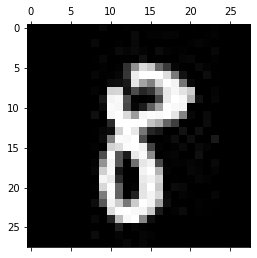

-------------------------------------------
Test: 887
Predicted: 8


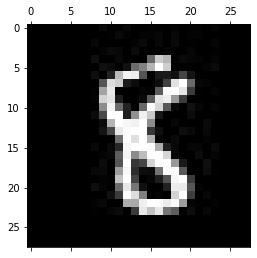

-------------------------------------------
Test: 888
Predicted: 5


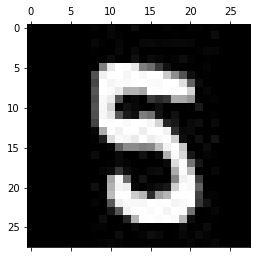

-------------------------------------------
Test: 889
Predicted: 0


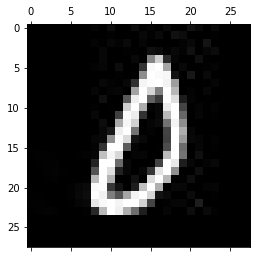

-------------------------------------------
Test: 890
Predicted: 4


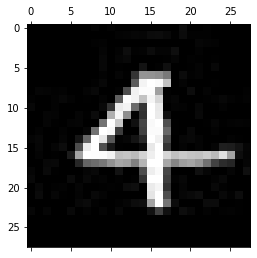

-------------------------------------------
Test: 891
Predicted: 7


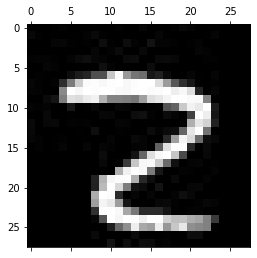

-------------------------------------------
Test: 892
Predicted: 5


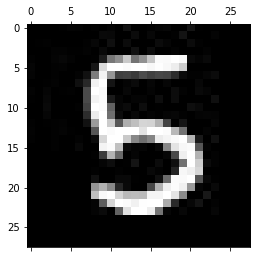

-------------------------------------------
Test: 893
Predicted: 3


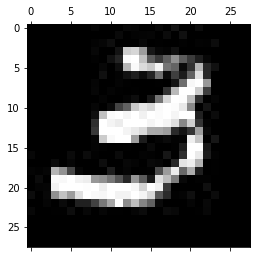

-------------------------------------------
Test: 894
Predicted: 3


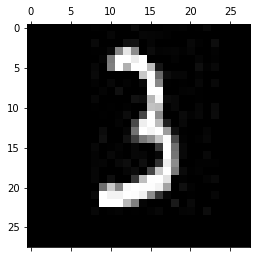

-------------------------------------------
Test: 895
Predicted: 6


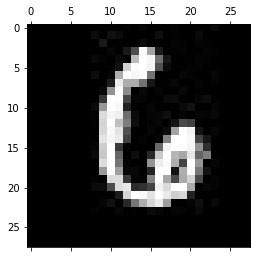

-------------------------------------------
Test: 896
Predicted: 5


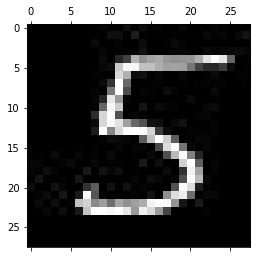

-------------------------------------------
Test: 897
Predicted: 3


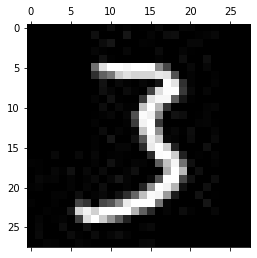

-------------------------------------------
Test: 898
Predicted: 4


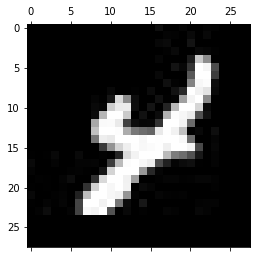

-------------------------------------------
Test: 899
Predicted: 0


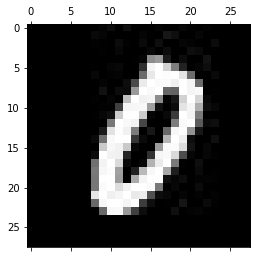

-------------------------------------------
Test: 900
Predicted: 2


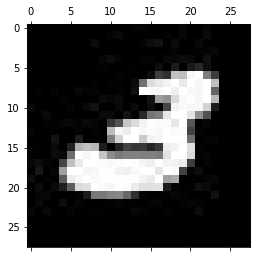

-------------------------------------------
Test: 901
Predicted: 0


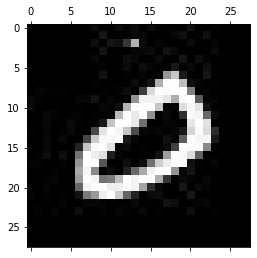

-------------------------------------------
Test: 902
Predicted: 5


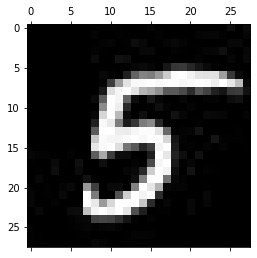

-------------------------------------------
Test: 903
Predicted: 6


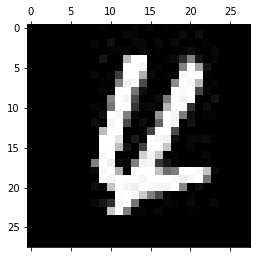

-------------------------------------------
Test: 904
Predicted: 4


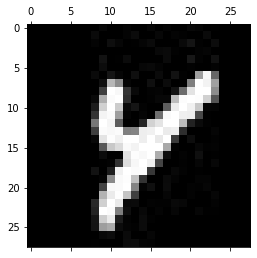

-------------------------------------------
Test: 905
Predicted: 9


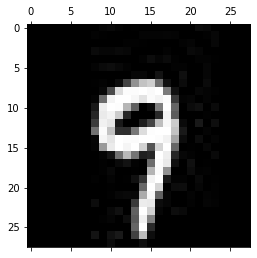

-------------------------------------------
Test: 906
Predicted: 6


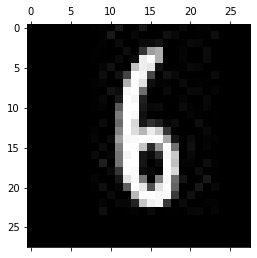

-------------------------------------------
Test: 907
Predicted: 4


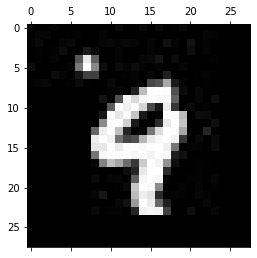

-------------------------------------------
Test: 908
Predicted: 2


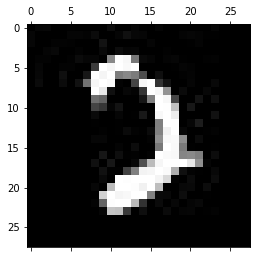

-------------------------------------------
Test: 909
Predicted: 3


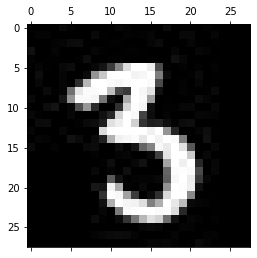

-------------------------------------------
Test: 910
Predicted: 1


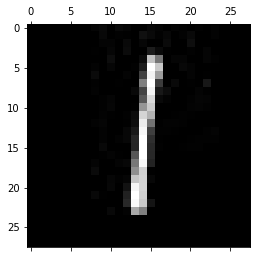

-------------------------------------------
Test: 911
Predicted: 4


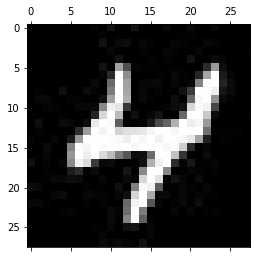

-------------------------------------------
Test: 912
Predicted: 3


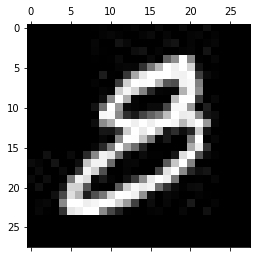

-------------------------------------------
Test: 913
Predicted: 7


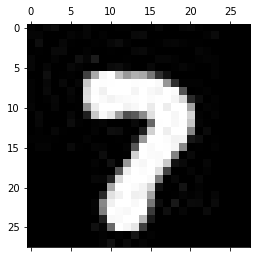

-------------------------------------------
Test: 914
Predicted: 7


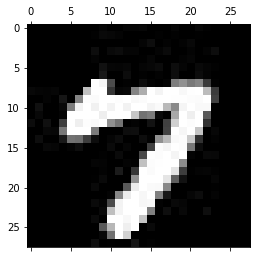

-------------------------------------------
Test: 915
Predicted: 2


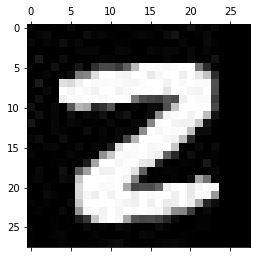

-------------------------------------------
Test: 916
Predicted: 8


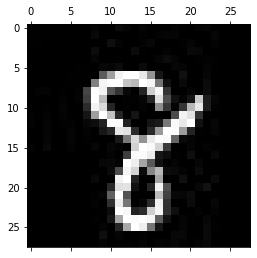

-------------------------------------------
Test: 917
Predicted: 8


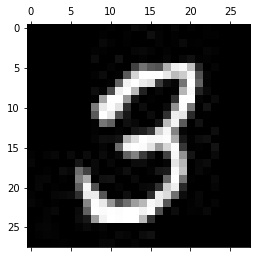

-------------------------------------------
Test: 918
Predicted: 0


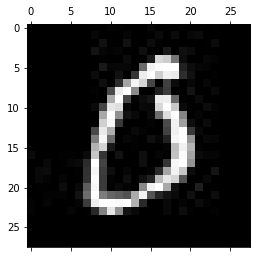

-------------------------------------------
Test: 919
Predicted: 4


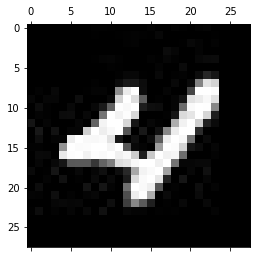

-------------------------------------------
Test: 920
Predicted: 7


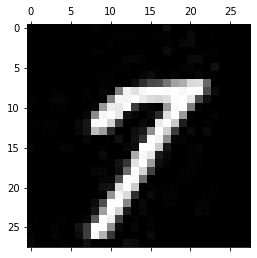

-------------------------------------------
Test: 921
Predicted: 7


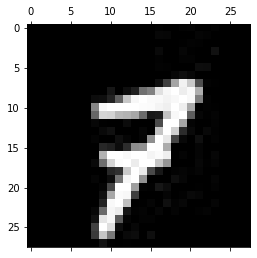

-------------------------------------------
Test: 922
Predicted: 5


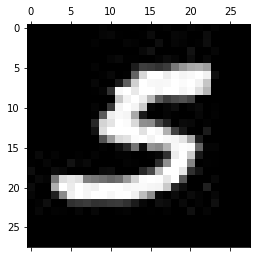

-------------------------------------------
Test: 923
Predicted: 9


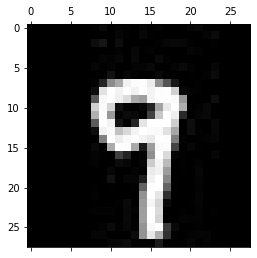

-------------------------------------------
Test: 924
Predicted: 8


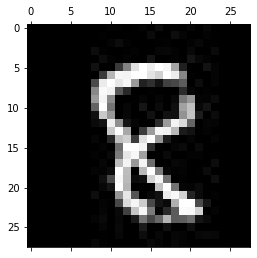

-------------------------------------------
Test: 925
Predicted: 0


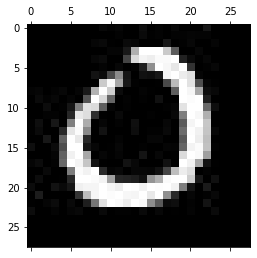

-------------------------------------------
Test: 926
Predicted: 9


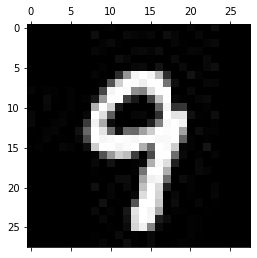

-------------------------------------------
Test: 927
Predicted: 1


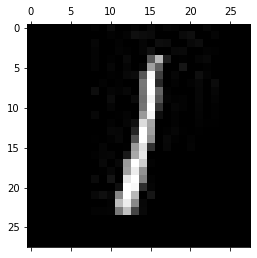

-------------------------------------------
Test: 928
Predicted: 7


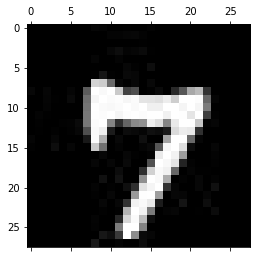

-------------------------------------------
Test: 929
Predicted: 1


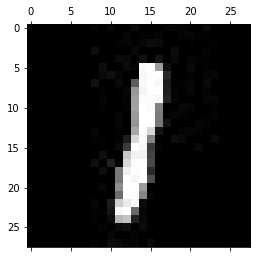

-------------------------------------------
Test: 930
Predicted: 9


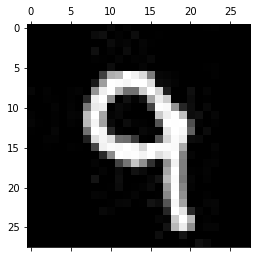

-------------------------------------------
Test: 931
Predicted: 9


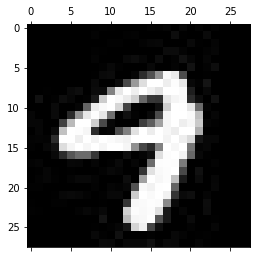

-------------------------------------------
Test: 932
Predicted: 5


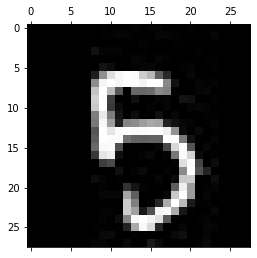

-------------------------------------------
Test: 933
Predicted: 5


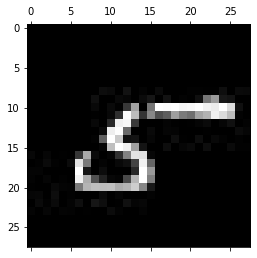

-------------------------------------------
Test: 934
Predicted: 3


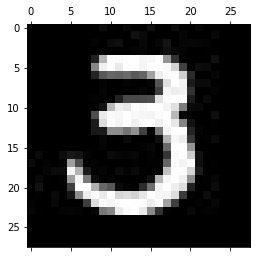

-------------------------------------------
Test: 935
Predicted: 1


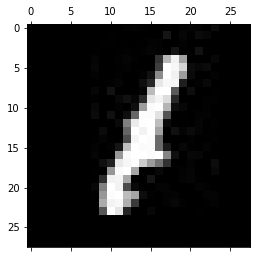

-------------------------------------------
Test: 936
Predicted: 3


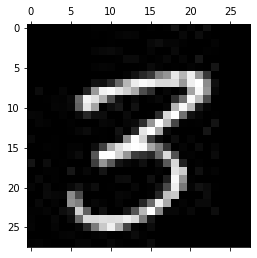

-------------------------------------------
Test: 937
Predicted: 9


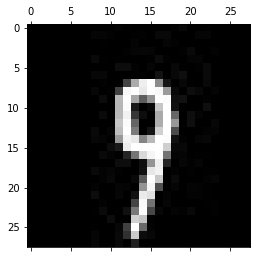

-------------------------------------------
Test: 938
Predicted: 8


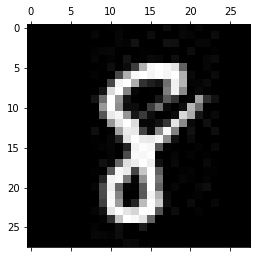

-------------------------------------------
Test: 939
Predicted: 4


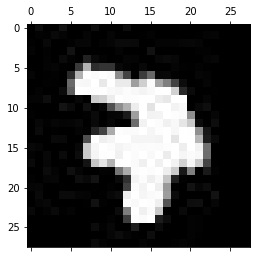

-------------------------------------------
Test: 940
Predicted: 3


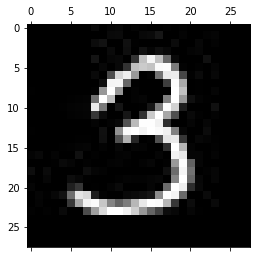

-------------------------------------------
Test: 941
Predicted: 2


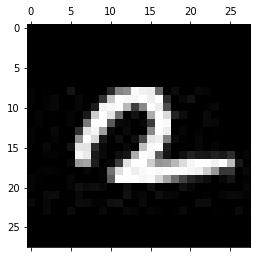

-------------------------------------------
Test: 942
Predicted: 1


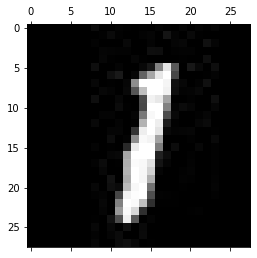

-------------------------------------------
Test: 943
Predicted: 7


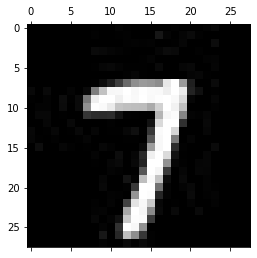

-------------------------------------------
Test: 944
Predicted: 2


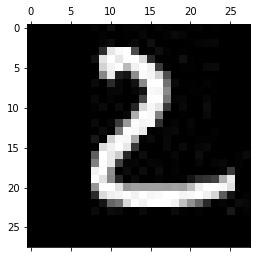

-------------------------------------------
Test: 945
Predicted: 2


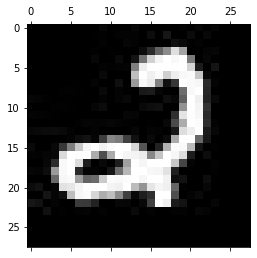

-------------------------------------------
Test: 946
Predicted: 5


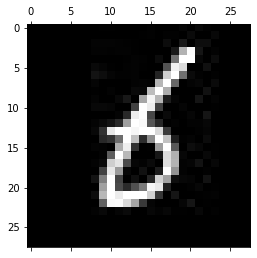

-------------------------------------------
Test: 947
Predicted: 1


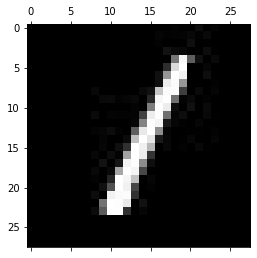

-------------------------------------------
Test: 948
Predicted: 0


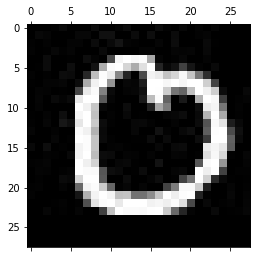

-------------------------------------------
Test: 949
Predicted: 9


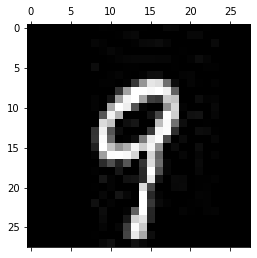

-------------------------------------------
Test: 950
Predicted: 5


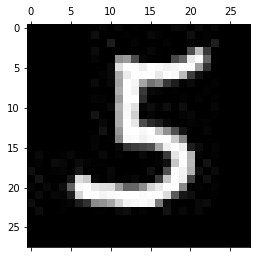

-------------------------------------------
Test: 951
Predicted: 5


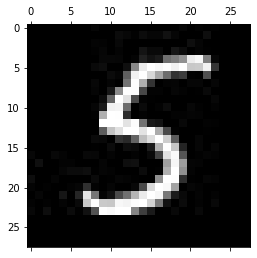

-------------------------------------------
Test: 952
Predicted: 7


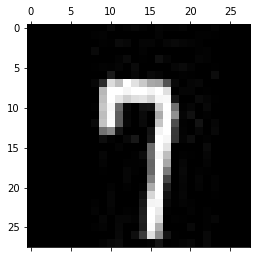

-------------------------------------------
Test: 953
Predicted: 8


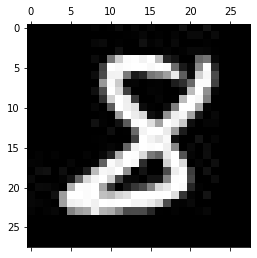

-------------------------------------------
Test: 954
Predicted: 0


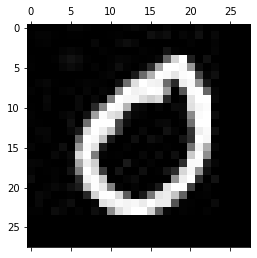

-------------------------------------------
Test: 955
Predicted: 2


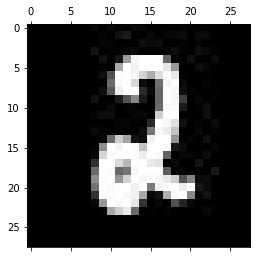

-------------------------------------------
Test: 956
Predicted: 2


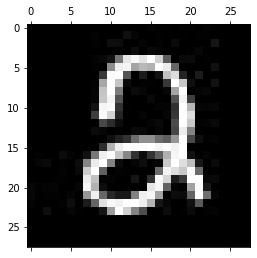

-------------------------------------------
Test: 957
Predicted: 9


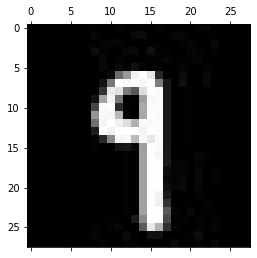

-------------------------------------------
Test: 958
Predicted: 4


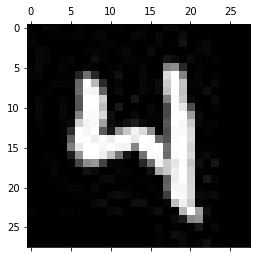

-------------------------------------------
Test: 959
Predicted: 7


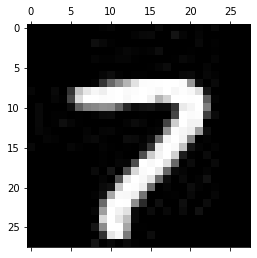

-------------------------------------------
Test: 960
Predicted: 5


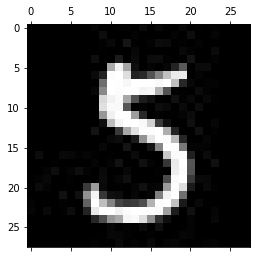

-------------------------------------------
Test: 961
Predicted: 3


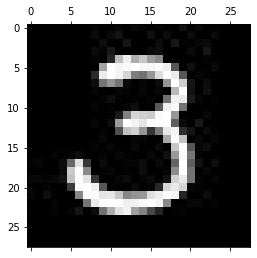

-------------------------------------------
Test: 962
Predicted: 5


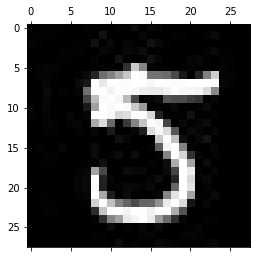

-------------------------------------------
Test: 963
Predicted: 4


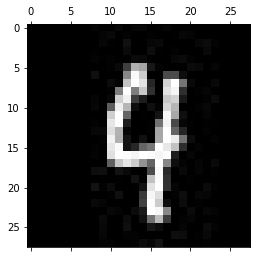

-------------------------------------------
Test: 964
Predicted: 8


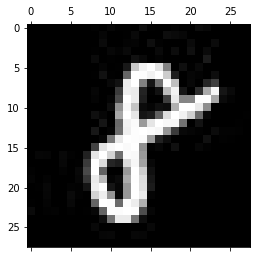

-------------------------------------------
Test: 965
Predicted: 1


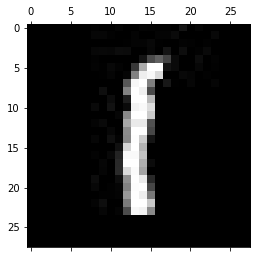

-------------------------------------------
Test: 966
Predicted: 9


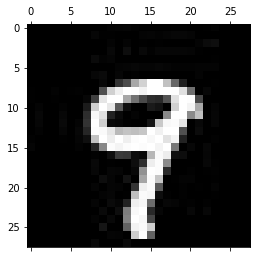

-------------------------------------------
Test: 967
Predicted: 2


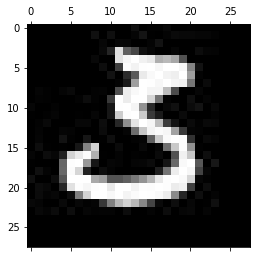

-------------------------------------------
Test: 968
Predicted: 4


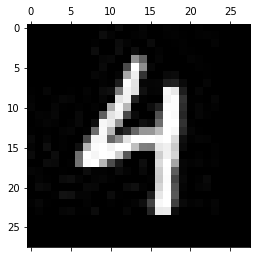

-------------------------------------------
Test: 969
Predicted: 8


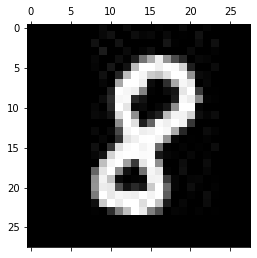

-------------------------------------------
Test: 970
Predicted: 2


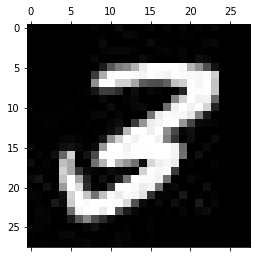

-------------------------------------------
Test: 971
Predicted: 5


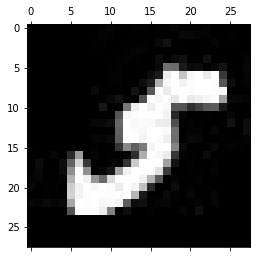

-------------------------------------------
Test: 972
Predicted: 8


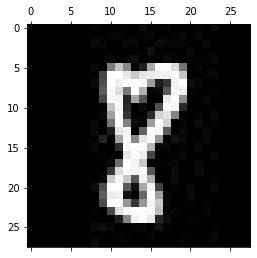

-------------------------------------------
Test: 973
Predicted: 1


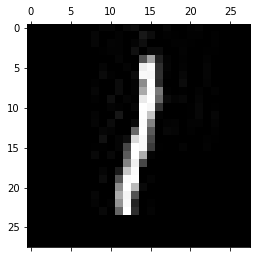

-------------------------------------------
Test: 974
Predicted: 4


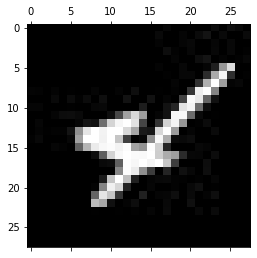

-------------------------------------------
Test: 975
Predicted: 6


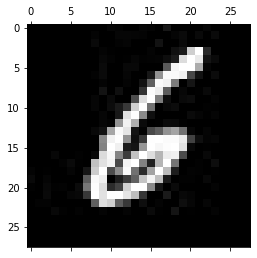

-------------------------------------------
Test: 976
Predicted: 1


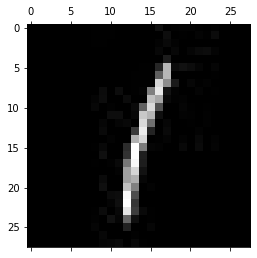

-------------------------------------------
Test: 977
Predicted: 0


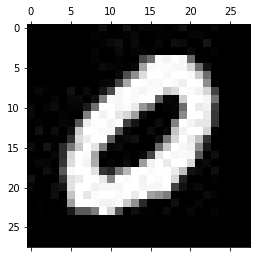

-------------------------------------------
Test: 978
Predicted: 6


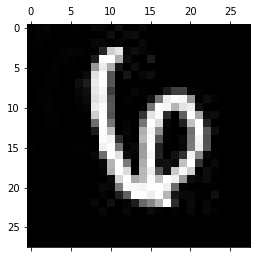

-------------------------------------------
Test: 979
Predicted: 8


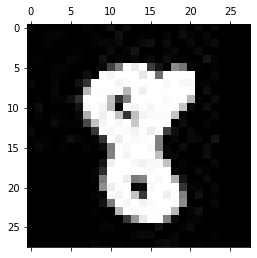

-------------------------------------------
Test: 980
Predicted: 8


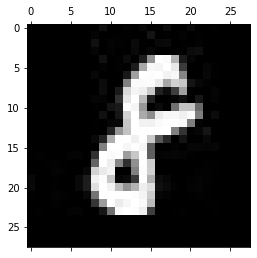

-------------------------------------------
Test: 981
Predicted: 0


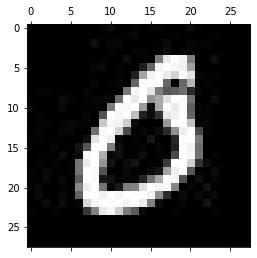

-------------------------------------------
Test: 982
Predicted: 4


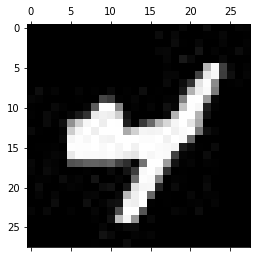

-------------------------------------------
Test: 983
Predicted: 3


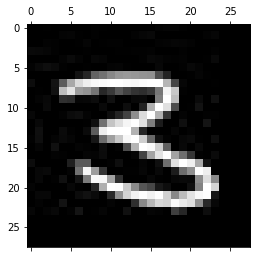

-------------------------------------------
Test: 984
Predicted: 3


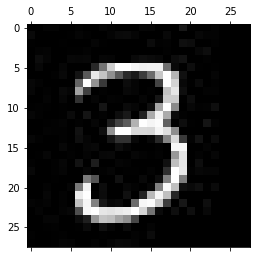

-------------------------------------------
Test: 985
Predicted: 6


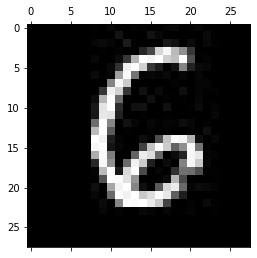

-------------------------------------------
Test: 986
Predicted: 2


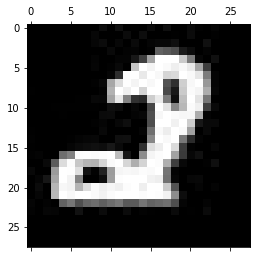

-------------------------------------------
Test: 987
Predicted: 1


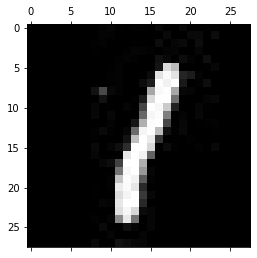

-------------------------------------------
Test: 988
Predicted: 9


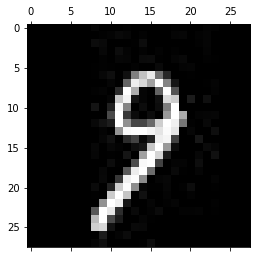

-------------------------------------------
Test: 989
Predicted: 1


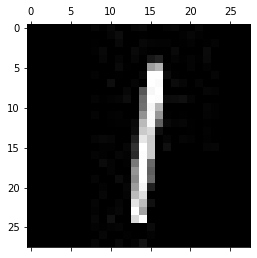

-------------------------------------------
Test: 990
Predicted: 0


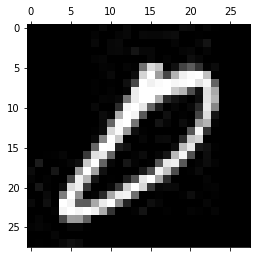

-------------------------------------------
Test: 991
Predicted: 3


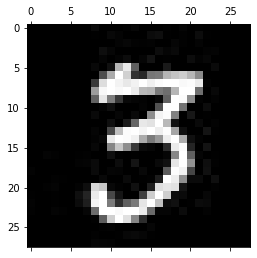

-------------------------------------------
Test: 992
Predicted: 4


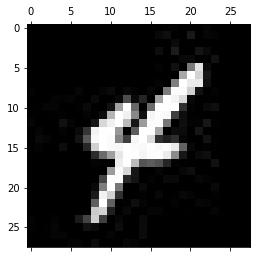

-------------------------------------------
Test: 993
Predicted: 3


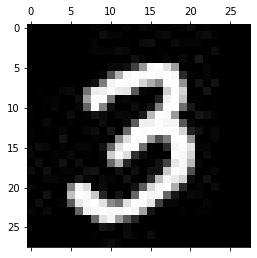

-------------------------------------------
Test: 994
Predicted: 8


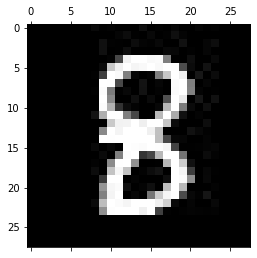

-------------------------------------------
Test: 995
Predicted: 4


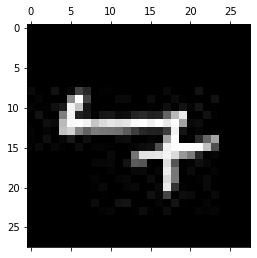

-------------------------------------------
Test: 996
Predicted: 9


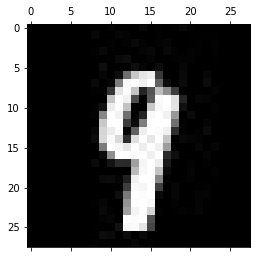

-------------------------------------------
Test: 997
Predicted: 7


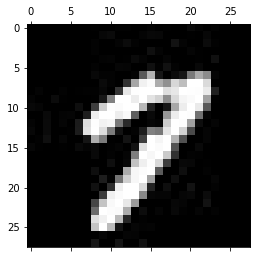

-------------------------------------------
Test: 998
Predicted: 6


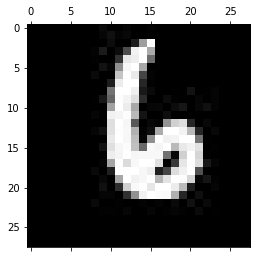

-------------------------------------------
Test: 999
Predicted: 4


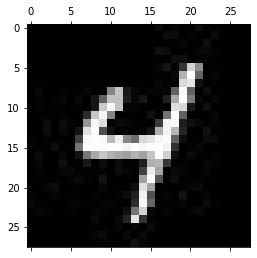

-------------------------------------------
Test: 1000
Predicted: 8


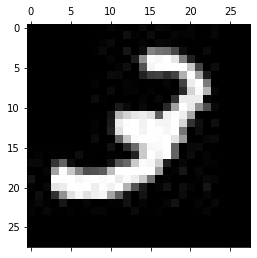

-------------------------------------------
Test: 1001
Predicted: 8


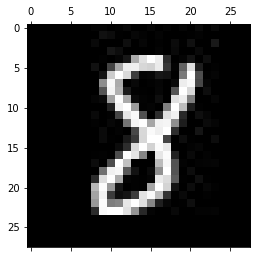

-------------------------------------------
Test: 1002
Predicted: 9


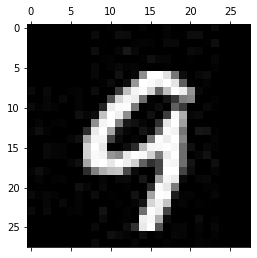

-------------------------------------------
Test: 1003
Predicted: 4


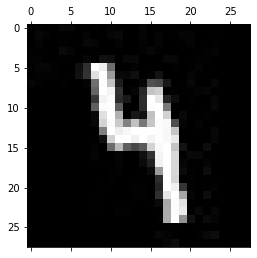

-------------------------------------------
Test: 1004
Predicted: 8


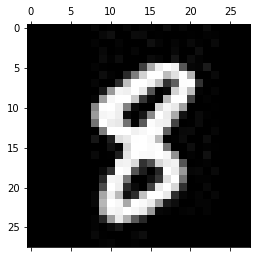

-------------------------------------------
Test: 1005
Predicted: 1


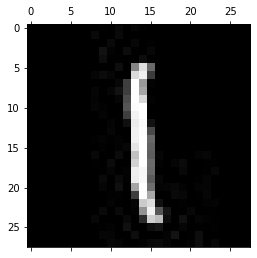

-------------------------------------------
Test: 1006
Predicted: 6


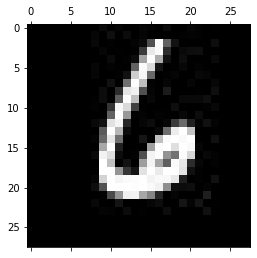

-------------------------------------------
Test: 1007
Predicted: 4


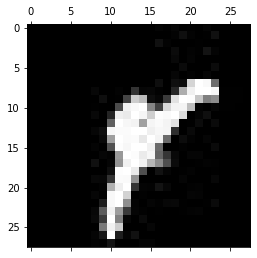

-------------------------------------------
Test: 1008
Predicted: 5


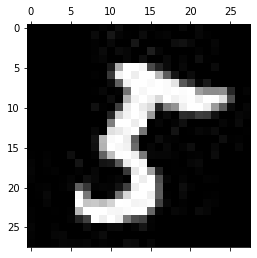

-------------------------------------------
Test: 1009
Predicted: 4


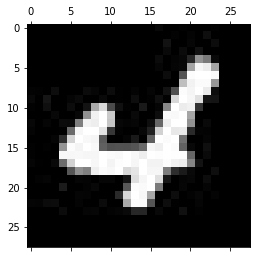

-------------------------------------------
Test: 1010
Predicted: 1


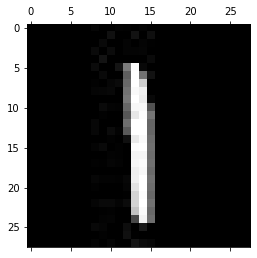

-------------------------------------------
Test: 1011
Predicted: 3


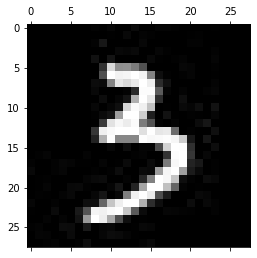

-------------------------------------------
Test: 1012
Predicted: 7


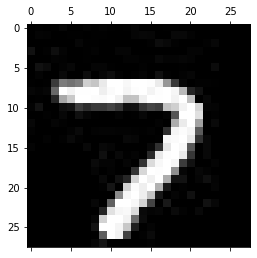

-------------------------------------------
Test: 1013
Predicted: 3


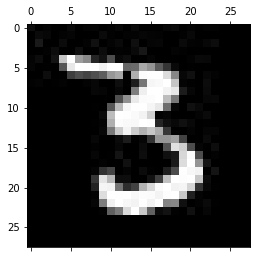

-------------------------------------------
Test: 1014
Predicted: 2


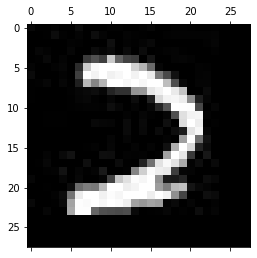

-------------------------------------------
Test: 1015
Predicted: 0


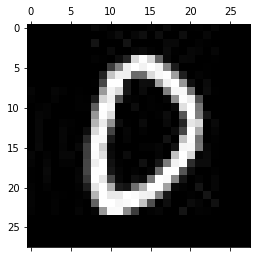

-------------------------------------------
Test: 1016
Predicted: 8


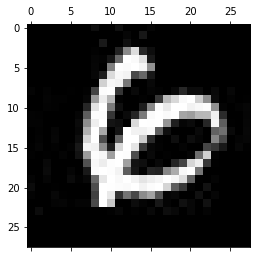

-------------------------------------------
Test: 1017
Predicted: 8


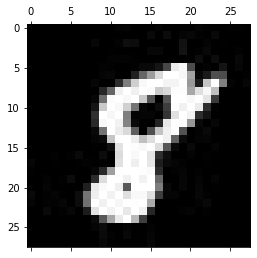

-------------------------------------------
Test: 1018
Predicted: 6


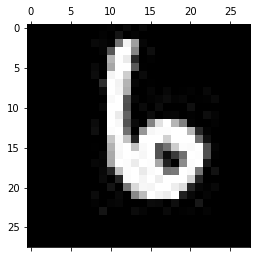

-------------------------------------------
Test: 1019
Predicted: 1


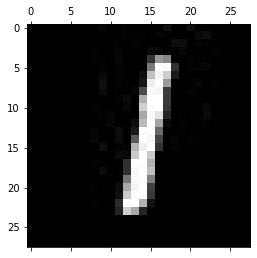

-------------------------------------------
Test: 1020
Predicted: 9


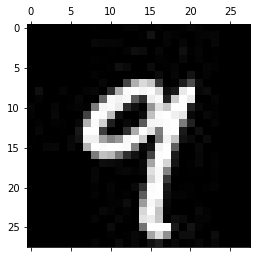

-------------------------------------------
Test: 1021
Predicted: 4


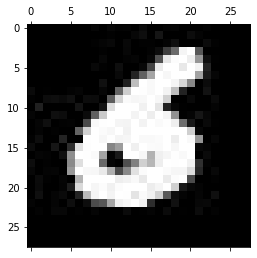

-------------------------------------------
Test: 1022
Predicted: 3


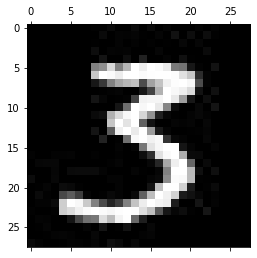

-------------------------------------------
Test: 1023
Predicted: 6


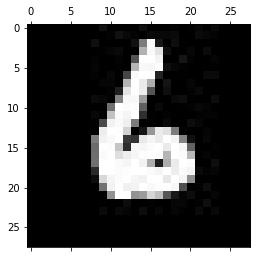

-------------------------------------------
Test: 1024
Predicted: 2


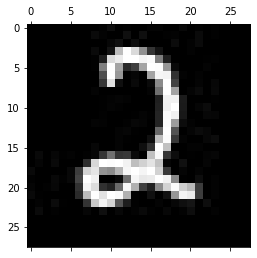

-------------------------------------------
Test: 1025
Predicted: 1


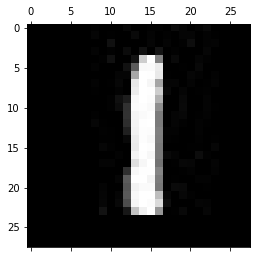

-------------------------------------------
Test: 1026
Predicted: 9


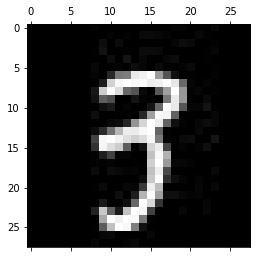

-------------------------------------------
Test: 1027
Predicted: 1


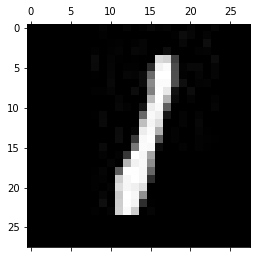

-------------------------------------------
Test: 1028
Predicted: 1


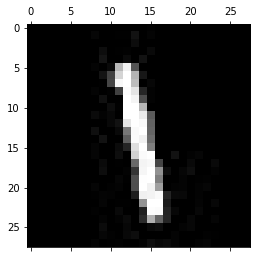

-------------------------------------------
Test: 1029
Predicted: 1


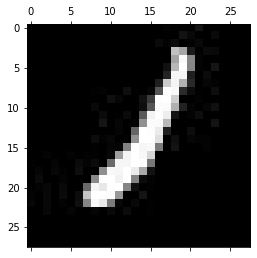

-------------------------------------------
Test: 1030
Predicted: 5


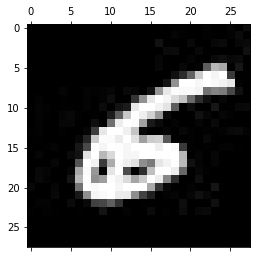

-------------------------------------------
Test: 1031
Predicted: 7


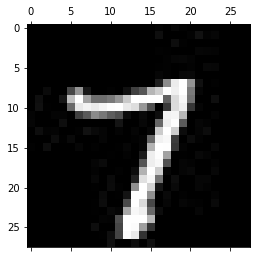

-------------------------------------------
Test: 1032
Predicted: 9


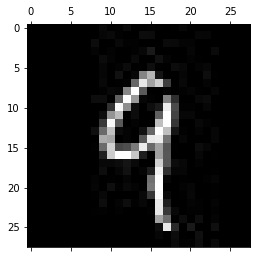

-------------------------------------------
Test: 1033
Predicted: 6


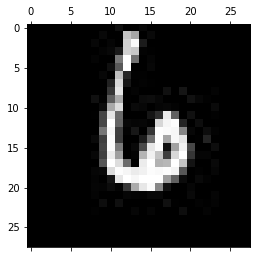

-------------------------------------------
Test: 1034
Predicted: 0


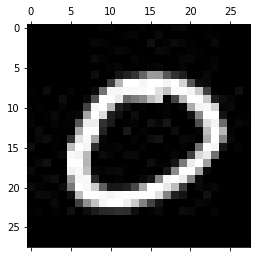

-------------------------------------------
Test: 1035
Predicted: 6


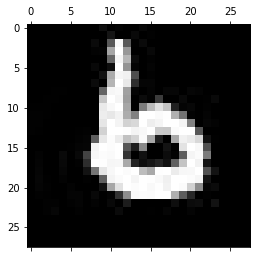

-------------------------------------------
Test: 1036
Predicted: 7


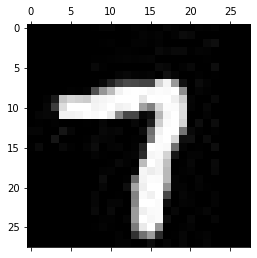

-------------------------------------------
Test: 1037
Predicted: 7


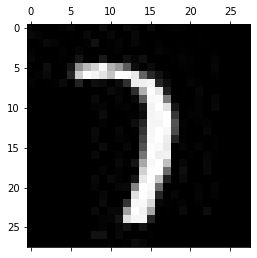

-------------------------------------------
Test: 1038
Predicted: 0


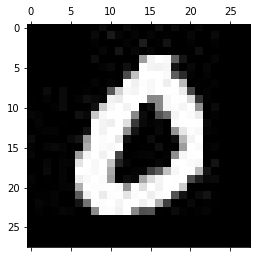

-------------------------------------------
Test: 1039
Predicted: 1


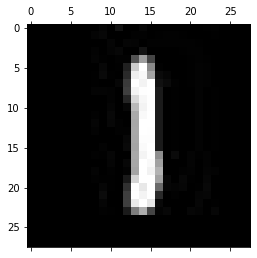

-------------------------------------------
Test: 1040
Predicted: 8


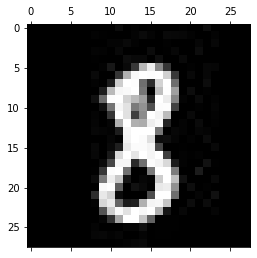

-------------------------------------------
Test: 1041
Predicted: 4


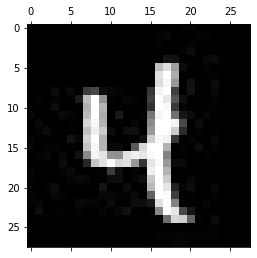

-------------------------------------------
Test: 1042
Predicted: 0


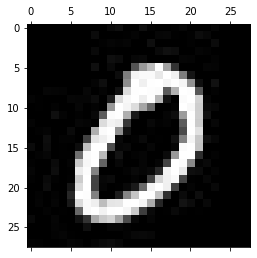

-------------------------------------------
Test: 1043
Predicted: 7


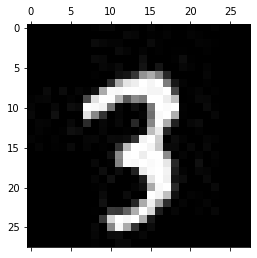

-------------------------------------------
Test: 1044
Predicted: 5


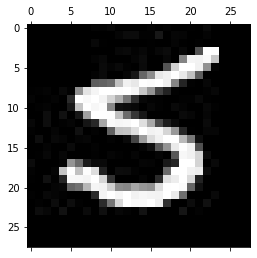

-------------------------------------------
Test: 1045
Predicted: 7


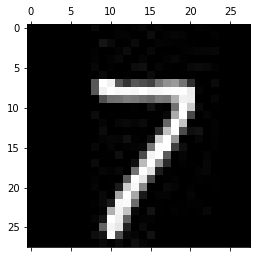

-------------------------------------------
Test: 1046
Predicted: 3


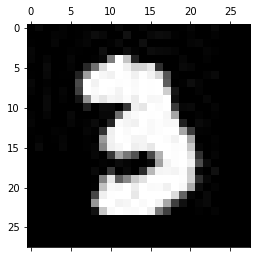

-------------------------------------------
Test: 1047
Predicted: 5


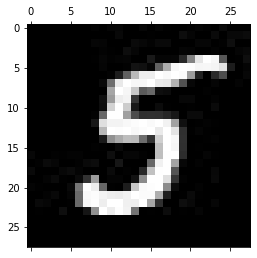

-------------------------------------------
Test: 1048
Predicted: 8


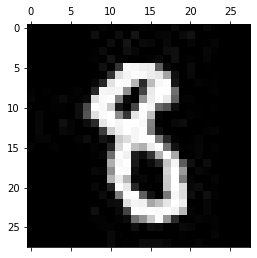

-------------------------------------------
Test: 1049
Predicted: 4


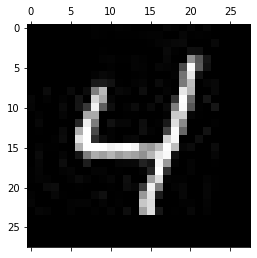

-------------------------------------------
Test: 1050
Predicted: 4


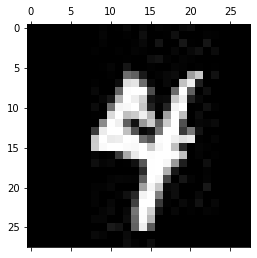

-------------------------------------------
Test: 1051
Predicted: 5


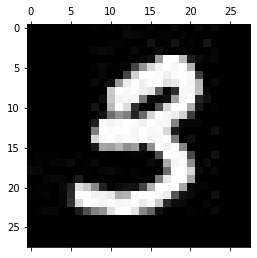

-------------------------------------------
Test: 1052
Predicted: 3


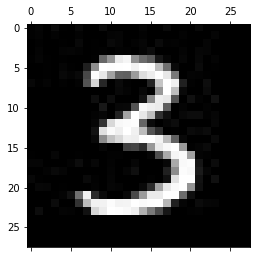

-------------------------------------------
Test: 1053
Predicted: 2


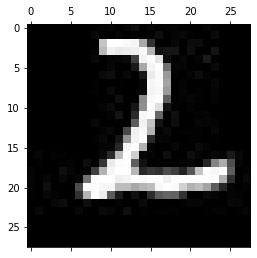

-------------------------------------------
Test: 1054
Predicted: 5


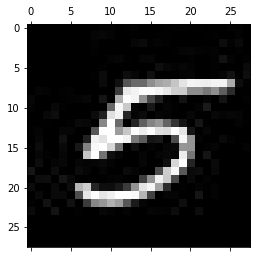

-------------------------------------------
Test: 1055
Predicted: 8


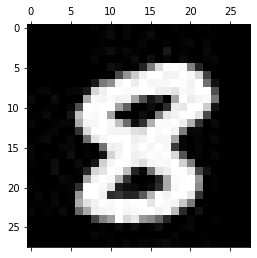

-------------------------------------------
Test: 1056
Predicted: 3


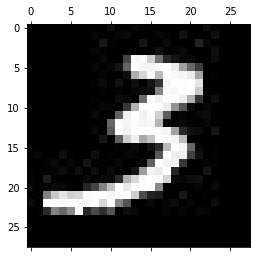

-------------------------------------------
Test: 1057
Predicted: 1


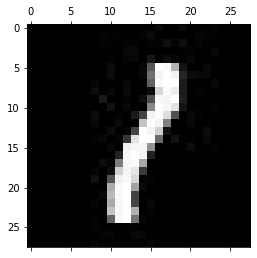

-------------------------------------------
Test: 1058
Predicted: 5


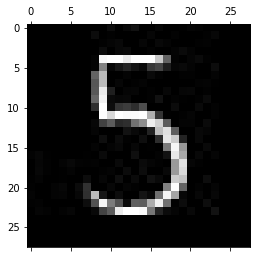

-------------------------------------------
Test: 1059
Predicted: 2


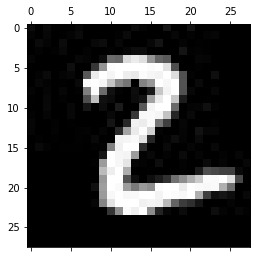

-------------------------------------------
Test: 1060
Predicted: 0


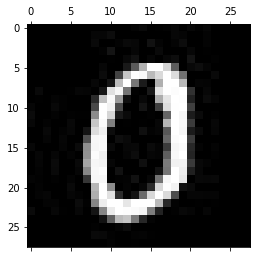

-------------------------------------------
Test: 1061
Predicted: 8


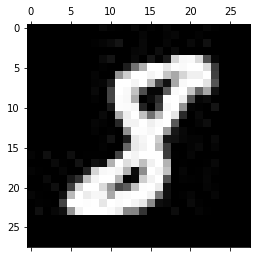

-------------------------------------------
Test: 1062
Predicted: 0


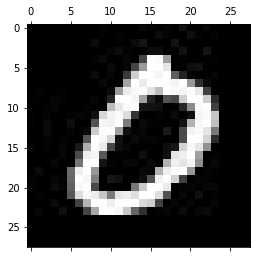

-------------------------------------------
Test: 1063
Predicted: 3


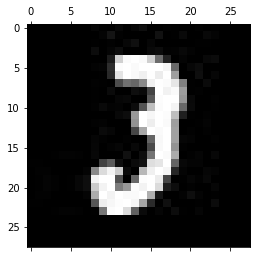

-------------------------------------------
Test: 1064
Predicted: 4


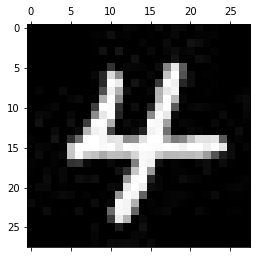

-------------------------------------------
Test: 1065
Predicted: 7


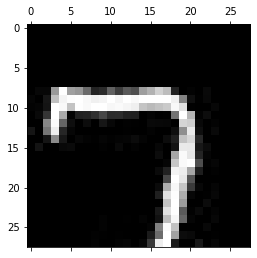

-------------------------------------------
Test: 1066
Predicted: 8


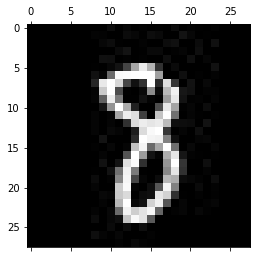

-------------------------------------------
Test: 1067
Predicted: 4


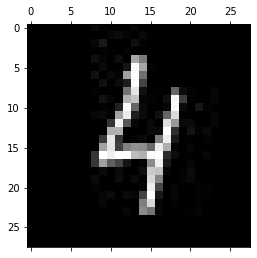

-------------------------------------------
Test: 1068
Predicted: 4


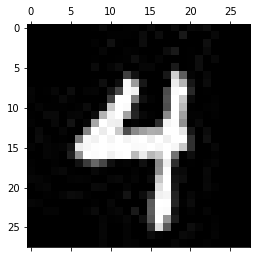

-------------------------------------------
Test: 1069
Predicted: 1


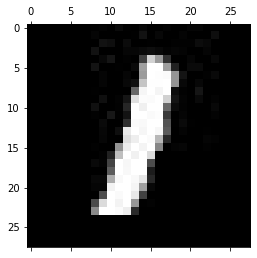

-------------------------------------------
Test: 1070
Predicted: 9


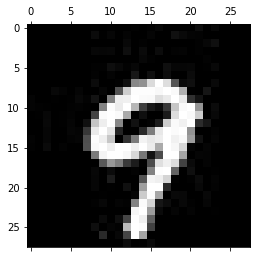

-------------------------------------------
Test: 1071
Predicted: 1


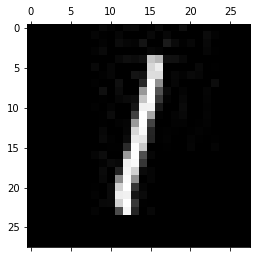

-------------------------------------------
Test: 1072
Predicted: 9


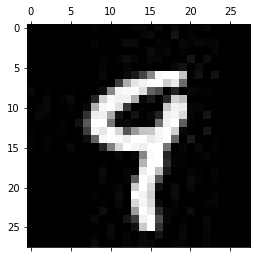

-------------------------------------------
Test: 1073
Predicted: 5


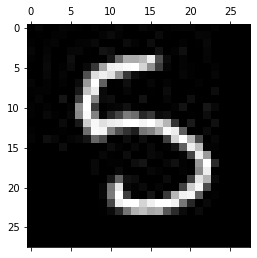

-------------------------------------------
Test: 1074
Predicted: 2


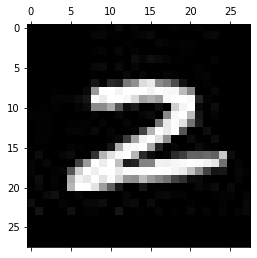

-------------------------------------------
Test: 1075
Predicted: 7


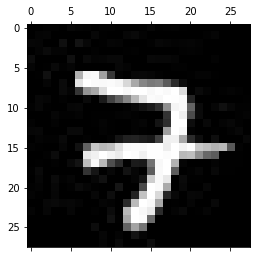

-------------------------------------------
Test: 1076
Predicted: 3


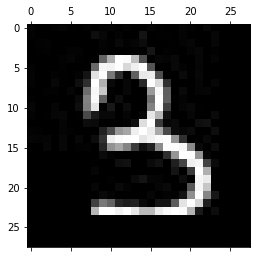

-------------------------------------------
Test: 1077
Predicted: 8


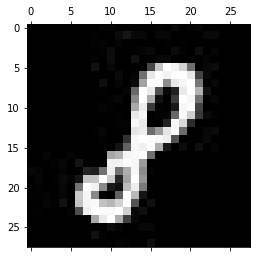

-------------------------------------------
Test: 1078
Predicted: 6


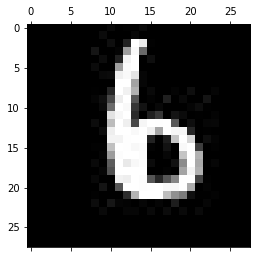

-------------------------------------------
Test: 1079
Predicted: 9


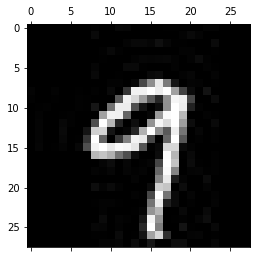

-------------------------------------------
Test: 1080
Predicted: 3


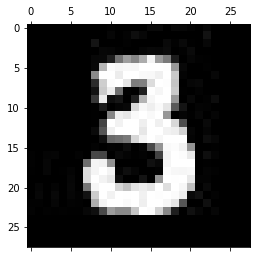

-------------------------------------------
Test: 1081
Predicted: 6


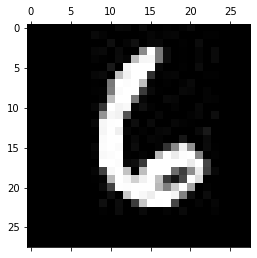

-------------------------------------------
Test: 1082
Predicted: 1


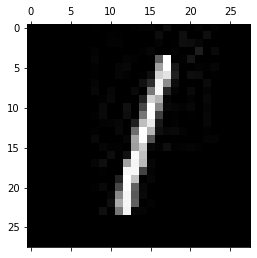

-------------------------------------------
Test: 1083
Predicted: 2


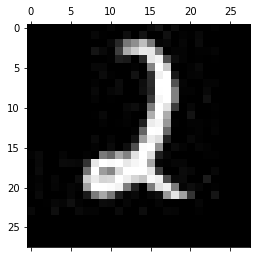

-------------------------------------------
Test: 1084
Predicted: 0


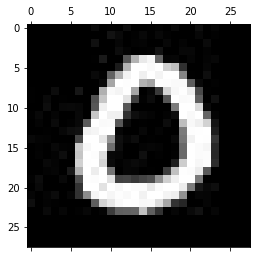

-------------------------------------------
Test: 1085
Predicted: 4


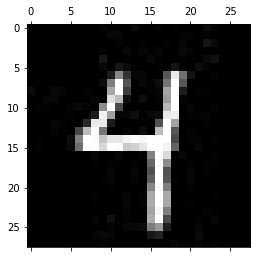

-------------------------------------------
Test: 1086
Predicted: 0


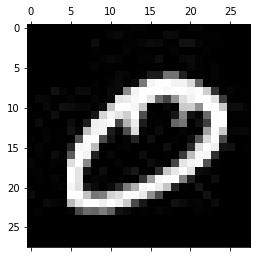

-------------------------------------------
Test: 1087
Predicted: 3


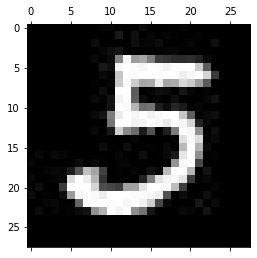

-------------------------------------------
Test: 1088
Predicted: 2


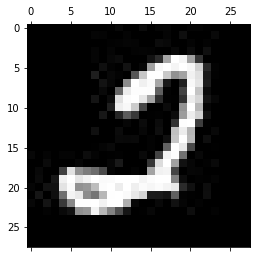

-------------------------------------------
Test: 1089
Predicted: 0


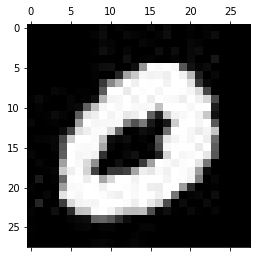

-------------------------------------------
Test: 1090
Predicted: 0


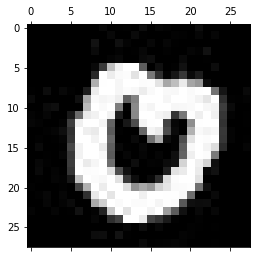

-------------------------------------------
Test: 1091
Predicted: 0


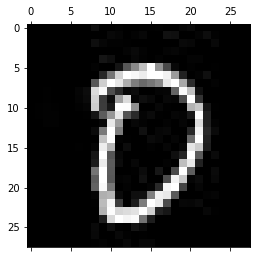

-------------------------------------------
Test: 1092
Predicted: 4


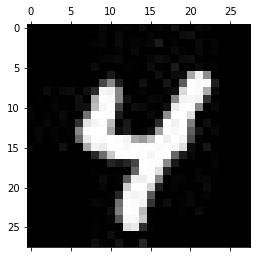

-------------------------------------------
Test: 1093
Predicted: 6


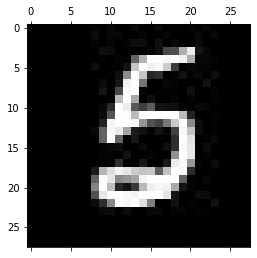

-------------------------------------------
Test: 1094
Predicted: 3


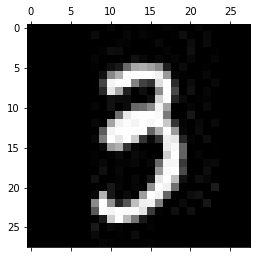

-------------------------------------------
Test: 1095
Predicted: 7


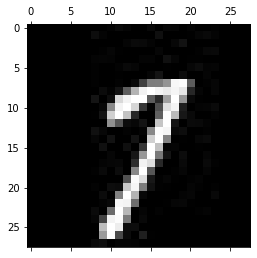

-------------------------------------------
Test: 1096
Predicted: 3


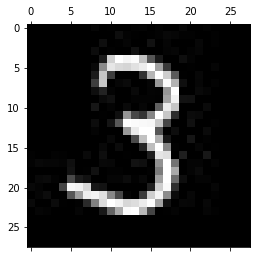

-------------------------------------------
Test: 1097
Predicted: 7


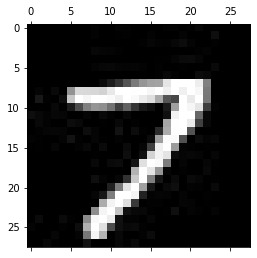

-------------------------------------------
Test: 1098
Predicted: 7


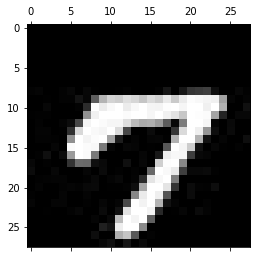

-------------------------------------------
Test: 1099
Predicted: 9


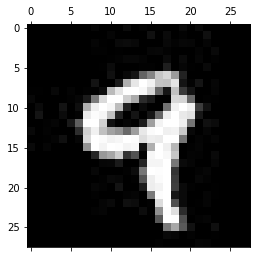

-------------------------------------------
Test: 1100
Predicted: 6


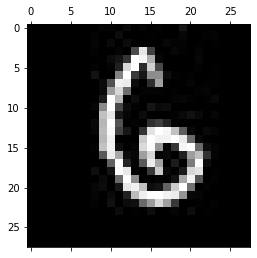

-------------------------------------------
Test: 1101
Predicted: 8


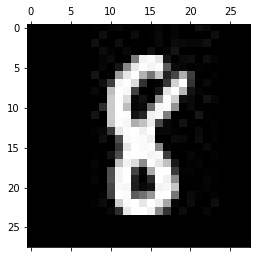

-------------------------------------------
Test: 1102
Predicted: 9


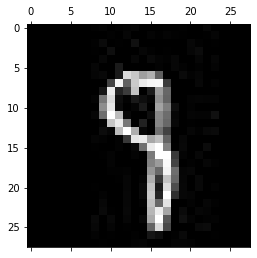

-------------------------------------------
Test: 1103
Predicted: 0


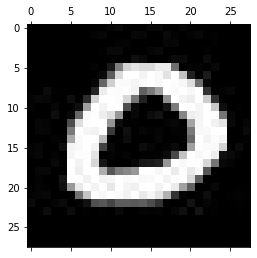

-------------------------------------------
Test: 1104
Predicted: 7


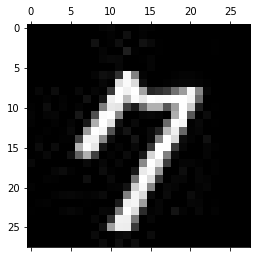

-------------------------------------------
Test: 1105
Predicted: 5


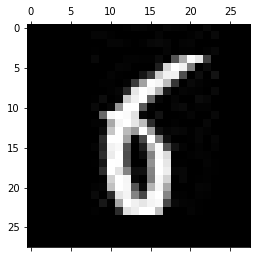

-------------------------------------------
Test: 1106
Predicted: 8


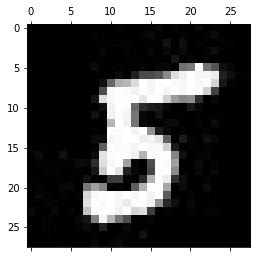

-------------------------------------------
Test: 1107
Predicted: 4


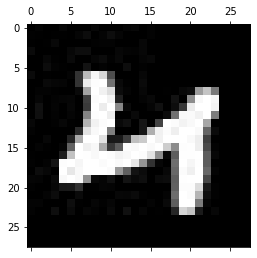

-------------------------------------------
Test: 1108
Predicted: 7


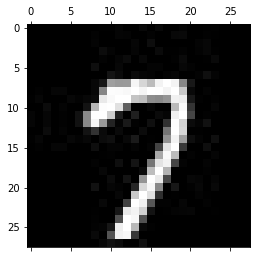

-------------------------------------------
Test: 1109
Predicted: 1


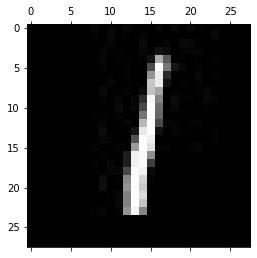

-------------------------------------------
Test: 1110
Predicted: 9


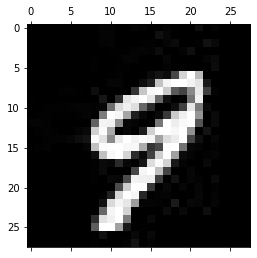

-------------------------------------------
Test: 1111
Predicted: 9


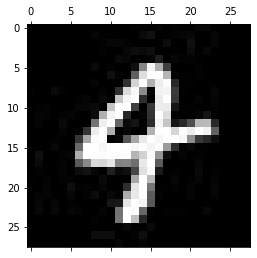

-------------------------------------------
Test: 1112
Predicted: 9


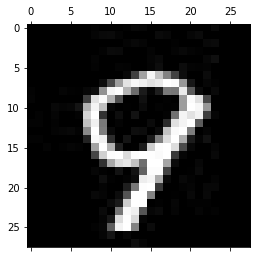

-------------------------------------------
Test: 1113
Predicted: 3


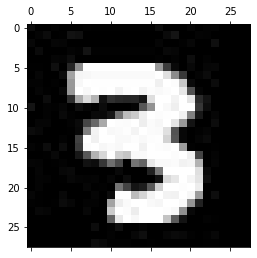

-------------------------------------------
Test: 1114
Predicted: 2


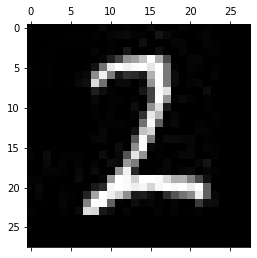

-------------------------------------------
Test: 1115
Predicted: 0


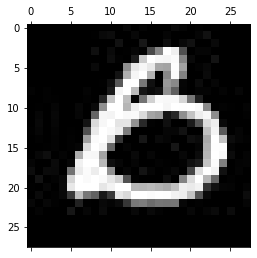

-------------------------------------------
Test: 1116
Predicted: 5


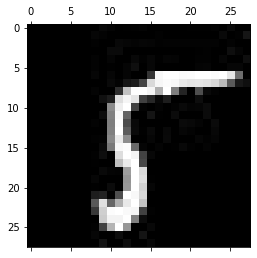

-------------------------------------------
Test: 1117
Predicted: 2


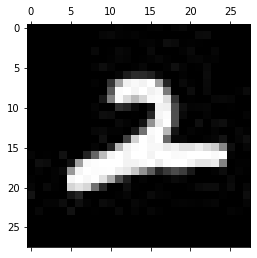

-------------------------------------------
Test: 1118
Predicted: 9


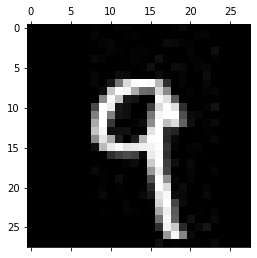

-------------------------------------------
Test: 1119
Predicted: 3


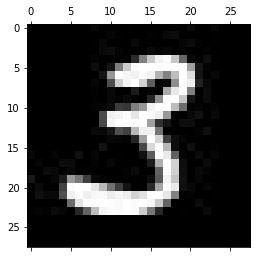

-------------------------------------------
Test: 1120
Predicted: 0


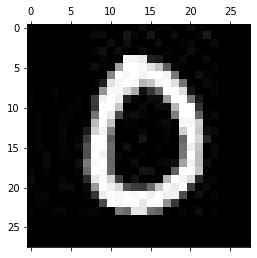

-------------------------------------------
Test: 1121
Predicted: 6


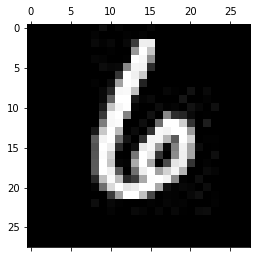

-------------------------------------------
Test: 1122
Predicted: 6


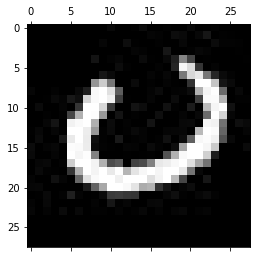

-------------------------------------------
Test: 1123
Predicted: 4


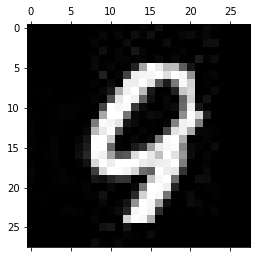

-------------------------------------------
Test: 1124
Predicted: 3


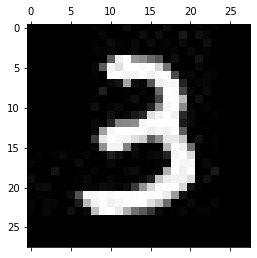

-------------------------------------------
Test: 1125
Predicted: 6


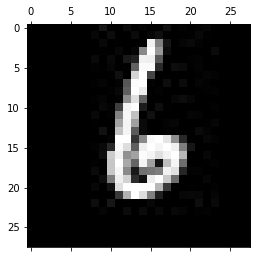

-------------------------------------------
Test: 1126
Predicted: 2


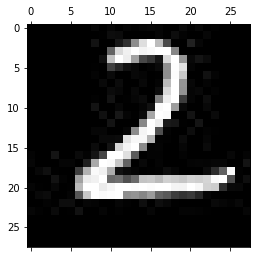

-------------------------------------------
Test: 1127
Predicted: 3


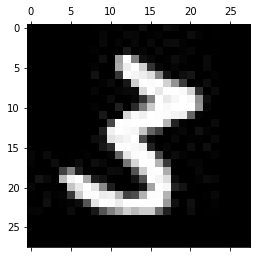

-------------------------------------------
Test: 1128
Predicted: 6


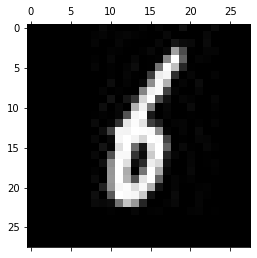

-------------------------------------------
Test: 1129
Predicted: 7


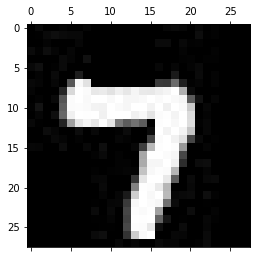

-------------------------------------------
Test: 1130
Predicted: 6


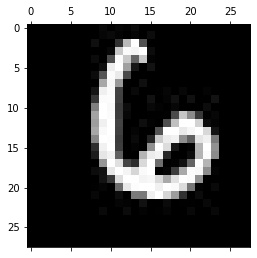

-------------------------------------------
Test: 1131
Predicted: 6


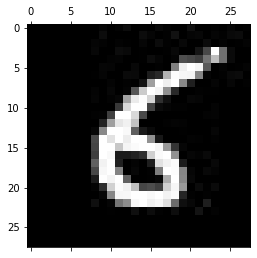

-------------------------------------------
Test: 1132
Predicted: 5


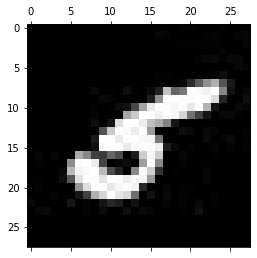

-------------------------------------------
Test: 1133
Predicted: 6


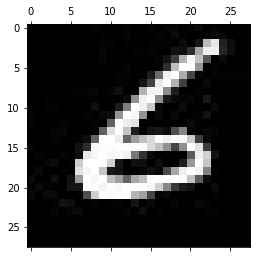

-------------------------------------------
Test: 1134
Predicted: 2


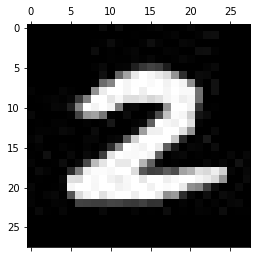

-------------------------------------------
Test: 1135
Predicted: 3


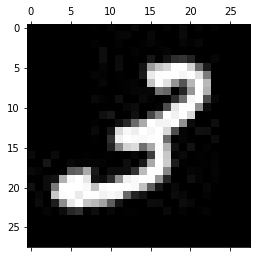

-------------------------------------------
Test: 1136
Predicted: 1


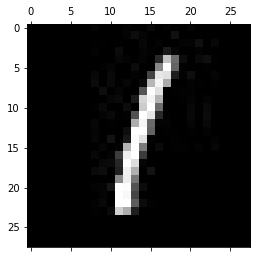

-------------------------------------------
Test: 1137
Predicted: 4


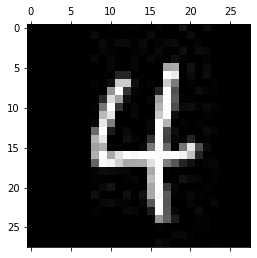

-------------------------------------------
Test: 1138
Predicted: 8


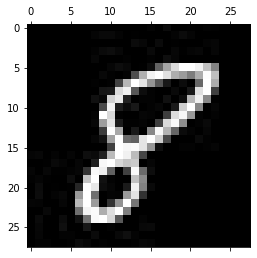

-------------------------------------------
Test: 1139
Predicted: 2


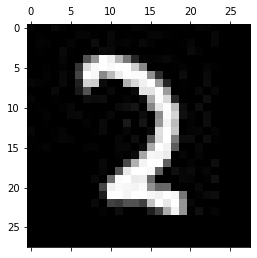

-------------------------------------------
Test: 1140
Predicted: 5


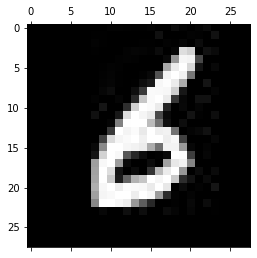

-------------------------------------------
Test: 1141
Predicted: 2


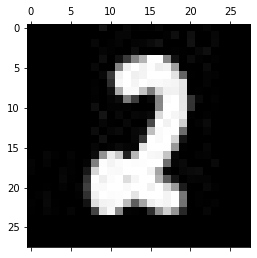

-------------------------------------------
Test: 1142
Predicted: 5


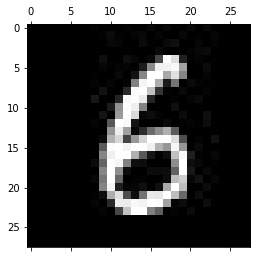

-------------------------------------------
Test: 1143
Predicted: 6


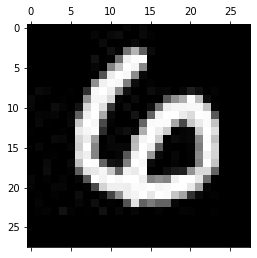

-------------------------------------------
Test: 1144
Predicted: 5


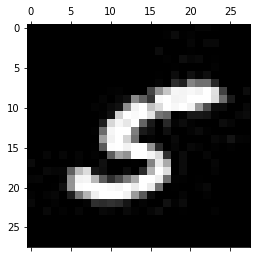

-------------------------------------------
Test: 1145
Predicted: 2


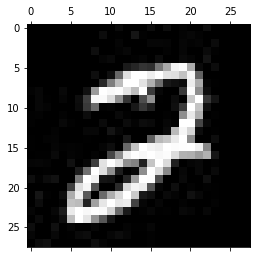

-------------------------------------------
Test: 1146
Predicted: 5


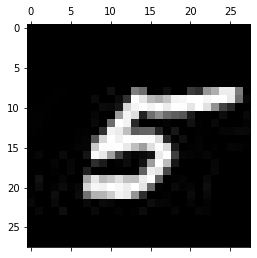

-------------------------------------------
Test: 1147
Predicted: 4


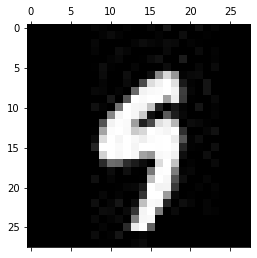

-------------------------------------------
Test: 1148
Predicted: 7


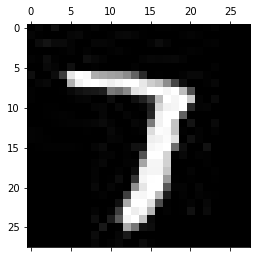

-------------------------------------------
Test: 1149
Predicted: 6


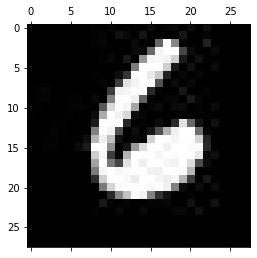

-------------------------------------------
Test: 1150
Predicted: 1


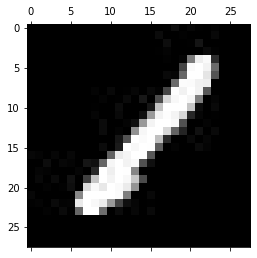

-------------------------------------------
Test: 1151
Predicted: 2


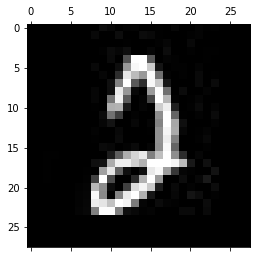

-------------------------------------------
Test: 1152
Predicted: 9


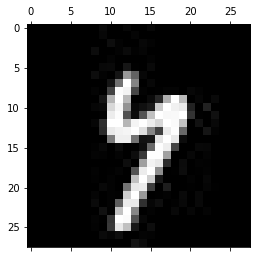

-------------------------------------------
Test: 1153
Predicted: 8


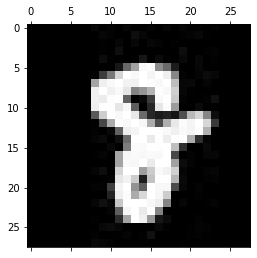

-------------------------------------------
Test: 1154
Predicted: 2


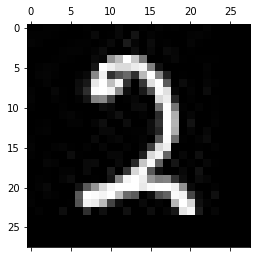

-------------------------------------------
Test: 1155
Predicted: 3


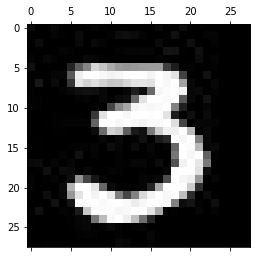

-------------------------------------------
Test: 1156
Predicted: 4


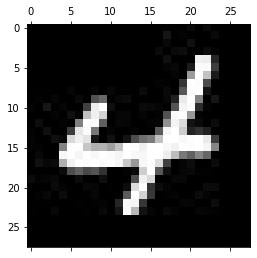

-------------------------------------------
Test: 1157
Predicted: 4


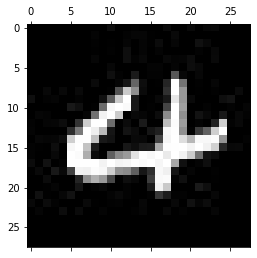

-------------------------------------------
Test: 1158
Predicted: 0


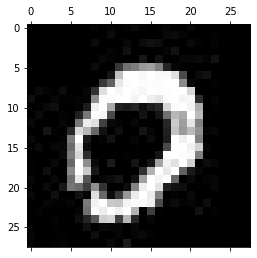

-------------------------------------------
Test: 1159
Predicted: 9


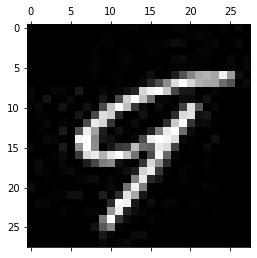

-------------------------------------------
Test: 1160
Predicted: 1


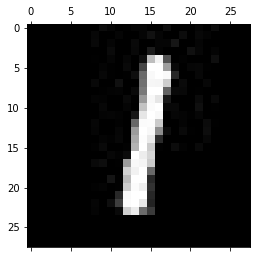

-------------------------------------------
Test: 1161
Predicted: 0


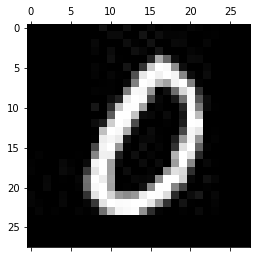

-------------------------------------------
Test: 1162
Predicted: 5


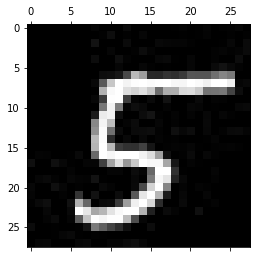

-------------------------------------------
Test: 1163
Predicted: 0


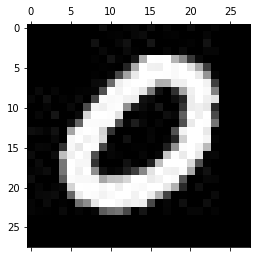

-------------------------------------------
Test: 1164
Predicted: 6


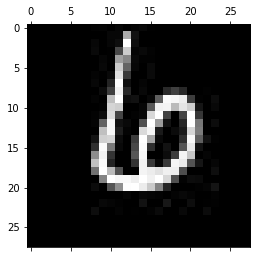

-------------------------------------------
Test: 1165
Predicted: 1


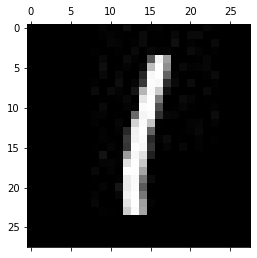

-------------------------------------------
Test: 1166
Predicted: 1


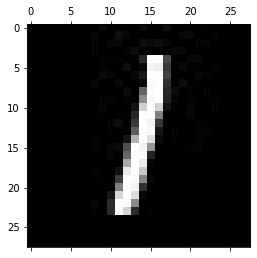

-------------------------------------------
Test: 1167
Predicted: 8


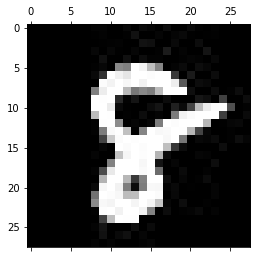

-------------------------------------------
Test: 1168
Predicted: 0


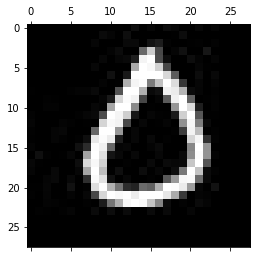

-------------------------------------------
Test: 1169
Predicted: 6


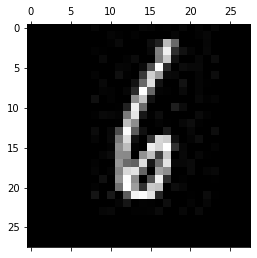

-------------------------------------------
Test: 1170
Predicted: 7


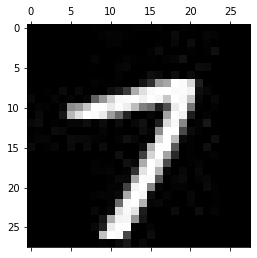

-------------------------------------------
Test: 1171
Predicted: 5


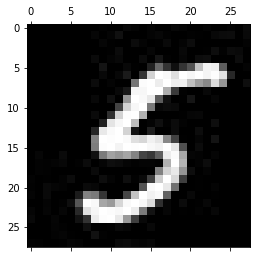

-------------------------------------------
Test: 1172
Predicted: 0


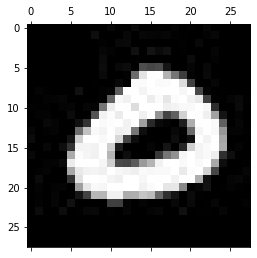

-------------------------------------------
Test: 1173
Predicted: 6


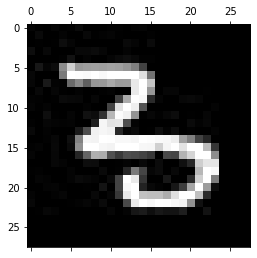

-------------------------------------------
Test: 1174
Predicted: 9


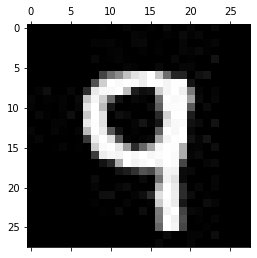

-------------------------------------------
Test: 1175
Predicted: 0


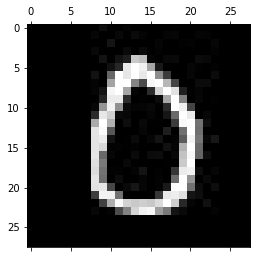

-------------------------------------------
Test: 1176
Predicted: 7


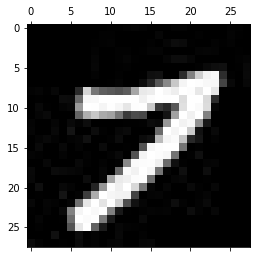

-------------------------------------------
Test: 1177
Predicted: 2


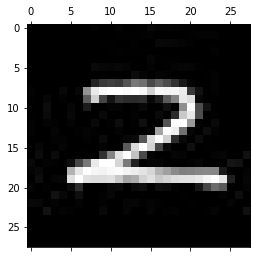

-------------------------------------------
Test: 1178
Predicted: 4


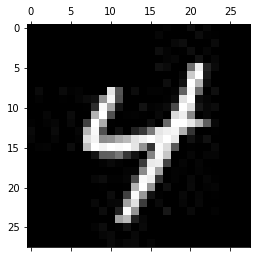

-------------------------------------------
Test: 1179
Predicted: 6


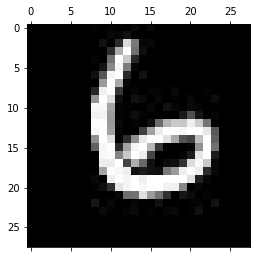

-------------------------------------------
Test: 1180
Predicted: 0


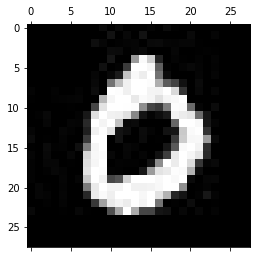

-------------------------------------------
Test: 1181
Predicted: 7


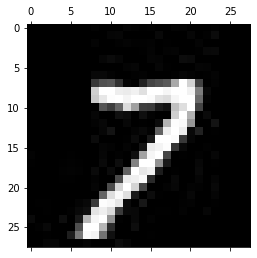

-------------------------------------------
Test: 1182
Predicted: 4


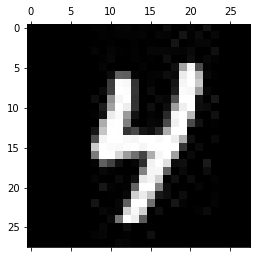

-------------------------------------------
Test: 1183
Predicted: 7


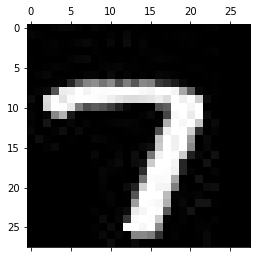

-------------------------------------------
Test: 1184
Predicted: 7


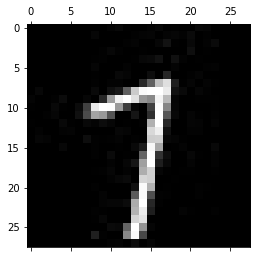

-------------------------------------------
Test: 1185
Predicted: 7


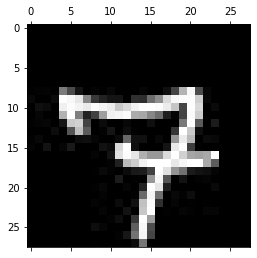

-------------------------------------------
Test: 1186
Predicted: 3


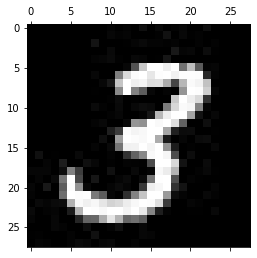

-------------------------------------------
Test: 1187
Predicted: 6


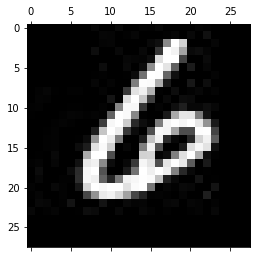

-------------------------------------------
Test: 1188
Predicted: 7


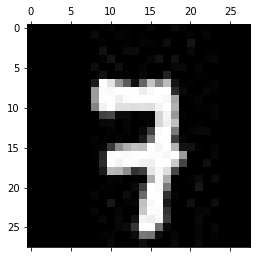

-------------------------------------------
Test: 1189
Predicted: 5


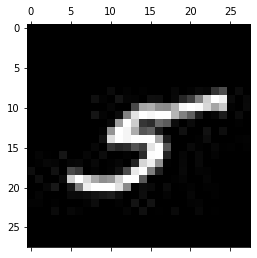

-------------------------------------------
Test: 1190
Predicted: 4


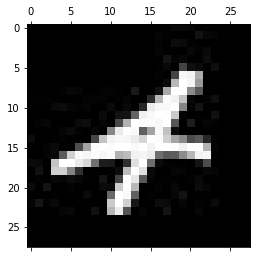

-------------------------------------------
Test: 1191
Predicted: 8


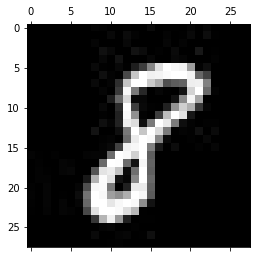

-------------------------------------------
Test: 1192
Predicted: 9


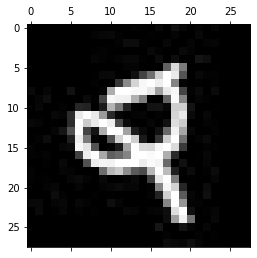

-------------------------------------------
Test: 1193
Predicted: 7


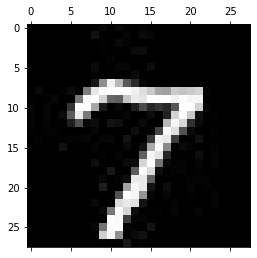

-------------------------------------------
Test: 1194
Predicted: 9


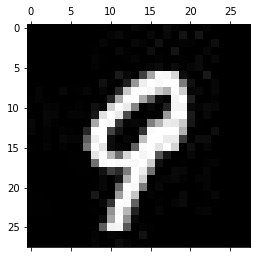

-------------------------------------------
Test: 1195
Predicted: 6


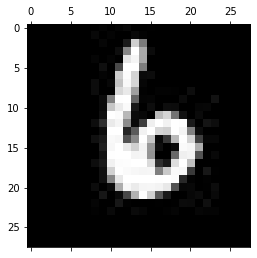

-------------------------------------------
Test: 1196
Predicted: 5


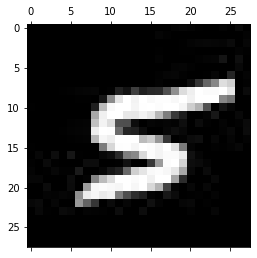

-------------------------------------------
Test: 1197
Predicted: 3


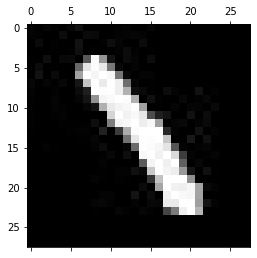

-------------------------------------------
Test: 1198
Predicted: 1


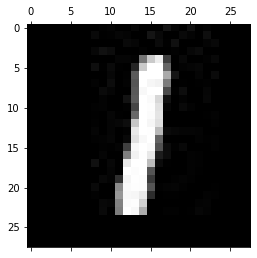

-------------------------------------------
Test: 1199
Predicted: 2


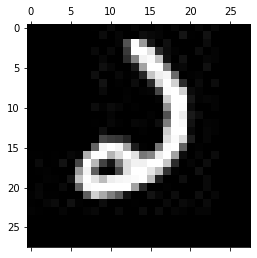

-------------------------------------------
Test: 1200
Predicted: 2


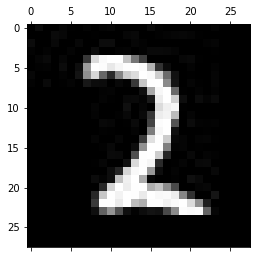

-------------------------------------------
Test: 1201
Predicted: 5


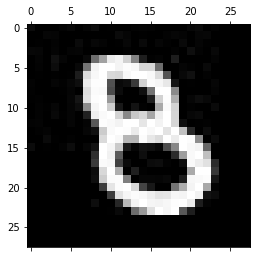

-------------------------------------------
Test: 1202
Predicted: 0


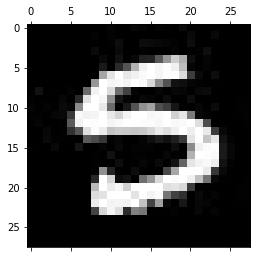

-------------------------------------------
Test: 1203
Predicted: 6


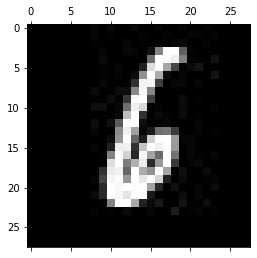

-------------------------------------------
Test: 1204
Predicted: 4


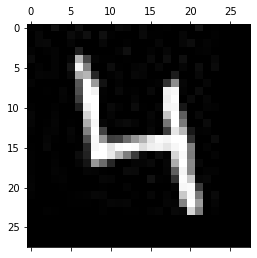

-------------------------------------------
Test: 1205
Predicted: 4


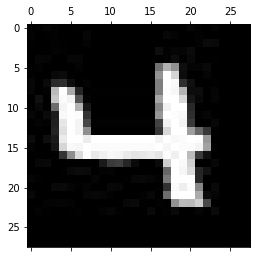

-------------------------------------------
Test: 1206
Predicted: 6


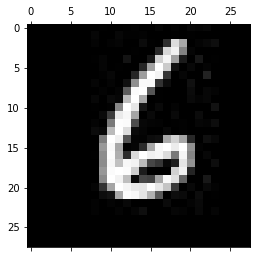

-------------------------------------------
Test: 1207
Predicted: 8


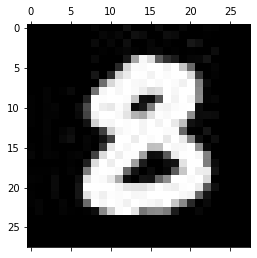

-------------------------------------------
Test: 1208
Predicted: 6


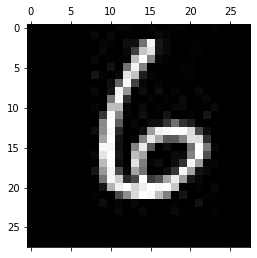

-------------------------------------------
Test: 1209
Predicted: 1


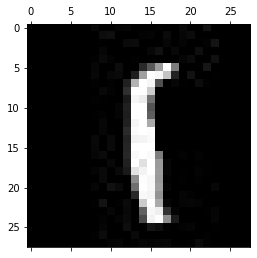

-------------------------------------------
Test: 1210
Predicted: 8


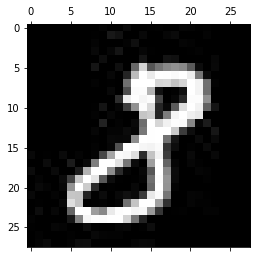

-------------------------------------------
Test: 1211
Predicted: 3


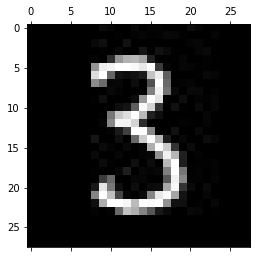

-------------------------------------------
Test: 1212
Predicted: 9


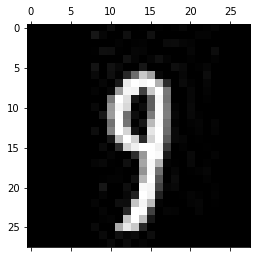

-------------------------------------------
Test: 1213
Predicted: 8


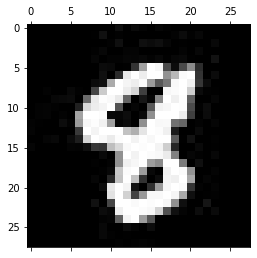

-------------------------------------------
Test: 1214
Predicted: 8


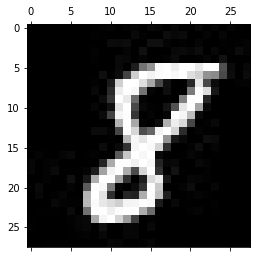

-------------------------------------------
Test: 1215
Predicted: 1


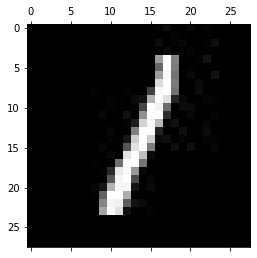

-------------------------------------------
Test: 1216
Predicted: 8


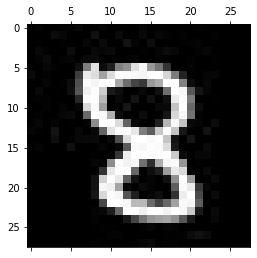

-------------------------------------------
Test: 1217
Predicted: 4


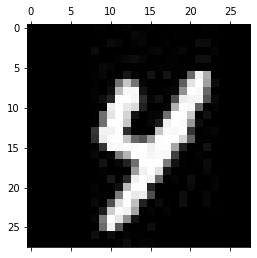

-------------------------------------------
Test: 1218
Predicted: 4


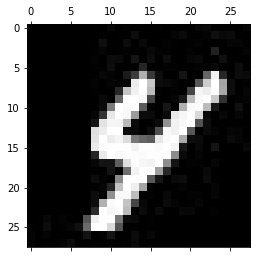

-------------------------------------------
Test: 1219
Predicted: 6


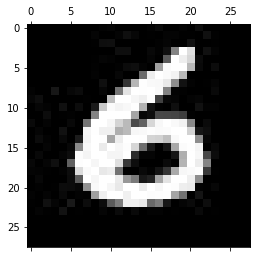

-------------------------------------------
Test: 1220
Predicted: 1


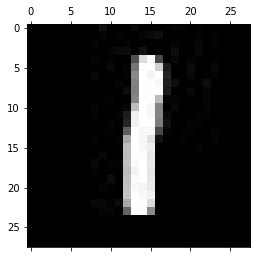

-------------------------------------------
Test: 1221
Predicted: 2


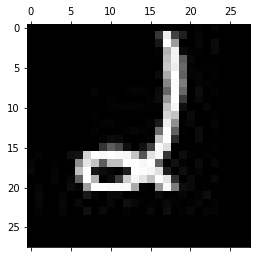

-------------------------------------------
Test: 1222
Predicted: 3


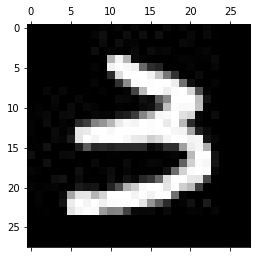

-------------------------------------------
Test: 1223
Predicted: 8


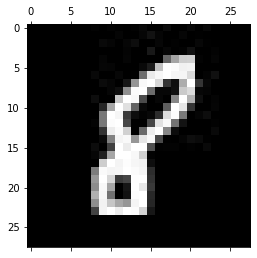

-------------------------------------------
Test: 1224
Predicted: 1


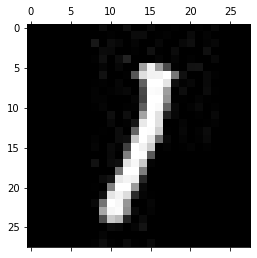

-------------------------------------------
Test: 1225
Predicted: 5


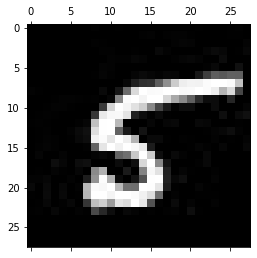

-------------------------------------------
Test: 1226
Predicted: 8


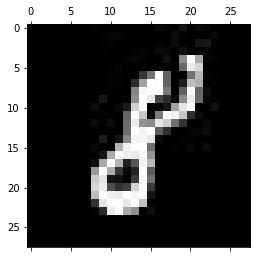

-------------------------------------------
Test: 1227
Predicted: 4


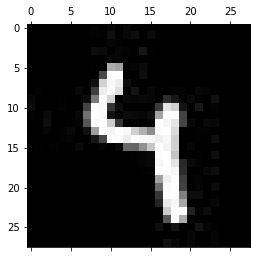

-------------------------------------------
Test: 1228
Predicted: 0


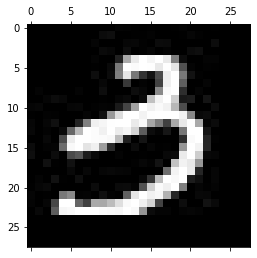

-------------------------------------------
Test: 1229
Predicted: 1


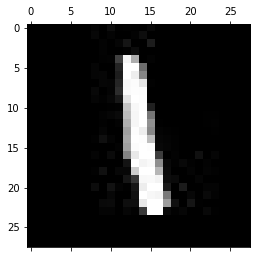

-------------------------------------------
Test: 1230
Predicted: 0


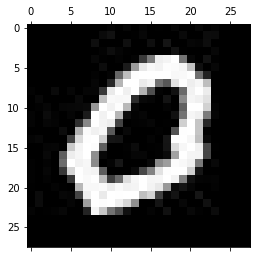

-------------------------------------------
Test: 1231
Predicted: 1


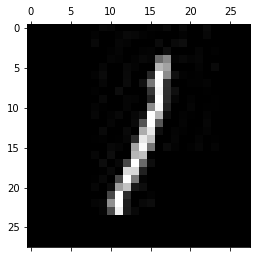

-------------------------------------------
Test: 1232
Predicted: 9


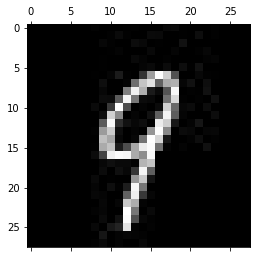

-------------------------------------------
Test: 1233
Predicted: 2


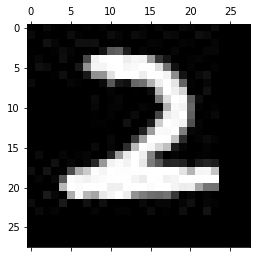

-------------------------------------------
Test: 1234
Predicted: 4


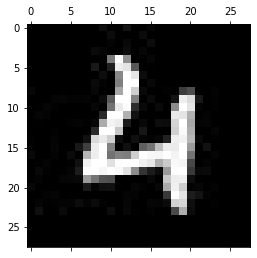

-------------------------------------------
Test: 1235
Predicted: 5


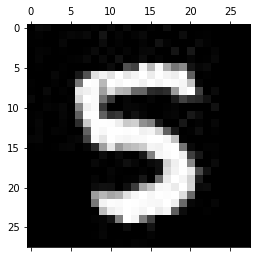

-------------------------------------------
Test: 1236
Predicted: 3


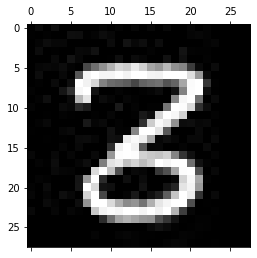

-------------------------------------------
Test: 1237
Predicted: 1


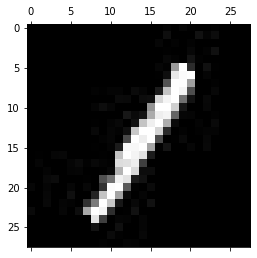

-------------------------------------------
Test: 1238
Predicted: 6


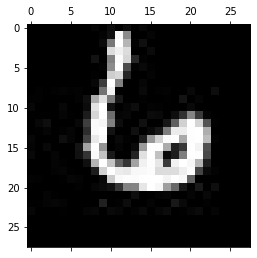

-------------------------------------------
Test: 1239
Predicted: 6


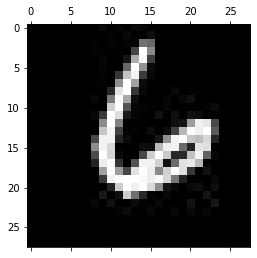

-------------------------------------------
Test: 1240
Predicted: 9


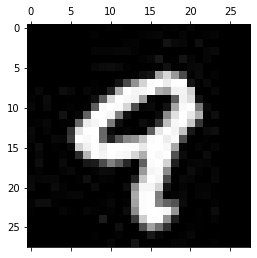

-------------------------------------------
Test: 1241
Predicted: 4


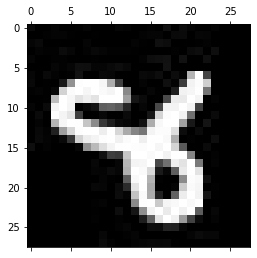

-------------------------------------------
Test: 1242
Predicted: 6


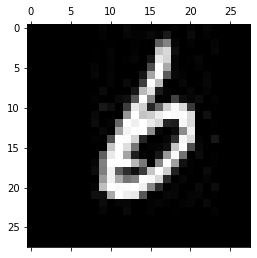

-------------------------------------------
Test: 1243
Predicted: 3


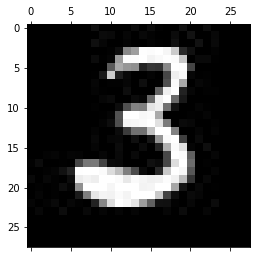

-------------------------------------------
Test: 1244
Predicted: 0


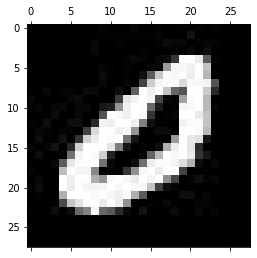

-------------------------------------------
Test: 1245
Predicted: 0


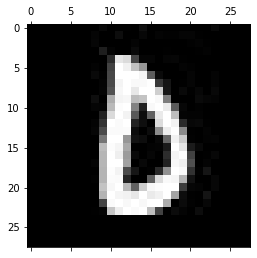

-------------------------------------------
Test: 1246
Predicted: 4


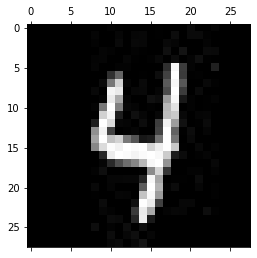

-------------------------------------------
Test: 1247
Predicted: 1


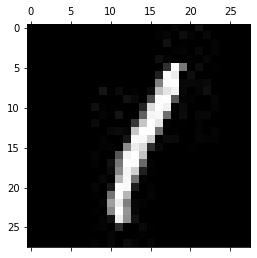

-------------------------------------------
Test: 1248
Predicted: 0


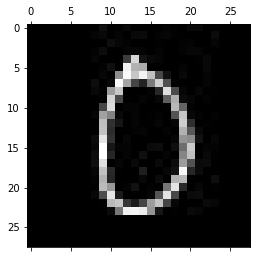

-------------------------------------------
Test: 1249
Predicted: 4


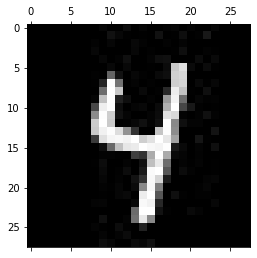

-------------------------------------------
Test: 1250
Predicted: 6


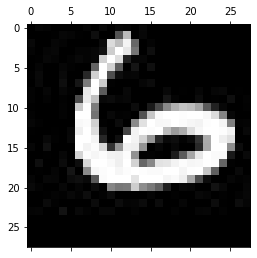

-------------------------------------------
Test: 1251
Predicted: 4


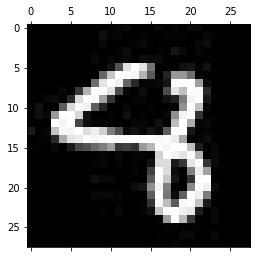

-------------------------------------------
Test: 1252
Predicted: 3


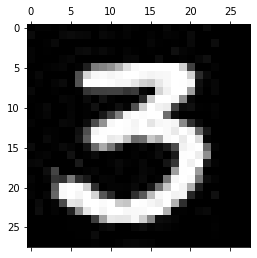

-------------------------------------------
Test: 1253
Predicted: 7


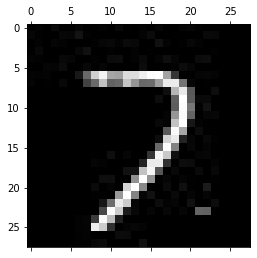

-------------------------------------------
Test: 1254
Predicted: 1


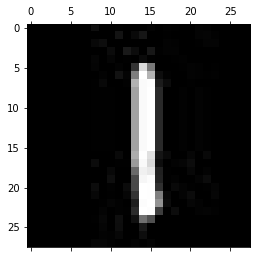

-------------------------------------------
Test: 1255
Predicted: 7


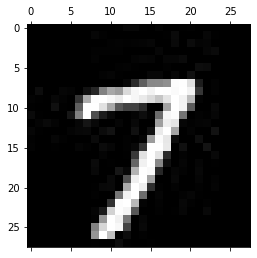

-------------------------------------------
Test: 1256
Predicted: 6


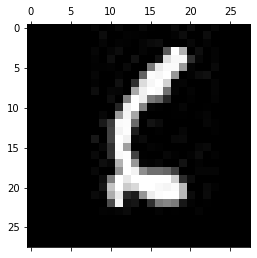

-------------------------------------------
Test: 1257
Predicted: 2


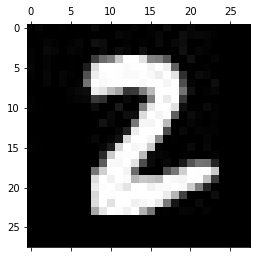

-------------------------------------------
Test: 1258
Predicted: 4


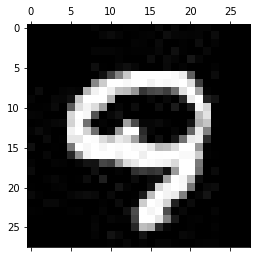

-------------------------------------------
Test: 1259
Predicted: 8


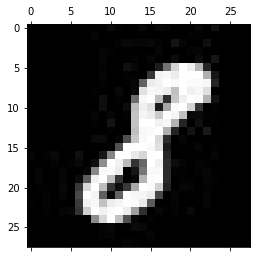

-------------------------------------------
Test: 1260
Predicted: 4


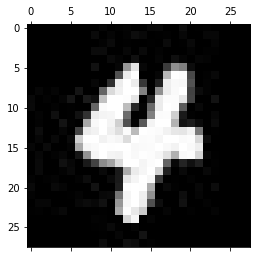

-------------------------------------------
Test: 1261
Predicted: 9


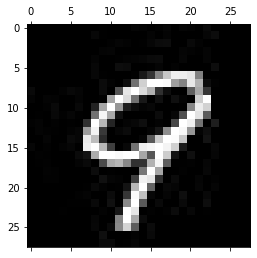

-------------------------------------------
Test: 1262
Predicted: 1


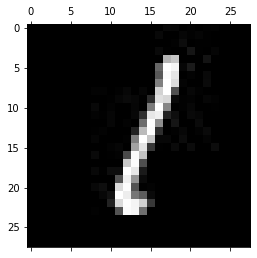

-------------------------------------------
Test: 1263
Predicted: 4


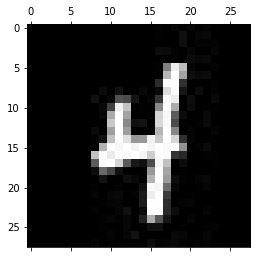

-------------------------------------------
Test: 1264
Predicted: 8


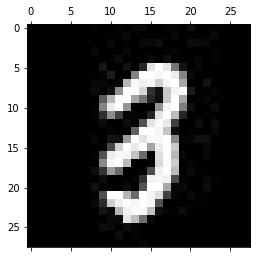

-------------------------------------------
Test: 1265
Predicted: 0


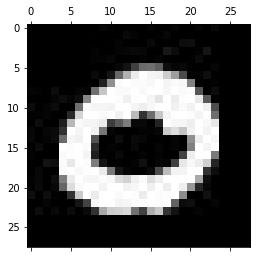

-------------------------------------------
Test: 1266
Predicted: 7


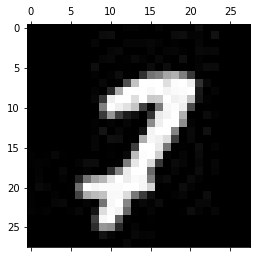

-------------------------------------------
Test: 1267
Predicted: 4


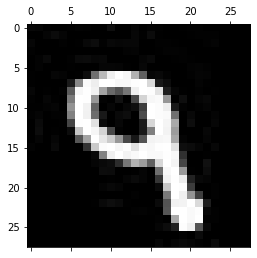

-------------------------------------------
Test: 1268
Predicted: 7


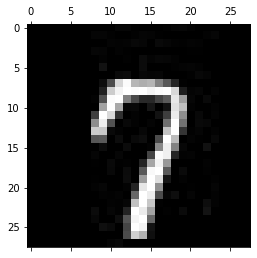

-------------------------------------------
Test: 1269
Predicted: 0


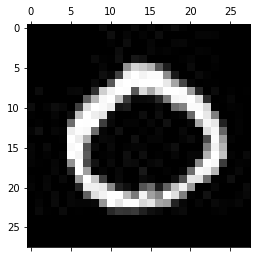

-------------------------------------------
Test: 1270
Predicted: 4


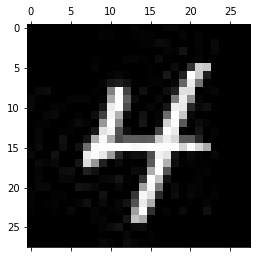

-------------------------------------------
Test: 1271
Predicted: 3


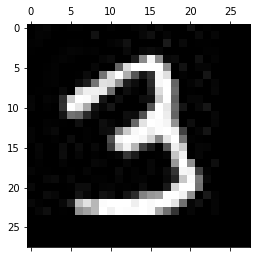

-------------------------------------------
Test: 1272
Predicted: 7


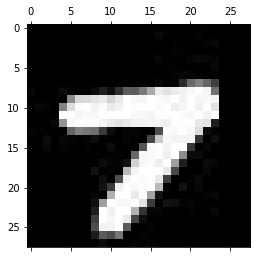

-------------------------------------------
Test: 1273
Predicted: 1


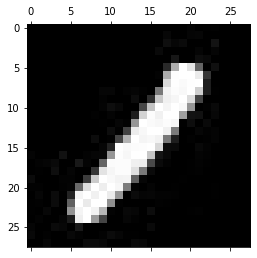

-------------------------------------------
Test: 1274
Predicted: 7


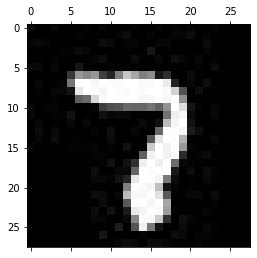

-------------------------------------------
Test: 1275
Predicted: 5


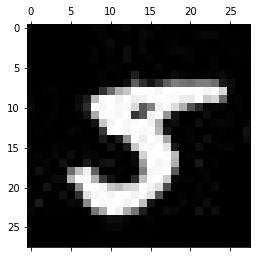

-------------------------------------------
Test: 1276
Predicted: 2


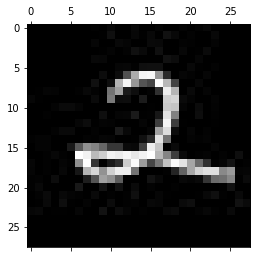

-------------------------------------------
Test: 1277
Predicted: 8


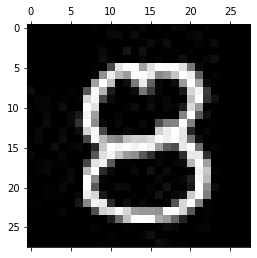

-------------------------------------------
Test: 1278
Predicted: 5


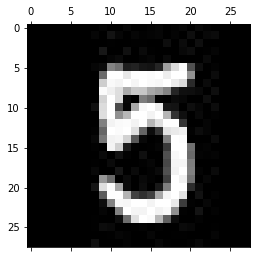

-------------------------------------------
Test: 1279
Predicted: 7


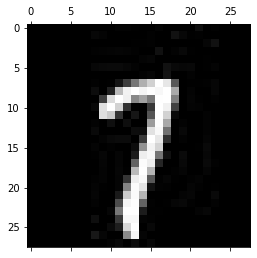

-------------------------------------------
Test: 1280
Predicted: 3


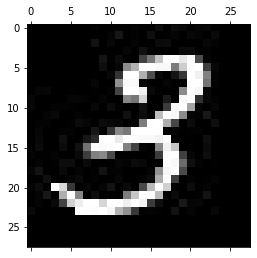

-------------------------------------------
Test: 1281
Predicted: 2


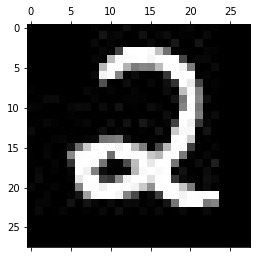

-------------------------------------------
Test: 1282
Predicted: 6


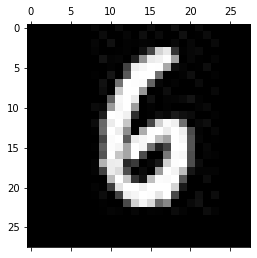

-------------------------------------------
Test: 1283
Predicted: 6


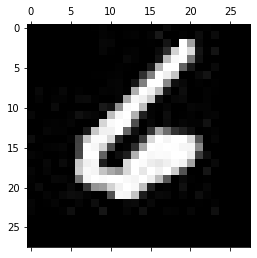

-------------------------------------------
Test: 1284
Predicted: 2


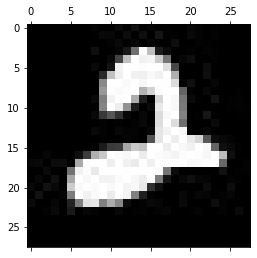

-------------------------------------------
Test: 1285
Predicted: 6


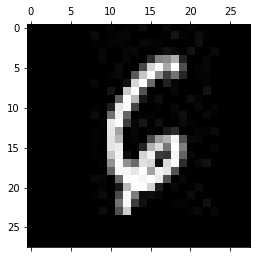

-------------------------------------------
Test: 1286
Predicted: 6


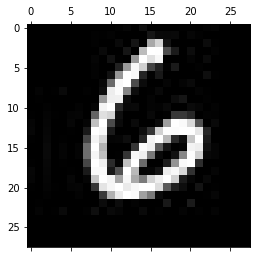

-------------------------------------------
Test: 1287
Predicted: 2


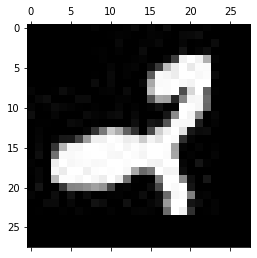

-------------------------------------------
Test: 1288
Predicted: 9


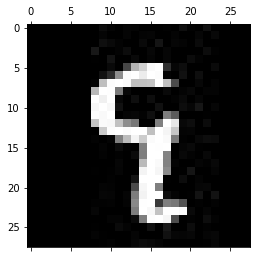

-------------------------------------------
Test: 1289
Predicted: 8


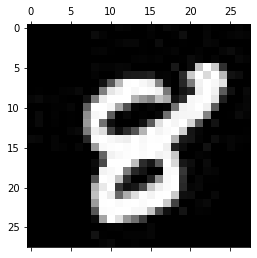

-------------------------------------------
Test: 1290
Predicted: 1


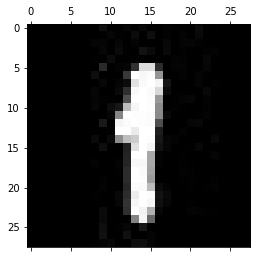

-------------------------------------------
Test: 1291
Predicted: 4


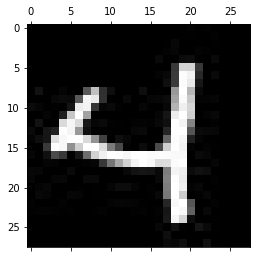

-------------------------------------------
Test: 1292
Predicted: 1


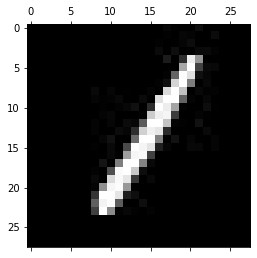

-------------------------------------------
Test: 1293
Predicted: 2


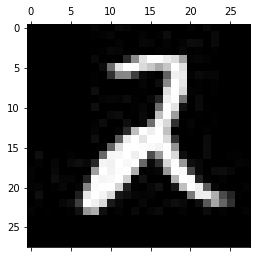

-------------------------------------------
Test: 1294
Predicted: 1


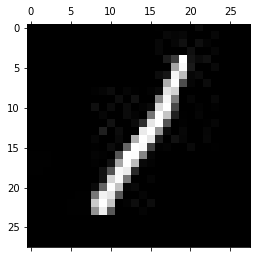

-------------------------------------------
Test: 1295
Predicted: 9


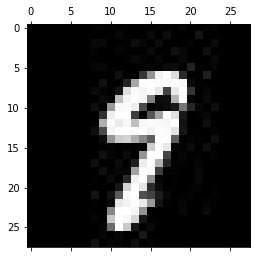

-------------------------------------------
Test: 1296
Predicted: 4


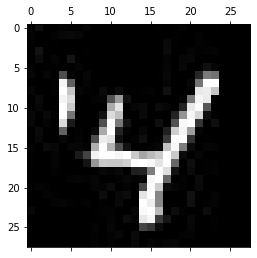

-------------------------------------------
Test: 1297
Predicted: 8


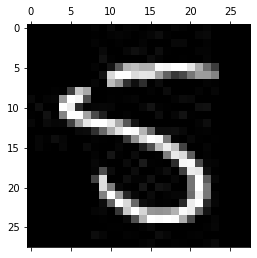

-------------------------------------------
Test: 1298
Predicted: 3


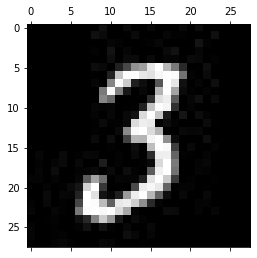

-------------------------------------------
Test: 1299
Predicted: 6


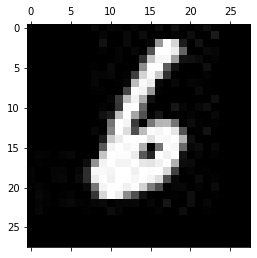

-------------------------------------------
Test: 1300
Predicted: 4


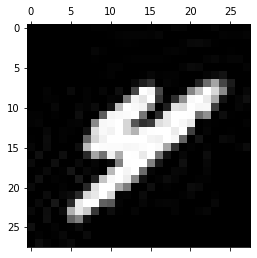

-------------------------------------------
Test: 1301
Predicted: 6


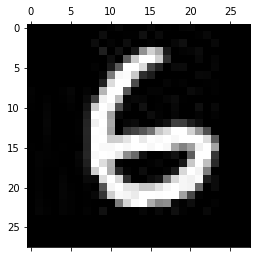

-------------------------------------------
Test: 1302
Predicted: 0


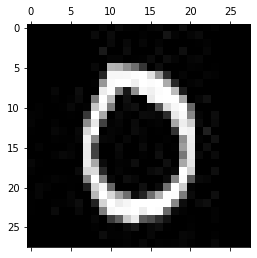

-------------------------------------------
Test: 1303
Predicted: 6


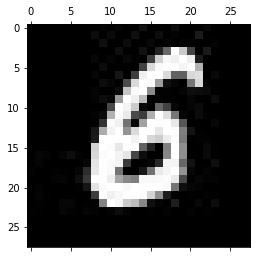

-------------------------------------------
Test: 1304
Predicted: 5


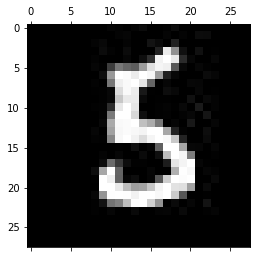

-------------------------------------------
Test: 1305
Predicted: 0


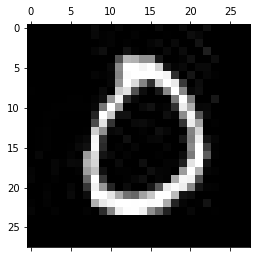

-------------------------------------------
Test: 1306
Predicted: 8


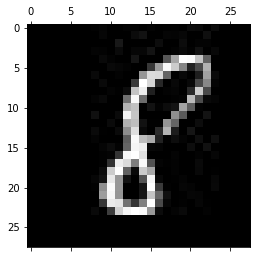

-------------------------------------------
Test: 1307
Predicted: 5


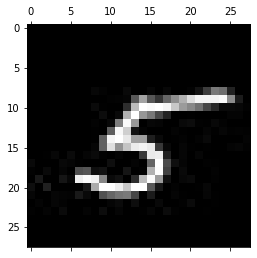

-------------------------------------------
Test: 1308
Predicted: 6


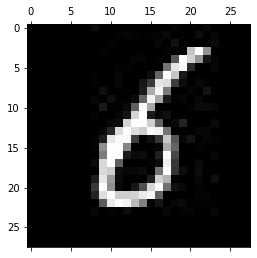

-------------------------------------------
Test: 1309
Predicted: 3


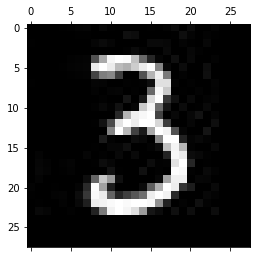

-------------------------------------------
Test: 1310
Predicted: 1


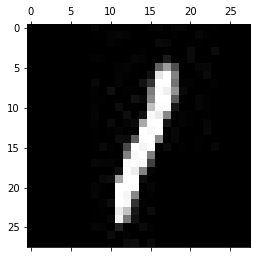

-------------------------------------------
Test: 1311
Predicted: 5


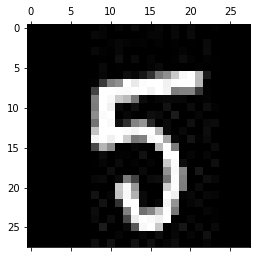

-------------------------------------------
Test: 1312
Predicted: 4


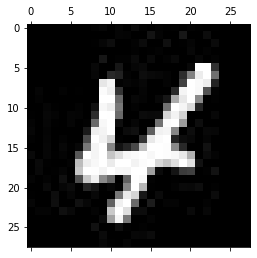

-------------------------------------------
Test: 1313
Predicted: 6


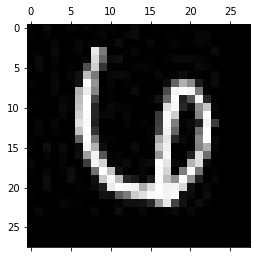

-------------------------------------------
Test: 1314
Predicted: 9


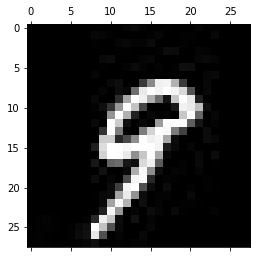

-------------------------------------------
Test: 1315
Predicted: 2


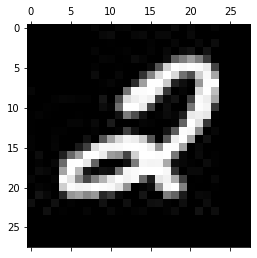

-------------------------------------------
Test: 1316
Predicted: 6


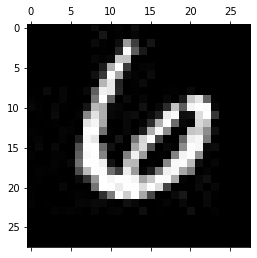

-------------------------------------------
Test: 1317
Predicted: 8


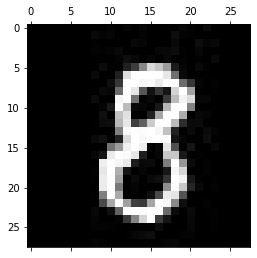

-------------------------------------------
Test: 1318
Predicted: 4


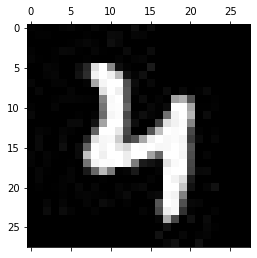

-------------------------------------------
Test: 1319
Predicted: 6


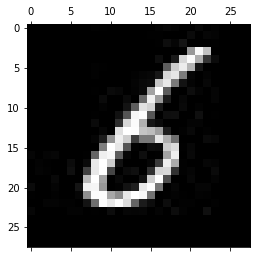

-------------------------------------------
Test: 1320
Predicted: 1


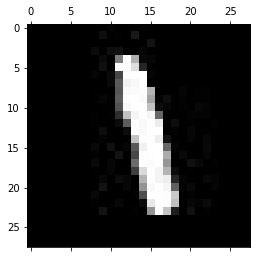

-------------------------------------------
Test: 1321
Predicted: 9


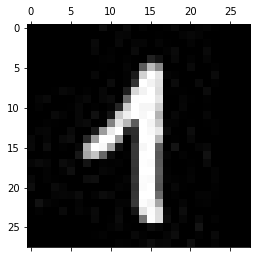

-------------------------------------------
Test: 1322
Predicted: 1


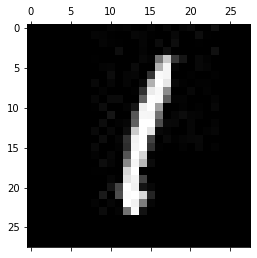

-------------------------------------------
Test: 1323
Predicted: 9


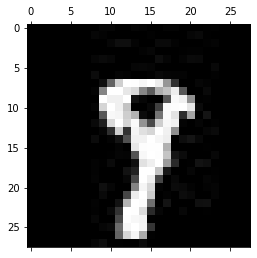

-------------------------------------------
Test: 1324
Predicted: 0


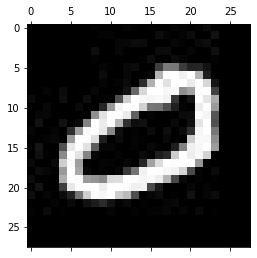

-------------------------------------------
Test: 1325
Predicted: 9


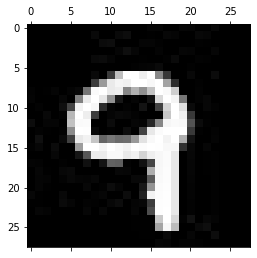

-------------------------------------------
Test: 1326
Predicted: 1


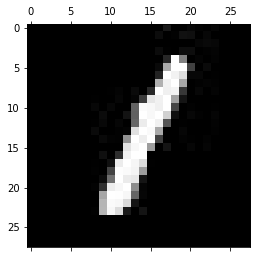

-------------------------------------------
Test: 1327
Predicted: 0


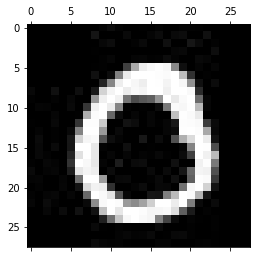

-------------------------------------------
Test: 1328
Predicted: 6


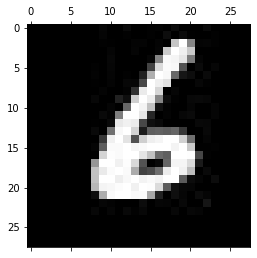

-------------------------------------------
Test: 1329
Predicted: 3


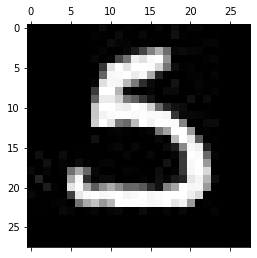

-------------------------------------------
Test: 1330
Predicted: 4


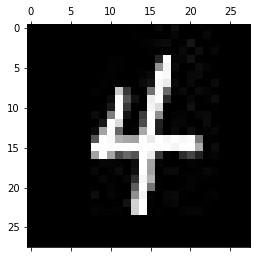

-------------------------------------------
Test: 1331
Predicted: 2


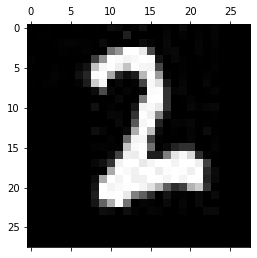

-------------------------------------------
Test: 1332
Predicted: 3


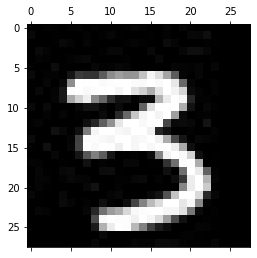

-------------------------------------------
Test: 1333
Predicted: 3


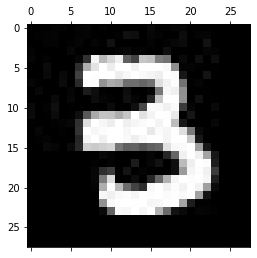

-------------------------------------------
Test: 1334
Predicted: 7


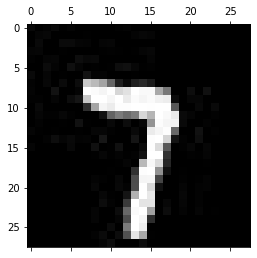

-------------------------------------------
Test: 1335
Predicted: 4


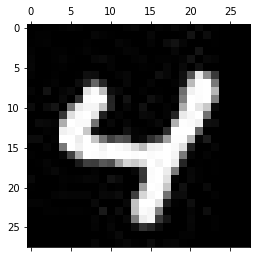

-------------------------------------------
Test: 1336
Predicted: 3


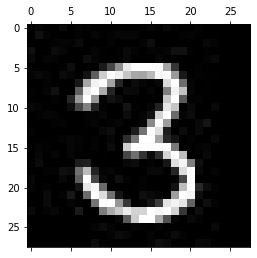

-------------------------------------------
Test: 1337
Predicted: 1


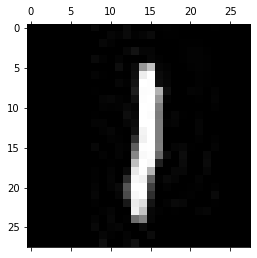

-------------------------------------------
Test: 1338
Predicted: 2


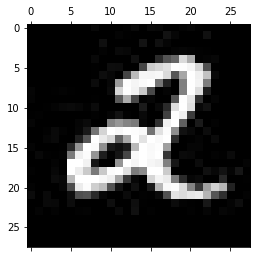

-------------------------------------------
Test: 1339
Predicted: 5


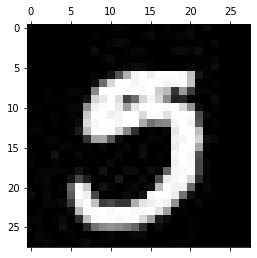

-------------------------------------------
Test: 1340
Predicted: 2


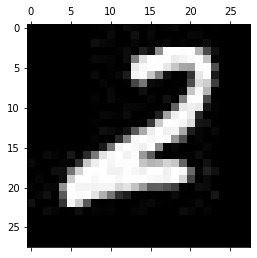

-------------------------------------------
Test: 1341
Predicted: 4


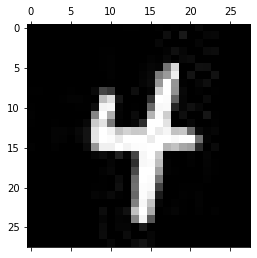

-------------------------------------------
Test: 1342
Predicted: 9


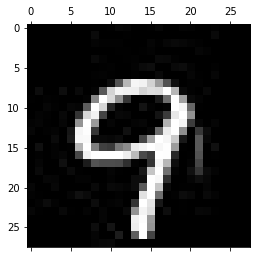

-------------------------------------------
Test: 1343
Predicted: 8


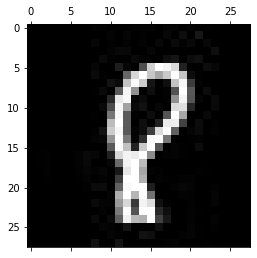

-------------------------------------------
Test: 1344
Predicted: 1


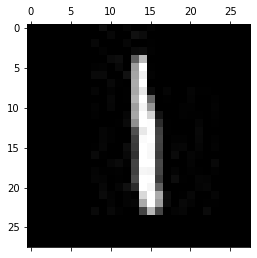

-------------------------------------------
Test: 1345
Predicted: 1


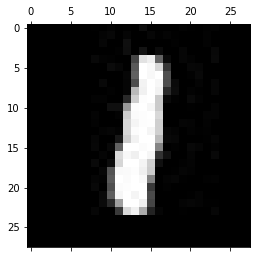

-------------------------------------------
Test: 1346
Predicted: 9


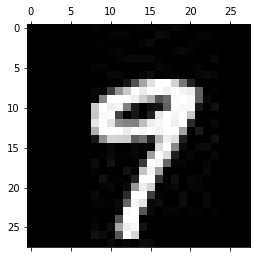

-------------------------------------------
Test: 1347
Predicted: 2


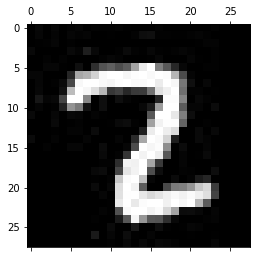

-------------------------------------------
Test: 1348
Predicted: 5


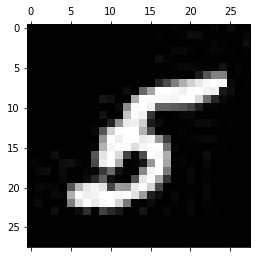

-------------------------------------------
Test: 1349
Predicted: 8


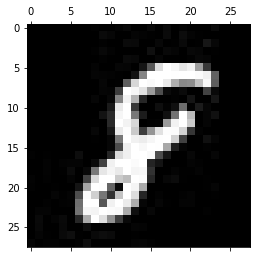

-------------------------------------------
Test: 1350
Predicted: 4


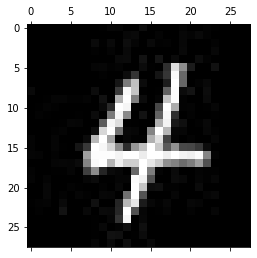

-------------------------------------------
Test: 1351
Predicted: 4


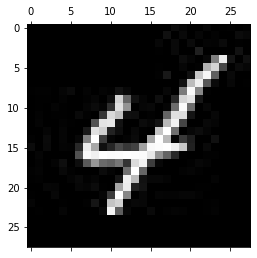

-------------------------------------------
Test: 1352
Predicted: 7


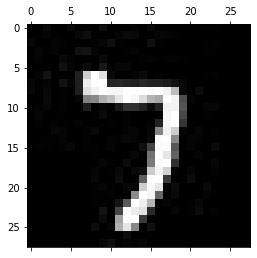

-------------------------------------------
Test: 1353
Predicted: 5


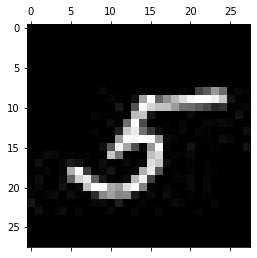

-------------------------------------------
Test: 1354
Predicted: 5


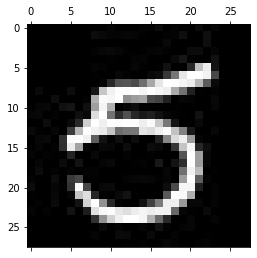

-------------------------------------------
Test: 1355
Predicted: 3


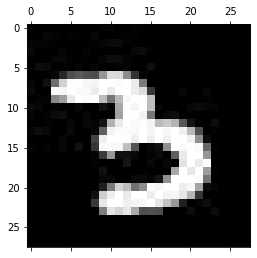

-------------------------------------------
Test: 1356
Predicted: 0


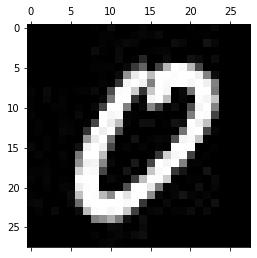

-------------------------------------------
Test: 1357
Predicted: 1


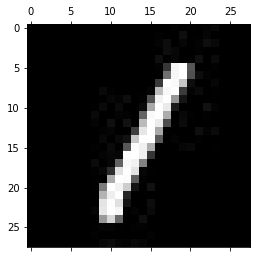

-------------------------------------------
Test: 1358
Predicted: 3


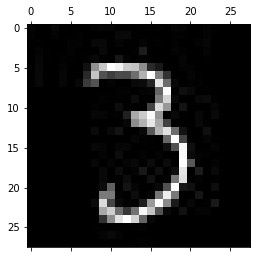

-------------------------------------------
Test: 1359
Predicted: 5


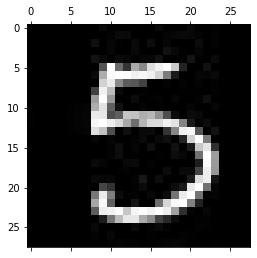

-------------------------------------------
Test: 1360
Predicted: 1


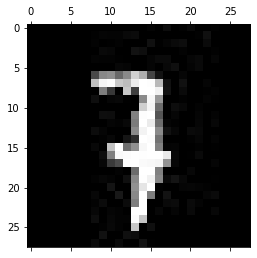

-------------------------------------------
Test: 1361
Predicted: 1


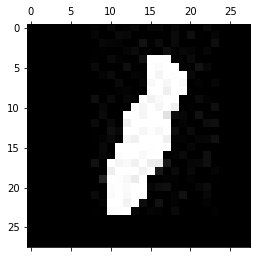

-------------------------------------------
Test: 1362
Predicted: 7


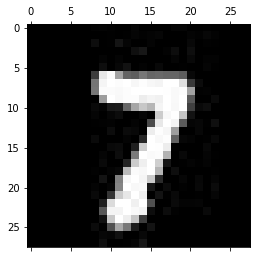

-------------------------------------------
Test: 1363
Predicted: 2


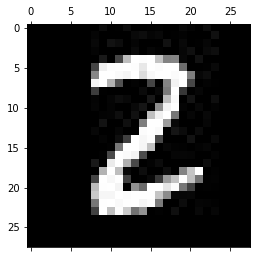

-------------------------------------------
Test: 1364
Predicted: 2


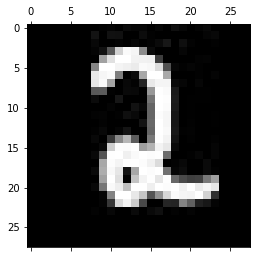

-------------------------------------------
Test: 1365
Predicted: 3


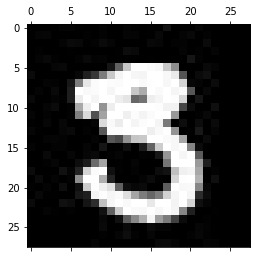

-------------------------------------------
Test: 1366
Predicted: 9


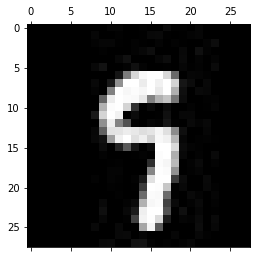

-------------------------------------------
Test: 1367
Predicted: 0


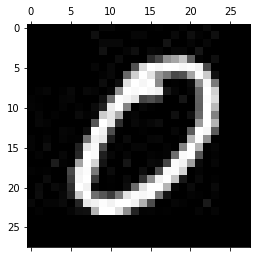

-------------------------------------------
Test: 1368
Predicted: 1


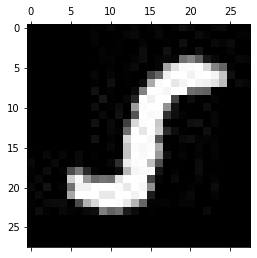

-------------------------------------------
Test: 1369
Predicted: 4


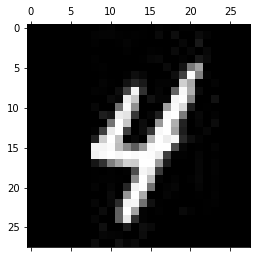

-------------------------------------------
Test: 1370
Predicted: 0


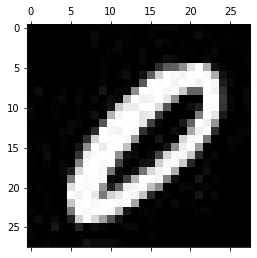

-------------------------------------------
Test: 1371
Predicted: 1


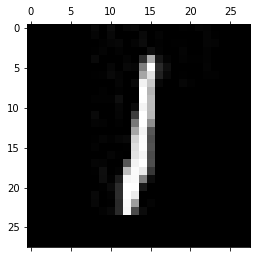

-------------------------------------------
Test: 1372
Predicted: 3


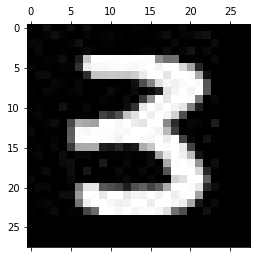

-------------------------------------------
Test: 1373
Predicted: 0


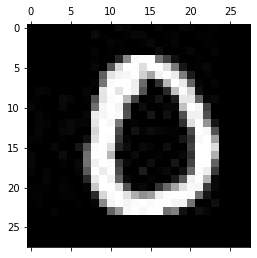

-------------------------------------------
Test: 1374
Predicted: 3


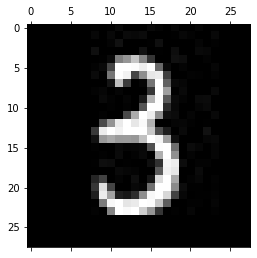

-------------------------------------------
Test: 1375
Predicted: 2


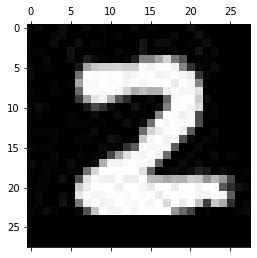

-------------------------------------------
Test: 1376
Predicted: 9


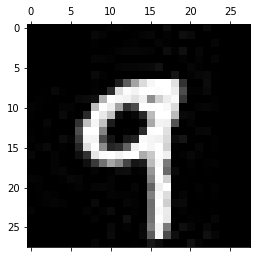

-------------------------------------------
Test: 1377
Predicted: 1


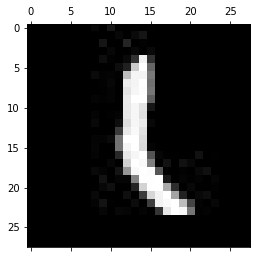

-------------------------------------------
Test: 1378
Predicted: 5


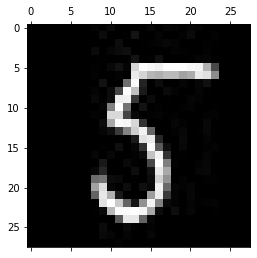

-------------------------------------------
Test: 1379
Predicted: 3


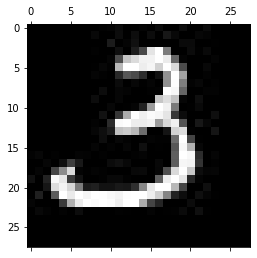

-------------------------------------------
Test: 1380
Predicted: 0


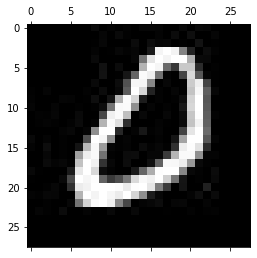

-------------------------------------------
Test: 1381
Predicted: 2


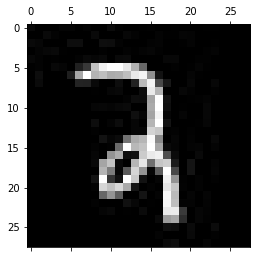

-------------------------------------------
Test: 1382
Predicted: 5


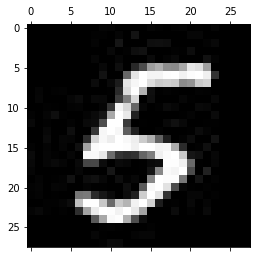

-------------------------------------------
Test: 1383
Predicted: 5


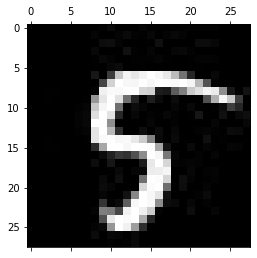

-------------------------------------------
Test: 1384
Predicted: 0


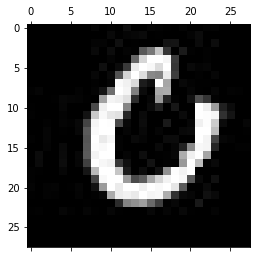

-------------------------------------------
Test: 1385
Predicted: 5


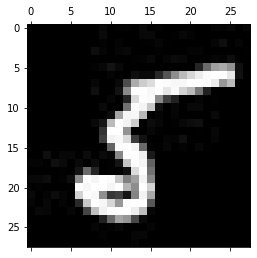

-------------------------------------------
Test: 1386
Predicted: 1


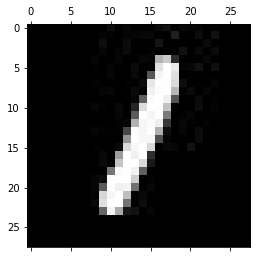

-------------------------------------------
Test: 1387
Predicted: 1


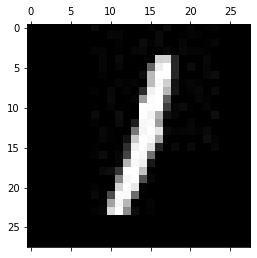

-------------------------------------------
Test: 1388
Predicted: 3


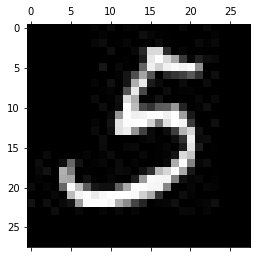

-------------------------------------------
Test: 1389
Predicted: 1


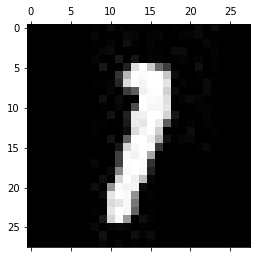

-------------------------------------------
Test: 1390
Predicted: 3


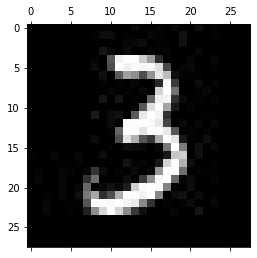

-------------------------------------------
Test: 1391
Predicted: 4


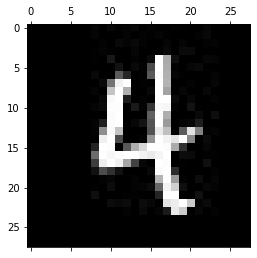

-------------------------------------------
Test: 1392
Predicted: 7


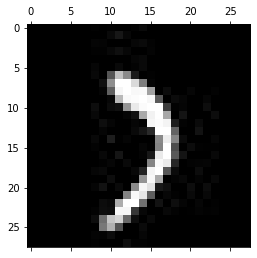

-------------------------------------------
Test: 1393
Predicted: 0


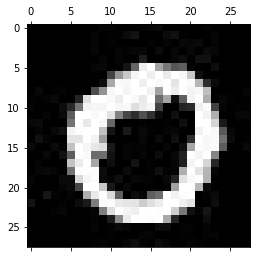

-------------------------------------------
Test: 1394
Predicted: 6


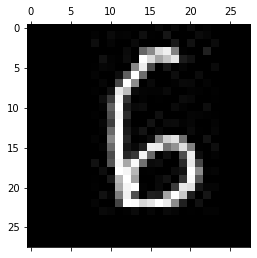

-------------------------------------------
Test: 1395
Predicted: 6


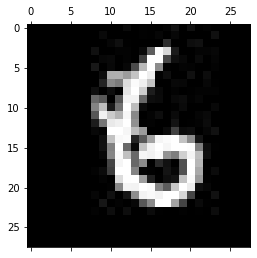

-------------------------------------------
Test: 1396
Predicted: 6


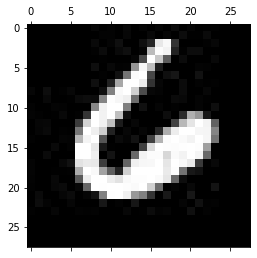

-------------------------------------------
Test: 1397
Predicted: 0


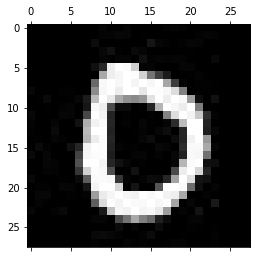

-------------------------------------------
Test: 1398
Predicted: 2


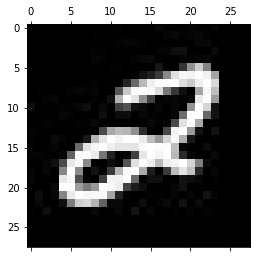

-------------------------------------------
Test: 1399
Predicted: 6


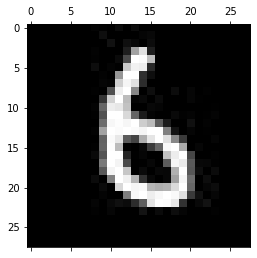

-------------------------------------------
Test: 1400
Predicted: 1


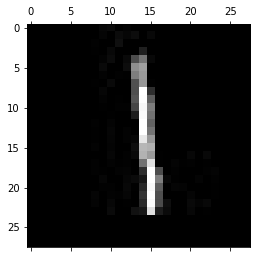

-------------------------------------------
Test: 1401
Predicted: 0


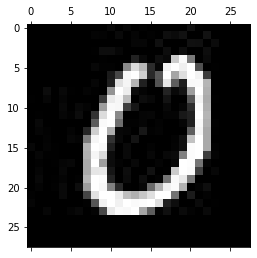

-------------------------------------------
Test: 1402
Predicted: 6


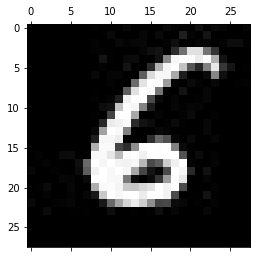

-------------------------------------------
Test: 1403
Predicted: 1


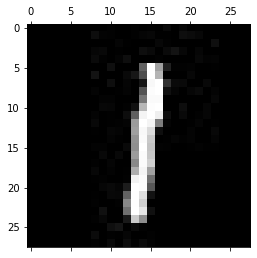

-------------------------------------------
Test: 1404
Predicted: 1


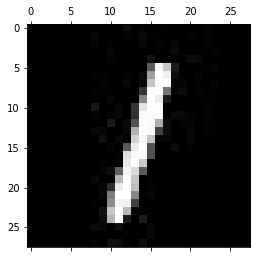

-------------------------------------------
Test: 1405
Predicted: 6


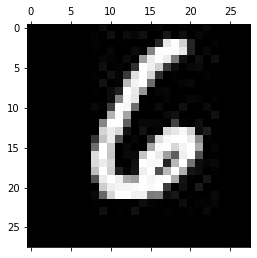

-------------------------------------------
Test: 1406
Predicted: 8


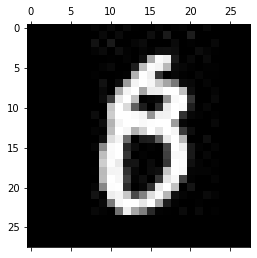

-------------------------------------------
Test: 1407
Predicted: 6


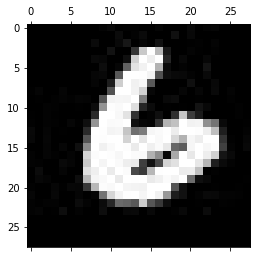

-------------------------------------------
Test: 1408
Predicted: 2


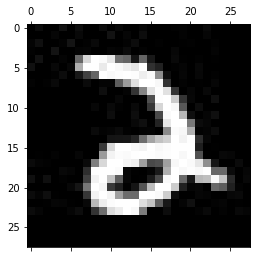

-------------------------------------------
Test: 1409
Predicted: 1


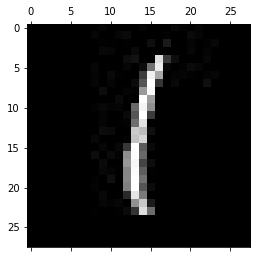

-------------------------------------------
Test: 1410
Predicted: 4


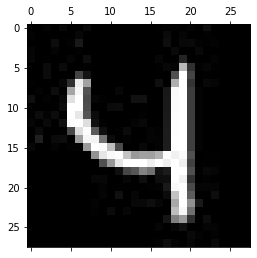

-------------------------------------------
Test: 1411
Predicted: 7


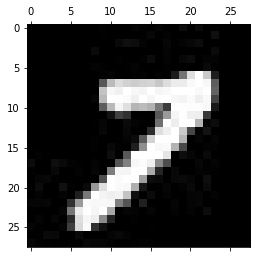

-------------------------------------------
Test: 1412
Predicted: 6


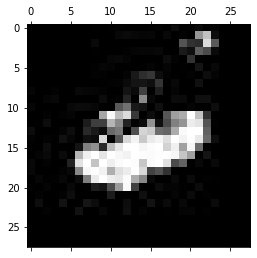

-------------------------------------------
Test: 1413
Predicted: 5


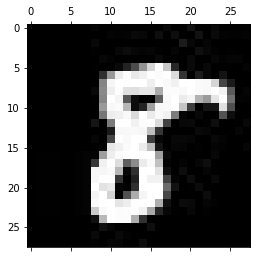

-------------------------------------------
Test: 1414
Predicted: 7


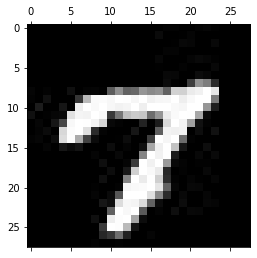

-------------------------------------------
Test: 1415
Predicted: 3


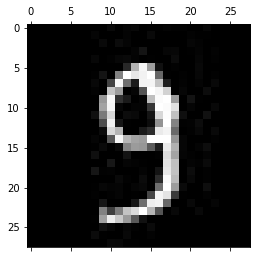

-------------------------------------------
Test: 1416
Predicted: 1


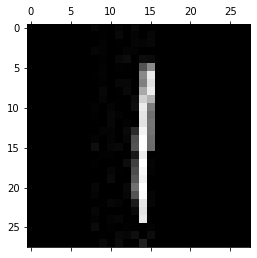

-------------------------------------------
Test: 1417
Predicted: 3


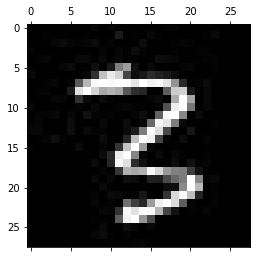

-------------------------------------------
Test: 1418
Predicted: 3


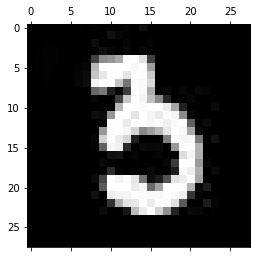

-------------------------------------------
Test: 1419
Predicted: 8


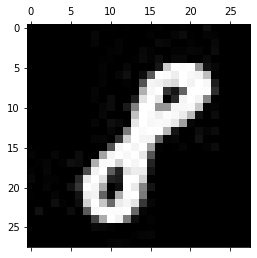

-------------------------------------------
Test: 1420
Predicted: 8


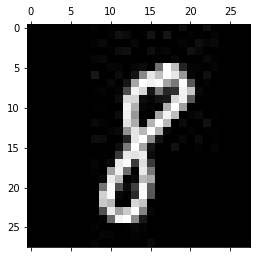

-------------------------------------------
Test: 1421
Predicted: 3


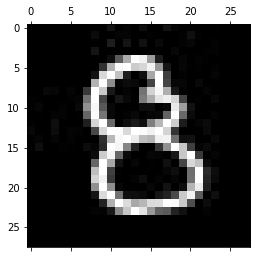

-------------------------------------------
Test: 1422
Predicted: 8


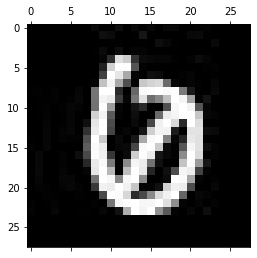

-------------------------------------------
Test: 1423
Predicted: 3


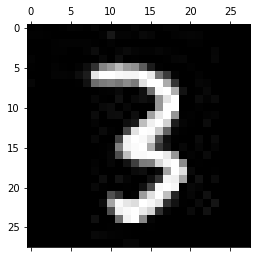

-------------------------------------------
Test: 1424
Predicted: 7


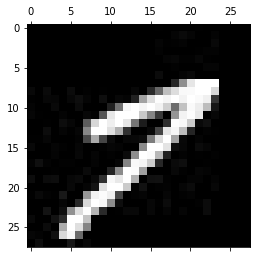

-------------------------------------------
Test: 1425
Predicted: 0


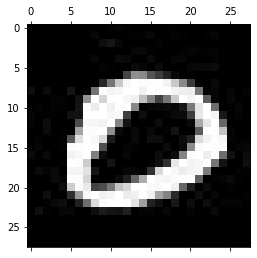

-------------------------------------------
Test: 1426
Predicted: 0


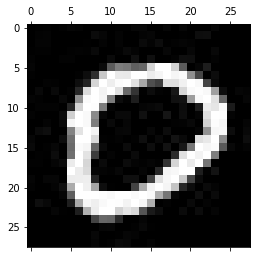

-------------------------------------------
Test: 1427
Predicted: 1


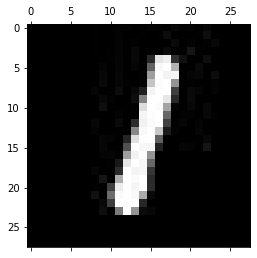

-------------------------------------------
Test: 1428
Predicted: 9


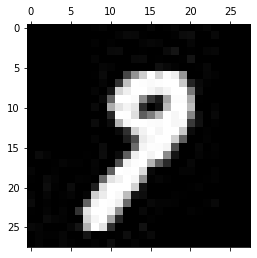

-------------------------------------------
Test: 1429
Predicted: 8


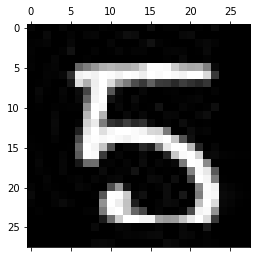

-------------------------------------------
Test: 1430
Predicted: 7


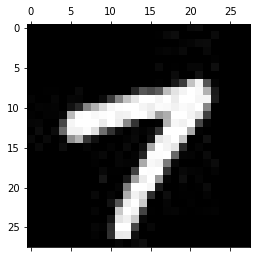

-------------------------------------------
Test: 1431
Predicted: 2


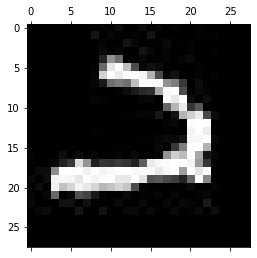

-------------------------------------------
Test: 1432
Predicted: 5


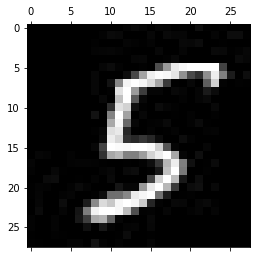

-------------------------------------------
Test: 1433
Predicted: 6


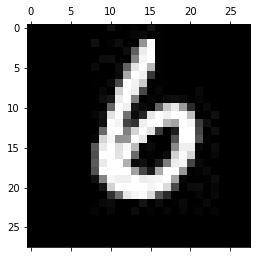

-------------------------------------------
Test: 1434
Predicted: 6


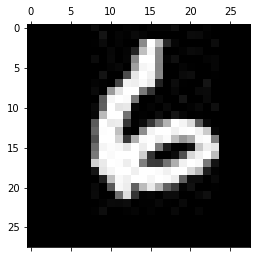

-------------------------------------------
Test: 1435
Predicted: 0


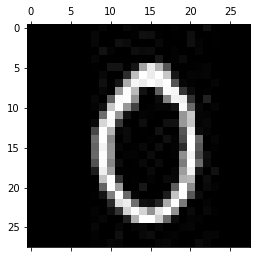

-------------------------------------------
Test: 1436
Predicted: 2


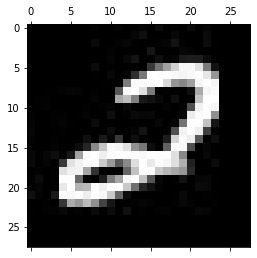

-------------------------------------------
Test: 1437
Predicted: 9


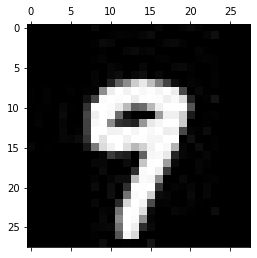

-------------------------------------------
Test: 1438
Predicted: 1


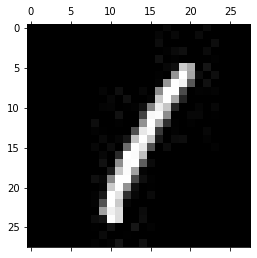

-------------------------------------------
Test: 1439
Predicted: 4


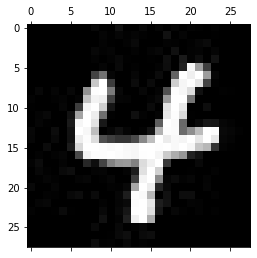

-------------------------------------------
Test: 1440
Predicted: 6


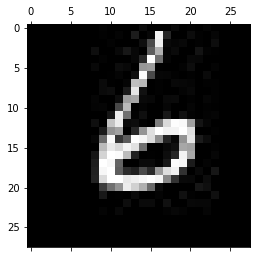

-------------------------------------------
Test: 1441
Predicted: 1


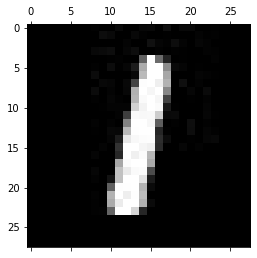

-------------------------------------------
Test: 1442
Predicted: 4


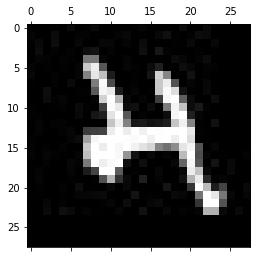

-------------------------------------------
Test: 1443
Predicted: 9


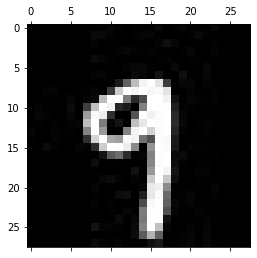

-------------------------------------------
Test: 1444
Predicted: 9


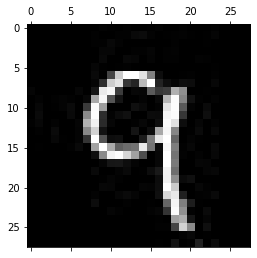

-------------------------------------------
Test: 1445
Predicted: 5


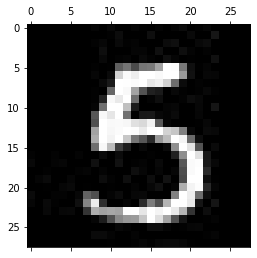

-------------------------------------------
Test: 1446
Predicted: 9


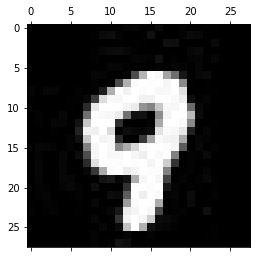

-------------------------------------------
Test: 1447
Predicted: 8


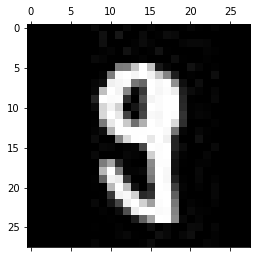

-------------------------------------------
Test: 1448
Predicted: 9


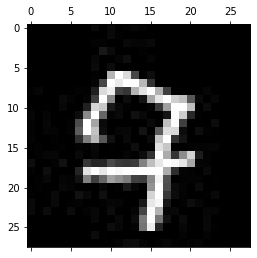

-------------------------------------------
Test: 1449
Predicted: 9


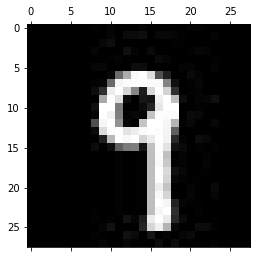

-------------------------------------------
Test: 1450
Predicted: 0


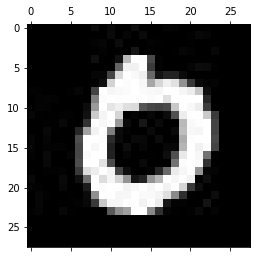

-------------------------------------------
Test: 1451
Predicted: 1


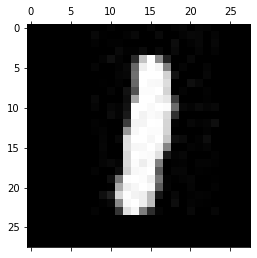

-------------------------------------------
Test: 1452
Predicted: 7


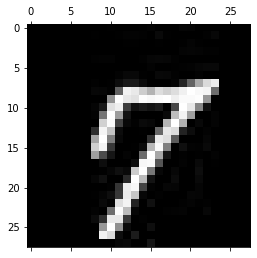

-------------------------------------------
Test: 1453
Predicted: 5


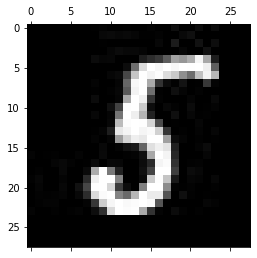

-------------------------------------------
Test: 1454
Predicted: 2


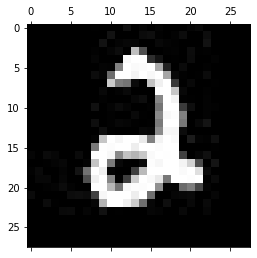

-------------------------------------------
Test: 1455
Predicted: 5


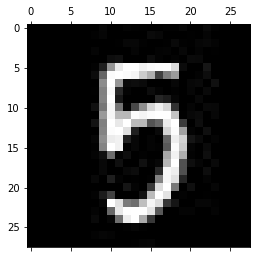

-------------------------------------------
Test: 1456
Predicted: 8


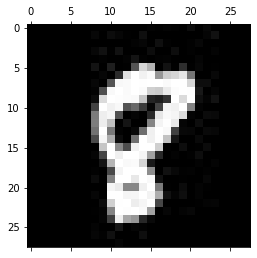

-------------------------------------------
Test: 1457
Predicted: 1


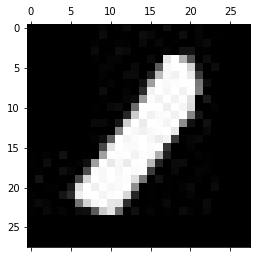

-------------------------------------------
Test: 1458
Predicted: 4


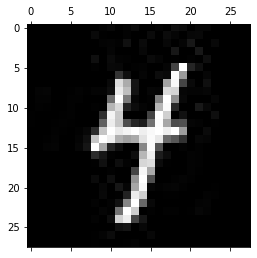

-------------------------------------------
Test: 1459
Predicted: 9


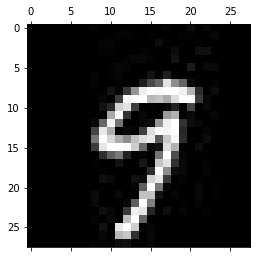

-------------------------------------------
Test: 1460
Predicted: 1


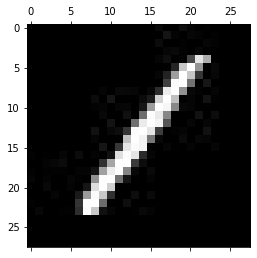

-------------------------------------------
Test: 1461
Predicted: 9


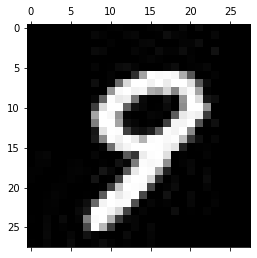

-------------------------------------------
Test: 1462
Predicted: 9


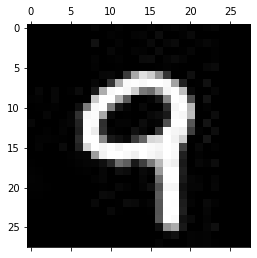

-------------------------------------------
Test: 1463
Predicted: 0


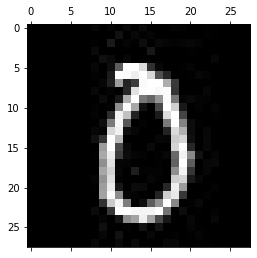

-------------------------------------------
Test: 1464
Predicted: 0


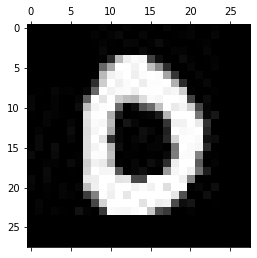

-------------------------------------------
Test: 1465
Predicted: 9


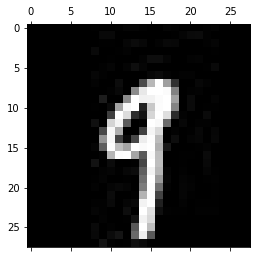

-------------------------------------------
Test: 1466
Predicted: 7


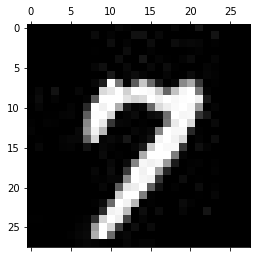

-------------------------------------------
Test: 1467
Predicted: 1


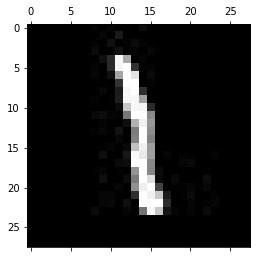

-------------------------------------------
Test: 1468
Predicted: 0


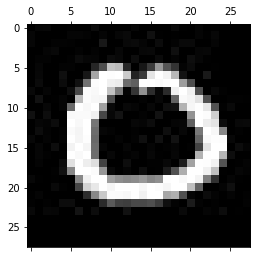

-------------------------------------------
Test: 1469
Predicted: 7


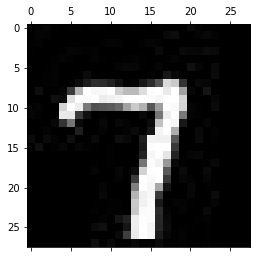

-------------------------------------------
Test: 1470
Predicted: 6


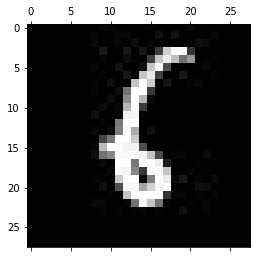

-------------------------------------------
Test: 1471
Predicted: 7


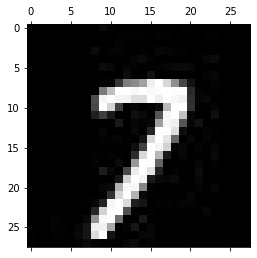

-------------------------------------------
Test: 1472
Predicted: 9


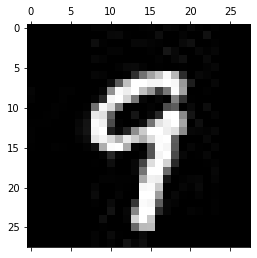

-------------------------------------------
Test: 1473
Predicted: 0


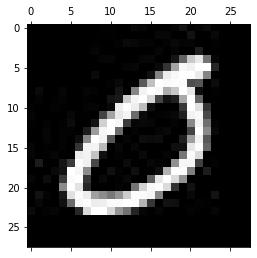

-------------------------------------------
Test: 1474
Predicted: 6


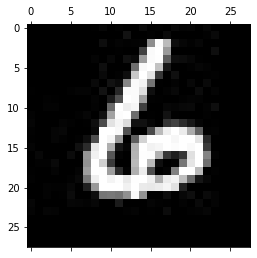

-------------------------------------------
Test: 1475
Predicted: 5


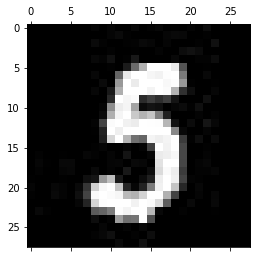

-------------------------------------------
Test: 1476
Predicted: 2


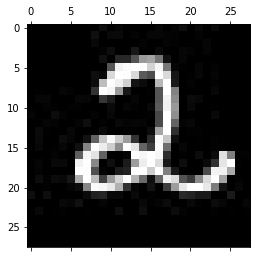

-------------------------------------------
Test: 1477
Predicted: 1


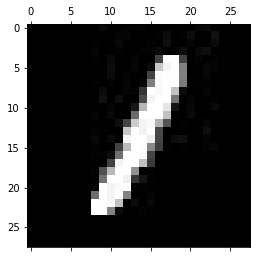

-------------------------------------------
Test: 1478
Predicted: 9


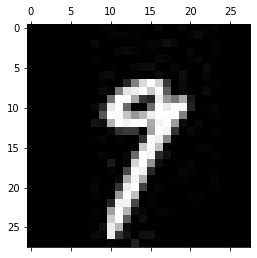

-------------------------------------------
Test: 1479
Predicted: 7


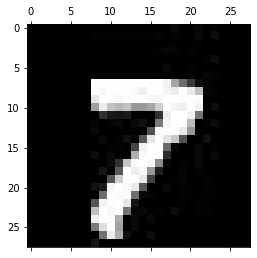

-------------------------------------------
Test: 1480
Predicted: 2


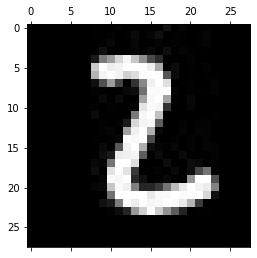

-------------------------------------------
Test: 1481
Predicted: 6


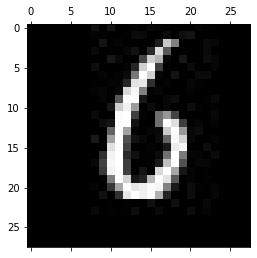

-------------------------------------------
Test: 1482
Predicted: 7


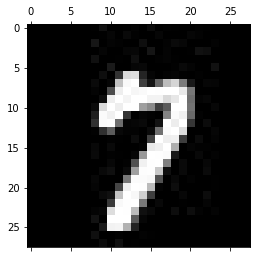

-------------------------------------------
Test: 1483
Predicted: 0


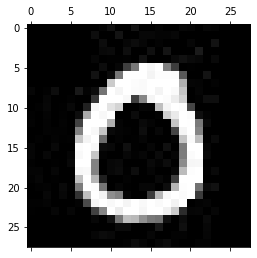

-------------------------------------------
Test: 1484
Predicted: 0


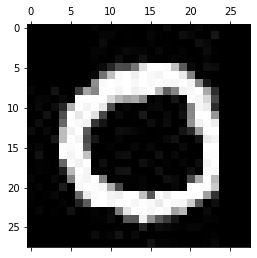

-------------------------------------------
Test: 1485
Predicted: 5


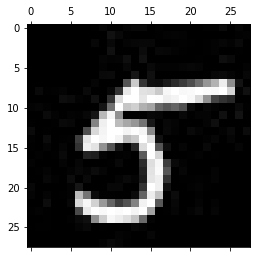

-------------------------------------------
Test: 1486
Predicted: 4


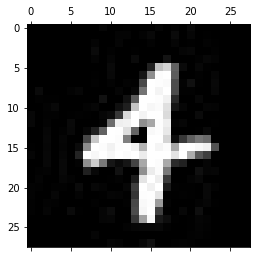

-------------------------------------------
Test: 1487
Predicted: 3


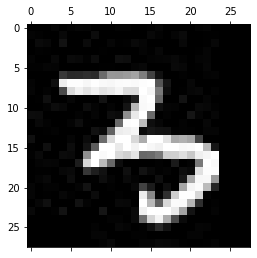

-------------------------------------------
Test: 1488
Predicted: 1


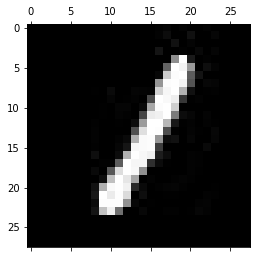

-------------------------------------------
Test: 1489
Predicted: 2


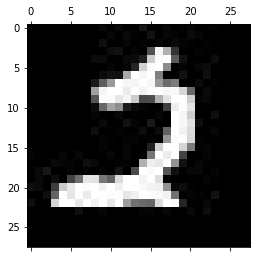

-------------------------------------------
Test: 1490
Predicted: 0


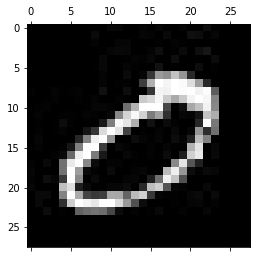

-------------------------------------------
Test: 1491
Predicted: 5


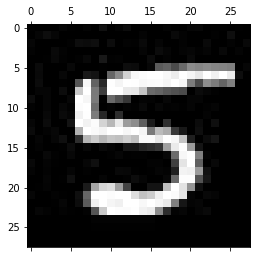

-------------------------------------------
Test: 1492
Predicted: 5


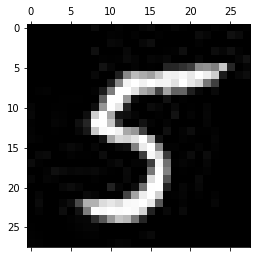

-------------------------------------------
Test: 1493
Predicted: 6


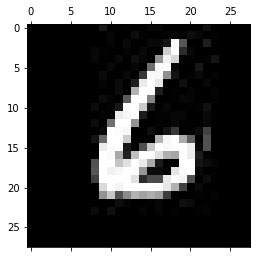

-------------------------------------------
Test: 1494
Predicted: 4


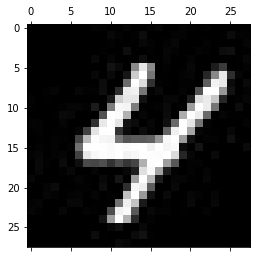

-------------------------------------------
Test: 1495
Predicted: 3


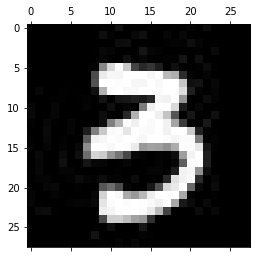

-------------------------------------------
Test: 1496
Predicted: 7


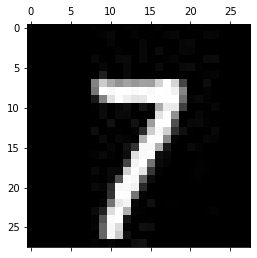

-------------------------------------------
Test: 1497
Predicted: 1


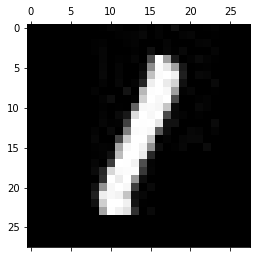

-------------------------------------------
Test: 1498
Predicted: 5


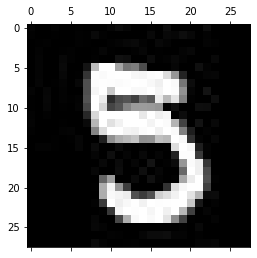

-------------------------------------------
Test: 1499
Predicted: 3


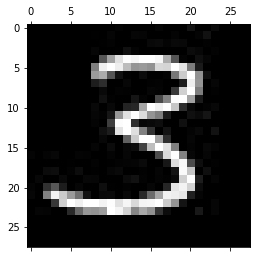

-------------------------------------------
Test: 1500
Predicted: 3


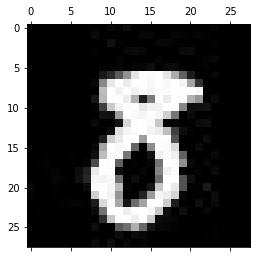

-------------------------------------------
Test: 1501
Predicted: 7


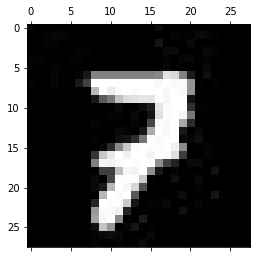

-------------------------------------------
Test: 1502
Predicted: 4


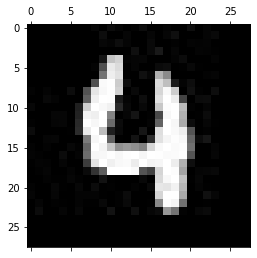

-------------------------------------------
Test: 1503
Predicted: 2


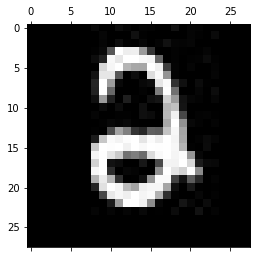

-------------------------------------------
Test: 1504
Predicted: 0


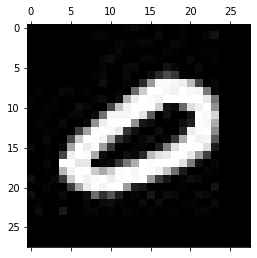

-------------------------------------------
Test: 1505
Predicted: 0


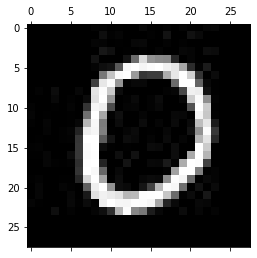

-------------------------------------------
Test: 1506
Predicted: 3


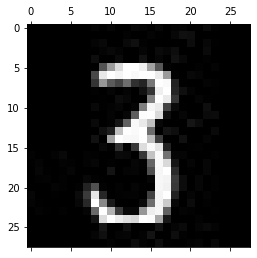

-------------------------------------------
Test: 1507
Predicted: 9


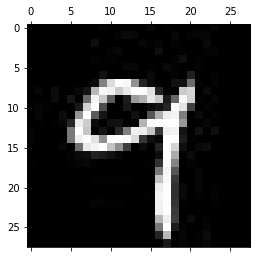

-------------------------------------------
Test: 1508
Predicted: 4


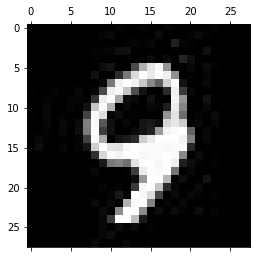

-------------------------------------------
Test: 1509
Predicted: 6


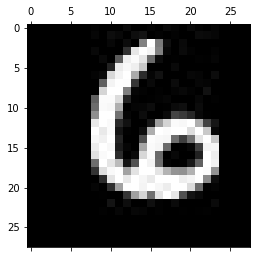

-------------------------------------------
Test: 1510
Predicted: 7


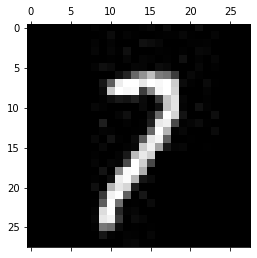

-------------------------------------------
Test: 1511
Predicted: 2


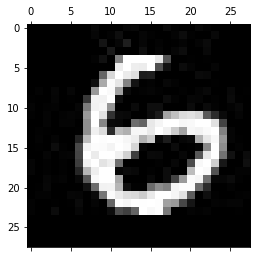

-------------------------------------------
Test: 1512
Predicted: 9


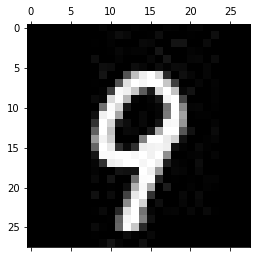

-------------------------------------------
Test: 1513
Predicted: 9


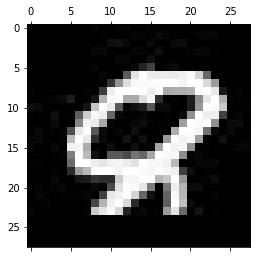

-------------------------------------------
Test: 1514
Predicted: 4


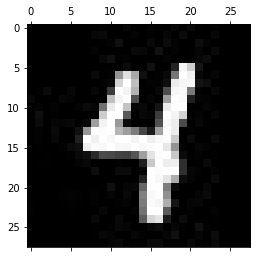

-------------------------------------------
Test: 1515
Predicted: 3


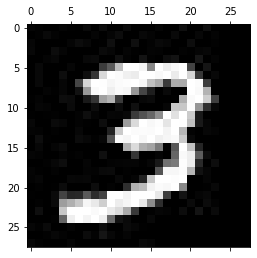

-------------------------------------------
Test: 1516
Predicted: 6


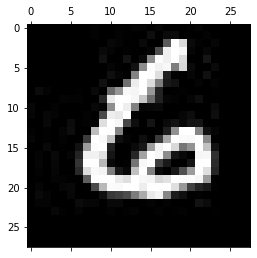

-------------------------------------------
Test: 1517
Predicted: 1


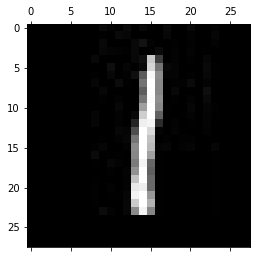

-------------------------------------------
Test: 1518
Predicted: 9


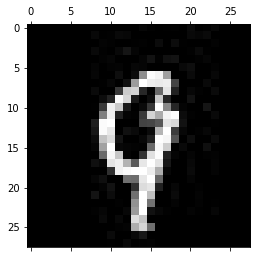

-------------------------------------------
Test: 1519
Predicted: 8


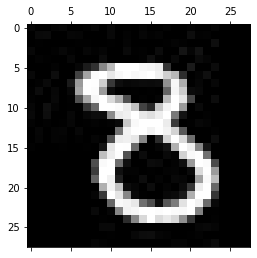

-------------------------------------------
Test: 1520
Predicted: 1


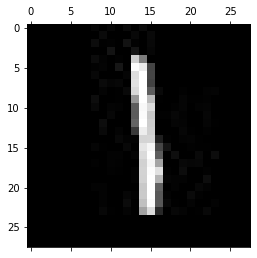

-------------------------------------------
Test: 1521
Predicted: 5


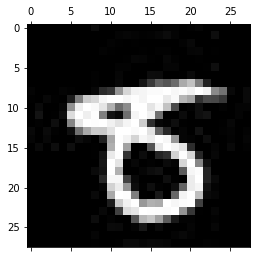

-------------------------------------------
Test: 1522
Predicted: 0


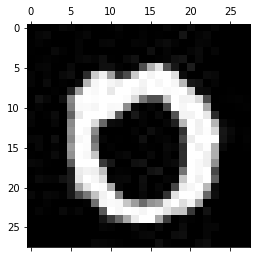

-------------------------------------------
Test: 1523
Predicted: 7


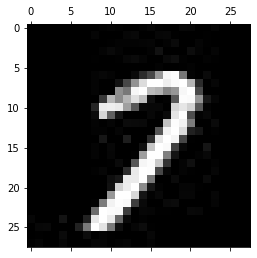

-------------------------------------------
Test: 1524
Predicted: 8


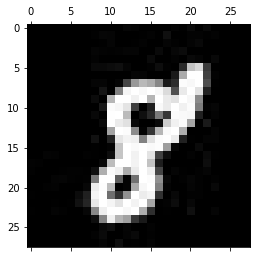

-------------------------------------------
Test: 1525
Predicted: 5


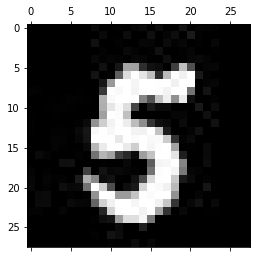

-------------------------------------------
Test: 1526
Predicted: 7


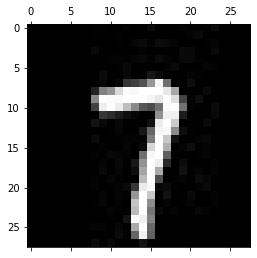

-------------------------------------------
Test: 1527
Predicted: 5


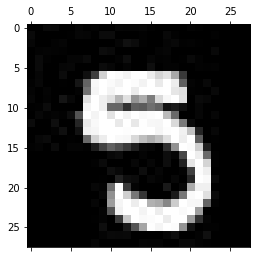

-------------------------------------------
Test: 1528
Predicted: 7


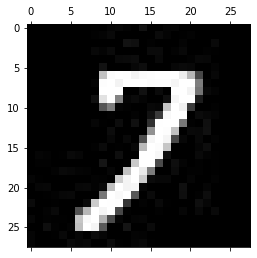

-------------------------------------------
Test: 1529
Predicted: 2


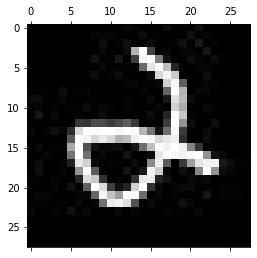

-------------------------------------------
Test: 1530
Predicted: 2


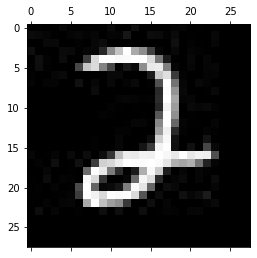

-------------------------------------------
Test: 1531
Predicted: 5


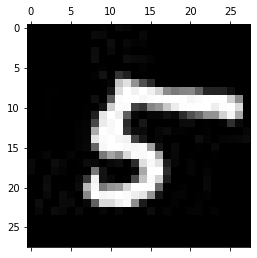

-------------------------------------------
Test: 1532
Predicted: 7


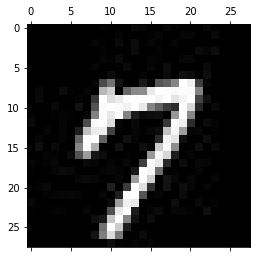

-------------------------------------------
Test: 1533
Predicted: 0


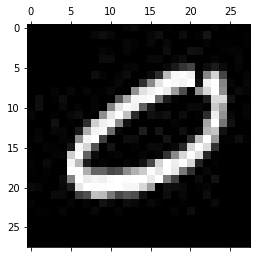

-------------------------------------------
Test: 1534
Predicted: 4


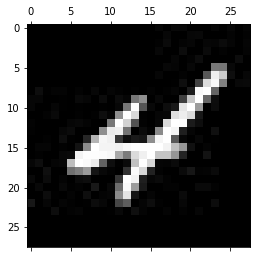

-------------------------------------------
Test: 1535
Predicted: 0


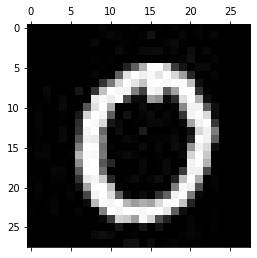

-------------------------------------------
Test: 1536
Predicted: 1


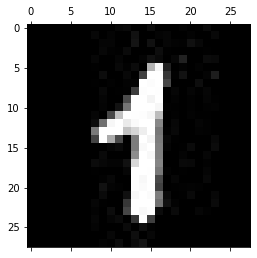

-------------------------------------------
Test: 1537
Predicted: 3


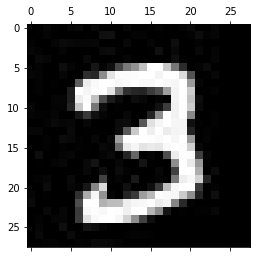

-------------------------------------------
Test: 1538
Predicted: 9


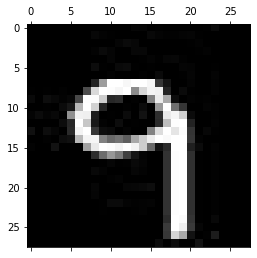

-------------------------------------------
Test: 1539
Predicted: 0


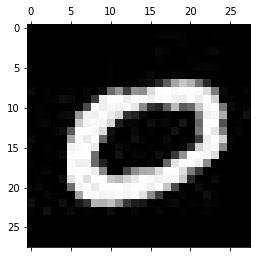

-------------------------------------------
Test: 1540
Predicted: 8


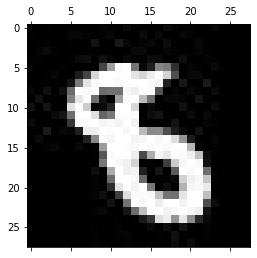

-------------------------------------------
Test: 1541
Predicted: 1


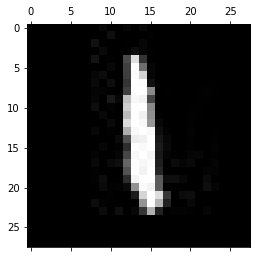

-------------------------------------------
Test: 1542
Predicted: 1


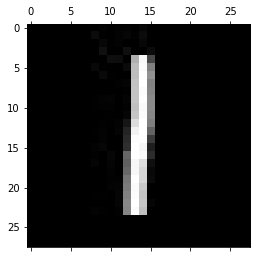

-------------------------------------------
Test: 1543
Predicted: 7


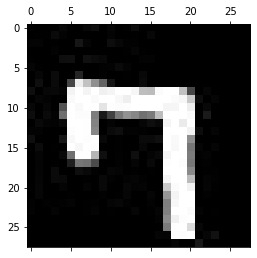

-------------------------------------------
Test: 1544
Predicted: 4


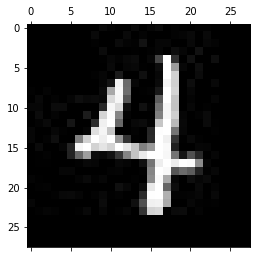

-------------------------------------------
Test: 1545
Predicted: 9


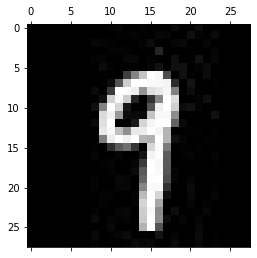

-------------------------------------------
Test: 1546
Predicted: 5


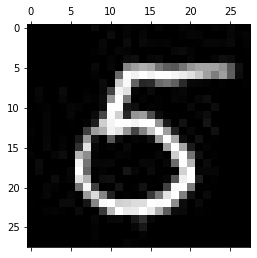

-------------------------------------------
Test: 1547
Predicted: 2


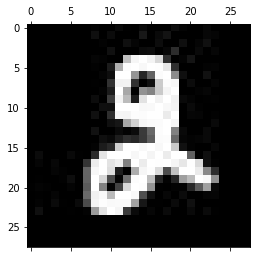

-------------------------------------------
Test: 1548
Predicted: 9


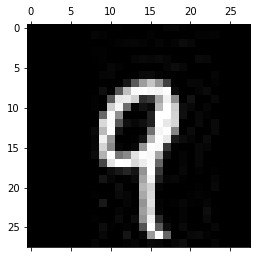

-------------------------------------------
Test: 1549
Predicted: 5


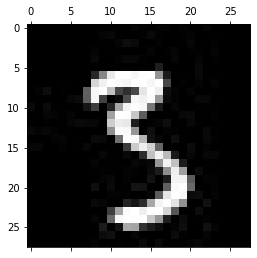

-------------------------------------------
Test: 1550
Predicted: 2


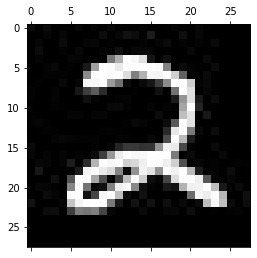

-------------------------------------------
Test: 1551
Predicted: 8


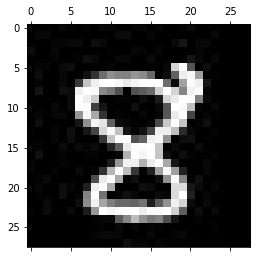

-------------------------------------------
Test: 1552
Predicted: 0


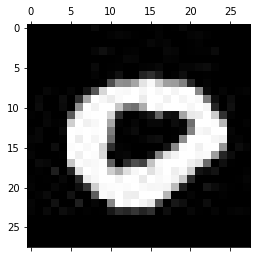

-------------------------------------------
Test: 1553
Predicted: 4


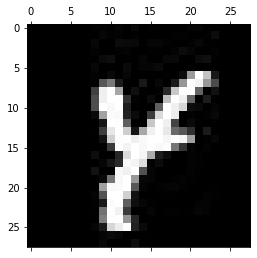

-------------------------------------------
Test: 1554
Predicted: 4


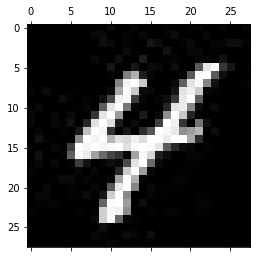

-------------------------------------------
Test: 1555
Predicted: 5


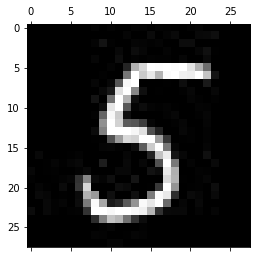

-------------------------------------------
Test: 1556
Predicted: 0


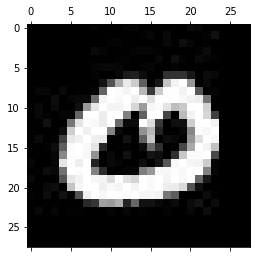

-------------------------------------------
Test: 1557
Predicted: 9


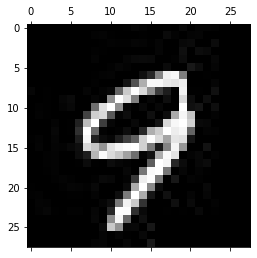

-------------------------------------------
Test: 1558
Predicted: 9


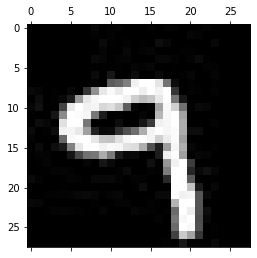

-------------------------------------------
Test: 1559
Predicted: 8


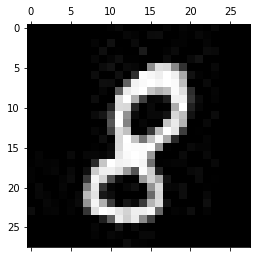

-------------------------------------------
Test: 1560
Predicted: 5


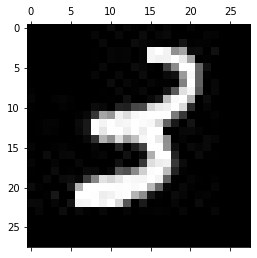

-------------------------------------------
Test: 1561
Predicted: 7


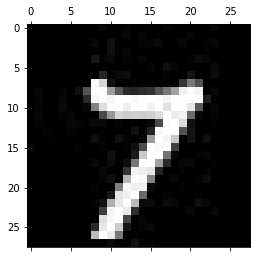

-------------------------------------------
Test: 1562
Predicted: 7


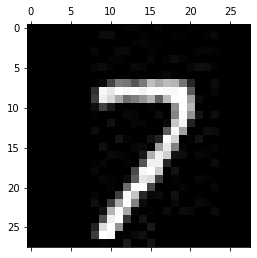

-------------------------------------------
Test: 1563
Predicted: 4


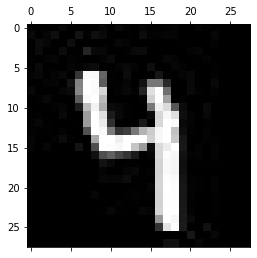

-------------------------------------------
Test: 1564
Predicted: 7


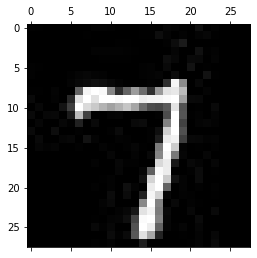

-------------------------------------------
Test: 1565
Predicted: 8


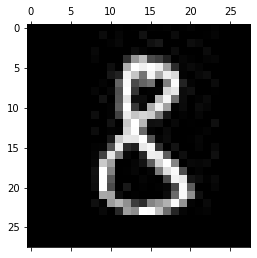

-------------------------------------------
Test: 1566
Predicted: 6


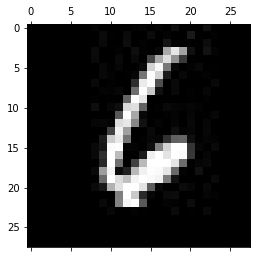

-------------------------------------------
Test: 1567
Predicted: 6


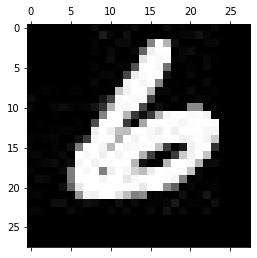

-------------------------------------------
Test: 1568
Predicted: 8


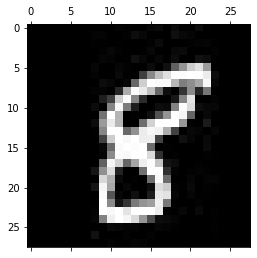

-------------------------------------------
Test: 1569
Predicted: 2


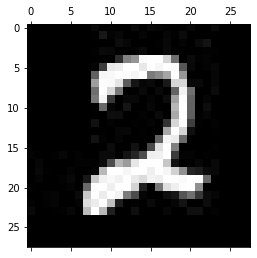

-------------------------------------------
Test: 1570
Predicted: 7


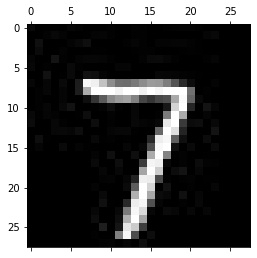

-------------------------------------------
Test: 1571
Predicted: 4


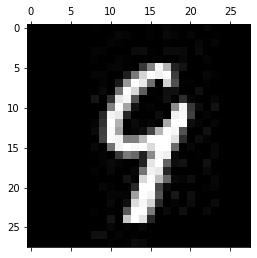

-------------------------------------------
Test: 1572
Predicted: 1


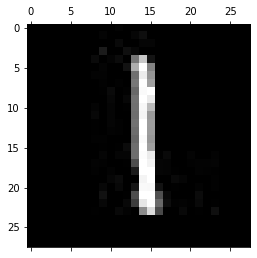

-------------------------------------------
Test: 1573
Predicted: 2


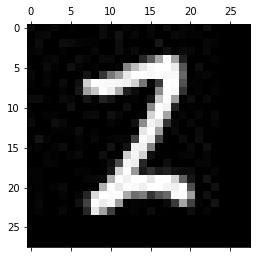

-------------------------------------------
Test: 1574
Predicted: 8


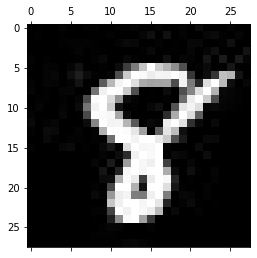

-------------------------------------------
Test: 1575
Predicted: 5


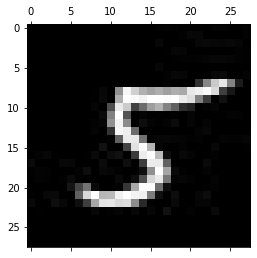

-------------------------------------------
Test: 1576
Predicted: 5


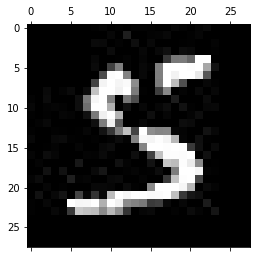

-------------------------------------------
Test: 1577
Predicted: 7


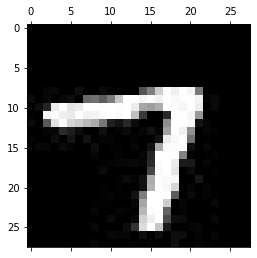

-------------------------------------------
Test: 1578
Predicted: 2


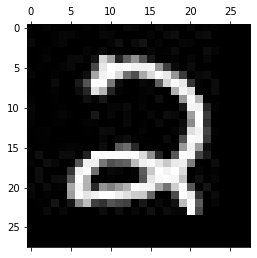

-------------------------------------------
Test: 1579
Predicted: 1


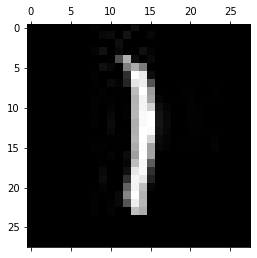

-------------------------------------------
Test: 1580
Predicted: 9


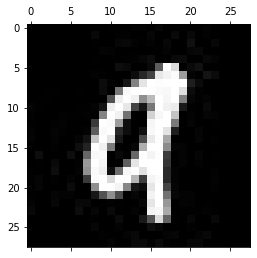

-------------------------------------------
Test: 1581
Predicted: 9


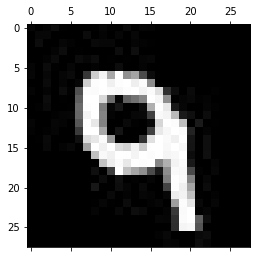

-------------------------------------------
Test: 1582
Predicted: 3


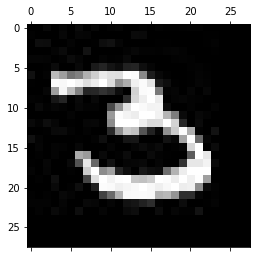

-------------------------------------------
Test: 1583
Predicted: 0


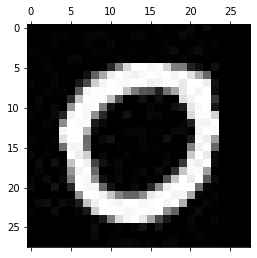

-------------------------------------------
Test: 1584
Predicted: 3


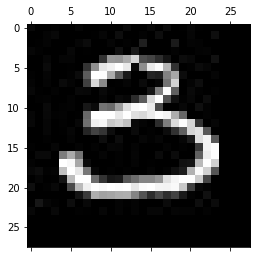

-------------------------------------------
Test: 1585
Predicted: 3


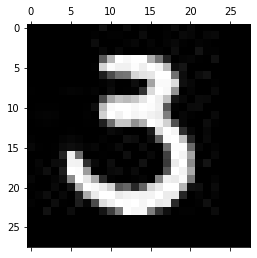

-------------------------------------------
Test: 1586
Predicted: 6


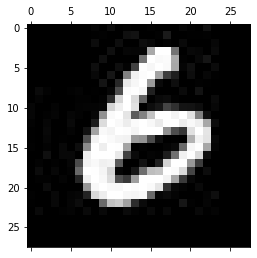

-------------------------------------------
Test: 1587
Predicted: 7


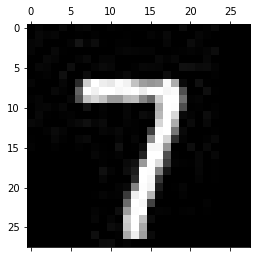

-------------------------------------------
Test: 1588
Predicted: 9


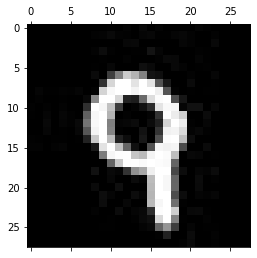

-------------------------------------------
Test: 1589
Predicted: 8


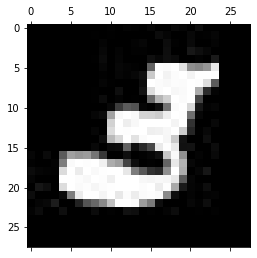

-------------------------------------------
Test: 1590
Predicted: 7


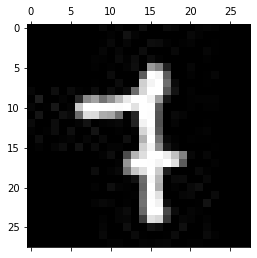

-------------------------------------------
Test: 1591
Predicted: 8


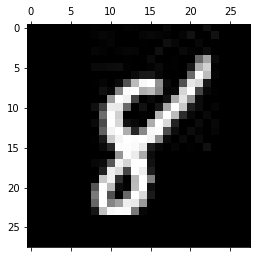

-------------------------------------------
Test: 1592
Predicted: 0


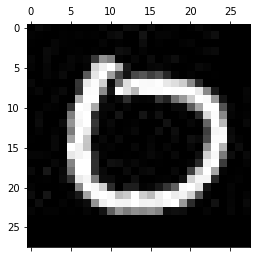

-------------------------------------------
Test: 1593
Predicted: 1


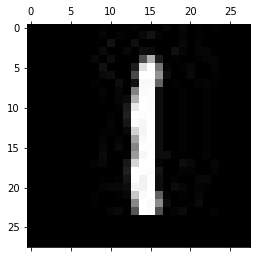

-------------------------------------------
Test: 1594
Predicted: 1


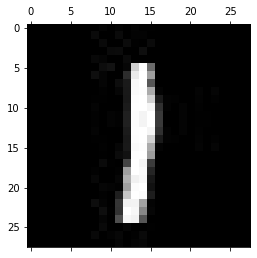

-------------------------------------------
Test: 1595
Predicted: 5


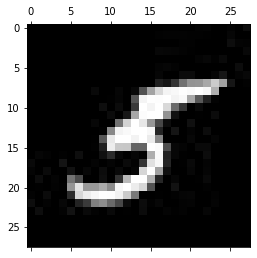

-------------------------------------------
Test: 1596
Predicted: 2


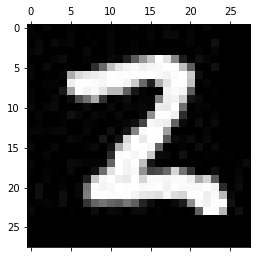

-------------------------------------------
Test: 1597
Predicted: 6


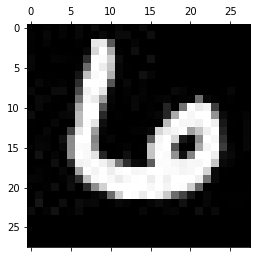

-------------------------------------------
Test: 1598
Predicted: 2


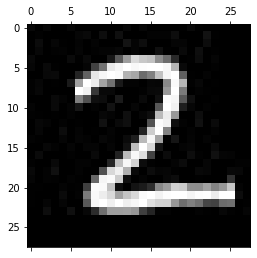

-------------------------------------------
Test: 1599
Predicted: 9


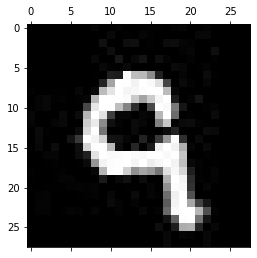

-------------------------------------------
Test: 1600
Predicted: 3


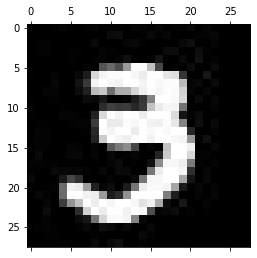

-------------------------------------------
Test: 1601
Predicted: 3


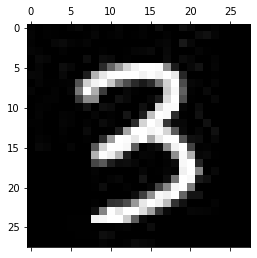

-------------------------------------------
Test: 1602
Predicted: 1


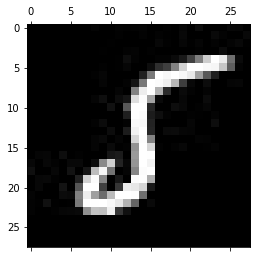

-------------------------------------------
Test: 1603
Predicted: 1


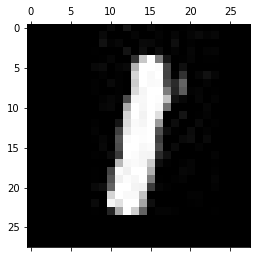

-------------------------------------------
Test: 1604
Predicted: 6


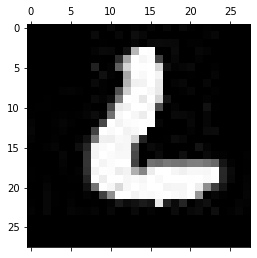

-------------------------------------------
Test: 1605
Predicted: 3


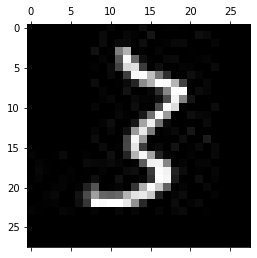

-------------------------------------------
Test: 1606
Predicted: 9


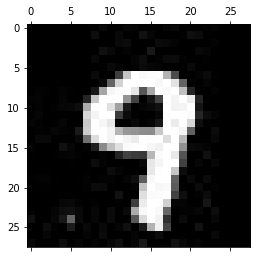

-------------------------------------------
Test: 1607
Predicted: 7


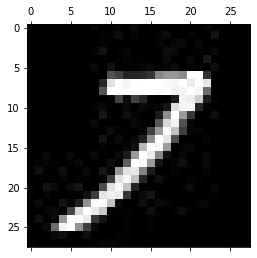

-------------------------------------------
Test: 1608
Predicted: 7


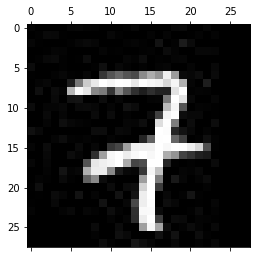

-------------------------------------------
Test: 1609
Predicted: 4


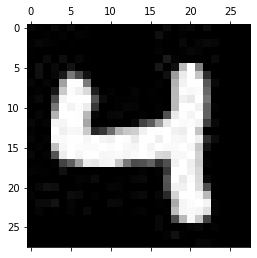

-------------------------------------------
Test: 1610
Predicted: 3


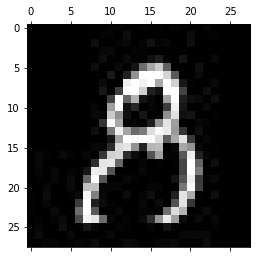

-------------------------------------------
Test: 1611
Predicted: 8


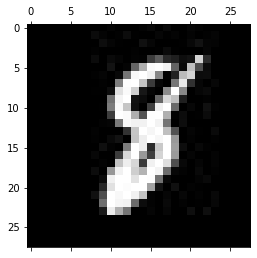

-------------------------------------------
Test: 1612
Predicted: 6


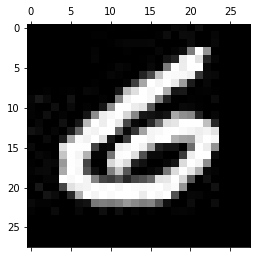

-------------------------------------------
Test: 1613
Predicted: 1


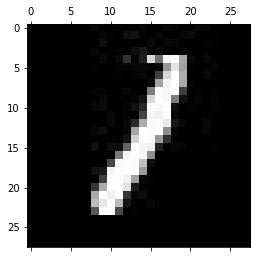

-------------------------------------------
Test: 1614
Predicted: 0


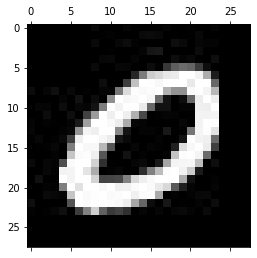

-------------------------------------------
Test: 1615
Predicted: 6


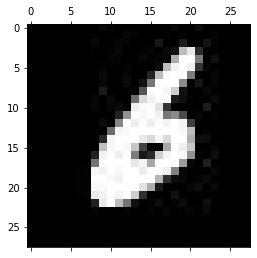

-------------------------------------------
Test: 1616
Predicted: 0


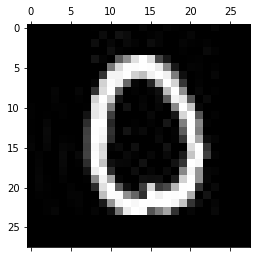

-------------------------------------------
Test: 1617
Predicted: 3


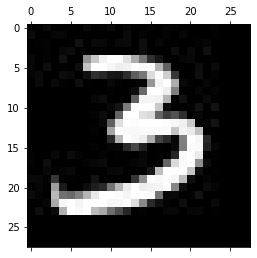

-------------------------------------------
Test: 1618
Predicted: 2


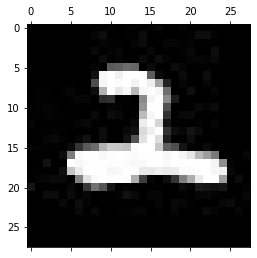

-------------------------------------------
Test: 1619
Predicted: 1


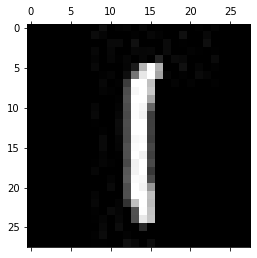

-------------------------------------------
Test: 1620
Predicted: 1


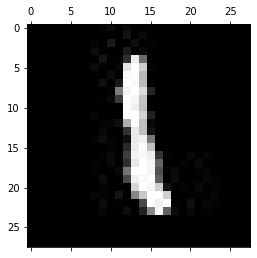

-------------------------------------------
Test: 1621
Predicted: 1


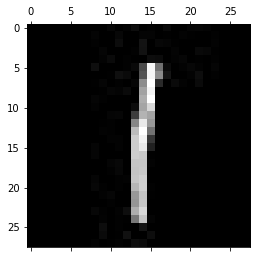

-------------------------------------------
Test: 1622
Predicted: 9


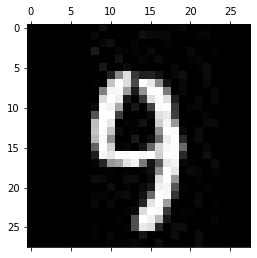

-------------------------------------------
Test: 1623
Predicted: 5


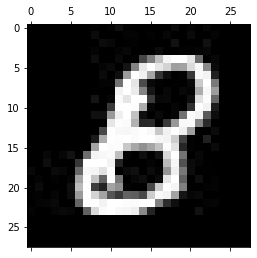

-------------------------------------------
Test: 1624
Predicted: 9


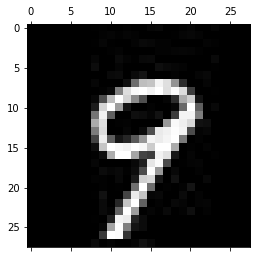

-------------------------------------------
Test: 1625
Predicted: 2


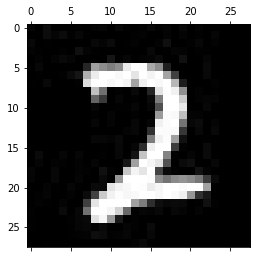

-------------------------------------------
Test: 1626
Predicted: 2


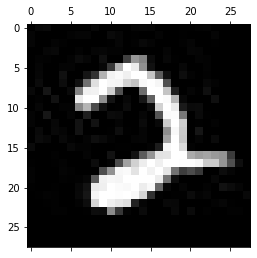

-------------------------------------------
Test: 1627
Predicted: 5


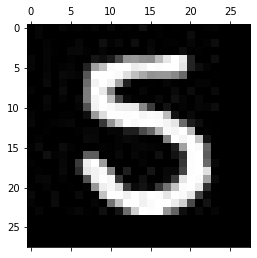

-------------------------------------------
Test: 1628
Predicted: 4


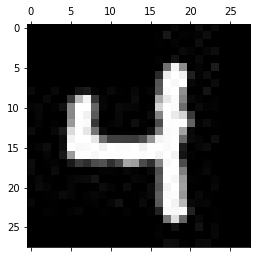

-------------------------------------------
Test: 1629
Predicted: 0


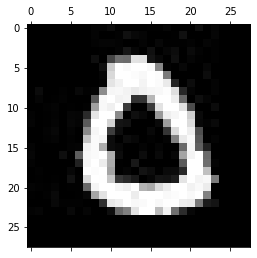

-------------------------------------------
Test: 1630
Predicted: 6


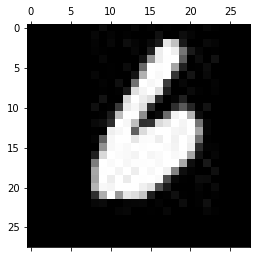

-------------------------------------------
Test: 1631
Predicted: 7


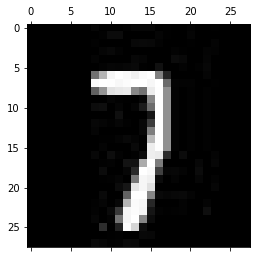

-------------------------------------------
Test: 1632
Predicted: 1


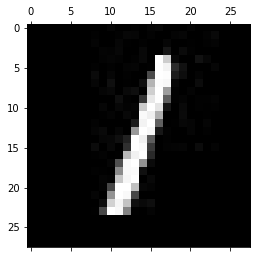

-------------------------------------------
Test: 1633
Predicted: 7


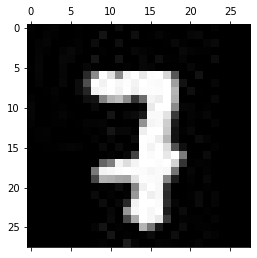

-------------------------------------------
Test: 1634
Predicted: 1


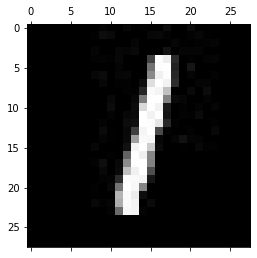

-------------------------------------------
Test: 1635
Predicted: 5


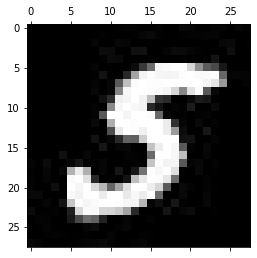

-------------------------------------------
Test: 1636
Predicted: 5


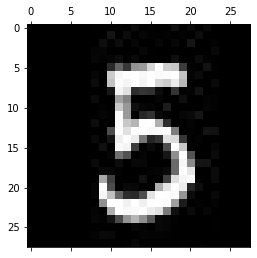

-------------------------------------------
Test: 1637
Predicted: 7


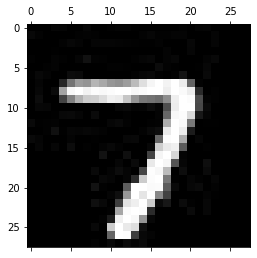

-------------------------------------------
Test: 1638
Predicted: 7


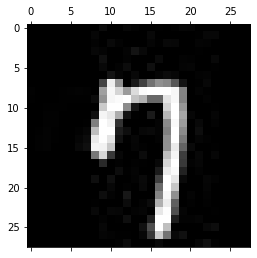

-------------------------------------------
Test: 1639
Predicted: 8


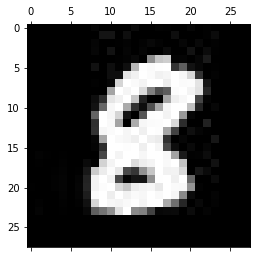

-------------------------------------------
Test: 1640
Predicted: 1


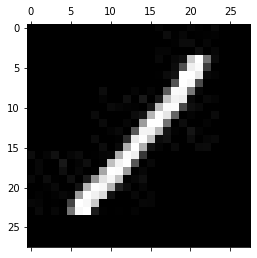

-------------------------------------------
Test: 1641
Predicted: 1


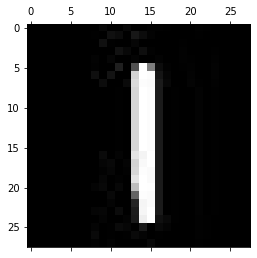

-------------------------------------------
Test: 1642
Predicted: 6


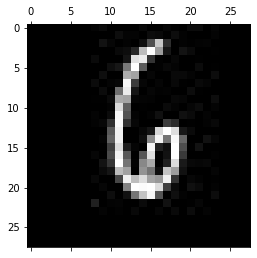

-------------------------------------------
Test: 1643
Predicted: 4


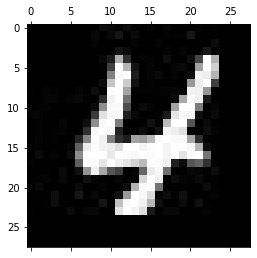

-------------------------------------------
Test: 1644
Predicted: 5


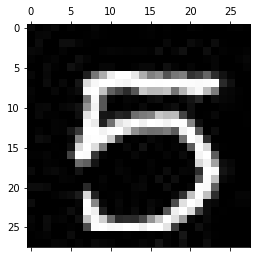

-------------------------------------------
Test: 1645
Predicted: 6


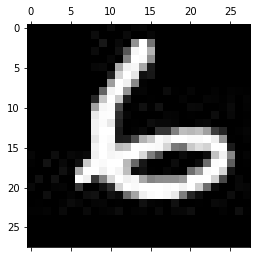

-------------------------------------------
Test: 1646
Predicted: 4


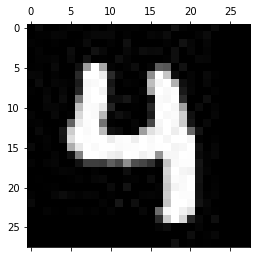

-------------------------------------------
Test: 1647
Predicted: 1


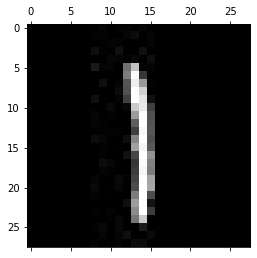

-------------------------------------------
Test: 1648
Predicted: 1


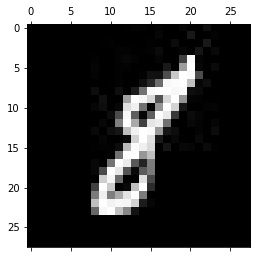

-------------------------------------------
Test: 1649
Predicted: 7


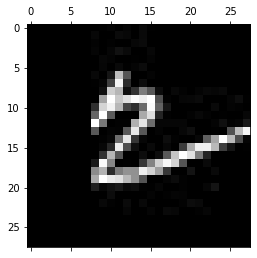

-------------------------------------------
Test: 1650
Predicted: 4


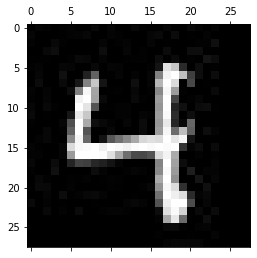

-------------------------------------------
Test: 1651
Predicted: 0


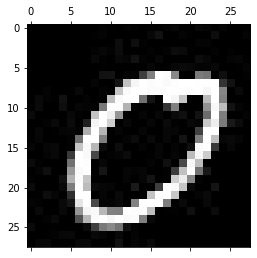

-------------------------------------------
Test: 1652
Predicted: 8


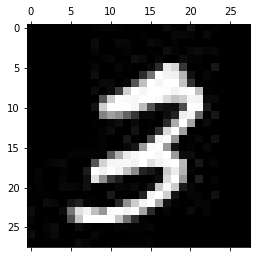

-------------------------------------------
Test: 1653
Predicted: 7


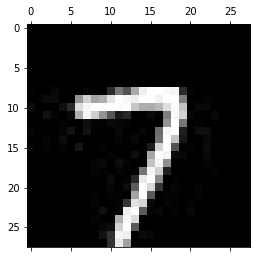

-------------------------------------------
Test: 1654
Predicted: 1


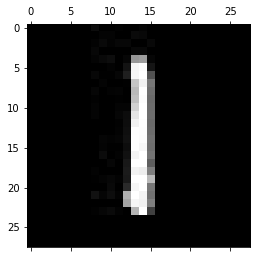

-------------------------------------------
Test: 1655
Predicted: 4


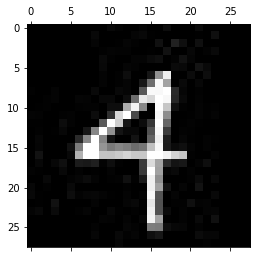

-------------------------------------------
Test: 1656
Predicted: 1


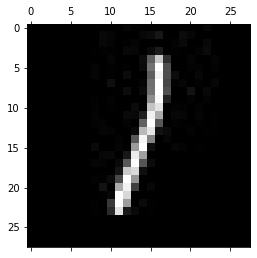

-------------------------------------------
Test: 1657
Predicted: 1


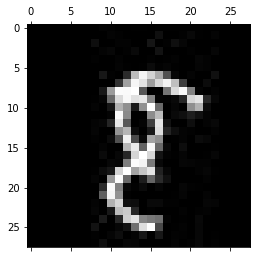

-------------------------------------------
Test: 1658
Predicted: 2


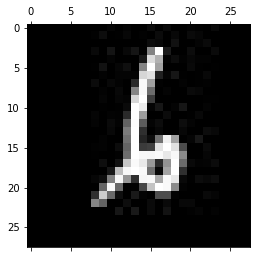

-------------------------------------------
Test: 1659
Predicted: 5


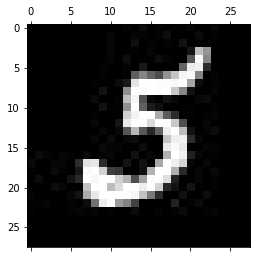

-------------------------------------------
Test: 1660
Predicted: 4


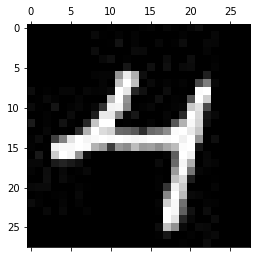

-------------------------------------------
Test: 1661
Predicted: 9


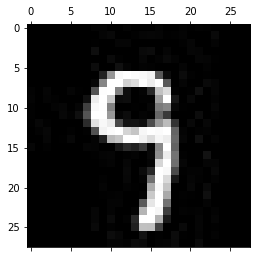

-------------------------------------------
Test: 1662
Predicted: 2


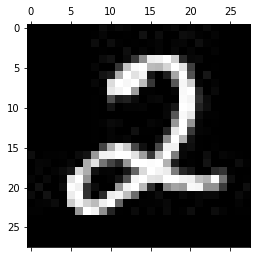

-------------------------------------------
Test: 1663
Predicted: 4


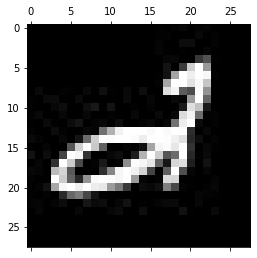

-------------------------------------------
Test: 1664
Predicted: 4


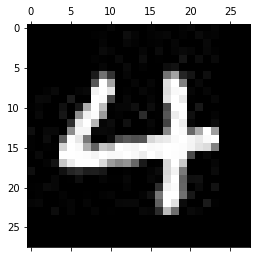

-------------------------------------------
Test: 1665
Predicted: 0


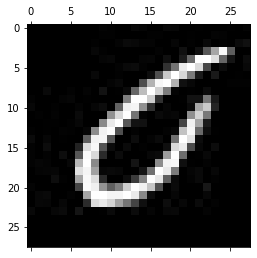

-------------------------------------------
Test: 1666
Predicted: 0


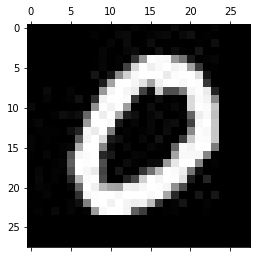

-------------------------------------------
Test: 1667
Predicted: 5


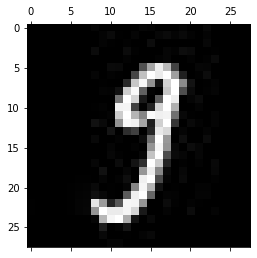

-------------------------------------------
Test: 1668
Predicted: 5


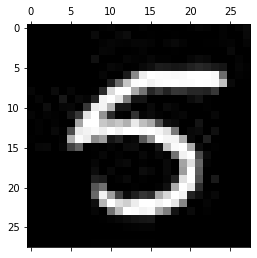

-------------------------------------------
Test: 1669
Predicted: 1


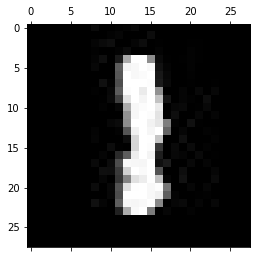

-------------------------------------------
Test: 1670
Predicted: 5


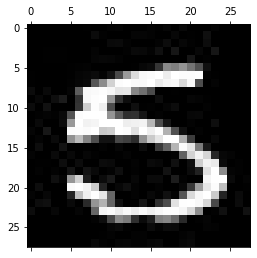

-------------------------------------------
Test: 1671
Predicted: 5


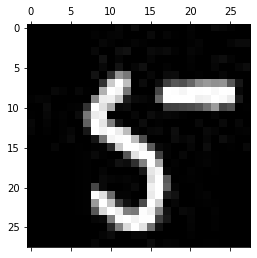

-------------------------------------------
Test: 1672
Predicted: 5


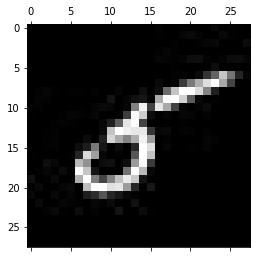

-------------------------------------------
Test: 1673
Predicted: 4


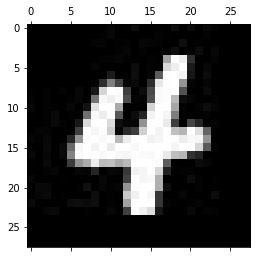

-------------------------------------------
Test: 1674
Predicted: 2


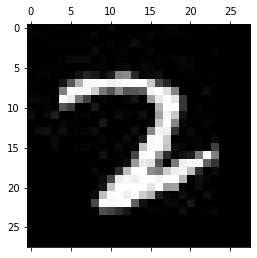

-------------------------------------------
Test: 1675
Predicted: 2


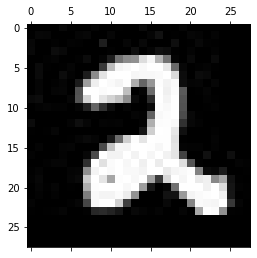

-------------------------------------------
Test: 1676
Predicted: 0


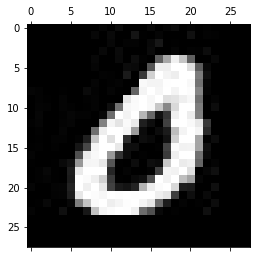

-------------------------------------------
Test: 1677
Predicted: 4


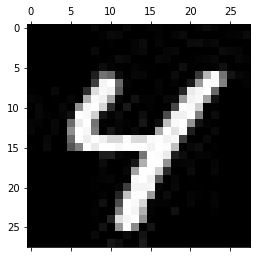

-------------------------------------------
Test: 1678
Predicted: 9


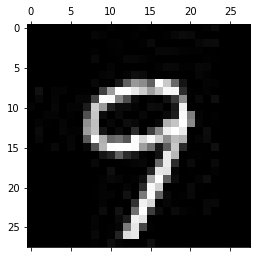

-------------------------------------------
Test: 1679
Predicted: 3


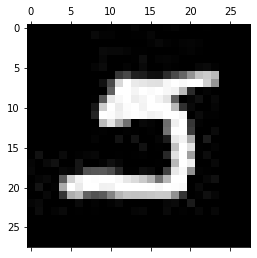

-------------------------------------------
Test: 1680
Predicted: 3


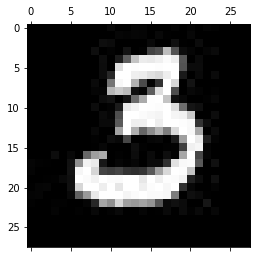

-------------------------------------------
Test: 1681
Predicted: 2


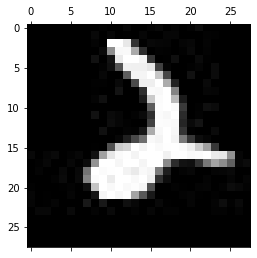

-------------------------------------------
Test: 1682
Predicted: 8


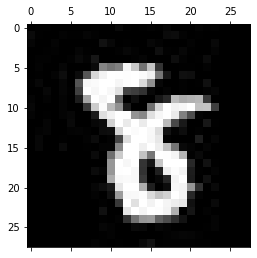

-------------------------------------------
Test: 1683
Predicted: 5


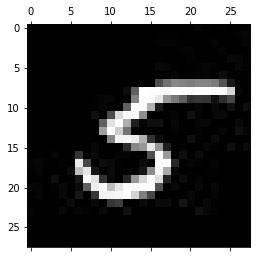

-------------------------------------------
Test: 1684
Predicted: 6


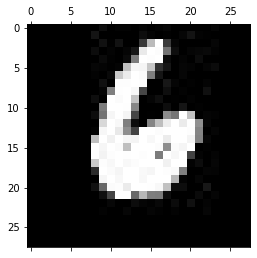

-------------------------------------------
Test: 1685
Predicted: 7


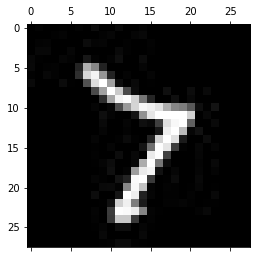

-------------------------------------------
Test: 1686
Predicted: 7


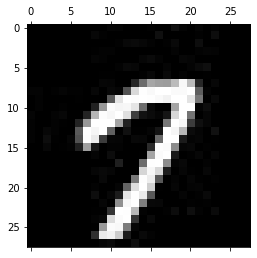

-------------------------------------------
Test: 1687
Predicted: 9


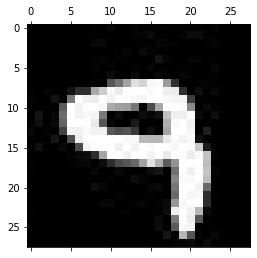

-------------------------------------------
Test: 1688
Predicted: 0


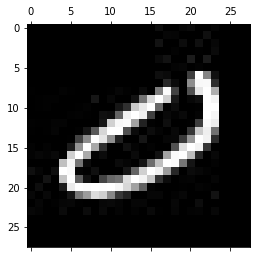

-------------------------------------------
Test: 1689
Predicted: 9


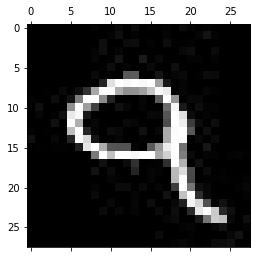

-------------------------------------------
Test: 1690
Predicted: 5


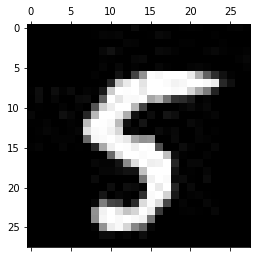

-------------------------------------------
Test: 1691
Predicted: 4


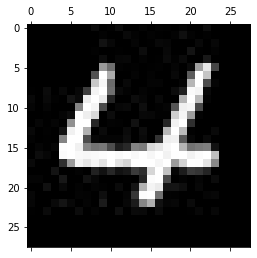

-------------------------------------------
Test: 1692
Predicted: 8


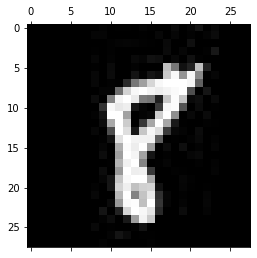

-------------------------------------------
Test: 1693
Predicted: 3


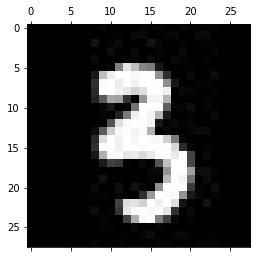

-------------------------------------------
Test: 1694
Predicted: 8


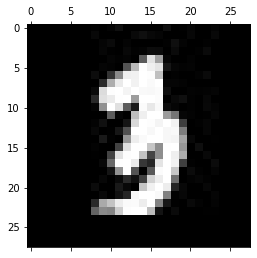

-------------------------------------------
Test: 1695
Predicted: 0


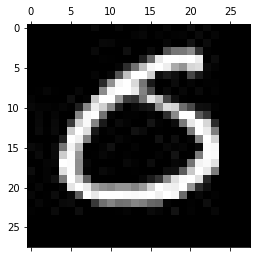

-------------------------------------------
Test: 1696
Predicted: 0


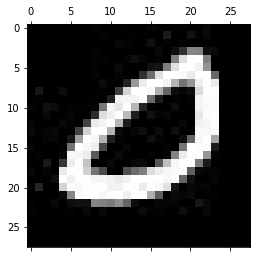

-------------------------------------------
Test: 1697
Predicted: 0


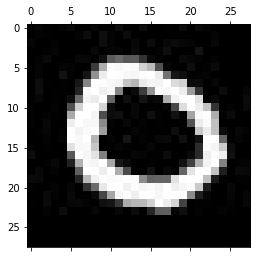

-------------------------------------------
Test: 1698
Predicted: 9


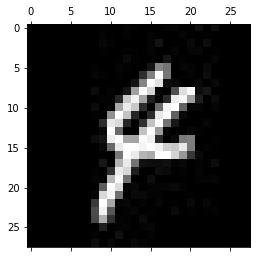

-------------------------------------------
Test: 1699
Predicted: 2


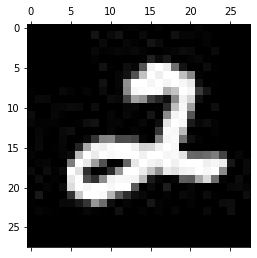

-------------------------------------------
Test: 1700
Predicted: 1


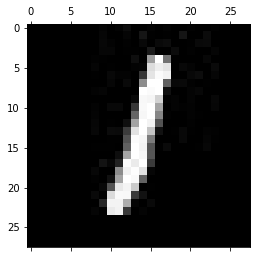

-------------------------------------------
Test: 1701
Predicted: 5


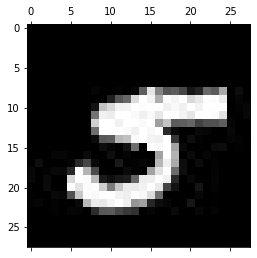

-------------------------------------------
Test: 1702
Predicted: 8


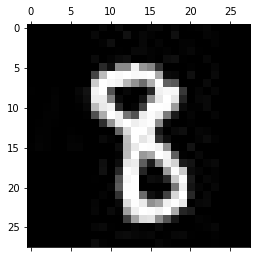

-------------------------------------------
Test: 1703
Predicted: 1


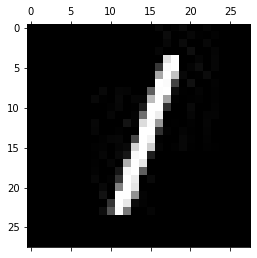

-------------------------------------------
Test: 1704
Predicted: 3


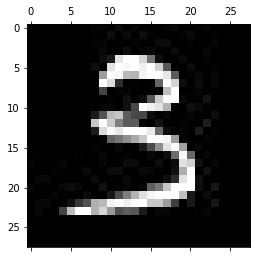

-------------------------------------------
Test: 1705
Predicted: 1


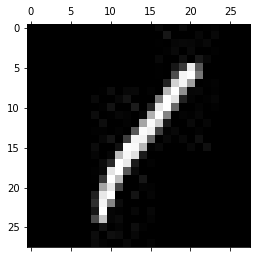

-------------------------------------------
Test: 1706
Predicted: 7


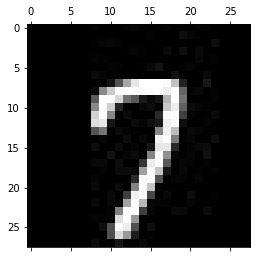

-------------------------------------------
Test: 1707
Predicted: 8


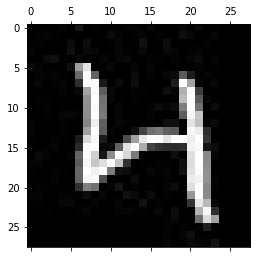

-------------------------------------------
Test: 1708
Predicted: 0


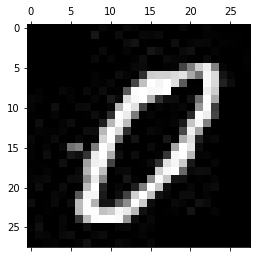

-------------------------------------------
Test: 1709
Predicted: 5


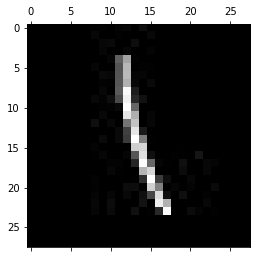

-------------------------------------------
Test: 1710
Predicted: 9


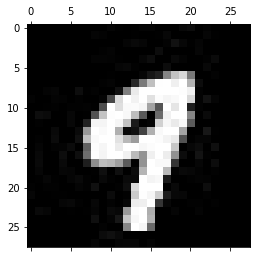

-------------------------------------------
Test: 1711
Predicted: 6


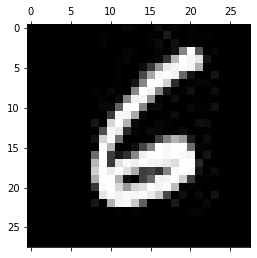

-------------------------------------------
Test: 1712
Predicted: 1


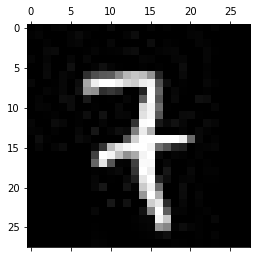

-------------------------------------------
Test: 1713
Predicted: 1


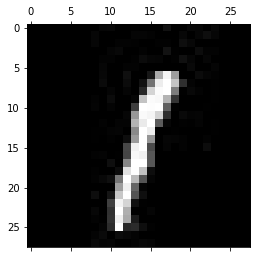

-------------------------------------------
Test: 1714
Predicted: 2


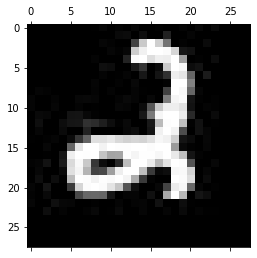

-------------------------------------------
Test: 1715
Predicted: 4


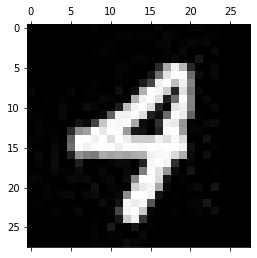

-------------------------------------------
Test: 1716
Predicted: 6


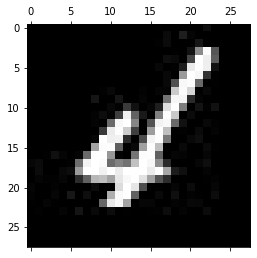

-------------------------------------------
Test: 1717
Predicted: 3


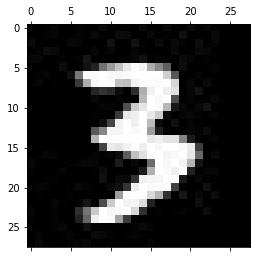

-------------------------------------------
Test: 1718
Predicted: 9


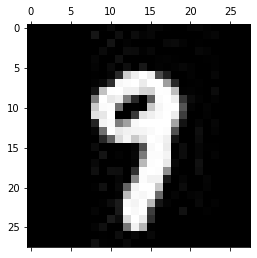

-------------------------------------------
Test: 1719
Predicted: 1


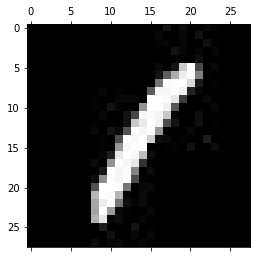

-------------------------------------------
Test: 1720
Predicted: 2


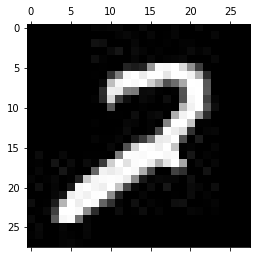

-------------------------------------------
Test: 1721
Predicted: 1


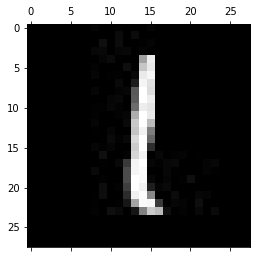

-------------------------------------------
Test: 1722
Predicted: 9


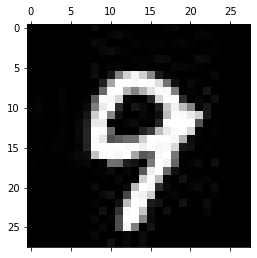

-------------------------------------------
Test: 1723
Predicted: 8


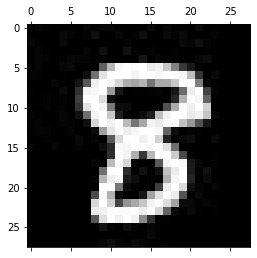

-------------------------------------------
Test: 1724
Predicted: 0


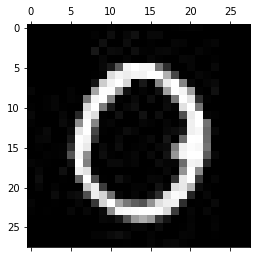

-------------------------------------------
Test: 1725
Predicted: 0


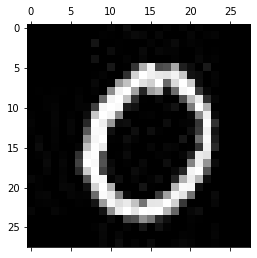

-------------------------------------------
Test: 1726
Predicted: 3


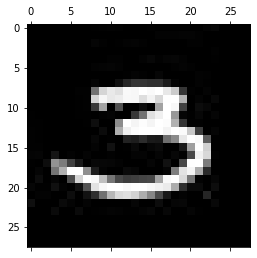

-------------------------------------------
Test: 1727
Predicted: 0


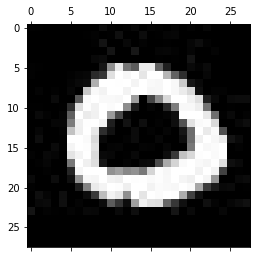

-------------------------------------------
Test: 1728
Predicted: 4


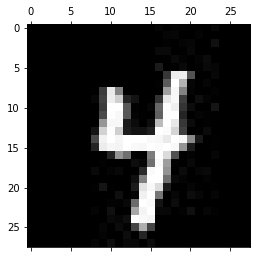

-------------------------------------------
Test: 1729
Predicted: 5


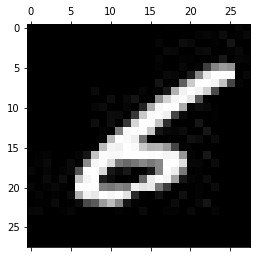

-------------------------------------------
Test: 1730
Predicted: 6


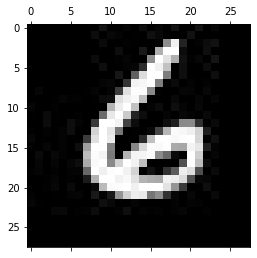

-------------------------------------------
Test: 1731
Predicted: 0


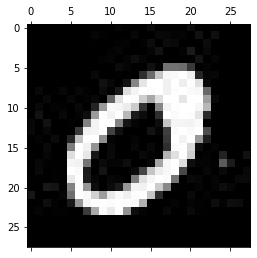

-------------------------------------------
Test: 1732
Predicted: 1


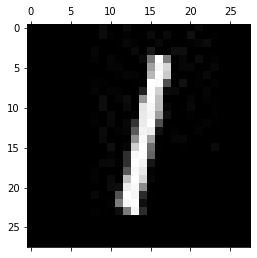

-------------------------------------------
Test: 1733
Predicted: 1


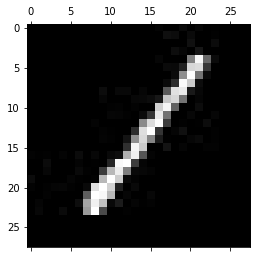

-------------------------------------------
Test: 1734
Predicted: 8


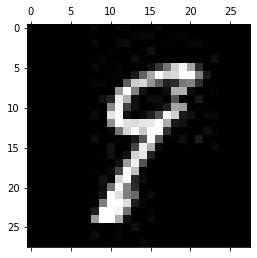

-------------------------------------------
Test: 1735
Predicted: 8


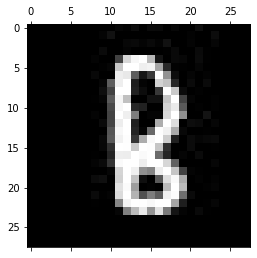

-------------------------------------------
Test: 1736
Predicted: 2


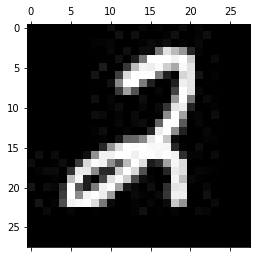

-------------------------------------------
Test: 1737
Predicted: 6


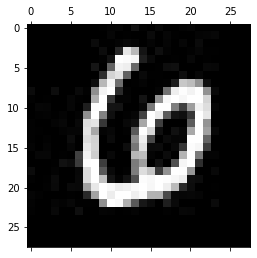

-------------------------------------------
Test: 1738
Predicted: 2


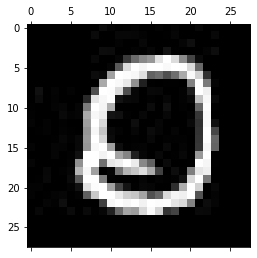

-------------------------------------------
Test: 1739
Predicted: 1


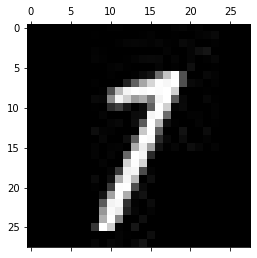

-------------------------------------------
Test: 1740
Predicted: 4


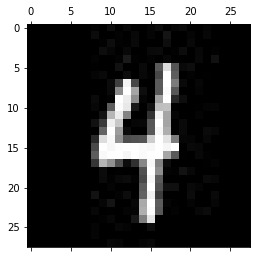

-------------------------------------------
Test: 1741
Predicted: 4


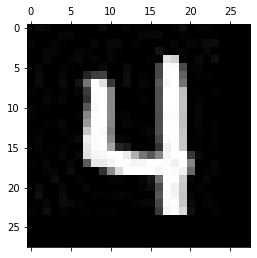

-------------------------------------------
Test: 1742
Predicted: 7


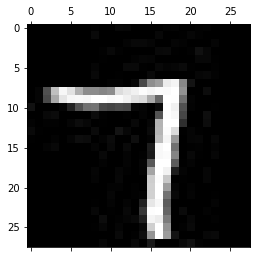

-------------------------------------------
Test: 1743
Predicted: 0


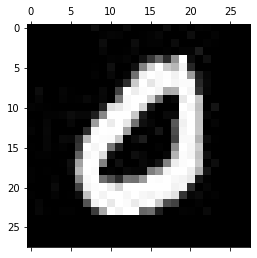

-------------------------------------------
Test: 1744
Predicted: 0


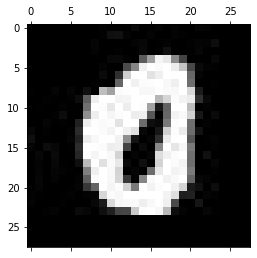

-------------------------------------------
Test: 1745
Predicted: 9


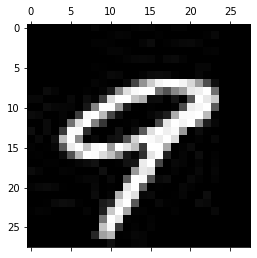

-------------------------------------------
Test: 1746
Predicted: 0


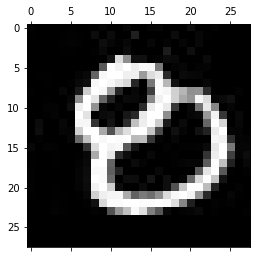

-------------------------------------------
Test: 1747
Predicted: 9


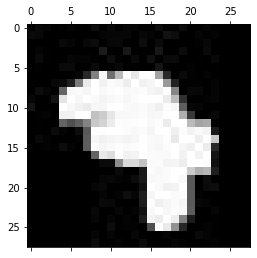

-------------------------------------------
Test: 1748
Predicted: 5


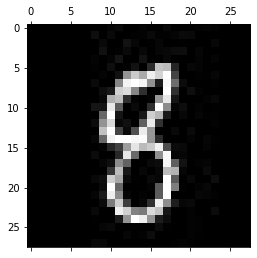

-------------------------------------------
Test: 1749
Predicted: 6


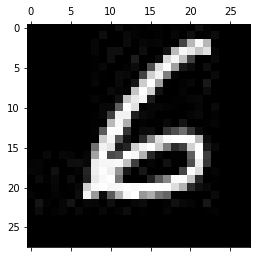

-------------------------------------------
Test: 1750
Predicted: 2


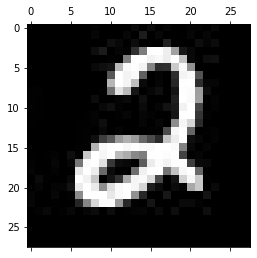

-------------------------------------------
Test: 1751
Predicted: 3


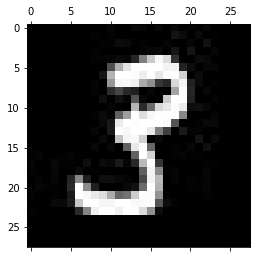

-------------------------------------------
Test: 1752
Predicted: 1


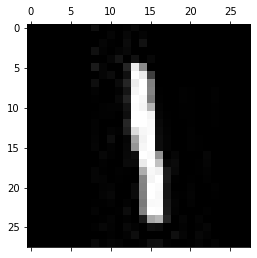

-------------------------------------------
Test: 1753
Predicted: 6


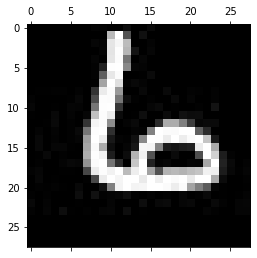

-------------------------------------------
Test: 1754
Predicted: 2


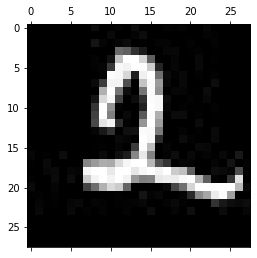

-------------------------------------------
Test: 1755
Predicted: 0


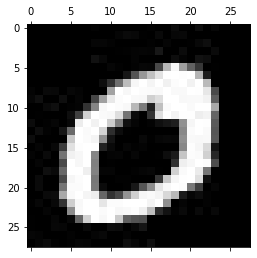

-------------------------------------------
Test: 1756
Predicted: 6


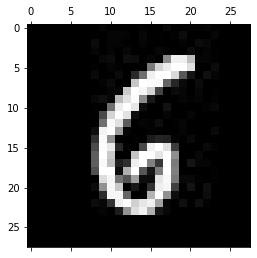

-------------------------------------------
Test: 1757
Predicted: 3


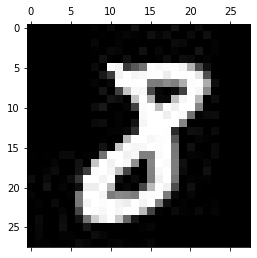

-------------------------------------------
Test: 1758
Predicted: 6


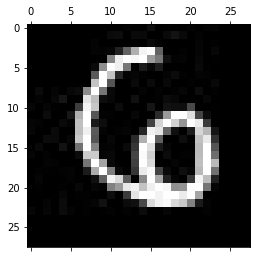

-------------------------------------------
Test: 1759
Predicted: 0


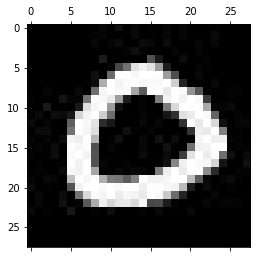

-------------------------------------------
Test: 1760
Predicted: 6


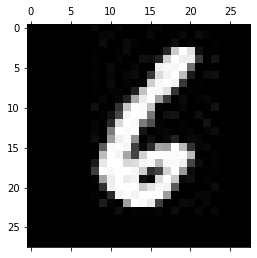

-------------------------------------------
Test: 1761
Predicted: 8


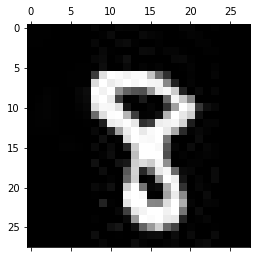

-------------------------------------------
Test: 1762
Predicted: 5


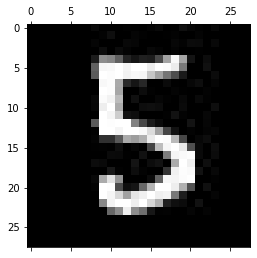

-------------------------------------------
Test: 1763
Predicted: 7


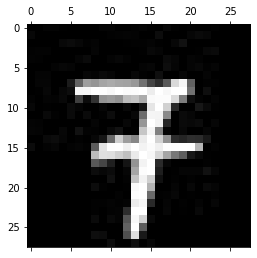

-------------------------------------------
Test: 1764
Predicted: 3


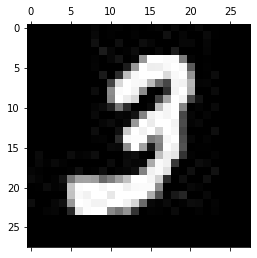

-------------------------------------------
Test: 1765
Predicted: 3


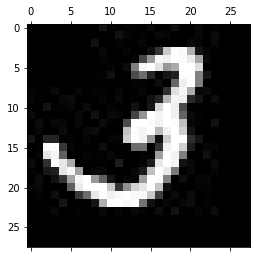

-------------------------------------------
Test: 1766
Predicted: 2


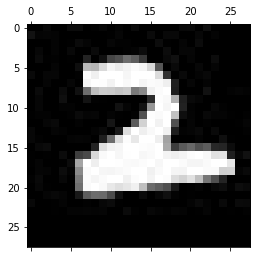

-------------------------------------------
Test: 1767
Predicted: 6


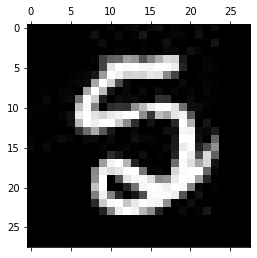

-------------------------------------------
Test: 1768
Predicted: 2


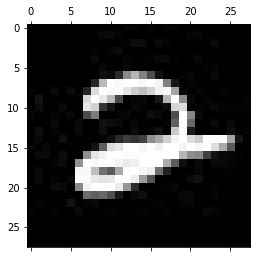

-------------------------------------------
Test: 1769
Predicted: 3


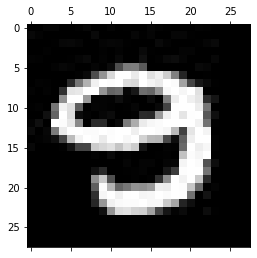

-------------------------------------------
Test: 1770
Predicted: 0


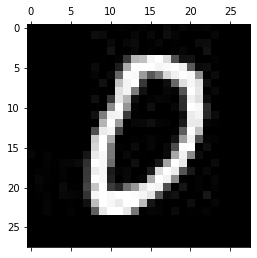

-------------------------------------------
Test: 1771
Predicted: 3


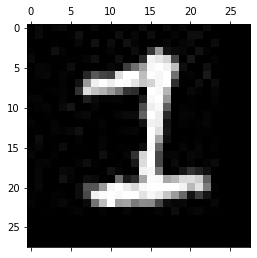

-------------------------------------------
Test: 1772
Predicted: 6


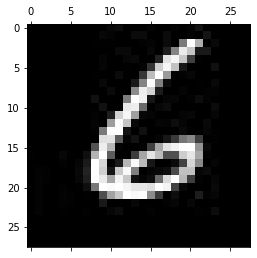

-------------------------------------------
Test: 1773
Predicted: 6


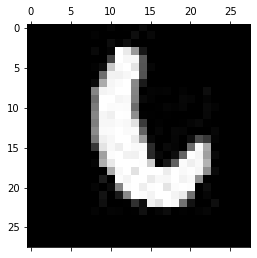

-------------------------------------------
Test: 1774
Predicted: 4


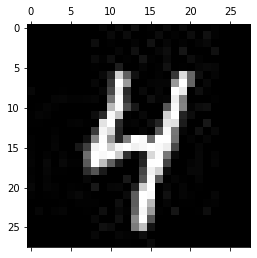

-------------------------------------------
Test: 1775
Predicted: 1


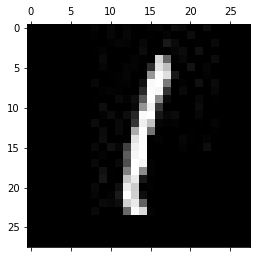

-------------------------------------------
Test: 1776
Predicted: 9


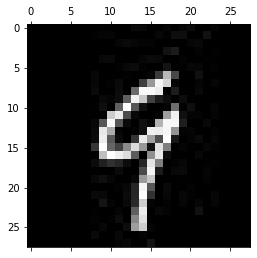

-------------------------------------------
Test: 1777
Predicted: 9


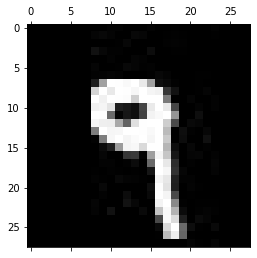

-------------------------------------------
Test: 1778
Predicted: 8


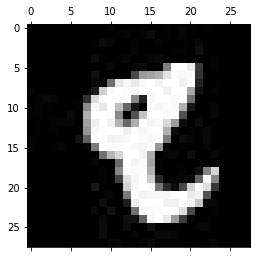

-------------------------------------------
Test: 1779
Predicted: 3


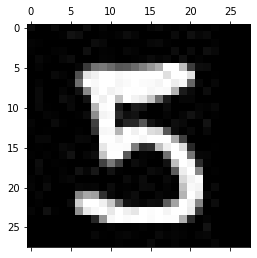

-------------------------------------------
Test: 1780
Predicted: 4


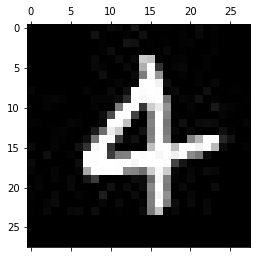

-------------------------------------------
Test: 1781
Predicted: 9


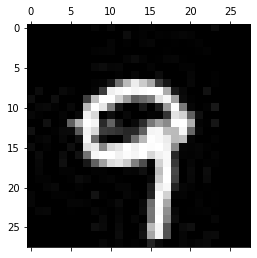

-------------------------------------------
Test: 1782
Predicted: 5


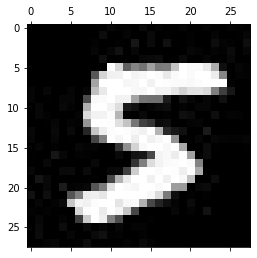

-------------------------------------------
Test: 1783
Predicted: 7


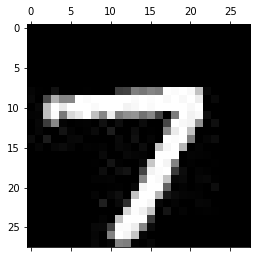

-------------------------------------------
Test: 1784
Predicted: 5


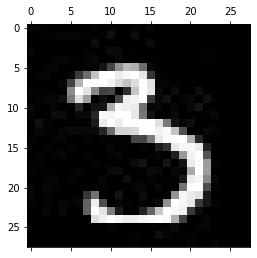

-------------------------------------------
Test: 1785
Predicted: 2


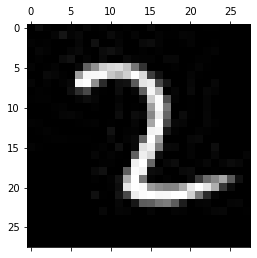

-------------------------------------------
Test: 1786
Predicted: 4


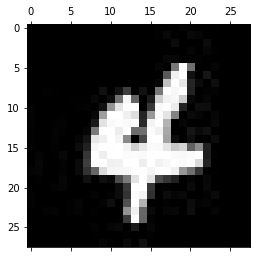

-------------------------------------------
Test: 1787
Predicted: 7


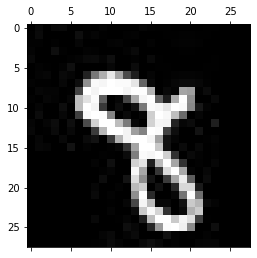

-------------------------------------------
Test: 1788
Predicted: 0


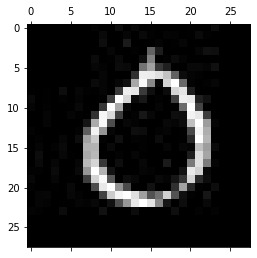

-------------------------------------------
Test: 1789
Predicted: 5


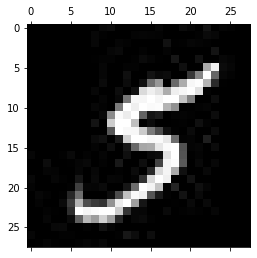

-------------------------------------------
Test: 1790
Predicted: 1


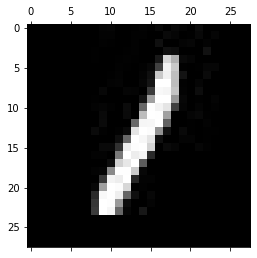

-------------------------------------------
Test: 1791
Predicted: 7


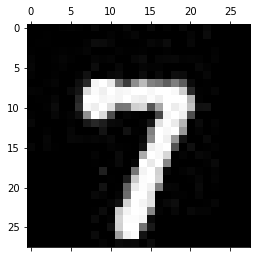

-------------------------------------------
Test: 1792
Predicted: 0


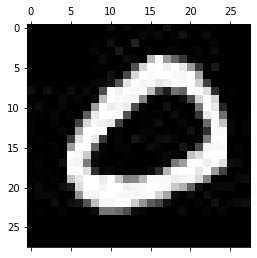

-------------------------------------------
Test: 1793
Predicted: 8


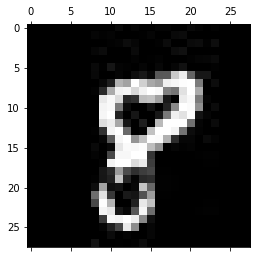

-------------------------------------------
Test: 1794
Predicted: 2


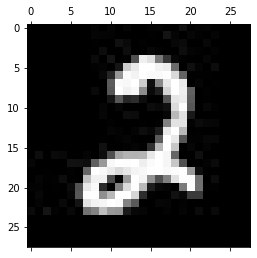

-------------------------------------------
Test: 1795
Predicted: 3


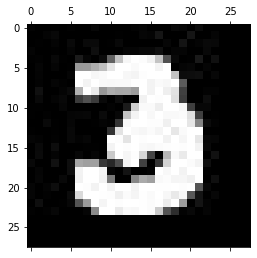

-------------------------------------------
Test: 1796
Predicted: 2


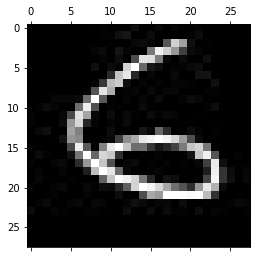

-------------------------------------------
Test: 1797
Predicted: 5


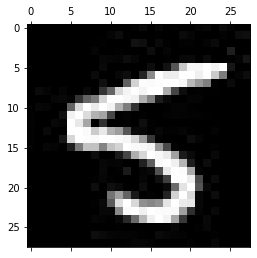

-------------------------------------------
Test: 1798
Predicted: 4


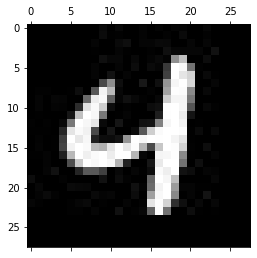

-------------------------------------------
Test: 1799
Predicted: 7


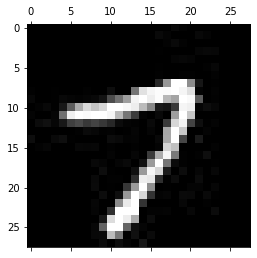

-------------------------------------------
Test: 1800
Predicted: 8


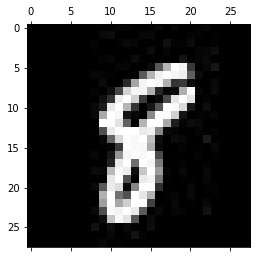

-------------------------------------------
Test: 1801
Predicted: 6


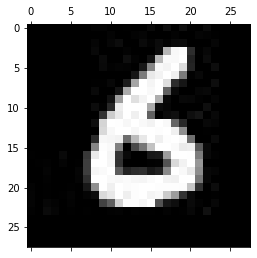

-------------------------------------------
Test: 1802
Predicted: 7


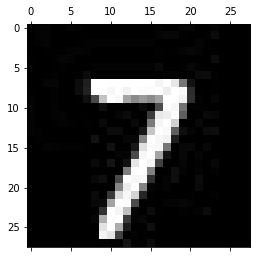

-------------------------------------------
Test: 1803
Predicted: 0


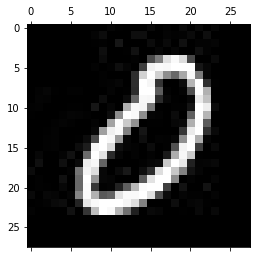

-------------------------------------------
Test: 1804
Predicted: 2


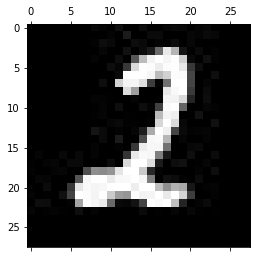

-------------------------------------------
Test: 1805
Predicted: 6


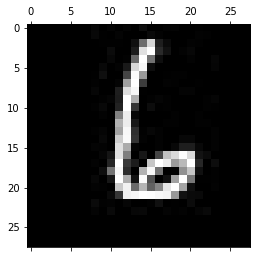

-------------------------------------------
Test: 1806
Predicted: 9


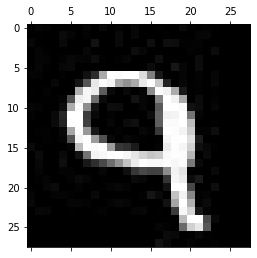

-------------------------------------------
Test: 1807
Predicted: 1


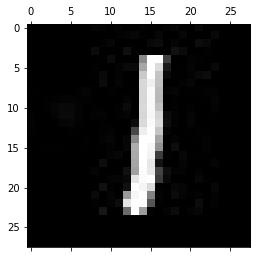

-------------------------------------------
Test: 1808
Predicted: 3


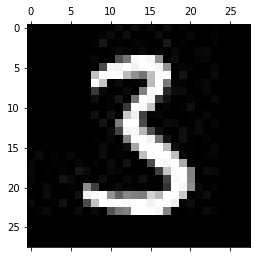

-------------------------------------------
Test: 1809
Predicted: 8


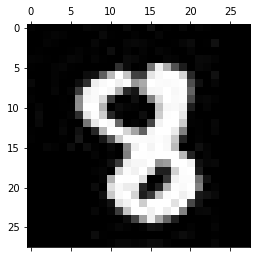

-------------------------------------------
Test: 1810
Predicted: 5


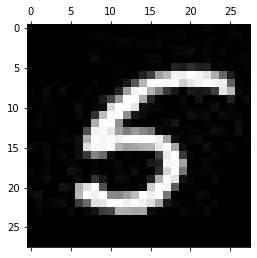

-------------------------------------------
Test: 1811
Predicted: 2


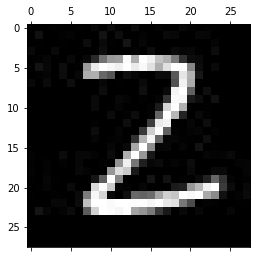

-------------------------------------------
Test: 1812
Predicted: 8


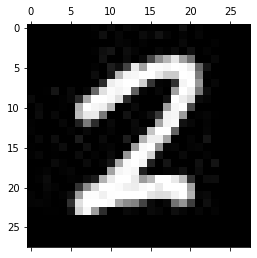

-------------------------------------------
Test: 1813
Predicted: 0


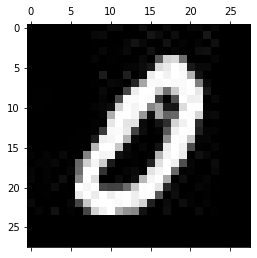

-------------------------------------------
Test: 1814
Predicted: 3


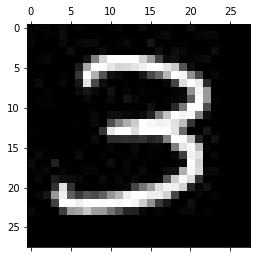

-------------------------------------------
Test: 1815
Predicted: 2


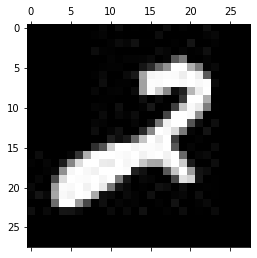

-------------------------------------------
Test: 1816
Predicted: 8


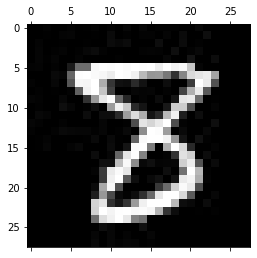

-------------------------------------------
Test: 1817
Predicted: 7


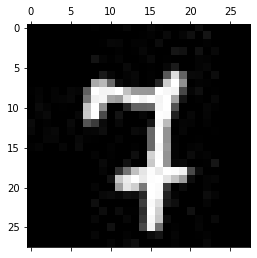

-------------------------------------------
Test: 1818
Predicted: 5


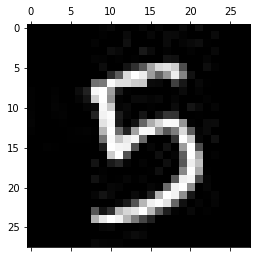

-------------------------------------------
Test: 1819
Predicted: 3


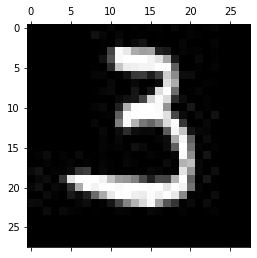

-------------------------------------------
Test: 1820
Predicted: 3


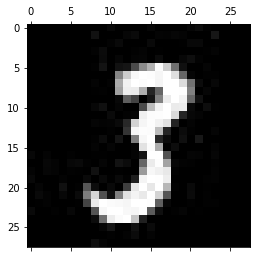

-------------------------------------------
Test: 1821
Predicted: 2


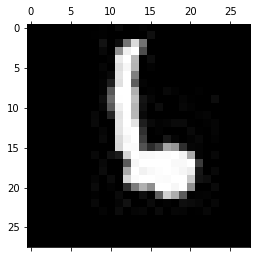

-------------------------------------------
Test: 1822
Predicted: 1


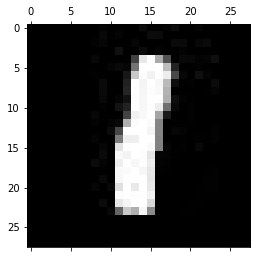

-------------------------------------------
Test: 1823
Predicted: 9


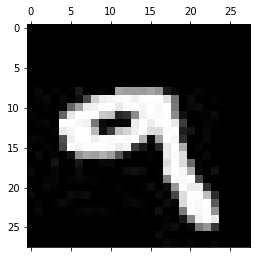

-------------------------------------------
Test: 1824
Predicted: 0


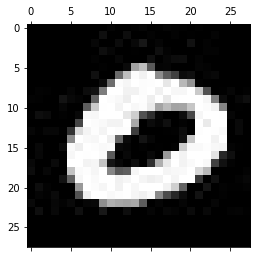

-------------------------------------------
Test: 1825
Predicted: 7


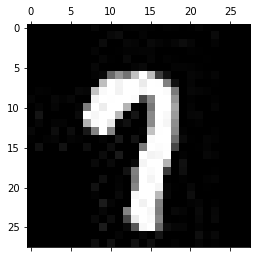

-------------------------------------------
Test: 1826
Predicted: 7


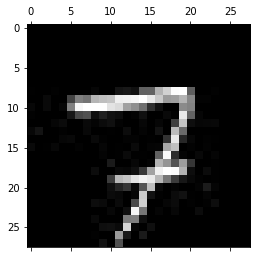

-------------------------------------------
Test: 1827
Predicted: 0


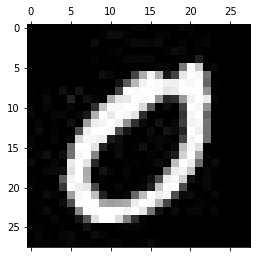

-------------------------------------------
Test: 1828
Predicted: 2


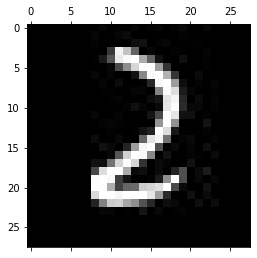

-------------------------------------------
Test: 1829
Predicted: 6


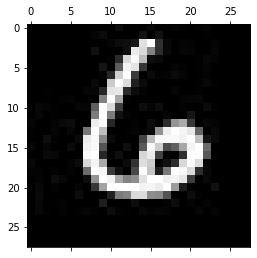

-------------------------------------------
Test: 1830
Predicted: 5


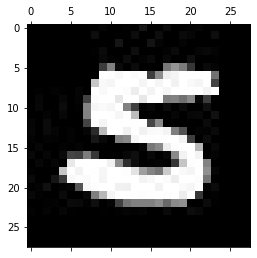

-------------------------------------------
Test: 1831
Predicted: 4


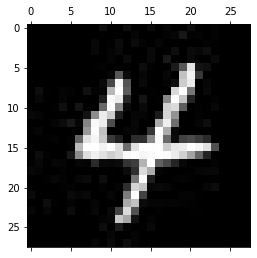

-------------------------------------------
Test: 1832
Predicted: 1


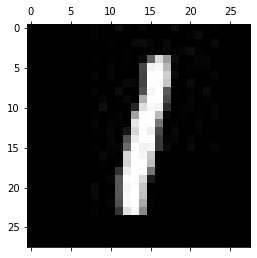

-------------------------------------------
Test: 1833
Predicted: 3


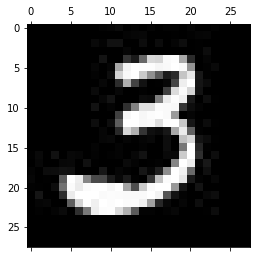

-------------------------------------------
Test: 1834
Predicted: 1


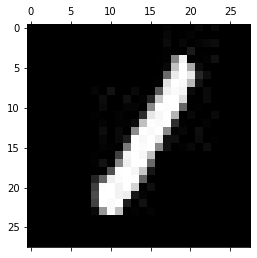

-------------------------------------------
Test: 1835
Predicted: 3


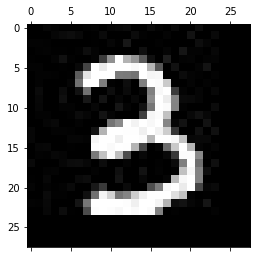

-------------------------------------------
Test: 1836
Predicted: 1


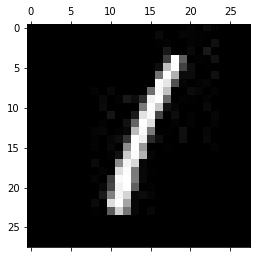

-------------------------------------------
Test: 1837
Predicted: 9


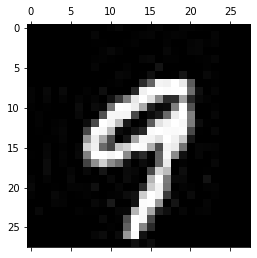

-------------------------------------------
Test: 1838
Predicted: 6


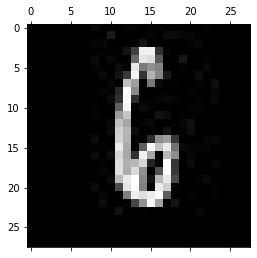

-------------------------------------------
Test: 1839
Predicted: 8


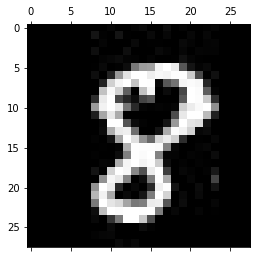

-------------------------------------------
Test: 1840
Predicted: 0


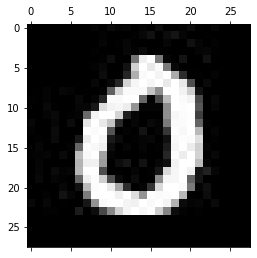

-------------------------------------------
Test: 1841
Predicted: 0


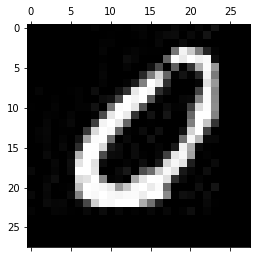

-------------------------------------------
Test: 1842
Predicted: 3


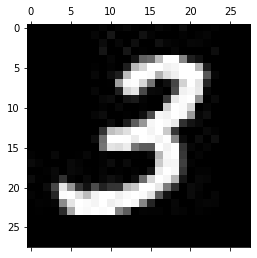

-------------------------------------------
Test: 1843
Predicted: 7


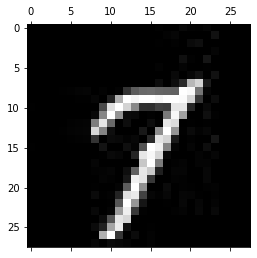

-------------------------------------------
Test: 1844
Predicted: 1


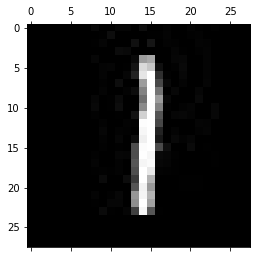

-------------------------------------------
Test: 1845
Predicted: 2


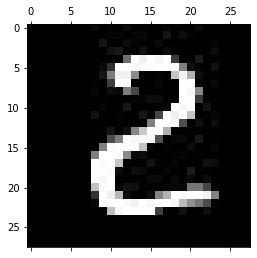

-------------------------------------------
Test: 1846
Predicted: 2


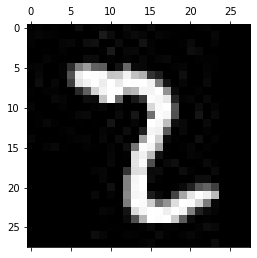

-------------------------------------------
Test: 1847
Predicted: 0


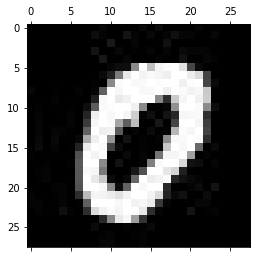

-------------------------------------------
Test: 1848
Predicted: 9


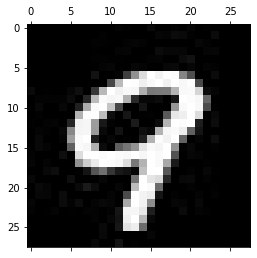

-------------------------------------------
Test: 1849
Predicted: 0


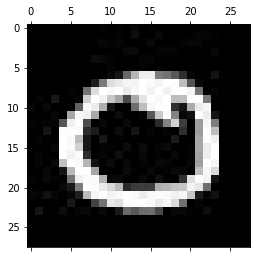

-------------------------------------------
Test: 1850
Predicted: 1


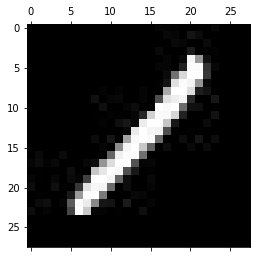

-------------------------------------------
Test: 1851
Predicted: 5


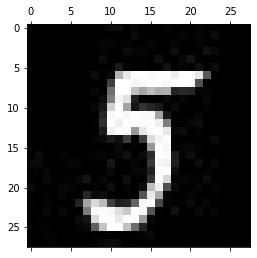

-------------------------------------------
Test: 1852
Predicted: 1


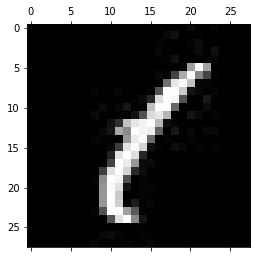

-------------------------------------------
Test: 1853
Predicted: 6


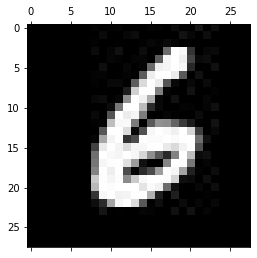

-------------------------------------------
Test: 1854
Predicted: 1


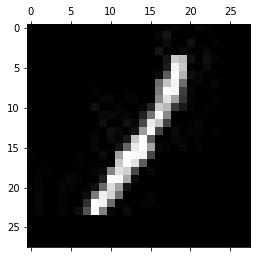

-------------------------------------------
Test: 1855
Predicted: 8


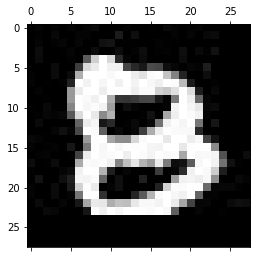

-------------------------------------------
Test: 1856
Predicted: 9


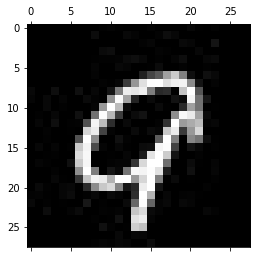

-------------------------------------------
Test: 1857
Predicted: 2


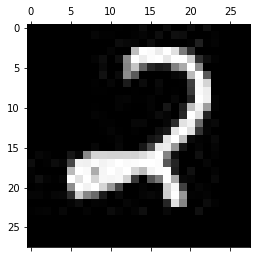

-------------------------------------------
Test: 1858
Predicted: 9


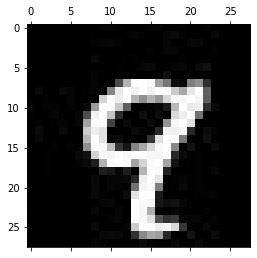

-------------------------------------------
Test: 1859
Predicted: 1


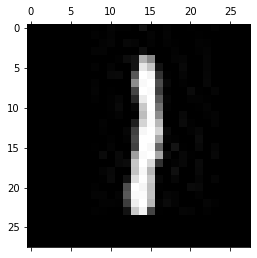

-------------------------------------------
Test: 1860
Predicted: 0


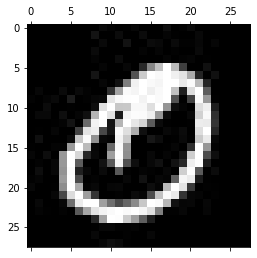

-------------------------------------------
Test: 1861
Predicted: 1


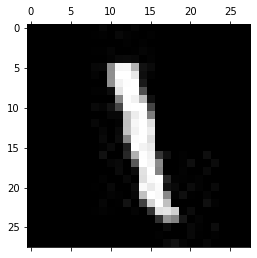

-------------------------------------------
Test: 1862
Predicted: 4


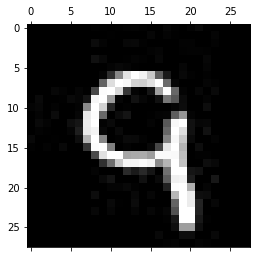

-------------------------------------------
Test: 1863
Predicted: 8


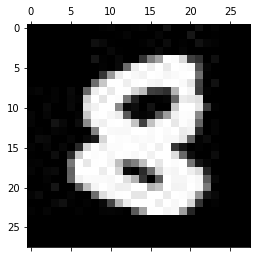

-------------------------------------------
Test: 1864
Predicted: 9


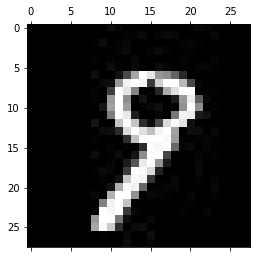

-------------------------------------------
Test: 1865
Predicted: 8


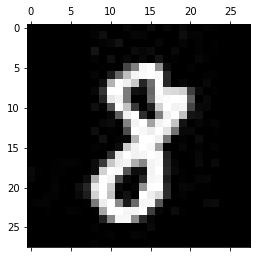

-------------------------------------------
Test: 1866
Predicted: 0


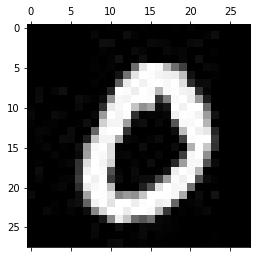

-------------------------------------------
Test: 1867
Predicted: 3


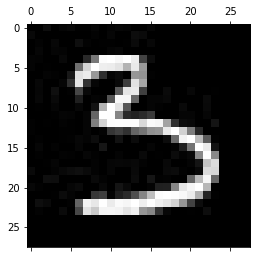

-------------------------------------------
Test: 1868
Predicted: 2


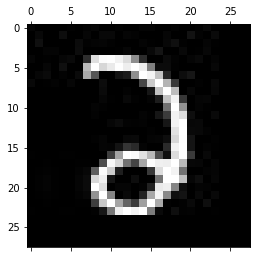

-------------------------------------------
Test: 1869
Predicted: 1


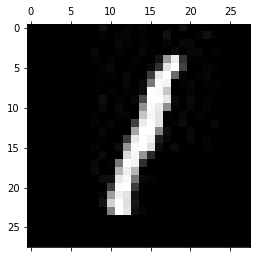

-------------------------------------------
Test: 1870
Predicted: 0


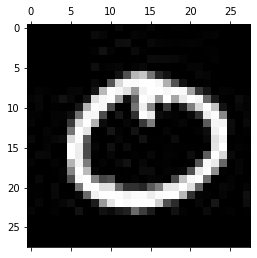

-------------------------------------------
Test: 1871
Predicted: 6


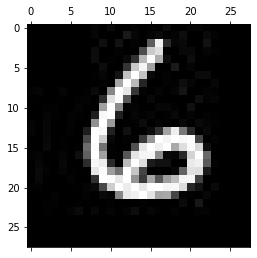

-------------------------------------------
Test: 1872
Predicted: 5


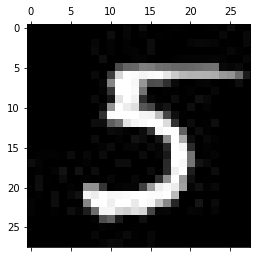

-------------------------------------------
Test: 1873
Predicted: 2


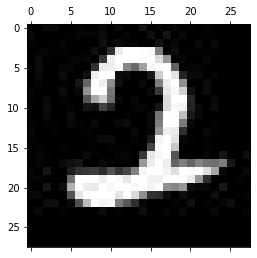

-------------------------------------------
Test: 1874
Predicted: 5


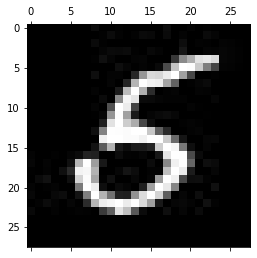

-------------------------------------------
Test: 1875
Predicted: 3


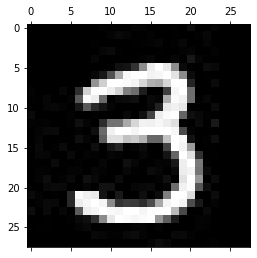

-------------------------------------------
Test: 1876
Predicted: 1


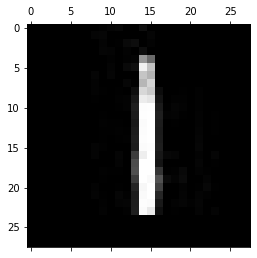

-------------------------------------------
Test: 1877
Predicted: 4


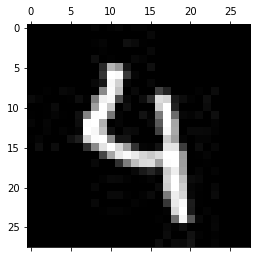

-------------------------------------------
Test: 1878
Predicted: 0


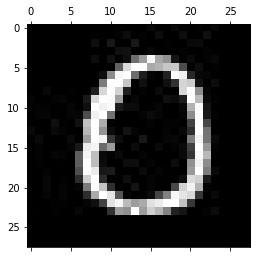

-------------------------------------------
Test: 1879
Predicted: 3


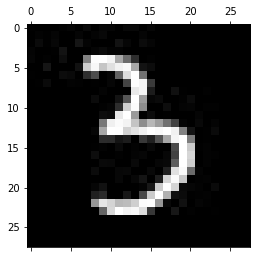

-------------------------------------------
Test: 1880
Predicted: 2


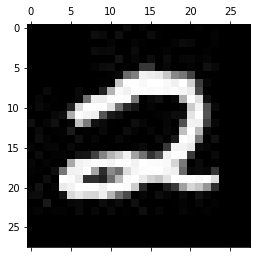

-------------------------------------------
Test: 1881
Predicted: 9


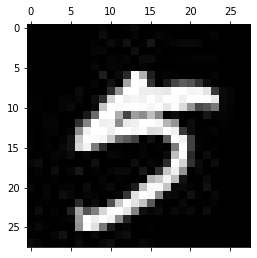

-------------------------------------------
Test: 1882
Predicted: 9


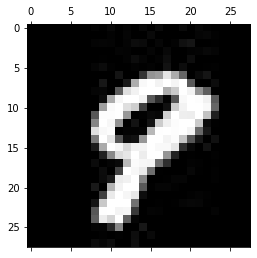

-------------------------------------------
Test: 1883
Predicted: 9


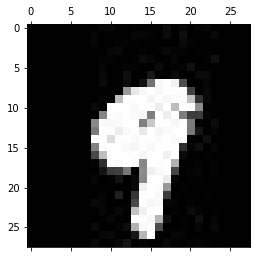

-------------------------------------------
Test: 1884
Predicted: 7


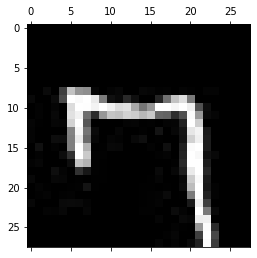

-------------------------------------------
Test: 1885
Predicted: 1


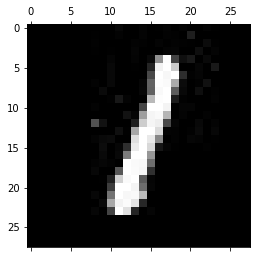

-------------------------------------------
Test: 1886
Predicted: 9


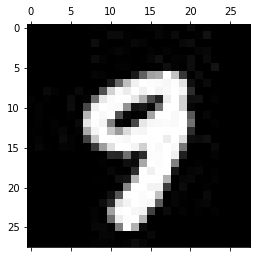

-------------------------------------------
Test: 1887
Predicted: 4


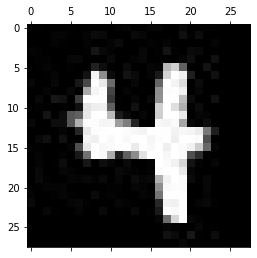

-------------------------------------------
Test: 1888
Predicted: 1


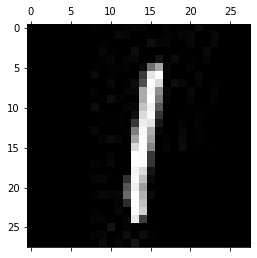

-------------------------------------------
Test: 1889
Predicted: 5


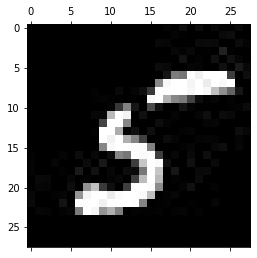

-------------------------------------------
Test: 1890
Predicted: 7


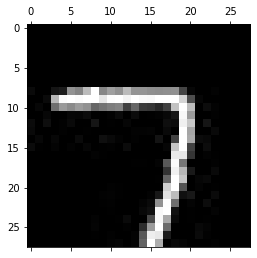

-------------------------------------------
Test: 1891
Predicted: 7


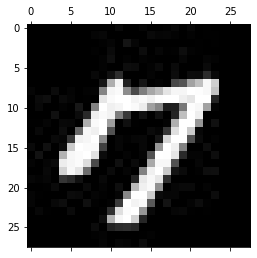

-------------------------------------------
Test: 1892
Predicted: 4


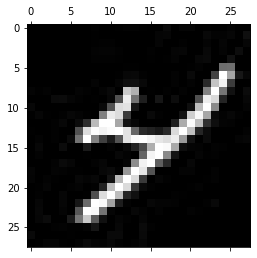

-------------------------------------------
Test: 1893
Predicted: 9


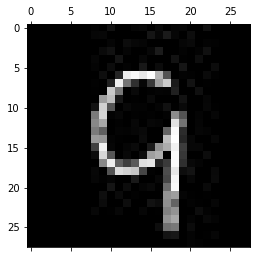

-------------------------------------------
Test: 1894
Predicted: 6


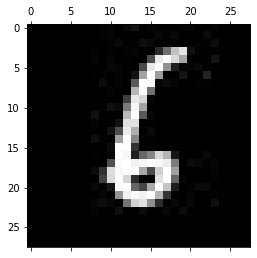

-------------------------------------------
Test: 1895
Predicted: 9


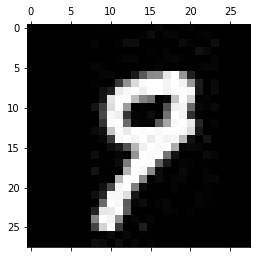

-------------------------------------------
Test: 1896
Predicted: 3


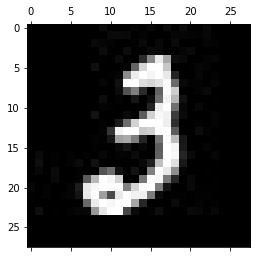

-------------------------------------------
Test: 1897
Predicted: 3


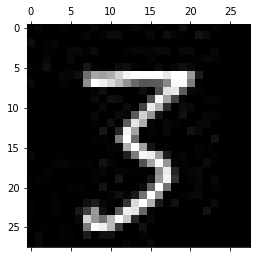

-------------------------------------------
Test: 1898
Predicted: 7


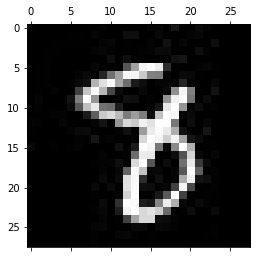

-------------------------------------------
Test: 1899
Predicted: 4


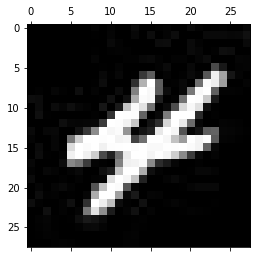

-------------------------------------------
Test: 1900
Predicted: 8


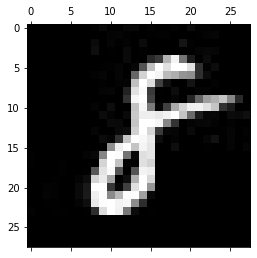

-------------------------------------------
Test: 1901
Predicted: 6


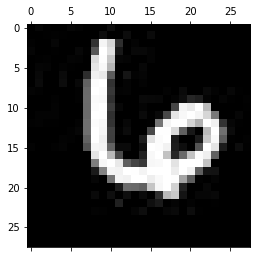

-------------------------------------------
Test: 1902
Predicted: 8


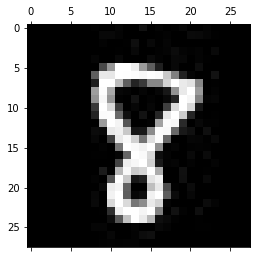

-------------------------------------------
Test: 1903
Predicted: 1


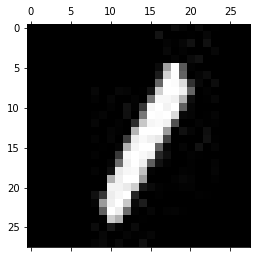

-------------------------------------------
Test: 1904
Predicted: 0


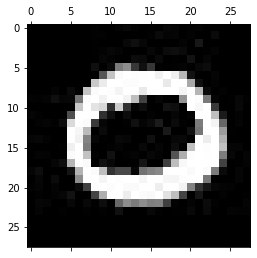

-------------------------------------------
Test: 1905
Predicted: 8


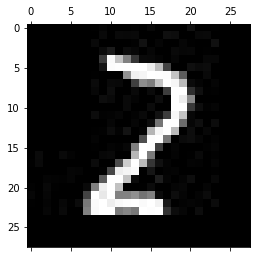

-------------------------------------------
Test: 1906
Predicted: 1


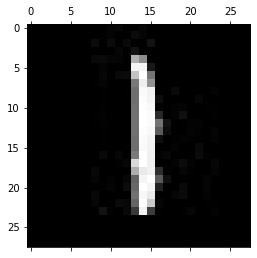

-------------------------------------------
Test: 1907
Predicted: 1


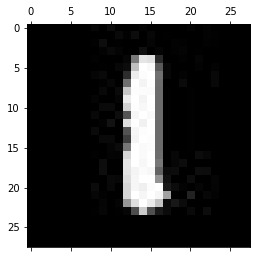

-------------------------------------------
Test: 1908
Predicted: 1


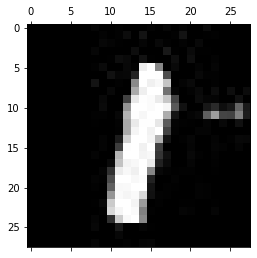

-------------------------------------------
Test: 1909
Predicted: 7


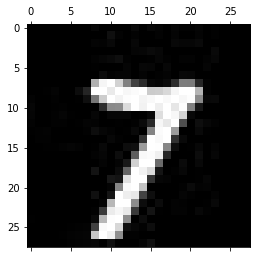

-------------------------------------------
Test: 1910
Predicted: 3


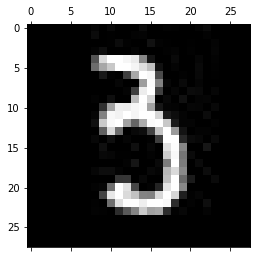

-------------------------------------------
Test: 1911
Predicted: 9


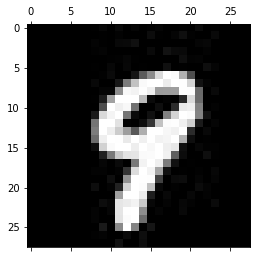

-------------------------------------------
Test: 1912
Predicted: 0


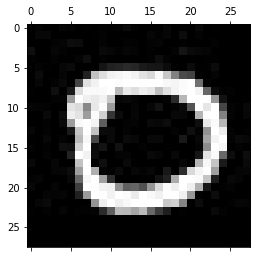

-------------------------------------------
Test: 1913
Predicted: 2


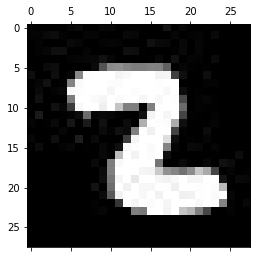

-------------------------------------------
Test: 1914
Predicted: 2


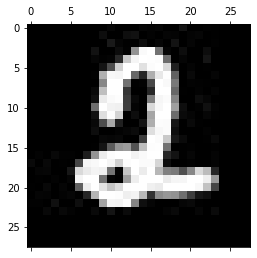

-------------------------------------------
Test: 1915
Predicted: 8


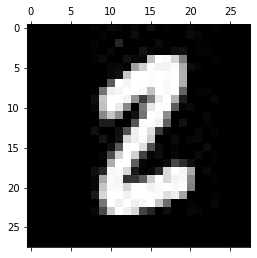

-------------------------------------------
Test: 1916
Predicted: 4


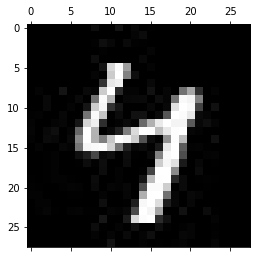

-------------------------------------------
Test: 1917
Predicted: 3


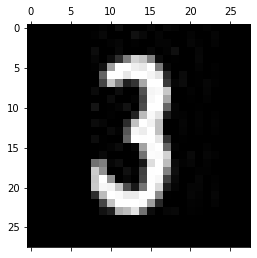

-------------------------------------------
Test: 1918
Predicted: 8


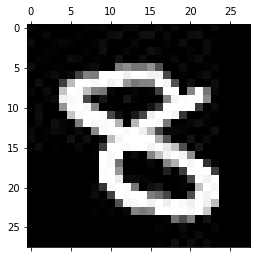

-------------------------------------------
Test: 1919
Predicted: 4


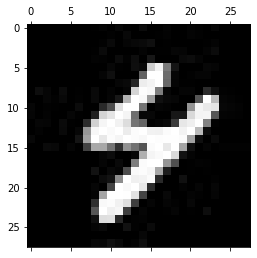

-------------------------------------------
Test: 1920
Predicted: 6


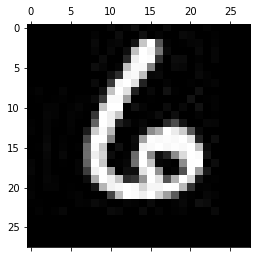

-------------------------------------------
Test: 1921
Predicted: 9


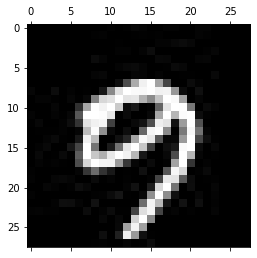

-------------------------------------------
Test: 1922
Predicted: 1


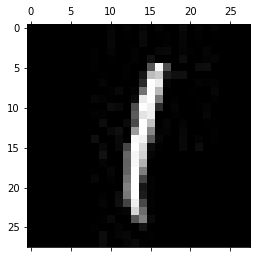

-------------------------------------------
Test: 1923
Predicted: 6


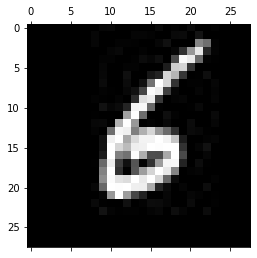

-------------------------------------------
Test: 1924
Predicted: 4


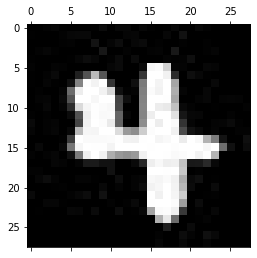

-------------------------------------------
Test: 1925
Predicted: 9


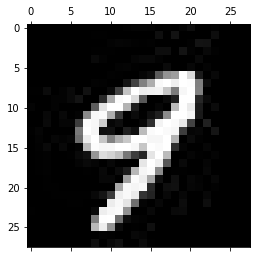

-------------------------------------------
Test: 1926
Predicted: 8


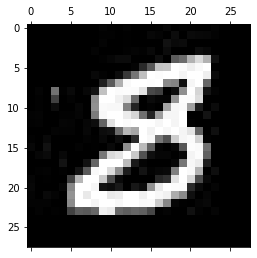

-------------------------------------------
Test: 1927
Predicted: 9


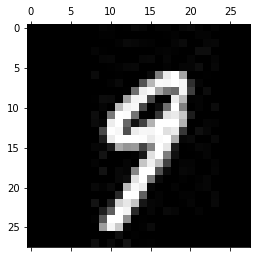

-------------------------------------------
Test: 1928
Predicted: 3


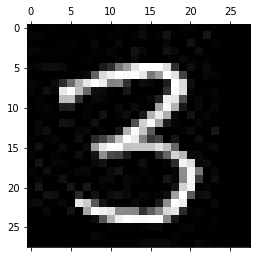

-------------------------------------------
Test: 1929
Predicted: 8


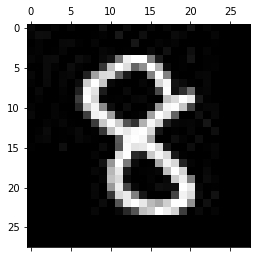

-------------------------------------------
Test: 1930
Predicted: 5


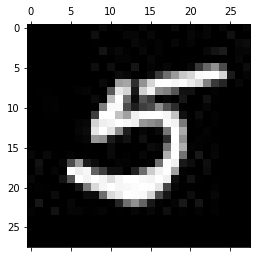

-------------------------------------------
Test: 1931
Predicted: 8


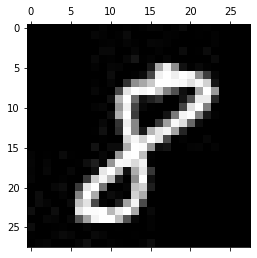

-------------------------------------------
Test: 1932
Predicted: 1


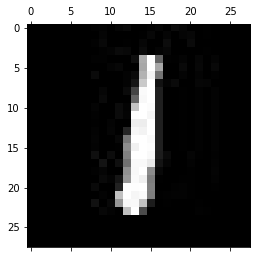

-------------------------------------------
Test: 1933
Predicted: 4


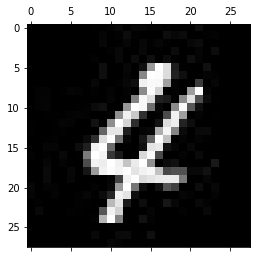

-------------------------------------------
Test: 1934
Predicted: 8


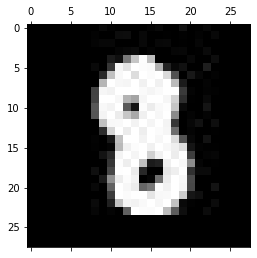

-------------------------------------------
Test: 1935
Predicted: 4


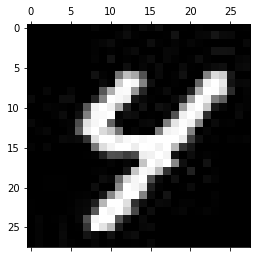

-------------------------------------------
Test: 1936
Predicted: 1


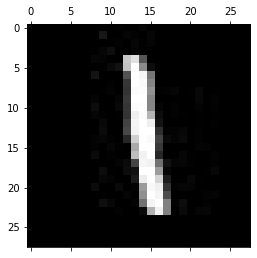

-------------------------------------------
Test: 1937
Predicted: 7


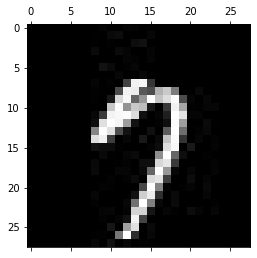

-------------------------------------------
Test: 1938
Predicted: 7


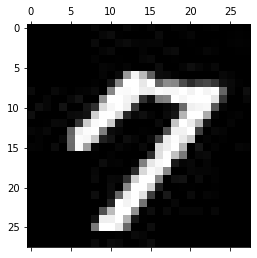

-------------------------------------------
Test: 1939
Predicted: 4


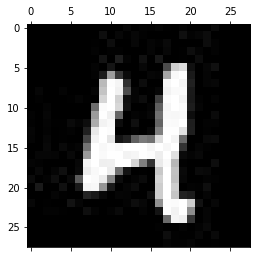

-------------------------------------------
Test: 1940
Predicted: 1


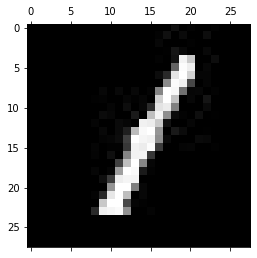

-------------------------------------------
Test: 1941
Predicted: 1


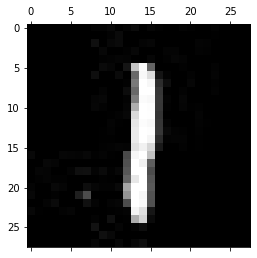

-------------------------------------------
Test: 1942
Predicted: 7


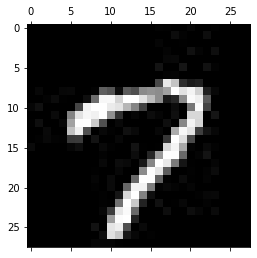

-------------------------------------------
Test: 1943
Predicted: 8


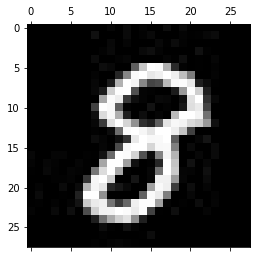

-------------------------------------------
Test: 1944
Predicted: 2


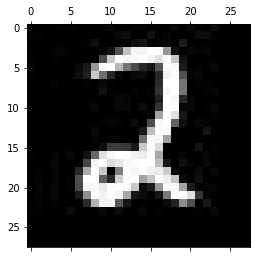

-------------------------------------------
Test: 1945
Predicted: 3


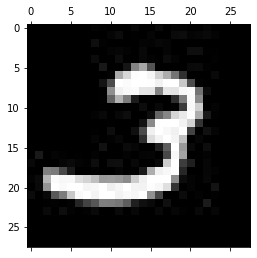

-------------------------------------------
Test: 1946
Predicted: 3


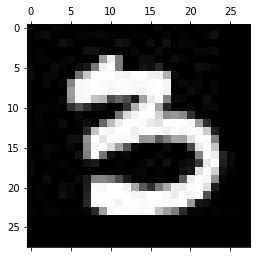

-------------------------------------------
Test: 1947
Predicted: 7


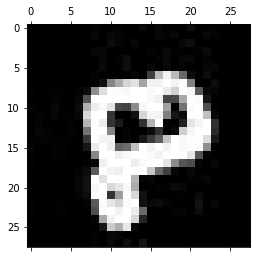

-------------------------------------------
Test: 1948
Predicted: 2


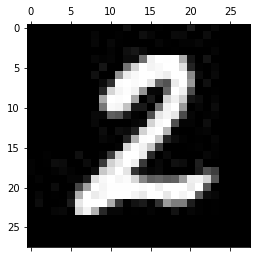

-------------------------------------------
Test: 1949
Predicted: 0


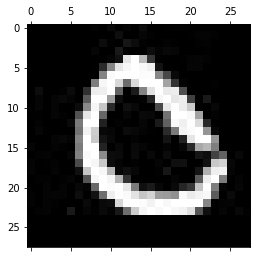

-------------------------------------------
Test: 1950
Predicted: 9


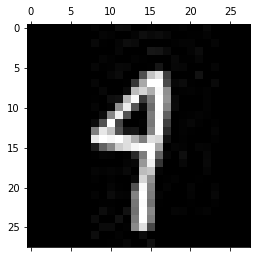

-------------------------------------------
Test: 1951
Predicted: 3


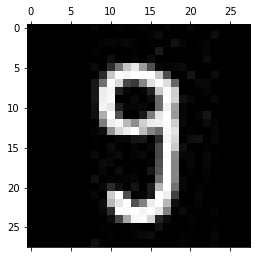

-------------------------------------------
Test: 1952
Predicted: 3


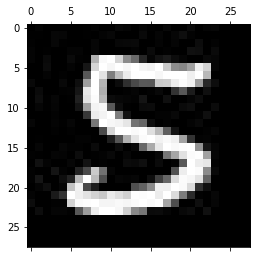

-------------------------------------------
Test: 1953
Predicted: 7


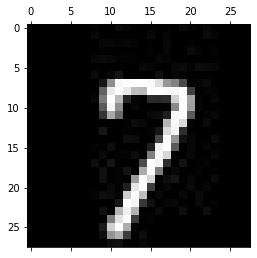

-------------------------------------------
Test: 1954
Predicted: 9


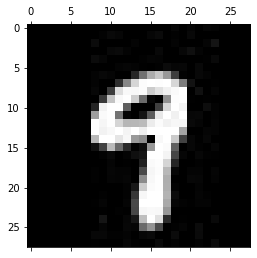

-------------------------------------------
Test: 1955
Predicted: 0


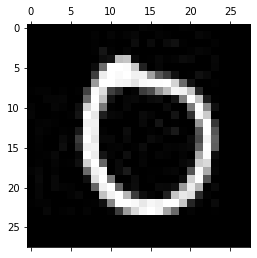

-------------------------------------------
Test: 1956
Predicted: 9


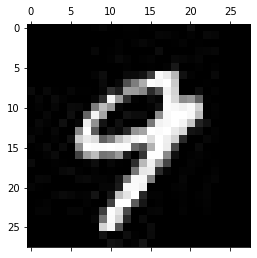

-------------------------------------------
Test: 1957
Predicted: 6


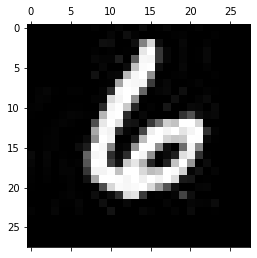

-------------------------------------------
Test: 1958
Predicted: 1


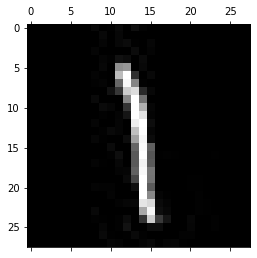

-------------------------------------------
Test: 1959
Predicted: 0


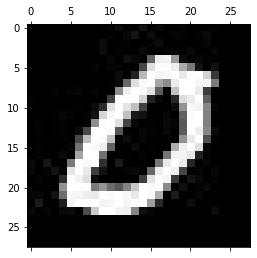

-------------------------------------------
Test: 1960
Predicted: 8


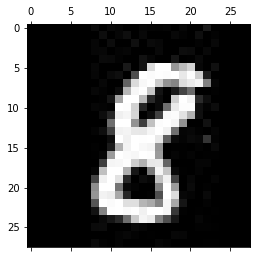

-------------------------------------------
Test: 1961
Predicted: 0


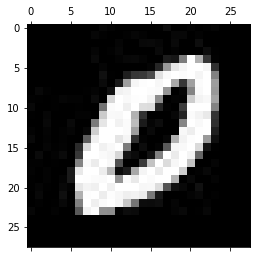

-------------------------------------------
Test: 1962
Predicted: 3


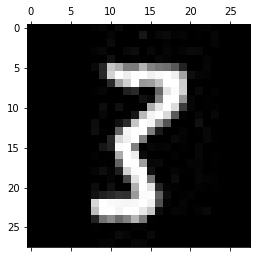

-------------------------------------------
Test: 1963
Predicted: 8


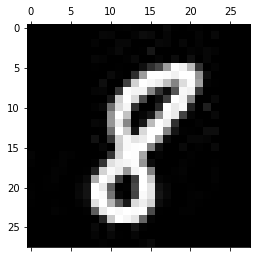

-------------------------------------------
Test: 1964
Predicted: 6


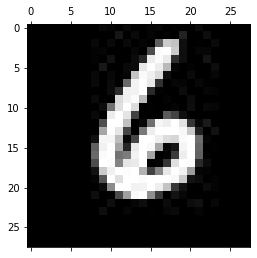

-------------------------------------------
Test: 1965
Predicted: 7


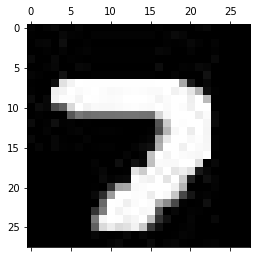

-------------------------------------------
Test: 1966
Predicted: 5


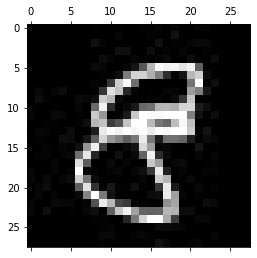

-------------------------------------------
Test: 1967
Predicted: 5


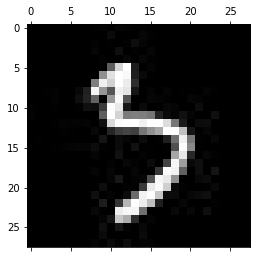

-------------------------------------------
Test: 1968
Predicted: 4


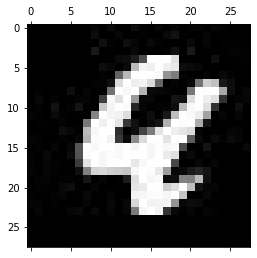

-------------------------------------------
Test: 1969
Predicted: 4


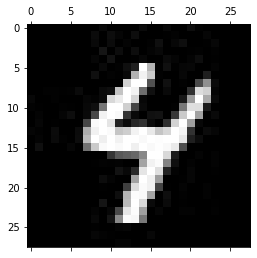

-------------------------------------------
Test: 1970
Predicted: 6


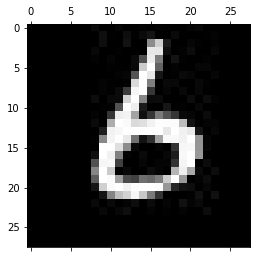

-------------------------------------------
Test: 1971
Predicted: 5


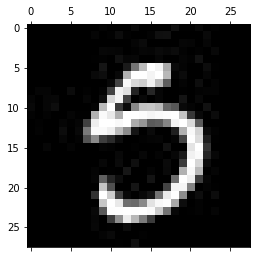

-------------------------------------------
Test: 1972
Predicted: 1


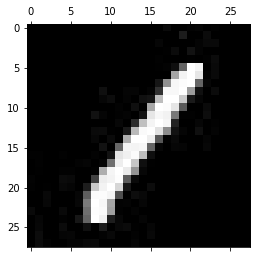

-------------------------------------------
Test: 1973
Predicted: 8


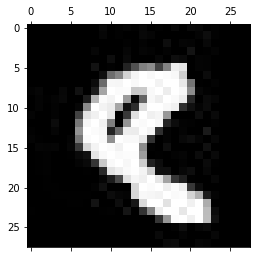

-------------------------------------------
Test: 1974
Predicted: 7


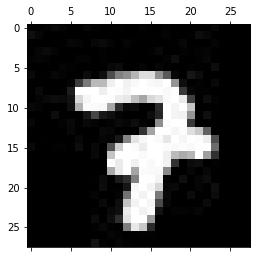

-------------------------------------------
Test: 1975
Predicted: 5


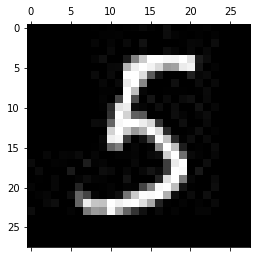

-------------------------------------------
Test: 1976
Predicted: 1


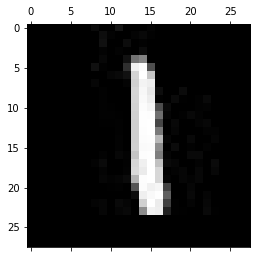

-------------------------------------------
Test: 1977
Predicted: 1


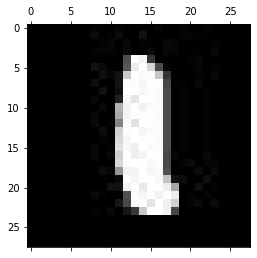

-------------------------------------------
Test: 1978
Predicted: 4


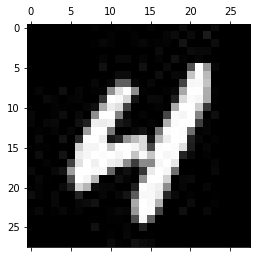

-------------------------------------------
Test: 1979
Predicted: 0


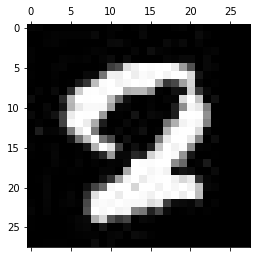

-------------------------------------------
Test: 1980
Predicted: 9


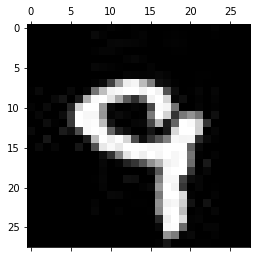

-------------------------------------------
Test: 1981
Predicted: 8


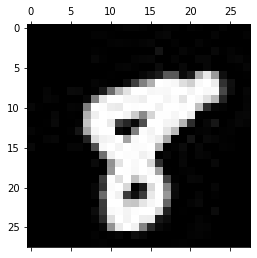

-------------------------------------------
Test: 1982
Predicted: 3


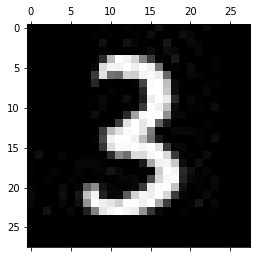

-------------------------------------------
Test: 1983
Predicted: 9


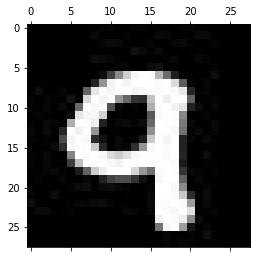

-------------------------------------------
Test: 1984
Predicted: 1


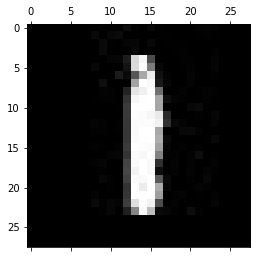

-------------------------------------------
Test: 1985
Predicted: 2


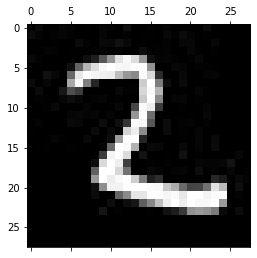

-------------------------------------------
Test: 1986
Predicted: 4


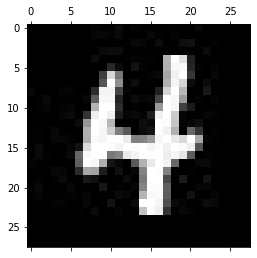

-------------------------------------------
Test: 1987
Predicted: 2


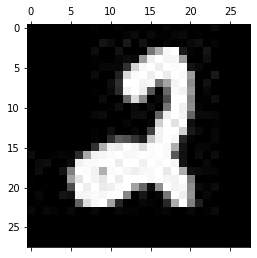

-------------------------------------------
Test: 1988
Predicted: 7


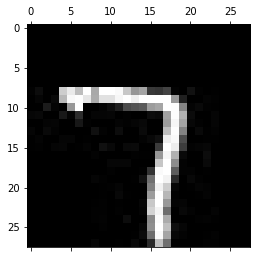

-------------------------------------------
Test: 1989
Predicted: 3


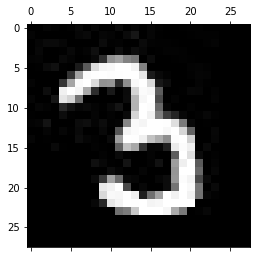

-------------------------------------------
Test: 1990
Predicted: 9


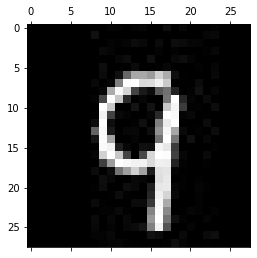

-------------------------------------------
Test: 1991
Predicted: 5


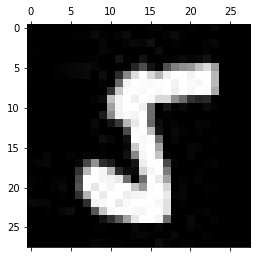

-------------------------------------------
Test: 1992
Predicted: 7


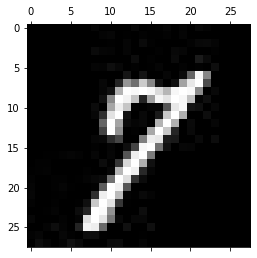

-------------------------------------------
Test: 1993
Predicted: 4


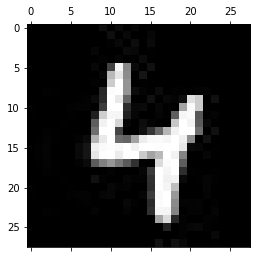

-------------------------------------------
Test: 1994
Predicted: 6


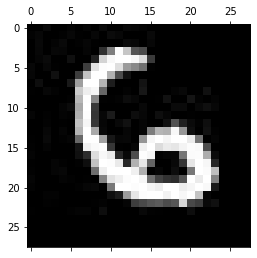

-------------------------------------------
Test: 1995
Predicted: 7


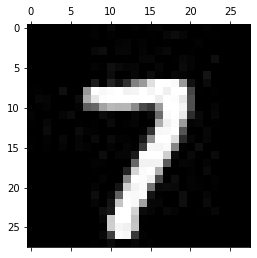

-------------------------------------------
Test: 1996
Predicted: 7


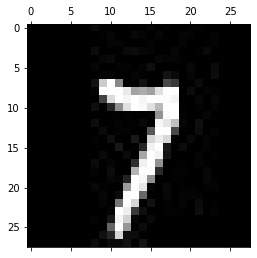

-------------------------------------------
Test: 1997
Predicted: 3


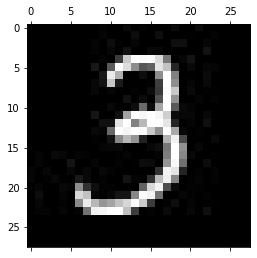

-------------------------------------------
Test: 1998
Predicted: 0


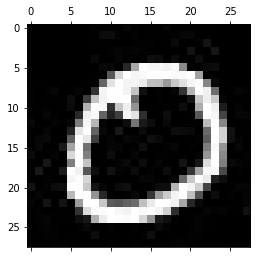

-------------------------------------------
Test: 1999
Predicted: 6


-------------------------------------------
Test: 2000
Predicted: 6


-------------------------------------------
Test Accuracy: 0.8894999999999574


In [170]:
test2(np.array(my_data_test), w1, w2, w3, b1, b2, b3)

#### Result  of using One hidden Layer ANN
Training Accuracy: 89.3%  
Test Accuracy: 88.9%

## Four Hidden Layer

In [24]:
num_features = 784
HiddenLayer_1 = 392
HiddenLayer_2 = 196
HiddenLayer_3 = 98
HiddenLayer_4 = 49
HiddenLayer_5 = 10
def weight_initialize3(mode):
    
    if mode=="random":
        w1 = np.random.random((HiddenLayer_1,   num_features))
        w2 = np.random.random((HiddenLayer_2, HiddenLayer_1))
        w3 = np.random.random((HiddenLayer_3, HiddenLayer_2))
        w4 = np.random.random((HiddenLayer_4, HiddenLayer_3))
        w5 = np.random.random((HiddenLayer_5, HiddenLayer_4))
        b1 = np.random.random((1, HiddenLayer_1))
        b2 =  np.random.random((1, HiddenLayer_2))
        b3 =  np.random.random((1, HiddenLayer_3))
        b4 =  np.random.random((1, HiddenLayer_4))
        b5 =  np.random.random((1, HiddenLayer_5))
        
    elif mode=="xavierNormal":
        w1 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_1+num_features)), size = (HiddenLayer_1,num_features)).astype(np.float32)
        w2 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_1+HiddenLayer_2)), size = (HiddenLayer_2, HiddenLayer_1)).astype(np.float32)
        w3 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_2+HiddenLayer_3)), size = (HiddenLayer_3, HiddenLayer_2)).astype(np.float32)
        w4 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_4+HiddenLayer_3)), size = (HiddenLayer_4, HiddenLayer_3)).astype(np.float32)
        w5 = np.random.normal(loc=0.0, scale = np.sqrt(2/(HiddenLayer_4+HiddenLayer_5)), size = (HiddenLayer_5, HiddenLayer_4)).astype(np.float32)
        
        b1 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_1)), size = (1,HiddenLayer_1)).astype(np.float32)
        b2 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_2)), size = (1,HiddenLayer_2)).astype(np.float32)
        b3 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_3)), size = (1,HiddenLayer_3)).astype(np.float32)
        b4 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_4)), size = (1,HiddenLayer_4)).astype(np.float32)
        b5 = np.random.normal(loc=0.0, scale = np.sqrt(2/(1+HiddenLayer_5)), size = (1,HiddenLayer_5)).astype(np.float32)
    return w1, w2, w3, w4, w5, b1, b2, b3, b4, b5

In [25]:
       
lossArray = []
accArray = []
def forward3(arr,  weight1, weight2, weight3, weight4, weight5, bias1, bias2, bias3, bias4, bias5, learningRate=0.01, epochs=100):
    for epoch in range(epochs):
        acc = 0
        loss = 0
        for index in range(len(arr)):
            inputs, output = preprocess(arr[index])
            
            intermediate1 = np.matmul(inputs, weight1.T) + bias1
            hiddenOutput1 = sigmoid(intermediate1)
            
            intermediate2 = np.matmul(hiddenOutput1, weight2.T) + bias2
            hiddenOutput2 = sigmoid(intermediate2) 
#           
            intermediate3 = np.matmul(hiddenOutput2, weight3.T) + bias3
            hiddenOutput3 = sigmoid(intermediate3) 
            
            intermediate4 = np.matmul(hiddenOutput3, weight4.T) + bias4
            hiddenOutput4 = sigmoid(intermediate4)
            
            intermediate5 = np.matmul(hiddenOutput4, weight5.T) + bias5
            output_pred = softmax(intermediate5) 
            
            check = np.argmax(output_pred)
            output_arr = generateArray(output)
            acc = acc + accuracy(output, check, len(arr))
            loss = loss - catCrossEntropy(output, output_pred)
            
            db5 = (output_pred - output_arr)
            dw5 = np.matmul(db5.T, hiddenOutput4)
        
            db4_4 = np.matmul(np.matmul(db5, weight5).T, hiddenOutput4)
            db4 = np.matmul(db4_4, (1-hiddenOutput4).T)
            dw4 = np.matmul(db4, hiddenOutput3)
            
            db3_3 = np.matmul(np.matmul(db4.T, weight4).T, hiddenOutput3)
            db3 = np.matmul(db3_3, (1-hiddenOutput3).T)
            dw3 = np.matmul(db3, hiddenOutput2)
            
            db2_2 = np.matmul(np.matmul(db3.T, weight3).T, hiddenOutput2)
            db2 = np.matmul(db2_2, (1-hiddenOutput2).T)
            dw2 = np.matmul(db2, hiddenOutput1)
            
            db1_1 = np.matmul(np.matmul(db2.T, weight2).T, hiddenOutput1)
            db1 = np.matmul(db1_1, (1-hiddenOutput1).T)
            dw1 = np.matmul(db1, inputs)
            
            weight1 = weight1 - learningRate * dw1
            bias1 = bias1 - learningRate * db1.T
            
            weight2 = weight2 - learningRate * dw2
            bias2 = bias2 - learningRate * db2.T
            
            weight3 = weight3 - learningRate * dw3
            bias3 = bias3 - learningRate * db3.T
            
            weight4 = weight4 - learningRate * dw4
            bias4 = bias4 - learningRate * db4.T
            
            weight5 = weight5 - learningRate * dw5
            bias5 = bias5 - learningRate * db5
        
        lossArray.append(loss)
        accArray.append(acc)
        print(f"Epoch: {epoch+1}")
        print(f"Accuracy: {acc} and Loss: {loss}")
        print('-------------------------------------------------------------')
    return weight1, weight2, weight3, weight4, weight5, bias1, bias2, bias3, bias4, bias5

In [208]:
weight1, weight2, weight3, weight4, weight5, bias1, bias2, bias3, bias4, bias5 = weight_initialize3(mode="xavierNormal")
w1, w2, w3, w4, w5, b1, b2, b3, b4, b5= forward3(my_data_train, weight1, weight2, weight3, weight4, weight5, bias1, bias2, bias3, bias4, bias5, learningRate=0.001, epochs=20)

<ipython-input-43-354d69a29eaf>:2: RuntimeWarning: overflow encountered in exp
  return 1. / (1. + np.exp(-x))


Epoch: 1
Accuracy: 0.21852499999998 and Loss: 79843.4946526873
-------------------------------------------------------------
Epoch: 2
Accuracy: 0.29117499999997204 and Loss: 70830.0794012126
-------------------------------------------------------------
Epoch: 3
Accuracy: 0.2858999999999726 and Loss: 71285.54624180507
-------------------------------------------------------------
Epoch: 4
Accuracy: 0.4031249999999597 and Loss: 62426.878824621526
-------------------------------------------------------------
Epoch: 5
Accuracy: 0.5468500000000479 and Loss: 49947.77128250603
-------------------------------------------------------------
Epoch: 6
Accuracy: 0.5583500000000722 and Loss: 49006.66091380433
-------------------------------------------------------------
Epoch: 7
Accuracy: 0.45162499999995437 and Loss: 59007.18308252807
-------------------------------------------------------------
Epoch: 8
Accuracy: 0.464049999999953 and Loss: 57223.49383501629
----------------------------------------

In [209]:
def test3(data_path, weight1, weight2, weight3, weight4, weight5, bias1, bias2, bias3, bias4, bias5):
    acc = 0
    for idx, item in enumerate(data_path):
        img_path, output = item
        img = cv2.imread(img_path)
        imgs = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
        img_out = imgs[:,:,0]/255.0
        input_x = np.array(img_out).reshape(1,784)
        intermediate1 = np.matmul(input_x, weight1.T) + bias1 
#         intermediate12 = intermediate1 + 
        hiddenOutput1 = sigmoid(intermediate1)
        intermediate2 = np.matmul(hiddenOutput1, weight2.T) + bias2
#         intermediate21 = intermediate2 + bias2 
        hiddenOutput2 = sigmoid(intermediate2) 
        intermediate3 = np.matmul(hiddenOutput2, weight3.T) + bias3
        hiddenOutput3 = sigmoid(intermediate3) 
        intermediate4 = np.matmul(hiddenOutput3, weight4.T) + bias4
        hiddenOutput4 = sigmoid(intermediate4) 
        intermediate5 = np.matmul(hiddenOutput4, weight5.T) + bias5
        output_pred = softmax(intermediate5)
        check = np.argmax(output_pred)
        acc+=accuracy(int(output), check, len(data_path))
        print(f'Test: {idx+1}')
        print(f'Predicted: {check}')
        plt.matshow(img)
        plt.pause(0.01)
        print(f'-------------------------------------------')
    print(f"Test Accuracy: {acc}")

Test: 1
Predicted: 8


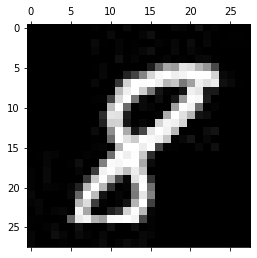

-------------------------------------------
Test: 2
Predicted: 8


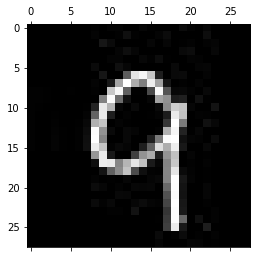

-------------------------------------------
Test: 3
Predicted: 8


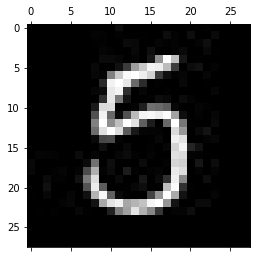

-------------------------------------------
Test: 4
Predicted: 8


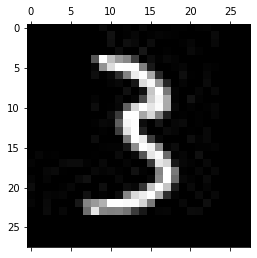

-------------------------------------------
Test: 5
Predicted: 8


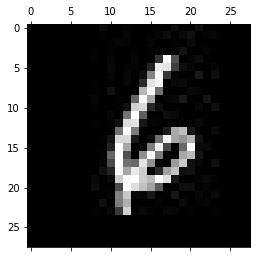

-------------------------------------------
Test: 6
Predicted: 8


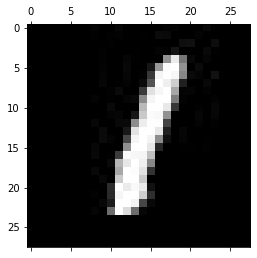

-------------------------------------------
Test: 7
Predicted: 8


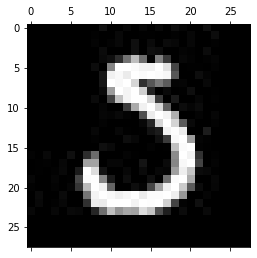

-------------------------------------------
Test: 8
Predicted: 8


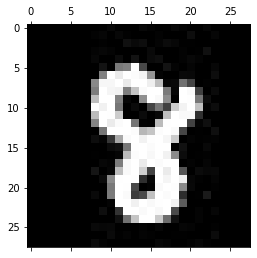

-------------------------------------------
Test: 9
Predicted: 8


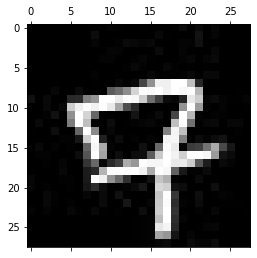

-------------------------------------------
Test: 10
Predicted: 8


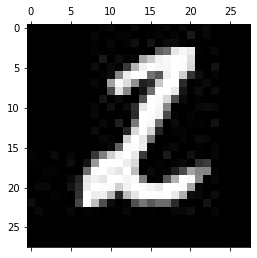

-------------------------------------------
Test: 11
Predicted: 8


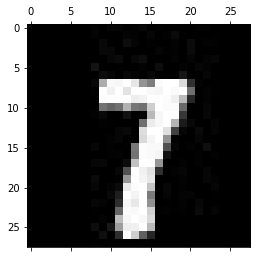

-------------------------------------------
Test: 12
Predicted: 8


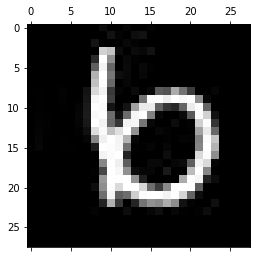

-------------------------------------------
Test: 13
Predicted: 8


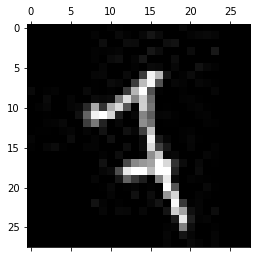

-------------------------------------------
Test: 14
Predicted: 8


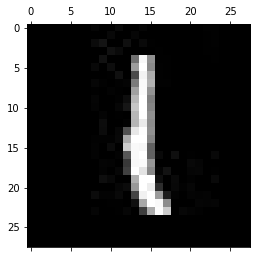

-------------------------------------------
Test: 15
Predicted: 8


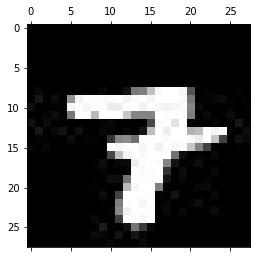

-------------------------------------------
Test: 16
Predicted: 8


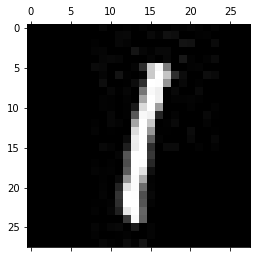

-------------------------------------------
Test: 17
Predicted: 8


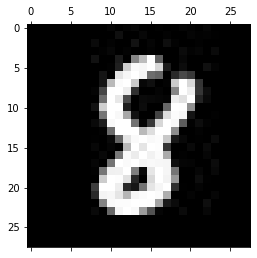

-------------------------------------------
Test: 18
Predicted: 8


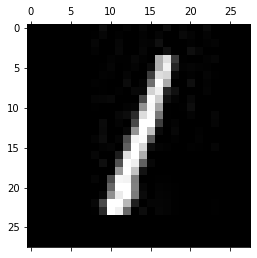

-------------------------------------------
Test: 19
Predicted: 8


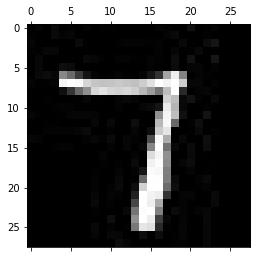

-------------------------------------------
Test: 20
Predicted: 8


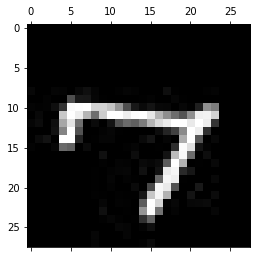

-------------------------------------------
Test: 21
Predicted: 8


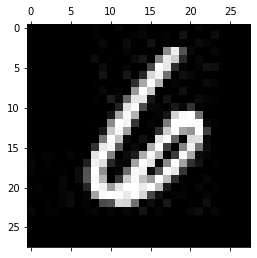

-------------------------------------------
Test: 22
Predicted: 8


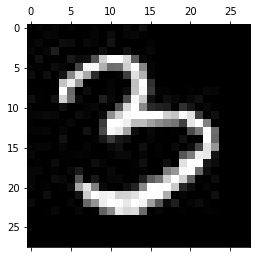

-------------------------------------------
Test: 23
Predicted: 8


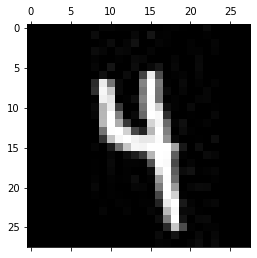

-------------------------------------------
Test: 24
Predicted: 8


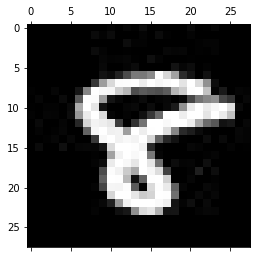

-------------------------------------------
Test: 25
Predicted: 8


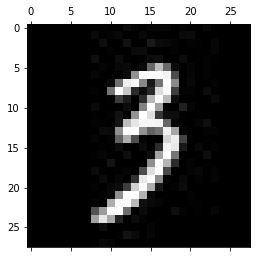

-------------------------------------------
Test: 26
Predicted: 8


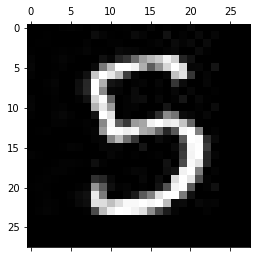

-------------------------------------------
Test: 27
Predicted: 8


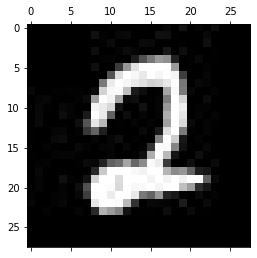

-------------------------------------------
Test: 28
Predicted: 8


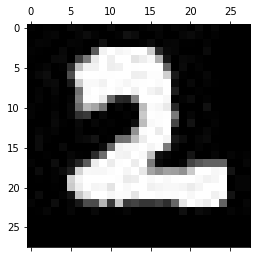

-------------------------------------------
Test: 29
Predicted: 8


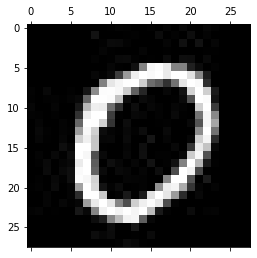

-------------------------------------------
Test: 30
Predicted: 8


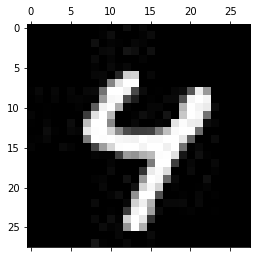

-------------------------------------------
Test: 31
Predicted: 8


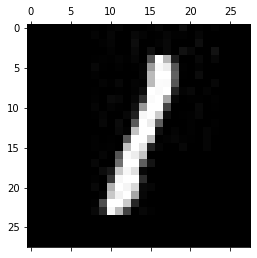

-------------------------------------------
Test: 32
Predicted: 8


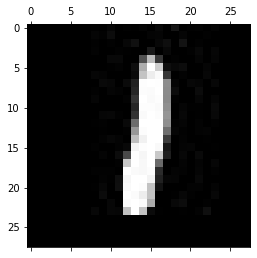

-------------------------------------------
Test: 33
Predicted: 8


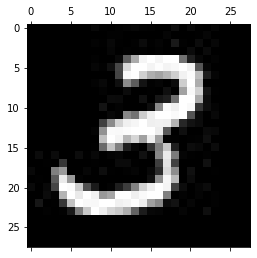

-------------------------------------------
Test: 34
Predicted: 8


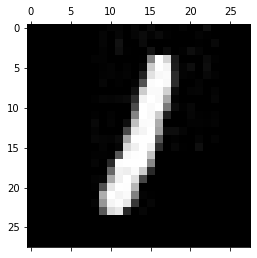

-------------------------------------------
Test: 35
Predicted: 8


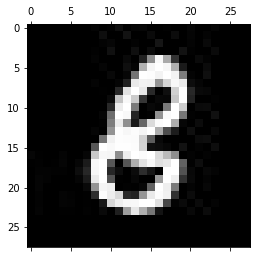

-------------------------------------------
Test: 36
Predicted: 8


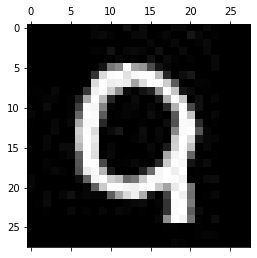

-------------------------------------------
Test: 37
Predicted: 8


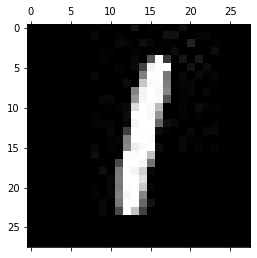

-------------------------------------------
Test: 38
Predicted: 8


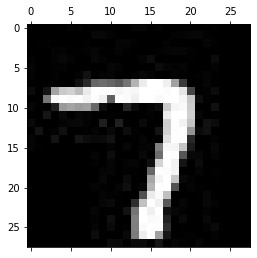

-------------------------------------------
Test: 39
Predicted: 8


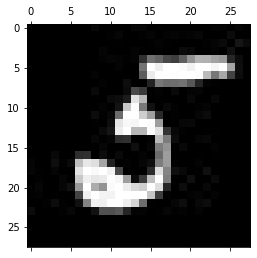

-------------------------------------------
Test: 40
Predicted: 8


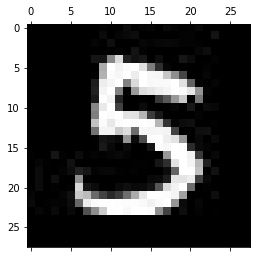

-------------------------------------------
Test: 41
Predicted: 8


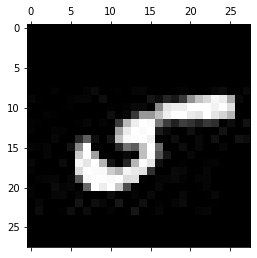

-------------------------------------------
Test: 42
Predicted: 8


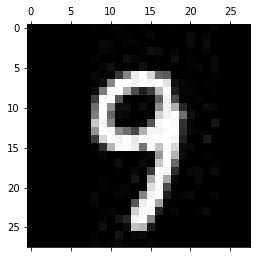

-------------------------------------------
Test: 43
Predicted: 8


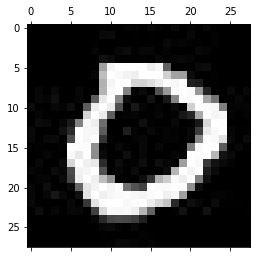

-------------------------------------------
Test: 44
Predicted: 8


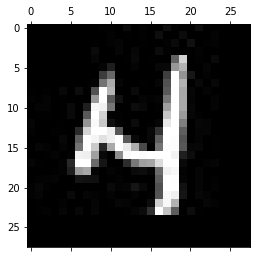

-------------------------------------------
Test: 45
Predicted: 8


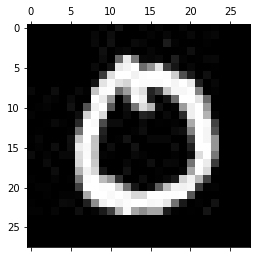

-------------------------------------------
Test: 46
Predicted: 8


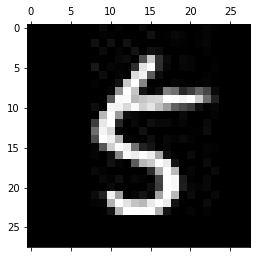

-------------------------------------------
Test: 47
Predicted: 8


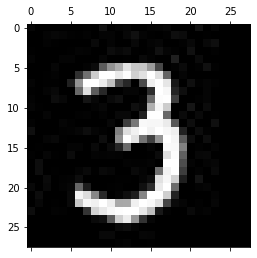

-------------------------------------------
Test: 48
Predicted: 8


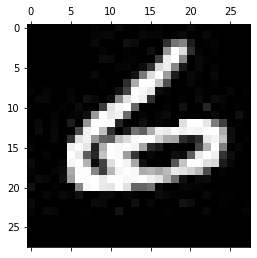

-------------------------------------------
Test: 49
Predicted: 8


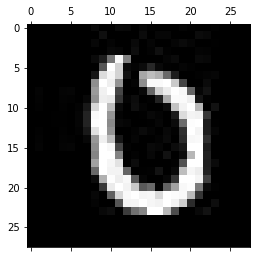

-------------------------------------------
Test: 50
Predicted: 8


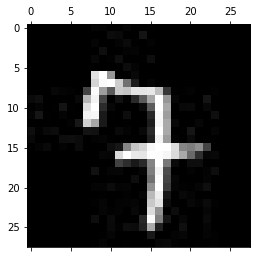

-------------------------------------------
Test: 51
Predicted: 8


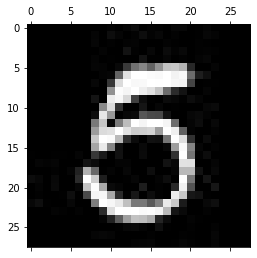

-------------------------------------------
Test: 52
Predicted: 8


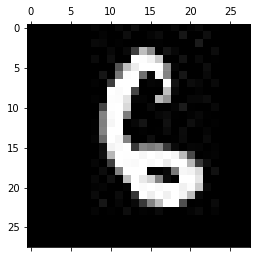

-------------------------------------------
Test: 53
Predicted: 8


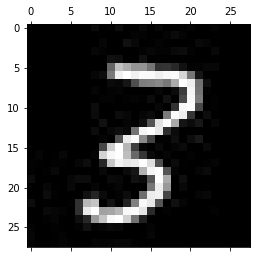

-------------------------------------------
Test: 54
Predicted: 8


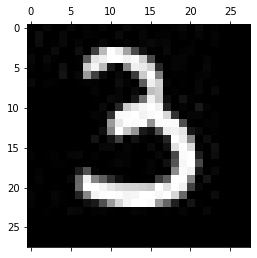

-------------------------------------------
Test: 55
Predicted: 8


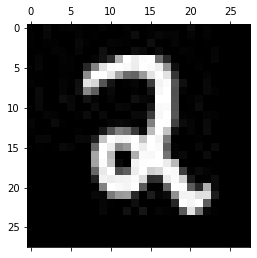

-------------------------------------------
Test: 56
Predicted: 8


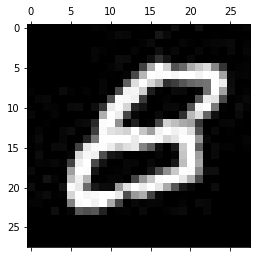

-------------------------------------------
Test: 57
Predicted: 8


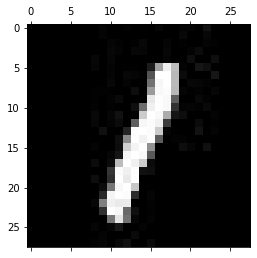

-------------------------------------------
Test: 58
Predicted: 8


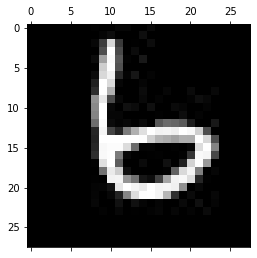

-------------------------------------------
Test: 59
Predicted: 8


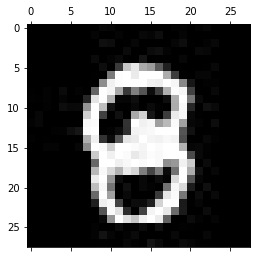

-------------------------------------------
Test: 60
Predicted: 8


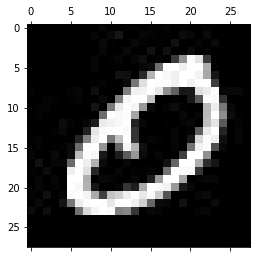

-------------------------------------------
Test: 61
Predicted: 8


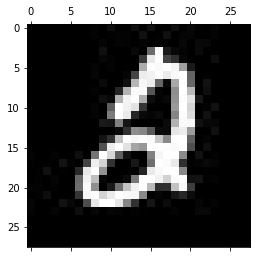

-------------------------------------------
Test: 62
Predicted: 8


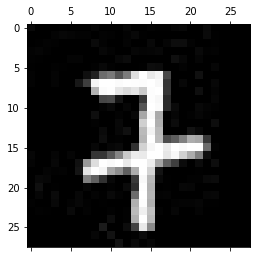

-------------------------------------------
Test: 63
Predicted: 8


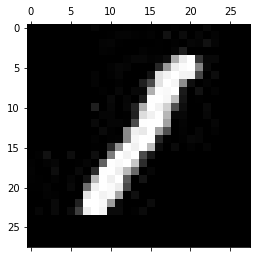

-------------------------------------------
Test: 64
Predicted: 8


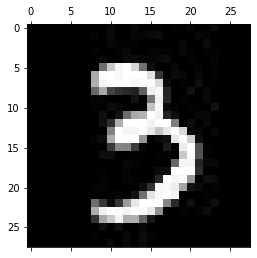

-------------------------------------------
Test: 65
Predicted: 8


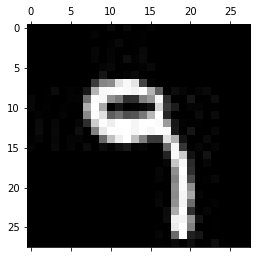

-------------------------------------------
Test: 66
Predicted: 8


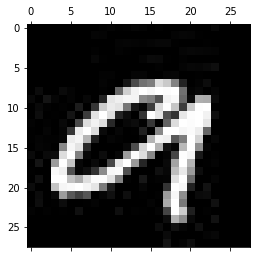

-------------------------------------------
Test: 67
Predicted: 8


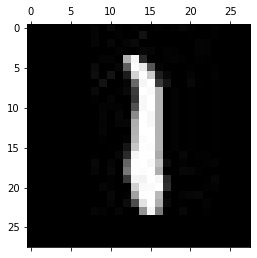

-------------------------------------------
Test: 68
Predicted: 8


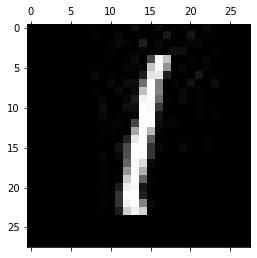

-------------------------------------------
Test: 69
Predicted: 8


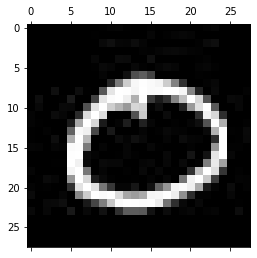

-------------------------------------------
Test: 70
Predicted: 8


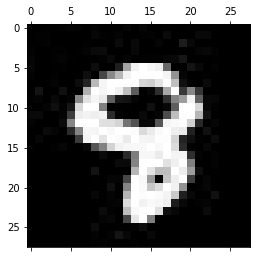

-------------------------------------------
Test: 71
Predicted: 8


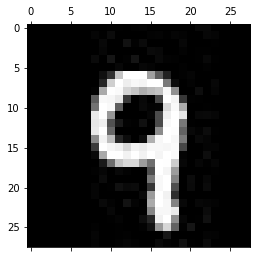

-------------------------------------------
Test: 72
Predicted: 8


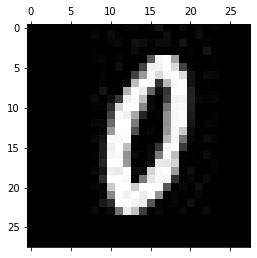

-------------------------------------------
Test: 73
Predicted: 8


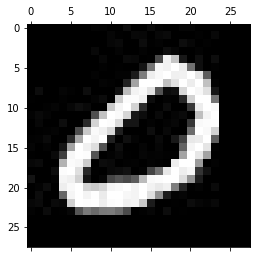

-------------------------------------------
Test: 74
Predicted: 8


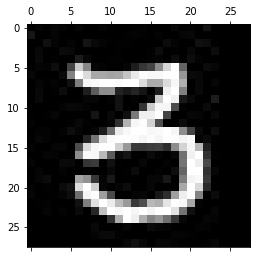

-------------------------------------------
Test: 75
Predicted: 8


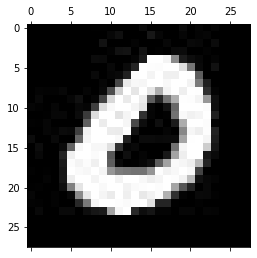

-------------------------------------------
Test: 76
Predicted: 8


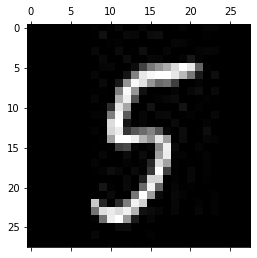

-------------------------------------------
Test: 77
Predicted: 8


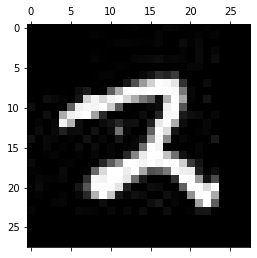

-------------------------------------------
Test: 78
Predicted: 8


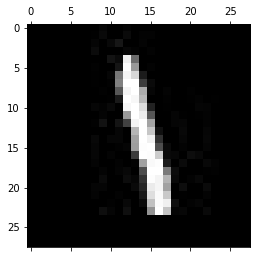

-------------------------------------------
Test: 79
Predicted: 8


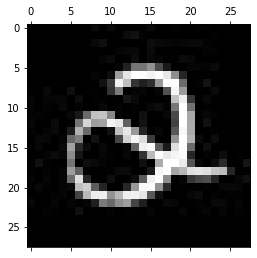

-------------------------------------------
Test: 80
Predicted: 8


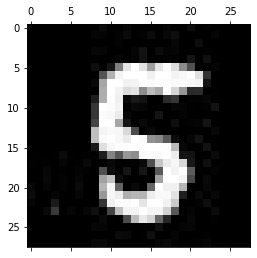

-------------------------------------------
Test: 81
Predicted: 8


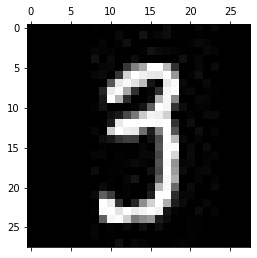

-------------------------------------------
Test: 82
Predicted: 8


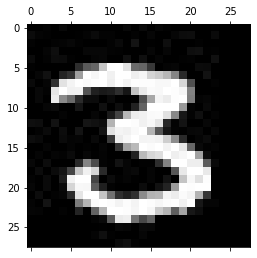

-------------------------------------------
Test: 83
Predicted: 8


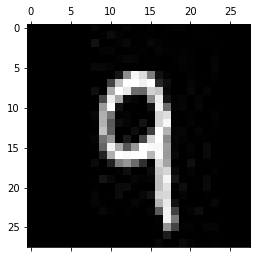

-------------------------------------------
Test: 84
Predicted: 8


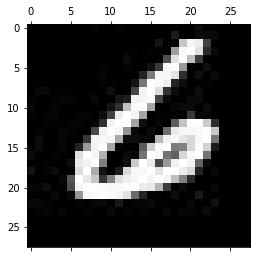

-------------------------------------------
Test: 85
Predicted: 8


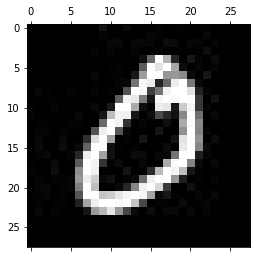

-------------------------------------------
Test: 86
Predicted: 8


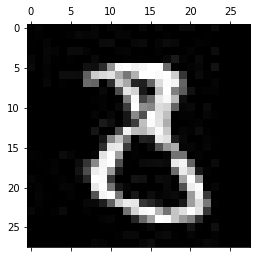

-------------------------------------------
Test: 87
Predicted: 8


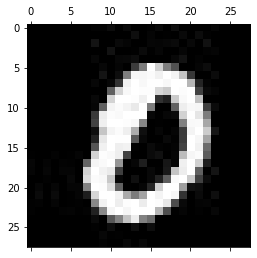

-------------------------------------------
Test: 88
Predicted: 8


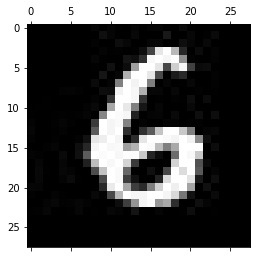

-------------------------------------------
Test: 89
Predicted: 8


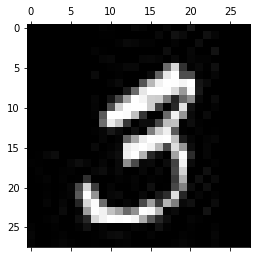

-------------------------------------------
Test: 90
Predicted: 8


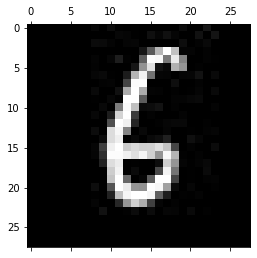

-------------------------------------------
Test: 91
Predicted: 8


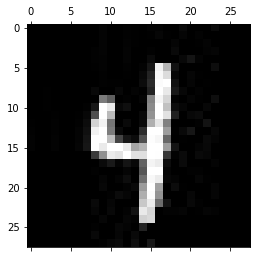

-------------------------------------------
Test: 92
Predicted: 8


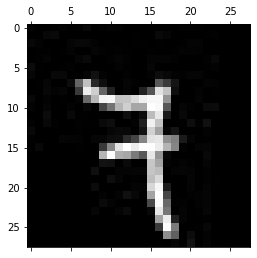

-------------------------------------------
Test: 93
Predicted: 8


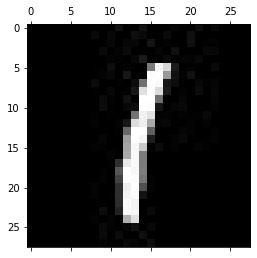

-------------------------------------------
Test: 94
Predicted: 8


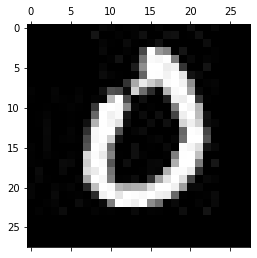

-------------------------------------------
Test: 95
Predicted: 8


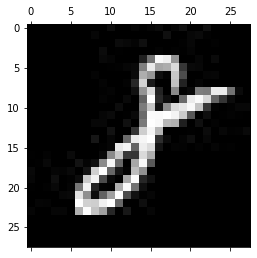

-------------------------------------------
Test: 96
Predicted: 8


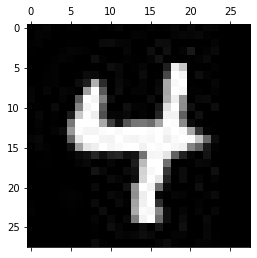

-------------------------------------------
Test: 97
Predicted: 8


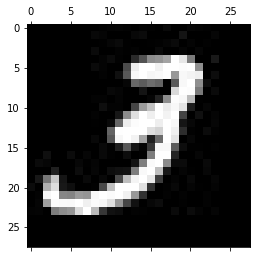

-------------------------------------------
Test: 98
Predicted: 8


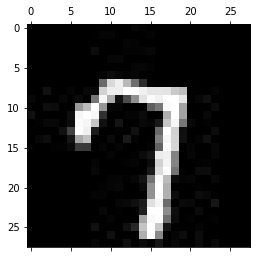

-------------------------------------------
Test: 99
Predicted: 8


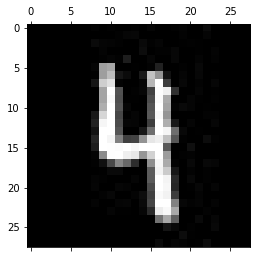

-------------------------------------------
Test: 100
Predicted: 8


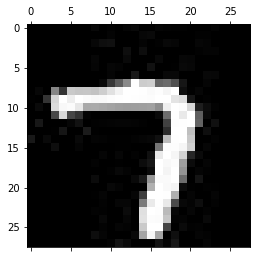

-------------------------------------------
Test: 101
Predicted: 8


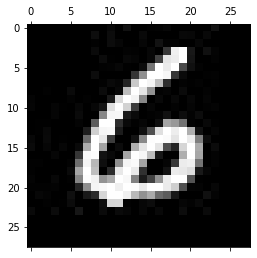

-------------------------------------------
Test: 102
Predicted: 8


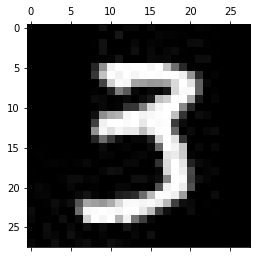

-------------------------------------------
Test: 103
Predicted: 8


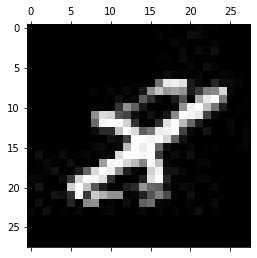

-------------------------------------------
Test: 104
Predicted: 8


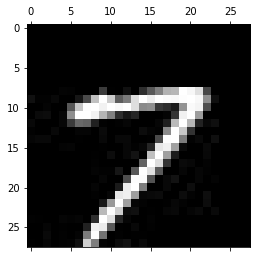

-------------------------------------------
Test: 105
Predicted: 8


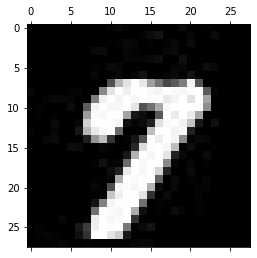

-------------------------------------------
Test: 106
Predicted: 8


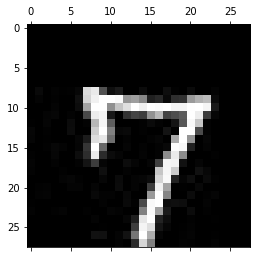

-------------------------------------------
Test: 107
Predicted: 8


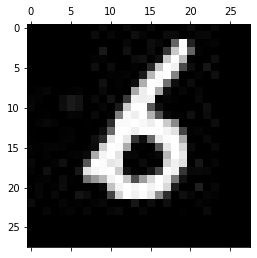

-------------------------------------------
Test: 108
Predicted: 8


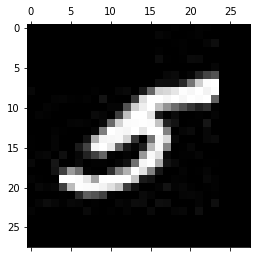

-------------------------------------------
Test: 109
Predicted: 8


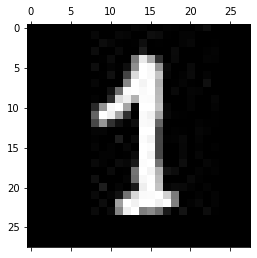

-------------------------------------------
Test: 110
Predicted: 8


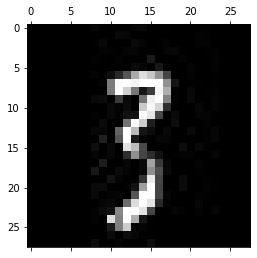

-------------------------------------------
Test: 111
Predicted: 8


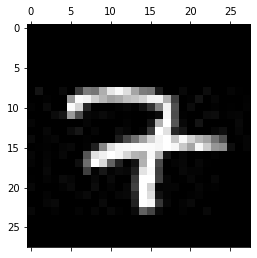

-------------------------------------------
Test: 112
Predicted: 8


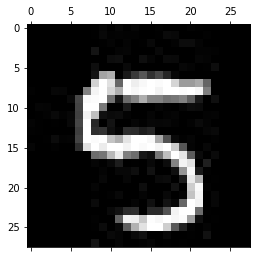

-------------------------------------------
Test: 113
Predicted: 8


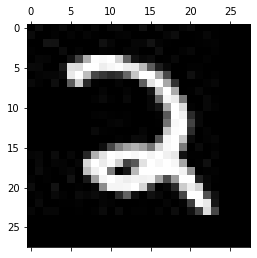

-------------------------------------------
Test: 114
Predicted: 8


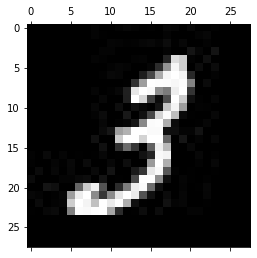

-------------------------------------------
Test: 115
Predicted: 8


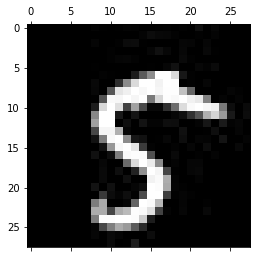

-------------------------------------------
Test: 116
Predicted: 8


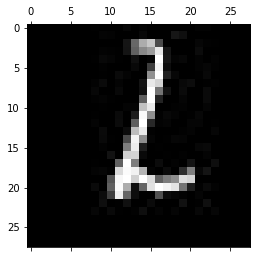

-------------------------------------------
Test: 117
Predicted: 8


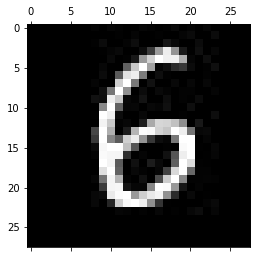

-------------------------------------------
Test: 118
Predicted: 8


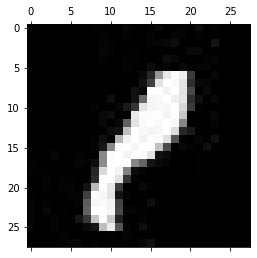

-------------------------------------------
Test: 119
Predicted: 8


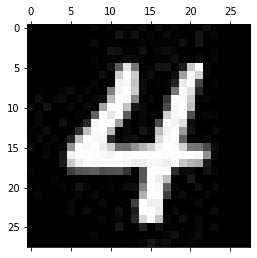

-------------------------------------------
Test: 120
Predicted: 8


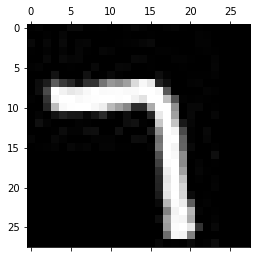

-------------------------------------------
Test: 121
Predicted: 8


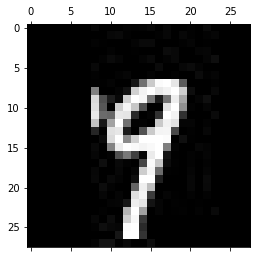

-------------------------------------------
Test: 122
Predicted: 8


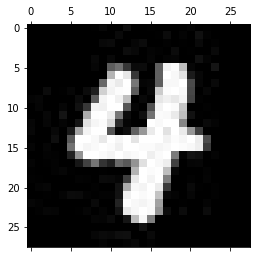

-------------------------------------------
Test: 123
Predicted: 8


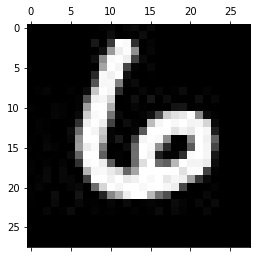

-------------------------------------------
Test: 124
Predicted: 8


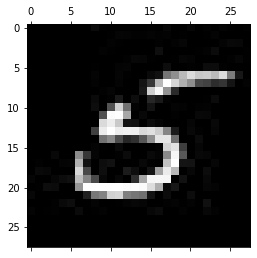

-------------------------------------------
Test: 125
Predicted: 8


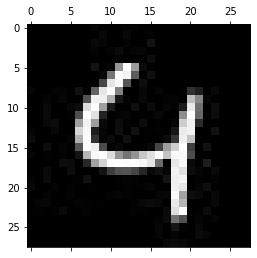

-------------------------------------------
Test: 126
Predicted: 8


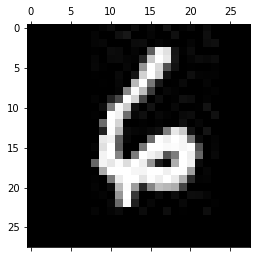

-------------------------------------------
Test: 127
Predicted: 8


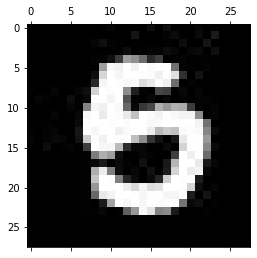

-------------------------------------------
Test: 128
Predicted: 8


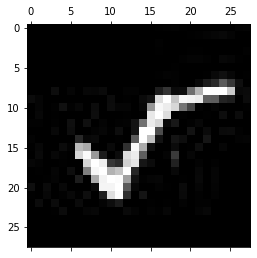

-------------------------------------------
Test: 129
Predicted: 8


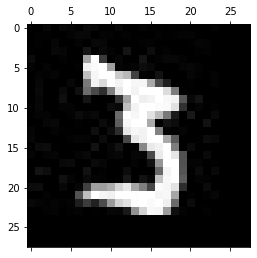

-------------------------------------------
Test: 130
Predicted: 8


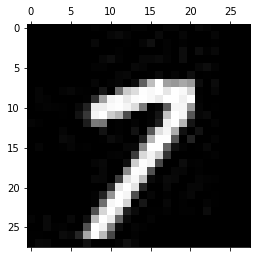

-------------------------------------------
Test: 131
Predicted: 8


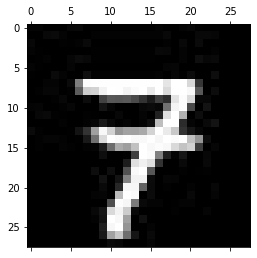

-------------------------------------------
Test: 132
Predicted: 8


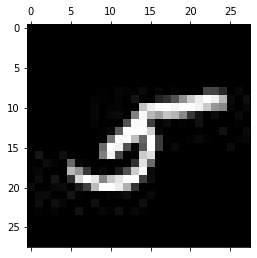

-------------------------------------------
Test: 133
Predicted: 8


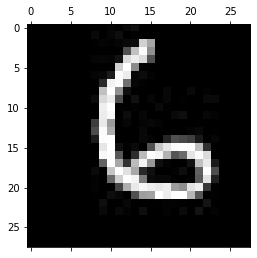

-------------------------------------------
Test: 134
Predicted: 8


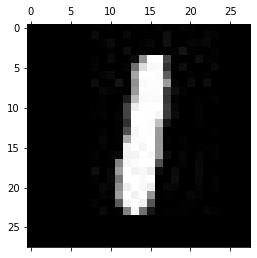

-------------------------------------------
Test: 135
Predicted: 8


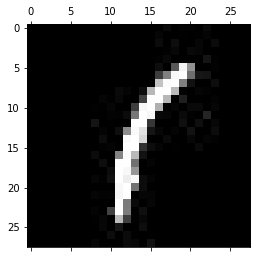

-------------------------------------------
Test: 136
Predicted: 8


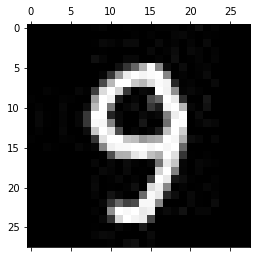

-------------------------------------------
Test: 137
Predicted: 8


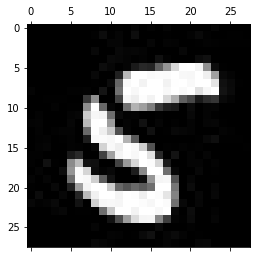

-------------------------------------------
Test: 138
Predicted: 8


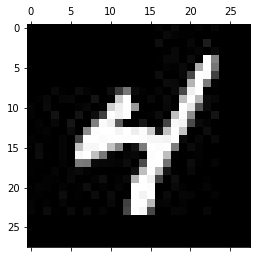

-------------------------------------------
Test: 139
Predicted: 8


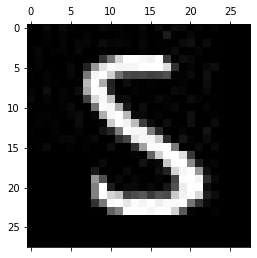

-------------------------------------------
Test: 140
Predicted: 8


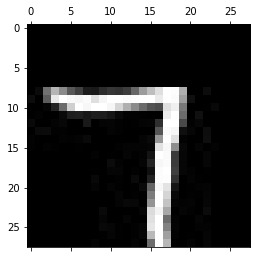

-------------------------------------------
Test: 141
Predicted: 8


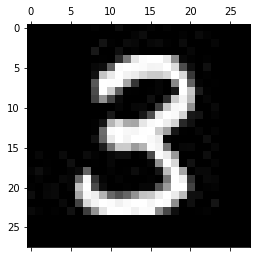

-------------------------------------------
Test: 142
Predicted: 8


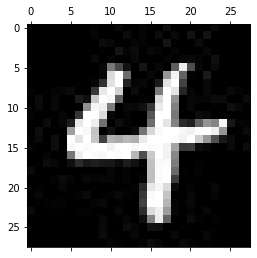

-------------------------------------------
Test: 143
Predicted: 8


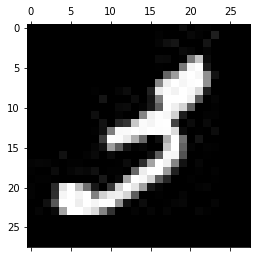

-------------------------------------------
Test: 144
Predicted: 8


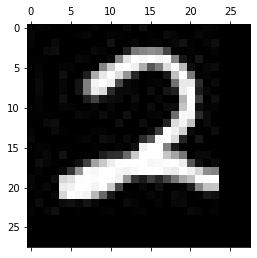

-------------------------------------------
Test: 145
Predicted: 8


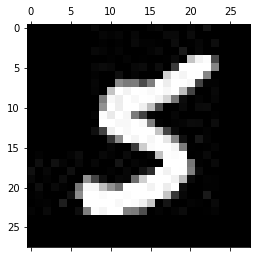

-------------------------------------------
Test: 146
Predicted: 8


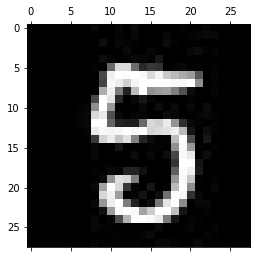

-------------------------------------------
Test: 147
Predicted: 8


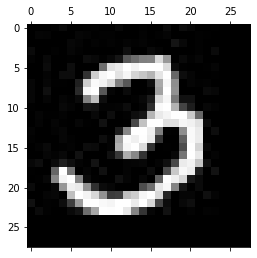

-------------------------------------------
Test: 148
Predicted: 8


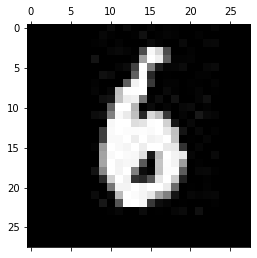

-------------------------------------------
Test: 149
Predicted: 8


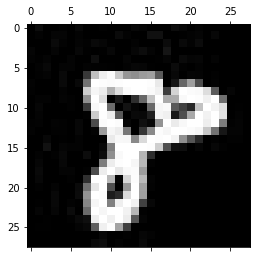

-------------------------------------------
Test: 150
Predicted: 8


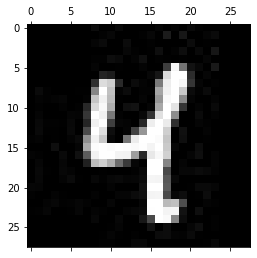

-------------------------------------------
Test: 151
Predicted: 8


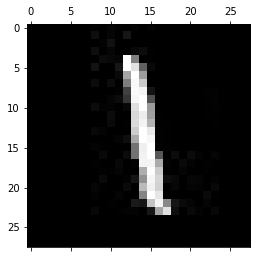

-------------------------------------------
Test: 152
Predicted: 8


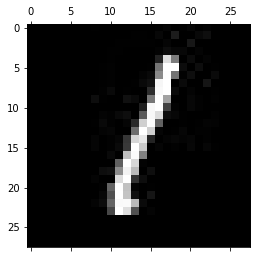

-------------------------------------------
Test: 153
Predicted: 8


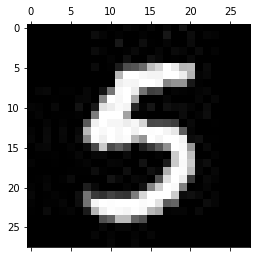

-------------------------------------------
Test: 154
Predicted: 8


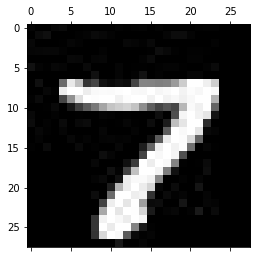

-------------------------------------------
Test: 155
Predicted: 8


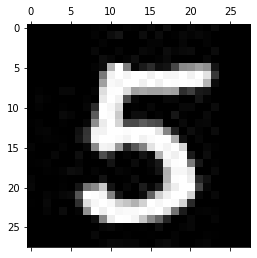

-------------------------------------------
Test: 156
Predicted: 8


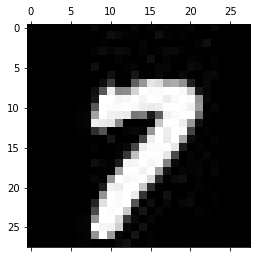

-------------------------------------------
Test: 157
Predicted: 8


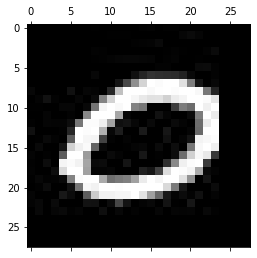

-------------------------------------------
Test: 158
Predicted: 8


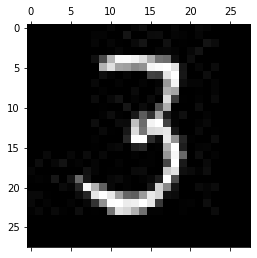

-------------------------------------------
Test: 159
Predicted: 8


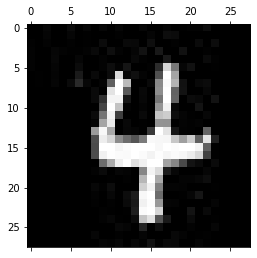

-------------------------------------------
Test: 160
Predicted: 8


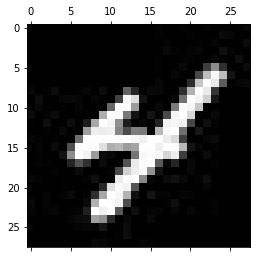

-------------------------------------------
Test: 161
Predicted: 8


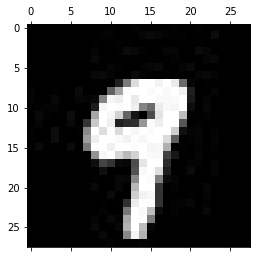

-------------------------------------------
Test: 162
Predicted: 8


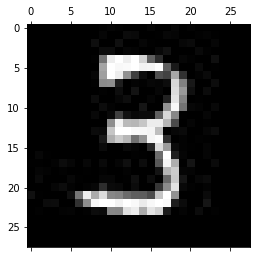

-------------------------------------------
Test: 163
Predicted: 8


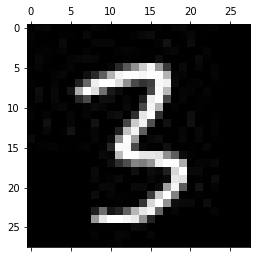

-------------------------------------------
Test: 164
Predicted: 8


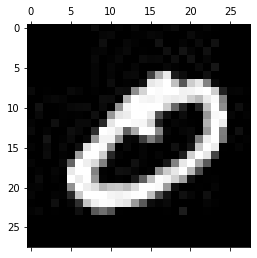

-------------------------------------------
Test: 165
Predicted: 8


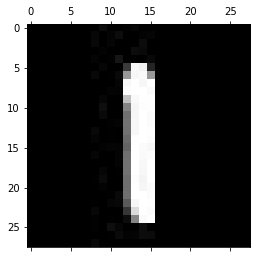

-------------------------------------------
Test: 166
Predicted: 8


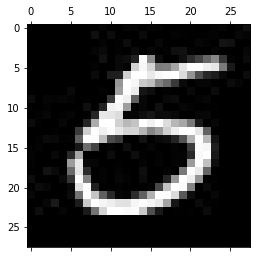

-------------------------------------------
Test: 167
Predicted: 8


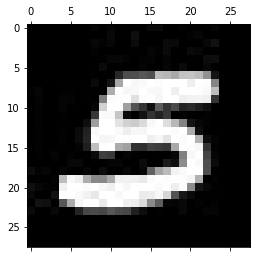

-------------------------------------------
Test: 168
Predicted: 8


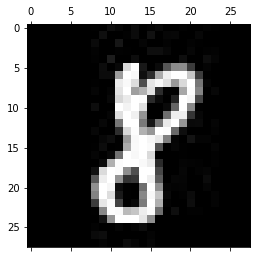

-------------------------------------------
Test: 169
Predicted: 8


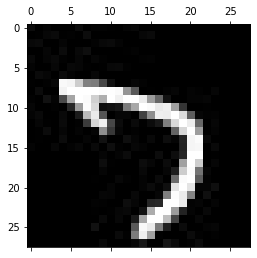

-------------------------------------------
Test: 170
Predicted: 8


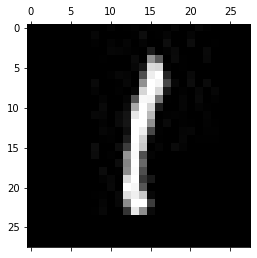

-------------------------------------------
Test: 171
Predicted: 8


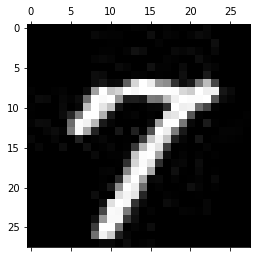

-------------------------------------------
Test: 172
Predicted: 8


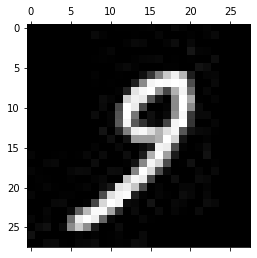

-------------------------------------------
Test: 173
Predicted: 8


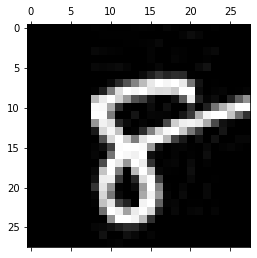

-------------------------------------------
Test: 174
Predicted: 8


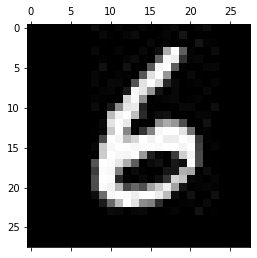

-------------------------------------------
Test: 175
Predicted: 8


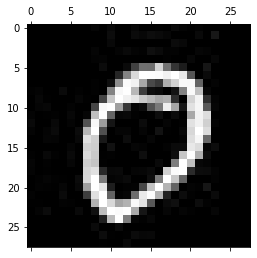

-------------------------------------------
Test: 176
Predicted: 8


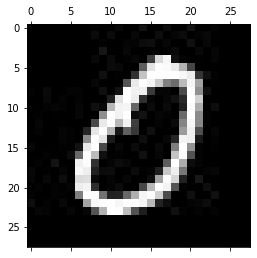

-------------------------------------------
Test: 177
Predicted: 8


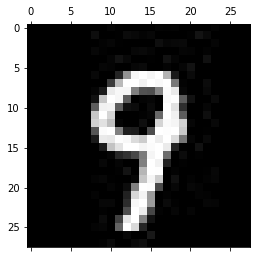

-------------------------------------------
Test: 178
Predicted: 8


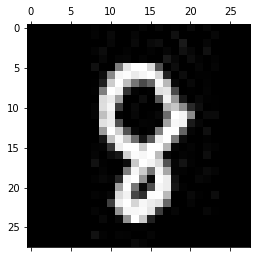

-------------------------------------------
Test: 179
Predicted: 8


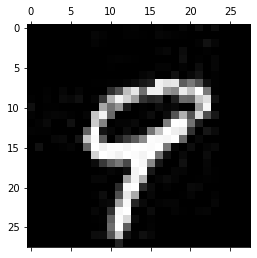

-------------------------------------------
Test: 180
Predicted: 8


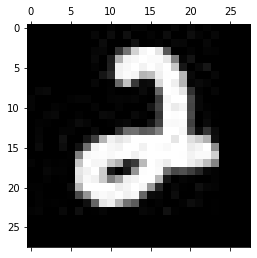

-------------------------------------------
Test: 181
Predicted: 8


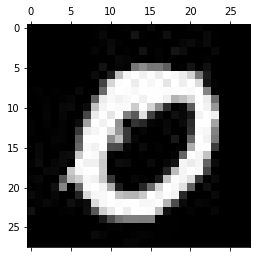

-------------------------------------------
Test: 182
Predicted: 8


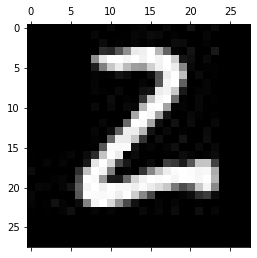

-------------------------------------------
Test: 183
Predicted: 8


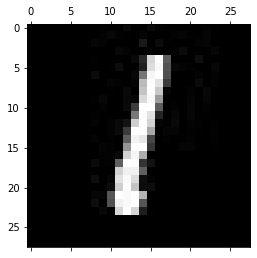

-------------------------------------------
Test: 184
Predicted: 8


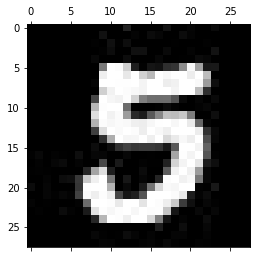

-------------------------------------------
Test: 185
Predicted: 8


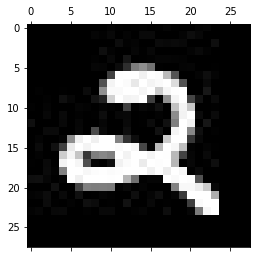

-------------------------------------------
Test: 186
Predicted: 8


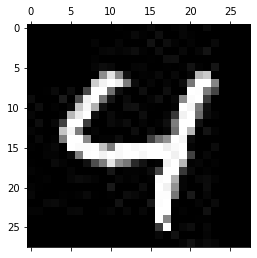

-------------------------------------------
Test: 187
Predicted: 8


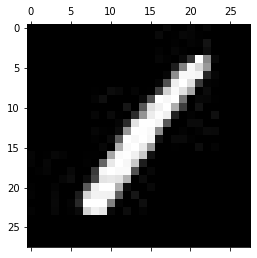

-------------------------------------------
Test: 188
Predicted: 8


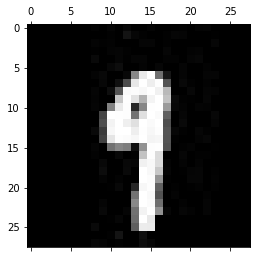

-------------------------------------------
Test: 189
Predicted: 8


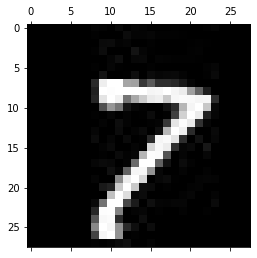

-------------------------------------------
Test: 190
Predicted: 8


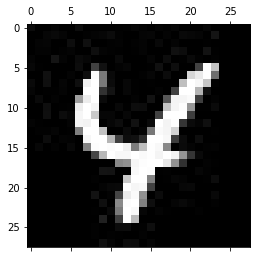

-------------------------------------------
Test: 191
Predicted: 8


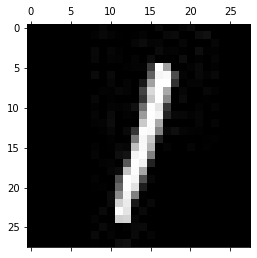

-------------------------------------------
Test: 192
Predicted: 8


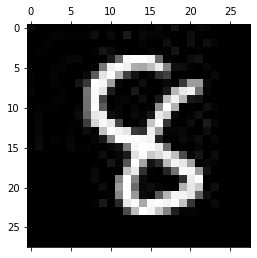

-------------------------------------------
Test: 193
Predicted: 8


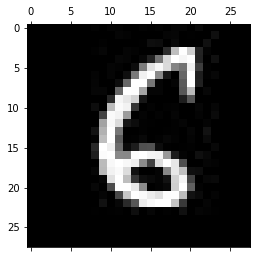

-------------------------------------------
Test: 194
Predicted: 8


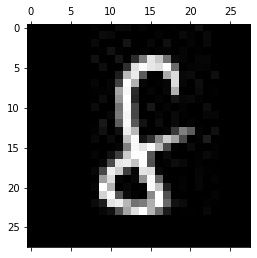

-------------------------------------------
Test: 195
Predicted: 8


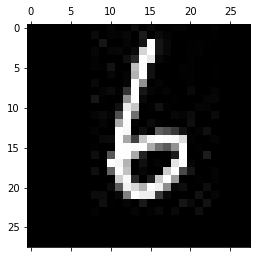

-------------------------------------------
Test: 196
Predicted: 8


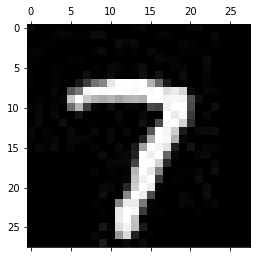

-------------------------------------------
Test: 197
Predicted: 8


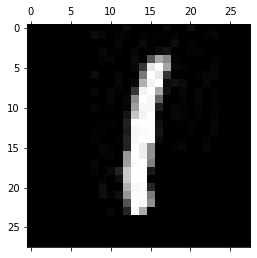

-------------------------------------------
Test: 198
Predicted: 8


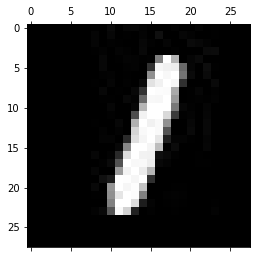

-------------------------------------------
Test: 199
Predicted: 8


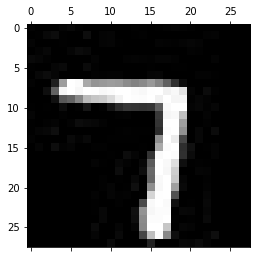

-------------------------------------------
Test: 200
Predicted: 8


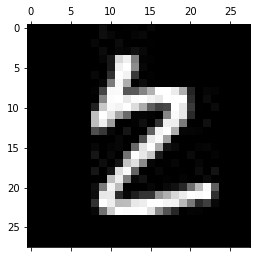

-------------------------------------------
Test: 201
Predicted: 8


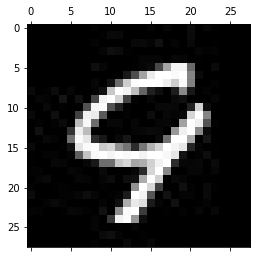

-------------------------------------------
Test: 202
Predicted: 8


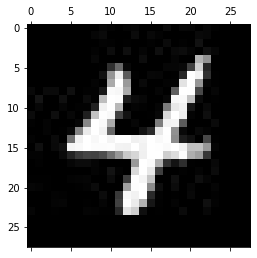

-------------------------------------------
Test: 203
Predicted: 8


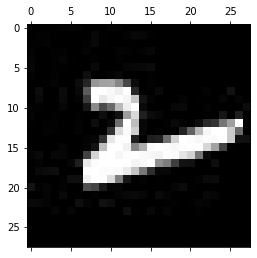

-------------------------------------------
Test: 204
Predicted: 8


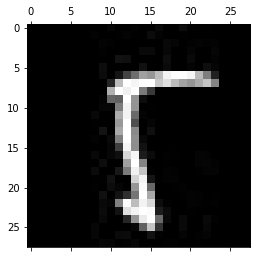

-------------------------------------------
Test: 205
Predicted: 8


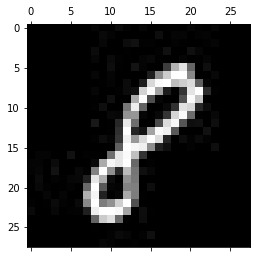

-------------------------------------------
Test: 206
Predicted: 8


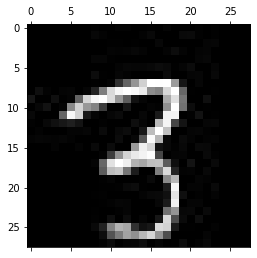

-------------------------------------------
Test: 207
Predicted: 8


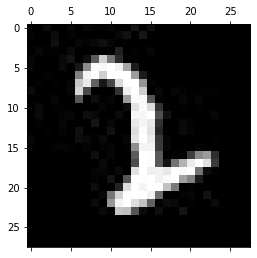

-------------------------------------------
Test: 208
Predicted: 8


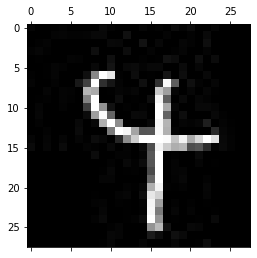

-------------------------------------------
Test: 209
Predicted: 8


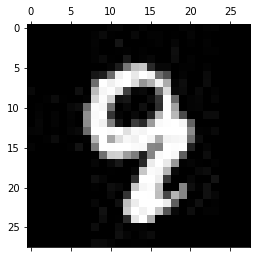

-------------------------------------------
Test: 210
Predicted: 8


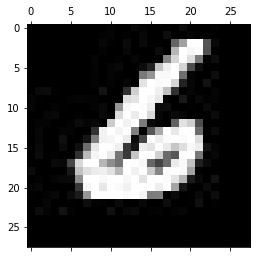

-------------------------------------------
Test: 211
Predicted: 8


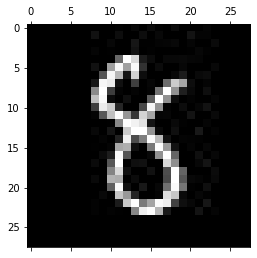

-------------------------------------------
Test: 212
Predicted: 8


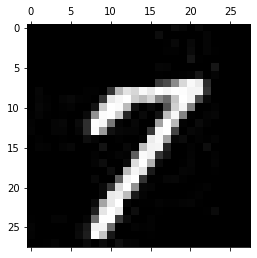

-------------------------------------------
Test: 213
Predicted: 8


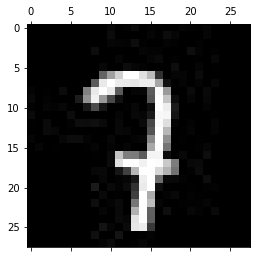

-------------------------------------------
Test: 214
Predicted: 8


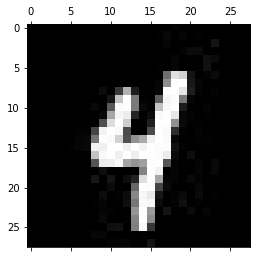

-------------------------------------------
Test: 215
Predicted: 8


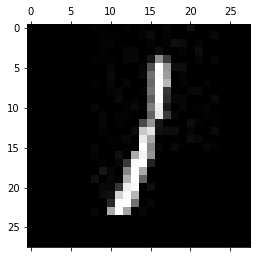

-------------------------------------------
Test: 216
Predicted: 8


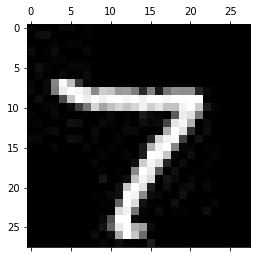

-------------------------------------------
Test: 217
Predicted: 8


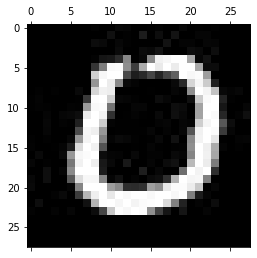

-------------------------------------------
Test: 218
Predicted: 8


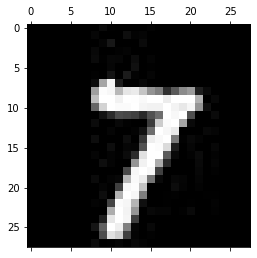

-------------------------------------------
Test: 219
Predicted: 8


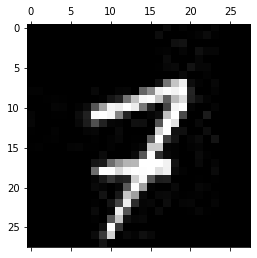

-------------------------------------------
Test: 220
Predicted: 8


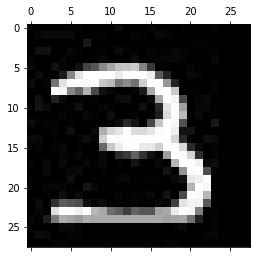

-------------------------------------------
Test: 221
Predicted: 8


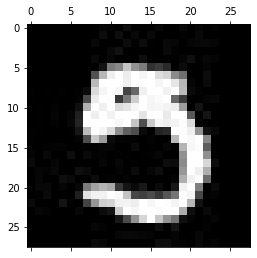

-------------------------------------------
Test: 222
Predicted: 8


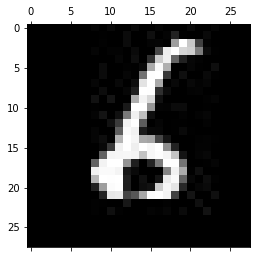

-------------------------------------------
Test: 223
Predicted: 8


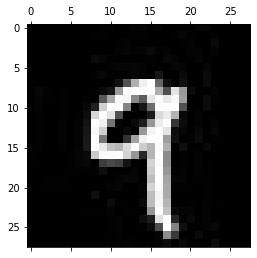

-------------------------------------------
Test: 224
Predicted: 8


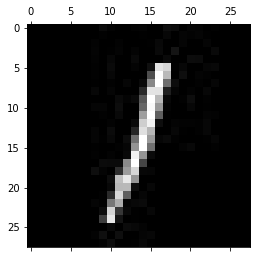

-------------------------------------------
Test: 225
Predicted: 8


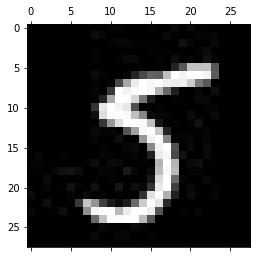

-------------------------------------------
Test: 226
Predicted: 8


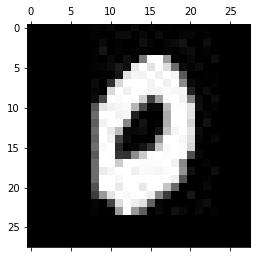

-------------------------------------------
Test: 227
Predicted: 8


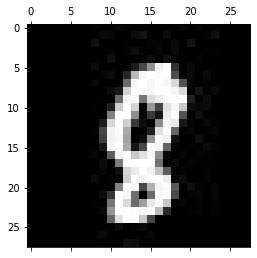

-------------------------------------------
Test: 228
Predicted: 8


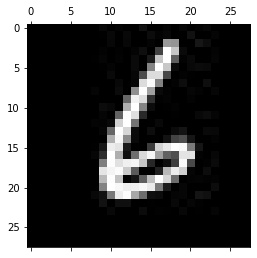

-------------------------------------------
Test: 229
Predicted: 8


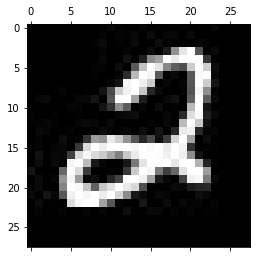

-------------------------------------------
Test: 230
Predicted: 8


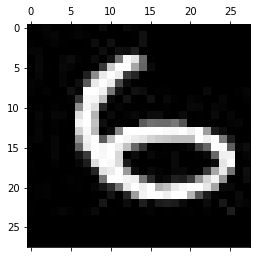

-------------------------------------------
Test: 231
Predicted: 8


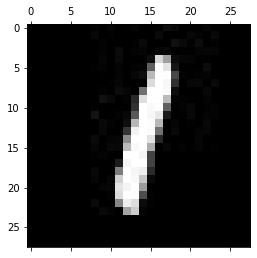

-------------------------------------------
Test: 232
Predicted: 8


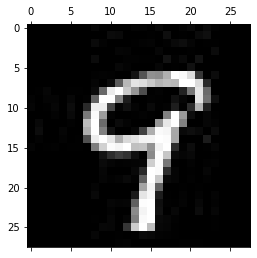

-------------------------------------------
Test: 233
Predicted: 8


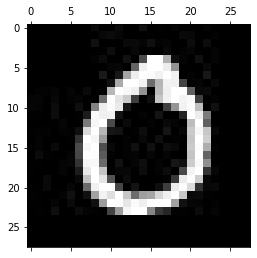

-------------------------------------------
Test: 234
Predicted: 8


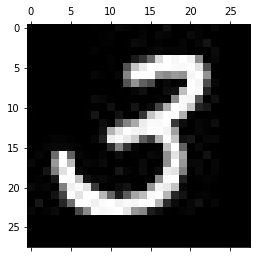

-------------------------------------------
Test: 235
Predicted: 8


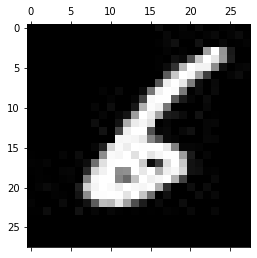

-------------------------------------------
Test: 236
Predicted: 8


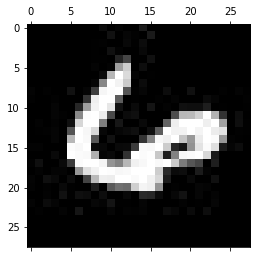

-------------------------------------------
Test: 237
Predicted: 8


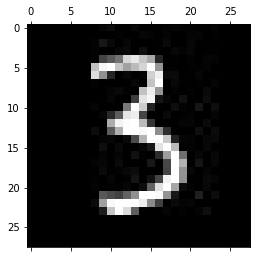

-------------------------------------------
Test: 238
Predicted: 8


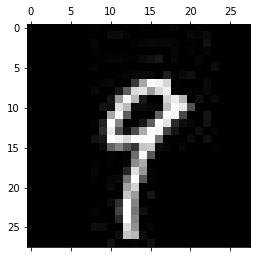

-------------------------------------------
Test: 239
Predicted: 8


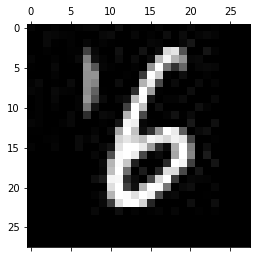

-------------------------------------------
Test: 240
Predicted: 8


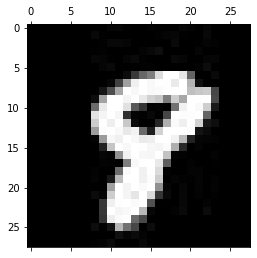

-------------------------------------------
Test: 241
Predicted: 8


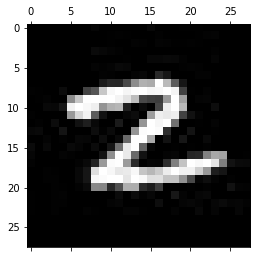

-------------------------------------------
Test: 242
Predicted: 8


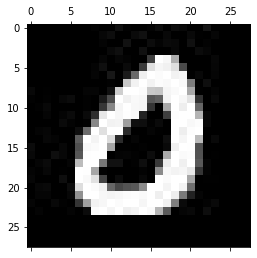

-------------------------------------------
Test: 243
Predicted: 8


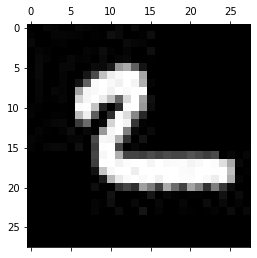

-------------------------------------------
Test: 244
Predicted: 8


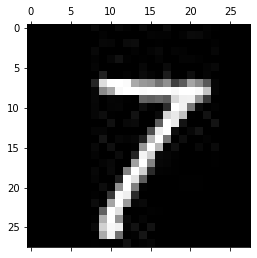

-------------------------------------------
Test: 245
Predicted: 8


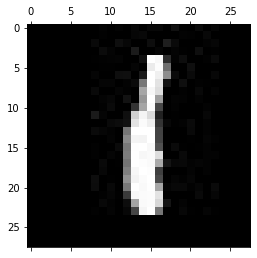

-------------------------------------------
Test: 246
Predicted: 8


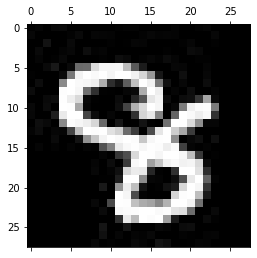

-------------------------------------------
Test: 247
Predicted: 8


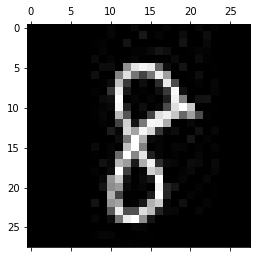

-------------------------------------------
Test: 248
Predicted: 8


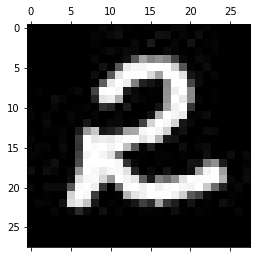

-------------------------------------------
Test: 249
Predicted: 8


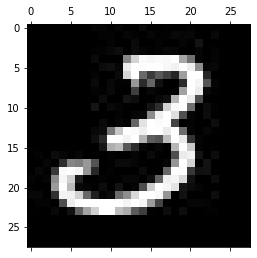

-------------------------------------------
Test: 250
Predicted: 8


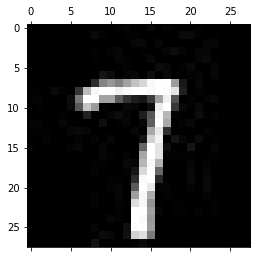

-------------------------------------------
Test: 251
Predicted: 8


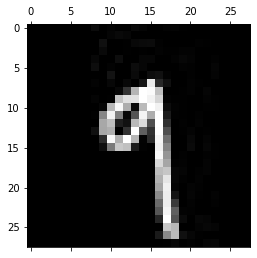

-------------------------------------------
Test: 252
Predicted: 8


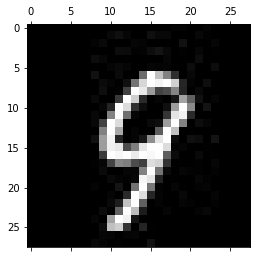

-------------------------------------------
Test: 253
Predicted: 8


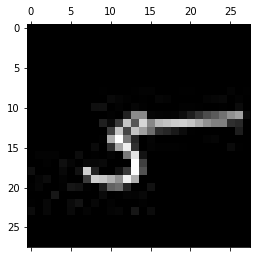

-------------------------------------------
Test: 254
Predicted: 8


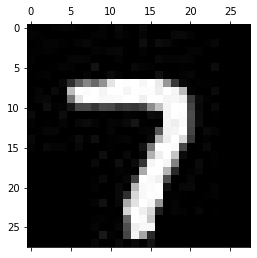

-------------------------------------------
Test: 255
Predicted: 8


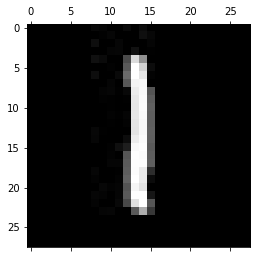

-------------------------------------------
Test: 256
Predicted: 8


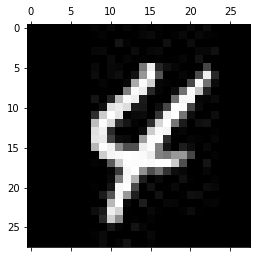

-------------------------------------------
Test: 257
Predicted: 8


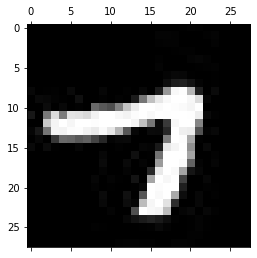

-------------------------------------------
Test: 258
Predicted: 8


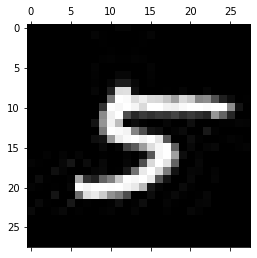

-------------------------------------------
Test: 259
Predicted: 8


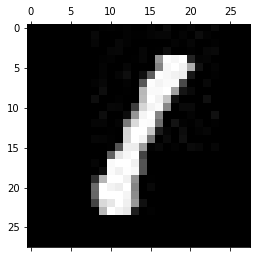

-------------------------------------------
Test: 260
Predicted: 8


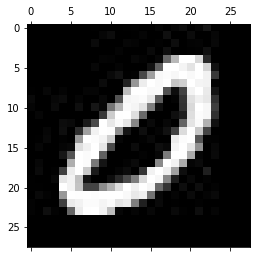

-------------------------------------------
Test: 261
Predicted: 8


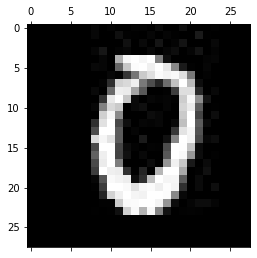

-------------------------------------------
Test: 262
Predicted: 8


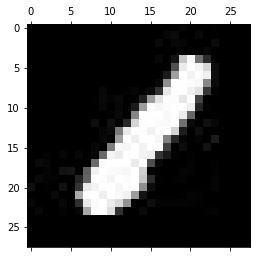

-------------------------------------------
Test: 263
Predicted: 8


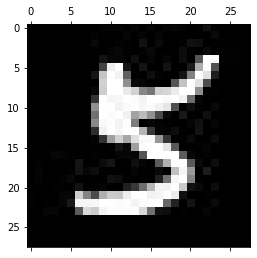

-------------------------------------------
Test: 264
Predicted: 8


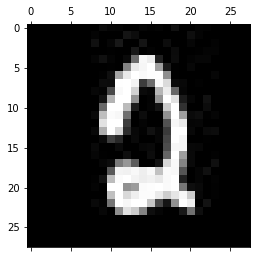

-------------------------------------------
Test: 265
Predicted: 8


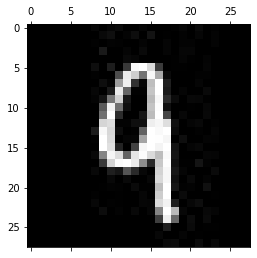

-------------------------------------------
Test: 266
Predicted: 8


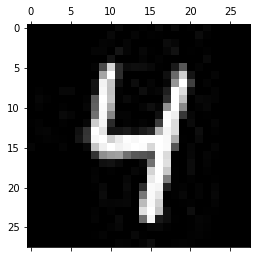

-------------------------------------------
Test: 267
Predicted: 8


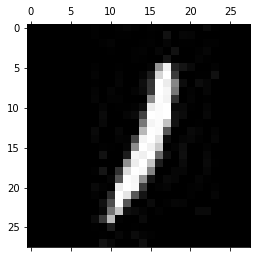

-------------------------------------------
Test: 268
Predicted: 8


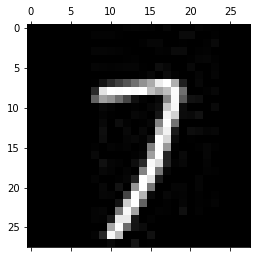

-------------------------------------------
Test: 269
Predicted: 8


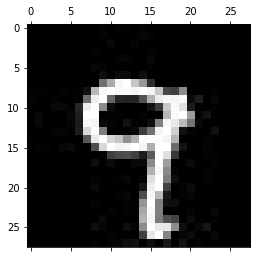

-------------------------------------------
Test: 270
Predicted: 8


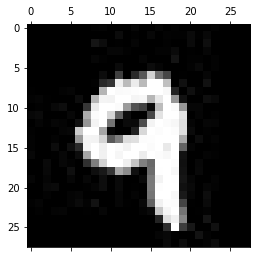

-------------------------------------------
Test: 271
Predicted: 8


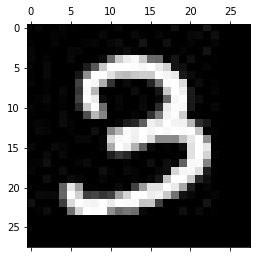

-------------------------------------------
Test: 272
Predicted: 8


KeyboardInterrupt: 

In [210]:
test3(my_data_test, weight1, weight2, weight3,weight4,weight5, bias1, bias2, bias3, bias4, bias5)